# Notebook to plot fairness and performance metrics

# Import Libraries

In [ ]:
try:
  from google.colab import drive
  drive.mount('/content/drive', force_remount=True)
  import sys
  path_to_project = '/content/drive/MyDrive/FairAlgorithm'
  sys.path.append(path_to_project)
  !sudo apt install libcairo2-dev pkg-config python3-dev
  IN_COLAB = True
except:
  IN_COLAB = False

Mounted at /content/drive
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
python3-dev is already the newest version (3.10.6-1~22.04.1).
python3-dev set to manually installed.
The following packages were automatically installed and are no longer required:
  libbz2-dev libpkgconf3 libreadline-dev
Use 'sudo apt autoremove' to remove them.
The following additional packages will be installed:
  libblkid-dev libblkid1 libcairo-script-interpreter2 libffi-dev
  libglib2.0-dev libglib2.0-dev-bin libice-dev liblzo2-2 libmount-dev
  libmount1 libpixman-1-dev libselinux1-dev libsepol-dev libsm-dev
  libxcb-render0-dev libxcb-shm0-dev
Suggested packages:
  libcairo2-doc libgirepository1.0-dev libglib2.0-doc libgdk-pixbuf2.0-bin
  | libgdk-pixbuf2.0-dev libxml2-utils libice-doc cryptsetup-bin libsm-doc
The following packages will be REMOVED:
  pkgconf r-base-dev
The following NEW packages will be installed:
  libblkid-dev libcairo-script-interpreter2 

In [ ]:
from source.utils.config import *
from source.utils.plot_utils import *

# Configure Notebook

In [ ]:
dataset_list = ['diabetes-women', 'stroke-prediction', 'diabetes-prediction', 'sepsis', 'aids', 'myocardial-infarction', 'alzheimer-disease'] #options: "diabetes-women", "sepsis", 'aids', "myocardial-infarction", 'alzheimer-disease', "diabetes-prediction", "stroke-prediction"
print(datasets_config)

#dataset_list = datasets_config.keys()
metrics = fairness_catalogue
perf_metrics = performance_metrics

{'diabetes-women': {'ignore_cols': ['Age'], 'target_variable': 'Outcome', 'target_variable_labels': [1, 0], 'sensible_attributes': ['AgeCategory'], 'default_mappings': {'Age': {'label_maps': [{1.0: 'Diabetic', 0.0: 'NonDiabetic'}], 'protected_attribute_maps': [{1.0: 'Adult', 0.0: 'Young'}]}}, 'n_splits': 5}, 'sepsis': {'ignore_cols': [], 'target_variable': 'Mortality', 'target_variable_labels': [1, 0], 'sensible_attributes': ['Gender_cat', 'Age_cat'], 'default_mappings': {'Gender_cat': {'label_maps': [{1.0: 'Death', 0.0: 'Censored'}], 'protected_attribute_maps': [{1.0: 'Male', 0.0: 'Female'}]}, 'Age_cat': {'label_maps': [{1.0: 'Death', 0.0: 'Censored'}], 'protected_attribute_maps': [{1.0: 'Adult', 0.0: 'Young'}]}}, 'n_splits': 5}, 'aids': {'ignore_cols': [], 'target_variable': 'cid', 'target_variable_labels': [1, 0], 'sensible_attributes': ['homo_cat', 'race_cat', 'age_cat'], 'default_mappings': {'homo_cat': {'label_maps': [{1.0: 'Death', 0.0: 'Censored'}], 'protected_attribute_maps': 

#Load metrics

In [ ]:
overall_metrics, preprocessing_metrics, inprocessing_metrics, postprocessing_metrics, performance_metrics = load_array_metrics(dataset_list, all_mitigations, preprocessing_mitigation_list, inprocessing_mitigation_list, postprocessing_mitigation_list)
print(overall_metrics)

diabetes-women
metrics mitigation loaded
original metrics  loaded
stroke-prediction
metrics mitigation loaded
original metrics  loaded
diabetes-prediction
metrics mitigation loaded
original metrics  loaded
sepsis
metrics mitigation loaded
original metrics  loaded
sepsis
metrics mitigation loaded
original metrics  loaded
aids
metrics mitigation loaded
original metrics  loaded
aids
metrics mitigation loaded
original metrics  loaded
aids
metrics mitigation loaded
original metrics  loaded
myocardial-infarction
metrics mitigation loaded
original metrics  loaded
alzheimer-disease
metrics mitigation loaded
original metrics  loaded
alzheimer-disease
metrics mitigation loaded
original metrics  loaded
{'diabetes-women': {'AgeCategory': {'fl-cr': {'division': {'Logistic Regression': {'GroupFairness': [0.1749144978724659, 0.021141870209744423], 'PredictiveParity': [0.10805499685072692, 0.04021046974321338], 'PredictiveEquality': [0.13758664843411, 0.1394394319024411], 'EqualOpportunity': [-0.86700

# Preprocessing results

In [ ]:
print(preprocessing_mitigation_list)
preprocessing_mitigation_list.insert(0, 'original')
print(preprocessing_mitigation_list)

['fl-cr', 'aif360-rw', 'aif360-di', 'aif360-lfr', 'aif360-op']
['original', 'fl-cr', 'aif360-rw', 'aif360-di', 'aif360-lfr', 'aif360-op']


## Performance metrics

In [ ]:
for dataset_name in dataset_list:
  for sensible_attribute in datasets_config[dataset_name]['sensible_attributes']:
    for m in models:
      perf_grouped_bar(performance_metrics[dataset_name][sensible_attribute], preprocessing_mitigation_list, m, 'preprocessing', dataset_name, sensible_attribute)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
for dataset in dataset_list:
  for sensible_attribute in datasets_config[dataset]['sensible_attributes']:
    for m in models:
      print(dataset, sensible_attribute, m)
      df = perf_data_framing(performance_metrics, dataset, sensible_attribute, m, preprocessing_mitigation_list)
      display(df)

diabetes-women AgeCategory Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.778+/-0.044,0.711+/-0.037,0.559+/-0.054,0.624+/-0.034
fl-cr,0.776+/-0.041,0.713+/-0.043,0.544+/-0.048,0.616+/-0.035
aif360-rw,0.784+/-0.035,0.747+/-0.040,0.528+/-0.063,0.616+/-0.034
aif360-di,0.782+/-0.040,0.724+/-0.042,0.553+/-0.054,0.625+/-0.039
aif360-lfr,0.676+/-0.030,0.842+/-0.086,0.179+/-0.093,0.280+/-0.123
aif360-op,0.738+/-0.044,0.603+/-0.056,0.677+/-0.023,0.636+/-0.027


diabetes-women AgeCategory Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.705+/-0.046,0.562+/-0.060,0.518+/-0.077,0.534+/-0.040
fl-cr,0.714+/-0.032,0.564+/-0.041,0.565+/-0.042,0.563+/-0.030
aif360-rw,0.695+/-0.029,0.534+/-0.053,0.564+/-0.066,0.545+/-0.041
aif360-di,0.717+/-0.048,0.571+/-0.103,0.557+/-0.104,0.559+/-0.088
aif360-lfr,0.920+/-0.016,0.901+/-0.042,0.887+/-0.033,0.892+/-0.021
aif360-op,0.723+/-0.045,0.589+/-0.060,0.611+/-0.079,0.596+/-0.051


diabetes-women AgeCategory Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.775+/-0.051,0.750+/-0.067,0.499+/-0.094,0.593+/-0.059
fl-cr,0.751+/-0.045,0.736+/-0.076,0.392+/-0.054,0.508+/-0.048
aif360-rw,0.787+/-0.041,0.773+/-0.025,0.506+/-0.086,0.607+/-0.060
aif360-di,0.760+/-0.037,0.744+/-0.062,0.419+/-0.062,0.532+/-0.051
aif360-lfr,0.899+/-0.008,0.820+/-0.017,0.937+/-0.013,0.874+/-0.011
aif360-op,0.735+/-0.046,0.599+/-0.057,0.677+/-0.023,0.633+/-0.028


diabetes-women AgeCategory Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.763+/-0.040,0.688+/-0.059,0.541+/-0.081,0.599+/-0.032
fl-cr,0.761+/-0.042,0.684+/-0.055,0.534+/-0.092,0.593+/-0.046
aif360-rw,0.757+/-0.020,0.672+/-0.080,0.512+/-0.020,0.578+/-0.036
aif360-di,0.764+/-0.026,0.691+/-0.057,0.528+/-0.063,0.593+/-0.020
aif360-lfr,0.941+/-0.025,0.924+/-0.030,0.918+/-0.055,0.920+/-0.036
aif360-op,0.721+/-0.042,0.593+/-0.061,0.590+/-0.077,0.586+/-0.040


diabetes-women AgeCategory Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.764+/-0.043,0.702+/-0.049,0.514+/-0.089,0.587+/-0.050
fl-cr,0.748+/-0.027,0.655+/-0.065,0.521+/-0.066,0.573+/-0.016
aif360-rw,0.748+/-0.031,0.658+/-0.070,0.500+/-0.031,0.565+/-0.023
aif360-di,0.764+/-0.036,0.688+/-0.057,0.532+/-0.049,0.597+/-0.027
aif360-lfr,0.921+/-0.019,0.890+/-0.024,0.901+/-0.045,0.895+/-0.028
aif360-op,0.724+/-0.044,0.591+/-0.059,0.611+/-0.079,0.597+/-0.051


diabetes-women AgeCategory Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.760+/-0.032,0.651+/-0.048,0.579+/-0.032,0.612+/-0.032
fl-cr,0.733+/-0.043,0.607+/-0.037,0.549+/-0.055,0.575+/-0.036
aif360-rw,0.707+/-0.027,0.562+/-0.112,0.533+/-0.041,0.542+/-0.068
aif360-di,0.724+/-0.022,0.594+/-0.102,0.530+/-0.043,0.555+/-0.060
aif360-lfr,0.944+/-0.011,0.909+/-0.027,0.945+/-0.034,0.926+/-0.017
aif360-op,0.732+/-0.046,0.594+/-0.056,0.677+/-0.023,0.631+/-0.027


stroke-prediction residence_category Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.960+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
fl-cr,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-rw,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-di,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-lfr,0.870+/-0.021,0.873+/-0.022,0.859+/-0.024,0.866+/-0.021
aif360-op,0.970+/-0.009,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


stroke-prediction residence_category Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.911+/-0.005,0.044+/-0.026,0.064+/-0.039,0.051+/-0.029
fl-cr,0.928+/-0.006,0.093+/-0.055,0.109+/-0.062,0.100+/-0.058
aif360-rw,0.910+/-0.009,0.059+/-0.049,0.092+/-0.087,0.070+/-0.061
aif360-di,0.928+/-0.015,0.086+/-0.045,0.090+/-0.051,0.086+/-0.044
aif360-lfr,0.999+/-0.001,1.000+/-0.000,0.999+/-0.003,0.999+/-0.001
aif360-op,0.970+/-0.009,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


stroke-prediction residence_category Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.959+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
fl-cr,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-rw,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-di,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-lfr,0.984+/-0.004,0.971+/-0.007,0.997+/-0.003,0.984+/-0.004
aif360-op,0.970+/-0.009,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


stroke-prediction residence_category Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.959+/-0.004,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
fl-cr,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-rw,0.960+/-0.006,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-di,0.961+/-0.004,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-lfr,0.999+/-0.001,1.000+/-0.000,0.999+/-0.003,0.999+/-0.001
aif360-op,0.969+/-0.009,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


stroke-prediction residence_category Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.950+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
fl-cr,0.950+/-0.004,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-rw,0.949+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-di,0.951+/-0.004,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-lfr,1.000+/-0.000,1.000+/-0.000,1.000+/-0.000,1.000+/-0.000
aif360-op,0.970+/-0.009,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


stroke-prediction residence_category Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.958+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
fl-cr,0.944+/-0.009,0.050+/-0.100,0.022+/-0.044,0.031+/-0.062
aif360-rw,0.939+/-0.008,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-di,0.947+/-0.007,0.050+/-0.100,0.017+/-0.033,0.025+/-0.050
aif360-lfr,0.999+/-0.001,1.000+/-0.000,0.999+/-0.003,0.999+/-0.001
aif360-op,0.970+/-0.009,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


diabetes-prediction race_category Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.614+/-0.042,0.609+/-0.070,0.280+/-0.064,0.376+/-0.054
fl-cr,0.614+/-0.042,0.610+/-0.071,0.280+/-0.063,0.376+/-0.054
aif360-rw,0.614+/-0.043,0.611+/-0.069,0.280+/-0.063,0.376+/-0.053
aif360-di,0.614+/-0.042,0.610+/-0.070,0.281+/-0.063,0.377+/-0.053
aif360-lfr,0.952+/-0.019,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-op,0.578+/-0.014,0.635+/-0.032,0.403+/-0.036,0.492+/-0.033


diabetes-prediction race_category Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.540+/-0.010,0.462+/-0.062,0.475+/-0.020,0.465+/-0.028
fl-cr,0.538+/-0.009,0.459+/-0.063,0.468+/-0.022,0.460+/-0.030
aif360-rw,0.537+/-0.010,0.458+/-0.064,0.471+/-0.022,0.461+/-0.031
aif360-di,0.540+/-0.009,0.461+/-0.062,0.473+/-0.019,0.464+/-0.028
aif360-lfr,0.997+/-0.003,0.980+/-0.025,0.968+/-0.034,0.974+/-0.028
aif360-op,0.576+/-0.015,0.624+/-0.028,0.419+/-0.044,0.500+/-0.037


diabetes-prediction race_category Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.616+/-0.033,0.584+/-0.067,0.361+/-0.049,0.441+/-0.035
fl-cr,0.616+/-0.035,0.584+/-0.066,0.358+/-0.057,0.438+/-0.041
aif360-rw,0.616+/-0.034,0.584+/-0.068,0.361+/-0.056,0.440+/-0.039
aif360-di,0.616+/-0.034,0.584+/-0.067,0.360+/-0.050,0.440+/-0.036
aif360-lfr,0.988+/-0.006,0.978+/-0.028,0.786+/-0.096,0.869+/-0.065
aif360-op,0.580+/-0.015,0.622+/-0.028,0.446+/-0.027,0.519+/-0.027


diabetes-prediction race_category Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.588+/-0.024,0.528+/-0.068,0.383+/-0.046,0.438+/-0.025
fl-cr,0.589+/-0.023,0.529+/-0.067,0.389+/-0.050,0.442+/-0.026
aif360-rw,0.588+/-0.022,0.527+/-0.071,0.384+/-0.047,0.439+/-0.026
aif360-di,0.590+/-0.026,0.531+/-0.064,0.389+/-0.052,0.443+/-0.028
aif360-lfr,0.998+/-0.001,1.000+/-0.000,0.963+/-0.032,0.981+/-0.017
aif360-op,0.578+/-0.015,0.625+/-0.029,0.426+/-0.031,0.506+/-0.027


diabetes-prediction race_category Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.579+/-0.020,0.513+/-0.070,0.384+/-0.042,0.434+/-0.023
fl-cr,0.581+/-0.022,0.516+/-0.066,0.393+/-0.052,0.440+/-0.027
aif360-rw,0.581+/-0.023,0.515+/-0.066,0.389+/-0.045,0.437+/-0.025
aif360-di,0.581+/-0.021,0.516+/-0.069,0.389+/-0.044,0.438+/-0.022
aif360-lfr,0.997+/-0.002,0.978+/-0.035,0.965+/-0.026,0.971+/-0.024
aif360-op,0.576+/-0.015,0.624+/-0.028,0.419+/-0.044,0.500+/-0.037


diabetes-prediction race_category Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.615+/-0.035,0.584+/-0.064,0.364+/-0.066,0.441+/-0.044
fl-cr,0.612+/-0.031,0.575+/-0.070,0.374+/-0.065,0.446+/-0.042
aif360-rw,0.612+/-0.030,0.575+/-0.069,0.374+/-0.060,0.446+/-0.034
aif360-di,0.612+/-0.030,0.574+/-0.069,0.374+/-0.063,0.446+/-0.040
aif360-lfr,0.998+/-0.001,0.996+/-0.011,0.973+/-0.019,0.984+/-0.009
aif360-op,0.577+/-0.014,0.622+/-0.029,0.430+/-0.038,0.508+/-0.033


sepsis Gender_cat Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.970+/-0.010,0.684+/-0.125,0.529+/-0.135,0.571+/-0.065
fl-cr,0.970+/-0.010,0.684+/-0.125,0.529+/-0.135,0.571+/-0.065
aif360-rw,0.971+/-0.010,0.734+/-0.179,0.529+/-0.135,0.580+/-0.057
aif360-di,0.970+/-0.010,0.684+/-0.125,0.529+/-0.135,0.571+/-0.065
aif360-lfr,0.984+/-0.006,0.850+/-0.079,0.990+/-0.020,0.912+/-0.035
aif360-op,0.960+/-0.015,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


sepsis Gender_cat Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.967+/-0.010,0.598+/-0.104,0.611+/-0.168,0.577+/-0.059
fl-cr,0.959+/-0.012,0.516+/-0.124,0.517+/-0.179,0.471+/-0.097
aif360-rw,0.959+/-0.011,0.516+/-0.188,0.544+/-0.196,0.490+/-0.097
aif360-di,0.960+/-0.014,0.528+/-0.177,0.611+/-0.168,0.531+/-0.110
aif360-lfr,0.990+/-0.007,0.938+/-0.058,0.940+/-0.080,0.937+/-0.054
aif360-op,0.960+/-0.015,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


sepsis Gender_cat Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.973+/-0.012,0.725+/-0.229,0.547+/-0.202,0.585+/-0.167
fl-cr,0.973+/-0.014,0.716+/-0.182,0.604+/-0.133,0.635+/-0.126
aif360-rw,0.977+/-0.016,0.831+/-0.162,0.663+/-0.267,0.681+/-0.207
aif360-di,0.974+/-0.014,0.789+/-0.212,0.589+/-0.161,0.633+/-0.134
aif360-lfr,0.977+/-0.013,0.951+/-0.059,0.790+/-0.122,0.858+/-0.079
aif360-op,0.960+/-0.015,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


sepsis Gender_cat Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.975+/-0.014,0.853+/-0.129,0.517+/-0.179,0.607+/-0.151
fl-cr,0.976+/-0.012,0.848+/-0.189,0.560+/-0.148,0.641+/-0.119
aif360-rw,0.978+/-0.014,0.917+/-0.105,0.606+/-0.259,0.680+/-0.164
aif360-di,0.977+/-0.013,0.870+/-0.108,0.602+/-0.238,0.669+/-0.139
aif360-lfr,0.993+/-0.006,0.956+/-0.041,0.950+/-0.077,0.952+/-0.056
aif360-op,0.960+/-0.015,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


sepsis Gender_cat Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.976+/-0.015,0.933+/-0.133,0.489+/-0.180,0.608+/-0.164
fl-cr,0.974+/-0.016,0.860+/-0.196,0.432+/-0.203,0.540+/-0.227
aif360-rw,0.976+/-0.015,0.893+/-0.137,0.517+/-0.179,0.623+/-0.169
aif360-di,0.975+/-0.014,0.860+/-0.196,0.451+/-0.173,0.568+/-0.184
aif360-lfr,0.993+/-0.004,0.949+/-0.045,0.970+/-0.040,0.959+/-0.034
aif360-op,0.960+/-0.015,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


sepsis Gender_cat Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.970+/-0.016,0.777+/-0.123,0.474+/-0.219,0.533+/-0.194
fl-cr,0.971+/-0.015,0.748+/-0.213,0.567+/-0.201,0.595+/-0.177
aif360-rw,0.973+/-0.016,0.893+/-0.137,0.432+/-0.203,0.533+/-0.194
aif360-di,0.968+/-0.011,0.692+/-0.268,0.479+/-0.200,0.509+/-0.158
aif360-lfr,0.990+/-0.007,0.946+/-0.048,0.930+/-0.087,0.936+/-0.054
aif360-op,0.960+/-0.015,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


sepsis Age_cat Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.970+/-0.010,0.684+/-0.125,0.529+/-0.135,0.571+/-0.065
fl-cr,0.978+/-0.008,0.825+/-0.159,0.634+/-0.140,0.688+/-0.049
aif360-rw,0.970+/-0.009,0.741+/-0.182,0.430+/-0.189,0.499+/-0.165
aif360-di,0.973+/-0.010,0.745+/-0.171,0.562+/-0.178,0.600+/-0.079
aif360-lfr,0.967+/-0.012,0.917+/-0.035,0.993+/-0.014,0.953+/-0.015
aif360-op,0.960+/-0.015,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


sepsis Age_cat Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.965+/-0.013,0.590+/-0.131,0.513+/-0.187,0.512+/-0.127
fl-cr,0.961+/-0.018,0.561+/-0.234,0.615+/-0.049,0.561+/-0.112
aif360-rw,0.965+/-0.015,0.576+/-0.108,0.654+/-0.128,0.599+/-0.088
aif360-di,0.961+/-0.008,0.599+/-0.257,0.593+/-0.196,0.518+/-0.077
aif360-lfr,0.990+/-0.007,0.972+/-0.023,0.997+/-0.006,0.984+/-0.010
aif360-op,0.960+/-0.015,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


sepsis Age_cat Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.974+/-0.015,0.767+/-0.226,0.529+/-0.228,0.581+/-0.209
fl-cr,0.975+/-0.013,0.800+/-0.194,0.589+/-0.161,0.641+/-0.129
aif360-rw,0.975+/-0.013,0.765+/-0.212,0.632+/-0.138,0.661+/-0.122
aif360-di,0.973+/-0.016,0.789+/-0.212,0.571+/-0.197,0.609+/-0.174
aif360-lfr,0.970+/-0.017,0.971+/-0.024,0.939+/-0.032,0.955+/-0.026
aif360-op,0.960+/-0.015,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


sepsis Age_cat Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.973+/-0.014,0.793+/-0.194,0.542+/-0.184,0.596+/-0.157
fl-cr,0.976+/-0.012,0.810+/-0.185,0.645+/-0.206,0.680+/-0.121
aif360-rw,0.974+/-0.012,0.814+/-0.173,0.539+/-0.180,0.605+/-0.115
aif360-di,0.975+/-0.012,0.808+/-0.173,0.560+/-0.148,0.629+/-0.112
aif360-lfr,0.991+/-0.009,0.986+/-0.020,0.986+/-0.013,0.986+/-0.013
aif360-op,0.960+/-0.015,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


sepsis Age_cat Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.977+/-0.015,1.000+/-0.000,0.451+/-0.173,0.600+/-0.177
fl-cr,0.976+/-0.015,1.000+/-0.000,0.426+/-0.173,0.576+/-0.174
aif360-rw,0.977+/-0.012,0.900+/-0.200,0.469+/-0.147,0.605+/-0.161
aif360-di,0.974+/-0.016,0.900+/-0.200,0.407+/-0.200,0.528+/-0.228
aif360-lfr,0.991+/-0.008,0.987+/-0.026,0.987+/-0.013,0.986+/-0.012
aif360-op,0.960+/-0.015,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


sepsis Age_cat Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.968+/-0.015,0.743+/-0.164,0.474+/-0.219,0.514+/-0.185
fl-cr,0.971+/-0.012,0.743+/-0.164,0.444+/-0.150,0.536+/-0.119
aif360-rw,0.974+/-0.011,0.757+/-0.210,0.589+/-0.161,0.620+/-0.118
aif360-di,0.968+/-0.014,0.673+/-0.190,0.602+/-0.238,0.584+/-0.119
aif360-lfr,0.994+/-0.009,0.983+/-0.025,1.000+/-0.000,0.992+/-0.013
aif360-op,0.960+/-0.015,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


aids homo_cat Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.838+/-0.022,0.698+/-0.118,0.530+/-0.075,0.597+/-0.074
fl-cr,0.836+/-0.024,0.690+/-0.112,0.528+/-0.081,0.593+/-0.075
aif360-rw,0.836+/-0.022,0.694+/-0.116,0.523+/-0.076,0.591+/-0.070
aif360-di,0.835+/-0.020,0.692+/-0.109,0.521+/-0.072,0.589+/-0.066
aif360-lfr,0.886+/-0.018,0.886+/-0.018,1.000+/-0.000,0.939+/-0.010
aif360-op,0.823+/-0.018,0.657+/-0.108,0.486+/-0.066,0.554+/-0.066


aids homo_cat Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.844+/-0.033,0.653+/-0.112,0.672+/-0.100,0.659+/-0.097
fl-cr,0.843+/-0.027,0.659+/-0.093,0.667+/-0.092,0.658+/-0.076
aif360-rw,0.855+/-0.025,0.678+/-0.092,0.699+/-0.058,0.686+/-0.069
aif360-di,0.856+/-0.025,0.688+/-0.066,0.688+/-0.061,0.685+/-0.049
aif360-lfr,0.990+/-0.009,0.994+/-0.005,0.994+/-0.008,0.994+/-0.005
aif360-op,0.826+/-0.019,0.625+/-0.089,0.608+/-0.075,0.612+/-0.066


aids homo_cat Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.890+/-0.025,0.835+/-0.093,0.640+/-0.084,0.723+/-0.081
fl-cr,0.891+/-0.019,0.827+/-0.076,0.655+/-0.083,0.728+/-0.068
aif360-rw,0.894+/-0.022,0.845+/-0.085,0.649+/-0.080,0.732+/-0.076
aif360-di,0.890+/-0.021,0.837+/-0.091,0.640+/-0.074,0.723+/-0.072
aif360-lfr,0.993+/-0.006,0.995+/-0.005,0.997+/-0.008,0.996+/-0.004
aif360-op,0.822+/-0.023,0.603+/-0.100,0.690+/-0.112,0.633+/-0.079


aids homo_cat Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.889+/-0.016,0.817+/-0.091,0.659+/-0.072,0.726+/-0.063
fl-cr,0.891+/-0.022,0.819+/-0.083,0.663+/-0.083,0.731+/-0.074
aif360-rw,0.883+/-0.021,0.796+/-0.085,0.650+/-0.087,0.713+/-0.075
aif360-di,0.885+/-0.020,0.816+/-0.088,0.637+/-0.084,0.712+/-0.071
aif360-lfr,0.991+/-0.007,0.994+/-0.004,0.996+/-0.007,0.995+/-0.004
aif360-op,0.828+/-0.023,0.623+/-0.089,0.633+/-0.074,0.625+/-0.070


aids homo_cat Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.869+/-0.023,0.841+/-0.113,0.515+/-0.092,0.636+/-0.094
fl-cr,0.871+/-0.015,0.840+/-0.105,0.527+/-0.090,0.644+/-0.087
aif360-rw,0.861+/-0.023,0.799+/-0.109,0.510+/-0.099,0.619+/-0.099
aif360-di,0.871+/-0.020,0.841+/-0.086,0.534+/-0.093,0.648+/-0.082
aif360-lfr,0.994+/-0.007,0.997+/-0.005,0.997+/-0.006,0.997+/-0.004
aif360-op,0.826+/-0.019,0.625+/-0.089,0.608+/-0.075,0.612+/-0.066


aids homo_cat Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.886+/-0.016,0.783+/-0.090,0.687+/-0.071,0.729+/-0.068
fl-cr,0.864+/-0.024,0.712+/-0.088,0.678+/-0.093,0.691+/-0.075
aif360-rw,0.869+/-0.024,0.733+/-0.087,0.676+/-0.076,0.700+/-0.067
aif360-di,0.873+/-0.021,0.741+/-0.094,0.690+/-0.077,0.709+/-0.062
aif360-lfr,0.996+/-0.006,0.998+/-0.004,0.997+/-0.005,0.997+/-0.003
aif360-op,0.820+/-0.024,0.613+/-0.094,0.607+/-0.065,0.606+/-0.063


aids race_cat Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.838+/-0.022,0.698+/-0.118,0.530+/-0.075,0.597+/-0.074
fl-cr,0.837+/-0.022,0.697+/-0.120,0.525+/-0.075,0.593+/-0.073
aif360-rw,0.838+/-0.023,0.698+/-0.118,0.533+/-0.075,0.598+/-0.073
aif360-di,0.834+/-0.021,0.688+/-0.110,0.521+/-0.074,0.587+/-0.069
aif360-lfr,0.972+/-0.014,0.972+/-0.014,1.000+/-0.000,0.986+/-0.007
aif360-op,0.830+/-0.027,0.701+/-0.075,0.452+/-0.060,0.548+/-0.063


aids race_cat Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.852+/-0.027,0.673+/-0.108,0.694+/-0.072,0.680+/-0.081
fl-cr,0.851+/-0.020,0.664+/-0.085,0.693+/-0.079,0.677+/-0.075
aif360-rw,0.844+/-0.023,0.655+/-0.093,0.696+/-0.047,0.670+/-0.051
aif360-di,0.849+/-0.029,0.665+/-0.111,0.685+/-0.089,0.671+/-0.090
aif360-lfr,0.995+/-0.006,0.998+/-0.004,0.997+/-0.005,0.997+/-0.003
aif360-op,0.837+/-0.022,0.649+/-0.069,0.627+/-0.058,0.636+/-0.055


aids race_cat Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.894+/-0.022,0.846+/-0.088,0.650+/-0.075,0.734+/-0.073
fl-cr,0.892+/-0.018,0.833+/-0.057,0.653+/-0.088,0.729+/-0.068
aif360-rw,0.892+/-0.023,0.846+/-0.088,0.640+/-0.084,0.726+/-0.079
aif360-di,0.888+/-0.024,0.819+/-0.092,0.649+/-0.083,0.722+/-0.080
aif360-lfr,0.994+/-0.006,0.997+/-0.004,0.997+/-0.005,0.997+/-0.003
aif360-op,0.822+/-0.026,0.661+/-0.098,0.517+/-0.117,0.564+/-0.063


aids race_cat Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.887+/-0.020,0.809+/-0.097,0.656+/-0.097,0.720+/-0.077
fl-cr,0.882+/-0.017,0.794+/-0.112,0.651+/-0.089,0.710+/-0.077
aif360-rw,0.878+/-0.017,0.792+/-0.098,0.632+/-0.058,0.701+/-0.060
aif360-di,0.880+/-0.019,0.800+/-0.110,0.631+/-0.079,0.701+/-0.074
aif360-lfr,0.994+/-0.005,0.995+/-0.003,0.998+/-0.003,0.997+/-0.003
aif360-op,0.832+/-0.020,0.646+/-0.070,0.593+/-0.081,0.614+/-0.063


aids race_cat Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.869+/-0.019,0.839+/-0.071,0.523+/-0.083,0.641+/-0.076
fl-cr,0.870+/-0.021,0.825+/-0.099,0.529+/-0.105,0.641+/-0.100
aif360-rw,0.860+/-0.029,0.819+/-0.141,0.484+/-0.107,0.606+/-0.117
aif360-di,0.873+/-0.022,0.844+/-0.087,0.543+/-0.100,0.655+/-0.084
aif360-lfr,0.994+/-0.005,0.997+/-0.003,0.997+/-0.004,0.997+/-0.003
aif360-op,0.837+/-0.022,0.649+/-0.069,0.627+/-0.058,0.636+/-0.055


aids race_cat Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.886+/-0.016,0.783+/-0.090,0.687+/-0.071,0.729+/-0.068
fl-cr,0.867+/-0.023,0.730+/-0.083,0.667+/-0.076,0.694+/-0.065
aif360-rw,0.863+/-0.027,0.732+/-0.098,0.635+/-0.091,0.675+/-0.077
aif360-di,0.850+/-0.024,0.691+/-0.070,0.637+/-0.072,0.659+/-0.051
aif360-lfr,0.993+/-0.006,0.995+/-0.003,0.997+/-0.005,0.996+/-0.003
aif360-op,0.838+/-0.021,0.645+/-0.074,0.638+/-0.057,0.640+/-0.059


aids age_cat Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.838+/-0.022,0.698+/-0.118,0.530+/-0.075,0.597+/-0.074
fl-cr,0.838+/-0.021,0.698+/-0.116,0.533+/-0.073,0.598+/-0.070
aif360-rw,0.836+/-0.023,0.693+/-0.118,0.528+/-0.076,0.593+/-0.074
aif360-di,0.840+/-0.022,0.702+/-0.121,0.537+/-0.070,0.603+/-0.071
aif360-lfr,0.944+/-0.015,0.944+/-0.015,1.000+/-0.000,0.971+/-0.008
aif360-op,0.830+/-0.029,0.697+/-0.061,0.473+/-0.039,0.563+/-0.042


aids age_cat Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.847+/-0.036,0.665+/-0.129,0.676+/-0.079,0.667+/-0.097
fl-cr,0.839+/-0.028,0.643+/-0.092,0.669+/-0.094,0.652+/-0.081
aif360-rw,0.850+/-0.028,0.667+/-0.102,0.703+/-0.068,0.680+/-0.071
aif360-di,0.844+/-0.023,0.666+/-0.082,0.663+/-0.079,0.658+/-0.057
aif360-lfr,0.988+/-0.008,0.994+/-0.006,0.994+/-0.004,0.994+/-0.004
aif360-op,0.825+/-0.027,0.676+/-0.095,0.483+/-0.053,0.558+/-0.042


aids age_cat Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.892+/-0.023,0.836+/-0.090,0.650+/-0.081,0.729+/-0.077
fl-cr,0.890+/-0.021,0.829+/-0.070,0.646+/-0.087,0.724+/-0.075
aif360-rw,0.896+/-0.021,0.852+/-0.088,0.652+/-0.076,0.737+/-0.073
aif360-di,0.892+/-0.021,0.835+/-0.092,0.649+/-0.083,0.728+/-0.077
aif360-lfr,0.990+/-0.009,0.996+/-0.005,0.994+/-0.006,0.995+/-0.005
aif360-op,0.824+/-0.028,0.746+/-0.079,0.370+/-0.049,0.491+/-0.045


aids age_cat Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.879+/-0.014,0.790+/-0.091,0.638+/-0.068,0.703+/-0.062
fl-cr,0.878+/-0.021,0.777+/-0.089,0.649+/-0.096,0.702+/-0.078
aif360-rw,0.877+/-0.023,0.795+/-0.096,0.631+/-0.065,0.700+/-0.064
aif360-di,0.883+/-0.019,0.809+/-0.082,0.652+/-0.093,0.715+/-0.062
aif360-lfr,0.990+/-0.006,0.995+/-0.005,0.994+/-0.006,0.995+/-0.003
aif360-op,0.823+/-0.025,0.661+/-0.100,0.504+/-0.066,0.565+/-0.047


aids age_cat Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.864+/-0.021,0.815+/-0.100,0.505+/-0.108,0.620+/-0.104
fl-cr,0.866+/-0.021,0.837+/-0.088,0.511+/-0.100,0.628+/-0.088
aif360-rw,0.873+/-0.021,0.855+/-0.112,0.539+/-0.105,0.653+/-0.090
aif360-di,0.866+/-0.020,0.822+/-0.100,0.517+/-0.094,0.631+/-0.093
aif360-lfr,0.990+/-0.008,0.995+/-0.005,0.994+/-0.006,0.994+/-0.004
aif360-op,0.825+/-0.027,0.676+/-0.095,0.483+/-0.053,0.558+/-0.042


aids age_cat Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.887+/-0.016,0.786+/-0.093,0.687+/-0.071,0.730+/-0.068
fl-cr,0.859+/-0.014,0.706+/-0.074,0.673+/-0.074,0.682+/-0.044
aif360-rw,0.867+/-0.024,0.719+/-0.078,0.695+/-0.056,0.704+/-0.051
aif360-di,0.861+/-0.025,0.706+/-0.095,0.666+/-0.068,0.683+/-0.072
aif360-lfr,0.992+/-0.006,0.998+/-0.003,0.994+/-0.006,0.996+/-0.003
aif360-op,0.829+/-0.025,0.657+/-0.075,0.540+/-0.045,0.591+/-0.051


myocardial-infarction SEX Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.987+/-0.005,0.945+/-0.031,0.881+/-0.057,0.911+/-0.033
fl-cr,0.986+/-0.009,0.920+/-0.041,0.899+/-0.063,0.908+/-0.042
aif360-rw,0.994+/-0.008,0.945+/-0.067,0.978+/-0.028,0.961+/-0.048
aif360-di,0.989+/-0.007,0.951+/-0.047,0.905+/-0.034,0.927+/-0.033
aif360-lfr,0.991+/-0.011,0.942+/-0.073,0.858+/-0.205,0.888+/-0.154
aif360-op,0.947+/-0.014,0.975+/-0.050,0.367+/-0.078,0.528+/-0.084


myocardial-infarction SEX Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.994+/-0.003,0.970+/-0.026,0.959+/-0.054,0.963+/-0.019
fl-cr,0.996+/-0.003,0.970+/-0.025,0.978+/-0.028,0.973+/-0.015
aif360-rw,0.995+/-0.002,0.970+/-0.026,0.968+/-0.039,0.968+/-0.009
aif360-di,0.994+/-0.004,0.960+/-0.037,0.973+/-0.055,0.965+/-0.025
aif360-lfr,0.997+/-0.003,0.955+/-0.037,0.987+/-0.027,0.970+/-0.026
aif360-op,0.946+/-0.014,0.975+/-0.050,0.358+/-0.073,0.519+/-0.078


myocardial-infarction SEX Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.996+/-0.000,0.970+/-0.026,0.978+/-0.028,0.973+/-0.005
fl-cr,0.995+/-0.005,0.978+/-0.029,0.947+/-0.065,0.961+/-0.041
aif360-rw,0.996+/-0.000,0.970+/-0.026,0.978+/-0.028,0.973+/-0.005
aif360-di,0.991+/-0.003,0.944+/-0.047,0.938+/-0.060,0.939+/-0.026
aif360-lfr,0.998+/-0.003,0.987+/-0.027,0.967+/-0.042,0.976+/-0.030
aif360-op,0.945+/-0.015,0.975+/-0.050,0.350+/-0.083,0.508+/-0.090


myocardial-infarction SEX Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.996+/-0.003,0.969+/-0.027,0.973+/-0.033,0.971+/-0.022
fl-cr,0.992+/-0.006,0.976+/-0.031,0.903+/-0.085,0.936+/-0.054
aif360-rw,0.998+/-0.002,0.980+/-0.026,0.987+/-0.027,0.983+/-0.015
aif360-di,0.992+/-0.004,0.982+/-0.022,0.902+/-0.099,0.936+/-0.049
aif360-lfr,0.998+/-0.003,0.960+/-0.050,1.000+/-0.000,0.979+/-0.027
aif360-op,0.946+/-0.014,0.975+/-0.050,0.358+/-0.073,0.519+/-0.078


myocardial-infarction SEX Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.961+/-0.013,0.933+/-0.058,0.520+/-0.116,0.662+/-0.114
fl-cr,0.959+/-0.011,0.944+/-0.049,0.495+/-0.065,0.648+/-0.067
aif360-rw,0.965+/-0.016,0.951+/-0.060,0.595+/-0.122,0.727+/-0.106
aif360-di,0.967+/-0.014,0.953+/-0.058,0.604+/-0.129,0.733+/-0.109
aif360-lfr,0.997+/-0.003,0.960+/-0.050,0.980+/-0.040,0.968+/-0.027
aif360-op,0.946+/-0.014,0.975+/-0.050,0.358+/-0.073,0.519+/-0.078


myocardial-infarction SEX Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.996+/-0.000,0.970+/-0.026,0.978+/-0.028,0.973+/-0.005
fl-cr,0.995+/-0.002,0.969+/-0.027,0.964+/-0.030,0.966+/-0.017
aif360-rw,0.997+/-0.002,0.970+/-0.026,0.987+/-0.027,0.977+/-0.012
aif360-di,0.994+/-0.004,0.960+/-0.037,0.973+/-0.055,0.965+/-0.025
aif360-lfr,0.997+/-0.003,0.970+/-0.037,0.967+/-0.042,0.967+/-0.028
aif360-op,0.946+/-0.013,0.950+/-0.061,0.367+/-0.078,0.523+/-0.077


alzheimer-disease Ethnicity_cat Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.835+/-0.079,0.792+/-0.064,0.736+/-0.130,0.759+/-0.096
fl-cr,0.837+/-0.081,0.794+/-0.068,0.742+/-0.132,0.763+/-0.098
aif360-rw,0.836+/-0.079,0.795+/-0.066,0.738+/-0.130,0.761+/-0.096
aif360-di,0.836+/-0.080,0.795+/-0.064,0.737+/-0.132,0.760+/-0.097
aif360-lfr,0.757+/-0.034,0.757+/-0.034,1.000+/-0.000,0.861+/-0.022
aif360-op,0.720+/-0.037,0.618+/-0.059,0.540+/-0.056,0.574+/-0.038


alzheimer-disease Ethnicity_cat Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.900+/-0.086,0.847+/-0.063,0.886+/-0.138,0.864+/-0.104
fl-cr,0.898+/-0.082,0.845+/-0.066,0.881+/-0.131,0.860+/-0.098
aif360-rw,0.898+/-0.088,0.849+/-0.077,0.875+/-0.136,0.859+/-0.106
aif360-di,0.891+/-0.085,0.838+/-0.070,0.869+/-0.135,0.850+/-0.102
aif360-lfr,0.851+/-0.025,0.895+/-0.031,0.909+/-0.022,0.902+/-0.019
aif360-op,0.721+/-0.039,0.623+/-0.054,0.527+/-0.043,0.570+/-0.038


alzheimer-disease Ethnicity_cat Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.900+/-0.089,0.929+/-0.084,0.788+/-0.128,0.851+/-0.112
fl-cr,0.899+/-0.087,0.935+/-0.085,0.781+/-0.121,0.849+/-0.107
aif360-rw,0.893+/-0.089,0.921+/-0.084,0.775+/-0.133,0.839+/-0.113
aif360-di,0.896+/-0.088,0.936+/-0.087,0.766+/-0.123,0.841+/-0.110
aif360-lfr,0.846+/-0.025,0.872+/-0.033,0.934+/-0.017,0.901+/-0.018
aif360-op,0.718+/-0.037,0.611+/-0.055,0.554+/-0.067,0.577+/-0.045


alzheimer-disease Ethnicity_cat Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.930+/-0.096,0.948+/-0.089,0.865+/-0.139,0.903+/-0.119
fl-cr,0.926+/-0.097,0.940+/-0.091,0.858+/-0.143,0.895+/-0.123
aif360-rw,0.930+/-0.097,0.948+/-0.093,0.865+/-0.137,0.903+/-0.119
aif360-di,0.927+/-0.096,0.946+/-0.091,0.853+/-0.137,0.896+/-0.120
aif360-lfr,0.910+/-0.020,0.918+/-0.023,0.967+/-0.011,0.942+/-0.014
aif360-op,0.719+/-0.035,0.618+/-0.053,0.533+/-0.036,0.571+/-0.031


alzheimer-disease Ethnicity_cat Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.844+/-0.074,0.860+/-0.059,0.676+/-0.124,0.752+/-0.103
fl-cr,0.831+/-0.086,0.832+/-0.086,0.659+/-0.133,0.732+/-0.121
aif360-rw,0.836+/-0.077,0.847+/-0.069,0.667+/-0.118,0.742+/-0.098
aif360-di,0.841+/-0.083,0.857+/-0.078,0.673+/-0.126,0.749+/-0.109
aif360-lfr,0.914+/-0.022,0.919+/-0.023,0.972+/-0.017,0.945+/-0.015
aif360-op,0.721+/-0.039,0.623+/-0.054,0.527+/-0.043,0.570+/-0.038


alzheimer-disease Ethnicity_cat Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.923+/-0.091,0.899+/-0.077,0.897+/-0.137,0.896+/-0.109
fl-cr,0.905+/-0.083,0.865+/-0.072,0.874+/-0.126,0.867+/-0.099
aif360-rw,0.904+/-0.087,0.877+/-0.069,0.860+/-0.133,0.866+/-0.105
aif360-di,0.898+/-0.085,0.868+/-0.076,0.848+/-0.124,0.856+/-0.100
aif360-lfr,0.920+/-0.025,0.942+/-0.016,0.953+/-0.023,0.947+/-0.017
aif360-op,0.721+/-0.035,0.621+/-0.050,0.535+/-0.031,0.573+/-0.029


alzheimer-disease Gender_cat Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.835+/-0.079,0.792+/-0.064,0.736+/-0.130,0.759+/-0.096
fl-cr,0.839+/-0.078,0.800+/-0.065,0.739+/-0.129,0.764+/-0.096
aif360-rw,0.839+/-0.081,0.799+/-0.069,0.742+/-0.130,0.765+/-0.098
aif360-di,0.839+/-0.077,0.799+/-0.061,0.741+/-0.132,0.764+/-0.096
aif360-lfr,0.756+/-0.034,0.756+/-0.034,1.000+/-0.000,0.861+/-0.022
aif360-op,0.719+/-0.042,0.616+/-0.066,0.555+/-0.057,0.581+/-0.038


alzheimer-disease Gender_cat Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.895+/-0.086,0.839+/-0.071,0.882+/-0.139,0.857+/-0.104
fl-cr,0.892+/-0.086,0.838+/-0.076,0.873+/-0.135,0.852+/-0.102
aif360-rw,0.890+/-0.085,0.834+/-0.070,0.868+/-0.137,0.848+/-0.104
aif360-di,0.899+/-0.086,0.850+/-0.068,0.875+/-0.137,0.860+/-0.104
aif360-lfr,0.842+/-0.023,0.892+/-0.031,0.900+/-0.021,0.896+/-0.018
aif360-op,0.714+/-0.035,0.620+/-0.063,0.482+/-0.064,0.539+/-0.052


alzheimer-disease Gender_cat Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.886+/-0.084,0.927+/-0.085,0.747+/-0.116,0.826+/-0.103
fl-cr,0.886+/-0.086,0.902+/-0.083,0.773+/-0.126,0.830+/-0.108
aif360-rw,0.896+/-0.088,0.926+/-0.085,0.780+/-0.124,0.845+/-0.109
aif360-di,0.894+/-0.089,0.927+/-0.085,0.771+/-0.134,0.839+/-0.113
aif360-lfr,0.846+/-0.019,0.871+/-0.030,0.935+/-0.017,0.902+/-0.014
aif360-op,0.721+/-0.036,0.618+/-0.056,0.543+/-0.046,0.576+/-0.037


alzheimer-disease Gender_cat Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.928+/-0.095,0.946+/-0.088,0.856+/-0.136,0.897+/-0.118
fl-cr,0.921+/-0.094,0.939+/-0.086,0.845+/-0.137,0.888+/-0.117
aif360-rw,0.934+/-0.096,0.952+/-0.090,0.874+/-0.137,0.910+/-0.118
aif360-di,0.929+/-0.096,0.951+/-0.091,0.858+/-0.136,0.900+/-0.118
aif360-lfr,0.914+/-0.021,0.921+/-0.026,0.970+/-0.012,0.944+/-0.015
aif360-op,0.711+/-0.033,0.614+/-0.065,0.485+/-0.059,0.539+/-0.048


alzheimer-disease Gender_cat Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.843+/-0.089,0.867+/-0.084,0.669+/-0.133,0.751+/-0.117
fl-cr,0.846+/-0.082,0.868+/-0.077,0.680+/-0.126,0.758+/-0.107
aif360-rw,0.838+/-0.084,0.851+/-0.080,0.669+/-0.119,0.746+/-0.106
aif360-di,0.842+/-0.089,0.855+/-0.082,0.675+/-0.138,0.750+/-0.120
aif360-lfr,0.915+/-0.023,0.926+/-0.026,0.965+/-0.010,0.945+/-0.016
aif360-op,0.714+/-0.035,0.620+/-0.063,0.482+/-0.064,0.539+/-0.052


alzheimer-disease Gender_cat Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.923+/-0.091,0.899+/-0.077,0.897+/-0.137,0.896+/-0.109
fl-cr,0.893+/-0.086,0.857+/-0.080,0.846+/-0.132,0.848+/-0.105
aif360-rw,0.907+/-0.083,0.888+/-0.073,0.857+/-0.121,0.870+/-0.097
aif360-di,0.891+/-0.079,0.852+/-0.070,0.844+/-0.117,0.846+/-0.093
aif360-lfr,0.924+/-0.018,0.942+/-0.018,0.959+/-0.017,0.950+/-0.013
aif360-op,0.714+/-0.036,0.620+/-0.059,0.489+/-0.065,0.543+/-0.050


### all pre-processing techniques, division, all ML models

In [ ]:
for dataset_name in dataset_list:
  for sensible_attribute in datasets_config[dataset_name]['sensible_attributes']:
    for m in models:
      grouped_bar(preprocessing_metrics[dataset_name][sensible_attribute], preprocessing_mitigation_list, "division", m, 'preprocessing', dataset_name, sensible_attribute)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
for dataset_name in dataset_list:
  for sensible_attribute in datasets_config[dataset_name]['sensible_attributes']:
    for m in models:
      grouped_bar_std_dev(preprocessing_metrics[dataset_name][sensible_attribute], preprocessing_mitigation_list, "division", m, 'preprocessing', dataset_name, sensible_attribute)

Output hidden; open in https://colab.research.google.com to view.

## Display division fairness metrics in a dataframe

In [ ]:
for dataset in dataset_list:
  for sensible_attribute in datasets_config[dataset]['sensible_attributes']:
    for m in models:
      df = data_framing(preprocessing_metrics, dataset, sensible_attribute, "division", m, preprocessing_mitigation_list, 'mean')
      display(df)

/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.183+/-0.018,0.104+/-0.038,0.159+/-0.131,-0.877+/-0.162,0.081+/-0.046,0.023+/-0.077,0.105+/-0.032,-0.813+/-0.229,-0.520+/-0.590,-0.833+/-0.212,-0.339+/-0.230
fl-cr,0.175+/-0.021,0.108+/-0.040,0.138+/-0.139,-0.867+/-0.184,0.078+/-0.044,0.023+/-0.076,0.107+/-0.038,-0.801+/-0.247,-0.516+/-0.593,-0.823+/-0.236,-0.357+/-0.233
aif360-rw,0.098+/-0.032,0.125+/-0.032,-0.167+/-0.429,-0.339+/-0.273,0.084+/-0.134,-0.009+/-0.092,0.092+/-0.040,0.067+/-0.541,0.239+/-0.214,-0.174+/-0.274,-0.553+/-0.273
aif360-di,0.175+/-0.015,0.103+/-0.037,0.150+/-0.128,-0.858+/-0.188,0.078+/-0.044,0.018+/-0.081,0.101+/-0.037,-0.785+/-0.264,-0.501+/-0.612,-0.811+/-0.243,-0.347+/-0.229
aif360-lfr,-0.140+/-0.082,-0.035+/-0.084,-0.284+/-0.183,0.333+/-0.000,-0.179+/-0.129,0.333+/-0.000,-0.013+/-0.073,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.099+/-0.238
aif360-op,0.003+/-0.057,-0.033+/-0.058,0.080+/-0.214,-0.047+/-0.178,0.031+/-0.093,-0.003+/-0.052,-0.017+/-0.054,-0.213+/-0.270,-0.062+/-0.163,-0.078+/-0.172,0.134+/-0.236


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.178+/-0.037,0.115+/-0.027,0.174+/-0.250,-0.456+/-0.173,0.065+/-0.128,-0.067+/-0.257,0.094+/-0.037,0.022+/-0.342,0.285+/-0.173,-0.299+/-0.192,-0.319+/-0.230
fl-cr,0.216+/-0.063,0.121+/-0.026,0.235+/-0.144,-0.566+/-0.083,0.110+/-0.050,-0.105+/-0.149,0.120+/-0.016,-0.155+/-0.168,0.177+/-0.137,-0.424+/-0.065,-0.282+/-0.112
aif360-rw,0.155+/-0.061,0.130+/-0.055,0.129+/-0.145,-0.303+/-0.166,0.056+/-0.071,-0.143+/-0.152,0.091+/-0.044,0.255+/-0.269,0.235+/-0.070,-0.124+/-0.152,-0.372+/-0.196
aif360-di,0.157+/-0.032,0.127+/-0.058,0.086+/-0.218,-0.407+/-0.219,0.037+/-0.115,0.039+/-0.172,0.101+/-0.050,0.179+/-0.462,0.163+/-0.210,-0.242+/-0.257,-0.400+/-0.230
aif360-lfr,-0.116+/-0.058,-0.013+/-0.032,-0.050+/-0.500,-0.169+/-0.534,-0.094+/-0.270,0.009+/-0.025,0.003+/-0.014,-0.295+/-0.748,-0.393+/-0.401,-0.260+/-0.496,0.097+/-0.504
aif360-op,0.071+/-0.102,-0.063+/-0.052,0.245+/-0.219,-0.289+/-0.415,0.100+/-0.095,0.002+/-0.070,-0.027+/-0.041,-0.492+/-0.403,-0.180+/-0.413,-0.309+/-0.394,0.297+/-0.239


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.145+/-0.013,0.113+/-0.045,0.137+/-0.109,-0.748+/-0.260,0.072+/-0.036,0.028+/-0.100,0.101+/-0.037,-0.383+/-0.516,-0.260+/-0.657,-0.652+/-0.345,-0.360+/-0.205
fl-cr,0.072+/-0.043,0.142+/-0.048,-0.086+/-0.276,-0.326+/-0.395,-0.068+/-0.159,-0.048+/-0.120,0.109+/-0.044,0.117+/-0.673,0.159+/-0.595,-0.168+/-0.472,-0.509+/-0.278
aif360-rw,0.092+/-0.029,0.130+/-0.040,-0.076+/-0.171,-0.412+/-0.373,-0.047+/-0.091,-0.007+/-0.100,0.100+/-0.033,0.124+/-0.597,0.051+/-0.551,-0.261+/-0.438,-0.525+/-0.179
aif360-di,0.081+/-0.027,0.133+/-0.044,0.011+/-0.143,-0.282+/-0.386,0.000+/-0.068,-0.076+/-0.156,0.101+/-0.040,0.188+/-0.626,0.163+/-0.607,-0.118+/-0.466,-0.459+/-0.202
aif360-lfr,-0.123+/-0.074,-0.009+/-0.025,-0.164+/-0.477,-0.042+/-0.382,0.070+/-0.181,0.018+/-0.034,0.009+/-0.033,-0.526+/-0.327,-0.300+/-0.253,-0.157+/-0.341,-0.018+/-0.553
aif360-op,0.007+/-0.056,-0.032+/-0.058,0.080+/-0.214,-0.060+/-0.176,0.031+/-0.093,0.004+/-0.051,-0.014+/-0.054,-0.225+/-0.263,-0.070+/-0.160,-0.091+/-0.169,0.134+/-0.236


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.183+/-0.047,0.101+/-0.048,0.248+/-0.159,-0.708+/-0.117,0.105+/-0.070,0.010+/-0.075,0.098+/-0.039,-0.376+/-0.337,0.133+/-0.167,-0.599+/-0.158,-0.261+/-0.208
fl-cr,0.150+/-0.025,0.127+/-0.043,0.020+/-0.171,-0.670+/-0.194,0.021+/-0.085,0.003+/-0.086,0.120+/-0.040,-0.147+/-0.340,-0.016+/-0.302,-0.555+/-0.240,-0.452+/-0.204
aif360-rw,0.145+/-0.019,0.119+/-0.041,0.108+/-0.114,-0.574+/-0.146,0.066+/-0.031,-0.022+/-0.071,0.104+/-0.035,-0.060+/-0.290,0.112+/-0.148,-0.438+/-0.161,-0.385+/-0.206
aif360-di,0.152+/-0.033,0.116+/-0.052,0.103+/-0.160,-0.640+/-0.114,0.053+/-0.066,0.038+/-0.049,0.104+/-0.039,-0.115+/-0.370,0.068+/-0.082,-0.516+/-0.124,-0.380+/-0.255
aif360-lfr,-0.110+/-0.041,-0.010+/-0.014,-0.163+/-0.475,-0.429+/-0.479,0.073+/-0.168,0.013+/-0.016,0.006+/-0.013,-0.669+/-0.284,-0.573+/-0.361,-0.496+/-0.425,-0.038+/-0.528
aif360-op,0.100+/-0.107,-0.076+/-0.068,0.288+/-0.254,-0.395+/-0.370,0.114+/-0.104,-0.006+/-0.078,-0.035+/-0.053,-0.566+/-0.437,-0.191+/-0.408,-0.410+/-0.367,0.334+/-0.269


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.174+/-0.033,0.104+/-0.045,0.215+/-0.139,-0.807+/-0.180,0.101+/-0.048,-0.032+/-0.124,0.100+/-0.043,-0.691+/-0.303,-0.267+/-0.624,-0.742+/-0.249,-0.288+/-0.225
fl-cr,0.199+/-0.045,0.109+/-0.057,0.227+/-0.228,-0.842+/-0.131,0.100+/-0.092,0.079+/-0.151,0.118+/-0.042,-0.688+/-0.342,-0.402+/-0.504,-0.792+/-0.173,-0.257+/-0.291
aif360-rw,0.172+/-0.027,0.121+/-0.035,0.162+/-0.092,-0.764+/-0.138,0.080+/-0.031,0.058+/-0.016,0.118+/-0.022,-0.400+/-0.430,-0.210+/-0.415,-0.680+/-0.186,-0.341+/-0.201
aif360-di,0.185+/-0.025,0.099+/-0.054,0.246+/-0.222,-0.761+/-0.029,0.118+/-0.070,0.078+/-0.146,0.096+/-0.038,-0.433+/-0.304,0.138+/-0.232,-0.664+/-0.056,-0.237+/-0.295
aif360-lfr,-0.137+/-0.067,-0.007+/-0.024,-0.126+/-0.362,-0.035+/-0.570,-0.108+/-0.217,0.008+/-0.025,0.001+/-0.033,-0.268+/-0.556,-0.284+/-0.417,-0.128+/-0.523,0.049+/-0.369
aif360-op,0.069+/-0.105,-0.064+/-0.051,0.245+/-0.219,-0.284+/-0.421,0.100+/-0.095,0.000+/-0.070,-0.029+/-0.041,-0.487+/-0.412,-0.178+/-0.414,-0.303+/-0.400,0.297+/-0.239


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.189+/-0.046,0.112+/-0.027,0.153+/-0.116,-0.682+/-0.243,0.081+/-0.034,0.036+/-0.070,0.113+/-0.038,-0.370+/-0.423,-0.203+/-0.436,-0.587+/-0.307,-0.357+/-0.142
fl-cr,0.185+/-0.044,0.118+/-0.059,0.180+/-0.185,-0.574+/-0.153,0.082+/-0.079,-0.053+/-0.110,0.111+/-0.041,-0.085+/-0.453,0.123+/-0.191,-0.428+/-0.213,-0.312+/-0.266
aif360-rw,0.129+/-0.052,0.139+/-0.040,0.025+/-0.120,-0.262+/-0.221,0.026+/-0.065,-0.088+/-0.157,0.104+/-0.063,0.388+/-0.104,0.238+/-0.164,-0.088+/-0.244,-0.460+/-0.139
aif360-di,0.143+/-0.043,0.139+/-0.042,0.028+/-0.212,-0.460+/-0.107,0.015+/-0.115,-0.059+/-0.118,0.121+/-0.032,0.183+/-0.226,0.140+/-0.139,-0.298+/-0.093,-0.450+/-0.177
aif360-lfr,-0.131+/-0.066,0.006+/-0.019,-0.256+/-0.456,-0.313+/-0.658,0.019+/-0.211,0.022+/-0.015,0.014+/-0.016,-0.467+/-0.653,-0.504+/-0.469,-0.379+/-0.599,-0.128+/-0.480
aif360-op,0.004+/-0.065,-0.033+/-0.057,0.080+/-0.214,-0.061+/-0.176,0.031+/-0.093,0.002+/-0.052,-0.016+/-0.053,-0.224+/-0.284,-0.072+/-0.157,-0.092+/-0.173,0.134+/-0.236


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.000+/-0.000,-0.000+/-0.002,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,-0.000+/-0.002,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.004+/-0.049
fl-cr,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-rw,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-di,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-lfr,-1.000+/-0.000,-1.000+/-0.000,-1.000+/-0.000,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.003+/-0.008,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-1.000+/-0.000
aif360-op,0.000+/-0.000,-0.000+/-0.013,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.000+/-0.013,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.156+/-0.529


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.001+/-0.011,-0.000+/-0.004,-0.007+/-0.067,0.005+/-0.203,-0.004+/-0.033,0.150+/-0.110,-0.001+/-0.010,0.008+/-0.231,-0.011+/-0.050,0.005+/-0.203,-0.003+/-0.085
fl-cr,-0.001+/-0.004,0.005+/-0.010,-0.114+/-0.067,-0.072+/-0.105,-0.061+/-0.038,0.122+/-0.042,0.008+/-0.009,0.105+/-0.352,-0.076+/-0.071,-0.070+/-0.109,-0.171+/-0.294
aif360-rw,-0.007+/-0.023,0.003+/-0.014,-0.035+/-0.064,0.085+/-0.370,-0.029+/-0.026,0.000+/-0.252,-0.004+/-0.034,0.229+/-0.309,0.011+/-0.085,0.089+/-0.366,-0.103+/-0.331
aif360-di,-0.005+/-0.014,0.006+/-0.011,-0.109+/-0.066,-0.004+/-0.237,-0.057+/-0.040,0.143+/-0.000,0.005+/-0.020,0.163+/-0.245,-0.081+/-0.041,-0.002+/-0.229,-0.170+/-0.280
aif360-lfr,-0.743+/-0.048,-0.004+/-0.009,0.333+/-0.000,0.333+/-0.000,0.143+/-0.000,-0.002+/-0.004,-0.001+/-0.001,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000
aif360-op,0.000+/-0.000,-0.000+/-0.013,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.000+/-0.013,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.156+/-0.529


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.000+/-0.001,-0.000+/-0.002,0.000+/-0.000,0.067+/-0.533,0.000+/-0.000,0.333+/-0.000,-0.000+/-0.002,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.004+/-0.049
fl-cr,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-rw,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-di,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-lfr,-0.745+/-0.054,-0.003+/-0.009,0.067+/-0.533,-0.146+/-0.700,0.181+/-0.076,0.039+/-0.006,0.010+/-0.002,0.067+/-0.533,-0.940+/-0.050,-0.705+/-0.248,0.067+/-0.533
aif360-op,0.000+/-0.000,-0.000+/-0.013,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.000+/-0.013,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.156+/-0.529


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.000+/-0.002,-0.000+/-0.002,0.000+/-0.000,0.067+/-0.533,-0.000+/-0.001,0.333+/-0.000,-0.001+/-0.002,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.004+/-0.049
fl-cr,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-rw,0.001+/-0.003,0.002+/-0.012,0.000+/-0.000,-0.200+/-0.653,0.000+/-0.001,0.333+/-0.000,0.003+/-0.011,-0.200+/-0.653,-0.200+/-0.653,-0.200+/-0.653,-0.071+/-0.290
aif360-di,0.001+/-0.001,0.002+/-0.012,0.000+/-0.000,0.067+/-0.533,0.000+/-0.001,0.333+/-0.000,0.003+/-0.012,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,-0.071+/-0.290
aif360-lfr,-0.743+/-0.048,-0.004+/-0.009,0.333+/-0.000,0.333+/-0.000,0.143+/-0.000,-0.002+/-0.004,-0.001+/-0.001,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000
aif360-op,-0.001+/-0.001,-0.000+/-0.013,-0.200+/-0.400,0.333+/-0.000,0.066+/-0.134,0.333+/-0.000,-0.001+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.156+/-0.529


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.002+/-0.002,-0.000+/-0.002,0.000+/-0.000,0.237+/-0.287,-0.001+/-0.001,0.143+/-0.000,-0.003+/-0.004,0.238+/-0.273,0.000+/-0.000,0.237+/-0.286,0.004+/-0.049
fl-cr,0.000+/-0.004,0.002+/-0.012,0.000+/-0.000,-0.147+/-0.441,0.000+/-0.002,0.181+/-0.076,0.002+/-0.009,-0.020+/-0.554,-0.200+/-0.400,-0.142+/-0.444,-0.071+/-0.290
aif360-rw,-0.001+/-0.005,0.002+/-0.012,0.000+/-0.000,0.028+/-0.311,-0.000+/-0.002,0.143+/-0.000,0.001+/-0.009,0.085+/-0.485,0.000+/-0.000,0.029+/-0.317,-0.071+/-0.290
aif360-di,-0.001+/-0.006,0.002+/-0.012,0.000+/-0.000,-0.182+/-0.678,-0.001+/-0.003,0.257+/-0.093,0.001+/-0.006,-0.078+/-0.766,-0.333+/-0.558,-0.178+/-0.681,-0.071+/-0.290
aif360-lfr,-0.745+/-0.043,0.000+/-0.000,0.333+/-0.000,0.333+/-0.000,0.143+/-0.000,0.000+/-0.000,0.000+/-0.000,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000
aif360-op,0.000+/-0.000,-0.000+/-0.013,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.000+/-0.013,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.156+/-0.529


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.001+/-0.001,-0.000+/-0.002,0.000+/-0.000,-0.547+/-0.569,0.001+/-0.000,0.295+/-0.076,0.001+/-0.002,-0.543+/-0.573,-0.533+/-0.581,-0.547+/-0.569,0.004+/-0.049
fl-cr,0.003+/-0.003,0.001+/-0.012,0.018+/-0.036,-0.137+/-0.180,0.009+/-0.017,0.181+/-0.076,0.003+/-0.014,-0.083+/-0.133,0.040+/-0.080,-0.136+/-0.169,-0.054+/-0.277
aif360-rw,-0.002+/-0.006,0.002+/-0.012,0.000+/-0.000,0.084+/-0.232,-0.001+/-0.003,0.143+/-0.000,-0.000+/-0.017,0.146+/-0.262,0.000+/-0.000,0.086+/-0.226,-0.071+/-0.290
aif360-di,-0.003+/-0.007,0.001+/-0.011,0.015+/-0.031,0.075+/-0.331,0.005+/-0.016,0.219+/-0.093,-0.002+/-0.009,0.037+/-0.438,0.107+/-0.137,0.074+/-0.334,-0.056+/-0.285
aif360-lfr,-0.743+/-0.048,-0.004+/-0.009,0.333+/-0.000,0.333+/-0.000,0.143+/-0.000,-0.002+/-0.004,-0.001+/-0.001,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000
aif360-op,0.000+/-0.000,-0.000+/-0.013,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.000+/-0.013,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.156+/-0.529


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.019+/-0.018,0.021+/-0.041,0.015+/-0.026,-0.125+/-0.056,0.010+/-0.012,0.017+/-0.018,0.021+/-0.030,-0.085+/-0.081,-0.021+/-0.052,-0.103+/-0.042,-0.017+/-0.058
fl-cr,0.019+/-0.018,0.021+/-0.041,0.015+/-0.026,-0.126+/-0.055,0.009+/-0.013,0.018+/-0.018,0.021+/-0.030,-0.086+/-0.083,-0.021+/-0.053,-0.104+/-0.043,-0.017+/-0.058
aif360-rw,0.001+/-0.019,0.026+/-0.039,-0.012+/-0.027,-0.023+/-0.060,-0.004+/-0.015,0.008+/-0.024,0.022+/-0.026,0.043+/-0.069,-0.001+/-0.057,-0.001+/-0.038,-0.044+/-0.052
aif360-di,0.019+/-0.018,0.021+/-0.041,0.014+/-0.026,-0.120+/-0.054,0.010+/-0.012,0.015+/-0.020,0.020+/-0.030,-0.080+/-0.081,-0.019+/-0.053,-0.098+/-0.040,-0.018+/-0.058
aif360-lfr,0.000+/-0.000,-0.000+/-0.007,-0.100+/-0.300,0.333+/-0.000,0.033+/-0.100,0.333+/-0.000,-0.000+/-0.007,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.099+/-0.328
aif360-op,0.016+/-0.033,-0.006+/-0.046,0.026+/-0.049,-0.039+/-0.133,0.015+/-0.026,-0.013+/-0.030,-0.010+/-0.038,-0.055+/-0.174,0.007+/-0.098,-0.035+/-0.140,0.020+/-0.074


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.015+/-0.015,0.021+/-0.042,0.013+/-0.018,-0.019+/-0.022,0.009+/-0.009,-0.013+/-0.031,0.006+/-0.013,0.023+/-0.097,0.023+/-0.050,0.003+/-0.045,-0.019+/-0.058
fl-cr,0.011+/-0.017,0.021+/-0.045,0.009+/-0.013,-0.015+/-0.028,0.005+/-0.010,-0.015+/-0.029,0.006+/-0.014,0.030+/-0.098,0.022+/-0.045,0.007+/-0.042,-0.023+/-0.060
aif360-rw,0.001+/-0.016,0.019+/-0.042,0.002+/-0.021,0.004+/-0.020,0.003+/-0.011,-0.020+/-0.029,0.000+/-0.012,0.056+/-0.089,0.027+/-0.050,0.027+/-0.039,-0.030+/-0.056
aif360-di,0.014+/-0.014,0.019+/-0.040,0.014+/-0.022,-0.015+/-0.023,0.011+/-0.008,-0.011+/-0.035,0.003+/-0.013,0.024+/-0.102,0.025+/-0.055,0.007+/-0.051,-0.017+/-0.058
aif360-lfr,-0.001+/-0.006,-0.000+/-0.003,-0.200+/-0.653,0.200+/-0.400,0.238+/-0.095,0.022+/-0.106,-0.001+/-0.004,0.200+/-0.400,0.200+/-0.400,0.200+/-0.400,-0.200+/-0.653
aif360-op,-0.040+/-0.077,-0.006+/-0.045,-0.030+/-0.091,0.091+/-0.167,-0.027+/-0.055,-0.022+/-0.028,-0.016+/-0.030,0.125+/-0.271,0.052+/-0.067,0.095+/-0.180,-0.037+/-0.110


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.003+/-0.026,0.028+/-0.037,-0.015+/-0.033,-0.040+/-0.069,-0.006+/-0.019,0.021+/-0.013,0.024+/-0.023,0.028+/-0.066,-0.007+/-0.053,-0.018+/-0.048,-0.047+/-0.046
fl-cr,0.002+/-0.028,0.028+/-0.037,-0.016+/-0.039,-0.037+/-0.070,-0.006+/-0.022,0.021+/-0.013,0.024+/-0.024,0.033+/-0.067,-0.006+/-0.056,-0.015+/-0.049,-0.048+/-0.047
aif360-rw,0.003+/-0.026,0.028+/-0.037,-0.015+/-0.035,-0.043+/-0.066,-0.005+/-0.020,0.021+/-0.013,0.024+/-0.023,0.026+/-0.060,-0.008+/-0.052,-0.021+/-0.043,-0.047+/-0.046
aif360-di,0.003+/-0.026,0.028+/-0.038,-0.015+/-0.033,-0.040+/-0.067,-0.006+/-0.019,0.021+/-0.013,0.024+/-0.023,0.028+/-0.063,-0.007+/-0.053,-0.018+/-0.045,-0.047+/-0.047
aif360-lfr,-0.000+/-0.008,-0.001+/-0.006,-0.104+/-0.521,0.200+/-0.400,0.114+/-0.195,0.023+/-0.105,-0.002+/-0.006,0.200+/-0.400,0.200+/-0.400,0.200+/-0.400,-0.082+/-0.538
aif360-op,-0.111+/-0.029,0.011+/-0.043,-0.124+/-0.047,0.222+/-0.062,-0.077+/-0.018,-0.014+/-0.031,-0.002+/-0.031,0.345+/-0.090,0.060+/-0.058,0.226+/-0.068,-0.130+/-0.059


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.025+/-0.027,0.025+/-0.041,0.015+/-0.029,-0.085+/-0.059,0.014+/-0.015,0.018+/-0.023,0.023+/-0.023,-0.047+/-0.093,-0.005+/-0.052,-0.064+/-0.055,-0.017+/-0.053
fl-cr,0.029+/-0.028,0.024+/-0.041,0.018+/-0.028,-0.097+/-0.063,0.014+/-0.016,0.025+/-0.006,0.023+/-0.024,-0.061+/-0.090,-0.008+/-0.050,-0.075+/-0.055,-0.014+/-0.054
aif360-rw,0.024+/-0.028,0.025+/-0.040,0.013+/-0.024,-0.081+/-0.064,0.013+/-0.014,0.025+/-0.006,0.023+/-0.024,-0.040+/-0.088,-0.003+/-0.052,-0.059+/-0.057,-0.019+/-0.052
aif360-di,0.027+/-0.030,0.024+/-0.040,0.017+/-0.031,-0.091+/-0.072,0.015+/-0.014,0.015+/-0.024,0.023+/-0.024,-0.054+/-0.108,-0.007+/-0.061,-0.069+/-0.072,-0.015+/-0.053
aif360-lfr,0.000+/-0.005,-0.001+/-0.003,-0.200+/-0.653,0.333+/-0.000,0.238+/-0.095,0.033+/-0.100,-0.001+/-0.003,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.200+/-0.653
aif360-op,-0.056+/-0.076,0.000+/-0.049,-0.056+/-0.104,0.125+/-0.138,-0.036+/-0.057,-0.018+/-0.029,-0.012+/-0.034,0.183+/-0.253,0.051+/-0.062,0.129+/-0.153,-0.062+/-0.120


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.027+/-0.024,0.024+/-0.040,0.019+/-0.030,-0.084+/-0.046,0.013+/-0.015,0.006+/-0.028,0.021+/-0.021,-0.049+/-0.077,-0.001+/-0.058,-0.062+/-0.038,-0.013+/-0.051
fl-cr,0.034+/-0.022,0.021+/-0.039,0.032+/-0.027,-0.093+/-0.043,0.019+/-0.012,0.008+/-0.028,0.018+/-0.017,-0.070+/-0.085,0.003+/-0.060,-0.071+/-0.048,-0.000+/-0.047
aif360-rw,0.029+/-0.023,0.022+/-0.039,0.024+/-0.030,-0.084+/-0.049,0.016+/-0.013,0.003+/-0.029,0.018+/-0.021,-0.054+/-0.083,0.003+/-0.063,-0.062+/-0.048,-0.008+/-0.054
aif360-di,0.026+/-0.027,0.025+/-0.039,0.016+/-0.030,-0.083+/-0.052,0.014+/-0.014,0.019+/-0.019,0.021+/-0.020,-0.046+/-0.091,-0.003+/-0.057,-0.061+/-0.051,-0.016+/-0.051
aif360-lfr,-0.000+/-0.006,-0.001+/-0.003,-0.180+/-0.672,0.372+/-0.061,0.245+/-0.091,0.026+/-0.103,-0.002+/-0.003,0.200+/-0.400,0.361+/-0.069,0.372+/-0.060,-0.180+/-0.672
aif360-op,-0.040+/-0.077,-0.006+/-0.045,-0.030+/-0.091,0.091+/-0.167,-0.027+/-0.055,-0.022+/-0.028,-0.016+/-0.030,0.125+/-0.271,0.052+/-0.067,0.095+/-0.180,-0.037+/-0.110


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.016+/-0.031,0.027+/-0.036,-0.002+/-0.041,-0.091+/-0.072,0.002+/-0.023,0.027+/-0.007,0.027+/-0.022,-0.035+/-0.093,-0.025+/-0.062,-0.069+/-0.062,-0.034+/-0.049
fl-cr,0.016+/-0.038,0.024+/-0.037,0.004+/-0.050,-0.071+/-0.089,0.002+/-0.025,0.014+/-0.020,0.023+/-0.024,-0.022+/-0.097,-0.007+/-0.062,-0.049+/-0.071,-0.027+/-0.047
aif360-rw,-0.010+/-0.038,0.031+/-0.037,-0.035+/-0.052,0.006+/-0.081,-0.015+/-0.030,0.019+/-0.016,0.023+/-0.023,0.094+/-0.094,0.003+/-0.053,0.028+/-0.061,-0.066+/-0.053
aif360-di,0.025+/-0.033,0.024+/-0.039,0.015+/-0.046,-0.107+/-0.078,0.012+/-0.021,0.021+/-0.015,0.025+/-0.025,-0.069+/-0.098,-0.019+/-0.052,-0.086+/-0.063,-0.017+/-0.055
aif360-lfr,0.000+/-0.006,-0.001+/-0.002,-0.200+/-0.653,0.200+/-0.400,0.238+/-0.095,0.034+/-0.100,-0.000+/-0.002,0.333+/-0.000,0.200+/-0.400,0.200+/-0.400,-0.200+/-0.653
aif360-op,-0.072+/-0.078,-0.001+/-0.044,-0.069+/-0.097,0.151+/-0.153,-0.047+/-0.054,-0.023+/-0.027,-0.013+/-0.032,0.221+/-0.248,0.060+/-0.059,0.155+/-0.160,-0.075+/-0.107


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.009+/-0.009,0.003+/-0.015,-0.450+/-0.507,-0.308+/-0.598,0.092+/-0.232,0.109+/-0.142,0.001+/-0.017,-0.200+/-0.653,-0.400+/-0.611,-0.311+/-0.598,-0.458+/-0.533
fl-cr,-0.009+/-0.009,0.003+/-0.015,-0.450+/-0.507,-0.308+/-0.598,0.092+/-0.232,0.109+/-0.142,0.001+/-0.017,-0.200+/-0.653,-0.400+/-0.611,-0.311+/-0.598,-0.458+/-0.533
aif360-rw,-0.008+/-0.008,0.003+/-0.015,-0.450+/-0.507,-0.308+/-0.598,0.092+/-0.232,0.132+/-0.111,0.003+/-0.016,-0.200+/-0.653,-0.400+/-0.611,-0.311+/-0.598,-0.458+/-0.533
aif360-di,-0.009+/-0.009,0.003+/-0.015,-0.450+/-0.507,-0.308+/-0.598,0.092+/-0.232,0.109+/-0.142,0.001+/-0.017,-0.200+/-0.653,-0.400+/-0.611,-0.311+/-0.598,-0.458+/-0.533
aif360-lfr,-0.018+/-0.019,-0.002+/-0.003,0.333+/-0.000,0.022+/-0.268,0.143+/-0.000,-0.006+/-0.047,-0.003+/-0.010,0.333+/-0.000,-0.008+/-0.288,0.017+/-0.271,0.333+/-0.000
aif360-op,0.000+/-0.000,-0.004+/-0.018,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.004+/-0.018,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.014+/-0.575


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.011+/-0.013,0.003+/-0.008,-0.327+/-0.562,-0.066+/-0.524,0.164+/-0.147,0.115+/-0.132,-0.001+/-0.013,-0.200+/-0.653,-0.284+/-0.505,-0.077+/-0.522,-0.348+/-0.566
fl-cr,-0.019+/-0.014,0.001+/-0.015,-0.360+/-0.544,0.300+/-0.132,0.146+/-0.168,0.026+/-0.205,-0.011+/-0.013,0.067+/-0.533,0.115+/-0.278,0.292+/-0.140,-0.378+/-0.564
aif360-rw,-0.013+/-0.011,0.002+/-0.011,-0.277+/-0.444,0.247+/-0.196,0.007+/-0.214,0.091+/-0.149,-0.004+/-0.011,-0.107+/-0.491,0.071+/-0.306,0.239+/-0.204,-0.194+/-0.516
aif360-di,-0.012+/-0.006,0.005+/-0.011,-0.410+/-0.532,0.087+/-0.356,0.114+/-0.217,0.115+/-0.143,0.003+/-0.016,-0.167+/-0.683,-0.053+/-0.399,0.083+/-0.364,-0.418+/-0.571
aif360-lfr,-0.013+/-0.011,-0.004+/-0.007,0.307+/-0.053,-0.029+/-0.520,0.132+/-0.021,-0.010+/-0.036,-0.004+/-0.008,0.333+/-0.000,-0.021+/-0.518,-0.029+/-0.520,0.318+/-0.030
aif360-op,0.000+/-0.000,-0.004+/-0.018,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.004+/-0.018,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.014+/-0.575


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.007+/-0.007,0.003+/-0.011,-0.345+/-0.551,0.104+/-0.297,0.156+/-0.156,0.115+/-0.122,0.004+/-0.012,0.067+/-0.533,-0.000+/-0.422,0.095+/-0.305,-0.365+/-0.564
fl-cr,-0.003+/-0.006,0.000+/-0.013,-0.327+/-0.562,-0.101+/-0.555,0.165+/-0.146,0.084+/-0.177,0.002+/-0.013,0.067+/-0.533,-0.133+/-0.581,-0.103+/-0.556,-0.348+/-0.566
aif360-rw,-0.004+/-0.006,0.003+/-0.012,-0.094+/-0.489,-0.200+/-0.653,0.147+/-0.167,0.115+/-0.121,0.005+/-0.015,0.067+/-0.533,-0.200+/-0.653,-0.200+/-0.653,-0.111+/-0.520
aif360-di,-0.006+/-0.006,0.004+/-0.011,-0.412+/-0.525,-0.101+/-0.555,0.116+/-0.208,0.115+/-0.121,0.006+/-0.013,0.067+/-0.533,-0.133+/-0.581,-0.103+/-0.556,-0.433+/-0.512
aif360-lfr,-0.010+/-0.019,-0.007+/-0.014,0.102+/-0.390,0.067+/-0.533,0.009+/-0.214,-0.009+/-0.039,-0.005+/-0.012,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.198+/-0.361
aif360-op,0.000+/-0.000,-0.004+/-0.018,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.004+/-0.018,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.014+/-0.575


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.006+/-0.008,0.001+/-0.015,-0.360+/-0.544,-0.200+/-0.653,0.147+/-0.167,0.115+/-0.121,0.002+/-0.014,0.067+/-0.533,-0.200+/-0.653,-0.200+/-0.653,-0.378+/-0.564
fl-cr,-0.005+/-0.006,0.002+/-0.013,-0.412+/-0.525,0.067+/-0.533,0.116+/-0.208,0.095+/-0.132,0.004+/-0.017,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,-0.433+/-0.512
aif360-rw,-0.007+/-0.011,0.002+/-0.011,-0.118+/-0.489,0.067+/-0.533,0.134+/-0.183,0.153+/-0.151,0.002+/-0.010,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,-0.138+/-0.498
aif360-di,-0.004+/-0.010,-0.000+/-0.013,-0.078+/-0.489,-0.200+/-0.653,0.156+/-0.156,0.114+/-0.122,0.000+/-0.013,0.067+/-0.533,-0.200+/-0.653,-0.200+/-0.653,-0.098+/-0.513
aif360-lfr,-0.017+/-0.011,-0.002+/-0.003,0.307+/-0.053,0.067+/-0.533,0.132+/-0.021,-0.017+/-0.036,-0.004+/-0.006,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,0.318+/-0.030
aif360-op,0.000+/-0.000,-0.004+/-0.018,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.004+/-0.018,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.014+/-0.575


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.011+/-0.011,0.005+/-0.020,-0.533+/-0.488,0.333+/-0.000,0.029+/-0.304,0.198+/-0.166,0.003+/-0.020,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.541+/-0.498
fl-cr,-0.011+/-0.010,0.006+/-0.016,-0.473+/-0.506,0.067+/-0.533,0.073+/-0.261,0.219+/-0.143,0.005+/-0.014,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,-0.495+/-0.493
aif360-rw,-0.014+/-0.011,0.006+/-0.018,-0.533+/-0.488,0.333+/-0.000,0.029+/-0.304,0.182+/-0.186,0.004+/-0.018,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.541+/-0.498
aif360-di,-0.010+/-0.010,0.005+/-0.015,-0.460+/-0.514,0.067+/-0.533,0.081+/-0.255,0.154+/-0.149,0.004+/-0.013,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,-0.484+/-0.495
aif360-lfr,-0.018+/-0.010,-0.003+/-0.004,0.333+/-0.000,0.067+/-0.533,0.143+/-0.000,-0.024+/-0.041,-0.007+/-0.008,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,0.333+/-0.000
aif360-op,0.000+/-0.000,-0.004+/-0.018,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.004+/-0.018,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.014+/-0.575


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.010+/-0.011,0.003+/-0.016,-0.413+/-0.517,0.027+/-0.519,0.117+/-0.199,0.158+/-0.167,0.001+/-0.015,0.067+/-0.533,-0.133+/-0.581,0.024+/-0.519,-0.429+/-0.529
fl-cr,-0.006+/-0.007,0.002+/-0.015,-0.360+/-0.544,0.104+/-0.297,0.147+/-0.167,0.110+/-0.123,0.003+/-0.015,0.067+/-0.533,0.027+/-0.404,0.095+/-0.305,-0.378+/-0.564
aif360-rw,-0.007+/-0.007,0.003+/-0.016,-0.373+/-0.539,0.067+/-0.533,0.140+/-0.177,0.139+/-0.178,0.004+/-0.020,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,-0.389+/-0.564
aif360-di,-0.012+/-0.010,0.004+/-0.013,-0.360+/-0.544,0.209+/-0.168,0.147+/-0.167,0.115+/-0.121,0.001+/-0.012,0.067+/-0.533,0.033+/-0.371,0.200+/-0.180,-0.378+/-0.564
aif360-lfr,-0.013+/-0.005,-0.006+/-0.010,0.307+/-0.053,0.067+/-0.533,0.132+/-0.021,-0.014+/-0.042,-0.006+/-0.011,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,0.318+/-0.030
aif360-op,0.000+/-0.000,-0.004+/-0.018,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.004+/-0.018,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.014+/-0.575


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.023+/-0.004,-0.002+/-0.004,0.489+/-0.148,-0.334+/-0.596,0.194+/-0.047,0.280+/-0.107,-0.003+/-0.007,-0.200+/-0.653,-0.167+/-0.683,-0.332+/-0.596,0.108+/-0.197
fl-cr,0.014+/-0.002,0.001+/-0.005,0.052+/-0.530,0.333+/-0.000,0.175+/-0.083,-0.059+/-0.252,-0.004+/-0.005,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.178+/-0.452
aif360-rw,0.012+/-0.006,0.003+/-0.007,0.406+/-0.225,0.333+/-0.000,0.161+/-0.078,0.244+/-0.178,-0.003+/-0.010,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.113+/-0.228
aif360-di,0.021+/-0.005,-0.001+/-0.005,0.156+/-0.590,-0.067+/-0.534,0.210+/-0.072,0.128+/-0.297,-0.003+/-0.004,0.067+/-0.533,0.100+/-0.554,-0.065+/-0.533,-0.048+/-0.488
aif360-lfr,0.022+/-0.019,-0.003+/-0.005,0.333+/-0.000,0.099+/-0.322,0.143+/-0.000,-0.014+/-0.016,-0.008+/-0.011,0.333+/-0.000,0.162+/-0.332,0.124+/-0.334,0.333+/-0.000
aif360-op,0.000+/-0.000,0.021+/-0.008,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.021+/-0.008,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.495+/-0.207


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.020+/-0.011,0.004+/-0.005,0.292+/-0.151,-0.283+/-0.428,0.123+/-0.062,0.067+/-0.239,0.007+/-0.006,-0.000+/-0.516,0.119+/-0.563,-0.269+/-0.429,-0.128+/-0.272
fl-cr,0.015+/-0.003,0.001+/-0.005,0.337+/-0.301,0.140+/-0.229,0.130+/-0.115,0.201+/-0.162,-0.003+/-0.012,0.260+/-0.239,0.333+/-0.183,0.151+/-0.229,-0.043+/-0.299
aif360-rw,0.028+/-0.016,0.000+/-0.006,0.298+/-0.242,-0.214+/-0.374,0.120+/-0.096,0.104+/-0.192,0.007+/-0.009,0.105+/-0.426,0.210+/-0.168,-0.199+/-0.371,0.010+/-0.326
aif360-di,0.029+/-0.019,0.002+/-0.006,0.298+/-0.242,-0.361+/-0.433,0.120+/-0.096,0.126+/-0.179,0.012+/-0.005,-0.000+/-0.516,0.042+/-0.528,-0.349+/-0.433,0.002+/-0.271
aif360-lfr,0.026+/-0.028,-0.002+/-0.003,0.333+/-0.000,0.067+/-0.533,0.143+/-0.000,-0.005+/-0.016,-0.004+/-0.011,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,0.333+/-0.000
aif360-op,0.000+/-0.000,0.021+/-0.008,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.021+/-0.008,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.495+/-0.207


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.016+/-0.012,0.004+/-0.002,0.340+/-0.212,0.216+/-0.235,0.138+/-0.079,0.094+/-0.209,0.003+/-0.004,0.267+/-0.133,0.367+/-0.067,0.222+/-0.222,-0.201+/-0.073
fl-cr,0.008+/-0.007,0.007+/-0.004,-0.017+/-0.573,0.333+/-0.000,0.133+/-0.156,-0.011+/-0.195,0.001+/-0.010,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.418+/-0.316
aif360-rw,0.019+/-0.011,0.002+/-0.005,0.139+/-0.586,0.158+/-0.217,0.204+/-0.079,0.000+/-0.183,0.001+/-0.005,0.240+/-0.131,0.386+/-0.068,0.169+/-0.204,-0.268+/-0.399
aif360-di,0.013+/-0.006,0.004+/-0.005,0.272+/-0.275,0.348+/-0.030,0.106+/-0.109,0.095+/-0.208,-0.001+/-0.008,0.387+/-0.107,0.400+/-0.133,0.354+/-0.041,-0.129+/-0.268
aif360-lfr,0.042+/-0.021,-0.017+/-0.012,0.380+/-0.076,0.143+/-0.259,0.159+/-0.026,-0.013+/-0.008,-0.015+/-0.008,0.200+/-0.267,0.202+/-0.232,0.156+/-0.256,0.347+/-0.040
aif360-op,0.000+/-0.000,0.021+/-0.008,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.021+/-0.008,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.495+/-0.207


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.020+/-0.011,0.000+/-0.004,0.445+/-0.245,0.216+/-0.235,0.173+/-0.090,0.201+/-0.163,-0.001+/-0.007,0.267+/-0.133,0.367+/-0.067,0.222+/-0.222,0.068+/-0.209
fl-cr,0.009+/-0.009,0.005+/-0.007,0.269+/-0.374,0.333+/-0.000,0.093+/-0.156,0.096+/-0.208,-0.001+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.109+/-0.325
aif360-rw,0.016+/-0.010,0.003+/-0.005,0.353+/-0.248,0.284+/-0.099,0.140+/-0.100,0.161+/-0.221,0.000+/-0.007,0.333+/-0.000,0.400+/-0.133,0.291+/-0.086,-0.051+/-0.210
aif360-di,0.015+/-0.010,0.004+/-0.007,0.297+/-0.339,0.284+/-0.099,0.110+/-0.134,0.202+/-0.161,0.001+/-0.009,0.333+/-0.000,0.400+/-0.133,0.291+/-0.086,-0.083+/-0.309
aif360-lfr,0.028+/-0.023,-0.005+/-0.005,0.333+/-0.000,0.333+/-0.000,0.143+/-0.000,-0.007+/-0.008,-0.007+/-0.007,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000
aif360-op,0.000+/-0.000,0.021+/-0.008,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.021+/-0.008,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.495+/-0.207


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.022+/-0.009,-0.001+/-0.004,0.517+/-0.186,0.333+/-0.000,0.201+/-0.061,0.333+/-0.000,-0.002+/-0.005,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.021+/-0.253
fl-cr,0.018+/-0.011,0.002+/-0.004,0.423+/-0.240,0.333+/-0.000,0.166+/-0.088,0.267+/-0.132,0.002+/-0.004,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.093+/-0.186
aif360-rw,0.020+/-0.011,-0.001+/-0.004,0.499+/-0.212,0.333+/-0.000,0.194+/-0.072,0.267+/-0.133,-0.002+/-0.003,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.003+/-0.250
aif360-di,0.016+/-0.011,0.004+/-0.005,0.366+/-0.263,0.333+/-0.000,0.144+/-0.095,0.268+/-0.131,0.003+/-0.005,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.152+/-0.217
aif360-lfr,0.025+/-0.023,-0.002+/-0.005,0.246+/-0.175,0.333+/-0.000,0.103+/-0.079,-0.007+/-0.012,-0.005+/-0.008,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.220+/-0.227
aif360-op,0.000+/-0.000,0.021+/-0.008,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.021+/-0.008,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.495+/-0.207


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.022+/-0.011,-0.000+/-0.003,0.441+/-0.211,-0.051+/-0.526,0.174+/-0.074,0.333+/-0.000,0.000+/-0.008,-0.000+/-0.516,0.100+/-0.554,-0.045+/-0.524,0.057+/-0.195
fl-cr,0.010+/-0.015,0.008+/-0.010,0.233+/-0.426,0.067+/-0.533,0.067+/-0.196,0.180+/-0.192,0.006+/-0.011,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,-0.257+/-0.295
aif360-rw,0.022+/-0.011,-0.000+/-0.003,0.426+/-0.172,0.017+/-0.518,0.171+/-0.060,0.151+/-0.152,-0.000+/-0.009,0.067+/-0.533,0.133+/-0.581,0.024+/-0.519,0.028+/-0.197
aif360-di,0.024+/-0.008,0.001+/-0.003,0.416+/-0.212,-0.305+/-0.442,0.166+/-0.072,0.137+/-0.169,0.005+/-0.001,-0.147+/-0.550,0.107+/-0.565,-0.292+/-0.445,0.028+/-0.220
aif360-lfr,0.021+/-0.024,0.000+/-0.000,0.333+/-0.000,0.333+/-0.000,0.143+/-0.000,-0.007+/-0.011,-0.005+/-0.007,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000
aif360-op,0.000+/-0.000,0.021+/-0.008,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.021+/-0.008,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.495+/-0.207


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.008+/-0.014,-0.009+/-0.046,0.018+/-0.170,-0.243+/-0.262,0.002+/-0.082,0.055+/-0.040,0.010+/-0.042,-0.156+/-0.353,-0.222+/-0.257,-0.257+/-0.276,0.055+/-0.241
fl-cr,0.006+/-0.015,-0.006+/-0.046,0.001+/-0.170,-0.227+/-0.246,-0.007+/-0.083,0.057+/-0.040,0.012+/-0.043,-0.152+/-0.365,-0.218+/-0.228,-0.244+/-0.259,0.038+/-0.240
aif360-rw,0.009+/-0.014,-0.007+/-0.047,0.005+/-0.172,-0.275+/-0.247,-0.004+/-0.084,0.062+/-0.038,0.014+/-0.043,-0.178+/-0.357,-0.251+/-0.237,-0.289+/-0.262,0.042+/-0.244
aif360-di,0.013+/-0.014,-0.012+/-0.045,0.038+/-0.157,-0.235+/-0.234,0.013+/-0.074,0.052+/-0.040,0.007+/-0.042,-0.191+/-0.353,-0.197+/-0.219,-0.252+/-0.246,0.074+/-0.228
aif360-lfr,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.000+/-0.000,0.143+/-0.000,0.333+/-0.000,-0.025+/-0.026,0.333+/-0.000,0.230+/-0.202,0.230+/-0.202,0.333+/-0.000
aif360-op,-0.018+/-0.037,-0.006+/-0.037,-0.076+/-0.178,0.004+/-0.348,-0.050+/-0.109,0.034+/-0.088,-0.004+/-0.028,-0.023+/-0.505,-0.096+/-0.289,-0.013+/-0.371,0.002+/-0.271


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.001+/-0.034,0.001+/-0.028,-0.040+/-0.196,-0.187+/-0.226,-0.028+/-0.100,0.052+/-0.062,0.020+/-0.030,-0.217+/-0.403,-0.211+/-0.208,-0.205+/-0.239,0.033+/-0.280
fl-cr,-0.015+/-0.033,0.011+/-0.031,-0.119+/-0.221,-0.163+/-0.237,-0.075+/-0.127,0.055+/-0.050,0.026+/-0.027,-0.127+/-0.416,-0.230+/-0.196,-0.182+/-0.243,-0.051+/-0.294
aif360-rw,-0.005+/-0.030,-0.006+/-0.027,0.012+/-0.208,-0.095+/-0.290,-0.008+/-0.114,0.024+/-0.071,0.005+/-0.031,-0.172+/-0.425,-0.132+/-0.265,-0.113+/-0.305,0.081+/-0.278
aif360-di,0.006+/-0.041,-0.003+/-0.029,-0.001+/-0.205,-0.197+/-0.229,-0.012+/-0.099,0.049+/-0.039,0.018+/-0.027,-0.269+/-0.367,-0.209+/-0.196,-0.217+/-0.232,0.070+/-0.262
aif360-lfr,0.200+/-0.203,0.008+/-0.041,0.200+/-0.266,0.261+/-0.217,0.075+/-0.137,0.002+/-0.020,-0.002+/-0.007,0.300+/-0.100,0.264+/-0.208,0.264+/-0.208,0.196+/-0.275
aif360-op,-0.100+/-0.030,0.034+/-0.035,-0.390+/-0.148,0.438+/-0.201,-0.253+/-0.114,0.009+/-0.073,0.004+/-0.029,0.598+/-0.300,0.042+/-0.240,0.418+/-0.223,-0.311+/-0.249


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.008+/-0.028,-0.012+/-0.026,0.084+/-0.151,-0.416+/-0.343,0.037+/-0.067,0.028+/-0.045,0.003+/-0.029,-0.532+/-0.249,-0.410+/-0.315,-0.431+/-0.325,0.153+/-0.228
fl-cr,-0.014+/-0.020,-0.004+/-0.028,0.003+/-0.152,-0.088+/-0.275,-0.004+/-0.074,0.004+/-0.037,-0.001+/-0.024,-0.181+/-0.360,-0.181+/-0.249,-0.108+/-0.272,0.074+/-0.260
aif360-rw,0.005+/-0.026,-0.009+/-0.025,0.055+/-0.159,-0.439+/-0.329,0.023+/-0.074,0.033+/-0.045,0.006+/-0.026,-0.514+/-0.317,-0.447+/-0.313,-0.453+/-0.321,0.125+/-0.240
aif360-di,0.013+/-0.026,-0.012+/-0.026,0.102+/-0.166,-0.372+/-0.342,0.045+/-0.072,0.038+/-0.048,0.007+/-0.029,-0.480+/-0.352,-0.342+/-0.319,-0.384+/-0.336,0.162+/-0.255
aif360-lfr,0.197+/-0.206,0.004+/-0.022,0.265+/-0.206,0.333+/-0.000,0.107+/-0.107,-0.000+/-0.011,-0.003+/-0.005,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.264+/-0.208
aif360-op,-0.023+/-0.037,0.009+/-0.028,-0.177+/-0.153,-0.027+/-0.272,-0.105+/-0.097,0.047+/-0.068,0.018+/-0.037,0.049+/-0.422,-0.108+/-0.221,-0.046+/-0.284,-0.097+/-0.264


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.015+/-0.024,0.004+/-0.034,-0.095+/-0.177,-0.267+/-0.354,-0.059+/-0.110,0.034+/-0.043,0.014+/-0.028,-0.250+/-0.497,-0.350+/-0.318,-0.285+/-0.355,-0.019+/-0.290
fl-cr,-0.029+/-0.023,0.007+/-0.031,-0.118+/-0.162,0.057+/-0.334,-0.071+/-0.095,0.008+/-0.041,0.007+/-0.030,0.065+/-0.364,-0.088+/-0.294,0.039+/-0.327,-0.044+/-0.254
aif360-rw,-0.010+/-0.024,-0.004+/-0.027,0.004+/-0.151,-0.096+/-0.216,-0.004+/-0.076,0.023+/-0.032,0.004+/-0.022,-0.195+/-0.325,-0.161+/-0.191,-0.116+/-0.214,0.076+/-0.268
aif360-di,-0.030+/-0.022,0.008+/-0.035,-0.141+/-0.169,-0.029+/-0.257,-0.085+/-0.101,0.021+/-0.031,0.011+/-0.022,-0.020+/-0.440,-0.168+/-0.256,-0.049+/-0.275,-0.061+/-0.274
aif360-lfr,0.171+/-0.194,0.040+/-0.063,0.014+/-0.499,0.200+/-0.400,0.048+/-0.244,0.017+/-0.030,0.001+/-0.009,0.200+/-0.400,0.200+/-0.400,0.200+/-0.400,0.010+/-0.503
aif360-op,-0.095+/-0.029,0.030+/-0.029,-0.381+/-0.122,0.394+/-0.210,-0.242+/-0.089,0.002+/-0.070,0.001+/-0.024,0.559+/-0.317,0.044+/-0.240,0.375+/-0.229,-0.305+/-0.231


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.035+/-0.022,0.003+/-0.033,-0.107+/-0.093,0.123+/-0.473,-0.062+/-0.052,-0.022+/-0.058,-0.003+/-0.031,0.094+/-0.518,0.014+/-0.488,0.109+/-0.482,-0.028+/-0.195
fl-cr,-0.030+/-0.012,0.002+/-0.035,-0.092+/-0.124,0.118+/-0.441,-0.053+/-0.070,-0.007+/-0.041,-0.001+/-0.024,0.116+/-0.519,0.000+/-0.427,0.107+/-0.451,-0.016+/-0.250
aif360-rw,-0.030+/-0.018,-0.001+/-0.029,-0.079+/-0.082,0.196+/-0.175,-0.045+/-0.044,-0.015+/-0.034,-0.006+/-0.024,0.180+/-0.306,0.053+/-0.251,0.180+/-0.198,-0.003+/-0.189
aif360-di,-0.031+/-0.016,-0.001+/-0.038,-0.053+/-0.157,0.189+/-0.447,-0.035+/-0.083,-0.016+/-0.034,-0.007+/-0.032,0.153+/-0.536,0.062+/-0.432,0.176+/-0.454,0.019+/-0.275
aif360-lfr,0.209+/-0.207,0.011+/-0.021,0.234+/-0.216,0.200+/-0.400,0.094+/-0.110,0.004+/-0.011,-0.000+/-0.006,0.200+/-0.400,0.200+/-0.400,0.200+/-0.400,0.229+/-0.222
aif360-op,-0.100+/-0.030,0.034+/-0.035,-0.390+/-0.148,0.438+/-0.201,-0.253+/-0.114,0.009+/-0.073,0.004+/-0.029,0.598+/-0.300,0.042+/-0.240,0.418+/-0.223,-0.311+/-0.249


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.019+/-0.030,-0.002+/-0.029,0.009+/-0.263,0.019+/-0.343,-0.014+/-0.139,0.006+/-0.056,0.001+/-0.022,-0.080+/-0.536,-0.070+/-0.300,-0.002+/-0.352,0.076+/-0.346
fl-cr,-0.014+/-0.025,0.013+/-0.036,-0.168+/-0.211,-0.202+/-0.328,-0.106+/-0.124,0.062+/-0.044,0.029+/-0.041,-0.158+/-0.427,-0.296+/-0.283,-0.223+/-0.322,-0.097+/-0.305
aif360-rw,-0.021+/-0.015,0.006+/-0.030,-0.143+/-0.191,-0.061+/-0.234,-0.090+/-0.118,0.037+/-0.045,0.014+/-0.021,0.005+/-0.418,-0.157+/-0.256,-0.080+/-0.257,-0.070+/-0.288
aif360-di,-0.010+/-0.028,0.000+/-0.030,-0.035+/-0.195,-0.158+/-0.263,-0.028+/-0.108,0.035+/-0.040,0.011+/-0.028,-0.205+/-0.350,-0.232+/-0.230,-0.177+/-0.255,0.038+/-0.282
aif360-lfr,0.239+/-0.195,-0.001+/-0.022,0.265+/-0.206,0.127+/-0.435,0.107+/-0.107,-0.000+/-0.011,0.001+/-0.005,0.200+/-0.400,0.126+/-0.436,0.125+/-0.436,0.264+/-0.208
aif360-op,-0.118+/-0.042,0.037+/-0.039,-0.427+/-0.202,0.539+/-0.171,-0.289+/-0.139,-0.006+/-0.077,-0.003+/-0.033,0.675+/-0.276,0.085+/-0.232,0.520+/-0.197,-0.351+/-0.264


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.005+/-0.029,0.018+/-0.034,-0.075+/-0.224,0.224+/-0.235,-0.058+/-0.130,-0.064+/-0.064,-0.004+/-0.039,0.381+/-0.308,0.234+/-0.237,0.253+/-0.240,-0.175+/-0.263
fl-cr,-0.003+/-0.031,0.017+/-0.034,-0.070+/-0.234,0.205+/-0.240,-0.056+/-0.135,-0.064+/-0.068,-0.003+/-0.038,0.357+/-0.330,0.226+/-0.244,0.234+/-0.247,-0.169+/-0.271
aif360-rw,-0.006+/-0.029,0.019+/-0.032,-0.085+/-0.217,0.219+/-0.234,-0.063+/-0.126,-0.058+/-0.059,-0.002+/-0.037,0.386+/-0.301,0.228+/-0.240,0.248+/-0.239,-0.184+/-0.252
aif360-di,-0.010+/-0.028,0.021+/-0.034,-0.099+/-0.220,0.246+/-0.259,-0.071+/-0.129,-0.064+/-0.065,-0.002+/-0.039,0.413+/-0.313,0.235+/-0.259,0.273+/-0.264,-0.198+/-0.258
aif360-lfr,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.400+/-0.490,0.219+/-0.093,0.333+/-0.000,0.010+/-0.012,0.333+/-0.000,-0.402+/-0.562,-0.402+/-0.562,0.333+/-0.000
aif360-op,0.003+/-0.028,0.015+/-0.026,0.034+/-0.124,0.145+/-0.442,0.013+/-0.062,-0.073+/-0.102,-0.002+/-0.025,0.248+/-0.471,0.190+/-0.429,0.174+/-0.446,-0.076+/-0.169


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.019+/-0.060,0.001+/-0.032,0.030+/-0.318,0.037+/-0.373,-0.013+/-0.185,-0.052+/-0.075,-0.015+/-0.040,0.093+/-0.489,0.141+/-0.288,0.066+/-0.369,-0.074+/-0.329
fl-cr,0.033+/-0.056,-0.001+/-0.032,0.040+/-0.428,-0.052+/-0.343,0.085+/-0.140,-0.039+/-0.076,-0.007+/-0.048,-0.096+/-0.482,0.087+/-0.304,-0.022+/-0.347,-0.067+/-0.408
aif360-rw,0.007+/-0.058,0.012+/-0.029,-0.075+/-0.376,0.035+/-0.323,-0.083+/-0.227,-0.038+/-0.072,-0.004+/-0.036,0.199+/-0.517,0.110+/-0.215,0.064+/-0.325,-0.173+/-0.368
aif360-di,-0.011+/-0.060,0.012+/-0.035,-0.157+/-0.424,0.139+/-0.314,-0.024+/-0.211,-0.071+/-0.066,-0.020+/-0.039,0.213+/-0.614,0.164+/-0.260,0.167+/-0.327,-0.255+/-0.420
aif360-lfr,-0.528+/-0.538,-0.493+/-0.511,-0.056+/-0.619,0.200+/-0.400,0.280+/-0.082,0.169+/-0.168,0.001+/-0.006,0.200+/-0.400,0.200+/-0.400,0.200+/-0.400,-0.056+/-0.618
aif360-op,0.121+/-0.029,-0.039+/-0.020,0.483+/-0.168,-0.592+/-0.225,0.191+/-0.053,-0.020+/-0.104,-0.007+/-0.025,-0.769+/-0.175,-0.109+/-0.475,-0.567+/-0.239,0.400+/-0.174


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.001+/-0.046,0.019+/-0.027,-0.135+/-0.255,0.085+/-0.501,-0.094+/-0.134,-0.038+/-0.087,0.002+/-0.032,0.216+/-0.597,0.117+/-0.492,0.103+/-0.511,-0.239+/-0.255
fl-cr,0.019+/-0.045,0.011+/-0.028,-0.044+/-0.279,-0.164+/-0.620,-0.045+/-0.145,-0.018+/-0.073,0.004+/-0.026,-0.082+/-0.722,-0.094+/-0.633,-0.145+/-0.633,-0.150+/-0.274
aif360-rw,0.001+/-0.045,0.017+/-0.028,-0.106+/-0.262,0.085+/-0.501,-0.075+/-0.141,-0.038+/-0.077,0.002+/-0.028,0.186+/-0.603,0.124+/-0.488,0.103+/-0.511,-0.211+/-0.259
aif360-di,-0.010+/-0.045,0.019+/-0.025,-0.136+/-0.245,0.150+/-0.470,-0.094+/-0.133,-0.054+/-0.093,-0.003+/-0.036,0.269+/-0.543,0.165+/-0.474,0.167+/-0.478,-0.242+/-0.236
aif360-lfr,-0.425+/-0.548,-0.321+/-0.561,-0.200+/-0.653,-0.200+/-0.653,0.276+/-0.087,0.155+/-0.149,0.004+/-0.004,0.067+/-0.533,-0.200+/-0.653,-0.200+/-0.653,-0.200+/-0.653
aif360-op,0.028+/-0.025,0.004+/-0.034,0.143+/-0.158,0.048+/-0.260,0.061+/-0.072,-0.070+/-0.096,-0.001+/-0.029,0.043+/-0.406,0.201+/-0.224,0.077+/-0.273,0.033+/-0.229


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.018+/-0.040,0.007+/-0.026,0.015+/-0.242,0.002+/-0.458,-0.007+/-0.117,-0.023+/-0.054,-0.003+/-0.024,0.156+/-0.481,0.056+/-0.453,0.028+/-0.464,-0.094+/-0.240
fl-cr,0.042+/-0.039,-0.002+/-0.025,0.141+/-0.193,-0.357+/-0.599,0.062+/-0.077,-0.005+/-0.069,-0.001+/-0.028,-0.298+/-0.634,-0.289+/-0.626,-0.338+/-0.613,0.033+/-0.207
aif360-rw,0.017+/-0.039,0.007+/-0.031,0.011+/-0.257,-0.019+/-0.575,-0.018+/-0.137,-0.041+/-0.080,-0.004+/-0.036,0.044+/-0.665,0.067+/-0.585,0.004+/-0.587,-0.101+/-0.253
aif360-di,0.023+/-0.045,0.000+/-0.032,0.084+/-0.242,-0.031+/-0.596,0.026+/-0.108,-0.044+/-0.083,-0.012+/-0.037,-0.035+/-0.646,0.056+/-0.602,-0.011+/-0.606,-0.021+/-0.266
aif360-lfr,-0.568+/-0.487,-0.456+/-0.552,-0.067+/-0.611,-0.333+/-0.667,0.223+/-0.165,0.172+/-0.162,0.002+/-0.006,0.067+/-0.533,-0.333+/-0.667,-0.333+/-0.667,-0.067+/-0.611
aif360-op,0.111+/-0.029,-0.031+/-0.022,0.428+/-0.156,-0.564+/-0.259,0.173+/-0.051,-0.029+/-0.113,-0.002+/-0.021,-0.691+/-0.259,-0.111+/-0.478,-0.539+/-0.275,0.334+/-0.187


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.030+/-0.031,0.001+/-0.037,0.094+/-0.224,-0.298+/-0.720,0.033+/-0.109,-0.047+/-0.087,-0.005+/-0.043,-0.324+/-0.691,-0.237+/-0.774,-0.287+/-0.729,-0.011+/-0.268
fl-cr,0.048+/-0.031,-0.008+/-0.031,0.200+/-0.168,-0.484+/-0.537,0.086+/-0.067,-0.016+/-0.055,-0.008+/-0.031,-0.510+/-0.511,-0.360+/-0.648,-0.470+/-0.548,0.090+/-0.202
aif360-rw,0.029+/-0.033,0.002+/-0.031,0.097+/-0.151,-0.388+/-0.644,0.041+/-0.068,-0.030+/-0.085,-0.005+/-0.032,-0.349+/-0.687,-0.350+/-0.664,-0.374+/-0.656,-0.013+/-0.206
aif360-di,0.036+/-0.039,0.002+/-0.032,0.084+/-0.225,-0.341+/-0.590,0.029+/-0.105,0.004+/-0.052,0.001+/-0.033,-0.283+/-0.610,-0.333+/-0.607,-0.334+/-0.598,-0.025+/-0.225
aif360-lfr,-0.449+/-0.542,-0.500+/-0.522,0.067+/-0.533,-0.333+/-0.667,0.238+/-0.095,0.147+/-0.195,0.000+/-0.006,0.200+/-0.400,-0.333+/-0.667,-0.333+/-0.667,0.067+/-0.533
aif360-op,0.121+/-0.029,-0.039+/-0.020,0.483+/-0.168,-0.592+/-0.225,0.191+/-0.053,-0.020+/-0.104,-0.007+/-0.025,-0.769+/-0.175,-0.109+/-0.475,-0.567+/-0.239,0.400+/-0.174


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.033+/-0.047,0.004+/-0.024,0.049+/-0.284,-0.278+/-0.595,0.004+/-0.146,-0.011+/-0.097,0.003+/-0.037,-0.183+/-0.635,-0.198+/-0.617,-0.255+/-0.606,-0.061+/-0.267
fl-cr,0.049+/-0.030,-0.001+/-0.025,0.102+/-0.266,-0.230+/-0.301,0.031+/-0.138,-0.009+/-0.061,0.005+/-0.032,-0.193+/-0.294,-0.015+/-0.291,-0.202+/-0.303,-0.007+/-0.252
aif360-rw,0.019+/-0.049,0.013+/-0.030,-0.067+/-0.386,-0.083+/-0.558,0.038+/-0.143,-0.019+/-0.073,0.006+/-0.028,-0.005+/-0.705,-0.014+/-0.504,-0.058+/-0.568,-0.176+/-0.377
aif360-di,0.012+/-0.056,0.013+/-0.025,-0.040+/-0.181,-0.027+/-0.492,-0.035+/-0.089,-0.039+/-0.082,-0.000+/-0.033,0.151+/-0.531,0.020+/-0.441,0.001+/-0.495,-0.147+/-0.222
aif360-lfr,-0.688+/-0.438,-0.579+/-0.517,-0.067+/-0.611,-0.200+/-0.653,0.261+/-0.164,0.210+/-0.153,0.001+/-0.008,0.067+/-0.533,-0.200+/-0.653,-0.200+/-0.653,-0.067+/-0.611
aif360-op,0.114+/-0.031,-0.038+/-0.019,0.474+/-0.169,-0.497+/-0.269,0.188+/-0.054,-0.053+/-0.141,-0.010+/-0.029,-0.707+/-0.182,-0.045+/-0.382,-0.473+/-0.279,0.390+/-0.171


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.001+/-0.032,-0.006+/-0.025,0.099+/-0.151,0.247+/-0.260,0.041+/-0.066,-0.060+/-0.047,-0.020+/-0.030,0.195+/-0.309,0.271+/-0.201,0.258+/-0.254,0.061+/-0.197
fl-cr,-0.003+/-0.030,-0.004+/-0.025,0.084+/-0.156,0.292+/-0.227,0.034+/-0.068,-0.063+/-0.042,-0.020+/-0.030,0.253+/-0.301,0.297+/-0.188,0.303+/-0.224,0.046+/-0.204
aif360-rw,0.001+/-0.031,-0.006+/-0.025,0.102+/-0.156,0.266+/-0.201,0.042+/-0.067,-0.066+/-0.048,-0.022+/-0.030,0.214+/-0.277,0.282+/-0.168,0.278+/-0.198,0.064+/-0.199
aif360-di,0.002+/-0.031,-0.008+/-0.027,0.118+/-0.190,0.272+/-0.246,0.048+/-0.076,-0.063+/-0.046,-0.023+/-0.031,0.202+/-0.337,0.297+/-0.201,0.283+/-0.241,0.077+/-0.232
aif360-lfr,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.000+/-0.000,0.143+/-0.000,0.333+/-0.000,0.011+/-0.014,0.333+/-0.000,-0.224+/-0.268,-0.224+/-0.268,0.333+/-0.000
aif360-op,-0.008+/-0.026,0.011+/-0.034,-0.024+/-0.203,0.198+/-0.352,-0.024+/-0.102,-0.035+/-0.074,0.001+/-0.040,0.230+/-0.377,0.159+/-0.354,0.205+/-0.354,-0.061+/-0.239


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.012+/-0.047,0.013+/-0.022,-0.076+/-0.159,0.121+/-0.401,-0.050+/-0.088,-0.024+/-0.061,0.000+/-0.039,0.242+/-0.402,0.087+/-0.335,0.131+/-0.400,-0.107+/-0.201
fl-cr,-0.002+/-0.060,0.001+/-0.026,0.056+/-0.216,0.079+/-0.305,0.016+/-0.105,-0.023+/-0.049,-0.011+/-0.045,0.061+/-0.327,0.084+/-0.154,0.090+/-0.288,0.020+/-0.260
aif360-rw,-0.013+/-0.039,0.006+/-0.023,-0.035+/-0.197,0.194+/-0.364,-0.035+/-0.117,-0.040+/-0.074,-0.011+/-0.046,0.279+/-0.339,0.178+/-0.310,0.205+/-0.366,-0.064+/-0.239
aif360-di,0.009+/-0.042,-0.001+/-0.019,0.068+/-0.119,0.056+/-0.271,0.030+/-0.056,-0.020+/-0.046,-0.008+/-0.033,0.038+/-0.247,0.095+/-0.197,0.067+/-0.262,0.032+/-0.179
aif360-lfr,-0.215+/-0.240,0.007+/-0.145,-0.333+/-0.667,-0.217+/-0.641,0.238+/-0.095,-0.002+/-0.079,0.004+/-0.005,-0.067+/-0.611,-0.234+/-0.631,-0.231+/-0.632,-0.333+/-0.667
aif360-op,0.037+/-0.038,-0.000+/-0.036,0.091+/-0.189,-0.321+/-0.365,0.043+/-0.076,0.028+/-0.067,0.014+/-0.036,-0.347+/-0.469,-0.165+/-0.328,-0.312+/-0.373,0.051+/-0.260


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.008+/-0.026,0.009+/-0.018,-0.044+/-0.062,0.104+/-0.429,-0.026+/-0.031,-0.033+/-0.040,-0.002+/-0.023,0.202+/-0.439,0.110+/-0.400,0.119+/-0.426,-0.078+/-0.161
fl-cr,0.003+/-0.028,0.004+/-0.021,0.024+/-0.107,0.064+/-0.370,0.009+/-0.052,-0.023+/-0.046,-0.003+/-0.028,0.122+/-0.405,0.108+/-0.323,0.076+/-0.367,-0.012+/-0.196
aif360-rw,-0.009+/-0.026,0.010+/-0.020,-0.049+/-0.078,0.262+/-0.267,-0.029+/-0.040,-0.030+/-0.040,-0.002+/-0.024,0.362+/-0.209,0.269+/-0.210,0.275+/-0.253,-0.083+/-0.175
aif360-di,0.001+/-0.024,0.004+/-0.022,0.015+/-0.096,0.014+/-0.440,0.004+/-0.046,-0.022+/-0.044,-0.003+/-0.028,0.098+/-0.443,0.048+/-0.424,0.028+/-0.437,-0.021+/-0.197
aif360-lfr,-0.229+/-0.216,0.001+/-0.152,-0.212+/-0.644,-0.083+/-0.602,0.214+/-0.098,-0.006+/-0.082,0.003+/-0.006,-0.067+/-0.611,-0.073+/-0.607,-0.072+/-0.608,-0.210+/-0.646
aif360-op,-0.008+/-0.027,0.019+/-0.037,-0.066+/-0.133,0.011+/-0.493,-0.035+/-0.071,-0.001+/-0.079,0.017+/-0.042,0.072+/-0.504,-0.034+/-0.444,0.019+/-0.491,-0.099+/-0.209


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.015+/-0.038,-0.001+/-0.021,0.068+/-0.144,-0.026+/-0.344,0.025+/-0.067,-0.010+/-0.051,-0.001+/-0.028,-0.018+/-0.412,0.067+/-0.285,-0.012+/-0.345,0.033+/-0.206
fl-cr,0.023+/-0.035,-0.011+/-0.025,0.206+/-0.235,0.045+/-0.298,0.086+/-0.089,-0.023+/-0.048,-0.013+/-0.033,-0.060+/-0.402,0.171+/-0.238,0.060+/-0.300,0.161+/-0.295
aif360-rw,0.018+/-0.039,-0.006+/-0.019,0.126+/-0.167,0.078+/-0.385,0.052+/-0.072,-0.019+/-0.033,-0.009+/-0.024,0.018+/-0.464,0.181+/-0.287,0.090+/-0.380,0.086+/-0.208
aif360-di,0.018+/-0.029,-0.005+/-0.026,0.131+/-0.244,0.005+/-0.331,0.052+/-0.102,-0.010+/-0.025,-0.006+/-0.027,-0.059+/-0.370,0.097+/-0.249,0.020+/-0.321,0.087+/-0.314
aif360-lfr,-0.224+/-0.272,0.024+/-0.105,-0.327+/-0.673,-0.217+/-0.641,0.240+/-0.093,0.009+/-0.054,0.003+/-0.007,-0.067+/-0.611,-0.205+/-0.649,-0.206+/-0.649,-0.325+/-0.675
aif360-op,0.043+/-0.040,-0.000+/-0.036,0.097+/-0.189,-0.323+/-0.373,0.047+/-0.075,0.030+/-0.072,0.018+/-0.038,-0.355+/-0.472,-0.158+/-0.344,-0.312+/-0.382,0.057+/-0.261


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.025+/-0.029,-0.007+/-0.026,0.119+/-0.156,-0.165+/-0.435,0.051+/-0.070,-0.002+/-0.037,-0.005+/-0.026,-0.161+/-0.451,-0.054+/-0.406,-0.152+/-0.437,0.081+/-0.203
fl-cr,0.029+/-0.029,-0.009+/-0.031,0.153+/-0.218,-0.251+/-0.375,0.063+/-0.091,0.008+/-0.034,-0.004+/-0.026,-0.300+/-0.463,-0.124+/-0.387,-0.241+/-0.385,0.111+/-0.274
aif360-rw,0.019+/-0.023,-0.000+/-0.023,0.067+/-0.127,-0.130+/-0.391,0.029+/-0.059,0.010+/-0.035,0.002+/-0.028,-0.148+/-0.409,-0.053+/-0.423,-0.121+/-0.395,0.033+/-0.182
aif360-di,0.020+/-0.022,-0.004+/-0.030,0.093+/-0.162,-0.064+/-0.426,0.038+/-0.080,-0.004+/-0.039,-0.004+/-0.031,-0.084+/-0.486,0.014+/-0.411,-0.058+/-0.430,0.057+/-0.230
aif360-lfr,-0.189+/-0.282,-0.009+/-0.150,-0.079+/-0.604,-0.162+/-0.578,0.195+/-0.091,-0.010+/-0.080,0.003+/-0.007,0.067+/-0.533,-0.146+/-0.579,-0.145+/-0.579,-0.076+/-0.605
aif360-op,0.037+/-0.038,-0.000+/-0.036,0.091+/-0.189,-0.321+/-0.365,0.043+/-0.076,0.028+/-0.067,0.014+/-0.036,-0.347+/-0.469,-0.165+/-0.328,-0.312+/-0.373,0.051+/-0.260


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.007+/-0.041,0.002+/-0.019,0.039+/-0.187,0.059+/-0.396,0.008+/-0.094,-0.020+/-0.045,-0.003+/-0.026,0.079+/-0.434,0.100+/-0.307,0.073+/-0.390,0.002+/-0.231
fl-cr,0.011+/-0.045,0.004+/-0.028,0.012+/-0.255,0.002+/-0.344,-0.005+/-0.125,-0.011+/-0.047,0.003+/-0.038,0.034+/-0.396,0.040+/-0.276,0.013+/-0.338,-0.026+/-0.299
aif360-rw,0.005+/-0.033,0.002+/-0.023,0.047+/-0.170,0.099+/-0.266,0.016+/-0.080,-0.021+/-0.030,-0.005+/-0.029,0.096+/-0.284,0.132+/-0.163,0.111+/-0.252,0.011+/-0.244
aif360-di,0.007+/-0.042,0.007+/-0.033,0.017+/-0.224,-0.009+/-0.453,-0.002+/-0.102,-0.004+/-0.058,0.005+/-0.047,0.013+/-0.467,0.022+/-0.339,0.001+/-0.443,-0.021+/-0.304
aif360-lfr,-0.191+/-0.260,-0.024+/-0.142,-0.194+/-0.659,-0.067+/-0.611,0.221+/-0.092,-0.017+/-0.079,0.001+/-0.007,0.067+/-0.533,-0.067+/-0.611,-0.067+/-0.611,-0.192+/-0.660
aif360-op,0.080+/-0.044,-0.016+/-0.039,0.230+/-0.239,-0.542+/-0.298,0.099+/-0.088,0.049+/-0.061,0.019+/-0.038,-0.633+/-0.363,-0.317+/-0.301,-0.537+/-0.301,0.189+/-0.289


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.036+/-0.010,0.003+/-0.008,-0.467+/-0.653,0.058+/-0.529,0.257+/-0.093,0.002+/-0.029,0.001+/-0.007,0.067+/-0.533,-0.009+/-0.517,0.054+/-0.527,-0.467+/-0.653
fl-cr,-0.026+/-0.012,-0.003+/-0.008,-0.000+/-0.516,-0.742+/-0.516,0.153+/-0.106,0.028+/-0.016,-0.001+/-0.005,-0.200+/-0.653,-0.808+/-0.384,-0.746+/-0.508,0.057+/-0.529
aif360-rw,-0.032+/-0.014,0.001+/-0.002,-0.200+/-0.653,0.221+/-0.234,0.219+/-0.093,0.010+/-0.013,0.002+/-0.003,-0.200+/-0.653,0.068+/-0.329,0.210+/-0.239,-0.200+/-0.653
aif360-di,-0.026+/-0.011,-0.004+/-0.008,0.032+/-0.520,-0.277+/-0.607,0.167+/-0.087,0.015+/-0.017,-0.002+/-0.007,-0.200+/-0.653,-0.333+/-0.596,-0.281+/-0.605,0.060+/-0.530
aif360-lfr,0.006+/-0.007,-0.004+/-0.003,0.321+/-0.024,-0.200+/-0.653,0.138+/-0.009,0.019+/-0.024,-0.002+/-0.003,0.067+/-0.533,-0.200+/-0.653,-0.200+/-0.653,0.330+/-0.006
aif360-op,-0.001+/-0.006,-0.024+/-0.009,0.168+/-0.137,0.067+/-0.533,0.074+/-0.060,0.002+/-0.026,-0.023+/-0.007,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.419+/-0.214


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.029+/-0.012,-0.001+/-0.003,0.200+/-0.267,-0.200+/-0.653,0.074+/-0.137,0.010+/-0.026,-0.001+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.256+/-0.155
fl-cr,-0.028+/-0.012,-0.003+/-0.003,0.333+/-0.000,-0.200+/-0.653,0.143+/-0.000,0.010+/-0.026,-0.002+/-0.003,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.333+/-0.000
aif360-rw,-0.031+/-0.012,0.000+/-0.004,0.067+/-0.533,-0.200+/-0.653,0.181+/-0.076,0.010+/-0.025,0.000+/-0.005,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.067+/-0.533
aif360-di,-0.030+/-0.014,0.000+/-0.000,0.200+/-0.267,-0.200+/-0.653,0.074+/-0.137,0.014+/-0.028,0.001+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.256+/-0.155
aif360-lfr,0.001+/-0.007,-0.001+/-0.002,0.333+/-0.000,-0.200+/-0.653,0.143+/-0.000,-0.001+/-0.032,-0.001+/-0.003,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.333+/-0.000
aif360-op,-0.002+/-0.005,-0.024+/-0.009,0.153+/-0.133,0.067+/-0.533,0.068+/-0.057,0.002+/-0.025,-0.022+/-0.008,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.405+/-0.223


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.030+/-0.012,-0.001+/-0.003,0.067+/-0.533,-0.200+/-0.653,0.181+/-0.076,0.010+/-0.025,-0.000+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.067+/-0.533
fl-cr,-0.028+/-0.008,-0.003+/-0.005,0.227+/-0.213,0.067+/-0.533,0.092+/-0.102,0.006+/-0.025,-0.003+/-0.003,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,0.330+/-0.006
aif360-rw,-0.030+/-0.012,-0.001+/-0.003,0.067+/-0.533,-0.200+/-0.653,0.181+/-0.076,0.010+/-0.025,-0.000+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.067+/-0.533
aif360-di,-0.024+/-0.010,-0.004+/-0.007,0.067+/-0.533,-0.277+/-0.607,0.181+/-0.076,0.020+/-0.023,-0.002+/-0.007,0.333+/-0.000,-0.313+/-0.598,-0.281+/-0.605,0.067+/-0.533
aif360-lfr,0.003+/-0.006,-0.002+/-0.003,0.333+/-0.000,0.067+/-0.533,0.143+/-0.000,0.004+/-0.010,-0.002+/-0.002,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,0.333+/-0.000
aif360-op,-0.001+/-0.005,-0.025+/-0.008,0.165+/-0.121,0.067+/-0.533,0.073+/-0.052,0.002+/-0.026,-0.023+/-0.007,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.416+/-0.212


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.028+/-0.010,-0.003+/-0.003,0.333+/-0.000,-0.200+/-0.653,0.143+/-0.000,0.010+/-0.026,-0.002+/-0.003,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.333+/-0.000
fl-cr,-0.025+/-0.009,-0.006+/-0.008,-0.032+/-0.520,0.067+/-0.533,0.135+/-0.133,0.006+/-0.031,-0.006+/-0.006,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.109+/-0.561
aif360-rw,-0.030+/-0.011,-0.001+/-0.003,0.333+/-0.000,0.067+/-0.533,0.143+/-0.000,0.005+/-0.025,-0.002+/-0.004,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,0.333+/-0.000
aif360-di,-0.023+/-0.011,-0.008+/-0.010,0.267+/-0.133,0.067+/-0.533,0.114+/-0.057,-0.004+/-0.015,-0.008+/-0.009,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,0.324+/-0.019
aif360-lfr,0.002+/-0.006,0.000+/-0.000,0.333+/-0.000,-0.200+/-0.653,0.143+/-0.000,0.015+/-0.019,0.002+/-0.003,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.333+/-0.000
aif360-op,-0.002+/-0.005,-0.024+/-0.009,0.153+/-0.133,0.067+/-0.533,0.068+/-0.057,0.002+/-0.025,-0.022+/-0.008,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.405+/-0.223


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.030+/-0.014,-0.000+/-0.010,-0.340+/-0.159,-0.200+/-0.653,-0.216+/-0.113,0.026+/-0.046,0.001+/-0.008,-0.200+/-0.653,-0.200+/-0.653,-0.200+/-0.653,0.021+/-0.291
fl-cr,-0.032+/-0.011,-0.001+/-0.016,-0.303+/-0.215,0.067+/-0.533,-0.198+/-0.151,0.003+/-0.045,-0.001+/-0.014,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.038+/-0.415
aif360-rw,-0.028+/-0.013,-0.002+/-0.012,-0.146+/-0.326,0.058+/-0.529,-0.113+/-0.201,0.012+/-0.022,-0.001+/-0.011,0.091+/-0.547,-0.040+/-0.523,0.054+/-0.527,0.164+/-0.449
aif360-di,-0.032+/-0.010,0.002+/-0.009,-0.371+/-0.184,0.058+/-0.529,-0.245+/-0.161,0.015+/-0.026,0.003+/-0.009,0.080+/-0.541,-0.025+/-0.519,0.054+/-0.527,-0.027+/-0.367
aif360-lfr,0.003+/-0.005,-0.001+/-0.002,0.333+/-0.000,-0.200+/-0.653,0.143+/-0.000,0.015+/-0.019,0.001+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.333+/-0.000
aif360-op,-0.002+/-0.005,-0.024+/-0.009,0.153+/-0.133,0.067+/-0.533,0.068+/-0.057,0.002+/-0.025,-0.022+/-0.008,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.405+/-0.223


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.030+/-0.012,-0.001+/-0.003,0.067+/-0.533,-0.200+/-0.653,0.181+/-0.076,0.010+/-0.025,-0.000+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.067+/-0.533
fl-cr,-0.029+/-0.013,-0.002+/-0.004,0.067+/-0.533,-0.200+/-0.653,0.181+/-0.076,0.012+/-0.031,-0.002+/-0.005,0.067+/-0.533,-0.200+/-0.653,-0.200+/-0.653,0.067+/-0.533
aif360-rw,-0.029+/-0.012,-0.001+/-0.003,0.333+/-0.000,-0.200+/-0.653,0.143+/-0.000,0.010+/-0.026,-0.001+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.333+/-0.000
aif360-di,-0.030+/-0.014,0.000+/-0.000,0.200+/-0.267,-0.200+/-0.653,0.074+/-0.137,0.014+/-0.028,0.001+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.256+/-0.155
aif360-lfr,0.001+/-0.007,-0.001+/-0.003,0.067+/-0.533,-0.200+/-0.653,0.181+/-0.076,0.011+/-0.014,0.001+/-0.002,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.067+/-0.533
aif360-op,-0.001+/-0.006,-0.024+/-0.009,0.168+/-0.137,-0.200+/-0.653,0.074+/-0.060,0.016+/-0.030,-0.022+/-0.007,-0.200+/-0.653,-0.200+/-0.653,-0.200+/-0.653,0.419+/-0.214


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.029+/-0.055,0.005+/-0.037,-0.057+/-0.220,-0.210+/-0.245,-0.042+/-0.127,0.017+/-0.024,0.016+/-0.031,-0.103+/-0.327,-0.149+/-0.155,-0.199+/-0.223,-0.087+/-0.243
fl-cr,0.028+/-0.054,0.009+/-0.036,-0.099+/-0.225,-0.218+/-0.225,-0.067+/-0.123,0.018+/-0.022,0.020+/-0.027,-0.073+/-0.330,-0.161+/-0.130,-0.208+/-0.203,-0.126+/-0.257
aif360-rw,0.022+/-0.058,0.008+/-0.036,-0.088+/-0.194,-0.158+/-0.271,-0.058+/-0.103,0.017+/-0.024,0.016+/-0.031,-0.027+/-0.328,-0.113+/-0.172,-0.148+/-0.249,-0.118+/-0.213
aif360-di,0.027+/-0.054,0.004+/-0.035,-0.058+/-0.184,-0.190+/-0.242,-0.041+/-0.093,0.016+/-0.023,0.014+/-0.029,-0.087+/-0.290,-0.133+/-0.153,-0.179+/-0.220,-0.090+/-0.204
aif360-lfr,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.000+/-0.000,0.143+/-0.000,0.333+/-0.000,0.012+/-0.045,0.333+/-0.000,-0.053+/-0.154,-0.053+/-0.154,0.333+/-0.000
aif360-op,0.003+/-0.060,0.015+/-0.035,-0.001+/-0.138,-0.019+/-0.213,-0.008+/-0.072,-0.011+/-0.059,0.009+/-0.045,0.028+/-0.253,0.005+/-0.176,-0.005+/-0.210,-0.035+/-0.129


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.005+/-0.041,-0.006+/-0.028,-0.058+/-0.411,0.169+/-0.238,0.036+/-0.169,-0.020+/-0.022,-0.014+/-0.019,0.049+/-0.532,0.189+/-0.220,0.182+/-0.240,-0.090+/-0.427
fl-cr,0.023+/-0.042,-0.011+/-0.032,0.036+/-0.505,0.007+/-0.302,0.063+/-0.211,-0.007+/-0.022,-0.007+/-0.024,-0.096+/-0.483,0.054+/-0.292,0.019+/-0.303,0.025+/-0.507
aif360-rw,0.009+/-0.046,0.001+/-0.030,-0.244+/-0.414,-0.025+/-0.326,0.032+/-0.183,-0.006+/-0.022,-0.002+/-0.022,-0.152+/-0.570,-0.000+/-0.266,-0.013+/-0.312,-0.255+/-0.416
aif360-di,0.018+/-0.041,-0.006+/-0.028,-0.016+/-0.122,-0.045+/-0.372,-0.014+/-0.059,-0.008+/-0.024,-0.005+/-0.022,-0.003+/-0.425,-0.024+/-0.385,-0.038+/-0.378,-0.050+/-0.172
aif360-lfr,0.019+/-0.089,-0.072+/-0.117,0.121+/-0.221,-0.065+/-0.314,0.049+/-0.104,-0.038+/-0.066,-0.010+/-0.034,-0.223+/-0.401,-0.101+/-0.366,-0.107+/-0.365,0.131+/-0.241
aif360-op,0.007+/-0.064,0.022+/-0.031,-0.015+/-0.150,-0.065+/-0.210,-0.008+/-0.077,0.000+/-0.055,0.022+/-0.035,-0.006+/-0.286,-0.026+/-0.170,-0.051+/-0.214,-0.049+/-0.130


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.003+/-0.034,0.007+/-0.030,-0.091+/-0.208,0.035+/-0.368,-0.061+/-0.123,0.000+/-0.018,0.004+/-0.020,0.163+/-0.477,0.064+/-0.384,0.050+/-0.374,-0.121+/-0.261
fl-cr,0.004+/-0.036,0.005+/-0.027,-0.069+/-0.198,0.091+/-0.378,-0.048+/-0.117,-0.000+/-0.016,0.002+/-0.018,0.175+/-0.439,0.096+/-0.381,0.097+/-0.378,-0.099+/-0.251
aif360-rw,0.007+/-0.029,0.005+/-0.034,-0.085+/-0.197,0.040+/-0.189,-0.057+/-0.116,0.002+/-0.017,0.002+/-0.022,0.150+/-0.339,0.068+/-0.214,0.051+/-0.194,-0.115+/-0.256
aif360-di,0.006+/-0.030,0.003+/-0.030,-0.074+/-0.199,-0.049+/-0.501,-0.051+/-0.118,-0.001+/-0.016,0.001+/-0.019,0.012+/-0.567,-0.061+/-0.490,-0.049+/-0.499,-0.103+/-0.248
aif360-lfr,-0.046+/-0.154,-0.055+/-0.141,0.015+/-0.341,-0.001+/-0.270,-0.045+/-0.217,-0.033+/-0.081,-0.010+/-0.036,0.018+/-0.442,-0.056+/-0.311,-0.047+/-0.319,0.019+/-0.347
aif360-op,-0.015+/-0.059,0.020+/-0.036,-0.043+/-0.148,0.050+/-0.186,-0.026+/-0.078,-0.016+/-0.063,0.005+/-0.045,0.134+/-0.238,0.034+/-0.166,0.064+/-0.185,-0.077+/-0.138


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.005+/-0.036,0.001+/-0.030,-0.055+/-0.431,0.148+/-0.393,0.033+/-0.180,-0.007+/-0.017,-0.003+/-0.018,-0.050+/-0.532,0.136+/-0.396,0.142+/-0.394,-0.096+/-0.438
fl-cr,0.018+/-0.039,-0.007+/-0.020,0.126+/-0.219,0.086+/-0.415,0.049+/-0.095,-0.002+/-0.013,-0.007+/-0.009,-0.009+/-0.497,0.087+/-0.424,0.081+/-0.420,0.094+/-0.240
aif360-rw,0.005+/-0.037,0.001+/-0.026,-0.098+/-0.253,0.274+/-0.112,-0.070+/-0.134,-0.005+/-0.015,-0.002+/-0.014,0.228+/-0.220,0.260+/-0.104,0.269+/-0.108,-0.125+/-0.289
aif360-di,0.003+/-0.037,0.004+/-0.027,-0.167+/-0.338,0.154+/-0.393,-0.012+/-0.154,-0.002+/-0.015,0.001+/-0.016,0.118+/-0.406,0.119+/-0.391,0.142+/-0.391,-0.189+/-0.359
aif360-lfr,-0.080+/-0.137,-0.001+/-0.039,-0.154+/-0.351,0.046+/-0.275,-0.022+/-0.161,-0.005+/-0.020,-0.001+/-0.025,0.008+/-0.414,-0.018+/-0.354,-0.003+/-0.343,-0.145+/-0.341
aif360-op,0.002+/-0.065,0.019+/-0.037,-0.012+/-0.151,-0.030+/-0.221,-0.006+/-0.077,-0.005+/-0.054,0.015+/-0.038,0.026+/-0.313,-0.003+/-0.168,-0.016+/-0.225,-0.045+/-0.151


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.010+/-0.036,0.017+/-0.039,-0.107+/-0.238,-0.157+/-0.311,-0.074+/-0.152,0.024+/-0.028,0.021+/-0.029,-0.027+/-0.401,-0.111+/-0.306,-0.146+/-0.317,-0.132+/-0.254
fl-cr,0.022+/-0.045,0.002+/-0.049,0.001+/-0.234,-0.143+/-0.283,-0.012+/-0.128,0.004+/-0.038,0.004+/-0.039,-0.113+/-0.366,-0.062+/-0.278,-0.130+/-0.290,-0.030+/-0.247
aif360-rw,0.027+/-0.043,0.006+/-0.044,-0.041+/-0.169,-0.331+/-0.298,-0.022+/-0.096,0.020+/-0.029,0.014+/-0.036,-0.264+/-0.347,-0.270+/-0.253,-0.324+/-0.290,-0.073+/-0.197
aif360-di,0.007+/-0.039,0.013+/-0.057,-0.085+/-0.243,-0.111+/-0.302,-0.065+/-0.163,0.008+/-0.032,0.012+/-0.045,-0.011+/-0.365,-0.073+/-0.272,-0.101+/-0.301,-0.110+/-0.288
aif360-lfr,-0.077+/-0.152,0.003+/-0.065,-0.202+/-0.582,0.040+/-0.275,0.128+/-0.200,0.001+/-0.032,-0.001+/-0.032,-0.385+/-0.445,-0.025+/-0.378,-0.012+/-0.366,-0.198+/-0.581
aif360-op,0.007+/-0.064,0.022+/-0.031,-0.015+/-0.150,-0.065+/-0.210,-0.008+/-0.077,0.000+/-0.055,0.022+/-0.035,-0.006+/-0.286,-0.026+/-0.170,-0.051+/-0.214,-0.049+/-0.130


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.005+/-0.041,-0.005+/-0.025,-0.171+/-0.493,0.162+/-0.416,0.060+/-0.200,-0.014+/-0.015,-0.012+/-0.019,-0.157+/-0.588,0.165+/-0.411,0.169+/-0.414,-0.180+/-0.516
fl-cr,0.018+/-0.047,-0.004+/-0.023,-0.076+/-0.403,-0.083+/-0.362,0.027+/-0.171,-0.004+/-0.021,-0.002+/-0.020,-0.258+/-0.479,-0.060+/-0.358,-0.075+/-0.362,-0.093+/-0.420
aif360-rw,0.011+/-0.044,-0.005+/-0.022,-0.008+/-0.196,0.091+/-0.411,-0.014+/-0.098,-0.010+/-0.019,-0.008+/-0.017,0.101+/-0.463,0.111+/-0.429,0.102+/-0.416,-0.039+/-0.231
aif360-di,0.010+/-0.044,0.001+/-0.028,-0.137+/-0.400,0.042+/-0.359,-0.011+/-0.206,-0.005+/-0.024,-0.001+/-0.018,-0.068+/-0.483,0.063+/-0.362,0.051+/-0.366,-0.148+/-0.393
aif360-lfr,-0.038+/-0.121,-0.022+/-0.068,-0.099+/-0.549,0.009+/-0.250,0.094+/-0.180,-0.013+/-0.035,-0.002+/-0.014,-0.371+/-0.530,-0.050+/-0.301,-0.041+/-0.296,-0.087+/-0.560
aif360-op,0.008+/-0.070,0.015+/-0.033,0.009+/-0.156,-0.035+/-0.224,-0.000+/-0.077,-0.008+/-0.053,0.012+/-0.037,0.001+/-0.295,0.009+/-0.159,-0.020+/-0.220,-0.025+/-0.140


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.021+/-0.045,0.005+/-0.032,0.014+/-0.224,-0.070+/-0.312,-0.003+/-0.109,0.007+/-0.043,0.011+/-0.036,-0.031+/-0.318,-0.024+/-0.356,-0.057+/-0.334,-0.011+/-0.248
fl-cr,0.018+/-0.046,0.006+/-0.032,0.005+/-0.221,-0.056+/-0.325,-0.008+/-0.108,0.006+/-0.040,0.011+/-0.034,-0.007+/-0.322,-0.016+/-0.366,-0.043+/-0.346,-0.020+/-0.246
aif360-rw,0.011+/-0.050,0.007+/-0.030,-0.012+/-0.212,-0.009+/-0.321,-0.015+/-0.108,0.001+/-0.039,0.009+/-0.034,0.057+/-0.299,0.018+/-0.351,0.003+/-0.335,-0.037+/-0.235
aif360-di,0.016+/-0.048,0.007+/-0.032,-0.010+/-0.224,-0.041+/-0.313,-0.015+/-0.115,0.005+/-0.041,0.011+/-0.035,0.026+/-0.303,-0.005+/-0.357,-0.028+/-0.333,-0.036+/-0.244
aif360-lfr,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.000+/-0.000,0.143+/-0.000,0.333+/-0.000,0.004+/-0.025,0.333+/-0.000,-0.003+/-0.089,-0.003+/-0.089,0.333+/-0.000
aif360-op,0.020+/-0.038,-0.001+/-0.071,0.053+/-0.188,-0.022+/-0.123,0.019+/-0.085,-0.011+/-0.040,-0.004+/-0.058,-0.034+/-0.269,0.036+/-0.097,-0.009+/-0.108,0.022+/-0.262


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.005+/-0.064,0.015+/-0.017,-0.252+/-0.436,-0.089+/-0.364,-0.091+/-0.257,0.011+/-0.031,0.017+/-0.029,-0.023+/-0.486,-0.053+/-0.407,-0.070+/-0.385,-0.282+/-0.385
fl-cr,0.010+/-0.056,0.011+/-0.019,-0.084+/-0.280,-0.114+/-0.247,-0.061+/-0.152,0.009+/-0.025,0.015+/-0.020,-0.019+/-0.402,-0.077+/-0.325,-0.099+/-0.287,-0.104+/-0.298
aif360-rw,0.013+/-0.067,0.007+/-0.019,-0.001+/-0.256,-0.056+/-0.278,-0.013+/-0.120,0.007+/-0.028,0.011+/-0.024,-0.013+/-0.362,-0.021+/-0.319,-0.043+/-0.296,-0.023+/-0.219
aif360-di,0.011+/-0.055,0.010+/-0.020,-0.080+/-0.257,-0.084+/-0.231,-0.061+/-0.149,0.008+/-0.023,0.014+/-0.021,0.042+/-0.353,-0.050+/-0.305,-0.070+/-0.263,-0.111+/-0.248
aif360-lfr,0.013+/-0.121,-0.041+/-0.100,0.144+/-0.336,0.033+/-0.219,0.050+/-0.148,-0.023+/-0.053,-0.012+/-0.029,-0.125+/-0.408,0.032+/-0.227,0.032+/-0.233,0.147+/-0.338
aif360-op,0.028+/-0.031,0.009+/-0.078,0.053+/-0.168,-0.111+/-0.190,0.025+/-0.073,0.018+/-0.043,0.018+/-0.068,-0.121+/-0.237,-0.023+/-0.127,-0.098+/-0.160,0.022+/-0.248


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.001+/-0.048,0.010+/-0.031,-0.040+/-0.268,-0.212+/-0.474,-0.039+/-0.142,0.002+/-0.021,0.007+/-0.020,-0.178+/-0.550,-0.201+/-0.471,-0.205+/-0.477,-0.063+/-0.289
fl-cr,-0.004+/-0.047,0.011+/-0.030,-0.082+/-0.269,0.083+/-0.382,-0.063+/-0.150,-0.001+/-0.022,0.005+/-0.019,0.166+/-0.462,0.105+/-0.369,0.097+/-0.385,-0.105+/-0.296
aif360-rw,0.012+/-0.051,0.005+/-0.029,-0.017+/-0.293,-0.237+/-0.416,-0.031+/-0.151,0.007+/-0.016,0.007+/-0.020,-0.219+/-0.438,-0.225+/-0.421,-0.235+/-0.419,-0.039+/-0.316
aif360-di,0.004+/-0.047,0.008+/-0.028,-0.024+/-0.283,-0.284+/-0.541,-0.034+/-0.151,0.001+/-0.017,0.006+/-0.016,-0.220+/-0.647,-0.254+/-0.564,-0.269+/-0.556,-0.050+/-0.321
aif360-lfr,0.043+/-0.178,-0.021+/-0.108,0.131+/-0.396,-0.050+/-0.130,0.032+/-0.240,-0.013+/-0.052,0.001+/-0.034,-0.175+/-0.385,-0.046+/-0.145,-0.053+/-0.143,0.134+/-0.391
aif360-op,0.011+/-0.046,0.004+/-0.073,0.042+/-0.189,0.004+/-0.193,0.013+/-0.087,-0.007+/-0.041,-0.000+/-0.063,-0.000+/-0.257,0.042+/-0.122,0.018+/-0.163,0.012+/-0.259


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.011+/-0.062,0.001+/-0.021,0.113+/-0.340,-0.225+/-0.550,0.026+/-0.176,-0.000+/-0.012,0.002+/-0.018,-0.153+/-0.571,-0.214+/-0.561,-0.218+/-0.552,0.088+/-0.326
fl-cr,0.010+/-0.057,0.001+/-0.020,0.062+/-0.334,-0.080+/-0.379,0.004+/-0.165,-0.002+/-0.012,0.001+/-0.014,-0.053+/-0.512,-0.066+/-0.381,-0.074+/-0.378,0.032+/-0.351
aif360-rw,0.015+/-0.060,-0.003+/-0.012,0.122+/-0.190,-0.236+/-0.627,0.050+/-0.086,0.000+/-0.010,-0.000+/-0.010,-0.248+/-0.621,-0.231+/-0.635,-0.232+/-0.631,0.098+/-0.194
aif360-di,0.005+/-0.058,0.006+/-0.015,-0.023+/-0.202,-0.142+/-0.574,-0.022+/-0.104,0.004+/-0.009,0.005+/-0.009,-0.087+/-0.614,-0.139+/-0.579,-0.137+/-0.577,-0.049+/-0.193
aif360-lfr,-0.021+/-0.111,0.002+/-0.059,-0.046+/-0.346,0.040+/-0.234,-0.072+/-0.192,-0.001+/-0.030,-0.004+/-0.021,0.203+/-0.322,0.030+/-0.219,0.037+/-0.228,-0.048+/-0.345
aif360-op,0.020+/-0.034,0.011+/-0.076,0.031+/-0.152,-0.080+/-0.204,0.015+/-0.070,0.009+/-0.046,0.015+/-0.065,-0.072+/-0.271,-0.013+/-0.128,-0.067+/-0.183,0.002+/-0.238


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.008+/-0.055,0.010+/-0.028,-0.030+/-0.164,-0.210+/-0.317,-0.022+/-0.078,0.012+/-0.020,0.013+/-0.020,-0.145+/-0.343,-0.186+/-0.271,-0.201+/-0.305,-0.057+/-0.162
fl-cr,0.000+/-0.045,0.011+/-0.028,-0.055+/-0.167,0.012+/-0.293,-0.036+/-0.086,-0.000+/-0.024,0.008+/-0.024,0.087+/-0.299,0.003+/-0.345,0.015+/-0.308,-0.084+/-0.174
aif360-rw,0.012+/-0.044,0.005+/-0.036,0.003+/-0.113,-0.102+/-0.306,-0.001+/-0.058,0.005+/-0.025,0.007+/-0.023,-0.066+/-0.382,-0.071+/-0.306,-0.091+/-0.312,-0.024+/-0.165
aif360-di,-0.003+/-0.040,0.009+/-0.033,-0.049+/-0.146,0.117+/-0.181,-0.031+/-0.074,-0.002+/-0.026,0.001+/-0.023,0.198+/-0.279,0.122+/-0.245,0.129+/-0.199,-0.076+/-0.187
aif360-lfr,-0.025+/-0.103,-0.014+/-0.071,0.061+/-0.380,0.139+/-0.206,-0.011+/-0.187,-0.013+/-0.035,-0.011+/-0.017,0.122+/-0.476,0.130+/-0.193,0.137+/-0.202,0.060+/-0.385
aif360-op,0.028+/-0.031,0.009+/-0.078,0.053+/-0.168,-0.111+/-0.190,0.025+/-0.073,0.018+/-0.043,0.018+/-0.068,-0.121+/-0.237,-0.023+/-0.127,-0.098+/-0.160,0.022+/-0.248


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.019+/-0.056,-0.000+/-0.021,-0.003+/-0.556,-0.205+/-0.451,0.143+/-0.141,0.003+/-0.020,0.005+/-0.018,-0.298+/-0.631,-0.158+/-0.481,-0.189+/-0.470,-0.038+/-0.558
fl-cr,0.024+/-0.061,0.006+/-0.022,-0.023+/-0.313,-0.286+/-0.243,-0.038+/-0.183,0.015+/-0.018,0.016+/-0.020,-0.197+/-0.379,-0.231+/-0.270,-0.273+/-0.254,-0.039+/-0.324
aif360-rw,0.014+/-0.056,0.004+/-0.019,0.013+/-0.329,-0.190+/-0.346,-0.019+/-0.161,0.008+/-0.021,0.008+/-0.018,-0.153+/-0.465,-0.132+/-0.394,-0.167+/-0.365,0.000+/-0.337
aif360-di,0.013+/-0.061,0.001+/-0.020,0.082+/-0.213,-0.050+/-0.177,0.030+/-0.091,-0.006+/-0.016,0.002+/-0.013,-0.079+/-0.348,-0.013+/-0.229,-0.037+/-0.193,0.055+/-0.241
aif360-lfr,-0.010+/-0.104,-0.005+/-0.042,-0.004+/-0.339,0.015+/-0.257,-0.027+/-0.152,-0.007+/-0.022,-0.004+/-0.018,-0.033+/-0.440,0.011+/-0.272,0.012+/-0.273,0.000+/-0.342
aif360-op,0.033+/-0.030,0.006+/-0.076,0.070+/-0.174,-0.116+/-0.194,0.030+/-0.074,0.013+/-0.044,0.014+/-0.067,-0.143+/-0.223,-0.014+/-0.129,-0.104+/-0.162,0.038+/-0.248


In [ ]:
for dataset in dataset_list:
  for sensible_attribute in datasets_config[dataset]['sensible_attributes']:
    for m in models:
      df = data_framing(preprocessing_metrics, dataset, sensible_attribute, "division", m, preprocessing_mitigation_list, 'mean and std dev')
      display(df)

/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.183+/-0.018,0.104+/-0.038,0.159+/-0.131,-0.877+/-0.162,0.081+/-0.046,0.023+/-0.077,0.105+/-0.032,-0.813+/-0.229,-0.520+/-0.590,-0.833+/-0.212,-0.339+/-0.230
fl-cr,0.175+/-0.021,0.108+/-0.040,0.138+/-0.139,-0.867+/-0.184,0.078+/-0.044,0.023+/-0.076,0.107+/-0.038,-0.801+/-0.247,-0.516+/-0.593,-0.823+/-0.236,-0.357+/-0.233
aif360-rw,0.098+/-0.032,0.125+/-0.032,-0.167+/-0.429,-0.339+/-0.273,0.084+/-0.134,-0.009+/-0.092,0.092+/-0.040,0.067+/-0.541,0.239+/-0.214,-0.174+/-0.274,-0.553+/-0.273
aif360-di,0.175+/-0.015,0.103+/-0.037,0.150+/-0.128,-0.858+/-0.188,0.078+/-0.044,0.018+/-0.081,0.101+/-0.037,-0.785+/-0.264,-0.501+/-0.612,-0.811+/-0.243,-0.347+/-0.229
aif360-lfr,-0.140+/-0.082,-0.035+/-0.084,-0.284+/-0.183,0.333+/-0.000,-0.179+/-0.129,0.333+/-0.000,-0.013+/-0.073,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.099+/-0.238
aif360-op,0.003+/-0.057,-0.033+/-0.058,0.080+/-0.214,-0.047+/-0.178,0.031+/-0.093,-0.003+/-0.052,-0.017+/-0.054,-0.213+/-0.270,-0.062+/-0.163,-0.078+/-0.172,0.134+/-0.236


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.178+/-0.037,0.115+/-0.027,0.174+/-0.250,-0.456+/-0.173,0.065+/-0.128,-0.067+/-0.257,0.094+/-0.037,0.022+/-0.342,0.285+/-0.173,-0.299+/-0.192,-0.319+/-0.230
fl-cr,0.216+/-0.063,0.121+/-0.026,0.235+/-0.144,-0.566+/-0.083,0.110+/-0.050,-0.105+/-0.149,0.120+/-0.016,-0.155+/-0.168,0.177+/-0.137,-0.424+/-0.065,-0.282+/-0.112
aif360-rw,0.155+/-0.061,0.130+/-0.055,0.129+/-0.145,-0.303+/-0.166,0.056+/-0.071,-0.143+/-0.152,0.091+/-0.044,0.255+/-0.269,0.235+/-0.070,-0.124+/-0.152,-0.372+/-0.196
aif360-di,0.157+/-0.032,0.127+/-0.058,0.086+/-0.218,-0.407+/-0.219,0.037+/-0.115,0.039+/-0.172,0.101+/-0.050,0.179+/-0.462,0.163+/-0.210,-0.242+/-0.257,-0.400+/-0.230
aif360-lfr,-0.116+/-0.058,-0.013+/-0.032,-0.050+/-0.500,-0.169+/-0.534,-0.094+/-0.270,0.009+/-0.025,0.003+/-0.014,-0.295+/-0.748,-0.393+/-0.401,-0.260+/-0.496,0.097+/-0.504
aif360-op,0.071+/-0.102,-0.063+/-0.052,0.245+/-0.219,-0.289+/-0.415,0.100+/-0.095,0.002+/-0.070,-0.027+/-0.041,-0.492+/-0.403,-0.180+/-0.413,-0.309+/-0.394,0.297+/-0.239


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.145+/-0.013,0.113+/-0.045,0.137+/-0.109,-0.748+/-0.260,0.072+/-0.036,0.028+/-0.100,0.101+/-0.037,-0.383+/-0.516,-0.260+/-0.657,-0.652+/-0.345,-0.360+/-0.205
fl-cr,0.072+/-0.043,0.142+/-0.048,-0.086+/-0.276,-0.326+/-0.395,-0.068+/-0.159,-0.048+/-0.120,0.109+/-0.044,0.117+/-0.673,0.159+/-0.595,-0.168+/-0.472,-0.509+/-0.278
aif360-rw,0.092+/-0.029,0.130+/-0.040,-0.076+/-0.171,-0.412+/-0.373,-0.047+/-0.091,-0.007+/-0.100,0.100+/-0.033,0.124+/-0.597,0.051+/-0.551,-0.261+/-0.438,-0.525+/-0.179
aif360-di,0.081+/-0.027,0.133+/-0.044,0.011+/-0.143,-0.282+/-0.386,0.000+/-0.068,-0.076+/-0.156,0.101+/-0.040,0.188+/-0.626,0.163+/-0.607,-0.118+/-0.466,-0.459+/-0.202
aif360-lfr,-0.123+/-0.074,-0.009+/-0.025,-0.164+/-0.477,-0.042+/-0.382,0.070+/-0.181,0.018+/-0.034,0.009+/-0.033,-0.526+/-0.327,-0.300+/-0.253,-0.157+/-0.341,-0.018+/-0.553
aif360-op,0.007+/-0.056,-0.032+/-0.058,0.080+/-0.214,-0.060+/-0.176,0.031+/-0.093,0.004+/-0.051,-0.014+/-0.054,-0.225+/-0.263,-0.070+/-0.160,-0.091+/-0.169,0.134+/-0.236


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.183+/-0.047,0.101+/-0.048,0.248+/-0.159,-0.708+/-0.117,0.105+/-0.070,0.010+/-0.075,0.098+/-0.039,-0.376+/-0.337,0.133+/-0.167,-0.599+/-0.158,-0.261+/-0.208
fl-cr,0.150+/-0.025,0.127+/-0.043,0.020+/-0.171,-0.670+/-0.194,0.021+/-0.085,0.003+/-0.086,0.120+/-0.040,-0.147+/-0.340,-0.016+/-0.302,-0.555+/-0.240,-0.452+/-0.204
aif360-rw,0.145+/-0.019,0.119+/-0.041,0.108+/-0.114,-0.574+/-0.146,0.066+/-0.031,-0.022+/-0.071,0.104+/-0.035,-0.060+/-0.290,0.112+/-0.148,-0.438+/-0.161,-0.385+/-0.206
aif360-di,0.152+/-0.033,0.116+/-0.052,0.103+/-0.160,-0.640+/-0.114,0.053+/-0.066,0.038+/-0.049,0.104+/-0.039,-0.115+/-0.370,0.068+/-0.082,-0.516+/-0.124,-0.380+/-0.255
aif360-lfr,-0.110+/-0.041,-0.010+/-0.014,-0.163+/-0.475,-0.429+/-0.479,0.073+/-0.168,0.013+/-0.016,0.006+/-0.013,-0.669+/-0.284,-0.573+/-0.361,-0.496+/-0.425,-0.038+/-0.528
aif360-op,0.100+/-0.107,-0.076+/-0.068,0.288+/-0.254,-0.395+/-0.370,0.114+/-0.104,-0.006+/-0.078,-0.035+/-0.053,-0.566+/-0.437,-0.191+/-0.408,-0.410+/-0.367,0.334+/-0.269


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.174+/-0.033,0.104+/-0.045,0.215+/-0.139,-0.807+/-0.180,0.101+/-0.048,-0.032+/-0.124,0.100+/-0.043,-0.691+/-0.303,-0.267+/-0.624,-0.742+/-0.249,-0.288+/-0.225
fl-cr,0.199+/-0.045,0.109+/-0.057,0.227+/-0.228,-0.842+/-0.131,0.100+/-0.092,0.079+/-0.151,0.118+/-0.042,-0.688+/-0.342,-0.402+/-0.504,-0.792+/-0.173,-0.257+/-0.291
aif360-rw,0.172+/-0.027,0.121+/-0.035,0.162+/-0.092,-0.764+/-0.138,0.080+/-0.031,0.058+/-0.016,0.118+/-0.022,-0.400+/-0.430,-0.210+/-0.415,-0.680+/-0.186,-0.341+/-0.201
aif360-di,0.185+/-0.025,0.099+/-0.054,0.246+/-0.222,-0.761+/-0.029,0.118+/-0.070,0.078+/-0.146,0.096+/-0.038,-0.433+/-0.304,0.138+/-0.232,-0.664+/-0.056,-0.237+/-0.295
aif360-lfr,-0.137+/-0.067,-0.007+/-0.024,-0.126+/-0.362,-0.035+/-0.570,-0.108+/-0.217,0.008+/-0.025,0.001+/-0.033,-0.268+/-0.556,-0.284+/-0.417,-0.128+/-0.523,0.049+/-0.369
aif360-op,0.069+/-0.105,-0.064+/-0.051,0.245+/-0.219,-0.284+/-0.421,0.100+/-0.095,0.000+/-0.070,-0.029+/-0.041,-0.487+/-0.412,-0.178+/-0.414,-0.303+/-0.400,0.297+/-0.239


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.189+/-0.046,0.112+/-0.027,0.153+/-0.116,-0.682+/-0.243,0.081+/-0.034,0.036+/-0.070,0.113+/-0.038,-0.370+/-0.423,-0.203+/-0.436,-0.587+/-0.307,-0.357+/-0.142
fl-cr,0.185+/-0.044,0.118+/-0.059,0.180+/-0.185,-0.574+/-0.153,0.082+/-0.079,-0.053+/-0.110,0.111+/-0.041,-0.085+/-0.453,0.123+/-0.191,-0.428+/-0.213,-0.312+/-0.266
aif360-rw,0.129+/-0.052,0.139+/-0.040,0.025+/-0.120,-0.262+/-0.221,0.026+/-0.065,-0.088+/-0.157,0.104+/-0.063,0.388+/-0.104,0.238+/-0.164,-0.088+/-0.244,-0.460+/-0.139
aif360-di,0.143+/-0.043,0.139+/-0.042,0.028+/-0.212,-0.460+/-0.107,0.015+/-0.115,-0.059+/-0.118,0.121+/-0.032,0.183+/-0.226,0.140+/-0.139,-0.298+/-0.093,-0.450+/-0.177
aif360-lfr,-0.131+/-0.066,0.006+/-0.019,-0.256+/-0.456,-0.313+/-0.658,0.019+/-0.211,0.022+/-0.015,0.014+/-0.016,-0.467+/-0.653,-0.504+/-0.469,-0.379+/-0.599,-0.128+/-0.480
aif360-op,0.004+/-0.065,-0.033+/-0.057,0.080+/-0.214,-0.061+/-0.176,0.031+/-0.093,0.002+/-0.052,-0.016+/-0.053,-0.224+/-0.284,-0.072+/-0.157,-0.092+/-0.173,0.134+/-0.236


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.000+/-0.000,-0.000+/-0.002,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,-0.000+/-0.002,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.004+/-0.049
fl-cr,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-rw,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-di,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-lfr,-1.000+/-0.000,-1.000+/-0.000,-1.000+/-0.000,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.003+/-0.008,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-1.000+/-0.000
aif360-op,0.000+/-0.000,-0.000+/-0.013,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.000+/-0.013,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.156+/-0.529


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.001+/-0.011,-0.000+/-0.004,-0.007+/-0.067,0.005+/-0.203,-0.004+/-0.033,0.150+/-0.110,-0.001+/-0.010,0.008+/-0.231,-0.011+/-0.050,0.005+/-0.203,-0.003+/-0.085
fl-cr,-0.001+/-0.004,0.005+/-0.010,-0.114+/-0.067,-0.072+/-0.105,-0.061+/-0.038,0.122+/-0.042,0.008+/-0.009,0.105+/-0.352,-0.076+/-0.071,-0.070+/-0.109,-0.171+/-0.294
aif360-rw,-0.007+/-0.023,0.003+/-0.014,-0.035+/-0.064,0.085+/-0.370,-0.029+/-0.026,0.000+/-0.252,-0.004+/-0.034,0.229+/-0.309,0.011+/-0.085,0.089+/-0.366,-0.103+/-0.331
aif360-di,-0.005+/-0.014,0.006+/-0.011,-0.109+/-0.066,-0.004+/-0.237,-0.057+/-0.040,0.143+/-0.000,0.005+/-0.020,0.163+/-0.245,-0.081+/-0.041,-0.002+/-0.229,-0.170+/-0.280
aif360-lfr,-0.743+/-0.048,-0.004+/-0.009,0.333+/-0.000,0.333+/-0.000,0.143+/-0.000,-0.002+/-0.004,-0.001+/-0.001,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000
aif360-op,0.000+/-0.000,-0.000+/-0.013,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.000+/-0.013,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.156+/-0.529


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.000+/-0.001,-0.000+/-0.002,0.000+/-0.000,0.067+/-0.533,0.000+/-0.000,0.333+/-0.000,-0.000+/-0.002,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.004+/-0.049
fl-cr,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-rw,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-di,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-lfr,-0.745+/-0.054,-0.003+/-0.009,0.067+/-0.533,-0.146+/-0.700,0.181+/-0.076,0.039+/-0.006,0.010+/-0.002,0.067+/-0.533,-0.940+/-0.050,-0.705+/-0.248,0.067+/-0.533
aif360-op,0.000+/-0.000,-0.000+/-0.013,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.000+/-0.013,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.156+/-0.529


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.000+/-0.002,-0.000+/-0.002,0.000+/-0.000,0.067+/-0.533,-0.000+/-0.001,0.333+/-0.000,-0.001+/-0.002,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.004+/-0.049
fl-cr,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-rw,0.001+/-0.003,0.002+/-0.012,0.000+/-0.000,-0.200+/-0.653,0.000+/-0.001,0.333+/-0.000,0.003+/-0.011,-0.200+/-0.653,-0.200+/-0.653,-0.200+/-0.653,-0.071+/-0.290
aif360-di,0.001+/-0.001,0.002+/-0.012,0.000+/-0.000,0.067+/-0.533,0.000+/-0.001,0.333+/-0.000,0.003+/-0.012,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,-0.071+/-0.290
aif360-lfr,-0.743+/-0.048,-0.004+/-0.009,0.333+/-0.000,0.333+/-0.000,0.143+/-0.000,-0.002+/-0.004,-0.001+/-0.001,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000
aif360-op,-0.001+/-0.001,-0.000+/-0.013,-0.200+/-0.400,0.333+/-0.000,0.066+/-0.134,0.333+/-0.000,-0.001+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.156+/-0.529


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.002+/-0.002,-0.000+/-0.002,0.000+/-0.000,0.237+/-0.287,-0.001+/-0.001,0.143+/-0.000,-0.003+/-0.004,0.238+/-0.273,0.000+/-0.000,0.237+/-0.286,0.004+/-0.049
fl-cr,0.000+/-0.004,0.002+/-0.012,0.000+/-0.000,-0.147+/-0.441,0.000+/-0.002,0.181+/-0.076,0.002+/-0.009,-0.020+/-0.554,-0.200+/-0.400,-0.142+/-0.444,-0.071+/-0.290
aif360-rw,-0.001+/-0.005,0.002+/-0.012,0.000+/-0.000,0.028+/-0.311,-0.000+/-0.002,0.143+/-0.000,0.001+/-0.009,0.085+/-0.485,0.000+/-0.000,0.029+/-0.317,-0.071+/-0.290
aif360-di,-0.001+/-0.006,0.002+/-0.012,0.000+/-0.000,-0.182+/-0.678,-0.001+/-0.003,0.257+/-0.093,0.001+/-0.006,-0.078+/-0.766,-0.333+/-0.558,-0.178+/-0.681,-0.071+/-0.290
aif360-lfr,-0.745+/-0.043,0.000+/-0.000,0.333+/-0.000,0.333+/-0.000,0.143+/-0.000,0.000+/-0.000,0.000+/-0.000,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000
aif360-op,0.000+/-0.000,-0.000+/-0.013,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.000+/-0.013,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.156+/-0.529


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.001+/-0.001,-0.000+/-0.002,0.000+/-0.000,-0.547+/-0.569,0.001+/-0.000,0.295+/-0.076,0.001+/-0.002,-0.543+/-0.573,-0.533+/-0.581,-0.547+/-0.569,0.004+/-0.049
fl-cr,0.003+/-0.003,0.001+/-0.012,0.018+/-0.036,-0.137+/-0.180,0.009+/-0.017,0.181+/-0.076,0.003+/-0.014,-0.083+/-0.133,0.040+/-0.080,-0.136+/-0.169,-0.054+/-0.277
aif360-rw,-0.002+/-0.006,0.002+/-0.012,0.000+/-0.000,0.084+/-0.232,-0.001+/-0.003,0.143+/-0.000,-0.000+/-0.017,0.146+/-0.262,0.000+/-0.000,0.086+/-0.226,-0.071+/-0.290
aif360-di,-0.003+/-0.007,0.001+/-0.011,0.015+/-0.031,0.075+/-0.331,0.005+/-0.016,0.219+/-0.093,-0.002+/-0.009,0.037+/-0.438,0.107+/-0.137,0.074+/-0.334,-0.056+/-0.285
aif360-lfr,-0.743+/-0.048,-0.004+/-0.009,0.333+/-0.000,0.333+/-0.000,0.143+/-0.000,-0.002+/-0.004,-0.001+/-0.001,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000
aif360-op,0.000+/-0.000,-0.000+/-0.013,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.000+/-0.013,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.156+/-0.529


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.019+/-0.018,0.021+/-0.041,0.015+/-0.026,-0.125+/-0.056,0.010+/-0.012,0.017+/-0.018,0.021+/-0.030,-0.085+/-0.081,-0.021+/-0.052,-0.103+/-0.042,-0.017+/-0.058
fl-cr,0.019+/-0.018,0.021+/-0.041,0.015+/-0.026,-0.126+/-0.055,0.009+/-0.013,0.018+/-0.018,0.021+/-0.030,-0.086+/-0.083,-0.021+/-0.053,-0.104+/-0.043,-0.017+/-0.058
aif360-rw,0.001+/-0.019,0.026+/-0.039,-0.012+/-0.027,-0.023+/-0.060,-0.004+/-0.015,0.008+/-0.024,0.022+/-0.026,0.043+/-0.069,-0.001+/-0.057,-0.001+/-0.038,-0.044+/-0.052
aif360-di,0.019+/-0.018,0.021+/-0.041,0.014+/-0.026,-0.120+/-0.054,0.010+/-0.012,0.015+/-0.020,0.020+/-0.030,-0.080+/-0.081,-0.019+/-0.053,-0.098+/-0.040,-0.018+/-0.058
aif360-lfr,0.000+/-0.000,-0.000+/-0.007,-0.100+/-0.300,0.333+/-0.000,0.033+/-0.100,0.333+/-0.000,-0.000+/-0.007,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.099+/-0.328
aif360-op,0.016+/-0.033,-0.006+/-0.046,0.026+/-0.049,-0.039+/-0.133,0.015+/-0.026,-0.013+/-0.030,-0.010+/-0.038,-0.055+/-0.174,0.007+/-0.098,-0.035+/-0.140,0.020+/-0.074


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.015+/-0.015,0.021+/-0.042,0.013+/-0.018,-0.019+/-0.022,0.009+/-0.009,-0.013+/-0.031,0.006+/-0.013,0.023+/-0.097,0.023+/-0.050,0.003+/-0.045,-0.019+/-0.058
fl-cr,0.011+/-0.017,0.021+/-0.045,0.009+/-0.013,-0.015+/-0.028,0.005+/-0.010,-0.015+/-0.029,0.006+/-0.014,0.030+/-0.098,0.022+/-0.045,0.007+/-0.042,-0.023+/-0.060
aif360-rw,0.001+/-0.016,0.019+/-0.042,0.002+/-0.021,0.004+/-0.020,0.003+/-0.011,-0.020+/-0.029,0.000+/-0.012,0.056+/-0.089,0.027+/-0.050,0.027+/-0.039,-0.030+/-0.056
aif360-di,0.014+/-0.014,0.019+/-0.040,0.014+/-0.022,-0.015+/-0.023,0.011+/-0.008,-0.011+/-0.035,0.003+/-0.013,0.024+/-0.102,0.025+/-0.055,0.007+/-0.051,-0.017+/-0.058
aif360-lfr,-0.001+/-0.006,-0.000+/-0.003,-0.200+/-0.653,0.200+/-0.400,0.238+/-0.095,0.022+/-0.106,-0.001+/-0.004,0.200+/-0.400,0.200+/-0.400,0.200+/-0.400,-0.200+/-0.653
aif360-op,-0.040+/-0.077,-0.006+/-0.045,-0.030+/-0.091,0.091+/-0.167,-0.027+/-0.055,-0.022+/-0.028,-0.016+/-0.030,0.125+/-0.271,0.052+/-0.067,0.095+/-0.180,-0.037+/-0.110


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.003+/-0.026,0.028+/-0.037,-0.015+/-0.033,-0.040+/-0.069,-0.006+/-0.019,0.021+/-0.013,0.024+/-0.023,0.028+/-0.066,-0.007+/-0.053,-0.018+/-0.048,-0.047+/-0.046
fl-cr,0.002+/-0.028,0.028+/-0.037,-0.016+/-0.039,-0.037+/-0.070,-0.006+/-0.022,0.021+/-0.013,0.024+/-0.024,0.033+/-0.067,-0.006+/-0.056,-0.015+/-0.049,-0.048+/-0.047
aif360-rw,0.003+/-0.026,0.028+/-0.037,-0.015+/-0.035,-0.043+/-0.066,-0.005+/-0.020,0.021+/-0.013,0.024+/-0.023,0.026+/-0.060,-0.008+/-0.052,-0.021+/-0.043,-0.047+/-0.046
aif360-di,0.003+/-0.026,0.028+/-0.038,-0.015+/-0.033,-0.040+/-0.067,-0.006+/-0.019,0.021+/-0.013,0.024+/-0.023,0.028+/-0.063,-0.007+/-0.053,-0.018+/-0.045,-0.047+/-0.047
aif360-lfr,-0.000+/-0.008,-0.001+/-0.006,-0.104+/-0.521,0.200+/-0.400,0.114+/-0.195,0.023+/-0.105,-0.002+/-0.006,0.200+/-0.400,0.200+/-0.400,0.200+/-0.400,-0.082+/-0.538
aif360-op,-0.111+/-0.029,0.011+/-0.043,-0.124+/-0.047,0.222+/-0.062,-0.077+/-0.018,-0.014+/-0.031,-0.002+/-0.031,0.345+/-0.090,0.060+/-0.058,0.226+/-0.068,-0.130+/-0.059


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.025+/-0.027,0.025+/-0.041,0.015+/-0.029,-0.085+/-0.059,0.014+/-0.015,0.018+/-0.023,0.023+/-0.023,-0.047+/-0.093,-0.005+/-0.052,-0.064+/-0.055,-0.017+/-0.053
fl-cr,0.029+/-0.028,0.024+/-0.041,0.018+/-0.028,-0.097+/-0.063,0.014+/-0.016,0.025+/-0.006,0.023+/-0.024,-0.061+/-0.090,-0.008+/-0.050,-0.075+/-0.055,-0.014+/-0.054
aif360-rw,0.024+/-0.028,0.025+/-0.040,0.013+/-0.024,-0.081+/-0.064,0.013+/-0.014,0.025+/-0.006,0.023+/-0.024,-0.040+/-0.088,-0.003+/-0.052,-0.059+/-0.057,-0.019+/-0.052
aif360-di,0.027+/-0.030,0.024+/-0.040,0.017+/-0.031,-0.091+/-0.072,0.015+/-0.014,0.015+/-0.024,0.023+/-0.024,-0.054+/-0.108,-0.007+/-0.061,-0.069+/-0.072,-0.015+/-0.053
aif360-lfr,0.000+/-0.005,-0.001+/-0.003,-0.200+/-0.653,0.333+/-0.000,0.238+/-0.095,0.033+/-0.100,-0.001+/-0.003,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.200+/-0.653
aif360-op,-0.056+/-0.076,0.000+/-0.049,-0.056+/-0.104,0.125+/-0.138,-0.036+/-0.057,-0.018+/-0.029,-0.012+/-0.034,0.183+/-0.253,0.051+/-0.062,0.129+/-0.153,-0.062+/-0.120


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.027+/-0.024,0.024+/-0.040,0.019+/-0.030,-0.084+/-0.046,0.013+/-0.015,0.006+/-0.028,0.021+/-0.021,-0.049+/-0.077,-0.001+/-0.058,-0.062+/-0.038,-0.013+/-0.051
fl-cr,0.034+/-0.022,0.021+/-0.039,0.032+/-0.027,-0.093+/-0.043,0.019+/-0.012,0.008+/-0.028,0.018+/-0.017,-0.070+/-0.085,0.003+/-0.060,-0.071+/-0.048,-0.000+/-0.047
aif360-rw,0.029+/-0.023,0.022+/-0.039,0.024+/-0.030,-0.084+/-0.049,0.016+/-0.013,0.003+/-0.029,0.018+/-0.021,-0.054+/-0.083,0.003+/-0.063,-0.062+/-0.048,-0.008+/-0.054
aif360-di,0.026+/-0.027,0.025+/-0.039,0.016+/-0.030,-0.083+/-0.052,0.014+/-0.014,0.019+/-0.019,0.021+/-0.020,-0.046+/-0.091,-0.003+/-0.057,-0.061+/-0.051,-0.016+/-0.051
aif360-lfr,-0.000+/-0.006,-0.001+/-0.003,-0.180+/-0.672,0.372+/-0.061,0.245+/-0.091,0.026+/-0.103,-0.002+/-0.003,0.200+/-0.400,0.361+/-0.069,0.372+/-0.060,-0.180+/-0.672
aif360-op,-0.040+/-0.077,-0.006+/-0.045,-0.030+/-0.091,0.091+/-0.167,-0.027+/-0.055,-0.022+/-0.028,-0.016+/-0.030,0.125+/-0.271,0.052+/-0.067,0.095+/-0.180,-0.037+/-0.110


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.016+/-0.031,0.027+/-0.036,-0.002+/-0.041,-0.091+/-0.072,0.002+/-0.023,0.027+/-0.007,0.027+/-0.022,-0.035+/-0.093,-0.025+/-0.062,-0.069+/-0.062,-0.034+/-0.049
fl-cr,0.016+/-0.038,0.024+/-0.037,0.004+/-0.050,-0.071+/-0.089,0.002+/-0.025,0.014+/-0.020,0.023+/-0.024,-0.022+/-0.097,-0.007+/-0.062,-0.049+/-0.071,-0.027+/-0.047
aif360-rw,-0.010+/-0.038,0.031+/-0.037,-0.035+/-0.052,0.006+/-0.081,-0.015+/-0.030,0.019+/-0.016,0.023+/-0.023,0.094+/-0.094,0.003+/-0.053,0.028+/-0.061,-0.066+/-0.053
aif360-di,0.025+/-0.033,0.024+/-0.039,0.015+/-0.046,-0.107+/-0.078,0.012+/-0.021,0.021+/-0.015,0.025+/-0.025,-0.069+/-0.098,-0.019+/-0.052,-0.086+/-0.063,-0.017+/-0.055
aif360-lfr,0.000+/-0.006,-0.001+/-0.002,-0.200+/-0.653,0.200+/-0.400,0.238+/-0.095,0.034+/-0.100,-0.000+/-0.002,0.333+/-0.000,0.200+/-0.400,0.200+/-0.400,-0.200+/-0.653
aif360-op,-0.072+/-0.078,-0.001+/-0.044,-0.069+/-0.097,0.151+/-0.153,-0.047+/-0.054,-0.023+/-0.027,-0.013+/-0.032,0.221+/-0.248,0.060+/-0.059,0.155+/-0.160,-0.075+/-0.107


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.009+/-0.009,0.003+/-0.015,-0.450+/-0.507,-0.308+/-0.598,0.092+/-0.232,0.109+/-0.142,0.001+/-0.017,-0.200+/-0.653,-0.400+/-0.611,-0.311+/-0.598,-0.458+/-0.533
fl-cr,-0.009+/-0.009,0.003+/-0.015,-0.450+/-0.507,-0.308+/-0.598,0.092+/-0.232,0.109+/-0.142,0.001+/-0.017,-0.200+/-0.653,-0.400+/-0.611,-0.311+/-0.598,-0.458+/-0.533
aif360-rw,-0.008+/-0.008,0.003+/-0.015,-0.450+/-0.507,-0.308+/-0.598,0.092+/-0.232,0.132+/-0.111,0.003+/-0.016,-0.200+/-0.653,-0.400+/-0.611,-0.311+/-0.598,-0.458+/-0.533
aif360-di,-0.009+/-0.009,0.003+/-0.015,-0.450+/-0.507,-0.308+/-0.598,0.092+/-0.232,0.109+/-0.142,0.001+/-0.017,-0.200+/-0.653,-0.400+/-0.611,-0.311+/-0.598,-0.458+/-0.533
aif360-lfr,-0.018+/-0.019,-0.002+/-0.003,0.333+/-0.000,0.022+/-0.268,0.143+/-0.000,-0.006+/-0.047,-0.003+/-0.010,0.333+/-0.000,-0.008+/-0.288,0.017+/-0.271,0.333+/-0.000
aif360-op,0.000+/-0.000,-0.004+/-0.018,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.004+/-0.018,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.014+/-0.575


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.011+/-0.013,0.003+/-0.008,-0.327+/-0.562,-0.066+/-0.524,0.164+/-0.147,0.115+/-0.132,-0.001+/-0.013,-0.200+/-0.653,-0.284+/-0.505,-0.077+/-0.522,-0.348+/-0.566
fl-cr,-0.019+/-0.014,0.001+/-0.015,-0.360+/-0.544,0.300+/-0.132,0.146+/-0.168,0.026+/-0.205,-0.011+/-0.013,0.067+/-0.533,0.115+/-0.278,0.292+/-0.140,-0.378+/-0.564
aif360-rw,-0.013+/-0.011,0.002+/-0.011,-0.277+/-0.444,0.247+/-0.196,0.007+/-0.214,0.091+/-0.149,-0.004+/-0.011,-0.107+/-0.491,0.071+/-0.306,0.239+/-0.204,-0.194+/-0.516
aif360-di,-0.012+/-0.006,0.005+/-0.011,-0.410+/-0.532,0.087+/-0.356,0.114+/-0.217,0.115+/-0.143,0.003+/-0.016,-0.167+/-0.683,-0.053+/-0.399,0.083+/-0.364,-0.418+/-0.571
aif360-lfr,-0.013+/-0.011,-0.004+/-0.007,0.307+/-0.053,-0.029+/-0.520,0.132+/-0.021,-0.010+/-0.036,-0.004+/-0.008,0.333+/-0.000,-0.021+/-0.518,-0.029+/-0.520,0.318+/-0.030
aif360-op,0.000+/-0.000,-0.004+/-0.018,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.004+/-0.018,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.014+/-0.575


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.007+/-0.007,0.003+/-0.011,-0.345+/-0.551,0.104+/-0.297,0.156+/-0.156,0.115+/-0.122,0.004+/-0.012,0.067+/-0.533,-0.000+/-0.422,0.095+/-0.305,-0.365+/-0.564
fl-cr,-0.003+/-0.006,0.000+/-0.013,-0.327+/-0.562,-0.101+/-0.555,0.165+/-0.146,0.084+/-0.177,0.002+/-0.013,0.067+/-0.533,-0.133+/-0.581,-0.103+/-0.556,-0.348+/-0.566
aif360-rw,-0.004+/-0.006,0.003+/-0.012,-0.094+/-0.489,-0.200+/-0.653,0.147+/-0.167,0.115+/-0.121,0.005+/-0.015,0.067+/-0.533,-0.200+/-0.653,-0.200+/-0.653,-0.111+/-0.520
aif360-di,-0.006+/-0.006,0.004+/-0.011,-0.412+/-0.525,-0.101+/-0.555,0.116+/-0.208,0.115+/-0.121,0.006+/-0.013,0.067+/-0.533,-0.133+/-0.581,-0.103+/-0.556,-0.433+/-0.512
aif360-lfr,-0.010+/-0.019,-0.007+/-0.014,0.102+/-0.390,0.067+/-0.533,0.009+/-0.214,-0.009+/-0.039,-0.005+/-0.012,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.198+/-0.361
aif360-op,0.000+/-0.000,-0.004+/-0.018,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.004+/-0.018,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.014+/-0.575


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.006+/-0.008,0.001+/-0.015,-0.360+/-0.544,-0.200+/-0.653,0.147+/-0.167,0.115+/-0.121,0.002+/-0.014,0.067+/-0.533,-0.200+/-0.653,-0.200+/-0.653,-0.378+/-0.564
fl-cr,-0.005+/-0.006,0.002+/-0.013,-0.412+/-0.525,0.067+/-0.533,0.116+/-0.208,0.095+/-0.132,0.004+/-0.017,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,-0.433+/-0.512
aif360-rw,-0.007+/-0.011,0.002+/-0.011,-0.118+/-0.489,0.067+/-0.533,0.134+/-0.183,0.153+/-0.151,0.002+/-0.010,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,-0.138+/-0.498
aif360-di,-0.004+/-0.010,-0.000+/-0.013,-0.078+/-0.489,-0.200+/-0.653,0.156+/-0.156,0.114+/-0.122,0.000+/-0.013,0.067+/-0.533,-0.200+/-0.653,-0.200+/-0.653,-0.098+/-0.513
aif360-lfr,-0.017+/-0.011,-0.002+/-0.003,0.307+/-0.053,0.067+/-0.533,0.132+/-0.021,-0.017+/-0.036,-0.004+/-0.006,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,0.318+/-0.030
aif360-op,0.000+/-0.000,-0.004+/-0.018,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.004+/-0.018,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.014+/-0.575


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.011+/-0.011,0.005+/-0.020,-0.533+/-0.488,0.333+/-0.000,0.029+/-0.304,0.198+/-0.166,0.003+/-0.020,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.541+/-0.498
fl-cr,-0.011+/-0.010,0.006+/-0.016,-0.473+/-0.506,0.067+/-0.533,0.073+/-0.261,0.219+/-0.143,0.005+/-0.014,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,-0.495+/-0.493
aif360-rw,-0.014+/-0.011,0.006+/-0.018,-0.533+/-0.488,0.333+/-0.000,0.029+/-0.304,0.182+/-0.186,0.004+/-0.018,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.541+/-0.498
aif360-di,-0.010+/-0.010,0.005+/-0.015,-0.460+/-0.514,0.067+/-0.533,0.081+/-0.255,0.154+/-0.149,0.004+/-0.013,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,-0.484+/-0.495
aif360-lfr,-0.018+/-0.010,-0.003+/-0.004,0.333+/-0.000,0.067+/-0.533,0.143+/-0.000,-0.024+/-0.041,-0.007+/-0.008,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,0.333+/-0.000
aif360-op,0.000+/-0.000,-0.004+/-0.018,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.004+/-0.018,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.014+/-0.575


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.010+/-0.011,0.003+/-0.016,-0.413+/-0.517,0.027+/-0.519,0.117+/-0.199,0.158+/-0.167,0.001+/-0.015,0.067+/-0.533,-0.133+/-0.581,0.024+/-0.519,-0.429+/-0.529
fl-cr,-0.006+/-0.007,0.002+/-0.015,-0.360+/-0.544,0.104+/-0.297,0.147+/-0.167,0.110+/-0.123,0.003+/-0.015,0.067+/-0.533,0.027+/-0.404,0.095+/-0.305,-0.378+/-0.564
aif360-rw,-0.007+/-0.007,0.003+/-0.016,-0.373+/-0.539,0.067+/-0.533,0.140+/-0.177,0.139+/-0.178,0.004+/-0.020,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,-0.389+/-0.564
aif360-di,-0.012+/-0.010,0.004+/-0.013,-0.360+/-0.544,0.209+/-0.168,0.147+/-0.167,0.115+/-0.121,0.001+/-0.012,0.067+/-0.533,0.033+/-0.371,0.200+/-0.180,-0.378+/-0.564
aif360-lfr,-0.013+/-0.005,-0.006+/-0.010,0.307+/-0.053,0.067+/-0.533,0.132+/-0.021,-0.014+/-0.042,-0.006+/-0.011,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,0.318+/-0.030
aif360-op,0.000+/-0.000,-0.004+/-0.018,-0.200+/-0.400,0.333+/-0.000,0.067+/-0.133,0.333+/-0.000,-0.004+/-0.018,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.014+/-0.575


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.023+/-0.004,-0.002+/-0.004,0.489+/-0.148,-0.334+/-0.596,0.194+/-0.047,0.280+/-0.107,-0.003+/-0.007,-0.200+/-0.653,-0.167+/-0.683,-0.332+/-0.596,0.108+/-0.197
fl-cr,0.014+/-0.002,0.001+/-0.005,0.052+/-0.530,0.333+/-0.000,0.175+/-0.083,-0.059+/-0.252,-0.004+/-0.005,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.178+/-0.452
aif360-rw,0.012+/-0.006,0.003+/-0.007,0.406+/-0.225,0.333+/-0.000,0.161+/-0.078,0.244+/-0.178,-0.003+/-0.010,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.113+/-0.228
aif360-di,0.021+/-0.005,-0.001+/-0.005,0.156+/-0.590,-0.067+/-0.534,0.210+/-0.072,0.128+/-0.297,-0.003+/-0.004,0.067+/-0.533,0.100+/-0.554,-0.065+/-0.533,-0.048+/-0.488
aif360-lfr,0.022+/-0.019,-0.003+/-0.005,0.333+/-0.000,0.099+/-0.322,0.143+/-0.000,-0.014+/-0.016,-0.008+/-0.011,0.333+/-0.000,0.162+/-0.332,0.124+/-0.334,0.333+/-0.000
aif360-op,0.000+/-0.000,0.021+/-0.008,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.021+/-0.008,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.495+/-0.207


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.020+/-0.011,0.004+/-0.005,0.292+/-0.151,-0.283+/-0.428,0.123+/-0.062,0.067+/-0.239,0.007+/-0.006,-0.000+/-0.516,0.119+/-0.563,-0.269+/-0.429,-0.128+/-0.272
fl-cr,0.015+/-0.003,0.001+/-0.005,0.337+/-0.301,0.140+/-0.229,0.130+/-0.115,0.201+/-0.162,-0.003+/-0.012,0.260+/-0.239,0.333+/-0.183,0.151+/-0.229,-0.043+/-0.299
aif360-rw,0.028+/-0.016,0.000+/-0.006,0.298+/-0.242,-0.214+/-0.374,0.120+/-0.096,0.104+/-0.192,0.007+/-0.009,0.105+/-0.426,0.210+/-0.168,-0.199+/-0.371,0.010+/-0.326
aif360-di,0.029+/-0.019,0.002+/-0.006,0.298+/-0.242,-0.361+/-0.433,0.120+/-0.096,0.126+/-0.179,0.012+/-0.005,-0.000+/-0.516,0.042+/-0.528,-0.349+/-0.433,0.002+/-0.271
aif360-lfr,0.026+/-0.028,-0.002+/-0.003,0.333+/-0.000,0.067+/-0.533,0.143+/-0.000,-0.005+/-0.016,-0.004+/-0.011,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,0.333+/-0.000
aif360-op,0.000+/-0.000,0.021+/-0.008,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.021+/-0.008,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.495+/-0.207


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.016+/-0.012,0.004+/-0.002,0.340+/-0.212,0.216+/-0.235,0.138+/-0.079,0.094+/-0.209,0.003+/-0.004,0.267+/-0.133,0.367+/-0.067,0.222+/-0.222,-0.201+/-0.073
fl-cr,0.008+/-0.007,0.007+/-0.004,-0.017+/-0.573,0.333+/-0.000,0.133+/-0.156,-0.011+/-0.195,0.001+/-0.010,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.418+/-0.316
aif360-rw,0.019+/-0.011,0.002+/-0.005,0.139+/-0.586,0.158+/-0.217,0.204+/-0.079,0.000+/-0.183,0.001+/-0.005,0.240+/-0.131,0.386+/-0.068,0.169+/-0.204,-0.268+/-0.399
aif360-di,0.013+/-0.006,0.004+/-0.005,0.272+/-0.275,0.348+/-0.030,0.106+/-0.109,0.095+/-0.208,-0.001+/-0.008,0.387+/-0.107,0.400+/-0.133,0.354+/-0.041,-0.129+/-0.268
aif360-lfr,0.042+/-0.021,-0.017+/-0.012,0.380+/-0.076,0.143+/-0.259,0.159+/-0.026,-0.013+/-0.008,-0.015+/-0.008,0.200+/-0.267,0.202+/-0.232,0.156+/-0.256,0.347+/-0.040
aif360-op,0.000+/-0.000,0.021+/-0.008,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.021+/-0.008,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.495+/-0.207


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.020+/-0.011,0.000+/-0.004,0.445+/-0.245,0.216+/-0.235,0.173+/-0.090,0.201+/-0.163,-0.001+/-0.007,0.267+/-0.133,0.367+/-0.067,0.222+/-0.222,0.068+/-0.209
fl-cr,0.009+/-0.009,0.005+/-0.007,0.269+/-0.374,0.333+/-0.000,0.093+/-0.156,0.096+/-0.208,-0.001+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.109+/-0.325
aif360-rw,0.016+/-0.010,0.003+/-0.005,0.353+/-0.248,0.284+/-0.099,0.140+/-0.100,0.161+/-0.221,0.000+/-0.007,0.333+/-0.000,0.400+/-0.133,0.291+/-0.086,-0.051+/-0.210
aif360-di,0.015+/-0.010,0.004+/-0.007,0.297+/-0.339,0.284+/-0.099,0.110+/-0.134,0.202+/-0.161,0.001+/-0.009,0.333+/-0.000,0.400+/-0.133,0.291+/-0.086,-0.083+/-0.309
aif360-lfr,0.028+/-0.023,-0.005+/-0.005,0.333+/-0.000,0.333+/-0.000,0.143+/-0.000,-0.007+/-0.008,-0.007+/-0.007,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000
aif360-op,0.000+/-0.000,0.021+/-0.008,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.021+/-0.008,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.495+/-0.207


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.022+/-0.009,-0.001+/-0.004,0.517+/-0.186,0.333+/-0.000,0.201+/-0.061,0.333+/-0.000,-0.002+/-0.005,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.021+/-0.253
fl-cr,0.018+/-0.011,0.002+/-0.004,0.423+/-0.240,0.333+/-0.000,0.166+/-0.088,0.267+/-0.132,0.002+/-0.004,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.093+/-0.186
aif360-rw,0.020+/-0.011,-0.001+/-0.004,0.499+/-0.212,0.333+/-0.000,0.194+/-0.072,0.267+/-0.133,-0.002+/-0.003,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.003+/-0.250
aif360-di,0.016+/-0.011,0.004+/-0.005,0.366+/-0.263,0.333+/-0.000,0.144+/-0.095,0.268+/-0.131,0.003+/-0.005,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.152+/-0.217
aif360-lfr,0.025+/-0.023,-0.002+/-0.005,0.246+/-0.175,0.333+/-0.000,0.103+/-0.079,-0.007+/-0.012,-0.005+/-0.008,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.220+/-0.227
aif360-op,0.000+/-0.000,0.021+/-0.008,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.021+/-0.008,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.495+/-0.207


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.022+/-0.011,-0.000+/-0.003,0.441+/-0.211,-0.051+/-0.526,0.174+/-0.074,0.333+/-0.000,0.000+/-0.008,-0.000+/-0.516,0.100+/-0.554,-0.045+/-0.524,0.057+/-0.195
fl-cr,0.010+/-0.015,0.008+/-0.010,0.233+/-0.426,0.067+/-0.533,0.067+/-0.196,0.180+/-0.192,0.006+/-0.011,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,-0.257+/-0.295
aif360-rw,0.022+/-0.011,-0.000+/-0.003,0.426+/-0.172,0.017+/-0.518,0.171+/-0.060,0.151+/-0.152,-0.000+/-0.009,0.067+/-0.533,0.133+/-0.581,0.024+/-0.519,0.028+/-0.197
aif360-di,0.024+/-0.008,0.001+/-0.003,0.416+/-0.212,-0.305+/-0.442,0.166+/-0.072,0.137+/-0.169,0.005+/-0.001,-0.147+/-0.550,0.107+/-0.565,-0.292+/-0.445,0.028+/-0.220
aif360-lfr,0.021+/-0.024,0.000+/-0.000,0.333+/-0.000,0.333+/-0.000,0.143+/-0.000,-0.007+/-0.011,-0.005+/-0.007,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000
aif360-op,0.000+/-0.000,0.021+/-0.008,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.021+/-0.008,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.495+/-0.207


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.008+/-0.014,-0.009+/-0.046,0.018+/-0.170,-0.243+/-0.262,0.002+/-0.082,0.055+/-0.040,0.010+/-0.042,-0.156+/-0.353,-0.222+/-0.257,-0.257+/-0.276,0.055+/-0.241
fl-cr,0.006+/-0.015,-0.006+/-0.046,0.001+/-0.170,-0.227+/-0.246,-0.007+/-0.083,0.057+/-0.040,0.012+/-0.043,-0.152+/-0.365,-0.218+/-0.228,-0.244+/-0.259,0.038+/-0.240
aif360-rw,0.009+/-0.014,-0.007+/-0.047,0.005+/-0.172,-0.275+/-0.247,-0.004+/-0.084,0.062+/-0.038,0.014+/-0.043,-0.178+/-0.357,-0.251+/-0.237,-0.289+/-0.262,0.042+/-0.244
aif360-di,0.013+/-0.014,-0.012+/-0.045,0.038+/-0.157,-0.235+/-0.234,0.013+/-0.074,0.052+/-0.040,0.007+/-0.042,-0.191+/-0.353,-0.197+/-0.219,-0.252+/-0.246,0.074+/-0.228
aif360-lfr,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.000+/-0.000,0.143+/-0.000,0.333+/-0.000,-0.025+/-0.026,0.333+/-0.000,0.230+/-0.202,0.230+/-0.202,0.333+/-0.000
aif360-op,-0.018+/-0.037,-0.006+/-0.037,-0.076+/-0.178,0.004+/-0.348,-0.050+/-0.109,0.034+/-0.088,-0.004+/-0.028,-0.023+/-0.505,-0.096+/-0.289,-0.013+/-0.371,0.002+/-0.271


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.001+/-0.034,0.001+/-0.028,-0.040+/-0.196,-0.187+/-0.226,-0.028+/-0.100,0.052+/-0.062,0.020+/-0.030,-0.217+/-0.403,-0.211+/-0.208,-0.205+/-0.239,0.033+/-0.280
fl-cr,-0.015+/-0.033,0.011+/-0.031,-0.119+/-0.221,-0.163+/-0.237,-0.075+/-0.127,0.055+/-0.050,0.026+/-0.027,-0.127+/-0.416,-0.230+/-0.196,-0.182+/-0.243,-0.051+/-0.294
aif360-rw,-0.005+/-0.030,-0.006+/-0.027,0.012+/-0.208,-0.095+/-0.290,-0.008+/-0.114,0.024+/-0.071,0.005+/-0.031,-0.172+/-0.425,-0.132+/-0.265,-0.113+/-0.305,0.081+/-0.278
aif360-di,0.006+/-0.041,-0.003+/-0.029,-0.001+/-0.205,-0.197+/-0.229,-0.012+/-0.099,0.049+/-0.039,0.018+/-0.027,-0.269+/-0.367,-0.209+/-0.196,-0.217+/-0.232,0.070+/-0.262
aif360-lfr,0.200+/-0.203,0.008+/-0.041,0.200+/-0.266,0.261+/-0.217,0.075+/-0.137,0.002+/-0.020,-0.002+/-0.007,0.300+/-0.100,0.264+/-0.208,0.264+/-0.208,0.196+/-0.275
aif360-op,-0.100+/-0.030,0.034+/-0.035,-0.390+/-0.148,0.438+/-0.201,-0.253+/-0.114,0.009+/-0.073,0.004+/-0.029,0.598+/-0.300,0.042+/-0.240,0.418+/-0.223,-0.311+/-0.249


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.008+/-0.028,-0.012+/-0.026,0.084+/-0.151,-0.416+/-0.343,0.037+/-0.067,0.028+/-0.045,0.003+/-0.029,-0.532+/-0.249,-0.410+/-0.315,-0.431+/-0.325,0.153+/-0.228
fl-cr,-0.014+/-0.020,-0.004+/-0.028,0.003+/-0.152,-0.088+/-0.275,-0.004+/-0.074,0.004+/-0.037,-0.001+/-0.024,-0.181+/-0.360,-0.181+/-0.249,-0.108+/-0.272,0.074+/-0.260
aif360-rw,0.005+/-0.026,-0.009+/-0.025,0.055+/-0.159,-0.439+/-0.329,0.023+/-0.074,0.033+/-0.045,0.006+/-0.026,-0.514+/-0.317,-0.447+/-0.313,-0.453+/-0.321,0.125+/-0.240
aif360-di,0.013+/-0.026,-0.012+/-0.026,0.102+/-0.166,-0.372+/-0.342,0.045+/-0.072,0.038+/-0.048,0.007+/-0.029,-0.480+/-0.352,-0.342+/-0.319,-0.384+/-0.336,0.162+/-0.255
aif360-lfr,0.197+/-0.206,0.004+/-0.022,0.265+/-0.206,0.333+/-0.000,0.107+/-0.107,-0.000+/-0.011,-0.003+/-0.005,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.264+/-0.208
aif360-op,-0.023+/-0.037,0.009+/-0.028,-0.177+/-0.153,-0.027+/-0.272,-0.105+/-0.097,0.047+/-0.068,0.018+/-0.037,0.049+/-0.422,-0.108+/-0.221,-0.046+/-0.284,-0.097+/-0.264


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.015+/-0.024,0.004+/-0.034,-0.095+/-0.177,-0.267+/-0.354,-0.059+/-0.110,0.034+/-0.043,0.014+/-0.028,-0.250+/-0.497,-0.350+/-0.318,-0.285+/-0.355,-0.019+/-0.290
fl-cr,-0.029+/-0.023,0.007+/-0.031,-0.118+/-0.162,0.057+/-0.334,-0.071+/-0.095,0.008+/-0.041,0.007+/-0.030,0.065+/-0.364,-0.088+/-0.294,0.039+/-0.327,-0.044+/-0.254
aif360-rw,-0.010+/-0.024,-0.004+/-0.027,0.004+/-0.151,-0.096+/-0.216,-0.004+/-0.076,0.023+/-0.032,0.004+/-0.022,-0.195+/-0.325,-0.161+/-0.191,-0.116+/-0.214,0.076+/-0.268
aif360-di,-0.030+/-0.022,0.008+/-0.035,-0.141+/-0.169,-0.029+/-0.257,-0.085+/-0.101,0.021+/-0.031,0.011+/-0.022,-0.020+/-0.440,-0.168+/-0.256,-0.049+/-0.275,-0.061+/-0.274
aif360-lfr,0.171+/-0.194,0.040+/-0.063,0.014+/-0.499,0.200+/-0.400,0.048+/-0.244,0.017+/-0.030,0.001+/-0.009,0.200+/-0.400,0.200+/-0.400,0.200+/-0.400,0.010+/-0.503
aif360-op,-0.095+/-0.029,0.030+/-0.029,-0.381+/-0.122,0.394+/-0.210,-0.242+/-0.089,0.002+/-0.070,0.001+/-0.024,0.559+/-0.317,0.044+/-0.240,0.375+/-0.229,-0.305+/-0.231


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.035+/-0.022,0.003+/-0.033,-0.107+/-0.093,0.123+/-0.473,-0.062+/-0.052,-0.022+/-0.058,-0.003+/-0.031,0.094+/-0.518,0.014+/-0.488,0.109+/-0.482,-0.028+/-0.195
fl-cr,-0.030+/-0.012,0.002+/-0.035,-0.092+/-0.124,0.118+/-0.441,-0.053+/-0.070,-0.007+/-0.041,-0.001+/-0.024,0.116+/-0.519,0.000+/-0.427,0.107+/-0.451,-0.016+/-0.250
aif360-rw,-0.030+/-0.018,-0.001+/-0.029,-0.079+/-0.082,0.196+/-0.175,-0.045+/-0.044,-0.015+/-0.034,-0.006+/-0.024,0.180+/-0.306,0.053+/-0.251,0.180+/-0.198,-0.003+/-0.189
aif360-di,-0.031+/-0.016,-0.001+/-0.038,-0.053+/-0.157,0.189+/-0.447,-0.035+/-0.083,-0.016+/-0.034,-0.007+/-0.032,0.153+/-0.536,0.062+/-0.432,0.176+/-0.454,0.019+/-0.275
aif360-lfr,0.209+/-0.207,0.011+/-0.021,0.234+/-0.216,0.200+/-0.400,0.094+/-0.110,0.004+/-0.011,-0.000+/-0.006,0.200+/-0.400,0.200+/-0.400,0.200+/-0.400,0.229+/-0.222
aif360-op,-0.100+/-0.030,0.034+/-0.035,-0.390+/-0.148,0.438+/-0.201,-0.253+/-0.114,0.009+/-0.073,0.004+/-0.029,0.598+/-0.300,0.042+/-0.240,0.418+/-0.223,-0.311+/-0.249


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.019+/-0.030,-0.002+/-0.029,0.009+/-0.263,0.019+/-0.343,-0.014+/-0.139,0.006+/-0.056,0.001+/-0.022,-0.080+/-0.536,-0.070+/-0.300,-0.002+/-0.352,0.076+/-0.346
fl-cr,-0.014+/-0.025,0.013+/-0.036,-0.168+/-0.211,-0.202+/-0.328,-0.106+/-0.124,0.062+/-0.044,0.029+/-0.041,-0.158+/-0.427,-0.296+/-0.283,-0.223+/-0.322,-0.097+/-0.305
aif360-rw,-0.021+/-0.015,0.006+/-0.030,-0.143+/-0.191,-0.061+/-0.234,-0.090+/-0.118,0.037+/-0.045,0.014+/-0.021,0.005+/-0.418,-0.157+/-0.256,-0.080+/-0.257,-0.070+/-0.288
aif360-di,-0.010+/-0.028,0.000+/-0.030,-0.035+/-0.195,-0.158+/-0.263,-0.028+/-0.108,0.035+/-0.040,0.011+/-0.028,-0.205+/-0.350,-0.232+/-0.230,-0.177+/-0.255,0.038+/-0.282
aif360-lfr,0.239+/-0.195,-0.001+/-0.022,0.265+/-0.206,0.127+/-0.435,0.107+/-0.107,-0.000+/-0.011,0.001+/-0.005,0.200+/-0.400,0.126+/-0.436,0.125+/-0.436,0.264+/-0.208
aif360-op,-0.118+/-0.042,0.037+/-0.039,-0.427+/-0.202,0.539+/-0.171,-0.289+/-0.139,-0.006+/-0.077,-0.003+/-0.033,0.675+/-0.276,0.085+/-0.232,0.520+/-0.197,-0.351+/-0.264


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.005+/-0.029,0.018+/-0.034,-0.075+/-0.224,0.224+/-0.235,-0.058+/-0.130,-0.064+/-0.064,-0.004+/-0.039,0.381+/-0.308,0.234+/-0.237,0.253+/-0.240,-0.175+/-0.263
fl-cr,-0.003+/-0.031,0.017+/-0.034,-0.070+/-0.234,0.205+/-0.240,-0.056+/-0.135,-0.064+/-0.068,-0.003+/-0.038,0.357+/-0.330,0.226+/-0.244,0.234+/-0.247,-0.169+/-0.271
aif360-rw,-0.006+/-0.029,0.019+/-0.032,-0.085+/-0.217,0.219+/-0.234,-0.063+/-0.126,-0.058+/-0.059,-0.002+/-0.037,0.386+/-0.301,0.228+/-0.240,0.248+/-0.239,-0.184+/-0.252
aif360-di,-0.010+/-0.028,0.021+/-0.034,-0.099+/-0.220,0.246+/-0.259,-0.071+/-0.129,-0.064+/-0.065,-0.002+/-0.039,0.413+/-0.313,0.235+/-0.259,0.273+/-0.264,-0.198+/-0.258
aif360-lfr,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.400+/-0.490,0.219+/-0.093,0.333+/-0.000,0.010+/-0.012,0.333+/-0.000,-0.402+/-0.562,-0.402+/-0.562,0.333+/-0.000
aif360-op,0.003+/-0.028,0.015+/-0.026,0.034+/-0.124,0.145+/-0.442,0.013+/-0.062,-0.073+/-0.102,-0.002+/-0.025,0.248+/-0.471,0.190+/-0.429,0.174+/-0.446,-0.076+/-0.169


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.019+/-0.060,0.001+/-0.032,0.030+/-0.318,0.037+/-0.373,-0.013+/-0.185,-0.052+/-0.075,-0.015+/-0.040,0.093+/-0.489,0.141+/-0.288,0.066+/-0.369,-0.074+/-0.329
fl-cr,0.033+/-0.056,-0.001+/-0.032,0.040+/-0.428,-0.052+/-0.343,0.085+/-0.140,-0.039+/-0.076,-0.007+/-0.048,-0.096+/-0.482,0.087+/-0.304,-0.022+/-0.347,-0.067+/-0.408
aif360-rw,0.007+/-0.058,0.012+/-0.029,-0.075+/-0.376,0.035+/-0.323,-0.083+/-0.227,-0.038+/-0.072,-0.004+/-0.036,0.199+/-0.517,0.110+/-0.215,0.064+/-0.325,-0.173+/-0.368
aif360-di,-0.011+/-0.060,0.012+/-0.035,-0.157+/-0.424,0.139+/-0.314,-0.024+/-0.211,-0.071+/-0.066,-0.020+/-0.039,0.213+/-0.614,0.164+/-0.260,0.167+/-0.327,-0.255+/-0.420
aif360-lfr,-0.528+/-0.538,-0.493+/-0.511,-0.056+/-0.619,0.200+/-0.400,0.280+/-0.082,0.169+/-0.168,0.001+/-0.006,0.200+/-0.400,0.200+/-0.400,0.200+/-0.400,-0.056+/-0.618
aif360-op,0.121+/-0.029,-0.039+/-0.020,0.483+/-0.168,-0.592+/-0.225,0.191+/-0.053,-0.020+/-0.104,-0.007+/-0.025,-0.769+/-0.175,-0.109+/-0.475,-0.567+/-0.239,0.400+/-0.174


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.001+/-0.046,0.019+/-0.027,-0.135+/-0.255,0.085+/-0.501,-0.094+/-0.134,-0.038+/-0.087,0.002+/-0.032,0.216+/-0.597,0.117+/-0.492,0.103+/-0.511,-0.239+/-0.255
fl-cr,0.019+/-0.045,0.011+/-0.028,-0.044+/-0.279,-0.164+/-0.620,-0.045+/-0.145,-0.018+/-0.073,0.004+/-0.026,-0.082+/-0.722,-0.094+/-0.633,-0.145+/-0.633,-0.150+/-0.274
aif360-rw,0.001+/-0.045,0.017+/-0.028,-0.106+/-0.262,0.085+/-0.501,-0.075+/-0.141,-0.038+/-0.077,0.002+/-0.028,0.186+/-0.603,0.124+/-0.488,0.103+/-0.511,-0.211+/-0.259
aif360-di,-0.010+/-0.045,0.019+/-0.025,-0.136+/-0.245,0.150+/-0.470,-0.094+/-0.133,-0.054+/-0.093,-0.003+/-0.036,0.269+/-0.543,0.165+/-0.474,0.167+/-0.478,-0.242+/-0.236
aif360-lfr,-0.425+/-0.548,-0.321+/-0.561,-0.200+/-0.653,-0.200+/-0.653,0.276+/-0.087,0.155+/-0.149,0.004+/-0.004,0.067+/-0.533,-0.200+/-0.653,-0.200+/-0.653,-0.200+/-0.653
aif360-op,0.028+/-0.025,0.004+/-0.034,0.143+/-0.158,0.048+/-0.260,0.061+/-0.072,-0.070+/-0.096,-0.001+/-0.029,0.043+/-0.406,0.201+/-0.224,0.077+/-0.273,0.033+/-0.229


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.018+/-0.040,0.007+/-0.026,0.015+/-0.242,0.002+/-0.458,-0.007+/-0.117,-0.023+/-0.054,-0.003+/-0.024,0.156+/-0.481,0.056+/-0.453,0.028+/-0.464,-0.094+/-0.240
fl-cr,0.042+/-0.039,-0.002+/-0.025,0.141+/-0.193,-0.357+/-0.599,0.062+/-0.077,-0.005+/-0.069,-0.001+/-0.028,-0.298+/-0.634,-0.289+/-0.626,-0.338+/-0.613,0.033+/-0.207
aif360-rw,0.017+/-0.039,0.007+/-0.031,0.011+/-0.257,-0.019+/-0.575,-0.018+/-0.137,-0.041+/-0.080,-0.004+/-0.036,0.044+/-0.665,0.067+/-0.585,0.004+/-0.587,-0.101+/-0.253
aif360-di,0.023+/-0.045,0.000+/-0.032,0.084+/-0.242,-0.031+/-0.596,0.026+/-0.108,-0.044+/-0.083,-0.012+/-0.037,-0.035+/-0.646,0.056+/-0.602,-0.011+/-0.606,-0.021+/-0.266
aif360-lfr,-0.568+/-0.487,-0.456+/-0.552,-0.067+/-0.611,-0.333+/-0.667,0.223+/-0.165,0.172+/-0.162,0.002+/-0.006,0.067+/-0.533,-0.333+/-0.667,-0.333+/-0.667,-0.067+/-0.611
aif360-op,0.111+/-0.029,-0.031+/-0.022,0.428+/-0.156,-0.564+/-0.259,0.173+/-0.051,-0.029+/-0.113,-0.002+/-0.021,-0.691+/-0.259,-0.111+/-0.478,-0.539+/-0.275,0.334+/-0.187


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.030+/-0.031,0.001+/-0.037,0.094+/-0.224,-0.298+/-0.720,0.033+/-0.109,-0.047+/-0.087,-0.005+/-0.043,-0.324+/-0.691,-0.237+/-0.774,-0.287+/-0.729,-0.011+/-0.268
fl-cr,0.048+/-0.031,-0.008+/-0.031,0.200+/-0.168,-0.484+/-0.537,0.086+/-0.067,-0.016+/-0.055,-0.008+/-0.031,-0.510+/-0.511,-0.360+/-0.648,-0.470+/-0.548,0.090+/-0.202
aif360-rw,0.029+/-0.033,0.002+/-0.031,0.097+/-0.151,-0.388+/-0.644,0.041+/-0.068,-0.030+/-0.085,-0.005+/-0.032,-0.349+/-0.687,-0.350+/-0.664,-0.374+/-0.656,-0.013+/-0.206
aif360-di,0.036+/-0.039,0.002+/-0.032,0.084+/-0.225,-0.341+/-0.590,0.029+/-0.105,0.004+/-0.052,0.001+/-0.033,-0.283+/-0.610,-0.333+/-0.607,-0.334+/-0.598,-0.025+/-0.225
aif360-lfr,-0.449+/-0.542,-0.500+/-0.522,0.067+/-0.533,-0.333+/-0.667,0.238+/-0.095,0.147+/-0.195,0.000+/-0.006,0.200+/-0.400,-0.333+/-0.667,-0.333+/-0.667,0.067+/-0.533
aif360-op,0.121+/-0.029,-0.039+/-0.020,0.483+/-0.168,-0.592+/-0.225,0.191+/-0.053,-0.020+/-0.104,-0.007+/-0.025,-0.769+/-0.175,-0.109+/-0.475,-0.567+/-0.239,0.400+/-0.174


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.033+/-0.047,0.004+/-0.024,0.049+/-0.284,-0.278+/-0.595,0.004+/-0.146,-0.011+/-0.097,0.003+/-0.037,-0.183+/-0.635,-0.198+/-0.617,-0.255+/-0.606,-0.061+/-0.267
fl-cr,0.049+/-0.030,-0.001+/-0.025,0.102+/-0.266,-0.230+/-0.301,0.031+/-0.138,-0.009+/-0.061,0.005+/-0.032,-0.193+/-0.294,-0.015+/-0.291,-0.202+/-0.303,-0.007+/-0.252
aif360-rw,0.019+/-0.049,0.013+/-0.030,-0.067+/-0.386,-0.083+/-0.558,0.038+/-0.143,-0.019+/-0.073,0.006+/-0.028,-0.005+/-0.705,-0.014+/-0.504,-0.058+/-0.568,-0.176+/-0.377
aif360-di,0.012+/-0.056,0.013+/-0.025,-0.040+/-0.181,-0.027+/-0.492,-0.035+/-0.089,-0.039+/-0.082,-0.000+/-0.033,0.151+/-0.531,0.020+/-0.441,0.001+/-0.495,-0.147+/-0.222
aif360-lfr,-0.688+/-0.438,-0.579+/-0.517,-0.067+/-0.611,-0.200+/-0.653,0.261+/-0.164,0.210+/-0.153,0.001+/-0.008,0.067+/-0.533,-0.200+/-0.653,-0.200+/-0.653,-0.067+/-0.611
aif360-op,0.114+/-0.031,-0.038+/-0.019,0.474+/-0.169,-0.497+/-0.269,0.188+/-0.054,-0.053+/-0.141,-0.010+/-0.029,-0.707+/-0.182,-0.045+/-0.382,-0.473+/-0.279,0.390+/-0.171


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.001+/-0.032,-0.006+/-0.025,0.099+/-0.151,0.247+/-0.260,0.041+/-0.066,-0.060+/-0.047,-0.020+/-0.030,0.195+/-0.309,0.271+/-0.201,0.258+/-0.254,0.061+/-0.197
fl-cr,-0.003+/-0.030,-0.004+/-0.025,0.084+/-0.156,0.292+/-0.227,0.034+/-0.068,-0.063+/-0.042,-0.020+/-0.030,0.253+/-0.301,0.297+/-0.188,0.303+/-0.224,0.046+/-0.204
aif360-rw,0.001+/-0.031,-0.006+/-0.025,0.102+/-0.156,0.266+/-0.201,0.042+/-0.067,-0.066+/-0.048,-0.022+/-0.030,0.214+/-0.277,0.282+/-0.168,0.278+/-0.198,0.064+/-0.199
aif360-di,0.002+/-0.031,-0.008+/-0.027,0.118+/-0.190,0.272+/-0.246,0.048+/-0.076,-0.063+/-0.046,-0.023+/-0.031,0.202+/-0.337,0.297+/-0.201,0.283+/-0.241,0.077+/-0.232
aif360-lfr,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.000+/-0.000,0.143+/-0.000,0.333+/-0.000,0.011+/-0.014,0.333+/-0.000,-0.224+/-0.268,-0.224+/-0.268,0.333+/-0.000
aif360-op,-0.008+/-0.026,0.011+/-0.034,-0.024+/-0.203,0.198+/-0.352,-0.024+/-0.102,-0.035+/-0.074,0.001+/-0.040,0.230+/-0.377,0.159+/-0.354,0.205+/-0.354,-0.061+/-0.239


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.012+/-0.047,0.013+/-0.022,-0.076+/-0.159,0.121+/-0.401,-0.050+/-0.088,-0.024+/-0.061,0.000+/-0.039,0.242+/-0.402,0.087+/-0.335,0.131+/-0.400,-0.107+/-0.201
fl-cr,-0.002+/-0.060,0.001+/-0.026,0.056+/-0.216,0.079+/-0.305,0.016+/-0.105,-0.023+/-0.049,-0.011+/-0.045,0.061+/-0.327,0.084+/-0.154,0.090+/-0.288,0.020+/-0.260
aif360-rw,-0.013+/-0.039,0.006+/-0.023,-0.035+/-0.197,0.194+/-0.364,-0.035+/-0.117,-0.040+/-0.074,-0.011+/-0.046,0.279+/-0.339,0.178+/-0.310,0.205+/-0.366,-0.064+/-0.239
aif360-di,0.009+/-0.042,-0.001+/-0.019,0.068+/-0.119,0.056+/-0.271,0.030+/-0.056,-0.020+/-0.046,-0.008+/-0.033,0.038+/-0.247,0.095+/-0.197,0.067+/-0.262,0.032+/-0.179
aif360-lfr,-0.215+/-0.240,0.007+/-0.145,-0.333+/-0.667,-0.217+/-0.641,0.238+/-0.095,-0.002+/-0.079,0.004+/-0.005,-0.067+/-0.611,-0.234+/-0.631,-0.231+/-0.632,-0.333+/-0.667
aif360-op,0.037+/-0.038,-0.000+/-0.036,0.091+/-0.189,-0.321+/-0.365,0.043+/-0.076,0.028+/-0.067,0.014+/-0.036,-0.347+/-0.469,-0.165+/-0.328,-0.312+/-0.373,0.051+/-0.260


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.008+/-0.026,0.009+/-0.018,-0.044+/-0.062,0.104+/-0.429,-0.026+/-0.031,-0.033+/-0.040,-0.002+/-0.023,0.202+/-0.439,0.110+/-0.400,0.119+/-0.426,-0.078+/-0.161
fl-cr,0.003+/-0.028,0.004+/-0.021,0.024+/-0.107,0.064+/-0.370,0.009+/-0.052,-0.023+/-0.046,-0.003+/-0.028,0.122+/-0.405,0.108+/-0.323,0.076+/-0.367,-0.012+/-0.196
aif360-rw,-0.009+/-0.026,0.010+/-0.020,-0.049+/-0.078,0.262+/-0.267,-0.029+/-0.040,-0.030+/-0.040,-0.002+/-0.024,0.362+/-0.209,0.269+/-0.210,0.275+/-0.253,-0.083+/-0.175
aif360-di,0.001+/-0.024,0.004+/-0.022,0.015+/-0.096,0.014+/-0.440,0.004+/-0.046,-0.022+/-0.044,-0.003+/-0.028,0.098+/-0.443,0.048+/-0.424,0.028+/-0.437,-0.021+/-0.197
aif360-lfr,-0.229+/-0.216,0.001+/-0.152,-0.212+/-0.644,-0.083+/-0.602,0.214+/-0.098,-0.006+/-0.082,0.003+/-0.006,-0.067+/-0.611,-0.073+/-0.607,-0.072+/-0.608,-0.210+/-0.646
aif360-op,-0.008+/-0.027,0.019+/-0.037,-0.066+/-0.133,0.011+/-0.493,-0.035+/-0.071,-0.001+/-0.079,0.017+/-0.042,0.072+/-0.504,-0.034+/-0.444,0.019+/-0.491,-0.099+/-0.209


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.015+/-0.038,-0.001+/-0.021,0.068+/-0.144,-0.026+/-0.344,0.025+/-0.067,-0.010+/-0.051,-0.001+/-0.028,-0.018+/-0.412,0.067+/-0.285,-0.012+/-0.345,0.033+/-0.206
fl-cr,0.023+/-0.035,-0.011+/-0.025,0.206+/-0.235,0.045+/-0.298,0.086+/-0.089,-0.023+/-0.048,-0.013+/-0.033,-0.060+/-0.402,0.171+/-0.238,0.060+/-0.300,0.161+/-0.295
aif360-rw,0.018+/-0.039,-0.006+/-0.019,0.126+/-0.167,0.078+/-0.385,0.052+/-0.072,-0.019+/-0.033,-0.009+/-0.024,0.018+/-0.464,0.181+/-0.287,0.090+/-0.380,0.086+/-0.208
aif360-di,0.018+/-0.029,-0.005+/-0.026,0.131+/-0.244,0.005+/-0.331,0.052+/-0.102,-0.010+/-0.025,-0.006+/-0.027,-0.059+/-0.370,0.097+/-0.249,0.020+/-0.321,0.087+/-0.314
aif360-lfr,-0.224+/-0.272,0.024+/-0.105,-0.327+/-0.673,-0.217+/-0.641,0.240+/-0.093,0.009+/-0.054,0.003+/-0.007,-0.067+/-0.611,-0.205+/-0.649,-0.206+/-0.649,-0.325+/-0.675
aif360-op,0.043+/-0.040,-0.000+/-0.036,0.097+/-0.189,-0.323+/-0.373,0.047+/-0.075,0.030+/-0.072,0.018+/-0.038,-0.355+/-0.472,-0.158+/-0.344,-0.312+/-0.382,0.057+/-0.261


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.025+/-0.029,-0.007+/-0.026,0.119+/-0.156,-0.165+/-0.435,0.051+/-0.070,-0.002+/-0.037,-0.005+/-0.026,-0.161+/-0.451,-0.054+/-0.406,-0.152+/-0.437,0.081+/-0.203
fl-cr,0.029+/-0.029,-0.009+/-0.031,0.153+/-0.218,-0.251+/-0.375,0.063+/-0.091,0.008+/-0.034,-0.004+/-0.026,-0.300+/-0.463,-0.124+/-0.387,-0.241+/-0.385,0.111+/-0.274
aif360-rw,0.019+/-0.023,-0.000+/-0.023,0.067+/-0.127,-0.130+/-0.391,0.029+/-0.059,0.010+/-0.035,0.002+/-0.028,-0.148+/-0.409,-0.053+/-0.423,-0.121+/-0.395,0.033+/-0.182
aif360-di,0.020+/-0.022,-0.004+/-0.030,0.093+/-0.162,-0.064+/-0.426,0.038+/-0.080,-0.004+/-0.039,-0.004+/-0.031,-0.084+/-0.486,0.014+/-0.411,-0.058+/-0.430,0.057+/-0.230
aif360-lfr,-0.189+/-0.282,-0.009+/-0.150,-0.079+/-0.604,-0.162+/-0.578,0.195+/-0.091,-0.010+/-0.080,0.003+/-0.007,0.067+/-0.533,-0.146+/-0.579,-0.145+/-0.579,-0.076+/-0.605
aif360-op,0.037+/-0.038,-0.000+/-0.036,0.091+/-0.189,-0.321+/-0.365,0.043+/-0.076,0.028+/-0.067,0.014+/-0.036,-0.347+/-0.469,-0.165+/-0.328,-0.312+/-0.373,0.051+/-0.260


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.007+/-0.041,0.002+/-0.019,0.039+/-0.187,0.059+/-0.396,0.008+/-0.094,-0.020+/-0.045,-0.003+/-0.026,0.079+/-0.434,0.100+/-0.307,0.073+/-0.390,0.002+/-0.231
fl-cr,0.011+/-0.045,0.004+/-0.028,0.012+/-0.255,0.002+/-0.344,-0.005+/-0.125,-0.011+/-0.047,0.003+/-0.038,0.034+/-0.396,0.040+/-0.276,0.013+/-0.338,-0.026+/-0.299
aif360-rw,0.005+/-0.033,0.002+/-0.023,0.047+/-0.170,0.099+/-0.266,0.016+/-0.080,-0.021+/-0.030,-0.005+/-0.029,0.096+/-0.284,0.132+/-0.163,0.111+/-0.252,0.011+/-0.244
aif360-di,0.007+/-0.042,0.007+/-0.033,0.017+/-0.224,-0.009+/-0.453,-0.002+/-0.102,-0.004+/-0.058,0.005+/-0.047,0.013+/-0.467,0.022+/-0.339,0.001+/-0.443,-0.021+/-0.304
aif360-lfr,-0.191+/-0.260,-0.024+/-0.142,-0.194+/-0.659,-0.067+/-0.611,0.221+/-0.092,-0.017+/-0.079,0.001+/-0.007,0.067+/-0.533,-0.067+/-0.611,-0.067+/-0.611,-0.192+/-0.660
aif360-op,0.080+/-0.044,-0.016+/-0.039,0.230+/-0.239,-0.542+/-0.298,0.099+/-0.088,0.049+/-0.061,0.019+/-0.038,-0.633+/-0.363,-0.317+/-0.301,-0.537+/-0.301,0.189+/-0.289


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.036+/-0.010,0.003+/-0.008,-0.467+/-0.653,0.058+/-0.529,0.257+/-0.093,0.002+/-0.029,0.001+/-0.007,0.067+/-0.533,-0.009+/-0.517,0.054+/-0.527,-0.467+/-0.653
fl-cr,-0.026+/-0.012,-0.003+/-0.008,-0.000+/-0.516,-0.742+/-0.516,0.153+/-0.106,0.028+/-0.016,-0.001+/-0.005,-0.200+/-0.653,-0.808+/-0.384,-0.746+/-0.508,0.057+/-0.529
aif360-rw,-0.032+/-0.014,0.001+/-0.002,-0.200+/-0.653,0.221+/-0.234,0.219+/-0.093,0.010+/-0.013,0.002+/-0.003,-0.200+/-0.653,0.068+/-0.329,0.210+/-0.239,-0.200+/-0.653
aif360-di,-0.026+/-0.011,-0.004+/-0.008,0.032+/-0.520,-0.277+/-0.607,0.167+/-0.087,0.015+/-0.017,-0.002+/-0.007,-0.200+/-0.653,-0.333+/-0.596,-0.281+/-0.605,0.060+/-0.530
aif360-lfr,0.006+/-0.007,-0.004+/-0.003,0.321+/-0.024,-0.200+/-0.653,0.138+/-0.009,0.019+/-0.024,-0.002+/-0.003,0.067+/-0.533,-0.200+/-0.653,-0.200+/-0.653,0.330+/-0.006
aif360-op,-0.001+/-0.006,-0.024+/-0.009,0.168+/-0.137,0.067+/-0.533,0.074+/-0.060,0.002+/-0.026,-0.023+/-0.007,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.419+/-0.214


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.029+/-0.012,-0.001+/-0.003,0.200+/-0.267,-0.200+/-0.653,0.074+/-0.137,0.010+/-0.026,-0.001+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.256+/-0.155
fl-cr,-0.028+/-0.012,-0.003+/-0.003,0.333+/-0.000,-0.200+/-0.653,0.143+/-0.000,0.010+/-0.026,-0.002+/-0.003,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.333+/-0.000
aif360-rw,-0.031+/-0.012,0.000+/-0.004,0.067+/-0.533,-0.200+/-0.653,0.181+/-0.076,0.010+/-0.025,0.000+/-0.005,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.067+/-0.533
aif360-di,-0.030+/-0.014,0.000+/-0.000,0.200+/-0.267,-0.200+/-0.653,0.074+/-0.137,0.014+/-0.028,0.001+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.256+/-0.155
aif360-lfr,0.001+/-0.007,-0.001+/-0.002,0.333+/-0.000,-0.200+/-0.653,0.143+/-0.000,-0.001+/-0.032,-0.001+/-0.003,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.333+/-0.000
aif360-op,-0.002+/-0.005,-0.024+/-0.009,0.153+/-0.133,0.067+/-0.533,0.068+/-0.057,0.002+/-0.025,-0.022+/-0.008,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.405+/-0.223


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.030+/-0.012,-0.001+/-0.003,0.067+/-0.533,-0.200+/-0.653,0.181+/-0.076,0.010+/-0.025,-0.000+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.067+/-0.533
fl-cr,-0.028+/-0.008,-0.003+/-0.005,0.227+/-0.213,0.067+/-0.533,0.092+/-0.102,0.006+/-0.025,-0.003+/-0.003,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,0.330+/-0.006
aif360-rw,-0.030+/-0.012,-0.001+/-0.003,0.067+/-0.533,-0.200+/-0.653,0.181+/-0.076,0.010+/-0.025,-0.000+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.067+/-0.533
aif360-di,-0.024+/-0.010,-0.004+/-0.007,0.067+/-0.533,-0.277+/-0.607,0.181+/-0.076,0.020+/-0.023,-0.002+/-0.007,0.333+/-0.000,-0.313+/-0.598,-0.281+/-0.605,0.067+/-0.533
aif360-lfr,0.003+/-0.006,-0.002+/-0.003,0.333+/-0.000,0.067+/-0.533,0.143+/-0.000,0.004+/-0.010,-0.002+/-0.002,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,0.333+/-0.000
aif360-op,-0.001+/-0.005,-0.025+/-0.008,0.165+/-0.121,0.067+/-0.533,0.073+/-0.052,0.002+/-0.026,-0.023+/-0.007,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.416+/-0.212


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.028+/-0.010,-0.003+/-0.003,0.333+/-0.000,-0.200+/-0.653,0.143+/-0.000,0.010+/-0.026,-0.002+/-0.003,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.333+/-0.000
fl-cr,-0.025+/-0.009,-0.006+/-0.008,-0.032+/-0.520,0.067+/-0.533,0.135+/-0.133,0.006+/-0.031,-0.006+/-0.006,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.109+/-0.561
aif360-rw,-0.030+/-0.011,-0.001+/-0.003,0.333+/-0.000,0.067+/-0.533,0.143+/-0.000,0.005+/-0.025,-0.002+/-0.004,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,0.333+/-0.000
aif360-di,-0.023+/-0.011,-0.008+/-0.010,0.267+/-0.133,0.067+/-0.533,0.114+/-0.057,-0.004+/-0.015,-0.008+/-0.009,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,0.324+/-0.019
aif360-lfr,0.002+/-0.006,0.000+/-0.000,0.333+/-0.000,-0.200+/-0.653,0.143+/-0.000,0.015+/-0.019,0.002+/-0.003,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.333+/-0.000
aif360-op,-0.002+/-0.005,-0.024+/-0.009,0.153+/-0.133,0.067+/-0.533,0.068+/-0.057,0.002+/-0.025,-0.022+/-0.008,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.405+/-0.223


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.030+/-0.014,-0.000+/-0.010,-0.340+/-0.159,-0.200+/-0.653,-0.216+/-0.113,0.026+/-0.046,0.001+/-0.008,-0.200+/-0.653,-0.200+/-0.653,-0.200+/-0.653,0.021+/-0.291
fl-cr,-0.032+/-0.011,-0.001+/-0.016,-0.303+/-0.215,0.067+/-0.533,-0.198+/-0.151,0.003+/-0.045,-0.001+/-0.014,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.038+/-0.415
aif360-rw,-0.028+/-0.013,-0.002+/-0.012,-0.146+/-0.326,0.058+/-0.529,-0.113+/-0.201,0.012+/-0.022,-0.001+/-0.011,0.091+/-0.547,-0.040+/-0.523,0.054+/-0.527,0.164+/-0.449
aif360-di,-0.032+/-0.010,0.002+/-0.009,-0.371+/-0.184,0.058+/-0.529,-0.245+/-0.161,0.015+/-0.026,0.003+/-0.009,0.080+/-0.541,-0.025+/-0.519,0.054+/-0.527,-0.027+/-0.367
aif360-lfr,0.003+/-0.005,-0.001+/-0.002,0.333+/-0.000,-0.200+/-0.653,0.143+/-0.000,0.015+/-0.019,0.001+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.333+/-0.000
aif360-op,-0.002+/-0.005,-0.024+/-0.009,0.153+/-0.133,0.067+/-0.533,0.068+/-0.057,0.002+/-0.025,-0.022+/-0.008,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.405+/-0.223


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.030+/-0.012,-0.001+/-0.003,0.067+/-0.533,-0.200+/-0.653,0.181+/-0.076,0.010+/-0.025,-0.000+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.067+/-0.533
fl-cr,-0.029+/-0.013,-0.002+/-0.004,0.067+/-0.533,-0.200+/-0.653,0.181+/-0.076,0.012+/-0.031,-0.002+/-0.005,0.067+/-0.533,-0.200+/-0.653,-0.200+/-0.653,0.067+/-0.533
aif360-rw,-0.029+/-0.012,-0.001+/-0.003,0.333+/-0.000,-0.200+/-0.653,0.143+/-0.000,0.010+/-0.026,-0.001+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.333+/-0.000
aif360-di,-0.030+/-0.014,0.000+/-0.000,0.200+/-0.267,-0.200+/-0.653,0.074+/-0.137,0.014+/-0.028,0.001+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.256+/-0.155
aif360-lfr,0.001+/-0.007,-0.001+/-0.003,0.067+/-0.533,-0.200+/-0.653,0.181+/-0.076,0.011+/-0.014,0.001+/-0.002,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.067+/-0.533
aif360-op,-0.001+/-0.006,-0.024+/-0.009,0.168+/-0.137,-0.200+/-0.653,0.074+/-0.060,0.016+/-0.030,-0.022+/-0.007,-0.200+/-0.653,-0.200+/-0.653,-0.200+/-0.653,0.419+/-0.214


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.029+/-0.055,0.005+/-0.037,-0.057+/-0.220,-0.210+/-0.245,-0.042+/-0.127,0.017+/-0.024,0.016+/-0.031,-0.103+/-0.327,-0.149+/-0.155,-0.199+/-0.223,-0.087+/-0.243
fl-cr,0.028+/-0.054,0.009+/-0.036,-0.099+/-0.225,-0.218+/-0.225,-0.067+/-0.123,0.018+/-0.022,0.020+/-0.027,-0.073+/-0.330,-0.161+/-0.130,-0.208+/-0.203,-0.126+/-0.257
aif360-rw,0.022+/-0.058,0.008+/-0.036,-0.088+/-0.194,-0.158+/-0.271,-0.058+/-0.103,0.017+/-0.024,0.016+/-0.031,-0.027+/-0.328,-0.113+/-0.172,-0.148+/-0.249,-0.118+/-0.213
aif360-di,0.027+/-0.054,0.004+/-0.035,-0.058+/-0.184,-0.190+/-0.242,-0.041+/-0.093,0.016+/-0.023,0.014+/-0.029,-0.087+/-0.290,-0.133+/-0.153,-0.179+/-0.220,-0.090+/-0.204
aif360-lfr,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.000+/-0.000,0.143+/-0.000,0.333+/-0.000,0.012+/-0.045,0.333+/-0.000,-0.053+/-0.154,-0.053+/-0.154,0.333+/-0.000
aif360-op,0.003+/-0.060,0.015+/-0.035,-0.001+/-0.138,-0.019+/-0.213,-0.008+/-0.072,-0.011+/-0.059,0.009+/-0.045,0.028+/-0.253,0.005+/-0.176,-0.005+/-0.210,-0.035+/-0.129


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.005+/-0.041,-0.006+/-0.028,-0.058+/-0.411,0.169+/-0.238,0.036+/-0.169,-0.020+/-0.022,-0.014+/-0.019,0.049+/-0.532,0.189+/-0.220,0.182+/-0.240,-0.090+/-0.427
fl-cr,0.023+/-0.042,-0.011+/-0.032,0.036+/-0.505,0.007+/-0.302,0.063+/-0.211,-0.007+/-0.022,-0.007+/-0.024,-0.096+/-0.483,0.054+/-0.292,0.019+/-0.303,0.025+/-0.507
aif360-rw,0.009+/-0.046,0.001+/-0.030,-0.244+/-0.414,-0.025+/-0.326,0.032+/-0.183,-0.006+/-0.022,-0.002+/-0.022,-0.152+/-0.570,-0.000+/-0.266,-0.013+/-0.312,-0.255+/-0.416
aif360-di,0.018+/-0.041,-0.006+/-0.028,-0.016+/-0.122,-0.045+/-0.372,-0.014+/-0.059,-0.008+/-0.024,-0.005+/-0.022,-0.003+/-0.425,-0.024+/-0.385,-0.038+/-0.378,-0.050+/-0.172
aif360-lfr,0.019+/-0.089,-0.072+/-0.117,0.121+/-0.221,-0.065+/-0.314,0.049+/-0.104,-0.038+/-0.066,-0.010+/-0.034,-0.223+/-0.401,-0.101+/-0.366,-0.107+/-0.365,0.131+/-0.241
aif360-op,0.007+/-0.064,0.022+/-0.031,-0.015+/-0.150,-0.065+/-0.210,-0.008+/-0.077,0.000+/-0.055,0.022+/-0.035,-0.006+/-0.286,-0.026+/-0.170,-0.051+/-0.214,-0.049+/-0.130


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.003+/-0.034,0.007+/-0.030,-0.091+/-0.208,0.035+/-0.368,-0.061+/-0.123,0.000+/-0.018,0.004+/-0.020,0.163+/-0.477,0.064+/-0.384,0.050+/-0.374,-0.121+/-0.261
fl-cr,0.004+/-0.036,0.005+/-0.027,-0.069+/-0.198,0.091+/-0.378,-0.048+/-0.117,-0.000+/-0.016,0.002+/-0.018,0.175+/-0.439,0.096+/-0.381,0.097+/-0.378,-0.099+/-0.251
aif360-rw,0.007+/-0.029,0.005+/-0.034,-0.085+/-0.197,0.040+/-0.189,-0.057+/-0.116,0.002+/-0.017,0.002+/-0.022,0.150+/-0.339,0.068+/-0.214,0.051+/-0.194,-0.115+/-0.256
aif360-di,0.006+/-0.030,0.003+/-0.030,-0.074+/-0.199,-0.049+/-0.501,-0.051+/-0.118,-0.001+/-0.016,0.001+/-0.019,0.012+/-0.567,-0.061+/-0.490,-0.049+/-0.499,-0.103+/-0.248
aif360-lfr,-0.046+/-0.154,-0.055+/-0.141,0.015+/-0.341,-0.001+/-0.270,-0.045+/-0.217,-0.033+/-0.081,-0.010+/-0.036,0.018+/-0.442,-0.056+/-0.311,-0.047+/-0.319,0.019+/-0.347
aif360-op,-0.015+/-0.059,0.020+/-0.036,-0.043+/-0.148,0.050+/-0.186,-0.026+/-0.078,-0.016+/-0.063,0.005+/-0.045,0.134+/-0.238,0.034+/-0.166,0.064+/-0.185,-0.077+/-0.138


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.005+/-0.036,0.001+/-0.030,-0.055+/-0.431,0.148+/-0.393,0.033+/-0.180,-0.007+/-0.017,-0.003+/-0.018,-0.050+/-0.532,0.136+/-0.396,0.142+/-0.394,-0.096+/-0.438
fl-cr,0.018+/-0.039,-0.007+/-0.020,0.126+/-0.219,0.086+/-0.415,0.049+/-0.095,-0.002+/-0.013,-0.007+/-0.009,-0.009+/-0.497,0.087+/-0.424,0.081+/-0.420,0.094+/-0.240
aif360-rw,0.005+/-0.037,0.001+/-0.026,-0.098+/-0.253,0.274+/-0.112,-0.070+/-0.134,-0.005+/-0.015,-0.002+/-0.014,0.228+/-0.220,0.260+/-0.104,0.269+/-0.108,-0.125+/-0.289
aif360-di,0.003+/-0.037,0.004+/-0.027,-0.167+/-0.338,0.154+/-0.393,-0.012+/-0.154,-0.002+/-0.015,0.001+/-0.016,0.118+/-0.406,0.119+/-0.391,0.142+/-0.391,-0.189+/-0.359
aif360-lfr,-0.080+/-0.137,-0.001+/-0.039,-0.154+/-0.351,0.046+/-0.275,-0.022+/-0.161,-0.005+/-0.020,-0.001+/-0.025,0.008+/-0.414,-0.018+/-0.354,-0.003+/-0.343,-0.145+/-0.341
aif360-op,0.002+/-0.065,0.019+/-0.037,-0.012+/-0.151,-0.030+/-0.221,-0.006+/-0.077,-0.005+/-0.054,0.015+/-0.038,0.026+/-0.313,-0.003+/-0.168,-0.016+/-0.225,-0.045+/-0.151


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.010+/-0.036,0.017+/-0.039,-0.107+/-0.238,-0.157+/-0.311,-0.074+/-0.152,0.024+/-0.028,0.021+/-0.029,-0.027+/-0.401,-0.111+/-0.306,-0.146+/-0.317,-0.132+/-0.254
fl-cr,0.022+/-0.045,0.002+/-0.049,0.001+/-0.234,-0.143+/-0.283,-0.012+/-0.128,0.004+/-0.038,0.004+/-0.039,-0.113+/-0.366,-0.062+/-0.278,-0.130+/-0.290,-0.030+/-0.247
aif360-rw,0.027+/-0.043,0.006+/-0.044,-0.041+/-0.169,-0.331+/-0.298,-0.022+/-0.096,0.020+/-0.029,0.014+/-0.036,-0.264+/-0.347,-0.270+/-0.253,-0.324+/-0.290,-0.073+/-0.197
aif360-di,0.007+/-0.039,0.013+/-0.057,-0.085+/-0.243,-0.111+/-0.302,-0.065+/-0.163,0.008+/-0.032,0.012+/-0.045,-0.011+/-0.365,-0.073+/-0.272,-0.101+/-0.301,-0.110+/-0.288
aif360-lfr,-0.077+/-0.152,0.003+/-0.065,-0.202+/-0.582,0.040+/-0.275,0.128+/-0.200,0.001+/-0.032,-0.001+/-0.032,-0.385+/-0.445,-0.025+/-0.378,-0.012+/-0.366,-0.198+/-0.581
aif360-op,0.007+/-0.064,0.022+/-0.031,-0.015+/-0.150,-0.065+/-0.210,-0.008+/-0.077,0.000+/-0.055,0.022+/-0.035,-0.006+/-0.286,-0.026+/-0.170,-0.051+/-0.214,-0.049+/-0.130


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.005+/-0.041,-0.005+/-0.025,-0.171+/-0.493,0.162+/-0.416,0.060+/-0.200,-0.014+/-0.015,-0.012+/-0.019,-0.157+/-0.588,0.165+/-0.411,0.169+/-0.414,-0.180+/-0.516
fl-cr,0.018+/-0.047,-0.004+/-0.023,-0.076+/-0.403,-0.083+/-0.362,0.027+/-0.171,-0.004+/-0.021,-0.002+/-0.020,-0.258+/-0.479,-0.060+/-0.358,-0.075+/-0.362,-0.093+/-0.420
aif360-rw,0.011+/-0.044,-0.005+/-0.022,-0.008+/-0.196,0.091+/-0.411,-0.014+/-0.098,-0.010+/-0.019,-0.008+/-0.017,0.101+/-0.463,0.111+/-0.429,0.102+/-0.416,-0.039+/-0.231
aif360-di,0.010+/-0.044,0.001+/-0.028,-0.137+/-0.400,0.042+/-0.359,-0.011+/-0.206,-0.005+/-0.024,-0.001+/-0.018,-0.068+/-0.483,0.063+/-0.362,0.051+/-0.366,-0.148+/-0.393
aif360-lfr,-0.038+/-0.121,-0.022+/-0.068,-0.099+/-0.549,0.009+/-0.250,0.094+/-0.180,-0.013+/-0.035,-0.002+/-0.014,-0.371+/-0.530,-0.050+/-0.301,-0.041+/-0.296,-0.087+/-0.560
aif360-op,0.008+/-0.070,0.015+/-0.033,0.009+/-0.156,-0.035+/-0.224,-0.000+/-0.077,-0.008+/-0.053,0.012+/-0.037,0.001+/-0.295,0.009+/-0.159,-0.020+/-0.220,-0.025+/-0.140


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.021+/-0.045,0.005+/-0.032,0.014+/-0.224,-0.070+/-0.312,-0.003+/-0.109,0.007+/-0.043,0.011+/-0.036,-0.031+/-0.318,-0.024+/-0.356,-0.057+/-0.334,-0.011+/-0.248
fl-cr,0.018+/-0.046,0.006+/-0.032,0.005+/-0.221,-0.056+/-0.325,-0.008+/-0.108,0.006+/-0.040,0.011+/-0.034,-0.007+/-0.322,-0.016+/-0.366,-0.043+/-0.346,-0.020+/-0.246
aif360-rw,0.011+/-0.050,0.007+/-0.030,-0.012+/-0.212,-0.009+/-0.321,-0.015+/-0.108,0.001+/-0.039,0.009+/-0.034,0.057+/-0.299,0.018+/-0.351,0.003+/-0.335,-0.037+/-0.235
aif360-di,0.016+/-0.048,0.007+/-0.032,-0.010+/-0.224,-0.041+/-0.313,-0.015+/-0.115,0.005+/-0.041,0.011+/-0.035,0.026+/-0.303,-0.005+/-0.357,-0.028+/-0.333,-0.036+/-0.244
aif360-lfr,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.000+/-0.000,0.143+/-0.000,0.333+/-0.000,0.004+/-0.025,0.333+/-0.000,-0.003+/-0.089,-0.003+/-0.089,0.333+/-0.000
aif360-op,0.020+/-0.038,-0.001+/-0.071,0.053+/-0.188,-0.022+/-0.123,0.019+/-0.085,-0.011+/-0.040,-0.004+/-0.058,-0.034+/-0.269,0.036+/-0.097,-0.009+/-0.108,0.022+/-0.262


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.005+/-0.064,0.015+/-0.017,-0.252+/-0.436,-0.089+/-0.364,-0.091+/-0.257,0.011+/-0.031,0.017+/-0.029,-0.023+/-0.486,-0.053+/-0.407,-0.070+/-0.385,-0.282+/-0.385
fl-cr,0.010+/-0.056,0.011+/-0.019,-0.084+/-0.280,-0.114+/-0.247,-0.061+/-0.152,0.009+/-0.025,0.015+/-0.020,-0.019+/-0.402,-0.077+/-0.325,-0.099+/-0.287,-0.104+/-0.298
aif360-rw,0.013+/-0.067,0.007+/-0.019,-0.001+/-0.256,-0.056+/-0.278,-0.013+/-0.120,0.007+/-0.028,0.011+/-0.024,-0.013+/-0.362,-0.021+/-0.319,-0.043+/-0.296,-0.023+/-0.219
aif360-di,0.011+/-0.055,0.010+/-0.020,-0.080+/-0.257,-0.084+/-0.231,-0.061+/-0.149,0.008+/-0.023,0.014+/-0.021,0.042+/-0.353,-0.050+/-0.305,-0.070+/-0.263,-0.111+/-0.248
aif360-lfr,0.013+/-0.121,-0.041+/-0.100,0.144+/-0.336,0.033+/-0.219,0.050+/-0.148,-0.023+/-0.053,-0.012+/-0.029,-0.125+/-0.408,0.032+/-0.227,0.032+/-0.233,0.147+/-0.338
aif360-op,0.028+/-0.031,0.009+/-0.078,0.053+/-0.168,-0.111+/-0.190,0.025+/-0.073,0.018+/-0.043,0.018+/-0.068,-0.121+/-0.237,-0.023+/-0.127,-0.098+/-0.160,0.022+/-0.248


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.001+/-0.048,0.010+/-0.031,-0.040+/-0.268,-0.212+/-0.474,-0.039+/-0.142,0.002+/-0.021,0.007+/-0.020,-0.178+/-0.550,-0.201+/-0.471,-0.205+/-0.477,-0.063+/-0.289
fl-cr,-0.004+/-0.047,0.011+/-0.030,-0.082+/-0.269,0.083+/-0.382,-0.063+/-0.150,-0.001+/-0.022,0.005+/-0.019,0.166+/-0.462,0.105+/-0.369,0.097+/-0.385,-0.105+/-0.296
aif360-rw,0.012+/-0.051,0.005+/-0.029,-0.017+/-0.293,-0.237+/-0.416,-0.031+/-0.151,0.007+/-0.016,0.007+/-0.020,-0.219+/-0.438,-0.225+/-0.421,-0.235+/-0.419,-0.039+/-0.316
aif360-di,0.004+/-0.047,0.008+/-0.028,-0.024+/-0.283,-0.284+/-0.541,-0.034+/-0.151,0.001+/-0.017,0.006+/-0.016,-0.220+/-0.647,-0.254+/-0.564,-0.269+/-0.556,-0.050+/-0.321
aif360-lfr,0.043+/-0.178,-0.021+/-0.108,0.131+/-0.396,-0.050+/-0.130,0.032+/-0.240,-0.013+/-0.052,0.001+/-0.034,-0.175+/-0.385,-0.046+/-0.145,-0.053+/-0.143,0.134+/-0.391
aif360-op,0.011+/-0.046,0.004+/-0.073,0.042+/-0.189,0.004+/-0.193,0.013+/-0.087,-0.007+/-0.041,-0.000+/-0.063,-0.000+/-0.257,0.042+/-0.122,0.018+/-0.163,0.012+/-0.259


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.011+/-0.062,0.001+/-0.021,0.113+/-0.340,-0.225+/-0.550,0.026+/-0.176,-0.000+/-0.012,0.002+/-0.018,-0.153+/-0.571,-0.214+/-0.561,-0.218+/-0.552,0.088+/-0.326
fl-cr,0.010+/-0.057,0.001+/-0.020,0.062+/-0.334,-0.080+/-0.379,0.004+/-0.165,-0.002+/-0.012,0.001+/-0.014,-0.053+/-0.512,-0.066+/-0.381,-0.074+/-0.378,0.032+/-0.351
aif360-rw,0.015+/-0.060,-0.003+/-0.012,0.122+/-0.190,-0.236+/-0.627,0.050+/-0.086,0.000+/-0.010,-0.000+/-0.010,-0.248+/-0.621,-0.231+/-0.635,-0.232+/-0.631,0.098+/-0.194
aif360-di,0.005+/-0.058,0.006+/-0.015,-0.023+/-0.202,-0.142+/-0.574,-0.022+/-0.104,0.004+/-0.009,0.005+/-0.009,-0.087+/-0.614,-0.139+/-0.579,-0.137+/-0.577,-0.049+/-0.193
aif360-lfr,-0.021+/-0.111,0.002+/-0.059,-0.046+/-0.346,0.040+/-0.234,-0.072+/-0.192,-0.001+/-0.030,-0.004+/-0.021,0.203+/-0.322,0.030+/-0.219,0.037+/-0.228,-0.048+/-0.345
aif360-op,0.020+/-0.034,0.011+/-0.076,0.031+/-0.152,-0.080+/-0.204,0.015+/-0.070,0.009+/-0.046,0.015+/-0.065,-0.072+/-0.271,-0.013+/-0.128,-0.067+/-0.183,0.002+/-0.238


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.008+/-0.055,0.010+/-0.028,-0.030+/-0.164,-0.210+/-0.317,-0.022+/-0.078,0.012+/-0.020,0.013+/-0.020,-0.145+/-0.343,-0.186+/-0.271,-0.201+/-0.305,-0.057+/-0.162
fl-cr,0.000+/-0.045,0.011+/-0.028,-0.055+/-0.167,0.012+/-0.293,-0.036+/-0.086,-0.000+/-0.024,0.008+/-0.024,0.087+/-0.299,0.003+/-0.345,0.015+/-0.308,-0.084+/-0.174
aif360-rw,0.012+/-0.044,0.005+/-0.036,0.003+/-0.113,-0.102+/-0.306,-0.001+/-0.058,0.005+/-0.025,0.007+/-0.023,-0.066+/-0.382,-0.071+/-0.306,-0.091+/-0.312,-0.024+/-0.165
aif360-di,-0.003+/-0.040,0.009+/-0.033,-0.049+/-0.146,0.117+/-0.181,-0.031+/-0.074,-0.002+/-0.026,0.001+/-0.023,0.198+/-0.279,0.122+/-0.245,0.129+/-0.199,-0.076+/-0.187
aif360-lfr,-0.025+/-0.103,-0.014+/-0.071,0.061+/-0.380,0.139+/-0.206,-0.011+/-0.187,-0.013+/-0.035,-0.011+/-0.017,0.122+/-0.476,0.130+/-0.193,0.137+/-0.202,0.060+/-0.385
aif360-op,0.028+/-0.031,0.009+/-0.078,0.053+/-0.168,-0.111+/-0.190,0.025+/-0.073,0.018+/-0.043,0.018+/-0.068,-0.121+/-0.237,-0.023+/-0.127,-0.098+/-0.160,0.022+/-0.248


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.019+/-0.056,-0.000+/-0.021,-0.003+/-0.556,-0.205+/-0.451,0.143+/-0.141,0.003+/-0.020,0.005+/-0.018,-0.298+/-0.631,-0.158+/-0.481,-0.189+/-0.470,-0.038+/-0.558
fl-cr,0.024+/-0.061,0.006+/-0.022,-0.023+/-0.313,-0.286+/-0.243,-0.038+/-0.183,0.015+/-0.018,0.016+/-0.020,-0.197+/-0.379,-0.231+/-0.270,-0.273+/-0.254,-0.039+/-0.324
aif360-rw,0.014+/-0.056,0.004+/-0.019,0.013+/-0.329,-0.190+/-0.346,-0.019+/-0.161,0.008+/-0.021,0.008+/-0.018,-0.153+/-0.465,-0.132+/-0.394,-0.167+/-0.365,0.000+/-0.337
aif360-di,0.013+/-0.061,0.001+/-0.020,0.082+/-0.213,-0.050+/-0.177,0.030+/-0.091,-0.006+/-0.016,0.002+/-0.013,-0.079+/-0.348,-0.013+/-0.229,-0.037+/-0.193,0.055+/-0.241
aif360-lfr,-0.010+/-0.104,-0.005+/-0.042,-0.004+/-0.339,0.015+/-0.257,-0.027+/-0.152,-0.007+/-0.022,-0.004+/-0.018,-0.033+/-0.440,0.011+/-0.272,0.012+/-0.273,0.000+/-0.342
aif360-op,0.033+/-0.030,0.006+/-0.076,0.070+/-0.174,-0.116+/-0.194,0.030+/-0.074,0.013+/-0.044,0.014+/-0.067,-0.143+/-0.223,-0.014+/-0.129,-0.104+/-0.162,0.038+/-0.248


### all pre-processing techniques, subtraction, all ML models

In [ ]:
for dataset_name in dataset_list:
  for sensible_attribute in datasets_config[dataset_name]['sensible_attributes']:
    for m in models:
      grouped_bar(preprocessing_metrics[dataset_name][sensible_attribute], preprocessing_mitigation_list, "subtraction", m, 'preprocessing', dataset_name, sensible_attribute)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
for dataset_name in dataset_list:
  for sensible_attribute in datasets_config[dataset_name]['sensible_attributes']:
    for m in models:
      grouped_bar_std_dev(preprocessing_metrics[dataset_name][sensible_attribute], preprocessing_mitigation_list, "subtraction", m, 'preprocessing', dataset_name, sensible_attribute)

Output hidden; open in https://colab.research.google.com to view.

## Display subtraction fairness metrics in a dataframe

In [ ]:
for dataset in dataset_list:
  for sensible_attribute in datasets_config[dataset]['sensible_attributes']:
    for m in models:
      df = data_framing(preprocessing_metrics, dataset, sensible_attribute, "subtraction", m, preprocessing_mitigation_list, 'mean')
      display(df)

/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.289+/-0.026,0.169+/-0.062,0.184+/-0.174,-0.171+/-0.007,0.259+/-0.113,0.156+/-0.208,0.172+/-0.058,-0.566+/-0.227,-0.121+/-0.230,-0.094+/-0.013,-0.078+/-0.055
fl-cr,0.277+/-0.033,0.174+/-0.065,0.166+/-0.178,-0.163+/-0.021,0.250+/-0.109,0.197+/-0.173,0.174+/-0.066,-0.528+/-0.240,-0.119+/-0.231,-0.090+/-0.018,-0.084+/-0.055
aif360-rw,0.157+/-0.055,0.202+/-0.051,-0.042+/-0.225,-0.053+/-0.046,-0.025+/-0.232,0.021+/-0.260,0.149+/-0.066,0.095+/-0.381,0.144+/-0.134,-0.017+/-0.031,-0.132+/-0.037
aif360-di,0.277+/-0.023,0.167+/-0.061,0.176+/-0.169,-0.154+/-0.013,0.250+/-0.109,0.106+/-0.241,0.165+/-0.064,-0.519+/-0.256,-0.106+/-0.241,-0.085+/-0.019,-0.080+/-0.053
aif360-lfr,-0.236+/-0.127,-0.038+/-0.109,-0.411+/-0.221,0.085+/-0.062,-0.411+/-0.221,-0.038+/-0.109,-0.012+/-0.099,0.266+/-0.268,0.158+/-0.086,0.046+/-0.035,-0.034+/-0.130
aif360-op,0.007+/-0.065,-0.053+/-0.092,0.060+/-0.145,-0.007+/-0.076,0.093+/-0.135,-0.007+/-0.151,-0.024+/-0.081,-0.334+/-0.704,-0.039+/-0.106,-0.013+/-0.046,0.037+/-0.063


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.266+/-0.060,0.180+/-0.044,0.276+/-0.251,-0.164+/-0.054,0.276+/-0.251,-0.230+/-0.356,0.140+/-0.059,0.098+/-0.533,0.341+/-0.230,-0.067+/-0.039,-0.073+/-0.041
fl-cr,0.308+/-0.085,0.190+/-0.036,0.261+/-0.176,-0.231+/-0.058,0.313+/-0.135,-0.097+/-0.262,0.178+/-0.022,-0.265+/-0.269,0.198+/-0.154,-0.107+/-0.022,-0.071+/-0.027
aif360-rw,0.209+/-0.077,0.204+/-0.081,0.131+/-0.143,-0.139+/-0.071,0.147+/-0.145,-0.156+/-0.255,0.130+/-0.065,0.544+/-0.534,0.261+/-0.094,-0.034+/-0.043,-0.096+/-0.063
aif360-di,0.227+/-0.052,0.199+/-0.082,0.136+/-0.207,-0.148+/-0.061,0.166+/-0.202,-0.060+/-0.307,0.146+/-0.066,0.498+/-0.589,0.208+/-0.207,-0.050+/-0.040,-0.096+/-0.059
aif360-lfr,-0.140+/-0.070,-0.025+/-0.059,-0.026+/-0.103,-0.003+/-0.053,-0.026+/-0.103,0.033+/-0.090,0.005+/-0.025,-0.067+/-0.904,-0.060+/-0.061,-0.011+/-0.031,0.005+/-0.039
aif360-op,0.106+/-0.136,-0.100+/-0.082,0.231+/-0.197,-0.069+/-0.115,0.230+/-0.198,0.029+/-0.227,-0.039+/-0.061,-0.567+/-0.719,-0.068+/-0.191,-0.054+/-0.071,0.094+/-0.071


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.238+/-0.020,0.179+/-0.071,0.167+/-0.154,-0.118+/-0.052,0.220+/-0.108,0.141+/-0.278,0.162+/-0.060,-0.273+/-0.397,-0.037+/-0.263,-0.064+/-0.033,-0.098+/-0.058
fl-cr,0.122+/-0.073,0.223+/-0.077,-0.041+/-0.296,-0.039+/-0.045,-0.041+/-0.296,-0.066+/-0.339,0.172+/-0.072,0.288+/-0.577,0.164+/-0.284,-0.011+/-0.040,-0.161+/-0.082
aif360-rw,0.149+/-0.049,0.209+/-0.061,-0.040+/-0.159,-0.052+/-0.044,-0.024+/-0.163,0.032+/-0.284,0.163+/-0.054,0.144+/-0.501,0.089+/-0.226,-0.020+/-0.037,-0.143+/-0.053
aif360-di,0.135+/-0.046,0.209+/-0.067,0.030+/-0.183,-0.038+/-0.052,0.077+/-0.173,-0.102+/-0.370,0.159+/-0.064,0.191+/-0.516,0.179+/-0.320,-0.011+/-0.044,-0.147+/-0.064
aif360-lfr,-0.133+/-0.080,-0.017+/-0.048,-0.017+/-0.051,0.002+/-0.092,-0.015+/-0.100,0.063+/-0.121,0.018+/-0.059,-1.000+/-0.000,-0.100+/-0.084,-0.020+/-0.049,0.003+/-0.023
aif360-op,0.012+/-0.063,-0.052+/-0.093,0.060+/-0.145,-0.014+/-0.074,0.096+/-0.130,0.012+/-0.151,-0.019+/-0.081,-0.364+/-0.694,-0.046+/-0.104,-0.017+/-0.044,0.037+/-0.063


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.288+/-0.068,0.161+/-0.077,0.285+/-0.174,-0.162+/-0.066,0.319+/-0.108,0.063+/-0.200,0.154+/-0.061,-0.391+/-0.427,0.095+/-0.118,-0.085+/-0.039,-0.069+/-0.061
fl-cr,0.236+/-0.044,0.202+/-0.066,0.064+/-0.184,-0.149+/-0.055,0.209+/-0.113,0.125+/-0.211,0.189+/-0.062,-0.093+/-0.385,0.009+/-0.192,-0.077+/-0.040,-0.112+/-0.048
aif360-rw,0.227+/-0.031,0.191+/-0.065,0.124+/-0.129,-0.126+/-0.018,0.182+/-0.069,0.087+/-0.189,0.164+/-0.057,0.020+/-0.311,0.098+/-0.099,-0.060+/-0.016,-0.104+/-0.055
aif360-di,0.239+/-0.048,0.186+/-0.083,0.119+/-0.181,-0.134+/-0.024,0.204+/-0.107,0.186+/-0.083,0.166+/-0.063,-0.016+/-0.318,0.048+/-0.053,-0.066+/-0.014,-0.099+/-0.076
aif360-lfr,-0.134+/-0.048,-0.019+/-0.027,-0.016+/-0.040,-0.020+/-0.021,-0.016+/-0.040,0.051+/-0.060,0.012+/-0.025,-0.813+/-0.232,-0.068+/-0.030,-0.017+/-0.011,0.005+/-0.015
aif360-op,0.151+/-0.142,-0.116+/-0.102,0.297+/-0.248,-0.099+/-0.106,0.293+/-0.254,0.012+/-0.244,-0.050+/-0.077,-0.600+/-0.775,-0.075+/-0.188,-0.071+/-0.068,0.122+/-0.103


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.279+/-0.048,0.165+/-0.074,0.252+/-0.179,-0.153+/-0.040,0.302+/-0.125,0.004+/-0.284,0.160+/-0.073,-0.481+/-0.310,0.002+/-0.283,-0.083+/-0.029,-0.076+/-0.064
fl-cr,0.313+/-0.070,0.172+/-0.091,0.285+/-0.272,-0.204+/-0.038,0.371+/-0.168,0.131+/-0.189,0.185+/-0.070,-0.557+/-0.303,-0.109+/-0.206,-0.113+/-0.026,-0.072+/-0.080
aif360-rw,0.272+/-0.038,0.191+/-0.057,0.194+/-0.129,-0.176+/-0.037,0.234+/-0.095,0.201+/-0.062,0.184+/-0.037,-0.219+/-0.322,-0.043+/-0.138,-0.092+/-0.017,-0.092+/-0.049
aif360-di,0.294+/-0.043,0.157+/-0.089,0.316+/-0.282,-0.164+/-0.027,0.377+/-0.215,-0.057+/-0.338,0.153+/-0.063,-0.383+/-0.350,0.166+/-0.252,-0.088+/-0.022,-0.065+/-0.074
aif360-lfr,-0.162+/-0.076,-0.014+/-0.045,-0.048+/-0.074,0.024+/-0.085,-0.070+/-0.093,0.030+/-0.092,0.002+/-0.061,-0.267+/-0.847,-0.046+/-0.081,0.002+/-0.043,-0.004+/-0.026
aif360-op,0.104+/-0.139,-0.100+/-0.081,0.231+/-0.197,-0.066+/-0.119,0.227+/-0.204,0.024+/-0.228,-0.042+/-0.060,-0.547+/-0.758,-0.066+/-0.192,-0.052+/-0.074,0.094+/-0.071


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.284+/-0.074,0.182+/-0.042,0.160+/-0.128,-0.187+/-0.066,0.207+/-0.082,0.139+/-0.195,0.178+/-0.062,-0.320+/-0.509,-0.072+/-0.204,-0.096+/-0.046,-0.083+/-0.024
fl-cr,0.276+/-0.062,0.186+/-0.092,0.191+/-0.195,-0.185+/-0.054,0.278+/-0.086,0.044+/-0.253,0.167+/-0.059,-0.047+/-0.738,0.130+/-0.164,-0.086+/-0.038,-0.082+/-0.078
aif360-rw,0.184+/-0.076,0.220+/-0.060,0.037+/-0.135,-0.115+/-0.106,0.171+/-0.108,-0.018+/-0.329,0.151+/-0.092,0.731+/-0.225,0.231+/-0.158,-0.032+/-0.066,-0.119+/-0.028
aif360-di,0.211+/-0.068,0.221+/-0.064,0.047+/-0.209,-0.148+/-0.012,0.099+/-0.210,0.048+/-0.259,0.183+/-0.049,0.397+/-0.407,0.140+/-0.127,-0.061+/-0.009,-0.122+/-0.053
aif360-lfr,-0.153+/-0.077,0.011+/-0.036,-0.050+/-0.060,-0.010+/-0.065,-0.012+/-0.094,0.085+/-0.055,0.027+/-0.030,-0.280+/-0.744,-0.071+/-0.064,-0.015+/-0.035,-0.012+/-0.023
aif360-op,0.010+/-0.072,-0.053+/-0.091,0.060+/-0.145,-0.010+/-0.082,0.089+/-0.141,0.008+/-0.152,-0.022+/-0.079,-0.354+/-0.713,-0.046+/-0.103,-0.015+/-0.050,0.037+/-0.063


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.000+/-0.000,-0.001+/-0.004,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.001+/-0.004,-0.001+/-0.004,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.004
fl-cr,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-rw,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-di,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-lfr,-1.000+/-0.000,-0.867+/-0.023,-1.000+/-0.000,1.000+/-0.000,-1.000+/-0.000,0.000+/-0.000,0.006+/-0.014,0.000+/-0.000,0.127+/-0.022,0.127+/-0.022,-0.133+/-0.023
aif360-op,0.000+/-0.000,-0.001+/-0.025,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.001+/-0.025,-0.001+/-0.025,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.025


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.003+/-0.021,-0.000+/-0.007,-0.014+/-0.123,0.002+/-0.020,-0.010+/-0.123,0.018+/-0.093,-0.002+/-0.019,0.076+/-0.560,-0.020+/-0.092,0.002+/-0.019,-0.000+/-0.007
fl-cr,-0.001+/-0.007,0.010+/-0.019,-0.192+/-0.111,-0.005+/-0.008,-0.190+/-0.114,0.138+/-0.114,0.015+/-0.016,0.170+/-0.751,-0.133+/-0.119,-0.005+/-0.009,-0.010+/-0.018
aif360-rw,-0.013+/-0.043,0.005+/-0.026,-0.058+/-0.106,0.012+/-0.046,-0.094+/-0.083,-0.011+/-0.142,-0.006+/-0.061,0.450+/-0.781,0.013+/-0.141,0.012+/-0.043,-0.005+/-0.023
aif360-di,-0.009+/-0.026,0.011+/-0.020,-0.190+/-0.110,0.001+/-0.023,-0.183+/-0.123,0.153+/-0.063,0.010+/-0.037,0.293+/-0.458,-0.147+/-0.075,0.001+/-0.021,-0.011+/-0.019
aif360-lfr,-0.739+/-0.046,-0.008+/-0.017,0.002+/-0.003,0.000+/-0.000,0.002+/-0.003,-0.008+/-0.017,-0.001+/-0.003,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.003
aif360-op,0.000+/-0.000,-0.001+/-0.025,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.001+/-0.025,-0.001+/-0.025,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.025


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.001+/-0.001,-0.001+/-0.004,0.000+/-0.000,-0.001+/-0.001,0.001+/-0.001,-0.001+/-0.004,-0.000+/-0.005,-0.015+/-0.031,-0.200+/-0.400,-0.001+/-0.001,0.001+/-0.004
fl-cr,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-rw,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-di,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-lfr,-0.721+/-0.049,-0.007+/-0.018,-0.008+/-0.021,0.012+/-0.034,-0.016+/-0.036,0.151+/-0.023,0.019+/-0.004,-0.200+/-0.400,-0.151+/-0.023,-0.020+/-0.006,0.000+/-0.004
aif360-op,0.000+/-0.000,-0.001+/-0.025,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.001+/-0.025,-0.001+/-0.025,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.025


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.001+/-0.003,-0.001+/-0.004,0.000+/-0.000,0.001+/-0.004,-0.001+/-0.004,-0.001+/-0.004,-0.001+/-0.005,0.029+/-0.101,0.000+/-0.632,0.001+/-0.003,0.001+/-0.004
fl-cr,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-rw,0.001+/-0.005,0.004+/-0.023,0.000+/-0.000,-0.001+/-0.005,0.001+/-0.005,0.004+/-0.023,0.005+/-0.021,-0.002+/-0.185,-0.200+/-0.748,-0.001+/-0.005,-0.004+/-0.023
aif360-di,0.001+/-0.003,0.004+/-0.023,0.000+/-0.000,-0.001+/-0.003,0.001+/-0.003,0.004+/-0.023,0.005+/-0.024,-0.033+/-0.067,-0.200+/-0.400,-0.001+/-0.003,-0.004+/-0.023
aif360-lfr,-0.739+/-0.046,-0.008+/-0.017,0.002+/-0.003,0.000+/-0.000,0.002+/-0.003,-0.008+/-0.017,-0.001+/-0.003,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.003
aif360-op,-0.001+/-0.003,-0.001+/-0.025,-0.200+/-0.400,0.001+/-0.003,-0.001+/-0.003,-0.001+/-0.025,-0.002+/-0.024,0.100+/-0.200,0.200+/-0.400,0.001+/-0.003,0.001+/-0.025


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.004+/-0.005,-0.001+/-0.005,0.000+/-0.000,0.004+/-0.005,-0.004+/-0.005,-0.001+/-0.005,-0.005+/-0.008,0.095+/-0.101,0.000+/-0.000,0.004+/-0.005,0.001+/-0.004
fl-cr,0.000+/-0.007,0.004+/-0.023,0.000+/-0.000,-0.000+/-0.007,0.000+/-0.007,0.004+/-0.023,0.004+/-0.018,0.115+/-0.400,-0.200+/-0.400,-0.000+/-0.007,-0.004+/-0.023
aif360-rw,-0.001+/-0.009,0.004+/-0.023,0.000+/-0.000,0.001+/-0.009,-0.001+/-0.009,0.004+/-0.023,0.003+/-0.017,0.125+/-0.459,0.000+/-0.000,0.001+/-0.009,-0.004+/-0.023
aif360-di,-0.002+/-0.013,0.004+/-0.022,0.000+/-0.000,0.002+/-0.013,-0.002+/-0.013,0.004+/-0.022,0.002+/-0.011,0.208+/-0.559,-0.200+/-0.748,0.002+/-0.013,-0.004+/-0.023
aif360-lfr,-0.741+/-0.043,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-op,0.000+/-0.000,-0.001+/-0.025,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.001+/-0.025,-0.001+/-0.025,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.025


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.002+/-0.001,-0.001+/-0.004,0.000+/-0.000,-0.002+/-0.002,0.002+/-0.002,-0.001+/-0.004,0.001+/-0.004,-0.053+/-0.040,-0.600+/-0.490,-0.002+/-0.001,0.001+/-0.004
fl-cr,0.005+/-0.007,0.003+/-0.022,0.033+/-0.067,-0.004+/-0.006,0.036+/-0.066,-0.067+/-0.135,0.007+/-0.027,-0.082+/-0.163,0.067+/-0.133,-0.004+/-0.005,-0.002+/-0.022
aif360-rw,-0.004+/-0.012,0.004+/-0.024,0.000+/-0.000,0.004+/-0.013,-0.004+/-0.013,0.004+/-0.024,0.000+/-0.031,0.228+/-0.419,0.000+/-0.000,0.004+/-0.012,-0.004+/-0.023
aif360-di,-0.005+/-0.014,0.002+/-0.022,0.029+/-0.057,0.007+/-0.012,0.020+/-0.062,-0.067+/-0.135,-0.004+/-0.018,0.252+/-0.548,0.267+/-0.389,0.007+/-0.012,-0.002+/-0.022
aif360-lfr,-0.739+/-0.046,-0.008+/-0.017,0.002+/-0.003,0.000+/-0.000,0.002+/-0.003,-0.008+/-0.017,-0.001+/-0.003,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.003
aif360-op,0.000+/-0.000,-0.001+/-0.025,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.001+/-0.025,-0.001+/-0.025,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.025


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.031+/-0.028,0.026+/-0.050,0.021+/-0.036,-0.032+/-0.018,0.033+/-0.033,0.045+/-0.044,0.026+/-0.036,-0.050+/-0.054,-0.014+/-0.039,-0.016+/-0.010,-0.010+/-0.037
fl-cr,0.031+/-0.028,0.026+/-0.050,0.021+/-0.036,-0.032+/-0.018,0.033+/-0.033,0.045+/-0.044,0.026+/-0.036,-0.051+/-0.055,-0.015+/-0.039,-0.016+/-0.010,-0.010+/-0.037
aif360-rw,0.001+/-0.030,0.032+/-0.047,-0.017+/-0.037,-0.007+/-0.017,-0.008+/-0.041,0.031+/-0.053,0.027+/-0.032,0.023+/-0.039,0.001+/-0.043,-0.001+/-0.007,-0.026+/-0.033
aif360-di,0.030+/-0.028,0.026+/-0.050,0.021+/-0.036,-0.031+/-0.018,0.032+/-0.034,0.045+/-0.044,0.026+/-0.036,-0.047+/-0.052,-0.013+/-0.039,-0.015+/-0.009,-0.010+/-0.037
aif360-lfr,0.000+/-0.000,-0.001+/-0.013,-0.100+/-0.300,0.000+/-0.000,0.000+/-0.000,-0.001+/-0.013,-0.001+/-0.013,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.013
aif360-op,0.024+/-0.043,-0.005+/-0.050,0.033+/-0.057,-0.011+/-0.062,0.041+/-0.070,-0.025+/-0.072,-0.011+/-0.044,-0.013+/-0.181,0.010+/-0.068,-0.004+/-0.035,0.014+/-0.043


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.017+/-0.016,0.025+/-0.050,0.014+/-0.019,-0.016+/-0.018,0.021+/-0.019,0.018+/-0.062,0.007+/-0.015,0.054+/-0.213,0.025+/-0.053,0.001+/-0.020,-0.008+/-0.026
fl-cr,0.013+/-0.019,0.026+/-0.053,0.010+/-0.014,-0.012+/-0.023,0.014+/-0.023,0.008+/-0.061,0.006+/-0.015,0.074+/-0.217,0.024+/-0.048,0.003+/-0.020,-0.009+/-0.027
aif360-rw,0.001+/-0.018,0.023+/-0.050,0.002+/-0.023,0.003+/-0.017,0.006+/-0.025,-0.007+/-0.066,0.000+/-0.013,0.135+/-0.207,0.030+/-0.052,0.013+/-0.018,-0.013+/-0.024
aif360-di,0.016+/-0.016,0.023+/-0.047,0.016+/-0.024,-0.013+/-0.019,0.025+/-0.019,-0.003+/-0.069,0.004+/-0.014,0.065+/-0.235,0.028+/-0.058,0.003+/-0.023,-0.007+/-0.025
aif360-lfr,-0.002+/-0.011,-0.001+/-0.006,0.003+/-0.090,0.002+/-0.004,0.003+/-0.090,-0.039+/-0.080,-0.003+/-0.007,-0.050+/-0.350,0.038+/-0.080,0.002+/-0.004,0.001+/-0.006
aif360-op,-0.044+/-0.096,-0.005+/-0.049,-0.026+/-0.101,0.065+/-0.104,-0.057+/-0.126,-0.047+/-0.062,-0.018+/-0.035,0.198+/-0.304,0.041+/-0.053,0.034+/-0.055,-0.016+/-0.063


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.005+/-0.038,0.035+/-0.046,-0.018+/-0.039,-0.014+/-0.026,-0.009+/-0.048,0.054+/-0.034,0.030+/-0.028,0.017+/-0.057,-0.005+/-0.042,-0.004+/-0.011,-0.025+/-0.027
fl-cr,0.003+/-0.040,0.035+/-0.045,-0.019+/-0.044,-0.013+/-0.027,-0.010+/-0.053,0.054+/-0.033,0.030+/-0.029,0.024+/-0.066,-0.004+/-0.043,-0.004+/-0.012,-0.026+/-0.027
aif360-rw,0.005+/-0.038,0.035+/-0.046,-0.018+/-0.039,-0.015+/-0.025,-0.006+/-0.048,0.055+/-0.034,0.030+/-0.028,0.018+/-0.059,-0.006+/-0.041,-0.005+/-0.010,-0.025+/-0.026
aif360-di,0.005+/-0.038,0.035+/-0.046,-0.018+/-0.039,-0.014+/-0.026,-0.007+/-0.048,0.054+/-0.034,0.030+/-0.029,0.017+/-0.056,-0.005+/-0.041,-0.004+/-0.011,-0.025+/-0.027
aif360-lfr,-0.000+/-0.015,-0.003+/-0.012,0.009+/-0.188,0.002+/-0.004,0.009+/-0.188,-0.037+/-0.069,-0.004+/-0.012,0.158+/-0.342,0.034+/-0.070,0.002+/-0.004,0.002+/-0.012
aif360-op,-0.134+/-0.034,0.015+/-0.048,-0.130+/-0.051,0.142+/-0.049,-0.167+/-0.033,-0.030+/-0.073,-0.002+/-0.036,0.427+/-0.126,0.047+/-0.046,0.071+/-0.025,-0.069+/-0.032


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.035+/-0.036,0.031+/-0.050,0.019+/-0.035,-0.042+/-0.032,0.042+/-0.038,0.047+/-0.048,0.027+/-0.027,-0.059+/-0.103,-0.003+/-0.047,-0.018+/-0.017,-0.009+/-0.030
fl-cr,0.041+/-0.037,0.031+/-0.050,0.022+/-0.033,-0.047+/-0.034,0.046+/-0.042,0.054+/-0.034,0.028+/-0.029,-0.070+/-0.106,-0.006+/-0.044,-0.021+/-0.018,-0.006+/-0.029
aif360-rw,0.034+/-0.037,0.031+/-0.050,0.016+/-0.027,-0.040+/-0.036,0.039+/-0.039,0.061+/-0.017,0.027+/-0.030,-0.054+/-0.115,-0.002+/-0.045,-0.018+/-0.020,-0.009+/-0.028
aif360-di,0.037+/-0.040,0.030+/-0.048,0.022+/-0.037,-0.043+/-0.038,0.044+/-0.037,0.059+/-0.031,0.027+/-0.028,-0.066+/-0.134,-0.004+/-0.054,-0.019+/-0.022,-0.008+/-0.030
aif360-lfr,0.001+/-0.010,-0.002+/-0.006,0.020+/-0.103,0.000+/-0.000,0.020+/-0.103,-0.002+/-0.006,-0.002+/-0.006,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.002+/-0.006
aif360-op,-0.066+/-0.094,0.003+/-0.054,-0.056+/-0.115,0.082+/-0.088,-0.073+/-0.127,-0.039+/-0.067,-0.013+/-0.039,0.254+/-0.282,0.040+/-0.048,0.042+/-0.046,-0.030+/-0.068


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.037+/-0.032,0.029+/-0.048,0.024+/-0.037,-0.043+/-0.025,0.039+/-0.039,0.042+/-0.052,0.024+/-0.024,-0.056+/-0.089,0.001+/-0.053,-0.018+/-0.011,-0.006+/-0.027
fl-cr,0.046+/-0.029,0.025+/-0.046,0.039+/-0.030,-0.047+/-0.023,0.050+/-0.027,0.022+/-0.058,0.021+/-0.020,-0.085+/-0.097,0.006+/-0.055,-0.021+/-0.013,-0.000+/-0.026
aif360-rw,0.040+/-0.031,0.027+/-0.048,0.030+/-0.036,-0.043+/-0.026,0.046+/-0.035,0.020+/-0.064,0.021+/-0.025,-0.060+/-0.095,0.006+/-0.056,-0.018+/-0.013,-0.003+/-0.027
aif360-di,0.036+/-0.035,0.030+/-0.048,0.021+/-0.035,-0.042+/-0.030,0.042+/-0.036,0.055+/-0.036,0.025+/-0.024,-0.048+/-0.102,-0.000+/-0.051,-0.018+/-0.015,-0.007+/-0.028
aif360-lfr,-0.000+/-0.011,-0.002+/-0.006,0.014+/-0.085,0.002+/-0.002,0.014+/-0.085,-0.026+/-0.045,-0.003+/-0.006,-0.050+/-0.350,0.025+/-0.045,0.001+/-0.002,0.002+/-0.005
aif360-op,-0.044+/-0.096,-0.005+/-0.049,-0.026+/-0.101,0.065+/-0.104,-0.057+/-0.126,-0.047+/-0.062,-0.018+/-0.035,0.198+/-0.304,0.041+/-0.053,0.034+/-0.055,-0.016+/-0.063


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.023+/-0.044,0.034+/-0.044,-0.002+/-0.048,-0.034+/-0.030,0.013+/-0.058,0.067+/-0.016,0.034+/-0.027,-0.039+/-0.099,-0.019+/-0.047,-0.015+/-0.016,-0.018+/-0.028
fl-cr,0.023+/-0.053,0.031+/-0.044,0.006+/-0.058,-0.028+/-0.040,0.011+/-0.063,0.050+/-0.033,0.028+/-0.030,-0.037+/-0.129,-0.004+/-0.048,-0.013+/-0.021,-0.016+/-0.028
aif360-rw,-0.014+/-0.051,0.039+/-0.045,-0.041+/-0.056,0.002+/-0.038,-0.030+/-0.066,0.053+/-0.036,0.028+/-0.028,0.093+/-0.132,0.004+/-0.042,0.006+/-0.018,-0.034+/-0.029
aif360-di,0.037+/-0.047,0.030+/-0.048,0.019+/-0.053,-0.043+/-0.035,0.038+/-0.049,0.054+/-0.036,0.031+/-0.031,-0.084+/-0.144,-0.014+/-0.041,-0.021+/-0.020,-0.010+/-0.031
aif360-lfr,0.001+/-0.011,-0.001+/-0.005,0.017+/-0.077,-0.000+/-0.001,0.018+/-0.077,0.004+/-0.018,-0.001+/-0.004,0.000+/-0.000,-0.006+/-0.017,-0.000+/-0.001,0.001+/-0.004
aif360-op,-0.084+/-0.096,0.001+/-0.048,-0.068+/-0.108,0.103+/-0.096,-0.099+/-0.122,-0.050+/-0.060,-0.014+/-0.036,0.304+/-0.275,0.047+/-0.046,0.052+/-0.049,-0.038+/-0.062


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.018+/-0.017,0.006+/-0.030,-0.280+/-0.513,0.004+/-0.016,-0.219+/-0.521,0.027+/-0.628,0.002+/-0.033,-0.133+/-0.488,-0.027+/-0.628,0.004+/-0.016,-0.006+/-0.029
fl-cr,-0.018+/-0.017,0.006+/-0.030,-0.280+/-0.513,0.004+/-0.016,-0.219+/-0.521,0.027+/-0.628,0.002+/-0.033,-0.133+/-0.488,-0.027+/-0.628,0.004+/-0.016,-0.006+/-0.029
aif360-rw,-0.015+/-0.016,0.006+/-0.030,-0.280+/-0.513,0.001+/-0.015,-0.219+/-0.521,0.094+/-0.603,0.005+/-0.032,-0.233+/-0.389,-0.093+/-0.603,0.001+/-0.015,-0.006+/-0.029
aif360-di,-0.018+/-0.017,0.006+/-0.030,-0.280+/-0.513,0.004+/-0.016,-0.219+/-0.521,0.027+/-0.628,0.002+/-0.033,-0.133+/-0.488,-0.027+/-0.628,0.004+/-0.016,-0.006+/-0.029
aif360-lfr,-0.032+/-0.034,-0.003+/-0.007,0.018+/-0.036,0.004+/-0.020,0.014+/-0.043,-0.016+/-0.148,-0.006+/-0.019,0.000+/-0.000,0.012+/-0.148,0.003+/-0.018,0.003+/-0.006
aif360-op,0.000+/-0.000,-0.008+/-0.034,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.008+/-0.034,-0.008+/-0.034,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.008+/-0.034


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.020+/-0.025,0.005+/-0.015,-0.218+/-0.428,0.007+/-0.016,-0.162+/-0.427,0.030+/-0.599,-0.002+/-0.025,0.060+/-0.674,-0.030+/-0.599,0.007+/-0.015,-0.005+/-0.014
fl-cr,-0.036+/-0.025,0.002+/-0.029,-0.188+/-0.517,0.026+/-0.015,-0.137+/-0.512,-0.280+/-0.523,-0.021+/-0.025,0.233+/-0.696,0.280+/-0.523,0.024+/-0.015,-0.003+/-0.028
aif360-rw,-0.025+/-0.020,0.004+/-0.021,-0.210+/-0.266,0.012+/-0.011,-0.149+/-0.266,-0.068+/-0.402,-0.007+/-0.021,0.100+/-0.800,0.067+/-0.403,0.011+/-0.010,-0.005+/-0.021
aif360-di,-0.023+/-0.011,0.010+/-0.022,-0.310+/-0.411,0.004+/-0.019,-0.254+/-0.423,0.028+/-0.462,0.006+/-0.030,0.033+/-0.859,-0.028+/-0.462,0.004+/-0.019,-0.010+/-0.021
aif360-lfr,-0.024+/-0.020,-0.008+/-0.013,0.053+/-0.072,0.000+/-0.009,0.056+/-0.070,-0.029+/-0.121,-0.007+/-0.015,0.200+/-0.400,0.022+/-0.121,0.000+/-0.008,0.007+/-0.011
aif360-op,0.000+/-0.000,-0.008+/-0.034,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.008+/-0.034,-0.008+/-0.034,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.008+/-0.034


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.014+/-0.013,0.007+/-0.022,-0.270+/-0.499,-0.001+/-0.010,-0.140+/-0.463,0.015+/-0.583,0.008+/-0.023,-0.100+/-0.490,-0.010+/-0.583,-0.001+/-0.011,-0.007+/-0.021
fl-cr,-0.005+/-0.012,0.000+/-0.025,-0.138+/-0.525,-0.003+/-0.018,-0.075+/-0.517,-0.041+/-0.653,0.003+/-0.024,-0.100+/-0.490,0.040+/-0.653,-0.003+/-0.017,-0.000+/-0.024
aif360-rw,-0.009+/-0.012,0.005+/-0.024,-0.162+/-0.463,-0.005+/-0.015,-0.165+/-0.462,0.073+/-0.646,0.010+/-0.029,-0.200+/-0.400,-0.067+/-0.646,-0.005+/-0.015,-0.005+/-0.023
aif360-di,-0.011+/-0.012,0.007+/-0.021,-0.253+/-0.452,-0.004+/-0.014,-0.190+/-0.458,0.034+/-0.591,0.011+/-0.024,-0.200+/-0.400,-0.027+/-0.591,-0.004+/-0.014,-0.007+/-0.020
aif360-lfr,-0.019+/-0.034,-0.013+/-0.026,0.016+/-0.183,-0.001+/-0.012,0.016+/-0.183,-0.026+/-0.135,-0.010+/-0.024,0.000+/-0.632,0.017+/-0.133,-0.001+/-0.011,0.011+/-0.024
aif360-op,0.000+/-0.000,-0.008+/-0.034,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.008+/-0.034,-0.008+/-0.034,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.008+/-0.034


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.011+/-0.016,0.003+/-0.029,-0.188+/-0.517,-0.001+/-0.009,-0.125+/-0.515,0.073+/-0.646,0.004+/-0.027,-0.100+/-0.200,-0.067+/-0.646,-0.001+/-0.009,-0.003+/-0.028
fl-cr,-0.009+/-0.011,0.004+/-0.026,-0.213+/-0.512,-0.003+/-0.015,-0.150+/-0.513,-0.002+/-0.633,0.007+/-0.032,-0.200+/-0.400,0.000+/-0.632,-0.003+/-0.015,-0.004+/-0.025
aif360-rw,-0.014+/-0.022,0.004+/-0.021,-0.187+/-0.459,0.001+/-0.008,-0.190+/-0.458,-0.123+/-0.455,0.003+/-0.019,0.000+/-0.000,0.133+/-0.452,0.001+/-0.008,-0.004+/-0.020
aif360-di,-0.007+/-0.019,-0.001+/-0.026,-0.097+/-0.514,-0.001+/-0.009,-0.100+/-0.513,0.071+/-0.646,0.000+/-0.026,-0.100+/-0.200,-0.067+/-0.646,-0.001+/-0.009,0.001+/-0.025
aif360-lfr,-0.031+/-0.019,-0.005+/-0.007,0.035+/-0.043,0.004+/-0.010,0.034+/-0.044,-0.056+/-0.122,-0.008+/-0.011,0.200+/-0.400,0.053+/-0.124,0.004+/-0.010,0.004+/-0.006
aif360-op,0.000+/-0.000,-0.008+/-0.034,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.008+/-0.034,-0.008+/-0.034,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.008+/-0.034


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.021+/-0.022,0.009+/-0.039,-0.340+/-0.611,0.003+/-0.006,-0.276+/-0.625,-0.193+/-0.406,0.006+/-0.039,0.000+/-0.000,0.200+/-0.400,0.003+/-0.006,-0.010+/-0.039
fl-cr,-0.021+/-0.019,0.011+/-0.031,-0.380+/-0.537,0.001+/-0.008,-0.250+/-0.531,-0.117+/-0.457,0.010+/-0.027,0.000+/-0.000,0.133+/-0.452,0.001+/-0.008,-0.011+/-0.030
aif360-rw,-0.027+/-0.021,0.012+/-0.034,-0.380+/-0.537,0.006+/-0.007,-0.316+/-0.558,-0.243+/-0.394,0.007+/-0.035,0.200+/-0.400,0.250+/-0.387,0.006+/-0.007,-0.013+/-0.034
aif360-di,-0.019+/-0.020,0.009+/-0.029,-0.355+/-0.542,0.001+/-0.008,-0.225+/-0.529,-0.119+/-0.457,0.008+/-0.024,0.000+/-0.000,0.133+/-0.452,0.001+/-0.008,-0.010+/-0.028
aif360-lfr,-0.032+/-0.018,-0.007+/-0.008,0.068+/-0.097,0.008+/-0.015,0.064+/-0.101,-0.076+/-0.138,-0.013+/-0.016,0.200+/-0.400,0.072+/-0.140,0.007+/-0.014,0.006+/-0.007
aif360-op,0.000+/-0.000,-0.008+/-0.034,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.008+/-0.034,-0.008+/-0.034,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.008+/-0.034


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.020+/-0.021,0.006+/-0.030,-0.263+/-0.510,0.005+/-0.009,-0.200+/-0.517,-0.031+/-0.610,0.002+/-0.028,0.000+/-0.316,0.040+/-0.609,0.005+/-0.009,-0.007+/-0.030
fl-cr,-0.011+/-0.013,0.004+/-0.029,-0.188+/-0.517,-0.001+/-0.010,-0.125+/-0.515,0.000+/-0.578,0.005+/-0.030,-0.133+/-0.452,0.007+/-0.578,-0.001+/-0.011,-0.004+/-0.028
aif360-rw,-0.014+/-0.014,0.006+/-0.032,-0.280+/-0.552,-0.001+/-0.012,-0.147+/-0.522,0.145+/-0.449,0.008+/-0.039,-0.133+/-0.452,-0.133+/-0.452,-0.001+/-0.011,-0.007+/-0.031
aif360-di,-0.023+/-0.019,0.007+/-0.025,-0.295+/-0.492,0.007+/-0.012,-0.168+/-0.461,-0.011+/-0.549,0.001+/-0.023,-0.100+/-0.490,0.017+/-0.549,0.006+/-0.013,-0.008+/-0.024
aif360-lfr,-0.023+/-0.009,-0.011+/-0.019,0.071+/-0.106,0.002+/-0.014,0.072+/-0.106,-0.045+/-0.149,-0.012+/-0.021,0.200+/-0.400,0.035+/-0.150,0.002+/-0.013,0.010+/-0.017
aif360-op,0.000+/-0.000,-0.008+/-0.034,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.008+/-0.034,-0.008+/-0.034,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.008+/-0.034


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.045+/-0.009,-0.004+/-0.007,0.727+/-0.194,-0.000+/-0.017,0.727+/-0.194,-0.483+/-0.518,-0.005+/-0.013,0.300+/-0.678,0.433+/-0.571,0.000+/-0.017,0.005+/-0.007
fl-cr,0.028+/-0.004,0.003+/-0.009,0.327+/-0.384,0.009+/-0.010,0.327+/-0.384,-0.449+/-0.401,-0.007+/-0.009,0.400+/-0.490,0.450+/-0.400,0.009+/-0.010,-0.002+/-0.009
aif360-rw,0.023+/-0.012,0.006+/-0.013,0.513+/-0.254,0.011+/-0.009,0.513+/-0.254,-0.661+/-0.431,-0.006+/-0.019,0.550+/-0.400,0.667+/-0.422,0.011+/-0.009,-0.006+/-0.013
aif360-di,0.040+/-0.010,-0.003+/-0.011,0.527+/-0.410,0.003+/-0.016,0.527+/-0.410,-0.433+/-0.476,-0.006+/-0.007,0.200+/-0.510,0.433+/-0.476,0.003+/-0.015,0.003+/-0.010
aif360-lfr,0.029+/-0.024,-0.005+/-0.010,0.011+/-0.021,0.016+/-0.032,-0.008+/-0.042,-0.050+/-0.054,-0.016+/-0.021,0.100+/-0.200,0.041+/-0.061,0.013+/-0.023,0.003+/-0.007
aif360-op,0.000+/-0.000,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.039+/-0.016,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.039+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.038+/-0.021,0.008+/-0.010,0.440+/-0.333,-0.007+/-0.009,0.440+/-0.333,-0.370+/-0.330,0.014+/-0.012,0.340+/-0.585,0.370+/-0.330,-0.006+/-0.008,-0.007+/-0.010
fl-cr,0.029+/-0.005,0.003+/-0.010,0.527+/-0.426,0.007+/-0.018,0.527+/-0.426,-0.462+/-0.406,-0.006+/-0.022,0.500+/-0.632,0.467+/-0.400,0.008+/-0.018,-0.002+/-0.010
aif360-rw,0.053+/-0.029,0.001+/-0.012,0.500+/-0.378,-0.015+/-0.018,0.500+/-0.378,-0.362+/-0.368,0.013+/-0.017,0.250+/-0.922,0.362+/-0.368,-0.013+/-0.017,0.000+/-0.011
aif360-di,0.054+/-0.035,0.004+/-0.013,0.487+/-0.399,-0.020+/-0.016,0.487+/-0.399,-0.193+/-0.310,0.022+/-0.009,0.300+/-0.600,0.198+/-0.307,-0.019+/-0.015,-0.004+/-0.012
aif360-lfr,0.035+/-0.038,-0.003+/-0.006,0.005+/-0.011,0.008+/-0.031,-0.002+/-0.034,-0.019+/-0.061,-0.007+/-0.021,0.000+/-0.000,0.016+/-0.061,0.005+/-0.021,0.002+/-0.004
aif360-op,0.000+/-0.000,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.039+/-0.016,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.039+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.031+/-0.023,0.008+/-0.004,0.353+/-0.274,0.001+/-0.008,0.353+/-0.274,-0.429+/-0.393,0.005+/-0.009,0.400+/-0.490,0.433+/-0.389,0.002+/-0.007,-0.007+/-0.004
fl-cr,0.015+/-0.014,0.014+/-0.008,0.080+/-0.441,0.011+/-0.014,0.080+/-0.441,-0.391+/-0.383,0.002+/-0.020,0.400+/-0.490,0.400+/-0.374,0.011+/-0.014,-0.013+/-0.008
aif360-rw,0.036+/-0.020,0.003+/-0.011,0.233+/-0.427,0.000+/-0.005,0.233+/-0.427,-0.295+/-0.264,0.002+/-0.009,0.200+/-0.400,0.293+/-0.266,0.001+/-0.004,-0.003+/-0.011
aif360-di,0.025+/-0.011,0.007+/-0.010,0.413+/-0.420,0.008+/-0.008,0.413+/-0.420,-0.453+/-0.416,-0.002+/-0.015,0.600+/-0.490,0.460+/-0.408,0.008+/-0.008,-0.006+/-0.009
aif360-lfr,0.057+/-0.028,-0.034+/-0.024,0.075+/-0.046,0.006+/-0.018,0.075+/-0.046,-0.048+/-0.031,-0.028+/-0.015,0.140+/-0.488,0.020+/-0.039,0.005+/-0.012,0.024+/-0.016
aif360-op,0.000+/-0.000,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.039+/-0.016,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.039+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.038+/-0.022,0.000+/-0.009,0.620+/-0.340,0.001+/-0.008,0.620+/-0.340,-0.531+/-0.455,-0.002+/-0.014,0.300+/-0.400,0.533+/-0.452,0.002+/-0.007,0.000+/-0.008
fl-cr,0.018+/-0.018,0.010+/-0.014,0.247+/-0.463,0.011+/-0.014,0.245+/-0.464,-0.490+/-0.459,-0.001+/-0.024,0.300+/-0.400,0.500+/-0.447,0.011+/-0.014,-0.010+/-0.014
aif360-rw,0.030+/-0.020,0.005+/-0.010,0.513+/-0.398,0.004+/-0.004,0.513+/-0.398,-0.455+/-0.413,-0.000+/-0.013,0.600+/-0.490,0.460+/-0.408,0.005+/-0.004,-0.004+/-0.010
aif360-di,0.029+/-0.020,0.007+/-0.013,0.480+/-0.480,0.004+/-0.004,0.480+/-0.480,-0.551+/-0.473,0.002+/-0.017,0.500+/-0.447,0.560+/-0.463,0.005+/-0.004,-0.006+/-0.013
aif360-lfr,0.038+/-0.030,-0.010+/-0.009,0.023+/-0.020,0.011+/-0.016,0.009+/-0.032,-0.028+/-0.031,-0.015+/-0.014,0.400+/-0.490,0.023+/-0.033,0.007+/-0.011,0.007+/-0.007
aif360-op,0.000+/-0.000,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.039+/-0.016,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.039+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.043+/-0.017,-0.003+/-0.009,0.660+/-0.174,0.000+/-0.000,0.660+/-0.174,-0.003+/-0.009,-0.004+/-0.009,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.009
fl-cr,0.035+/-0.021,0.005+/-0.007,0.547+/-0.282,0.000+/-0.000,0.547+/-0.282,0.005+/-0.007,0.004+/-0.007,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.007
aif360-rw,0.040+/-0.021,-0.001+/-0.008,0.627+/-0.228,0.002+/-0.003,0.627+/-0.228,-0.203+/-0.399,-0.004+/-0.007,0.200+/-0.400,0.200+/-0.400,0.002+/-0.003,0.002+/-0.008
aif360-di,0.031+/-0.021,0.008+/-0.010,0.473+/-0.301,0.002+/-0.003,0.473+/-0.301,-0.194+/-0.403,0.005+/-0.010,0.200+/-0.400,0.200+/-0.400,0.002+/-0.003,-0.007+/-0.010
aif360-lfr,0.033+/-0.031,-0.004+/-0.010,0.009+/-0.014,0.011+/-0.022,-0.002+/-0.029,-0.025+/-0.043,-0.010+/-0.015,0.000+/-0.000,0.022+/-0.043,0.007+/-0.015,0.003+/-0.006
aif360-op,0.000+/-0.000,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.039+/-0.016,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.039+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.042+/-0.020,-0.000+/-0.006,0.680+/-0.271,-0.002+/-0.011,0.680+/-0.271,-0.532+/-0.454,0.000+/-0.015,0.200+/-0.510,0.483+/-0.517,-0.001+/-0.010,0.001+/-0.006
fl-cr,0.019+/-0.029,0.016+/-0.019,0.300+/-0.513,0.005+/-0.011,0.300+/-0.513,-0.458+/-0.461,0.011+/-0.020,0.250+/-0.742,0.427+/-0.498,0.005+/-0.011,-0.015+/-0.019
aif360-rw,0.042+/-0.020,-0.001+/-0.005,0.560+/-0.295,-0.002+/-0.015,0.560+/-0.295,-0.294+/-0.513,-0.000+/-0.018,0.200+/-0.748,0.293+/-0.514,-0.001+/-0.014,0.001+/-0.005
aif360-di,0.046+/-0.015,0.002+/-0.006,0.420+/-0.324,-0.009+/-0.007,0.422+/-0.321,-0.231+/-0.390,0.009+/-0.002,-0.067+/-0.646,0.233+/-0.389,-0.008+/-0.007,-0.001+/-0.006
aif360-lfr,0.029+/-0.032,0.000+/-0.000,0.000+/-0.000,0.013+/-0.021,-0.013+/-0.021,-0.028+/-0.042,-0.009+/-0.014,0.000+/-0.000,0.028+/-0.042,0.009+/-0.014,0.000+/-0.000
aif360-op,0.000+/-0.000,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.039+/-0.016,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.039+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.014+/-0.024,-0.017+/-0.080,0.027+/-0.210,-0.036+/-0.030,0.027+/-0.210,0.149+/-0.108,0.014+/-0.069,-0.280+/-0.456,-0.142+/-0.115,-0.030+/-0.024,0.016+/-0.068
fl-cr,0.009+/-0.025,-0.012+/-0.081,0.010+/-0.213,-0.036+/-0.031,0.010+/-0.213,0.121+/-0.149,0.019+/-0.072,-0.280+/-0.473,-0.148+/-0.118,-0.030+/-0.025,0.012+/-0.069
aif360-rw,0.015+/-0.023,-0.014+/-0.083,0.016+/-0.220,-0.041+/-0.029,0.017+/-0.220,0.170+/-0.104,0.021+/-0.072,-0.305+/-0.453,-0.163+/-0.113,-0.034+/-0.023,0.013+/-0.071
aif360-di,0.021+/-0.023,-0.023+/-0.078,0.051+/-0.201,-0.038+/-0.030,0.064+/-0.198,0.105+/-0.144,0.010+/-0.070,-0.306+/-0.439,-0.136+/-0.111,-0.032+/-0.024,0.022+/-0.065
aif360-lfr,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.045+/-0.046,-0.045+/-0.046,0.000+/-0.000,0.045+/-0.046,0.045+/-0.046,0.000+/-0.000
aif360-op,-0.031+/-0.061,-0.009+/-0.065,-0.084+/-0.180,0.006+/-0.062,-0.084+/-0.180,0.097+/-0.213,-0.007+/-0.045,0.006+/-0.590,-0.083+/-0.215,0.003+/-0.053,0.004+/-0.058


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.002+/-0.052,0.001+/-0.050,-0.045+/-0.125,-0.037+/-0.051,-0.034+/-0.134,0.142+/-0.158,0.033+/-0.050,-0.366+/-0.660,-0.147+/-0.152,-0.032+/-0.044,-0.001+/-0.039
fl-cr,-0.022+/-0.051,0.019+/-0.055,-0.098+/-0.142,-0.030+/-0.043,-0.073+/-0.162,0.162+/-0.134,0.043+/-0.045,-0.109+/-0.654,-0.154+/-0.138,-0.027+/-0.036,-0.017+/-0.044
aif360-rw,-0.009+/-0.046,-0.011+/-0.049,0.004+/-0.107,-0.017+/-0.055,0.004+/-0.115,0.082+/-0.181,0.008+/-0.052,-0.330+/-0.742,-0.076+/-0.180,-0.016+/-0.046,0.008+/-0.036
aif360-di,0.009+/-0.063,-0.006+/-0.052,-0.007+/-0.122,-0.042+/-0.048,0.025+/-0.124,0.145+/-0.113,0.030+/-0.044,-0.469+/-0.624,-0.135+/-0.123,-0.036+/-0.037,0.006+/-0.039
aif360-lfr,0.040+/-0.048,0.011+/-0.072,0.000+/-0.010,0.045+/-0.077,-0.044+/-0.078,0.006+/-0.073,-0.005+/-0.014,0.100+/-0.300,0.006+/-0.009,0.005+/-0.008,-0.000+/-0.009
aif360-op,-0.159+/-0.045,0.059+/-0.062,-0.360+/-0.154,0.083+/-0.042,-0.360+/-0.154,0.049+/-0.168,0.007+/-0.048,0.734+/-0.467,-0.004+/-0.169,0.060+/-0.036,-0.067+/-0.053


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.013+/-0.047,-0.023+/-0.046,0.051+/-0.098,-0.031+/-0.028,0.064+/-0.094,0.094+/-0.144,0.004+/-0.052,-0.437+/-0.245,-0.119+/-0.119,-0.025+/-0.022,0.021+/-0.035
fl-cr,-0.024+/-0.032,-0.009+/-0.050,-0.014+/-0.098,-0.004+/-0.023,-0.015+/-0.098,0.026+/-0.111,-0.002+/-0.043,-0.128+/-0.427,-0.041+/-0.100,-0.003+/-0.018,0.005+/-0.039
aif360-rw,0.008+/-0.043,-0.017+/-0.046,0.026+/-0.103,-0.032+/-0.027,0.035+/-0.102,0.114+/-0.141,0.010+/-0.047,-0.423+/-0.334,-0.129+/-0.125,-0.025+/-0.022,0.015+/-0.035
aif360-di,0.021+/-0.042,-0.022+/-0.047,0.056+/-0.097,-0.041+/-0.032,0.089+/-0.076,0.126+/-0.154,0.012+/-0.051,-0.554+/-0.386,-0.147+/-0.130,-0.033+/-0.026,0.021+/-0.035
aif360-lfr,0.037+/-0.047,0.006+/-0.038,-0.001+/-0.007,0.058+/-0.061,-0.059+/-0.060,-0.002+/-0.040,-0.006+/-0.010,0.000+/-0.000,0.008+/-0.007,0.007+/-0.007,-0.001+/-0.006
aif360-op,-0.033+/-0.054,0.016+/-0.050,-0.116+/-0.083,-0.009+/-0.069,-0.119+/-0.081,0.118+/-0.161,0.028+/-0.058,0.033+/-0.928,-0.101+/-0.170,-0.013+/-0.058,-0.014+/-0.036


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.024+/-0.038,0.007+/-0.060,-0.073+/-0.125,-0.019+/-0.030,-0.059+/-0.135,0.113+/-0.130,0.025+/-0.049,-0.209+/-0.539,-0.114+/-0.124,-0.017+/-0.026,-0.008+/-0.049
fl-cr,-0.048+/-0.038,0.011+/-0.054,-0.090+/-0.113,0.004+/-0.027,-0.089+/-0.113,0.029+/-0.127,0.012+/-0.053,0.074+/-0.326,-0.034+/-0.119,0.002+/-0.021,-0.014+/-0.044
aif360-rw,-0.016+/-0.039,-0.008+/-0.048,-0.017+/-0.096,-0.012+/-0.021,-0.017+/-0.096,0.069+/-0.099,0.006+/-0.039,-0.257+/-0.419,-0.077+/-0.088,-0.011+/-0.016,0.005+/-0.038
aif360-di,-0.049+/-0.037,0.014+/-0.061,-0.126+/-0.160,0.001+/-0.024,-0.126+/-0.160,0.072+/-0.106,0.018+/-0.038,0.029+/-0.547,-0.064+/-0.107,-0.000+/-0.020,-0.018+/-0.054
aif360-lfr,0.033+/-0.045,0.067+/-0.104,-0.007+/-0.012,0.045+/-0.087,-0.047+/-0.087,0.060+/-0.109,0.002+/-0.018,0.050+/-0.350,0.006+/-0.011,0.005+/-0.010,-0.007+/-0.011
aif360-op,-0.149+/-0.043,0.053+/-0.051,-0.324+/-0.121,0.079+/-0.044,-0.324+/-0.121,0.022+/-0.160,0.002+/-0.039,0.715+/-0.479,0.003+/-0.161,0.057+/-0.038,-0.059+/-0.042


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.061+/-0.038,0.004+/-0.056,-0.104+/-0.100,0.023+/-0.028,-0.111+/-0.095,-0.054+/-0.168,-0.006+/-0.053,0.170+/-0.225,0.074+/-0.157,0.018+/-0.022,-0.011+/-0.050
fl-cr,-0.052+/-0.019,0.003+/-0.061,-0.090+/-0.115,0.015+/-0.022,-0.090+/-0.116,-0.017+/-0.129,-0.002+/-0.043,0.103+/-0.285,0.026+/-0.126,0.011+/-0.018,-0.009+/-0.054
aif360-rw,-0.052+/-0.030,-0.002+/-0.050,-0.076+/-0.077,0.020+/-0.016,-0.082+/-0.072,-0.040+/-0.104,-0.010+/-0.040,0.133+/-0.162,0.048+/-0.101,0.015+/-0.012,-0.005+/-0.042
aif360-di,-0.053+/-0.027,-0.003+/-0.066,-0.068+/-0.143,0.022+/-0.021,-0.070+/-0.142,-0.071+/-0.102,-0.013+/-0.056,0.157+/-0.236,0.060+/-0.101,0.017+/-0.016,-0.004+/-0.058
aif360-lfr,0.042+/-0.048,0.018+/-0.037,-0.001+/-0.003,0.020+/-0.088,-0.020+/-0.088,0.015+/-0.040,-0.001+/-0.011,-0.100+/-0.300,0.002+/-0.010,0.002+/-0.009,-0.001+/-0.003
aif360-op,-0.159+/-0.045,0.059+/-0.062,-0.360+/-0.154,0.083+/-0.042,-0.360+/-0.154,0.049+/-0.168,0.007+/-0.048,0.734+/-0.467,-0.004+/-0.169,0.060+/-0.036,-0.067+/-0.053


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.029+/-0.050,-0.005+/-0.054,-0.022+/-0.158,0.000+/-0.039,-0.025+/-0.159,0.021+/-0.157,0.001+/-0.040,-0.105+/-0.742,-0.042+/-0.151,-0.002+/-0.032,0.001+/-0.044
fl-cr,-0.023+/-0.040,0.022+/-0.065,-0.130+/-0.165,-0.034+/-0.049,-0.130+/-0.165,0.187+/-0.140,0.049+/-0.069,-0.257+/-0.583,-0.175+/-0.152,-0.029+/-0.036,-0.020+/-0.049
aif360-rw,-0.033+/-0.024,0.011+/-0.053,-0.103+/-0.134,-0.010+/-0.031,-0.095+/-0.140,0.123+/-0.122,0.023+/-0.036,-0.041+/-0.680,-0.110+/-0.132,-0.011+/-0.027,-0.012+/-0.043
aif360-di,-0.017+/-0.046,-0.001+/-0.053,-0.054+/-0.145,-0.020+/-0.032,-0.055+/-0.145,0.113+/-0.113,0.019+/-0.049,-0.221+/-0.610,-0.111+/-0.114,-0.017+/-0.026,-0.002+/-0.043
aif360-lfr,0.047+/-0.046,-0.002+/-0.041,0.001+/-0.007,-0.016+/-0.057,0.018+/-0.057,-0.001+/-0.042,0.001+/-0.011,-0.100+/-0.300,-0.002+/-0.008,-0.002+/-0.007,0.001+/-0.006
aif360-op,-0.187+/-0.063,0.065+/-0.067,-0.404+/-0.198,0.109+/-0.043,-0.422+/-0.160,-0.025+/-0.172,-0.005+/-0.053,0.857+/-0.269,0.029+/-0.170,0.080+/-0.035,-0.075+/-0.060


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.008+/-0.047,0.032+/-0.058,-0.033+/-0.181,0.036+/-0.042,-0.043+/-0.180,-0.137+/-0.156,-0.004+/-0.065,0.419+/-0.381,0.146+/-0.142,0.031+/-0.035,-0.027+/-0.050
fl-cr,-0.004+/-0.050,0.031+/-0.059,-0.026+/-0.194,0.032+/-0.042,-0.036+/-0.194,-0.135+/-0.164,-0.003+/-0.064,0.394+/-0.393,0.144+/-0.151,0.029+/-0.035,-0.025+/-0.052
aif360-rw,-0.009+/-0.047,0.034+/-0.055,-0.043+/-0.173,0.035+/-0.042,-0.059+/-0.171,-0.129+/-0.154,-0.002+/-0.062,0.438+/-0.389,0.138+/-0.140,0.030+/-0.034,-0.028+/-0.048
aif360-di,-0.017+/-0.044,0.038+/-0.059,-0.058+/-0.179,0.040+/-0.043,-0.072+/-0.177,-0.140+/-0.167,-0.002+/-0.065,0.478+/-0.389,0.148+/-0.155,0.034+/-0.035,-0.032+/-0.051
aif360-lfr,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.400+/-0.490,0.000+/-0.000,0.020+/-0.024,0.020+/-0.024,0.000+/-0.000,-0.020+/-0.024,-0.020+/-0.024,0.000+/-0.000
aif360-op,0.006+/-0.048,0.025+/-0.044,0.046+/-0.138,0.027+/-0.044,0.043+/-0.140,-0.145+/-0.224,-0.004+/-0.041,0.310+/-0.365,0.154+/-0.218,0.024+/-0.035,-0.020+/-0.040


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.030+/-0.091,0.003+/-0.057,0.051+/-0.198,0.021+/-0.078,0.060+/-0.198,-0.091+/-0.188,-0.023+/-0.068,0.159+/-0.685,0.109+/-0.177,0.022+/-0.063,0.002+/-0.049
fl-cr,0.051+/-0.085,0.000+/-0.058,0.071+/-0.212,-0.002+/-0.079,0.077+/-0.214,-0.075+/-0.194,-0.010+/-0.083,-0.108+/-0.671,0.072+/-0.193,0.004+/-0.065,0.005+/-0.049
aif360-rw,0.013+/-0.088,0.023+/-0.053,-0.011+/-0.203,0.020+/-0.075,-0.025+/-0.202,-0.076+/-0.168,-0.006+/-0.060,0.336+/-0.829,0.085+/-0.157,0.022+/-0.062,-0.015+/-0.044
aif360-di,-0.014+/-0.089,0.023+/-0.062,-0.025+/-0.209,0.052+/-0.077,-0.032+/-0.212,-0.149+/-0.146,-0.032+/-0.065,0.366+/-0.786,0.139+/-0.149,0.048+/-0.064,-0.016+/-0.055
aif360-lfr,-0.022+/-0.026,-0.462+/-0.516,-0.002+/-0.007,0.067+/-0.327,-0.068+/-0.326,0.020+/-0.099,0.002+/-0.012,-0.100+/-0.300,0.000+/-0.008,0.000+/-0.008,-0.002+/-0.007
aif360-op,0.198+/-0.046,-0.068+/-0.035,0.480+/-0.165,-0.093+/-0.028,0.480+/-0.165,0.003+/-0.260,-0.011+/-0.042,-0.925+/-0.125,-0.008+/-0.259,-0.069+/-0.025,0.080+/-0.030


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.002+/-0.075,0.034+/-0.048,-0.076+/-0.174,0.028+/-0.063,-0.084+/-0.172,-0.088+/-0.221,0.004+/-0.057,0.355+/-0.556,0.090+/-0.217,0.024+/-0.052,-0.028+/-0.044
fl-cr,0.031+/-0.074,0.021+/-0.050,-0.012+/-0.184,0.004+/-0.052,-0.017+/-0.184,-0.034+/-0.229,0.008+/-0.046,0.150+/-0.696,0.033+/-0.226,0.005+/-0.043,-0.014+/-0.047
aif360-rw,0.002+/-0.073,0.032+/-0.049,-0.062+/-0.177,0.025+/-0.056,-0.072+/-0.174,-0.098+/-0.204,0.004+/-0.049,0.328+/-0.566,0.089+/-0.206,0.022+/-0.046,-0.026+/-0.046
aif360-di,-0.016+/-0.072,0.036+/-0.045,-0.086+/-0.162,0.042+/-0.069,-0.100+/-0.161,-0.135+/-0.225,-0.005+/-0.062,0.452+/-0.549,0.133+/-0.226,0.035+/-0.057,-0.031+/-0.040
aif360-lfr,-0.021+/-0.027,-0.202+/-0.667,-0.005+/-0.007,-0.173+/-0.298,0.129+/-0.307,0.081+/-0.122,0.009+/-0.009,-0.200+/-0.400,-0.004+/-0.006,-0.004+/-0.005,-0.005+/-0.007
aif360-op,0.045+/-0.039,0.006+/-0.058,0.133+/-0.154,0.000+/-0.042,0.133+/-0.154,-0.149+/-0.172,-0.002+/-0.047,-0.161+/-0.569,0.147+/-0.171,0.003+/-0.035,-0.001+/-0.051


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.029+/-0.065,0.013+/-0.046,0.023+/-0.173,0.013+/-0.043,0.008+/-0.174,-0.053+/-0.159,-0.005+/-0.043,0.257+/-0.544,0.073+/-0.150,0.013+/-0.035,-0.008+/-0.043
fl-cr,0.070+/-0.064,-0.004+/-0.044,0.112+/-0.148,-0.015+/-0.052,0.131+/-0.137,0.014+/-0.198,-0.001+/-0.050,-0.140+/-0.614,-0.009+/-0.198,-0.010+/-0.042,0.010+/-0.041
aif360-rw,0.029+/-0.065,0.014+/-0.054,0.031+/-0.185,0.014+/-0.057,0.011+/-0.191,-0.093+/-0.219,-0.006+/-0.063,0.200+/-0.615,0.083+/-0.219,0.014+/-0.047,-0.008+/-0.050
aif360-di,0.038+/-0.074,0.002+/-0.056,0.081+/-0.194,0.017+/-0.059,0.076+/-0.201,-0.091+/-0.219,-0.019+/-0.065,0.119+/-0.638,0.088+/-0.217,0.016+/-0.049,0.003+/-0.050
aif360-lfr,-0.021+/-0.020,-0.310+/-0.630,-0.002+/-0.004,-0.038+/-0.495,-0.017+/-0.486,0.019+/-0.061,0.003+/-0.012,-0.200+/-0.400,-0.001+/-0.011,-0.001+/-0.011,-0.002+/-0.004
aif360-op,0.183+/-0.048,-0.055+/-0.040,0.441+/-0.163,-0.088+/-0.036,0.441+/-0.163,-0.006+/-0.270,-0.004+/-0.036,-0.825+/-0.279,-0.002+/-0.269,-0.065+/-0.031,0.068+/-0.035


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.051+/-0.053,0.003+/-0.064,0.114+/-0.211,0.001+/-0.039,0.114+/-0.211,-0.094+/-0.232,-0.007+/-0.074,-0.002+/-0.293,0.071+/-0.239,0.003+/-0.031,0.004+/-0.058
fl-cr,0.082+/-0.052,-0.014+/-0.053,0.203+/-0.157,-0.014+/-0.025,0.213+/-0.143,-0.025+/-0.164,-0.013+/-0.053,-0.144+/-0.216,0.011+/-0.163,-0.010+/-0.020,0.023+/-0.049
aif360-rw,0.051+/-0.059,0.005+/-0.053,0.120+/-0.173,0.001+/-0.036,0.104+/-0.184,-0.031+/-0.186,-0.007+/-0.055,0.068+/-0.327,0.021+/-0.184,0.003+/-0.030,0.004+/-0.051
aif360-di,0.062+/-0.066,0.005+/-0.055,0.099+/-0.206,-0.011+/-0.032,0.099+/-0.206,0.032+/-0.152,0.004+/-0.056,-0.060+/-0.249,-0.031+/-0.152,-0.008+/-0.025,0.004+/-0.055
aif360-lfr,-0.016+/-0.023,-0.367+/-0.600,0.001+/-0.010,-0.071+/-0.456,0.019+/-0.450,-0.149+/-0.321,0.001+/-0.011,-0.050+/-0.150,-0.002+/-0.008,-0.002+/-0.008,0.001+/-0.010
aif360-op,0.198+/-0.046,-0.068+/-0.035,0.480+/-0.165,-0.093+/-0.028,0.480+/-0.165,0.003+/-0.260,-0.011+/-0.042,-0.925+/-0.125,-0.008+/-0.259,-0.069+/-0.025,0.080+/-0.030


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.053+/-0.075,0.008+/-0.044,0.046+/-0.173,-0.011+/-0.071,0.019+/-0.182,0.011+/-0.243,0.007+/-0.065,-0.040+/-0.728,-0.011+/-0.243,-0.005+/-0.058,-0.002+/-0.039
fl-cr,0.078+/-0.048,-0.002+/-0.044,0.106+/-0.169,-0.028+/-0.039,0.106+/-0.169,-0.014+/-0.162,0.010+/-0.056,-0.319+/-0.434,0.005+/-0.159,-0.019+/-0.030,0.009+/-0.038
aif360-rw,0.031+/-0.079,0.024+/-0.053,-0.001+/-0.191,-0.000+/-0.068,-0.008+/-0.193,-0.030+/-0.208,0.012+/-0.050,0.123+/-0.878,0.030+/-0.208,0.004+/-0.055,-0.015+/-0.049
aif360-di,0.020+/-0.089,0.024+/-0.044,-0.004+/-0.143,0.011+/-0.085,-0.010+/-0.153,-0.067+/-0.213,0.000+/-0.056,0.295+/-0.696,0.067+/-0.213,0.015+/-0.067,-0.015+/-0.042
aif360-lfr,-0.026+/-0.019,-0.528+/-0.522,-0.004+/-0.006,0.162+/-0.469,-0.220+/-0.433,0.035+/-0.079,0.002+/-0.016,-0.150+/-0.320,0.002+/-0.013,0.002+/-0.012,-0.004+/-0.006
aif360-op,0.184+/-0.050,-0.066+/-0.034,0.457+/-0.171,-0.081+/-0.039,0.457+/-0.171,-0.059+/-0.254,-0.016+/-0.048,-0.928+/-0.129,0.025+/-0.255,-0.059+/-0.034,0.075+/-0.029


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.002+/-0.052,-0.010+/-0.044,0.087+/-0.123,0.032+/-0.037,0.079+/-0.132,-0.147+/-0.116,-0.034+/-0.051,0.122+/-0.455,0.152+/-0.109,0.025+/-0.027,0.009+/-0.035
fl-cr,-0.004+/-0.049,-0.007+/-0.045,0.072+/-0.127,0.036+/-0.033,0.064+/-0.135,-0.160+/-0.102,-0.034+/-0.050,0.171+/-0.457,0.160+/-0.102,0.028+/-0.025,0.006+/-0.037
aif360-rw,0.001+/-0.051,-0.011+/-0.044,0.092+/-0.132,0.034+/-0.033,0.083+/-0.141,-0.161+/-0.107,-0.037+/-0.050,0.140+/-0.449,0.161+/-0.107,0.027+/-0.024,0.010+/-0.037
aif360-di,0.003+/-0.050,-0.014+/-0.048,0.100+/-0.141,0.034+/-0.035,0.088+/-0.153,-0.157+/-0.116,-0.039+/-0.053,0.145+/-0.471,0.162+/-0.108,0.027+/-0.026,0.012+/-0.039
aif360-lfr,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.021+/-0.026,0.021+/-0.026,0.000+/-0.000,-0.021+/-0.026,-0.021+/-0.026,0.000+/-0.000
aif360-op,-0.014+/-0.044,0.018+/-0.059,-0.028+/-0.206,0.018+/-0.039,-0.034+/-0.206,-0.081+/-0.196,0.001+/-0.065,0.169+/-0.370,0.084+/-0.194,0.016+/-0.030,-0.017+/-0.052


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.019+/-0.072,0.022+/-0.040,-0.056+/-0.103,0.022+/-0.072,-0.085+/-0.094,-0.038+/-0.155,-0.000+/-0.065,0.525+/-0.543,0.054+/-0.150,0.019+/-0.054,-0.018+/-0.030
fl-cr,-0.003+/-0.091,0.001+/-0.047,0.021+/-0.137,0.023+/-0.079,-0.020+/-0.142,-0.049+/-0.113,-0.018+/-0.074,0.125+/-0.613,0.057+/-0.108,0.020+/-0.059,-0.002+/-0.035
aif360-rw,-0.020+/-0.060,0.011+/-0.041,-0.019+/-0.107,0.035+/-0.079,-0.061+/-0.114,-0.091+/-0.187,-0.019+/-0.077,0.429+/-0.659,0.093+/-0.185,0.029+/-0.061,-0.010+/-0.029
aif360-di,0.014+/-0.064,-0.002+/-0.034,0.048+/-0.090,0.009+/-0.056,0.039+/-0.099,-0.045+/-0.118,-0.013+/-0.055,0.050+/-0.396,0.057+/-0.110,0.009+/-0.040,0.004+/-0.025
aif360-lfr,-0.022+/-0.023,0.021+/-0.236,-0.005+/-0.013,-0.048+/-0.161,0.048+/-0.161,0.022+/-0.236,0.009+/-0.010,-0.200+/-0.332,-0.004+/-0.011,-0.004+/-0.010,-0.005+/-0.012
aif360-op,0.060+/-0.061,-0.001+/-0.063,0.087+/-0.184,-0.044+/-0.062,0.111+/-0.174,0.104+/-0.185,0.023+/-0.058,-0.354+/-0.606,-0.090+/-0.190,-0.033+/-0.047,0.009+/-0.056


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.014+/-0.044,0.017+/-0.032,-0.033+/-0.045,0.022+/-0.033,-0.048+/-0.043,-0.097+/-0.121,-0.004+/-0.040,0.318+/-0.299,0.100+/-0.117,0.018+/-0.025,-0.014+/-0.023
fl-cr,0.005+/-0.045,0.007+/-0.038,0.019+/-0.068,0.011+/-0.041,0.019+/-0.070,-0.067+/-0.143,-0.005+/-0.049,0.115+/-0.413,0.070+/-0.140,0.009+/-0.031,-0.004+/-0.028
aif360-rw,-0.015+/-0.043,0.017+/-0.036,-0.037+/-0.052,0.023+/-0.033,-0.049+/-0.052,-0.093+/-0.121,-0.003+/-0.043,0.314+/-0.261,0.101+/-0.112,0.019+/-0.024,-0.015+/-0.026
aif360-di,0.001+/-0.040,0.008+/-0.039,0.010+/-0.067,0.014+/-0.037,0.005+/-0.070,-0.063+/-0.136,-0.006+/-0.051,0.186+/-0.311,0.073+/-0.129,0.012+/-0.027,-0.005+/-0.029
aif360-lfr,-0.024+/-0.019,0.010+/-0.242,-0.004+/-0.013,-0.017+/-0.149,0.017+/-0.149,0.010+/-0.242,0.005+/-0.012,-0.200+/-0.332,-0.002+/-0.008,-0.001+/-0.008,-0.004+/-0.012
aif360-op,-0.014+/-0.047,0.031+/-0.062,-0.079+/-0.167,0.002+/-0.046,-0.078+/-0.170,0.021+/-0.231,0.027+/-0.069,0.094+/-0.360,-0.013+/-0.231,0.003+/-0.035,-0.029+/-0.057


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.023+/-0.061,-0.001+/-0.038,0.039+/-0.092,-0.003+/-0.050,0.035+/-0.101,-0.032+/-0.154,-0.002+/-0.049,-0.011+/-0.511,0.028+/-0.154,-0.001+/-0.039,0.004+/-0.031
fl-cr,0.036+/-0.057,-0.021+/-0.046,0.121+/-0.115,0.003+/-0.051,0.108+/-0.133,-0.071+/-0.140,-0.023+/-0.056,-0.104+/-0.567,0.071+/-0.140,0.003+/-0.039,0.021+/-0.036
aif360-rw,0.029+/-0.063,-0.011+/-0.035,0.092+/-0.103,0.003+/-0.045,0.085+/-0.111,-0.060+/-0.101,-0.016+/-0.040,-0.016+/-0.539,0.056+/-0.103,0.003+/-0.034,0.013+/-0.028
aif360-di,0.029+/-0.047,-0.008+/-0.048,0.080+/-0.125,-0.002+/-0.031,0.087+/-0.122,-0.031+/-0.080,-0.011+/-0.048,-0.102+/-0.473,0.035+/-0.077,0.000+/-0.022,0.011+/-0.039
aif360-lfr,-0.021+/-0.024,0.051+/-0.172,-0.003+/-0.010,-0.044+/-0.166,0.046+/-0.166,0.051+/-0.172,0.005+/-0.015,-0.300+/-0.458,-0.003+/-0.009,-0.003+/-0.009,-0.003+/-0.010
aif360-op,0.069+/-0.061,-0.001+/-0.063,0.091+/-0.184,-0.054+/-0.069,0.122+/-0.174,0.106+/-0.199,0.030+/-0.062,-0.431+/-0.640,-0.092+/-0.204,-0.040+/-0.052,0.010+/-0.056


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.043+/-0.049,-0.013+/-0.047,0.106+/-0.138,-0.010+/-0.030,0.106+/-0.138,-0.010+/-0.118,-0.009+/-0.044,-0.121+/-0.307,0.002+/-0.117,-0.008+/-0.023,0.017+/-0.041
fl-cr,0.049+/-0.049,-0.016+/-0.055,0.124+/-0.179,-0.015+/-0.025,0.129+/-0.176,0.024+/-0.110,-0.008+/-0.045,-0.156+/-0.323,-0.033+/-0.103,-0.012+/-0.021,0.019+/-0.050
aif360-rw,0.032+/-0.039,-0.001+/-0.042,0.056+/-0.112,-0.011+/-0.027,0.056+/-0.112,0.030+/-0.109,0.003+/-0.048,-0.092+/-0.195,-0.033+/-0.105,-0.009+/-0.020,0.005+/-0.034
aif360-di,0.034+/-0.037,-0.008+/-0.053,0.084+/-0.143,-0.005+/-0.030,0.083+/-0.144,-0.014+/-0.126,-0.007+/-0.053,-0.097+/-0.288,0.006+/-0.121,-0.004+/-0.023,0.011+/-0.047
aif360-lfr,-0.020+/-0.026,-0.008+/-0.237,-0.003+/-0.013,-0.060+/-0.197,0.062+/-0.197,-0.005+/-0.238,0.006+/-0.013,-0.100+/-0.200,-0.004+/-0.009,-0.004+/-0.009,-0.003+/-0.012
aif360-op,0.060+/-0.061,-0.001+/-0.063,0.087+/-0.184,-0.044+/-0.062,0.111+/-0.174,0.104+/-0.185,0.023+/-0.058,-0.354+/-0.606,-0.090+/-0.190,-0.033+/-0.047,0.009+/-0.056


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.010+/-0.066,0.004+/-0.035,0.017+/-0.100,0.007+/-0.049,0.008+/-0.103,-0.052+/-0.127,-0.005+/-0.046,0.013+/-0.607,0.051+/-0.126,0.007+/-0.037,-0.002+/-0.027
fl-cr,0.016+/-0.070,0.007+/-0.052,0.003+/-0.159,-0.004+/-0.060,0.018+/-0.164,-0.019+/-0.136,0.005+/-0.066,-0.013+/-0.740,0.014+/-0.132,-0.002+/-0.045,-0.004+/-0.041
aif360-rw,0.007+/-0.052,0.003+/-0.042,0.026+/-0.099,0.012+/-0.041,0.025+/-0.101,-0.062+/-0.084,-0.010+/-0.050,0.138+/-0.627,0.058+/-0.085,0.010+/-0.031,-0.001+/-0.031
aif360-di,0.011+/-0.066,0.011+/-0.059,-0.004+/-0.135,-0.002+/-0.070,-0.014+/-0.139,-0.009+/-0.165,0.008+/-0.080,0.051+/-0.722,0.009+/-0.163,-0.000+/-0.051,-0.008+/-0.044
aif360-lfr,-0.019+/-0.025,-0.025+/-0.224,-0.001+/-0.011,-0.037+/-0.162,0.039+/-0.162,-0.024+/-0.224,0.003+/-0.013,-0.200+/-0.400,-0.002+/-0.007,-0.002+/-0.007,-0.001+/-0.010
aif360-op,0.127+/-0.066,-0.028+/-0.068,0.197+/-0.205,-0.094+/-0.055,0.226+/-0.181,0.137+/-0.195,0.032+/-0.062,-0.729+/-0.410,-0.162+/-0.174,-0.070+/-0.041,0.038+/-0.058


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.067+/-0.020,0.007+/-0.016,-0.164+/-0.228,0.005+/-0.008,-0.164+/-0.228,0.010+/-0.108,0.002+/-0.015,0.133+/-0.452,-0.003+/-0.108,0.004+/-0.007,-0.007+/-0.015
fl-cr,-0.048+/-0.021,-0.006+/-0.015,0.016+/-0.148,-0.003+/-0.007,0.019+/-0.148,0.109+/-0.060,-0.002+/-0.009,-0.233+/-0.291,-0.108+/-0.062,-0.003+/-0.006,0.005+/-0.014
aif360-rw,-0.058+/-0.026,0.003+/-0.003,-0.049+/-0.066,-0.000+/-0.005,-0.049+/-0.066,0.037+/-0.048,0.003+/-0.006,-0.400+/-0.490,-0.037+/-0.048,-0.000+/-0.004,-0.002+/-0.003
aif360-di,-0.047+/-0.020,-0.007+/-0.015,0.037+/-0.142,-0.003+/-0.003,0.037+/-0.142,0.056+/-0.064,-0.003+/-0.014,-0.333+/-0.422,-0.063+/-0.056,-0.003+/-0.003,0.006+/-0.014
aif360-lfr,0.011+/-0.014,-0.008+/-0.007,0.154+/-0.132,-0.004+/-0.005,0.154+/-0.132,0.071+/-0.092,-0.004+/-0.006,-0.067+/-0.133,-0.073+/-0.090,-0.004+/-0.005,0.008+/-0.007
aif360-op,-0.003+/-0.012,-0.046+/-0.017,0.187+/-0.148,-0.001+/-0.003,0.187+/-0.148,0.008+/-0.097,-0.043+/-0.014,-0.067+/-0.133,-0.040+/-0.080,-0.001+/-0.003,0.045+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.054+/-0.022,-0.002+/-0.005,0.004+/-0.064,-0.000+/-0.007,0.004+/-0.064,0.038+/-0.097,-0.002+/-0.008,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.002+/-0.005
fl-cr,-0.051+/-0.021,-0.005+/-0.006,0.040+/-0.050,-0.000+/-0.007,0.039+/-0.051,0.037+/-0.097,-0.004+/-0.007,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.005+/-0.006
aif360-rw,-0.056+/-0.023,0.000+/-0.008,-0.014+/-0.094,-0.000+/-0.007,-0.014+/-0.095,0.040+/-0.096,0.000+/-0.010,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,-0.000+/-0.008
aif360-di,-0.055+/-0.025,0.000+/-0.000,-0.018+/-0.036,-0.001+/-0.009,-0.017+/-0.038,0.054+/-0.106,0.002+/-0.008,0.000+/-0.000,-0.054+/-0.106,-0.002+/-0.008,-0.000+/-0.001
aif360-lfr,0.001+/-0.013,-0.002+/-0.005,0.040+/-0.080,-0.000+/-0.007,0.039+/-0.081,0.003+/-0.113,-0.002+/-0.006,0.000+/-0.000,-0.003+/-0.113,-0.000+/-0.006,0.002+/-0.004
aif360-op,-0.004+/-0.010,-0.045+/-0.018,0.171+/-0.140,-0.001+/-0.003,0.171+/-0.140,0.009+/-0.096,-0.042+/-0.016,-0.067+/-0.133,-0.040+/-0.080,-0.001+/-0.003,0.043+/-0.017


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.055+/-0.022,-0.001+/-0.006,0.004+/-0.064,-0.000+/-0.007,0.004+/-0.064,0.039+/-0.097,-0.001+/-0.009,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.001+/-0.006
fl-cr,-0.052+/-0.015,-0.006+/-0.009,0.025+/-0.081,0.001+/-0.006,0.023+/-0.082,0.022+/-0.094,-0.006+/-0.006,0.000+/-0.000,-0.023+/-0.094,0.001+/-0.006,0.005+/-0.008
aif360-rw,-0.055+/-0.022,-0.001+/-0.006,0.004+/-0.064,-0.000+/-0.007,0.004+/-0.064,0.039+/-0.097,-0.001+/-0.009,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.001+/-0.006
aif360-di,-0.044+/-0.019,-0.009+/-0.014,0.063+/-0.119,-0.004+/-0.005,0.066+/-0.118,0.077+/-0.086,-0.004+/-0.014,0.000+/-0.000,-0.081+/-0.082,-0.004+/-0.005,0.008+/-0.012
aif360-lfr,0.005+/-0.012,-0.005+/-0.006,0.090+/-0.111,-0.001+/-0.003,0.090+/-0.111,0.016+/-0.038,-0.003+/-0.004,0.000+/-0.000,-0.018+/-0.036,-0.001+/-0.003,0.004+/-0.005
aif360-op,-0.002+/-0.010,-0.047+/-0.016,0.189+/-0.124,-0.001+/-0.003,0.189+/-0.124,0.007+/-0.097,-0.044+/-0.014,-0.067+/-0.133,-0.040+/-0.080,-0.001+/-0.003,0.045+/-0.015


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.051+/-0.019,-0.005+/-0.006,0.040+/-0.050,-0.000+/-0.007,0.039+/-0.051,0.037+/-0.097,-0.004+/-0.007,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.005+/-0.006
fl-cr,-0.046+/-0.017,-0.012+/-0.016,0.056+/-0.151,0.001+/-0.006,0.056+/-0.151,0.023+/-0.117,-0.012+/-0.012,-0.200+/-0.400,-0.033+/-0.113,0.001+/-0.006,0.011+/-0.014
aif360-rw,-0.055+/-0.020,-0.003+/-0.005,0.022+/-0.044,0.001+/-0.006,0.021+/-0.045,0.021+/-0.095,-0.003+/-0.007,0.000+/-0.000,-0.023+/-0.094,0.001+/-0.006,0.002+/-0.005
aif360-di,-0.042+/-0.020,-0.016+/-0.019,0.125+/-0.174,0.001+/-0.006,0.124+/-0.175,-0.016+/-0.056,-0.016+/-0.018,0.000+/-0.000,0.000+/-0.053,0.001+/-0.006,0.015+/-0.018
aif360-lfr,0.003+/-0.011,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.005,0.004+/-0.005,0.058+/-0.073,0.004+/-0.005,0.000+/-0.000,-0.058+/-0.073,-0.004+/-0.005,0.000+/-0.000
aif360-op,-0.004+/-0.010,-0.045+/-0.018,0.171+/-0.140,-0.001+/-0.003,0.171+/-0.140,0.009+/-0.096,-0.042+/-0.016,-0.067+/-0.133,-0.040+/-0.080,-0.001+/-0.003,0.043+/-0.017


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.057+/-0.026,-0.001+/-0.019,-0.310+/-0.132,-0.000+/-0.007,-0.310+/-0.132,0.095+/-0.168,0.001+/-0.016,-0.008+/-0.194,-0.094+/-0.168,-0.000+/-0.006,-0.001+/-0.018
fl-cr,-0.060+/-0.020,-0.002+/-0.031,-0.302+/-0.207,0.004+/-0.008,-0.302+/-0.207,0.009+/-0.165,-0.003+/-0.028,0.144+/-0.232,-0.024+/-0.162,0.003+/-0.007,-0.000+/-0.030
aif360-rw,-0.053+/-0.023,-0.005+/-0.023,-0.167+/-0.254,-0.000+/-0.004,-0.167+/-0.254,0.044+/-0.085,-0.002+/-0.022,0.013+/-0.112,-0.051+/-0.077,-0.000+/-0.003,0.003+/-0.023
aif360-di,-0.061+/-0.018,0.004+/-0.017,-0.295+/-0.128,-0.000+/-0.004,-0.295+/-0.128,0.055+/-0.099,0.006+/-0.017,0.013+/-0.101,-0.056+/-0.098,-0.000+/-0.003,-0.005+/-0.016
aif360-lfr,0.005+/-0.009,-0.002+/-0.005,0.050+/-0.100,-0.004+/-0.005,0.054+/-0.098,0.056+/-0.075,0.001+/-0.008,0.000+/-0.000,-0.058+/-0.073,-0.004+/-0.005,0.002+/-0.005
aif360-op,-0.004+/-0.010,-0.045+/-0.018,0.171+/-0.140,-0.001+/-0.003,0.171+/-0.140,0.009+/-0.096,-0.042+/-0.016,-0.067+/-0.133,-0.040+/-0.080,-0.001+/-0.003,0.043+/-0.017


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.055+/-0.022,-0.001+/-0.006,0.004+/-0.064,-0.000+/-0.007,0.004+/-0.064,0.039+/-0.097,-0.001+/-0.009,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.001+/-0.006
fl-cr,-0.053+/-0.025,-0.004+/-0.008,-0.010+/-0.129,-0.000+/-0.007,-0.011+/-0.129,0.045+/-0.115,-0.003+/-0.010,-0.200+/-0.400,-0.050+/-0.113,-0.000+/-0.006,0.003+/-0.007
aif360-rw,-0.054+/-0.022,-0.003+/-0.005,0.022+/-0.044,-0.000+/-0.007,0.022+/-0.045,0.037+/-0.097,-0.002+/-0.008,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.002+/-0.005
aif360-di,-0.055+/-0.025,0.000+/-0.000,-0.018+/-0.036,-0.001+/-0.009,-0.017+/-0.038,0.054+/-0.106,0.002+/-0.008,0.000+/-0.000,-0.054+/-0.106,-0.002+/-0.008,-0.000+/-0.001
aif360-lfr,0.002+/-0.014,-0.001+/-0.006,0.007+/-0.116,-0.003+/-0.003,0.008+/-0.116,0.044+/-0.053,0.002+/-0.004,0.000+/-0.000,-0.043+/-0.054,-0.002+/-0.003,0.001+/-0.006
aif360-op,-0.002+/-0.012,-0.046+/-0.017,0.187+/-0.148,-0.003+/-0.003,0.187+/-0.148,0.060+/-0.114,-0.042+/-0.013,-0.167+/-0.211,-0.080+/-0.098,-0.002+/-0.003,0.045+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.039+/-0.075,0.013+/-0.058,-0.018+/-0.092,-0.036+/-0.054,0.001+/-0.106,0.062+/-0.070,0.031+/-0.049,-0.172+/-0.546,-0.058+/-0.058,-0.024+/-0.030,-0.006+/-0.038
fl-cr,0.037+/-0.073,0.020+/-0.059,-0.031+/-0.095,-0.040+/-0.046,-0.016+/-0.105,0.066+/-0.068,0.037+/-0.046,-0.102+/-0.590,-0.064+/-0.050,-0.026+/-0.028,-0.010+/-0.040
aif360-rw,0.029+/-0.080,0.019+/-0.056,-0.033+/-0.087,-0.028+/-0.057,-0.007+/-0.103,0.061+/-0.070,0.030+/-0.048,-0.086+/-0.589,-0.046+/-0.065,-0.019+/-0.033,-0.011+/-0.036
aif360-di,0.036+/-0.074,0.012+/-0.053,-0.019+/-0.083,-0.031+/-0.051,0.003+/-0.095,0.057+/-0.068,0.027+/-0.045,-0.189+/-0.470,-0.051+/-0.057,-0.021+/-0.029,-0.006+/-0.034
aif360-lfr,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.019+/-0.068,0.019+/-0.068,0.000+/-0.000,-0.019+/-0.068,-0.019+/-0.068,0.000+/-0.000
aif360-op,0.005+/-0.080,0.021+/-0.053,0.001+/-0.116,-0.005+/-0.079,-0.003+/-0.132,-0.005+/-0.137,0.013+/-0.062,0.050+/-0.424,0.021+/-0.132,0.002+/-0.048,-0.014+/-0.037


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.006+/-0.054,-0.006+/-0.039,0.007+/-0.041,0.028+/-0.033,-0.023+/-0.045,-0.062+/-0.069,-0.024+/-0.029,0.060+/-0.917,0.055+/-0.067,0.019+/-0.023,0.004+/-0.024
fl-cr,0.029+/-0.054,-0.016+/-0.054,0.019+/-0.093,0.003+/-0.040,0.016+/-0.095,-0.033+/-0.069,-0.011+/-0.043,-0.117+/-0.680,0.010+/-0.067,0.001+/-0.025,0.010+/-0.034
aif360-rw,0.012+/-0.061,0.007+/-0.044,-0.023+/-0.055,0.008+/-0.038,-0.026+/-0.062,-0.013+/-0.071,-0.001+/-0.036,-0.068+/-0.897,0.014+/-0.057,0.005+/-0.024,-0.004+/-0.028
aif360-di,0.023+/-0.054,-0.005+/-0.038,0.005+/-0.032,0.003+/-0.038,0.008+/-0.046,-0.023+/-0.074,-0.005+/-0.033,0.061+/-0.698,0.010+/-0.069,0.001+/-0.024,0.004+/-0.023
aif360-lfr,0.009+/-0.040,-0.091+/-0.159,0.026+/-0.042,-0.010+/-0.164,0.031+/-0.164,-0.080+/-0.168,-0.017+/-0.057,-0.230+/-0.791,-0.007+/-0.059,-0.006+/-0.045,0.022+/-0.033
aif360-op,0.011+/-0.091,0.031+/-0.047,-0.013+/-0.137,-0.023+/-0.077,-0.001+/-0.149,0.019+/-0.131,0.031+/-0.048,-0.033+/-0.433,-0.007+/-0.125,-0.011+/-0.049,-0.021+/-0.040


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.004+/-0.049,0.016+/-0.049,-0.033+/-0.063,0.008+/-0.022,-0.041+/-0.059,0.005+/-0.062,0.009+/-0.035,0.182+/-0.290,0.010+/-0.041,0.004+/-0.011,-0.013+/-0.030
fl-cr,0.006+/-0.052,0.013+/-0.046,-0.023+/-0.060,0.009+/-0.021,-0.030+/-0.057,0.003+/-0.058,0.005+/-0.032,0.158+/-0.280,0.010+/-0.040,0.005+/-0.011,-0.010+/-0.027
aif360-rw,0.010+/-0.042,0.012+/-0.054,-0.021+/-0.071,0.005+/-0.018,-0.026+/-0.072,0.013+/-0.056,0.007+/-0.036,0.124+/-0.345,0.003+/-0.024,0.002+/-0.007,-0.009+/-0.035
aif360-di,0.009+/-0.044,0.010+/-0.050,-0.024+/-0.059,0.009+/-0.018,-0.027+/-0.059,-0.001+/-0.053,0.004+/-0.034,0.136+/-0.231,0.009+/-0.028,0.004+/-0.008,-0.008+/-0.030
aif360-lfr,-0.014+/-0.059,-0.073+/-0.200,0.012+/-0.049,0.033+/-0.198,-0.019+/-0.203,-0.068+/-0.205,-0.016+/-0.062,0.232+/-0.807,0.004+/-0.064,0.006+/-0.054,0.010+/-0.039
aif360-op,-0.020+/-0.079,0.030+/-0.055,-0.033+/-0.128,0.017+/-0.068,-0.024+/-0.136,-0.015+/-0.139,0.008+/-0.061,0.256+/-0.443,0.041+/-0.130,0.017+/-0.042,-0.024+/-0.043


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.007+/-0.051,0.006+/-0.049,-0.014+/-0.077,0.016+/-0.012,-0.024+/-0.075,-0.021+/-0.059,-0.005+/-0.033,0.358+/-0.492,0.026+/-0.037,0.009+/-0.009,-0.004+/-0.032
fl-cr,0.026+/-0.054,-0.011+/-0.033,0.024+/-0.050,0.008+/-0.013,0.016+/-0.054,-0.010+/-0.045,-0.012+/-0.017,0.083+/-0.427,0.009+/-0.037,0.004+/-0.010,0.008+/-0.021
aif360-rw,0.007+/-0.052,0.007+/-0.040,-0.019+/-0.043,0.015+/-0.014,-0.028+/-0.042,-0.014+/-0.050,-0.002+/-0.023,0.237+/-0.285,0.022+/-0.029,0.008+/-0.007,-0.006+/-0.023
aif360-di,0.005+/-0.053,0.011+/-0.045,-0.031+/-0.059,0.013+/-0.015,-0.038+/-0.055,-0.002+/-0.052,0.003+/-0.029,0.200+/-0.350,0.013+/-0.029,0.007+/-0.008,-0.009+/-0.026
aif360-lfr,-0.026+/-0.053,-0.000+/-0.068,-0.004+/-0.022,0.038+/-0.117,-0.034+/-0.119,-0.013+/-0.072,-0.002+/-0.046,0.248+/-0.776,0.004+/-0.046,0.005+/-0.035,-0.003+/-0.015
aif360-op,0.003+/-0.091,0.027+/-0.057,-0.010+/-0.138,-0.010+/-0.082,-0.002+/-0.148,0.008+/-0.129,0.021+/-0.053,0.034+/-0.473,0.011+/-0.122,-0.002+/-0.051,-0.019+/-0.046


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.015+/-0.053,0.032+/-0.065,-0.056+/-0.131,-0.024+/-0.031,-0.036+/-0.139,0.083+/-0.091,0.036+/-0.050,-0.001+/-0.317,-0.058+/-0.093,-0.015+/-0.021,-0.021+/-0.050
fl-cr,0.032+/-0.066,0.008+/-0.076,0.010+/-0.159,-0.016+/-0.035,0.017+/-0.159,0.021+/-0.120,0.011+/-0.063,-0.109+/-0.295,-0.021+/-0.101,-0.011+/-0.024,0.000+/-0.063
aif360-rw,0.040+/-0.063,0.015+/-0.065,-0.010+/-0.107,-0.035+/-0.036,0.010+/-0.112,0.078+/-0.088,0.029+/-0.055,-0.243+/-0.291,-0.072+/-0.074,-0.024+/-0.022,-0.005+/-0.051
aif360-di,0.012+/-0.056,0.027+/-0.088,-0.039+/-0.141,-0.011+/-0.034,-0.047+/-0.140,0.033+/-0.102,0.025+/-0.071,0.008+/-0.380,-0.021+/-0.069,-0.008+/-0.022,-0.017+/-0.070
aif360-lfr,-0.025+/-0.052,0.008+/-0.113,-0.003+/-0.031,0.029+/-0.133,-0.041+/-0.131,0.010+/-0.114,-0.001+/-0.058,-0.440+/-0.736,0.003+/-0.055,0.004+/-0.043,-0.003+/-0.023
aif360-op,0.011+/-0.091,0.031+/-0.047,-0.013+/-0.137,-0.023+/-0.077,-0.001+/-0.149,0.019+/-0.131,0.031+/-0.048,-0.033+/-0.433,-0.007+/-0.125,-0.011+/-0.049,-0.021+/-0.040


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.007+/-0.055,-0.006+/-0.038,0.000+/-0.044,0.027+/-0.027,-0.027+/-0.044,-0.046+/-0.051,-0.019+/-0.033,0.047+/-0.757,0.043+/-0.047,0.017+/-0.016,0.003+/-0.021
fl-cr,0.024+/-0.063,-0.004+/-0.037,0.002+/-0.051,-0.000+/-0.039,0.015+/-0.055,-0.008+/-0.074,-0.001+/-0.036,-0.313+/-0.669,-0.001+/-0.070,-0.001+/-0.024,0.002+/-0.020
aif360-rw,0.014+/-0.058,-0.006+/-0.034,0.004+/-0.046,0.017+/-0.031,0.004+/-0.053,-0.031+/-0.068,-0.013+/-0.029,0.228+/-0.685,0.027+/-0.063,0.010+/-0.019,0.003+/-0.019
aif360-di,0.013+/-0.056,0.005+/-0.044,-0.020+/-0.071,0.008+/-0.037,-0.019+/-0.074,-0.015+/-0.080,0.000+/-0.031,-0.075+/-0.542,0.009+/-0.076,0.004+/-0.025,-0.004+/-0.028
aif360-lfr,-0.014+/-0.048,-0.032+/-0.112,0.005+/-0.034,0.010+/-0.098,-0.004+/-0.101,-0.035+/-0.112,-0.004+/-0.027,-0.402+/-0.691,-0.001+/-0.037,-0.001+/-0.028,0.004+/-0.026
aif360-op,0.012+/-0.098,0.020+/-0.051,0.011+/-0.144,-0.012+/-0.083,0.014+/-0.155,-0.003+/-0.125,0.016+/-0.052,-0.013+/-0.443,0.018+/-0.118,-0.004+/-0.051,-0.013+/-0.043


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.026+/-0.059,0.006+/-0.052,0.004+/-0.103,-0.022+/-0.055,0.041+/-0.101,0.026+/-0.136,0.015+/-0.058,-0.024+/-0.495,-0.021+/-0.135,-0.012+/-0.038,-0.003+/-0.039
fl-cr,0.022+/-0.061,0.007+/-0.052,-0.002+/-0.098,-0.018+/-0.053,0.023+/-0.100,0.023+/-0.129,0.015+/-0.057,0.025+/-0.475,-0.017+/-0.129,-0.010+/-0.037,-0.005+/-0.038
aif360-rw,0.013+/-0.065,0.010+/-0.049,-0.013+/-0.091,-0.010+/-0.053,0.011+/-0.095,0.005+/-0.126,0.012+/-0.056,0.128+/-0.450,-0.005+/-0.124,-0.004+/-0.036,-0.008+/-0.036
aif360-di,0.020+/-0.063,0.009+/-0.052,-0.006+/-0.102,-0.017+/-0.051,0.018+/-0.106,0.019+/-0.129,0.015+/-0.057,0.120+/-0.473,-0.014+/-0.128,-0.009+/-0.035,-0.006+/-0.038
aif360-lfr,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.005+/-0.039,0.005+/-0.039,0.000+/-0.000,-0.005+/-0.039,-0.005+/-0.039,0.000+/-0.000
aif360-op,0.028+/-0.051,-0.002+/-0.111,0.040+/-0.153,-0.010+/-0.050,0.044+/-0.153,-0.027+/-0.113,-0.007+/-0.086,-0.026+/-0.499,0.025+/-0.075,-0.002+/-0.028,0.009+/-0.078


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.007+/-0.079,0.025+/-0.026,-0.047+/-0.070,-0.013+/-0.059,-0.026+/-0.091,0.040+/-0.106,0.027+/-0.050,0.102+/-0.821,-0.029+/-0.108,-0.009+/-0.040,-0.019+/-0.025
fl-cr,0.012+/-0.072,0.018+/-0.030,-0.035+/-0.062,-0.015+/-0.044,-0.018+/-0.078,0.030+/-0.083,0.025+/-0.033,-0.196+/-0.863,-0.026+/-0.082,-0.010+/-0.031,-0.015+/-0.026
aif360-rw,0.016+/-0.082,0.009+/-0.029,-0.021+/-0.071,-0.013+/-0.043,-0.016+/-0.080,0.022+/-0.093,0.017+/-0.038,0.074+/-0.783,-0.022+/-0.092,-0.008+/-0.031,-0.009+/-0.028
aif360-di,0.014+/-0.070,0.016+/-0.031,-0.028+/-0.062,-0.015+/-0.035,-0.017+/-0.072,0.028+/-0.081,0.022+/-0.033,0.079+/-0.756,-0.026+/-0.080,-0.010+/-0.026,-0.013+/-0.027
aif360-lfr,0.002+/-0.057,-0.062+/-0.141,0.018+/-0.057,0.032+/-0.109,-0.019+/-0.118,-0.058+/-0.144,-0.021+/-0.048,-0.151+/-0.700,0.009+/-0.037,0.007+/-0.029,0.014+/-0.042
aif360-op,0.040+/-0.044,0.011+/-0.117,0.039+/-0.146,-0.040+/-0.059,0.088+/-0.127,0.049+/-0.124,0.023+/-0.098,-0.208+/-0.398,-0.021+/-0.087,-0.023+/-0.033,0.000+/-0.083


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.003+/-0.070,0.017+/-0.055,-0.026+/-0.106,0.002+/-0.031,-0.023+/-0.107,0.008+/-0.075,0.013+/-0.036,0.008+/-0.376,-0.005+/-0.060,0.001+/-0.020,-0.014+/-0.039
fl-cr,-0.004+/-0.067,0.018+/-0.054,-0.028+/-0.093,0.010+/-0.033,-0.024+/-0.095,-0.002+/-0.076,0.008+/-0.034,0.136+/-0.446,0.017+/-0.065,0.007+/-0.022,-0.015+/-0.037
aif360-rw,0.018+/-0.072,0.008+/-0.053,-0.003+/-0.098,-0.009+/-0.022,-0.003+/-0.098,0.027+/-0.059,0.012+/-0.036,-0.136+/-0.260,-0.024+/-0.040,-0.006+/-0.014,-0.006+/-0.036
aif360-di,0.007+/-0.067,0.014+/-0.052,-0.013+/-0.093,0.000+/-0.027,-0.013+/-0.093,0.006+/-0.063,0.010+/-0.029,-0.009+/-0.417,-0.005+/-0.054,0.000+/-0.018,-0.010+/-0.035
aif360-lfr,0.013+/-0.070,-0.034+/-0.158,0.010+/-0.064,-0.036+/-0.111,0.035+/-0.123,-0.034+/-0.158,0.001+/-0.057,-0.521+/-0.586,-0.011+/-0.034,-0.009+/-0.028,0.009+/-0.047
aif360-op,0.015+/-0.063,0.004+/-0.112,0.024+/-0.154,-0.002+/-0.066,0.024+/-0.154,0.021+/-0.114,-0.002+/-0.093,-0.024+/-0.485,0.026+/-0.088,0.002+/-0.035,-0.000+/-0.076


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.016+/-0.082,-0.001+/-0.035,0.008+/-0.079,0.000+/-0.018,0.006+/-0.080,-0.003+/-0.044,0.001+/-0.030,-0.050+/-0.434,-0.007+/-0.035,-0.000+/-0.011,-0.001+/-0.029
fl-cr,0.013+/-0.077,0.001+/-0.038,0.003+/-0.081,0.003+/-0.013,0.003+/-0.081,-0.010+/-0.043,0.000+/-0.026,-0.027+/-0.514,0.004+/-0.028,0.002+/-0.009,-0.002+/-0.028
aif360-rw,0.021+/-0.079,-0.006+/-0.020,0.014+/-0.049,-0.001+/-0.020,0.019+/-0.049,-0.000+/-0.038,-0.002+/-0.017,-0.163+/-0.372,-0.008+/-0.033,-0.001+/-0.012,0.003+/-0.018
aif360-di,0.008+/-0.080,0.009+/-0.024,-0.013+/-0.050,0.002+/-0.018,-0.015+/-0.049,0.015+/-0.032,0.007+/-0.015,0.097+/-0.400,-0.004+/-0.028,0.001+/-0.011,-0.008+/-0.019
aif360-lfr,-0.012+/-0.042,0.001+/-0.104,-0.000+/-0.032,0.025+/-0.113,-0.026+/-0.113,-0.002+/-0.106,-0.007+/-0.039,0.558+/-0.773,0.008+/-0.035,0.007+/-0.029,-0.000+/-0.024
aif360-op,0.029+/-0.049,0.014+/-0.113,0.023+/-0.140,-0.030+/-0.064,0.071+/-0.126,0.050+/-0.119,0.019+/-0.093,-0.085+/-0.475,-0.011+/-0.091,-0.015+/-0.039,-0.004+/-0.081


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.012+/-0.080,0.017+/-0.046,-0.024+/-0.090,-0.012+/-0.036,-0.020+/-0.092,0.045+/-0.068,0.022+/-0.035,-0.082+/-0.198,-0.034+/-0.061,-0.008+/-0.021,-0.014+/-0.030
fl-cr,0.000+/-0.064,0.019+/-0.047,-0.032+/-0.101,0.002+/-0.026,-0.032+/-0.101,0.000+/-0.086,0.013+/-0.042,0.120+/-0.272,0.007+/-0.078,0.002+/-0.018,-0.015+/-0.035
aif360-rw,0.017+/-0.064,0.008+/-0.059,-0.001+/-0.072,-0.009+/-0.036,0.009+/-0.077,0.019+/-0.087,0.011+/-0.040,-0.046+/-0.311,-0.016+/-0.073,-0.006+/-0.024,-0.005+/-0.040
aif360-di,-0.004+/-0.056,0.015+/-0.056,-0.020+/-0.087,0.013+/-0.018,-0.022+/-0.087,-0.004+/-0.087,0.002+/-0.039,0.209+/-0.236,0.034+/-0.066,0.010+/-0.013,-0.011+/-0.038
aif360-lfr,-0.013+/-0.043,-0.027+/-0.120,0.008+/-0.039,0.058+/-0.082,-0.053+/-0.088,-0.046+/-0.117,-0.020+/-0.030,0.433+/-0.775,0.016+/-0.027,0.014+/-0.021,0.006+/-0.029
aif360-op,0.040+/-0.044,0.011+/-0.117,0.039+/-0.146,-0.040+/-0.059,0.088+/-0.127,0.049+/-0.124,0.023+/-0.098,-0.208+/-0.398,-0.021+/-0.087,-0.023+/-0.033,0.000+/-0.083


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.025+/-0.074,-0.003+/-0.036,0.009+/-0.066,-0.013+/-0.037,0.016+/-0.070,0.008+/-0.073,0.008+/-0.031,-0.242+/-0.813,-0.020+/-0.067,-0.008+/-0.025,-0.000+/-0.028
fl-cr,0.031+/-0.079,0.009+/-0.038,-0.014+/-0.073,-0.032+/-0.038,0.000+/-0.080,0.052+/-0.062,0.027+/-0.035,-0.238+/-0.650,-0.049+/-0.062,-0.020+/-0.025,-0.007+/-0.028
aif360-rw,0.018+/-0.069,0.006+/-0.033,-0.011+/-0.064,-0.011+/-0.031,0.008+/-0.068,0.031+/-0.073,0.012+/-0.032,-0.246+/-0.752,-0.018+/-0.073,-0.007+/-0.022,-0.006+/-0.025
aif360-di,0.016+/-0.075,0.000+/-0.034,0.008+/-0.061,-0.004+/-0.021,0.012+/-0.060,-0.019+/-0.054,0.001+/-0.021,-0.070+/-0.710,0.007+/-0.055,-0.000+/-0.015,-0.001+/-0.025
aif360-lfr,-0.008+/-0.043,-0.009+/-0.074,0.002+/-0.027,0.021+/-0.104,-0.008+/-0.106,-0.023+/-0.076,-0.007+/-0.032,-0.054+/-0.856,0.006+/-0.034,0.005+/-0.027,0.002+/-0.020
aif360-op,0.048+/-0.044,0.005+/-0.114,0.056+/-0.140,-0.042+/-0.061,0.105+/-0.115,0.043+/-0.124,0.018+/-0.097,-0.233+/-0.402,-0.014+/-0.090,-0.024+/-0.033,0.007+/-0.079


In [ ]:
for dataset in dataset_list:
  for sensible_attribute in datasets_config[dataset]['sensible_attributes']:
    for m in models:
      df = data_framing(preprocessing_metrics, dataset, sensible_attribute, "subtraction", m, preprocessing_mitigation_list, 'mean and std dev')
      display(df)

/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.289+/-0.026,0.169+/-0.062,0.184+/-0.174,-0.171+/-0.007,0.259+/-0.113,0.156+/-0.208,0.172+/-0.058,-0.566+/-0.227,-0.121+/-0.230,-0.094+/-0.013,-0.078+/-0.055
fl-cr,0.277+/-0.033,0.174+/-0.065,0.166+/-0.178,-0.163+/-0.021,0.250+/-0.109,0.197+/-0.173,0.174+/-0.066,-0.528+/-0.240,-0.119+/-0.231,-0.090+/-0.018,-0.084+/-0.055
aif360-rw,0.157+/-0.055,0.202+/-0.051,-0.042+/-0.225,-0.053+/-0.046,-0.025+/-0.232,0.021+/-0.260,0.149+/-0.066,0.095+/-0.381,0.144+/-0.134,-0.017+/-0.031,-0.132+/-0.037
aif360-di,0.277+/-0.023,0.167+/-0.061,0.176+/-0.169,-0.154+/-0.013,0.250+/-0.109,0.106+/-0.241,0.165+/-0.064,-0.519+/-0.256,-0.106+/-0.241,-0.085+/-0.019,-0.080+/-0.053
aif360-lfr,-0.236+/-0.127,-0.038+/-0.109,-0.411+/-0.221,0.085+/-0.062,-0.411+/-0.221,-0.038+/-0.109,-0.012+/-0.099,0.266+/-0.268,0.158+/-0.086,0.046+/-0.035,-0.034+/-0.130
aif360-op,0.007+/-0.065,-0.053+/-0.092,0.060+/-0.145,-0.007+/-0.076,0.093+/-0.135,-0.007+/-0.151,-0.024+/-0.081,-0.334+/-0.704,-0.039+/-0.106,-0.013+/-0.046,0.037+/-0.063


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.266+/-0.060,0.180+/-0.044,0.276+/-0.251,-0.164+/-0.054,0.276+/-0.251,-0.230+/-0.356,0.140+/-0.059,0.098+/-0.533,0.341+/-0.230,-0.067+/-0.039,-0.073+/-0.041
fl-cr,0.308+/-0.085,0.190+/-0.036,0.261+/-0.176,-0.231+/-0.058,0.313+/-0.135,-0.097+/-0.262,0.178+/-0.022,-0.265+/-0.269,0.198+/-0.154,-0.107+/-0.022,-0.071+/-0.027
aif360-rw,0.209+/-0.077,0.204+/-0.081,0.131+/-0.143,-0.139+/-0.071,0.147+/-0.145,-0.156+/-0.255,0.130+/-0.065,0.544+/-0.534,0.261+/-0.094,-0.034+/-0.043,-0.096+/-0.063
aif360-di,0.227+/-0.052,0.199+/-0.082,0.136+/-0.207,-0.148+/-0.061,0.166+/-0.202,-0.060+/-0.307,0.146+/-0.066,0.498+/-0.589,0.208+/-0.207,-0.050+/-0.040,-0.096+/-0.059
aif360-lfr,-0.140+/-0.070,-0.025+/-0.059,-0.026+/-0.103,-0.003+/-0.053,-0.026+/-0.103,0.033+/-0.090,0.005+/-0.025,-0.067+/-0.904,-0.060+/-0.061,-0.011+/-0.031,0.005+/-0.039
aif360-op,0.106+/-0.136,-0.100+/-0.082,0.231+/-0.197,-0.069+/-0.115,0.230+/-0.198,0.029+/-0.227,-0.039+/-0.061,-0.567+/-0.719,-0.068+/-0.191,-0.054+/-0.071,0.094+/-0.071


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.238+/-0.020,0.179+/-0.071,0.167+/-0.154,-0.118+/-0.052,0.220+/-0.108,0.141+/-0.278,0.162+/-0.060,-0.273+/-0.397,-0.037+/-0.263,-0.064+/-0.033,-0.098+/-0.058
fl-cr,0.122+/-0.073,0.223+/-0.077,-0.041+/-0.296,-0.039+/-0.045,-0.041+/-0.296,-0.066+/-0.339,0.172+/-0.072,0.288+/-0.577,0.164+/-0.284,-0.011+/-0.040,-0.161+/-0.082
aif360-rw,0.149+/-0.049,0.209+/-0.061,-0.040+/-0.159,-0.052+/-0.044,-0.024+/-0.163,0.032+/-0.284,0.163+/-0.054,0.144+/-0.501,0.089+/-0.226,-0.020+/-0.037,-0.143+/-0.053
aif360-di,0.135+/-0.046,0.209+/-0.067,0.030+/-0.183,-0.038+/-0.052,0.077+/-0.173,-0.102+/-0.370,0.159+/-0.064,0.191+/-0.516,0.179+/-0.320,-0.011+/-0.044,-0.147+/-0.064
aif360-lfr,-0.133+/-0.080,-0.017+/-0.048,-0.017+/-0.051,0.002+/-0.092,-0.015+/-0.100,0.063+/-0.121,0.018+/-0.059,-1.000+/-0.000,-0.100+/-0.084,-0.020+/-0.049,0.003+/-0.023
aif360-op,0.012+/-0.063,-0.052+/-0.093,0.060+/-0.145,-0.014+/-0.074,0.096+/-0.130,0.012+/-0.151,-0.019+/-0.081,-0.364+/-0.694,-0.046+/-0.104,-0.017+/-0.044,0.037+/-0.063


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.288+/-0.068,0.161+/-0.077,0.285+/-0.174,-0.162+/-0.066,0.319+/-0.108,0.063+/-0.200,0.154+/-0.061,-0.391+/-0.427,0.095+/-0.118,-0.085+/-0.039,-0.069+/-0.061
fl-cr,0.236+/-0.044,0.202+/-0.066,0.064+/-0.184,-0.149+/-0.055,0.209+/-0.113,0.125+/-0.211,0.189+/-0.062,-0.093+/-0.385,0.009+/-0.192,-0.077+/-0.040,-0.112+/-0.048
aif360-rw,0.227+/-0.031,0.191+/-0.065,0.124+/-0.129,-0.126+/-0.018,0.182+/-0.069,0.087+/-0.189,0.164+/-0.057,0.020+/-0.311,0.098+/-0.099,-0.060+/-0.016,-0.104+/-0.055
aif360-di,0.239+/-0.048,0.186+/-0.083,0.119+/-0.181,-0.134+/-0.024,0.204+/-0.107,0.186+/-0.083,0.166+/-0.063,-0.016+/-0.318,0.048+/-0.053,-0.066+/-0.014,-0.099+/-0.076
aif360-lfr,-0.134+/-0.048,-0.019+/-0.027,-0.016+/-0.040,-0.020+/-0.021,-0.016+/-0.040,0.051+/-0.060,0.012+/-0.025,-0.813+/-0.232,-0.068+/-0.030,-0.017+/-0.011,0.005+/-0.015
aif360-op,0.151+/-0.142,-0.116+/-0.102,0.297+/-0.248,-0.099+/-0.106,0.293+/-0.254,0.012+/-0.244,-0.050+/-0.077,-0.600+/-0.775,-0.075+/-0.188,-0.071+/-0.068,0.122+/-0.103


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.279+/-0.048,0.165+/-0.074,0.252+/-0.179,-0.153+/-0.040,0.302+/-0.125,0.004+/-0.284,0.160+/-0.073,-0.481+/-0.310,0.002+/-0.283,-0.083+/-0.029,-0.076+/-0.064
fl-cr,0.313+/-0.070,0.172+/-0.091,0.285+/-0.272,-0.204+/-0.038,0.371+/-0.168,0.131+/-0.189,0.185+/-0.070,-0.557+/-0.303,-0.109+/-0.206,-0.113+/-0.026,-0.072+/-0.080
aif360-rw,0.272+/-0.038,0.191+/-0.057,0.194+/-0.129,-0.176+/-0.037,0.234+/-0.095,0.201+/-0.062,0.184+/-0.037,-0.219+/-0.322,-0.043+/-0.138,-0.092+/-0.017,-0.092+/-0.049
aif360-di,0.294+/-0.043,0.157+/-0.089,0.316+/-0.282,-0.164+/-0.027,0.377+/-0.215,-0.057+/-0.338,0.153+/-0.063,-0.383+/-0.350,0.166+/-0.252,-0.088+/-0.022,-0.065+/-0.074
aif360-lfr,-0.162+/-0.076,-0.014+/-0.045,-0.048+/-0.074,0.024+/-0.085,-0.070+/-0.093,0.030+/-0.092,0.002+/-0.061,-0.267+/-0.847,-0.046+/-0.081,0.002+/-0.043,-0.004+/-0.026
aif360-op,0.104+/-0.139,-0.100+/-0.081,0.231+/-0.197,-0.066+/-0.119,0.227+/-0.204,0.024+/-0.228,-0.042+/-0.060,-0.547+/-0.758,-0.066+/-0.192,-0.052+/-0.074,0.094+/-0.071


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.284+/-0.074,0.182+/-0.042,0.160+/-0.128,-0.187+/-0.066,0.207+/-0.082,0.139+/-0.195,0.178+/-0.062,-0.320+/-0.509,-0.072+/-0.204,-0.096+/-0.046,-0.083+/-0.024
fl-cr,0.276+/-0.062,0.186+/-0.092,0.191+/-0.195,-0.185+/-0.054,0.278+/-0.086,0.044+/-0.253,0.167+/-0.059,-0.047+/-0.738,0.130+/-0.164,-0.086+/-0.038,-0.082+/-0.078
aif360-rw,0.184+/-0.076,0.220+/-0.060,0.037+/-0.135,-0.115+/-0.106,0.171+/-0.108,-0.018+/-0.329,0.151+/-0.092,0.731+/-0.225,0.231+/-0.158,-0.032+/-0.066,-0.119+/-0.028
aif360-di,0.211+/-0.068,0.221+/-0.064,0.047+/-0.209,-0.148+/-0.012,0.099+/-0.210,0.048+/-0.259,0.183+/-0.049,0.397+/-0.407,0.140+/-0.127,-0.061+/-0.009,-0.122+/-0.053
aif360-lfr,-0.153+/-0.077,0.011+/-0.036,-0.050+/-0.060,-0.010+/-0.065,-0.012+/-0.094,0.085+/-0.055,0.027+/-0.030,-0.280+/-0.744,-0.071+/-0.064,-0.015+/-0.035,-0.012+/-0.023
aif360-op,0.010+/-0.072,-0.053+/-0.091,0.060+/-0.145,-0.010+/-0.082,0.089+/-0.141,0.008+/-0.152,-0.022+/-0.079,-0.354+/-0.713,-0.046+/-0.103,-0.015+/-0.050,0.037+/-0.063


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.000+/-0.000,-0.001+/-0.004,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.001+/-0.004,-0.001+/-0.004,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.004
fl-cr,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-rw,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-di,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-lfr,-1.000+/-0.000,-0.867+/-0.023,-1.000+/-0.000,1.000+/-0.000,-1.000+/-0.000,0.000+/-0.000,0.006+/-0.014,0.000+/-0.000,0.127+/-0.022,0.127+/-0.022,-0.133+/-0.023
aif360-op,0.000+/-0.000,-0.001+/-0.025,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.001+/-0.025,-0.001+/-0.025,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.025


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.003+/-0.021,-0.000+/-0.007,-0.014+/-0.123,0.002+/-0.020,-0.010+/-0.123,0.018+/-0.093,-0.002+/-0.019,0.076+/-0.560,-0.020+/-0.092,0.002+/-0.019,-0.000+/-0.007
fl-cr,-0.001+/-0.007,0.010+/-0.019,-0.192+/-0.111,-0.005+/-0.008,-0.190+/-0.114,0.138+/-0.114,0.015+/-0.016,0.170+/-0.751,-0.133+/-0.119,-0.005+/-0.009,-0.010+/-0.018
aif360-rw,-0.013+/-0.043,0.005+/-0.026,-0.058+/-0.106,0.012+/-0.046,-0.094+/-0.083,-0.011+/-0.142,-0.006+/-0.061,0.450+/-0.781,0.013+/-0.141,0.012+/-0.043,-0.005+/-0.023
aif360-di,-0.009+/-0.026,0.011+/-0.020,-0.190+/-0.110,0.001+/-0.023,-0.183+/-0.123,0.153+/-0.063,0.010+/-0.037,0.293+/-0.458,-0.147+/-0.075,0.001+/-0.021,-0.011+/-0.019
aif360-lfr,-0.739+/-0.046,-0.008+/-0.017,0.002+/-0.003,0.000+/-0.000,0.002+/-0.003,-0.008+/-0.017,-0.001+/-0.003,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.003
aif360-op,0.000+/-0.000,-0.001+/-0.025,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.001+/-0.025,-0.001+/-0.025,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.025


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.001+/-0.001,-0.001+/-0.004,0.000+/-0.000,-0.001+/-0.001,0.001+/-0.001,-0.001+/-0.004,-0.000+/-0.005,-0.015+/-0.031,-0.200+/-0.400,-0.001+/-0.001,0.001+/-0.004
fl-cr,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-rw,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-di,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-lfr,-0.721+/-0.049,-0.007+/-0.018,-0.008+/-0.021,0.012+/-0.034,-0.016+/-0.036,0.151+/-0.023,0.019+/-0.004,-0.200+/-0.400,-0.151+/-0.023,-0.020+/-0.006,0.000+/-0.004
aif360-op,0.000+/-0.000,-0.001+/-0.025,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.001+/-0.025,-0.001+/-0.025,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.025


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.001+/-0.003,-0.001+/-0.004,0.000+/-0.000,0.001+/-0.004,-0.001+/-0.004,-0.001+/-0.004,-0.001+/-0.005,0.029+/-0.101,0.000+/-0.632,0.001+/-0.003,0.001+/-0.004
fl-cr,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-rw,0.001+/-0.005,0.004+/-0.023,0.000+/-0.000,-0.001+/-0.005,0.001+/-0.005,0.004+/-0.023,0.005+/-0.021,-0.002+/-0.185,-0.200+/-0.748,-0.001+/-0.005,-0.004+/-0.023
aif360-di,0.001+/-0.003,0.004+/-0.023,0.000+/-0.000,-0.001+/-0.003,0.001+/-0.003,0.004+/-0.023,0.005+/-0.024,-0.033+/-0.067,-0.200+/-0.400,-0.001+/-0.003,-0.004+/-0.023
aif360-lfr,-0.739+/-0.046,-0.008+/-0.017,0.002+/-0.003,0.000+/-0.000,0.002+/-0.003,-0.008+/-0.017,-0.001+/-0.003,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.003
aif360-op,-0.001+/-0.003,-0.001+/-0.025,-0.200+/-0.400,0.001+/-0.003,-0.001+/-0.003,-0.001+/-0.025,-0.002+/-0.024,0.100+/-0.200,0.200+/-0.400,0.001+/-0.003,0.001+/-0.025


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.004+/-0.005,-0.001+/-0.005,0.000+/-0.000,0.004+/-0.005,-0.004+/-0.005,-0.001+/-0.005,-0.005+/-0.008,0.095+/-0.101,0.000+/-0.000,0.004+/-0.005,0.001+/-0.004
fl-cr,0.000+/-0.007,0.004+/-0.023,0.000+/-0.000,-0.000+/-0.007,0.000+/-0.007,0.004+/-0.023,0.004+/-0.018,0.115+/-0.400,-0.200+/-0.400,-0.000+/-0.007,-0.004+/-0.023
aif360-rw,-0.001+/-0.009,0.004+/-0.023,0.000+/-0.000,0.001+/-0.009,-0.001+/-0.009,0.004+/-0.023,0.003+/-0.017,0.125+/-0.459,0.000+/-0.000,0.001+/-0.009,-0.004+/-0.023
aif360-di,-0.002+/-0.013,0.004+/-0.022,0.000+/-0.000,0.002+/-0.013,-0.002+/-0.013,0.004+/-0.022,0.002+/-0.011,0.208+/-0.559,-0.200+/-0.748,0.002+/-0.013,-0.004+/-0.023
aif360-lfr,-0.741+/-0.043,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-op,0.000+/-0.000,-0.001+/-0.025,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.001+/-0.025,-0.001+/-0.025,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.025


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.002+/-0.001,-0.001+/-0.004,0.000+/-0.000,-0.002+/-0.002,0.002+/-0.002,-0.001+/-0.004,0.001+/-0.004,-0.053+/-0.040,-0.600+/-0.490,-0.002+/-0.001,0.001+/-0.004
fl-cr,0.005+/-0.007,0.003+/-0.022,0.033+/-0.067,-0.004+/-0.006,0.036+/-0.066,-0.067+/-0.135,0.007+/-0.027,-0.082+/-0.163,0.067+/-0.133,-0.004+/-0.005,-0.002+/-0.022
aif360-rw,-0.004+/-0.012,0.004+/-0.024,0.000+/-0.000,0.004+/-0.013,-0.004+/-0.013,0.004+/-0.024,0.000+/-0.031,0.228+/-0.419,0.000+/-0.000,0.004+/-0.012,-0.004+/-0.023
aif360-di,-0.005+/-0.014,0.002+/-0.022,0.029+/-0.057,0.007+/-0.012,0.020+/-0.062,-0.067+/-0.135,-0.004+/-0.018,0.252+/-0.548,0.267+/-0.389,0.007+/-0.012,-0.002+/-0.022
aif360-lfr,-0.739+/-0.046,-0.008+/-0.017,0.002+/-0.003,0.000+/-0.000,0.002+/-0.003,-0.008+/-0.017,-0.001+/-0.003,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.003
aif360-op,0.000+/-0.000,-0.001+/-0.025,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.001+/-0.025,-0.001+/-0.025,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.025


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.031+/-0.028,0.026+/-0.050,0.021+/-0.036,-0.032+/-0.018,0.033+/-0.033,0.045+/-0.044,0.026+/-0.036,-0.050+/-0.054,-0.014+/-0.039,-0.016+/-0.010,-0.010+/-0.037
fl-cr,0.031+/-0.028,0.026+/-0.050,0.021+/-0.036,-0.032+/-0.018,0.033+/-0.033,0.045+/-0.044,0.026+/-0.036,-0.051+/-0.055,-0.015+/-0.039,-0.016+/-0.010,-0.010+/-0.037
aif360-rw,0.001+/-0.030,0.032+/-0.047,-0.017+/-0.037,-0.007+/-0.017,-0.008+/-0.041,0.031+/-0.053,0.027+/-0.032,0.023+/-0.039,0.001+/-0.043,-0.001+/-0.007,-0.026+/-0.033
aif360-di,0.030+/-0.028,0.026+/-0.050,0.021+/-0.036,-0.031+/-0.018,0.032+/-0.034,0.045+/-0.044,0.026+/-0.036,-0.047+/-0.052,-0.013+/-0.039,-0.015+/-0.009,-0.010+/-0.037
aif360-lfr,0.000+/-0.000,-0.001+/-0.013,-0.100+/-0.300,0.000+/-0.000,0.000+/-0.000,-0.001+/-0.013,-0.001+/-0.013,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.013
aif360-op,0.024+/-0.043,-0.005+/-0.050,0.033+/-0.057,-0.011+/-0.062,0.041+/-0.070,-0.025+/-0.072,-0.011+/-0.044,-0.013+/-0.181,0.010+/-0.068,-0.004+/-0.035,0.014+/-0.043


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.017+/-0.016,0.025+/-0.050,0.014+/-0.019,-0.016+/-0.018,0.021+/-0.019,0.018+/-0.062,0.007+/-0.015,0.054+/-0.213,0.025+/-0.053,0.001+/-0.020,-0.008+/-0.026
fl-cr,0.013+/-0.019,0.026+/-0.053,0.010+/-0.014,-0.012+/-0.023,0.014+/-0.023,0.008+/-0.061,0.006+/-0.015,0.074+/-0.217,0.024+/-0.048,0.003+/-0.020,-0.009+/-0.027
aif360-rw,0.001+/-0.018,0.023+/-0.050,0.002+/-0.023,0.003+/-0.017,0.006+/-0.025,-0.007+/-0.066,0.000+/-0.013,0.135+/-0.207,0.030+/-0.052,0.013+/-0.018,-0.013+/-0.024
aif360-di,0.016+/-0.016,0.023+/-0.047,0.016+/-0.024,-0.013+/-0.019,0.025+/-0.019,-0.003+/-0.069,0.004+/-0.014,0.065+/-0.235,0.028+/-0.058,0.003+/-0.023,-0.007+/-0.025
aif360-lfr,-0.002+/-0.011,-0.001+/-0.006,0.003+/-0.090,0.002+/-0.004,0.003+/-0.090,-0.039+/-0.080,-0.003+/-0.007,-0.050+/-0.350,0.038+/-0.080,0.002+/-0.004,0.001+/-0.006
aif360-op,-0.044+/-0.096,-0.005+/-0.049,-0.026+/-0.101,0.065+/-0.104,-0.057+/-0.126,-0.047+/-0.062,-0.018+/-0.035,0.198+/-0.304,0.041+/-0.053,0.034+/-0.055,-0.016+/-0.063


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.005+/-0.038,0.035+/-0.046,-0.018+/-0.039,-0.014+/-0.026,-0.009+/-0.048,0.054+/-0.034,0.030+/-0.028,0.017+/-0.057,-0.005+/-0.042,-0.004+/-0.011,-0.025+/-0.027
fl-cr,0.003+/-0.040,0.035+/-0.045,-0.019+/-0.044,-0.013+/-0.027,-0.010+/-0.053,0.054+/-0.033,0.030+/-0.029,0.024+/-0.066,-0.004+/-0.043,-0.004+/-0.012,-0.026+/-0.027
aif360-rw,0.005+/-0.038,0.035+/-0.046,-0.018+/-0.039,-0.015+/-0.025,-0.006+/-0.048,0.055+/-0.034,0.030+/-0.028,0.018+/-0.059,-0.006+/-0.041,-0.005+/-0.010,-0.025+/-0.026
aif360-di,0.005+/-0.038,0.035+/-0.046,-0.018+/-0.039,-0.014+/-0.026,-0.007+/-0.048,0.054+/-0.034,0.030+/-0.029,0.017+/-0.056,-0.005+/-0.041,-0.004+/-0.011,-0.025+/-0.027
aif360-lfr,-0.000+/-0.015,-0.003+/-0.012,0.009+/-0.188,0.002+/-0.004,0.009+/-0.188,-0.037+/-0.069,-0.004+/-0.012,0.158+/-0.342,0.034+/-0.070,0.002+/-0.004,0.002+/-0.012
aif360-op,-0.134+/-0.034,0.015+/-0.048,-0.130+/-0.051,0.142+/-0.049,-0.167+/-0.033,-0.030+/-0.073,-0.002+/-0.036,0.427+/-0.126,0.047+/-0.046,0.071+/-0.025,-0.069+/-0.032


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.035+/-0.036,0.031+/-0.050,0.019+/-0.035,-0.042+/-0.032,0.042+/-0.038,0.047+/-0.048,0.027+/-0.027,-0.059+/-0.103,-0.003+/-0.047,-0.018+/-0.017,-0.009+/-0.030
fl-cr,0.041+/-0.037,0.031+/-0.050,0.022+/-0.033,-0.047+/-0.034,0.046+/-0.042,0.054+/-0.034,0.028+/-0.029,-0.070+/-0.106,-0.006+/-0.044,-0.021+/-0.018,-0.006+/-0.029
aif360-rw,0.034+/-0.037,0.031+/-0.050,0.016+/-0.027,-0.040+/-0.036,0.039+/-0.039,0.061+/-0.017,0.027+/-0.030,-0.054+/-0.115,-0.002+/-0.045,-0.018+/-0.020,-0.009+/-0.028
aif360-di,0.037+/-0.040,0.030+/-0.048,0.022+/-0.037,-0.043+/-0.038,0.044+/-0.037,0.059+/-0.031,0.027+/-0.028,-0.066+/-0.134,-0.004+/-0.054,-0.019+/-0.022,-0.008+/-0.030
aif360-lfr,0.001+/-0.010,-0.002+/-0.006,0.020+/-0.103,0.000+/-0.000,0.020+/-0.103,-0.002+/-0.006,-0.002+/-0.006,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.002+/-0.006
aif360-op,-0.066+/-0.094,0.003+/-0.054,-0.056+/-0.115,0.082+/-0.088,-0.073+/-0.127,-0.039+/-0.067,-0.013+/-0.039,0.254+/-0.282,0.040+/-0.048,0.042+/-0.046,-0.030+/-0.068


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.037+/-0.032,0.029+/-0.048,0.024+/-0.037,-0.043+/-0.025,0.039+/-0.039,0.042+/-0.052,0.024+/-0.024,-0.056+/-0.089,0.001+/-0.053,-0.018+/-0.011,-0.006+/-0.027
fl-cr,0.046+/-0.029,0.025+/-0.046,0.039+/-0.030,-0.047+/-0.023,0.050+/-0.027,0.022+/-0.058,0.021+/-0.020,-0.085+/-0.097,0.006+/-0.055,-0.021+/-0.013,-0.000+/-0.026
aif360-rw,0.040+/-0.031,0.027+/-0.048,0.030+/-0.036,-0.043+/-0.026,0.046+/-0.035,0.020+/-0.064,0.021+/-0.025,-0.060+/-0.095,0.006+/-0.056,-0.018+/-0.013,-0.003+/-0.027
aif360-di,0.036+/-0.035,0.030+/-0.048,0.021+/-0.035,-0.042+/-0.030,0.042+/-0.036,0.055+/-0.036,0.025+/-0.024,-0.048+/-0.102,-0.000+/-0.051,-0.018+/-0.015,-0.007+/-0.028
aif360-lfr,-0.000+/-0.011,-0.002+/-0.006,0.014+/-0.085,0.002+/-0.002,0.014+/-0.085,-0.026+/-0.045,-0.003+/-0.006,-0.050+/-0.350,0.025+/-0.045,0.001+/-0.002,0.002+/-0.005
aif360-op,-0.044+/-0.096,-0.005+/-0.049,-0.026+/-0.101,0.065+/-0.104,-0.057+/-0.126,-0.047+/-0.062,-0.018+/-0.035,0.198+/-0.304,0.041+/-0.053,0.034+/-0.055,-0.016+/-0.063


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.023+/-0.044,0.034+/-0.044,-0.002+/-0.048,-0.034+/-0.030,0.013+/-0.058,0.067+/-0.016,0.034+/-0.027,-0.039+/-0.099,-0.019+/-0.047,-0.015+/-0.016,-0.018+/-0.028
fl-cr,0.023+/-0.053,0.031+/-0.044,0.006+/-0.058,-0.028+/-0.040,0.011+/-0.063,0.050+/-0.033,0.028+/-0.030,-0.037+/-0.129,-0.004+/-0.048,-0.013+/-0.021,-0.016+/-0.028
aif360-rw,-0.014+/-0.051,0.039+/-0.045,-0.041+/-0.056,0.002+/-0.038,-0.030+/-0.066,0.053+/-0.036,0.028+/-0.028,0.093+/-0.132,0.004+/-0.042,0.006+/-0.018,-0.034+/-0.029
aif360-di,0.037+/-0.047,0.030+/-0.048,0.019+/-0.053,-0.043+/-0.035,0.038+/-0.049,0.054+/-0.036,0.031+/-0.031,-0.084+/-0.144,-0.014+/-0.041,-0.021+/-0.020,-0.010+/-0.031
aif360-lfr,0.001+/-0.011,-0.001+/-0.005,0.017+/-0.077,-0.000+/-0.001,0.018+/-0.077,0.004+/-0.018,-0.001+/-0.004,0.000+/-0.000,-0.006+/-0.017,-0.000+/-0.001,0.001+/-0.004
aif360-op,-0.084+/-0.096,0.001+/-0.048,-0.068+/-0.108,0.103+/-0.096,-0.099+/-0.122,-0.050+/-0.060,-0.014+/-0.036,0.304+/-0.275,0.047+/-0.046,0.052+/-0.049,-0.038+/-0.062


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.018+/-0.017,0.006+/-0.030,-0.280+/-0.513,0.004+/-0.016,-0.219+/-0.521,0.027+/-0.628,0.002+/-0.033,-0.133+/-0.488,-0.027+/-0.628,0.004+/-0.016,-0.006+/-0.029
fl-cr,-0.018+/-0.017,0.006+/-0.030,-0.280+/-0.513,0.004+/-0.016,-0.219+/-0.521,0.027+/-0.628,0.002+/-0.033,-0.133+/-0.488,-0.027+/-0.628,0.004+/-0.016,-0.006+/-0.029
aif360-rw,-0.015+/-0.016,0.006+/-0.030,-0.280+/-0.513,0.001+/-0.015,-0.219+/-0.521,0.094+/-0.603,0.005+/-0.032,-0.233+/-0.389,-0.093+/-0.603,0.001+/-0.015,-0.006+/-0.029
aif360-di,-0.018+/-0.017,0.006+/-0.030,-0.280+/-0.513,0.004+/-0.016,-0.219+/-0.521,0.027+/-0.628,0.002+/-0.033,-0.133+/-0.488,-0.027+/-0.628,0.004+/-0.016,-0.006+/-0.029
aif360-lfr,-0.032+/-0.034,-0.003+/-0.007,0.018+/-0.036,0.004+/-0.020,0.014+/-0.043,-0.016+/-0.148,-0.006+/-0.019,0.000+/-0.000,0.012+/-0.148,0.003+/-0.018,0.003+/-0.006
aif360-op,0.000+/-0.000,-0.008+/-0.034,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.008+/-0.034,-0.008+/-0.034,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.008+/-0.034


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.020+/-0.025,0.005+/-0.015,-0.218+/-0.428,0.007+/-0.016,-0.162+/-0.427,0.030+/-0.599,-0.002+/-0.025,0.060+/-0.674,-0.030+/-0.599,0.007+/-0.015,-0.005+/-0.014
fl-cr,-0.036+/-0.025,0.002+/-0.029,-0.188+/-0.517,0.026+/-0.015,-0.137+/-0.512,-0.280+/-0.523,-0.021+/-0.025,0.233+/-0.696,0.280+/-0.523,0.024+/-0.015,-0.003+/-0.028
aif360-rw,-0.025+/-0.020,0.004+/-0.021,-0.210+/-0.266,0.012+/-0.011,-0.149+/-0.266,-0.068+/-0.402,-0.007+/-0.021,0.100+/-0.800,0.067+/-0.403,0.011+/-0.010,-0.005+/-0.021
aif360-di,-0.023+/-0.011,0.010+/-0.022,-0.310+/-0.411,0.004+/-0.019,-0.254+/-0.423,0.028+/-0.462,0.006+/-0.030,0.033+/-0.859,-0.028+/-0.462,0.004+/-0.019,-0.010+/-0.021
aif360-lfr,-0.024+/-0.020,-0.008+/-0.013,0.053+/-0.072,0.000+/-0.009,0.056+/-0.070,-0.029+/-0.121,-0.007+/-0.015,0.200+/-0.400,0.022+/-0.121,0.000+/-0.008,0.007+/-0.011
aif360-op,0.000+/-0.000,-0.008+/-0.034,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.008+/-0.034,-0.008+/-0.034,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.008+/-0.034


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.014+/-0.013,0.007+/-0.022,-0.270+/-0.499,-0.001+/-0.010,-0.140+/-0.463,0.015+/-0.583,0.008+/-0.023,-0.100+/-0.490,-0.010+/-0.583,-0.001+/-0.011,-0.007+/-0.021
fl-cr,-0.005+/-0.012,0.000+/-0.025,-0.138+/-0.525,-0.003+/-0.018,-0.075+/-0.517,-0.041+/-0.653,0.003+/-0.024,-0.100+/-0.490,0.040+/-0.653,-0.003+/-0.017,-0.000+/-0.024
aif360-rw,-0.009+/-0.012,0.005+/-0.024,-0.162+/-0.463,-0.005+/-0.015,-0.165+/-0.462,0.073+/-0.646,0.010+/-0.029,-0.200+/-0.400,-0.067+/-0.646,-0.005+/-0.015,-0.005+/-0.023
aif360-di,-0.011+/-0.012,0.007+/-0.021,-0.253+/-0.452,-0.004+/-0.014,-0.190+/-0.458,0.034+/-0.591,0.011+/-0.024,-0.200+/-0.400,-0.027+/-0.591,-0.004+/-0.014,-0.007+/-0.020
aif360-lfr,-0.019+/-0.034,-0.013+/-0.026,0.016+/-0.183,-0.001+/-0.012,0.016+/-0.183,-0.026+/-0.135,-0.010+/-0.024,0.000+/-0.632,0.017+/-0.133,-0.001+/-0.011,0.011+/-0.024
aif360-op,0.000+/-0.000,-0.008+/-0.034,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.008+/-0.034,-0.008+/-0.034,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.008+/-0.034


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.011+/-0.016,0.003+/-0.029,-0.188+/-0.517,-0.001+/-0.009,-0.125+/-0.515,0.073+/-0.646,0.004+/-0.027,-0.100+/-0.200,-0.067+/-0.646,-0.001+/-0.009,-0.003+/-0.028
fl-cr,-0.009+/-0.011,0.004+/-0.026,-0.213+/-0.512,-0.003+/-0.015,-0.150+/-0.513,-0.002+/-0.633,0.007+/-0.032,-0.200+/-0.400,0.000+/-0.632,-0.003+/-0.015,-0.004+/-0.025
aif360-rw,-0.014+/-0.022,0.004+/-0.021,-0.187+/-0.459,0.001+/-0.008,-0.190+/-0.458,-0.123+/-0.455,0.003+/-0.019,0.000+/-0.000,0.133+/-0.452,0.001+/-0.008,-0.004+/-0.020
aif360-di,-0.007+/-0.019,-0.001+/-0.026,-0.097+/-0.514,-0.001+/-0.009,-0.100+/-0.513,0.071+/-0.646,0.000+/-0.026,-0.100+/-0.200,-0.067+/-0.646,-0.001+/-0.009,0.001+/-0.025
aif360-lfr,-0.031+/-0.019,-0.005+/-0.007,0.035+/-0.043,0.004+/-0.010,0.034+/-0.044,-0.056+/-0.122,-0.008+/-0.011,0.200+/-0.400,0.053+/-0.124,0.004+/-0.010,0.004+/-0.006
aif360-op,0.000+/-0.000,-0.008+/-0.034,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.008+/-0.034,-0.008+/-0.034,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.008+/-0.034


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.021+/-0.022,0.009+/-0.039,-0.340+/-0.611,0.003+/-0.006,-0.276+/-0.625,-0.193+/-0.406,0.006+/-0.039,0.000+/-0.000,0.200+/-0.400,0.003+/-0.006,-0.010+/-0.039
fl-cr,-0.021+/-0.019,0.011+/-0.031,-0.380+/-0.537,0.001+/-0.008,-0.250+/-0.531,-0.117+/-0.457,0.010+/-0.027,0.000+/-0.000,0.133+/-0.452,0.001+/-0.008,-0.011+/-0.030
aif360-rw,-0.027+/-0.021,0.012+/-0.034,-0.380+/-0.537,0.006+/-0.007,-0.316+/-0.558,-0.243+/-0.394,0.007+/-0.035,0.200+/-0.400,0.250+/-0.387,0.006+/-0.007,-0.013+/-0.034
aif360-di,-0.019+/-0.020,0.009+/-0.029,-0.355+/-0.542,0.001+/-0.008,-0.225+/-0.529,-0.119+/-0.457,0.008+/-0.024,0.000+/-0.000,0.133+/-0.452,0.001+/-0.008,-0.010+/-0.028
aif360-lfr,-0.032+/-0.018,-0.007+/-0.008,0.068+/-0.097,0.008+/-0.015,0.064+/-0.101,-0.076+/-0.138,-0.013+/-0.016,0.200+/-0.400,0.072+/-0.140,0.007+/-0.014,0.006+/-0.007
aif360-op,0.000+/-0.000,-0.008+/-0.034,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.008+/-0.034,-0.008+/-0.034,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.008+/-0.034


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.020+/-0.021,0.006+/-0.030,-0.263+/-0.510,0.005+/-0.009,-0.200+/-0.517,-0.031+/-0.610,0.002+/-0.028,0.000+/-0.316,0.040+/-0.609,0.005+/-0.009,-0.007+/-0.030
fl-cr,-0.011+/-0.013,0.004+/-0.029,-0.188+/-0.517,-0.001+/-0.010,-0.125+/-0.515,0.000+/-0.578,0.005+/-0.030,-0.133+/-0.452,0.007+/-0.578,-0.001+/-0.011,-0.004+/-0.028
aif360-rw,-0.014+/-0.014,0.006+/-0.032,-0.280+/-0.552,-0.001+/-0.012,-0.147+/-0.522,0.145+/-0.449,0.008+/-0.039,-0.133+/-0.452,-0.133+/-0.452,-0.001+/-0.011,-0.007+/-0.031
aif360-di,-0.023+/-0.019,0.007+/-0.025,-0.295+/-0.492,0.007+/-0.012,-0.168+/-0.461,-0.011+/-0.549,0.001+/-0.023,-0.100+/-0.490,0.017+/-0.549,0.006+/-0.013,-0.008+/-0.024
aif360-lfr,-0.023+/-0.009,-0.011+/-0.019,0.071+/-0.106,0.002+/-0.014,0.072+/-0.106,-0.045+/-0.149,-0.012+/-0.021,0.200+/-0.400,0.035+/-0.150,0.002+/-0.013,0.010+/-0.017
aif360-op,0.000+/-0.000,-0.008+/-0.034,-0.200+/-0.400,0.000+/-0.000,0.000+/-0.000,-0.008+/-0.034,-0.008+/-0.034,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.008+/-0.034


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.045+/-0.009,-0.004+/-0.007,0.727+/-0.194,-0.000+/-0.017,0.727+/-0.194,-0.483+/-0.518,-0.005+/-0.013,0.300+/-0.678,0.433+/-0.571,0.000+/-0.017,0.005+/-0.007
fl-cr,0.028+/-0.004,0.003+/-0.009,0.327+/-0.384,0.009+/-0.010,0.327+/-0.384,-0.449+/-0.401,-0.007+/-0.009,0.400+/-0.490,0.450+/-0.400,0.009+/-0.010,-0.002+/-0.009
aif360-rw,0.023+/-0.012,0.006+/-0.013,0.513+/-0.254,0.011+/-0.009,0.513+/-0.254,-0.661+/-0.431,-0.006+/-0.019,0.550+/-0.400,0.667+/-0.422,0.011+/-0.009,-0.006+/-0.013
aif360-di,0.040+/-0.010,-0.003+/-0.011,0.527+/-0.410,0.003+/-0.016,0.527+/-0.410,-0.433+/-0.476,-0.006+/-0.007,0.200+/-0.510,0.433+/-0.476,0.003+/-0.015,0.003+/-0.010
aif360-lfr,0.029+/-0.024,-0.005+/-0.010,0.011+/-0.021,0.016+/-0.032,-0.008+/-0.042,-0.050+/-0.054,-0.016+/-0.021,0.100+/-0.200,0.041+/-0.061,0.013+/-0.023,0.003+/-0.007
aif360-op,0.000+/-0.000,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.039+/-0.016,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.039+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.038+/-0.021,0.008+/-0.010,0.440+/-0.333,-0.007+/-0.009,0.440+/-0.333,-0.370+/-0.330,0.014+/-0.012,0.340+/-0.585,0.370+/-0.330,-0.006+/-0.008,-0.007+/-0.010
fl-cr,0.029+/-0.005,0.003+/-0.010,0.527+/-0.426,0.007+/-0.018,0.527+/-0.426,-0.462+/-0.406,-0.006+/-0.022,0.500+/-0.632,0.467+/-0.400,0.008+/-0.018,-0.002+/-0.010
aif360-rw,0.053+/-0.029,0.001+/-0.012,0.500+/-0.378,-0.015+/-0.018,0.500+/-0.378,-0.362+/-0.368,0.013+/-0.017,0.250+/-0.922,0.362+/-0.368,-0.013+/-0.017,0.000+/-0.011
aif360-di,0.054+/-0.035,0.004+/-0.013,0.487+/-0.399,-0.020+/-0.016,0.487+/-0.399,-0.193+/-0.310,0.022+/-0.009,0.300+/-0.600,0.198+/-0.307,-0.019+/-0.015,-0.004+/-0.012
aif360-lfr,0.035+/-0.038,-0.003+/-0.006,0.005+/-0.011,0.008+/-0.031,-0.002+/-0.034,-0.019+/-0.061,-0.007+/-0.021,0.000+/-0.000,0.016+/-0.061,0.005+/-0.021,0.002+/-0.004
aif360-op,0.000+/-0.000,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.039+/-0.016,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.039+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.031+/-0.023,0.008+/-0.004,0.353+/-0.274,0.001+/-0.008,0.353+/-0.274,-0.429+/-0.393,0.005+/-0.009,0.400+/-0.490,0.433+/-0.389,0.002+/-0.007,-0.007+/-0.004
fl-cr,0.015+/-0.014,0.014+/-0.008,0.080+/-0.441,0.011+/-0.014,0.080+/-0.441,-0.391+/-0.383,0.002+/-0.020,0.400+/-0.490,0.400+/-0.374,0.011+/-0.014,-0.013+/-0.008
aif360-rw,0.036+/-0.020,0.003+/-0.011,0.233+/-0.427,0.000+/-0.005,0.233+/-0.427,-0.295+/-0.264,0.002+/-0.009,0.200+/-0.400,0.293+/-0.266,0.001+/-0.004,-0.003+/-0.011
aif360-di,0.025+/-0.011,0.007+/-0.010,0.413+/-0.420,0.008+/-0.008,0.413+/-0.420,-0.453+/-0.416,-0.002+/-0.015,0.600+/-0.490,0.460+/-0.408,0.008+/-0.008,-0.006+/-0.009
aif360-lfr,0.057+/-0.028,-0.034+/-0.024,0.075+/-0.046,0.006+/-0.018,0.075+/-0.046,-0.048+/-0.031,-0.028+/-0.015,0.140+/-0.488,0.020+/-0.039,0.005+/-0.012,0.024+/-0.016
aif360-op,0.000+/-0.000,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.039+/-0.016,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.039+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.038+/-0.022,0.000+/-0.009,0.620+/-0.340,0.001+/-0.008,0.620+/-0.340,-0.531+/-0.455,-0.002+/-0.014,0.300+/-0.400,0.533+/-0.452,0.002+/-0.007,0.000+/-0.008
fl-cr,0.018+/-0.018,0.010+/-0.014,0.247+/-0.463,0.011+/-0.014,0.245+/-0.464,-0.490+/-0.459,-0.001+/-0.024,0.300+/-0.400,0.500+/-0.447,0.011+/-0.014,-0.010+/-0.014
aif360-rw,0.030+/-0.020,0.005+/-0.010,0.513+/-0.398,0.004+/-0.004,0.513+/-0.398,-0.455+/-0.413,-0.000+/-0.013,0.600+/-0.490,0.460+/-0.408,0.005+/-0.004,-0.004+/-0.010
aif360-di,0.029+/-0.020,0.007+/-0.013,0.480+/-0.480,0.004+/-0.004,0.480+/-0.480,-0.551+/-0.473,0.002+/-0.017,0.500+/-0.447,0.560+/-0.463,0.005+/-0.004,-0.006+/-0.013
aif360-lfr,0.038+/-0.030,-0.010+/-0.009,0.023+/-0.020,0.011+/-0.016,0.009+/-0.032,-0.028+/-0.031,-0.015+/-0.014,0.400+/-0.490,0.023+/-0.033,0.007+/-0.011,0.007+/-0.007
aif360-op,0.000+/-0.000,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.039+/-0.016,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.039+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.043+/-0.017,-0.003+/-0.009,0.660+/-0.174,0.000+/-0.000,0.660+/-0.174,-0.003+/-0.009,-0.004+/-0.009,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.009
fl-cr,0.035+/-0.021,0.005+/-0.007,0.547+/-0.282,0.000+/-0.000,0.547+/-0.282,0.005+/-0.007,0.004+/-0.007,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.007
aif360-rw,0.040+/-0.021,-0.001+/-0.008,0.627+/-0.228,0.002+/-0.003,0.627+/-0.228,-0.203+/-0.399,-0.004+/-0.007,0.200+/-0.400,0.200+/-0.400,0.002+/-0.003,0.002+/-0.008
aif360-di,0.031+/-0.021,0.008+/-0.010,0.473+/-0.301,0.002+/-0.003,0.473+/-0.301,-0.194+/-0.403,0.005+/-0.010,0.200+/-0.400,0.200+/-0.400,0.002+/-0.003,-0.007+/-0.010
aif360-lfr,0.033+/-0.031,-0.004+/-0.010,0.009+/-0.014,0.011+/-0.022,-0.002+/-0.029,-0.025+/-0.043,-0.010+/-0.015,0.000+/-0.000,0.022+/-0.043,0.007+/-0.015,0.003+/-0.006
aif360-op,0.000+/-0.000,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.039+/-0.016,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.039+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.042+/-0.020,-0.000+/-0.006,0.680+/-0.271,-0.002+/-0.011,0.680+/-0.271,-0.532+/-0.454,0.000+/-0.015,0.200+/-0.510,0.483+/-0.517,-0.001+/-0.010,0.001+/-0.006
fl-cr,0.019+/-0.029,0.016+/-0.019,0.300+/-0.513,0.005+/-0.011,0.300+/-0.513,-0.458+/-0.461,0.011+/-0.020,0.250+/-0.742,0.427+/-0.498,0.005+/-0.011,-0.015+/-0.019
aif360-rw,0.042+/-0.020,-0.001+/-0.005,0.560+/-0.295,-0.002+/-0.015,0.560+/-0.295,-0.294+/-0.513,-0.000+/-0.018,0.200+/-0.748,0.293+/-0.514,-0.001+/-0.014,0.001+/-0.005
aif360-di,0.046+/-0.015,0.002+/-0.006,0.420+/-0.324,-0.009+/-0.007,0.422+/-0.321,-0.231+/-0.390,0.009+/-0.002,-0.067+/-0.646,0.233+/-0.389,-0.008+/-0.007,-0.001+/-0.006
aif360-lfr,0.029+/-0.032,0.000+/-0.000,0.000+/-0.000,0.013+/-0.021,-0.013+/-0.021,-0.028+/-0.042,-0.009+/-0.014,0.000+/-0.000,0.028+/-0.042,0.009+/-0.014,0.000+/-0.000
aif360-op,0.000+/-0.000,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.039+/-0.016,0.039+/-0.016,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.039+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.014+/-0.024,-0.017+/-0.080,0.027+/-0.210,-0.036+/-0.030,0.027+/-0.210,0.149+/-0.108,0.014+/-0.069,-0.280+/-0.456,-0.142+/-0.115,-0.030+/-0.024,0.016+/-0.068
fl-cr,0.009+/-0.025,-0.012+/-0.081,0.010+/-0.213,-0.036+/-0.031,0.010+/-0.213,0.121+/-0.149,0.019+/-0.072,-0.280+/-0.473,-0.148+/-0.118,-0.030+/-0.025,0.012+/-0.069
aif360-rw,0.015+/-0.023,-0.014+/-0.083,0.016+/-0.220,-0.041+/-0.029,0.017+/-0.220,0.170+/-0.104,0.021+/-0.072,-0.305+/-0.453,-0.163+/-0.113,-0.034+/-0.023,0.013+/-0.071
aif360-di,0.021+/-0.023,-0.023+/-0.078,0.051+/-0.201,-0.038+/-0.030,0.064+/-0.198,0.105+/-0.144,0.010+/-0.070,-0.306+/-0.439,-0.136+/-0.111,-0.032+/-0.024,0.022+/-0.065
aif360-lfr,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.045+/-0.046,-0.045+/-0.046,0.000+/-0.000,0.045+/-0.046,0.045+/-0.046,0.000+/-0.000
aif360-op,-0.031+/-0.061,-0.009+/-0.065,-0.084+/-0.180,0.006+/-0.062,-0.084+/-0.180,0.097+/-0.213,-0.007+/-0.045,0.006+/-0.590,-0.083+/-0.215,0.003+/-0.053,0.004+/-0.058


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.002+/-0.052,0.001+/-0.050,-0.045+/-0.125,-0.037+/-0.051,-0.034+/-0.134,0.142+/-0.158,0.033+/-0.050,-0.366+/-0.660,-0.147+/-0.152,-0.032+/-0.044,-0.001+/-0.039
fl-cr,-0.022+/-0.051,0.019+/-0.055,-0.098+/-0.142,-0.030+/-0.043,-0.073+/-0.162,0.162+/-0.134,0.043+/-0.045,-0.109+/-0.654,-0.154+/-0.138,-0.027+/-0.036,-0.017+/-0.044
aif360-rw,-0.009+/-0.046,-0.011+/-0.049,0.004+/-0.107,-0.017+/-0.055,0.004+/-0.115,0.082+/-0.181,0.008+/-0.052,-0.330+/-0.742,-0.076+/-0.180,-0.016+/-0.046,0.008+/-0.036
aif360-di,0.009+/-0.063,-0.006+/-0.052,-0.007+/-0.122,-0.042+/-0.048,0.025+/-0.124,0.145+/-0.113,0.030+/-0.044,-0.469+/-0.624,-0.135+/-0.123,-0.036+/-0.037,0.006+/-0.039
aif360-lfr,0.040+/-0.048,0.011+/-0.072,0.000+/-0.010,0.045+/-0.077,-0.044+/-0.078,0.006+/-0.073,-0.005+/-0.014,0.100+/-0.300,0.006+/-0.009,0.005+/-0.008,-0.000+/-0.009
aif360-op,-0.159+/-0.045,0.059+/-0.062,-0.360+/-0.154,0.083+/-0.042,-0.360+/-0.154,0.049+/-0.168,0.007+/-0.048,0.734+/-0.467,-0.004+/-0.169,0.060+/-0.036,-0.067+/-0.053


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.013+/-0.047,-0.023+/-0.046,0.051+/-0.098,-0.031+/-0.028,0.064+/-0.094,0.094+/-0.144,0.004+/-0.052,-0.437+/-0.245,-0.119+/-0.119,-0.025+/-0.022,0.021+/-0.035
fl-cr,-0.024+/-0.032,-0.009+/-0.050,-0.014+/-0.098,-0.004+/-0.023,-0.015+/-0.098,0.026+/-0.111,-0.002+/-0.043,-0.128+/-0.427,-0.041+/-0.100,-0.003+/-0.018,0.005+/-0.039
aif360-rw,0.008+/-0.043,-0.017+/-0.046,0.026+/-0.103,-0.032+/-0.027,0.035+/-0.102,0.114+/-0.141,0.010+/-0.047,-0.423+/-0.334,-0.129+/-0.125,-0.025+/-0.022,0.015+/-0.035
aif360-di,0.021+/-0.042,-0.022+/-0.047,0.056+/-0.097,-0.041+/-0.032,0.089+/-0.076,0.126+/-0.154,0.012+/-0.051,-0.554+/-0.386,-0.147+/-0.130,-0.033+/-0.026,0.021+/-0.035
aif360-lfr,0.037+/-0.047,0.006+/-0.038,-0.001+/-0.007,0.058+/-0.061,-0.059+/-0.060,-0.002+/-0.040,-0.006+/-0.010,0.000+/-0.000,0.008+/-0.007,0.007+/-0.007,-0.001+/-0.006
aif360-op,-0.033+/-0.054,0.016+/-0.050,-0.116+/-0.083,-0.009+/-0.069,-0.119+/-0.081,0.118+/-0.161,0.028+/-0.058,0.033+/-0.928,-0.101+/-0.170,-0.013+/-0.058,-0.014+/-0.036


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.024+/-0.038,0.007+/-0.060,-0.073+/-0.125,-0.019+/-0.030,-0.059+/-0.135,0.113+/-0.130,0.025+/-0.049,-0.209+/-0.539,-0.114+/-0.124,-0.017+/-0.026,-0.008+/-0.049
fl-cr,-0.048+/-0.038,0.011+/-0.054,-0.090+/-0.113,0.004+/-0.027,-0.089+/-0.113,0.029+/-0.127,0.012+/-0.053,0.074+/-0.326,-0.034+/-0.119,0.002+/-0.021,-0.014+/-0.044
aif360-rw,-0.016+/-0.039,-0.008+/-0.048,-0.017+/-0.096,-0.012+/-0.021,-0.017+/-0.096,0.069+/-0.099,0.006+/-0.039,-0.257+/-0.419,-0.077+/-0.088,-0.011+/-0.016,0.005+/-0.038
aif360-di,-0.049+/-0.037,0.014+/-0.061,-0.126+/-0.160,0.001+/-0.024,-0.126+/-0.160,0.072+/-0.106,0.018+/-0.038,0.029+/-0.547,-0.064+/-0.107,-0.000+/-0.020,-0.018+/-0.054
aif360-lfr,0.033+/-0.045,0.067+/-0.104,-0.007+/-0.012,0.045+/-0.087,-0.047+/-0.087,0.060+/-0.109,0.002+/-0.018,0.050+/-0.350,0.006+/-0.011,0.005+/-0.010,-0.007+/-0.011
aif360-op,-0.149+/-0.043,0.053+/-0.051,-0.324+/-0.121,0.079+/-0.044,-0.324+/-0.121,0.022+/-0.160,0.002+/-0.039,0.715+/-0.479,0.003+/-0.161,0.057+/-0.038,-0.059+/-0.042


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.061+/-0.038,0.004+/-0.056,-0.104+/-0.100,0.023+/-0.028,-0.111+/-0.095,-0.054+/-0.168,-0.006+/-0.053,0.170+/-0.225,0.074+/-0.157,0.018+/-0.022,-0.011+/-0.050
fl-cr,-0.052+/-0.019,0.003+/-0.061,-0.090+/-0.115,0.015+/-0.022,-0.090+/-0.116,-0.017+/-0.129,-0.002+/-0.043,0.103+/-0.285,0.026+/-0.126,0.011+/-0.018,-0.009+/-0.054
aif360-rw,-0.052+/-0.030,-0.002+/-0.050,-0.076+/-0.077,0.020+/-0.016,-0.082+/-0.072,-0.040+/-0.104,-0.010+/-0.040,0.133+/-0.162,0.048+/-0.101,0.015+/-0.012,-0.005+/-0.042
aif360-di,-0.053+/-0.027,-0.003+/-0.066,-0.068+/-0.143,0.022+/-0.021,-0.070+/-0.142,-0.071+/-0.102,-0.013+/-0.056,0.157+/-0.236,0.060+/-0.101,0.017+/-0.016,-0.004+/-0.058
aif360-lfr,0.042+/-0.048,0.018+/-0.037,-0.001+/-0.003,0.020+/-0.088,-0.020+/-0.088,0.015+/-0.040,-0.001+/-0.011,-0.100+/-0.300,0.002+/-0.010,0.002+/-0.009,-0.001+/-0.003
aif360-op,-0.159+/-0.045,0.059+/-0.062,-0.360+/-0.154,0.083+/-0.042,-0.360+/-0.154,0.049+/-0.168,0.007+/-0.048,0.734+/-0.467,-0.004+/-0.169,0.060+/-0.036,-0.067+/-0.053


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.029+/-0.050,-0.005+/-0.054,-0.022+/-0.158,0.000+/-0.039,-0.025+/-0.159,0.021+/-0.157,0.001+/-0.040,-0.105+/-0.742,-0.042+/-0.151,-0.002+/-0.032,0.001+/-0.044
fl-cr,-0.023+/-0.040,0.022+/-0.065,-0.130+/-0.165,-0.034+/-0.049,-0.130+/-0.165,0.187+/-0.140,0.049+/-0.069,-0.257+/-0.583,-0.175+/-0.152,-0.029+/-0.036,-0.020+/-0.049
aif360-rw,-0.033+/-0.024,0.011+/-0.053,-0.103+/-0.134,-0.010+/-0.031,-0.095+/-0.140,0.123+/-0.122,0.023+/-0.036,-0.041+/-0.680,-0.110+/-0.132,-0.011+/-0.027,-0.012+/-0.043
aif360-di,-0.017+/-0.046,-0.001+/-0.053,-0.054+/-0.145,-0.020+/-0.032,-0.055+/-0.145,0.113+/-0.113,0.019+/-0.049,-0.221+/-0.610,-0.111+/-0.114,-0.017+/-0.026,-0.002+/-0.043
aif360-lfr,0.047+/-0.046,-0.002+/-0.041,0.001+/-0.007,-0.016+/-0.057,0.018+/-0.057,-0.001+/-0.042,0.001+/-0.011,-0.100+/-0.300,-0.002+/-0.008,-0.002+/-0.007,0.001+/-0.006
aif360-op,-0.187+/-0.063,0.065+/-0.067,-0.404+/-0.198,0.109+/-0.043,-0.422+/-0.160,-0.025+/-0.172,-0.005+/-0.053,0.857+/-0.269,0.029+/-0.170,0.080+/-0.035,-0.075+/-0.060


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.008+/-0.047,0.032+/-0.058,-0.033+/-0.181,0.036+/-0.042,-0.043+/-0.180,-0.137+/-0.156,-0.004+/-0.065,0.419+/-0.381,0.146+/-0.142,0.031+/-0.035,-0.027+/-0.050
fl-cr,-0.004+/-0.050,0.031+/-0.059,-0.026+/-0.194,0.032+/-0.042,-0.036+/-0.194,-0.135+/-0.164,-0.003+/-0.064,0.394+/-0.393,0.144+/-0.151,0.029+/-0.035,-0.025+/-0.052
aif360-rw,-0.009+/-0.047,0.034+/-0.055,-0.043+/-0.173,0.035+/-0.042,-0.059+/-0.171,-0.129+/-0.154,-0.002+/-0.062,0.438+/-0.389,0.138+/-0.140,0.030+/-0.034,-0.028+/-0.048
aif360-di,-0.017+/-0.044,0.038+/-0.059,-0.058+/-0.179,0.040+/-0.043,-0.072+/-0.177,-0.140+/-0.167,-0.002+/-0.065,0.478+/-0.389,0.148+/-0.155,0.034+/-0.035,-0.032+/-0.051
aif360-lfr,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.400+/-0.490,0.000+/-0.000,0.020+/-0.024,0.020+/-0.024,0.000+/-0.000,-0.020+/-0.024,-0.020+/-0.024,0.000+/-0.000
aif360-op,0.006+/-0.048,0.025+/-0.044,0.046+/-0.138,0.027+/-0.044,0.043+/-0.140,-0.145+/-0.224,-0.004+/-0.041,0.310+/-0.365,0.154+/-0.218,0.024+/-0.035,-0.020+/-0.040


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.030+/-0.091,0.003+/-0.057,0.051+/-0.198,0.021+/-0.078,0.060+/-0.198,-0.091+/-0.188,-0.023+/-0.068,0.159+/-0.685,0.109+/-0.177,0.022+/-0.063,0.002+/-0.049
fl-cr,0.051+/-0.085,0.000+/-0.058,0.071+/-0.212,-0.002+/-0.079,0.077+/-0.214,-0.075+/-0.194,-0.010+/-0.083,-0.108+/-0.671,0.072+/-0.193,0.004+/-0.065,0.005+/-0.049
aif360-rw,0.013+/-0.088,0.023+/-0.053,-0.011+/-0.203,0.020+/-0.075,-0.025+/-0.202,-0.076+/-0.168,-0.006+/-0.060,0.336+/-0.829,0.085+/-0.157,0.022+/-0.062,-0.015+/-0.044
aif360-di,-0.014+/-0.089,0.023+/-0.062,-0.025+/-0.209,0.052+/-0.077,-0.032+/-0.212,-0.149+/-0.146,-0.032+/-0.065,0.366+/-0.786,0.139+/-0.149,0.048+/-0.064,-0.016+/-0.055
aif360-lfr,-0.022+/-0.026,-0.462+/-0.516,-0.002+/-0.007,0.067+/-0.327,-0.068+/-0.326,0.020+/-0.099,0.002+/-0.012,-0.100+/-0.300,0.000+/-0.008,0.000+/-0.008,-0.002+/-0.007
aif360-op,0.198+/-0.046,-0.068+/-0.035,0.480+/-0.165,-0.093+/-0.028,0.480+/-0.165,0.003+/-0.260,-0.011+/-0.042,-0.925+/-0.125,-0.008+/-0.259,-0.069+/-0.025,0.080+/-0.030


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.002+/-0.075,0.034+/-0.048,-0.076+/-0.174,0.028+/-0.063,-0.084+/-0.172,-0.088+/-0.221,0.004+/-0.057,0.355+/-0.556,0.090+/-0.217,0.024+/-0.052,-0.028+/-0.044
fl-cr,0.031+/-0.074,0.021+/-0.050,-0.012+/-0.184,0.004+/-0.052,-0.017+/-0.184,-0.034+/-0.229,0.008+/-0.046,0.150+/-0.696,0.033+/-0.226,0.005+/-0.043,-0.014+/-0.047
aif360-rw,0.002+/-0.073,0.032+/-0.049,-0.062+/-0.177,0.025+/-0.056,-0.072+/-0.174,-0.098+/-0.204,0.004+/-0.049,0.328+/-0.566,0.089+/-0.206,0.022+/-0.046,-0.026+/-0.046
aif360-di,-0.016+/-0.072,0.036+/-0.045,-0.086+/-0.162,0.042+/-0.069,-0.100+/-0.161,-0.135+/-0.225,-0.005+/-0.062,0.452+/-0.549,0.133+/-0.226,0.035+/-0.057,-0.031+/-0.040
aif360-lfr,-0.021+/-0.027,-0.202+/-0.667,-0.005+/-0.007,-0.173+/-0.298,0.129+/-0.307,0.081+/-0.122,0.009+/-0.009,-0.200+/-0.400,-0.004+/-0.006,-0.004+/-0.005,-0.005+/-0.007
aif360-op,0.045+/-0.039,0.006+/-0.058,0.133+/-0.154,0.000+/-0.042,0.133+/-0.154,-0.149+/-0.172,-0.002+/-0.047,-0.161+/-0.569,0.147+/-0.171,0.003+/-0.035,-0.001+/-0.051


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.029+/-0.065,0.013+/-0.046,0.023+/-0.173,0.013+/-0.043,0.008+/-0.174,-0.053+/-0.159,-0.005+/-0.043,0.257+/-0.544,0.073+/-0.150,0.013+/-0.035,-0.008+/-0.043
fl-cr,0.070+/-0.064,-0.004+/-0.044,0.112+/-0.148,-0.015+/-0.052,0.131+/-0.137,0.014+/-0.198,-0.001+/-0.050,-0.140+/-0.614,-0.009+/-0.198,-0.010+/-0.042,0.010+/-0.041
aif360-rw,0.029+/-0.065,0.014+/-0.054,0.031+/-0.185,0.014+/-0.057,0.011+/-0.191,-0.093+/-0.219,-0.006+/-0.063,0.200+/-0.615,0.083+/-0.219,0.014+/-0.047,-0.008+/-0.050
aif360-di,0.038+/-0.074,0.002+/-0.056,0.081+/-0.194,0.017+/-0.059,0.076+/-0.201,-0.091+/-0.219,-0.019+/-0.065,0.119+/-0.638,0.088+/-0.217,0.016+/-0.049,0.003+/-0.050
aif360-lfr,-0.021+/-0.020,-0.310+/-0.630,-0.002+/-0.004,-0.038+/-0.495,-0.017+/-0.486,0.019+/-0.061,0.003+/-0.012,-0.200+/-0.400,-0.001+/-0.011,-0.001+/-0.011,-0.002+/-0.004
aif360-op,0.183+/-0.048,-0.055+/-0.040,0.441+/-0.163,-0.088+/-0.036,0.441+/-0.163,-0.006+/-0.270,-0.004+/-0.036,-0.825+/-0.279,-0.002+/-0.269,-0.065+/-0.031,0.068+/-0.035


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.051+/-0.053,0.003+/-0.064,0.114+/-0.211,0.001+/-0.039,0.114+/-0.211,-0.094+/-0.232,-0.007+/-0.074,-0.002+/-0.293,0.071+/-0.239,0.003+/-0.031,0.004+/-0.058
fl-cr,0.082+/-0.052,-0.014+/-0.053,0.203+/-0.157,-0.014+/-0.025,0.213+/-0.143,-0.025+/-0.164,-0.013+/-0.053,-0.144+/-0.216,0.011+/-0.163,-0.010+/-0.020,0.023+/-0.049
aif360-rw,0.051+/-0.059,0.005+/-0.053,0.120+/-0.173,0.001+/-0.036,0.104+/-0.184,-0.031+/-0.186,-0.007+/-0.055,0.068+/-0.327,0.021+/-0.184,0.003+/-0.030,0.004+/-0.051
aif360-di,0.062+/-0.066,0.005+/-0.055,0.099+/-0.206,-0.011+/-0.032,0.099+/-0.206,0.032+/-0.152,0.004+/-0.056,-0.060+/-0.249,-0.031+/-0.152,-0.008+/-0.025,0.004+/-0.055
aif360-lfr,-0.016+/-0.023,-0.367+/-0.600,0.001+/-0.010,-0.071+/-0.456,0.019+/-0.450,-0.149+/-0.321,0.001+/-0.011,-0.050+/-0.150,-0.002+/-0.008,-0.002+/-0.008,0.001+/-0.010
aif360-op,0.198+/-0.046,-0.068+/-0.035,0.480+/-0.165,-0.093+/-0.028,0.480+/-0.165,0.003+/-0.260,-0.011+/-0.042,-0.925+/-0.125,-0.008+/-0.259,-0.069+/-0.025,0.080+/-0.030


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.053+/-0.075,0.008+/-0.044,0.046+/-0.173,-0.011+/-0.071,0.019+/-0.182,0.011+/-0.243,0.007+/-0.065,-0.040+/-0.728,-0.011+/-0.243,-0.005+/-0.058,-0.002+/-0.039
fl-cr,0.078+/-0.048,-0.002+/-0.044,0.106+/-0.169,-0.028+/-0.039,0.106+/-0.169,-0.014+/-0.162,0.010+/-0.056,-0.319+/-0.434,0.005+/-0.159,-0.019+/-0.030,0.009+/-0.038
aif360-rw,0.031+/-0.079,0.024+/-0.053,-0.001+/-0.191,-0.000+/-0.068,-0.008+/-0.193,-0.030+/-0.208,0.012+/-0.050,0.123+/-0.878,0.030+/-0.208,0.004+/-0.055,-0.015+/-0.049
aif360-di,0.020+/-0.089,0.024+/-0.044,-0.004+/-0.143,0.011+/-0.085,-0.010+/-0.153,-0.067+/-0.213,0.000+/-0.056,0.295+/-0.696,0.067+/-0.213,0.015+/-0.067,-0.015+/-0.042
aif360-lfr,-0.026+/-0.019,-0.528+/-0.522,-0.004+/-0.006,0.162+/-0.469,-0.220+/-0.433,0.035+/-0.079,0.002+/-0.016,-0.150+/-0.320,0.002+/-0.013,0.002+/-0.012,-0.004+/-0.006
aif360-op,0.184+/-0.050,-0.066+/-0.034,0.457+/-0.171,-0.081+/-0.039,0.457+/-0.171,-0.059+/-0.254,-0.016+/-0.048,-0.928+/-0.129,0.025+/-0.255,-0.059+/-0.034,0.075+/-0.029


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.002+/-0.052,-0.010+/-0.044,0.087+/-0.123,0.032+/-0.037,0.079+/-0.132,-0.147+/-0.116,-0.034+/-0.051,0.122+/-0.455,0.152+/-0.109,0.025+/-0.027,0.009+/-0.035
fl-cr,-0.004+/-0.049,-0.007+/-0.045,0.072+/-0.127,0.036+/-0.033,0.064+/-0.135,-0.160+/-0.102,-0.034+/-0.050,0.171+/-0.457,0.160+/-0.102,0.028+/-0.025,0.006+/-0.037
aif360-rw,0.001+/-0.051,-0.011+/-0.044,0.092+/-0.132,0.034+/-0.033,0.083+/-0.141,-0.161+/-0.107,-0.037+/-0.050,0.140+/-0.449,0.161+/-0.107,0.027+/-0.024,0.010+/-0.037
aif360-di,0.003+/-0.050,-0.014+/-0.048,0.100+/-0.141,0.034+/-0.035,0.088+/-0.153,-0.157+/-0.116,-0.039+/-0.053,0.145+/-0.471,0.162+/-0.108,0.027+/-0.026,0.012+/-0.039
aif360-lfr,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.021+/-0.026,0.021+/-0.026,0.000+/-0.000,-0.021+/-0.026,-0.021+/-0.026,0.000+/-0.000
aif360-op,-0.014+/-0.044,0.018+/-0.059,-0.028+/-0.206,0.018+/-0.039,-0.034+/-0.206,-0.081+/-0.196,0.001+/-0.065,0.169+/-0.370,0.084+/-0.194,0.016+/-0.030,-0.017+/-0.052


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.019+/-0.072,0.022+/-0.040,-0.056+/-0.103,0.022+/-0.072,-0.085+/-0.094,-0.038+/-0.155,-0.000+/-0.065,0.525+/-0.543,0.054+/-0.150,0.019+/-0.054,-0.018+/-0.030
fl-cr,-0.003+/-0.091,0.001+/-0.047,0.021+/-0.137,0.023+/-0.079,-0.020+/-0.142,-0.049+/-0.113,-0.018+/-0.074,0.125+/-0.613,0.057+/-0.108,0.020+/-0.059,-0.002+/-0.035
aif360-rw,-0.020+/-0.060,0.011+/-0.041,-0.019+/-0.107,0.035+/-0.079,-0.061+/-0.114,-0.091+/-0.187,-0.019+/-0.077,0.429+/-0.659,0.093+/-0.185,0.029+/-0.061,-0.010+/-0.029
aif360-di,0.014+/-0.064,-0.002+/-0.034,0.048+/-0.090,0.009+/-0.056,0.039+/-0.099,-0.045+/-0.118,-0.013+/-0.055,0.050+/-0.396,0.057+/-0.110,0.009+/-0.040,0.004+/-0.025
aif360-lfr,-0.022+/-0.023,0.021+/-0.236,-0.005+/-0.013,-0.048+/-0.161,0.048+/-0.161,0.022+/-0.236,0.009+/-0.010,-0.200+/-0.332,-0.004+/-0.011,-0.004+/-0.010,-0.005+/-0.012
aif360-op,0.060+/-0.061,-0.001+/-0.063,0.087+/-0.184,-0.044+/-0.062,0.111+/-0.174,0.104+/-0.185,0.023+/-0.058,-0.354+/-0.606,-0.090+/-0.190,-0.033+/-0.047,0.009+/-0.056


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.014+/-0.044,0.017+/-0.032,-0.033+/-0.045,0.022+/-0.033,-0.048+/-0.043,-0.097+/-0.121,-0.004+/-0.040,0.318+/-0.299,0.100+/-0.117,0.018+/-0.025,-0.014+/-0.023
fl-cr,0.005+/-0.045,0.007+/-0.038,0.019+/-0.068,0.011+/-0.041,0.019+/-0.070,-0.067+/-0.143,-0.005+/-0.049,0.115+/-0.413,0.070+/-0.140,0.009+/-0.031,-0.004+/-0.028
aif360-rw,-0.015+/-0.043,0.017+/-0.036,-0.037+/-0.052,0.023+/-0.033,-0.049+/-0.052,-0.093+/-0.121,-0.003+/-0.043,0.314+/-0.261,0.101+/-0.112,0.019+/-0.024,-0.015+/-0.026
aif360-di,0.001+/-0.040,0.008+/-0.039,0.010+/-0.067,0.014+/-0.037,0.005+/-0.070,-0.063+/-0.136,-0.006+/-0.051,0.186+/-0.311,0.073+/-0.129,0.012+/-0.027,-0.005+/-0.029
aif360-lfr,-0.024+/-0.019,0.010+/-0.242,-0.004+/-0.013,-0.017+/-0.149,0.017+/-0.149,0.010+/-0.242,0.005+/-0.012,-0.200+/-0.332,-0.002+/-0.008,-0.001+/-0.008,-0.004+/-0.012
aif360-op,-0.014+/-0.047,0.031+/-0.062,-0.079+/-0.167,0.002+/-0.046,-0.078+/-0.170,0.021+/-0.231,0.027+/-0.069,0.094+/-0.360,-0.013+/-0.231,0.003+/-0.035,-0.029+/-0.057


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.023+/-0.061,-0.001+/-0.038,0.039+/-0.092,-0.003+/-0.050,0.035+/-0.101,-0.032+/-0.154,-0.002+/-0.049,-0.011+/-0.511,0.028+/-0.154,-0.001+/-0.039,0.004+/-0.031
fl-cr,0.036+/-0.057,-0.021+/-0.046,0.121+/-0.115,0.003+/-0.051,0.108+/-0.133,-0.071+/-0.140,-0.023+/-0.056,-0.104+/-0.567,0.071+/-0.140,0.003+/-0.039,0.021+/-0.036
aif360-rw,0.029+/-0.063,-0.011+/-0.035,0.092+/-0.103,0.003+/-0.045,0.085+/-0.111,-0.060+/-0.101,-0.016+/-0.040,-0.016+/-0.539,0.056+/-0.103,0.003+/-0.034,0.013+/-0.028
aif360-di,0.029+/-0.047,-0.008+/-0.048,0.080+/-0.125,-0.002+/-0.031,0.087+/-0.122,-0.031+/-0.080,-0.011+/-0.048,-0.102+/-0.473,0.035+/-0.077,0.000+/-0.022,0.011+/-0.039
aif360-lfr,-0.021+/-0.024,0.051+/-0.172,-0.003+/-0.010,-0.044+/-0.166,0.046+/-0.166,0.051+/-0.172,0.005+/-0.015,-0.300+/-0.458,-0.003+/-0.009,-0.003+/-0.009,-0.003+/-0.010
aif360-op,0.069+/-0.061,-0.001+/-0.063,0.091+/-0.184,-0.054+/-0.069,0.122+/-0.174,0.106+/-0.199,0.030+/-0.062,-0.431+/-0.640,-0.092+/-0.204,-0.040+/-0.052,0.010+/-0.056


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.043+/-0.049,-0.013+/-0.047,0.106+/-0.138,-0.010+/-0.030,0.106+/-0.138,-0.010+/-0.118,-0.009+/-0.044,-0.121+/-0.307,0.002+/-0.117,-0.008+/-0.023,0.017+/-0.041
fl-cr,0.049+/-0.049,-0.016+/-0.055,0.124+/-0.179,-0.015+/-0.025,0.129+/-0.176,0.024+/-0.110,-0.008+/-0.045,-0.156+/-0.323,-0.033+/-0.103,-0.012+/-0.021,0.019+/-0.050
aif360-rw,0.032+/-0.039,-0.001+/-0.042,0.056+/-0.112,-0.011+/-0.027,0.056+/-0.112,0.030+/-0.109,0.003+/-0.048,-0.092+/-0.195,-0.033+/-0.105,-0.009+/-0.020,0.005+/-0.034
aif360-di,0.034+/-0.037,-0.008+/-0.053,0.084+/-0.143,-0.005+/-0.030,0.083+/-0.144,-0.014+/-0.126,-0.007+/-0.053,-0.097+/-0.288,0.006+/-0.121,-0.004+/-0.023,0.011+/-0.047
aif360-lfr,-0.020+/-0.026,-0.008+/-0.237,-0.003+/-0.013,-0.060+/-0.197,0.062+/-0.197,-0.005+/-0.238,0.006+/-0.013,-0.100+/-0.200,-0.004+/-0.009,-0.004+/-0.009,-0.003+/-0.012
aif360-op,0.060+/-0.061,-0.001+/-0.063,0.087+/-0.184,-0.044+/-0.062,0.111+/-0.174,0.104+/-0.185,0.023+/-0.058,-0.354+/-0.606,-0.090+/-0.190,-0.033+/-0.047,0.009+/-0.056


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.010+/-0.066,0.004+/-0.035,0.017+/-0.100,0.007+/-0.049,0.008+/-0.103,-0.052+/-0.127,-0.005+/-0.046,0.013+/-0.607,0.051+/-0.126,0.007+/-0.037,-0.002+/-0.027
fl-cr,0.016+/-0.070,0.007+/-0.052,0.003+/-0.159,-0.004+/-0.060,0.018+/-0.164,-0.019+/-0.136,0.005+/-0.066,-0.013+/-0.740,0.014+/-0.132,-0.002+/-0.045,-0.004+/-0.041
aif360-rw,0.007+/-0.052,0.003+/-0.042,0.026+/-0.099,0.012+/-0.041,0.025+/-0.101,-0.062+/-0.084,-0.010+/-0.050,0.138+/-0.627,0.058+/-0.085,0.010+/-0.031,-0.001+/-0.031
aif360-di,0.011+/-0.066,0.011+/-0.059,-0.004+/-0.135,-0.002+/-0.070,-0.014+/-0.139,-0.009+/-0.165,0.008+/-0.080,0.051+/-0.722,0.009+/-0.163,-0.000+/-0.051,-0.008+/-0.044
aif360-lfr,-0.019+/-0.025,-0.025+/-0.224,-0.001+/-0.011,-0.037+/-0.162,0.039+/-0.162,-0.024+/-0.224,0.003+/-0.013,-0.200+/-0.400,-0.002+/-0.007,-0.002+/-0.007,-0.001+/-0.010
aif360-op,0.127+/-0.066,-0.028+/-0.068,0.197+/-0.205,-0.094+/-0.055,0.226+/-0.181,0.137+/-0.195,0.032+/-0.062,-0.729+/-0.410,-0.162+/-0.174,-0.070+/-0.041,0.038+/-0.058


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.067+/-0.020,0.007+/-0.016,-0.164+/-0.228,0.005+/-0.008,-0.164+/-0.228,0.010+/-0.108,0.002+/-0.015,0.133+/-0.452,-0.003+/-0.108,0.004+/-0.007,-0.007+/-0.015
fl-cr,-0.048+/-0.021,-0.006+/-0.015,0.016+/-0.148,-0.003+/-0.007,0.019+/-0.148,0.109+/-0.060,-0.002+/-0.009,-0.233+/-0.291,-0.108+/-0.062,-0.003+/-0.006,0.005+/-0.014
aif360-rw,-0.058+/-0.026,0.003+/-0.003,-0.049+/-0.066,-0.000+/-0.005,-0.049+/-0.066,0.037+/-0.048,0.003+/-0.006,-0.400+/-0.490,-0.037+/-0.048,-0.000+/-0.004,-0.002+/-0.003
aif360-di,-0.047+/-0.020,-0.007+/-0.015,0.037+/-0.142,-0.003+/-0.003,0.037+/-0.142,0.056+/-0.064,-0.003+/-0.014,-0.333+/-0.422,-0.063+/-0.056,-0.003+/-0.003,0.006+/-0.014
aif360-lfr,0.011+/-0.014,-0.008+/-0.007,0.154+/-0.132,-0.004+/-0.005,0.154+/-0.132,0.071+/-0.092,-0.004+/-0.006,-0.067+/-0.133,-0.073+/-0.090,-0.004+/-0.005,0.008+/-0.007
aif360-op,-0.003+/-0.012,-0.046+/-0.017,0.187+/-0.148,-0.001+/-0.003,0.187+/-0.148,0.008+/-0.097,-0.043+/-0.014,-0.067+/-0.133,-0.040+/-0.080,-0.001+/-0.003,0.045+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.054+/-0.022,-0.002+/-0.005,0.004+/-0.064,-0.000+/-0.007,0.004+/-0.064,0.038+/-0.097,-0.002+/-0.008,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.002+/-0.005
fl-cr,-0.051+/-0.021,-0.005+/-0.006,0.040+/-0.050,-0.000+/-0.007,0.039+/-0.051,0.037+/-0.097,-0.004+/-0.007,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.005+/-0.006
aif360-rw,-0.056+/-0.023,0.000+/-0.008,-0.014+/-0.094,-0.000+/-0.007,-0.014+/-0.095,0.040+/-0.096,0.000+/-0.010,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,-0.000+/-0.008
aif360-di,-0.055+/-0.025,0.000+/-0.000,-0.018+/-0.036,-0.001+/-0.009,-0.017+/-0.038,0.054+/-0.106,0.002+/-0.008,0.000+/-0.000,-0.054+/-0.106,-0.002+/-0.008,-0.000+/-0.001
aif360-lfr,0.001+/-0.013,-0.002+/-0.005,0.040+/-0.080,-0.000+/-0.007,0.039+/-0.081,0.003+/-0.113,-0.002+/-0.006,0.000+/-0.000,-0.003+/-0.113,-0.000+/-0.006,0.002+/-0.004
aif360-op,-0.004+/-0.010,-0.045+/-0.018,0.171+/-0.140,-0.001+/-0.003,0.171+/-0.140,0.009+/-0.096,-0.042+/-0.016,-0.067+/-0.133,-0.040+/-0.080,-0.001+/-0.003,0.043+/-0.017


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.055+/-0.022,-0.001+/-0.006,0.004+/-0.064,-0.000+/-0.007,0.004+/-0.064,0.039+/-0.097,-0.001+/-0.009,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.001+/-0.006
fl-cr,-0.052+/-0.015,-0.006+/-0.009,0.025+/-0.081,0.001+/-0.006,0.023+/-0.082,0.022+/-0.094,-0.006+/-0.006,0.000+/-0.000,-0.023+/-0.094,0.001+/-0.006,0.005+/-0.008
aif360-rw,-0.055+/-0.022,-0.001+/-0.006,0.004+/-0.064,-0.000+/-0.007,0.004+/-0.064,0.039+/-0.097,-0.001+/-0.009,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.001+/-0.006
aif360-di,-0.044+/-0.019,-0.009+/-0.014,0.063+/-0.119,-0.004+/-0.005,0.066+/-0.118,0.077+/-0.086,-0.004+/-0.014,0.000+/-0.000,-0.081+/-0.082,-0.004+/-0.005,0.008+/-0.012
aif360-lfr,0.005+/-0.012,-0.005+/-0.006,0.090+/-0.111,-0.001+/-0.003,0.090+/-0.111,0.016+/-0.038,-0.003+/-0.004,0.000+/-0.000,-0.018+/-0.036,-0.001+/-0.003,0.004+/-0.005
aif360-op,-0.002+/-0.010,-0.047+/-0.016,0.189+/-0.124,-0.001+/-0.003,0.189+/-0.124,0.007+/-0.097,-0.044+/-0.014,-0.067+/-0.133,-0.040+/-0.080,-0.001+/-0.003,0.045+/-0.015


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.051+/-0.019,-0.005+/-0.006,0.040+/-0.050,-0.000+/-0.007,0.039+/-0.051,0.037+/-0.097,-0.004+/-0.007,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.005+/-0.006
fl-cr,-0.046+/-0.017,-0.012+/-0.016,0.056+/-0.151,0.001+/-0.006,0.056+/-0.151,0.023+/-0.117,-0.012+/-0.012,-0.200+/-0.400,-0.033+/-0.113,0.001+/-0.006,0.011+/-0.014
aif360-rw,-0.055+/-0.020,-0.003+/-0.005,0.022+/-0.044,0.001+/-0.006,0.021+/-0.045,0.021+/-0.095,-0.003+/-0.007,0.000+/-0.000,-0.023+/-0.094,0.001+/-0.006,0.002+/-0.005
aif360-di,-0.042+/-0.020,-0.016+/-0.019,0.125+/-0.174,0.001+/-0.006,0.124+/-0.175,-0.016+/-0.056,-0.016+/-0.018,0.000+/-0.000,0.000+/-0.053,0.001+/-0.006,0.015+/-0.018
aif360-lfr,0.003+/-0.011,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.005,0.004+/-0.005,0.058+/-0.073,0.004+/-0.005,0.000+/-0.000,-0.058+/-0.073,-0.004+/-0.005,0.000+/-0.000
aif360-op,-0.004+/-0.010,-0.045+/-0.018,0.171+/-0.140,-0.001+/-0.003,0.171+/-0.140,0.009+/-0.096,-0.042+/-0.016,-0.067+/-0.133,-0.040+/-0.080,-0.001+/-0.003,0.043+/-0.017


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.057+/-0.026,-0.001+/-0.019,-0.310+/-0.132,-0.000+/-0.007,-0.310+/-0.132,0.095+/-0.168,0.001+/-0.016,-0.008+/-0.194,-0.094+/-0.168,-0.000+/-0.006,-0.001+/-0.018
fl-cr,-0.060+/-0.020,-0.002+/-0.031,-0.302+/-0.207,0.004+/-0.008,-0.302+/-0.207,0.009+/-0.165,-0.003+/-0.028,0.144+/-0.232,-0.024+/-0.162,0.003+/-0.007,-0.000+/-0.030
aif360-rw,-0.053+/-0.023,-0.005+/-0.023,-0.167+/-0.254,-0.000+/-0.004,-0.167+/-0.254,0.044+/-0.085,-0.002+/-0.022,0.013+/-0.112,-0.051+/-0.077,-0.000+/-0.003,0.003+/-0.023
aif360-di,-0.061+/-0.018,0.004+/-0.017,-0.295+/-0.128,-0.000+/-0.004,-0.295+/-0.128,0.055+/-0.099,0.006+/-0.017,0.013+/-0.101,-0.056+/-0.098,-0.000+/-0.003,-0.005+/-0.016
aif360-lfr,0.005+/-0.009,-0.002+/-0.005,0.050+/-0.100,-0.004+/-0.005,0.054+/-0.098,0.056+/-0.075,0.001+/-0.008,0.000+/-0.000,-0.058+/-0.073,-0.004+/-0.005,0.002+/-0.005
aif360-op,-0.004+/-0.010,-0.045+/-0.018,0.171+/-0.140,-0.001+/-0.003,0.171+/-0.140,0.009+/-0.096,-0.042+/-0.016,-0.067+/-0.133,-0.040+/-0.080,-0.001+/-0.003,0.043+/-0.017


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.055+/-0.022,-0.001+/-0.006,0.004+/-0.064,-0.000+/-0.007,0.004+/-0.064,0.039+/-0.097,-0.001+/-0.009,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.001+/-0.006
fl-cr,-0.053+/-0.025,-0.004+/-0.008,-0.010+/-0.129,-0.000+/-0.007,-0.011+/-0.129,0.045+/-0.115,-0.003+/-0.010,-0.200+/-0.400,-0.050+/-0.113,-0.000+/-0.006,0.003+/-0.007
aif360-rw,-0.054+/-0.022,-0.003+/-0.005,0.022+/-0.044,-0.000+/-0.007,0.022+/-0.045,0.037+/-0.097,-0.002+/-0.008,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.002+/-0.005
aif360-di,-0.055+/-0.025,0.000+/-0.000,-0.018+/-0.036,-0.001+/-0.009,-0.017+/-0.038,0.054+/-0.106,0.002+/-0.008,0.000+/-0.000,-0.054+/-0.106,-0.002+/-0.008,-0.000+/-0.001
aif360-lfr,0.002+/-0.014,-0.001+/-0.006,0.007+/-0.116,-0.003+/-0.003,0.008+/-0.116,0.044+/-0.053,0.002+/-0.004,0.000+/-0.000,-0.043+/-0.054,-0.002+/-0.003,0.001+/-0.006
aif360-op,-0.002+/-0.012,-0.046+/-0.017,0.187+/-0.148,-0.003+/-0.003,0.187+/-0.148,0.060+/-0.114,-0.042+/-0.013,-0.167+/-0.211,-0.080+/-0.098,-0.002+/-0.003,0.045+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.039+/-0.075,0.013+/-0.058,-0.018+/-0.092,-0.036+/-0.054,0.001+/-0.106,0.062+/-0.070,0.031+/-0.049,-0.172+/-0.546,-0.058+/-0.058,-0.024+/-0.030,-0.006+/-0.038
fl-cr,0.037+/-0.073,0.020+/-0.059,-0.031+/-0.095,-0.040+/-0.046,-0.016+/-0.105,0.066+/-0.068,0.037+/-0.046,-0.102+/-0.590,-0.064+/-0.050,-0.026+/-0.028,-0.010+/-0.040
aif360-rw,0.029+/-0.080,0.019+/-0.056,-0.033+/-0.087,-0.028+/-0.057,-0.007+/-0.103,0.061+/-0.070,0.030+/-0.048,-0.086+/-0.589,-0.046+/-0.065,-0.019+/-0.033,-0.011+/-0.036
aif360-di,0.036+/-0.074,0.012+/-0.053,-0.019+/-0.083,-0.031+/-0.051,0.003+/-0.095,0.057+/-0.068,0.027+/-0.045,-0.189+/-0.470,-0.051+/-0.057,-0.021+/-0.029,-0.006+/-0.034
aif360-lfr,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.019+/-0.068,0.019+/-0.068,0.000+/-0.000,-0.019+/-0.068,-0.019+/-0.068,0.000+/-0.000
aif360-op,0.005+/-0.080,0.021+/-0.053,0.001+/-0.116,-0.005+/-0.079,-0.003+/-0.132,-0.005+/-0.137,0.013+/-0.062,0.050+/-0.424,0.021+/-0.132,0.002+/-0.048,-0.014+/-0.037


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.006+/-0.054,-0.006+/-0.039,0.007+/-0.041,0.028+/-0.033,-0.023+/-0.045,-0.062+/-0.069,-0.024+/-0.029,0.060+/-0.917,0.055+/-0.067,0.019+/-0.023,0.004+/-0.024
fl-cr,0.029+/-0.054,-0.016+/-0.054,0.019+/-0.093,0.003+/-0.040,0.016+/-0.095,-0.033+/-0.069,-0.011+/-0.043,-0.117+/-0.680,0.010+/-0.067,0.001+/-0.025,0.010+/-0.034
aif360-rw,0.012+/-0.061,0.007+/-0.044,-0.023+/-0.055,0.008+/-0.038,-0.026+/-0.062,-0.013+/-0.071,-0.001+/-0.036,-0.068+/-0.897,0.014+/-0.057,0.005+/-0.024,-0.004+/-0.028
aif360-di,0.023+/-0.054,-0.005+/-0.038,0.005+/-0.032,0.003+/-0.038,0.008+/-0.046,-0.023+/-0.074,-0.005+/-0.033,0.061+/-0.698,0.010+/-0.069,0.001+/-0.024,0.004+/-0.023
aif360-lfr,0.009+/-0.040,-0.091+/-0.159,0.026+/-0.042,-0.010+/-0.164,0.031+/-0.164,-0.080+/-0.168,-0.017+/-0.057,-0.230+/-0.791,-0.007+/-0.059,-0.006+/-0.045,0.022+/-0.033
aif360-op,0.011+/-0.091,0.031+/-0.047,-0.013+/-0.137,-0.023+/-0.077,-0.001+/-0.149,0.019+/-0.131,0.031+/-0.048,-0.033+/-0.433,-0.007+/-0.125,-0.011+/-0.049,-0.021+/-0.040


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.004+/-0.049,0.016+/-0.049,-0.033+/-0.063,0.008+/-0.022,-0.041+/-0.059,0.005+/-0.062,0.009+/-0.035,0.182+/-0.290,0.010+/-0.041,0.004+/-0.011,-0.013+/-0.030
fl-cr,0.006+/-0.052,0.013+/-0.046,-0.023+/-0.060,0.009+/-0.021,-0.030+/-0.057,0.003+/-0.058,0.005+/-0.032,0.158+/-0.280,0.010+/-0.040,0.005+/-0.011,-0.010+/-0.027
aif360-rw,0.010+/-0.042,0.012+/-0.054,-0.021+/-0.071,0.005+/-0.018,-0.026+/-0.072,0.013+/-0.056,0.007+/-0.036,0.124+/-0.345,0.003+/-0.024,0.002+/-0.007,-0.009+/-0.035
aif360-di,0.009+/-0.044,0.010+/-0.050,-0.024+/-0.059,0.009+/-0.018,-0.027+/-0.059,-0.001+/-0.053,0.004+/-0.034,0.136+/-0.231,0.009+/-0.028,0.004+/-0.008,-0.008+/-0.030
aif360-lfr,-0.014+/-0.059,-0.073+/-0.200,0.012+/-0.049,0.033+/-0.198,-0.019+/-0.203,-0.068+/-0.205,-0.016+/-0.062,0.232+/-0.807,0.004+/-0.064,0.006+/-0.054,0.010+/-0.039
aif360-op,-0.020+/-0.079,0.030+/-0.055,-0.033+/-0.128,0.017+/-0.068,-0.024+/-0.136,-0.015+/-0.139,0.008+/-0.061,0.256+/-0.443,0.041+/-0.130,0.017+/-0.042,-0.024+/-0.043


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.007+/-0.051,0.006+/-0.049,-0.014+/-0.077,0.016+/-0.012,-0.024+/-0.075,-0.021+/-0.059,-0.005+/-0.033,0.358+/-0.492,0.026+/-0.037,0.009+/-0.009,-0.004+/-0.032
fl-cr,0.026+/-0.054,-0.011+/-0.033,0.024+/-0.050,0.008+/-0.013,0.016+/-0.054,-0.010+/-0.045,-0.012+/-0.017,0.083+/-0.427,0.009+/-0.037,0.004+/-0.010,0.008+/-0.021
aif360-rw,0.007+/-0.052,0.007+/-0.040,-0.019+/-0.043,0.015+/-0.014,-0.028+/-0.042,-0.014+/-0.050,-0.002+/-0.023,0.237+/-0.285,0.022+/-0.029,0.008+/-0.007,-0.006+/-0.023
aif360-di,0.005+/-0.053,0.011+/-0.045,-0.031+/-0.059,0.013+/-0.015,-0.038+/-0.055,-0.002+/-0.052,0.003+/-0.029,0.200+/-0.350,0.013+/-0.029,0.007+/-0.008,-0.009+/-0.026
aif360-lfr,-0.026+/-0.053,-0.000+/-0.068,-0.004+/-0.022,0.038+/-0.117,-0.034+/-0.119,-0.013+/-0.072,-0.002+/-0.046,0.248+/-0.776,0.004+/-0.046,0.005+/-0.035,-0.003+/-0.015
aif360-op,0.003+/-0.091,0.027+/-0.057,-0.010+/-0.138,-0.010+/-0.082,-0.002+/-0.148,0.008+/-0.129,0.021+/-0.053,0.034+/-0.473,0.011+/-0.122,-0.002+/-0.051,-0.019+/-0.046


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.015+/-0.053,0.032+/-0.065,-0.056+/-0.131,-0.024+/-0.031,-0.036+/-0.139,0.083+/-0.091,0.036+/-0.050,-0.001+/-0.317,-0.058+/-0.093,-0.015+/-0.021,-0.021+/-0.050
fl-cr,0.032+/-0.066,0.008+/-0.076,0.010+/-0.159,-0.016+/-0.035,0.017+/-0.159,0.021+/-0.120,0.011+/-0.063,-0.109+/-0.295,-0.021+/-0.101,-0.011+/-0.024,0.000+/-0.063
aif360-rw,0.040+/-0.063,0.015+/-0.065,-0.010+/-0.107,-0.035+/-0.036,0.010+/-0.112,0.078+/-0.088,0.029+/-0.055,-0.243+/-0.291,-0.072+/-0.074,-0.024+/-0.022,-0.005+/-0.051
aif360-di,0.012+/-0.056,0.027+/-0.088,-0.039+/-0.141,-0.011+/-0.034,-0.047+/-0.140,0.033+/-0.102,0.025+/-0.071,0.008+/-0.380,-0.021+/-0.069,-0.008+/-0.022,-0.017+/-0.070
aif360-lfr,-0.025+/-0.052,0.008+/-0.113,-0.003+/-0.031,0.029+/-0.133,-0.041+/-0.131,0.010+/-0.114,-0.001+/-0.058,-0.440+/-0.736,0.003+/-0.055,0.004+/-0.043,-0.003+/-0.023
aif360-op,0.011+/-0.091,0.031+/-0.047,-0.013+/-0.137,-0.023+/-0.077,-0.001+/-0.149,0.019+/-0.131,0.031+/-0.048,-0.033+/-0.433,-0.007+/-0.125,-0.011+/-0.049,-0.021+/-0.040


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.007+/-0.055,-0.006+/-0.038,0.000+/-0.044,0.027+/-0.027,-0.027+/-0.044,-0.046+/-0.051,-0.019+/-0.033,0.047+/-0.757,0.043+/-0.047,0.017+/-0.016,0.003+/-0.021
fl-cr,0.024+/-0.063,-0.004+/-0.037,0.002+/-0.051,-0.000+/-0.039,0.015+/-0.055,-0.008+/-0.074,-0.001+/-0.036,-0.313+/-0.669,-0.001+/-0.070,-0.001+/-0.024,0.002+/-0.020
aif360-rw,0.014+/-0.058,-0.006+/-0.034,0.004+/-0.046,0.017+/-0.031,0.004+/-0.053,-0.031+/-0.068,-0.013+/-0.029,0.228+/-0.685,0.027+/-0.063,0.010+/-0.019,0.003+/-0.019
aif360-di,0.013+/-0.056,0.005+/-0.044,-0.020+/-0.071,0.008+/-0.037,-0.019+/-0.074,-0.015+/-0.080,0.000+/-0.031,-0.075+/-0.542,0.009+/-0.076,0.004+/-0.025,-0.004+/-0.028
aif360-lfr,-0.014+/-0.048,-0.032+/-0.112,0.005+/-0.034,0.010+/-0.098,-0.004+/-0.101,-0.035+/-0.112,-0.004+/-0.027,-0.402+/-0.691,-0.001+/-0.037,-0.001+/-0.028,0.004+/-0.026
aif360-op,0.012+/-0.098,0.020+/-0.051,0.011+/-0.144,-0.012+/-0.083,0.014+/-0.155,-0.003+/-0.125,0.016+/-0.052,-0.013+/-0.443,0.018+/-0.118,-0.004+/-0.051,-0.013+/-0.043


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.026+/-0.059,0.006+/-0.052,0.004+/-0.103,-0.022+/-0.055,0.041+/-0.101,0.026+/-0.136,0.015+/-0.058,-0.024+/-0.495,-0.021+/-0.135,-0.012+/-0.038,-0.003+/-0.039
fl-cr,0.022+/-0.061,0.007+/-0.052,-0.002+/-0.098,-0.018+/-0.053,0.023+/-0.100,0.023+/-0.129,0.015+/-0.057,0.025+/-0.475,-0.017+/-0.129,-0.010+/-0.037,-0.005+/-0.038
aif360-rw,0.013+/-0.065,0.010+/-0.049,-0.013+/-0.091,-0.010+/-0.053,0.011+/-0.095,0.005+/-0.126,0.012+/-0.056,0.128+/-0.450,-0.005+/-0.124,-0.004+/-0.036,-0.008+/-0.036
aif360-di,0.020+/-0.063,0.009+/-0.052,-0.006+/-0.102,-0.017+/-0.051,0.018+/-0.106,0.019+/-0.129,0.015+/-0.057,0.120+/-0.473,-0.014+/-0.128,-0.009+/-0.035,-0.006+/-0.038
aif360-lfr,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.005+/-0.039,0.005+/-0.039,0.000+/-0.000,-0.005+/-0.039,-0.005+/-0.039,0.000+/-0.000
aif360-op,0.028+/-0.051,-0.002+/-0.111,0.040+/-0.153,-0.010+/-0.050,0.044+/-0.153,-0.027+/-0.113,-0.007+/-0.086,-0.026+/-0.499,0.025+/-0.075,-0.002+/-0.028,0.009+/-0.078


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.007+/-0.079,0.025+/-0.026,-0.047+/-0.070,-0.013+/-0.059,-0.026+/-0.091,0.040+/-0.106,0.027+/-0.050,0.102+/-0.821,-0.029+/-0.108,-0.009+/-0.040,-0.019+/-0.025
fl-cr,0.012+/-0.072,0.018+/-0.030,-0.035+/-0.062,-0.015+/-0.044,-0.018+/-0.078,0.030+/-0.083,0.025+/-0.033,-0.196+/-0.863,-0.026+/-0.082,-0.010+/-0.031,-0.015+/-0.026
aif360-rw,0.016+/-0.082,0.009+/-0.029,-0.021+/-0.071,-0.013+/-0.043,-0.016+/-0.080,0.022+/-0.093,0.017+/-0.038,0.074+/-0.783,-0.022+/-0.092,-0.008+/-0.031,-0.009+/-0.028
aif360-di,0.014+/-0.070,0.016+/-0.031,-0.028+/-0.062,-0.015+/-0.035,-0.017+/-0.072,0.028+/-0.081,0.022+/-0.033,0.079+/-0.756,-0.026+/-0.080,-0.010+/-0.026,-0.013+/-0.027
aif360-lfr,0.002+/-0.057,-0.062+/-0.141,0.018+/-0.057,0.032+/-0.109,-0.019+/-0.118,-0.058+/-0.144,-0.021+/-0.048,-0.151+/-0.700,0.009+/-0.037,0.007+/-0.029,0.014+/-0.042
aif360-op,0.040+/-0.044,0.011+/-0.117,0.039+/-0.146,-0.040+/-0.059,0.088+/-0.127,0.049+/-0.124,0.023+/-0.098,-0.208+/-0.398,-0.021+/-0.087,-0.023+/-0.033,0.000+/-0.083


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.003+/-0.070,0.017+/-0.055,-0.026+/-0.106,0.002+/-0.031,-0.023+/-0.107,0.008+/-0.075,0.013+/-0.036,0.008+/-0.376,-0.005+/-0.060,0.001+/-0.020,-0.014+/-0.039
fl-cr,-0.004+/-0.067,0.018+/-0.054,-0.028+/-0.093,0.010+/-0.033,-0.024+/-0.095,-0.002+/-0.076,0.008+/-0.034,0.136+/-0.446,0.017+/-0.065,0.007+/-0.022,-0.015+/-0.037
aif360-rw,0.018+/-0.072,0.008+/-0.053,-0.003+/-0.098,-0.009+/-0.022,-0.003+/-0.098,0.027+/-0.059,0.012+/-0.036,-0.136+/-0.260,-0.024+/-0.040,-0.006+/-0.014,-0.006+/-0.036
aif360-di,0.007+/-0.067,0.014+/-0.052,-0.013+/-0.093,0.000+/-0.027,-0.013+/-0.093,0.006+/-0.063,0.010+/-0.029,-0.009+/-0.417,-0.005+/-0.054,0.000+/-0.018,-0.010+/-0.035
aif360-lfr,0.013+/-0.070,-0.034+/-0.158,0.010+/-0.064,-0.036+/-0.111,0.035+/-0.123,-0.034+/-0.158,0.001+/-0.057,-0.521+/-0.586,-0.011+/-0.034,-0.009+/-0.028,0.009+/-0.047
aif360-op,0.015+/-0.063,0.004+/-0.112,0.024+/-0.154,-0.002+/-0.066,0.024+/-0.154,0.021+/-0.114,-0.002+/-0.093,-0.024+/-0.485,0.026+/-0.088,0.002+/-0.035,-0.000+/-0.076


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.016+/-0.082,-0.001+/-0.035,0.008+/-0.079,0.000+/-0.018,0.006+/-0.080,-0.003+/-0.044,0.001+/-0.030,-0.050+/-0.434,-0.007+/-0.035,-0.000+/-0.011,-0.001+/-0.029
fl-cr,0.013+/-0.077,0.001+/-0.038,0.003+/-0.081,0.003+/-0.013,0.003+/-0.081,-0.010+/-0.043,0.000+/-0.026,-0.027+/-0.514,0.004+/-0.028,0.002+/-0.009,-0.002+/-0.028
aif360-rw,0.021+/-0.079,-0.006+/-0.020,0.014+/-0.049,-0.001+/-0.020,0.019+/-0.049,-0.000+/-0.038,-0.002+/-0.017,-0.163+/-0.372,-0.008+/-0.033,-0.001+/-0.012,0.003+/-0.018
aif360-di,0.008+/-0.080,0.009+/-0.024,-0.013+/-0.050,0.002+/-0.018,-0.015+/-0.049,0.015+/-0.032,0.007+/-0.015,0.097+/-0.400,-0.004+/-0.028,0.001+/-0.011,-0.008+/-0.019
aif360-lfr,-0.012+/-0.042,0.001+/-0.104,-0.000+/-0.032,0.025+/-0.113,-0.026+/-0.113,-0.002+/-0.106,-0.007+/-0.039,0.558+/-0.773,0.008+/-0.035,0.007+/-0.029,-0.000+/-0.024
aif360-op,0.029+/-0.049,0.014+/-0.113,0.023+/-0.140,-0.030+/-0.064,0.071+/-0.126,0.050+/-0.119,0.019+/-0.093,-0.085+/-0.475,-0.011+/-0.091,-0.015+/-0.039,-0.004+/-0.081


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.012+/-0.080,0.017+/-0.046,-0.024+/-0.090,-0.012+/-0.036,-0.020+/-0.092,0.045+/-0.068,0.022+/-0.035,-0.082+/-0.198,-0.034+/-0.061,-0.008+/-0.021,-0.014+/-0.030
fl-cr,0.000+/-0.064,0.019+/-0.047,-0.032+/-0.101,0.002+/-0.026,-0.032+/-0.101,0.000+/-0.086,0.013+/-0.042,0.120+/-0.272,0.007+/-0.078,0.002+/-0.018,-0.015+/-0.035
aif360-rw,0.017+/-0.064,0.008+/-0.059,-0.001+/-0.072,-0.009+/-0.036,0.009+/-0.077,0.019+/-0.087,0.011+/-0.040,-0.046+/-0.311,-0.016+/-0.073,-0.006+/-0.024,-0.005+/-0.040
aif360-di,-0.004+/-0.056,0.015+/-0.056,-0.020+/-0.087,0.013+/-0.018,-0.022+/-0.087,-0.004+/-0.087,0.002+/-0.039,0.209+/-0.236,0.034+/-0.066,0.010+/-0.013,-0.011+/-0.038
aif360-lfr,-0.013+/-0.043,-0.027+/-0.120,0.008+/-0.039,0.058+/-0.082,-0.053+/-0.088,-0.046+/-0.117,-0.020+/-0.030,0.433+/-0.775,0.016+/-0.027,0.014+/-0.021,0.006+/-0.029
aif360-op,0.040+/-0.044,0.011+/-0.117,0.039+/-0.146,-0.040+/-0.059,0.088+/-0.127,0.049+/-0.124,0.023+/-0.098,-0.208+/-0.398,-0.021+/-0.087,-0.023+/-0.033,0.000+/-0.083


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.025+/-0.074,-0.003+/-0.036,0.009+/-0.066,-0.013+/-0.037,0.016+/-0.070,0.008+/-0.073,0.008+/-0.031,-0.242+/-0.813,-0.020+/-0.067,-0.008+/-0.025,-0.000+/-0.028
fl-cr,0.031+/-0.079,0.009+/-0.038,-0.014+/-0.073,-0.032+/-0.038,0.000+/-0.080,0.052+/-0.062,0.027+/-0.035,-0.238+/-0.650,-0.049+/-0.062,-0.020+/-0.025,-0.007+/-0.028
aif360-rw,0.018+/-0.069,0.006+/-0.033,-0.011+/-0.064,-0.011+/-0.031,0.008+/-0.068,0.031+/-0.073,0.012+/-0.032,-0.246+/-0.752,-0.018+/-0.073,-0.007+/-0.022,-0.006+/-0.025
aif360-di,0.016+/-0.075,0.000+/-0.034,0.008+/-0.061,-0.004+/-0.021,0.012+/-0.060,-0.019+/-0.054,0.001+/-0.021,-0.070+/-0.710,0.007+/-0.055,-0.000+/-0.015,-0.001+/-0.025
aif360-lfr,-0.008+/-0.043,-0.009+/-0.074,0.002+/-0.027,0.021+/-0.104,-0.008+/-0.106,-0.023+/-0.076,-0.007+/-0.032,-0.054+/-0.856,0.006+/-0.034,0.005+/-0.027,0.002+/-0.020
aif360-op,0.048+/-0.044,0.005+/-0.114,0.056+/-0.140,-0.042+/-0.061,0.105+/-0.115,0.043+/-0.124,0.018+/-0.097,-0.233+/-0.402,-0.014+/-0.090,-0.024+/-0.033,0.007+/-0.079


# In-processing results

In [ ]:
print(inprocessing_mitigation_list)

['aif360-ad', 'aif360-er', 'aif360-pr']


In [ ]:
for m in models:
  inprocessing_mitigation_list.insert(0, 'orig-'+str(m))

### Performance

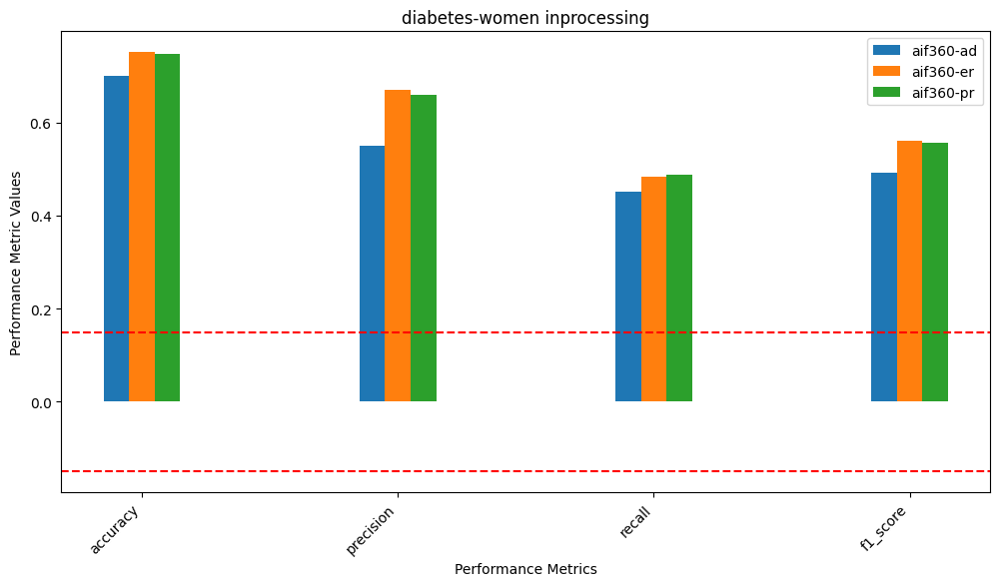

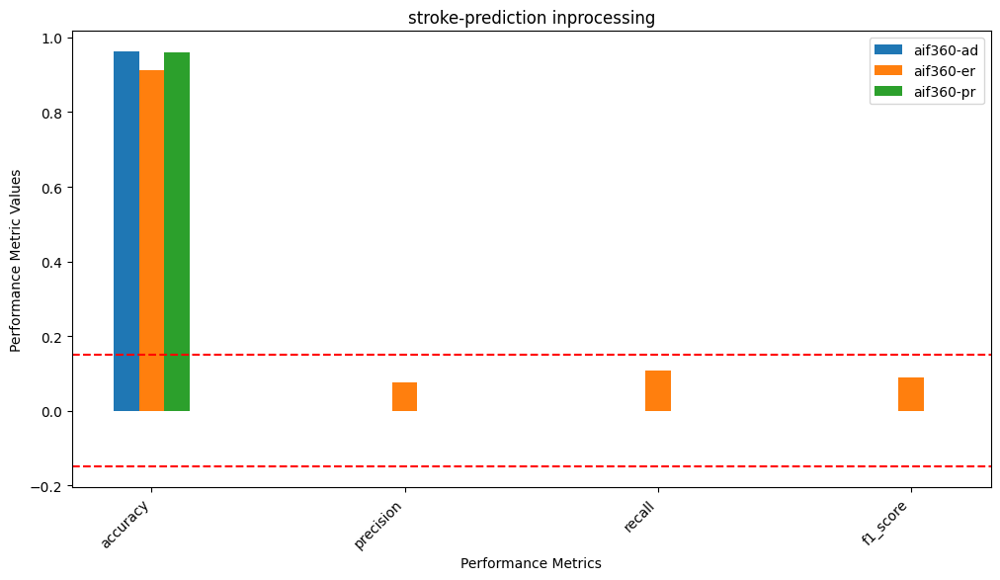

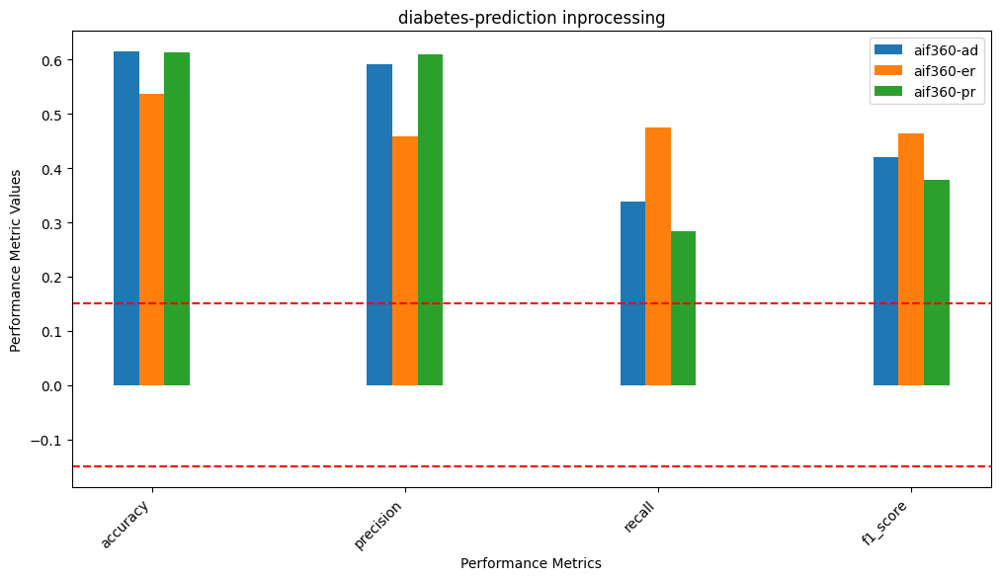

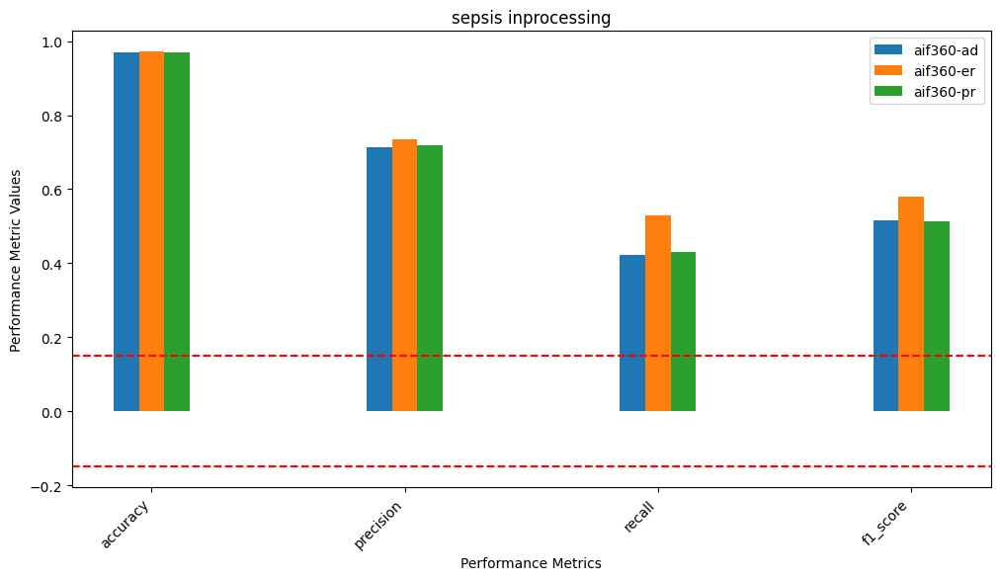

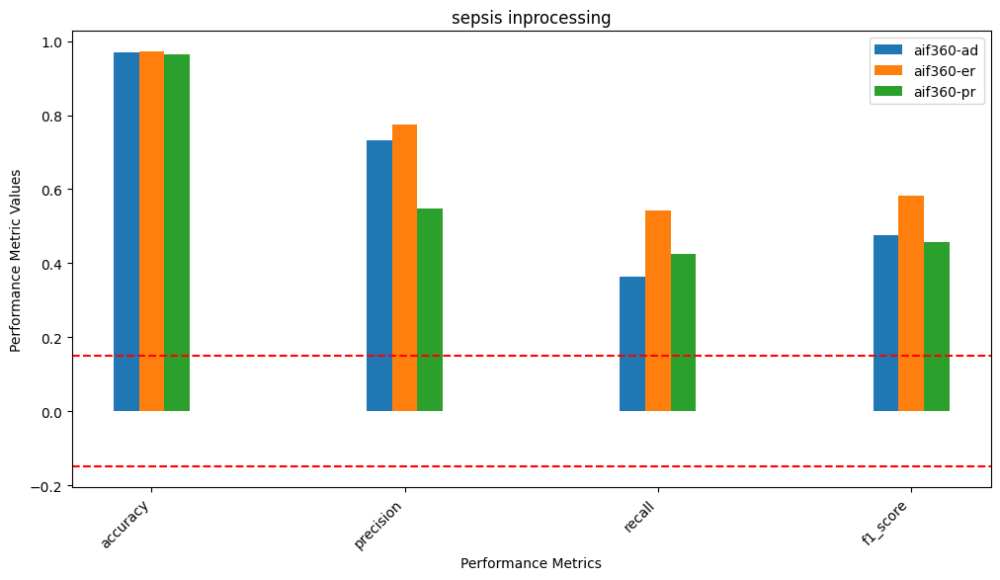

...

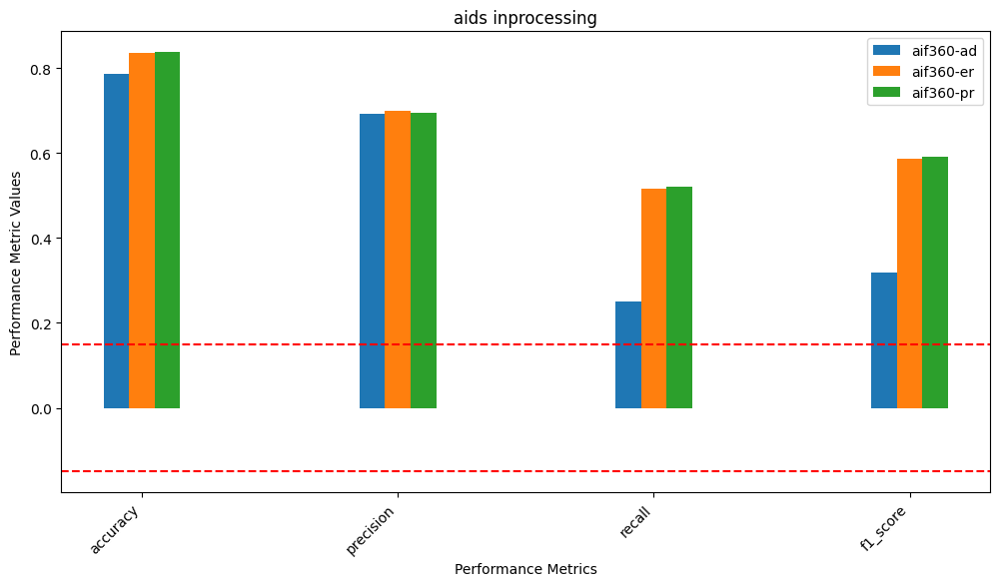

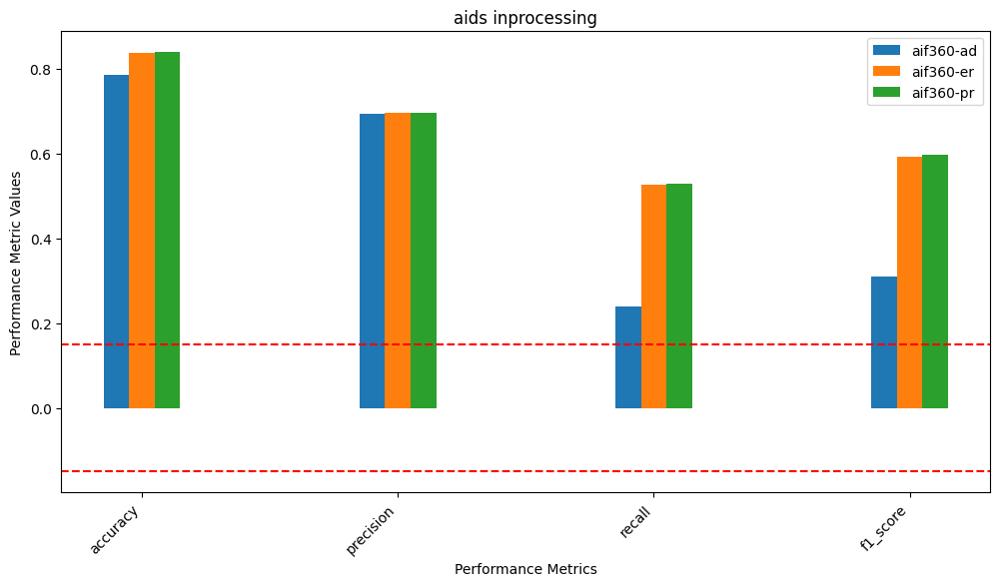

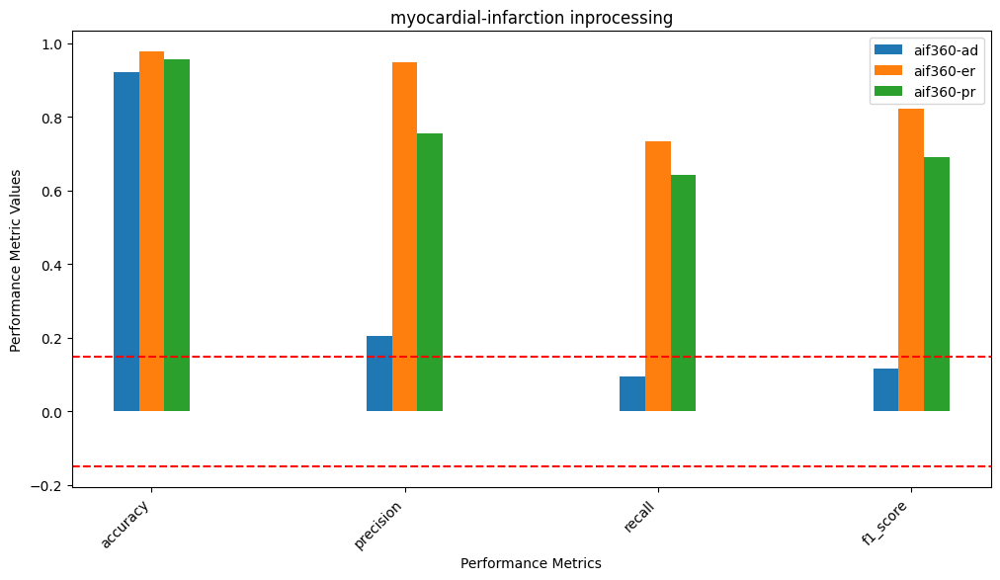

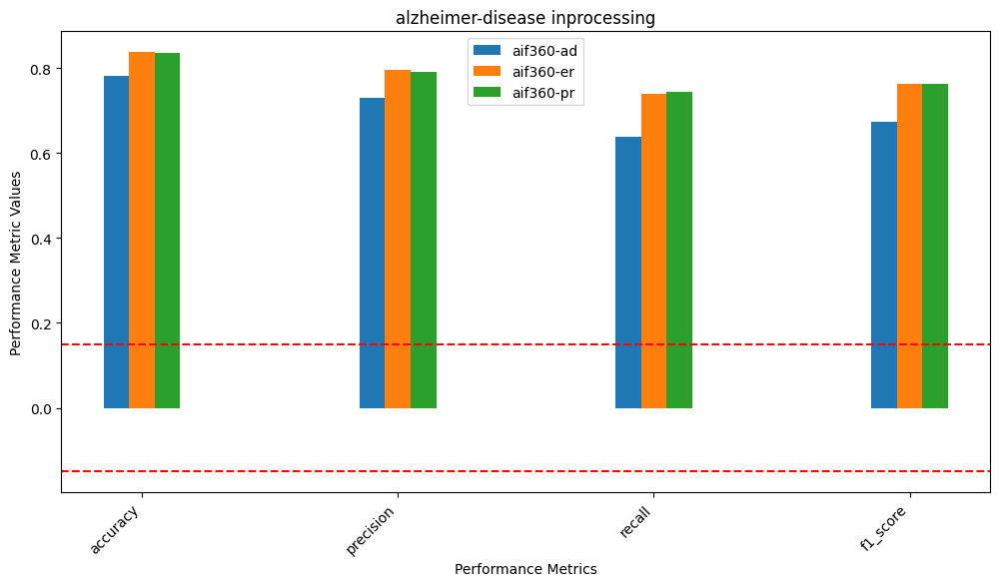

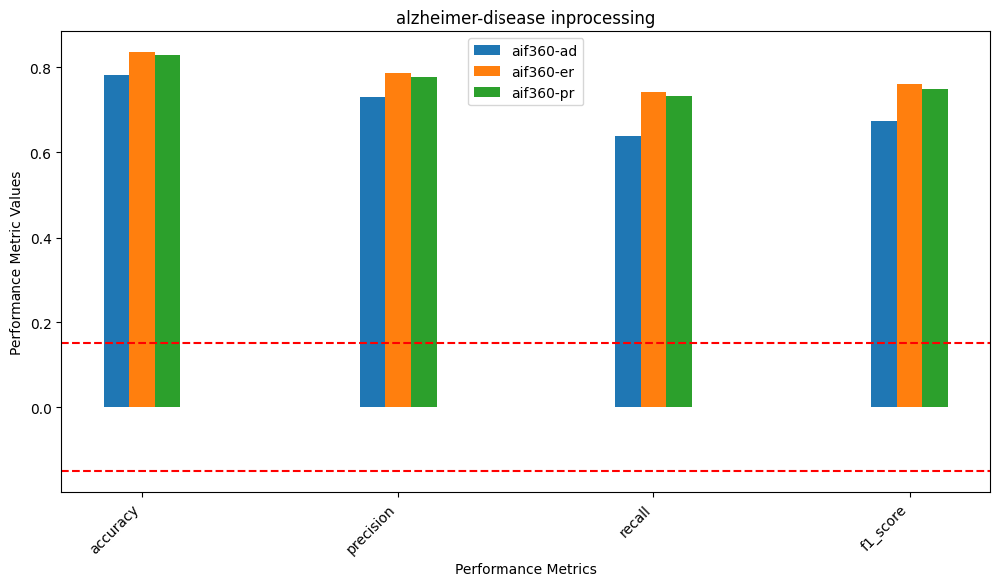

In [ ]:
for dataset_name in dataset_list:
  for sensible_attribute in datasets_config[dataset_name]['sensible_attributes']:
    perf_grouped_bar_no_model(performance_metrics[dataset_name][sensible_attribute], ["aif360-ad", "aif360-er",'aif360-pr'], 'inprocessing', dataset_name, sensible_attribute)
    #'orig-Logistic Regression','orig-Bagging','orig-Random Forest', 'orig-Extremely Randomized Trees','orig-Decision Tree', 'orig-Ada Boost'

In [ ]:
for dataset in dataset_list:
  for sensible_attribute in datasets_config[dataset]['sensible_attributes']:
    print(dataset, sensible_attribute)
    df = perf_data_framing(performance_metrics, dataset, sensible_attribute, None, ["aif360-ad", "aif360-er",'aif360-pr'])
    display(df)

diabetes-women AgeCategory


,accuracy,precision,recall,f1_score
Mitigation,,,,
aif360-ad,0.701+/-0.015,0.550+/-0.096,0.452+/-0.088,0.492+/-0.077
aif360-er,0.751+/-0.033,0.671+/-0.067,0.484+/-0.039,0.560+/-0.032
aif360-pr,0.747+/-0.032,0.659+/-0.074,0.488+/-0.028,0.558+/-0.025


stroke-prediction residence_category


,accuracy,precision,recall,f1_score
Mitigation,,,,
aif360-ad,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-er,0.913+/-0.010,0.076+/-0.073,0.107+/-0.102,0.088+/-0.084
aif360-pr,0.961+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


diabetes-prediction race_category


,accuracy,precision,recall,f1_score
Mitigation,,,,
aif360-ad,0.614+/-0.038,0.591+/-0.071,0.339+/-0.079,0.420+/-0.060
aif360-er,0.537+/-0.010,0.459+/-0.065,0.474+/-0.018,0.463+/-0.031
aif360-pr,0.614+/-0.043,0.609+/-0.069,0.284+/-0.067,0.379+/-0.055


sepsis Gender_cat


,accuracy,precision,recall,f1_score
Mitigation,,,,
aif360-ad,0.970+/-0.015,0.713+/-0.173,0.422+/-0.162,0.516+/-0.164
aif360-er,0.971+/-0.010,0.734+/-0.179,0.529+/-0.135,0.580+/-0.057
aif360-pr,0.970+/-0.008,0.720+/-0.221,0.430+/-0.138,0.512+/-0.119


sepsis Age_cat


,accuracy,precision,recall,f1_score
Mitigation,,,,
aif360-ad,0.970+/-0.017,0.733+/-0.226,0.365+/-0.197,0.475+/-0.223
aif360-er,0.971+/-0.013,0.774+/-0.137,0.542+/-0.267,0.584+/-0.154
aif360-pr,0.965+/-0.009,0.548+/-0.250,0.426+/-0.195,0.456+/-0.201


aids homo_cat


,accuracy,precision,recall,f1_score
Mitigation,,,,
aif360-ad,0.784+/-0.020,0.683+/-0.225,0.231+/-0.148,0.300+/-0.140
aif360-er,0.835+/-0.020,0.692+/-0.114,0.521+/-0.062,0.589+/-0.061
aif360-pr,0.841+/-0.026,0.712+/-0.113,0.532+/-0.068,0.603+/-0.069


aids race_cat


,accuracy,precision,recall,f1_score
Mitigation,,,,
aif360-ad,0.786+/-0.021,0.692+/-0.216,0.251+/-0.152,0.319+/-0.144
aif360-er,0.836+/-0.023,0.700+/-0.117,0.516+/-0.083,0.587+/-0.073
aif360-pr,0.837+/-0.023,0.693+/-0.112,0.521+/-0.086,0.590+/-0.080


aids age_cat


,accuracy,precision,recall,f1_score
Mitigation,,,,
aif360-ad,0.786+/-0.021,0.693+/-0.215,0.240+/-0.147,0.310+/-0.139
aif360-er,0.836+/-0.024,0.695+/-0.120,0.526+/-0.076,0.593+/-0.075
aif360-pr,0.838+/-0.019,0.695+/-0.113,0.529+/-0.069,0.596+/-0.071


myocardial-infarction SEX


,accuracy,precision,recall,f1_score
Mitigation,,,,
aif360-ad,0.921+/-0.015,0.206+/-0.252,0.095+/-0.159,0.116+/-0.179
aif360-er,0.977+/-0.009,0.948+/-0.048,0.733+/-0.093,0.823+/-0.063
aif360-pr,0.957+/-0.009,0.754+/-0.024,0.642+/-0.072,0.690+/-0.040


alzheimer-disease Ethnicity_cat


,accuracy,precision,recall,f1_score
Mitigation,,,,
aif360-ad,0.781+/-0.084,0.730+/-0.095,0.638+/-0.115,0.674+/-0.079
aif360-er,0.837+/-0.079,0.797+/-0.068,0.740+/-0.126,0.763+/-0.093
aif360-pr,0.837+/-0.083,0.791+/-0.071,0.744+/-0.125,0.763+/-0.097


alzheimer-disease Gender_cat


,accuracy,precision,recall,f1_score
Mitigation,,,,
aif360-ad,0.781+/-0.084,0.730+/-0.095,0.638+/-0.115,0.674+/-0.079
aif360-er,0.835+/-0.076,0.787+/-0.064,0.743+/-0.124,0.759+/-0.091
aif360-pr,0.828+/-0.076,0.777+/-0.058,0.731+/-0.125,0.749+/-0.091


### all in-processing techniques, division, no ML models

In [ ]:
for dataset_name in dataset_list:
  for sensible_attribute in datasets_config[dataset_name]['sensible_attributes']:
    grouped_bar_no_model(inprocessing_metrics[dataset_name][sensible_attribute], inprocessing_mitigation_list, "division", 'inprocessing', dataset_name, sensible_attribute)

In [ ]:
for dataset_name in dataset_list:
  for sensible_attribute in datasets_config[dataset_name]['sensible_attributes']:
    grouped_bar_no_model_std_dev(inprocessing_metrics[dataset_name][sensible_attribute], inprocessing_mitigation_list, "division", 'inprocessing', dataset_name, sensible_attribute)

## Display division fairness metrics in a dataframe

In [ ]:
for dataset in dataset_list:
  for sensible_attribute in datasets_config[dataset]['sensible_attributes']:
    df = data_framing(inprocessing_metrics, dataset, sensible_attribute, "division", None, ["aif360-ad", "aif360-er",'aif360-pr'], 'mean')
    display(df)

/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.148+/-0.038,0.138+/-0.041,0.124+/-0.171,-0.502+/-0.211,0.051+/-0.085,-0.025+/-0.244,0.117+/-0.041,0.003+/-0.399,0.132+/-0.260,-0.350+/-0.274,-0.369+/-0.223
aif360-er,0.001+/-0.044,0.161+/-0.025,-0.398+/-0.329,0.256+/-0.172,-0.053+/-0.212,-0.100+/-0.164,0.083+/-0.025,0.478+/-0.740,0.425+/-0.169,0.422+/-0.151,-0.728+/-0.142
aif360-pr,0.179+/-0.022,0.114+/-0.050,0.224+/-0.157,-0.824+/-0.175,0.104+/-0.054,0.055+/-0.163,0.112+/-0.028,-0.572+/-0.527,-0.225+/-0.636,-0.753+/-0.250,-0.273+/-0.239


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-er,0.001+/-0.015,0.004+/-0.012,-0.051+/-0.051,-0.033+/-0.253,-0.026+/-0.028,0.117+/-0.039,0.006+/-0.019,0.088+/-0.317,-0.027+/-0.029,-0.031+/-0.250,-0.117+/-0.312
aif360-pr,-0.001+/-0.002,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,-0.000+/-0.001,0.333+/-0.000,0.001+/-0.011,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.017+/-0.025,0.025+/-0.038,0.006+/-0.033,-0.095+/-0.070,0.004+/-0.017,0.025+/-0.008,0.024+/-0.023,-0.047+/-0.093,-0.019+/-0.061,-0.073+/-0.062,-0.026+/-0.050
aif360-er,-0.001+/-0.019,0.019+/-0.041,0.002+/-0.022,0.006+/-0.023,-0.001+/-0.012,-0.017+/-0.031,-0.001+/-0.012,0.058+/-0.073,0.027+/-0.050,0.028+/-0.030,-0.030+/-0.049
aif360-pr,0.014+/-0.027,0.022+/-0.039,0.009+/-0.041,-0.089+/-0.089,0.005+/-0.020,0.014+/-0.020,0.021+/-0.027,-0.044+/-0.098,-0.011+/-0.057,-0.067+/-0.071,-0.023+/-0.052


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,-0.006+/-0.012,-0.002+/-0.016,-0.305+/-0.577,-0.200+/-0.653,0.175+/-0.137,0.095+/-0.249,-0.004+/-0.022,-0.200+/-0.653,-0.200+/-0.653,-0.200+/-0.653,-0.326+/-0.571
aif360-er,-0.008+/-0.008,0.003+/-0.015,-0.450+/-0.507,-0.308+/-0.598,0.092+/-0.232,0.132+/-0.111,0.003+/-0.016,-0.200+/-0.653,-0.400+/-0.611,-0.311+/-0.598,-0.458+/-0.533
aif360-pr,-0.001+/-0.015,-0.005+/-0.018,-0.267+/-0.611,-0.200+/-0.653,0.190+/-0.129,0.206+/-0.175,-0.007+/-0.019,-0.200+/-0.653,-0.200+/-0.653,-0.200+/-0.653,-0.286+/-0.589


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.015+/-0.011,0.005+/-0.007,0.322+/-0.186,0.067+/-0.533,0.134+/-0.065,0.267+/-0.132,0.004+/-0.004,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,-0.217+/-0.184
aif360-er,0.009+/-0.006,0.006+/-0.007,0.278+/-0.270,0.333+/-0.000,0.109+/-0.107,0.073+/-0.223,0.000+/-0.010,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.123+/-0.269
aif360-pr,0.020+/-0.016,0.006+/-0.006,0.340+/-0.237,-0.298+/-0.601,0.137+/-0.087,0.188+/-0.185,0.010+/-0.018,-0.200+/-0.653,-0.200+/-0.653,-0.293+/-0.602,-0.189+/-0.202


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,-0.010+/-0.021,-0.004+/-0.040,-0.076+/-0.069,0.126+/-0.233,-0.040+/-0.040,0.126+/-0.145,0.002+/-0.044,0.177+/-0.195,0.089+/-0.261,0.126+/-0.226,0.002+/-0.179
aif360-er,0.003+/-0.016,-0.003+/-0.041,-0.018+/-0.170,-0.247+/-0.271,-0.016+/-0.081,0.060+/-0.043,0.016+/-0.038,-0.258+/-0.377,-0.246+/-0.272,-0.261+/-0.284,0.050+/-0.281
aif360-pr,-0.031+/-0.026,0.011+/-0.037,-0.153+/-0.123,0.036+/-0.324,-0.087+/-0.071,0.040+/-0.037,0.016+/-0.032,0.081+/-0.426,-0.133+/-0.247,0.017+/-0.331,-0.077+/-0.235


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,-0.002+/-0.014,0.021+/-0.029,0.029+/-0.047,0.047+/-0.545,0.012+/-0.025,0.014+/-0.180,0.007+/-0.035,0.055+/-0.562,0.033+/-0.544,0.054+/-0.550,-0.082+/-0.122
aif360-er,-0.007+/-0.029,0.016+/-0.034,-0.063+/-0.224,0.273+/-0.268,-0.051+/-0.129,-0.081+/-0.084,-0.009+/-0.040,0.415+/-0.346,0.278+/-0.254,0.300+/-0.272,-0.164+/-0.264
aif360-pr,0.035+/-0.031,-0.004+/-0.033,0.128+/-0.163,-0.034+/-0.320,0.054+/-0.076,-0.075+/-0.085,-0.012+/-0.038,-0.026+/-0.366,0.177+/-0.299,-0.005+/-0.323,0.019+/-0.219


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.011+/-0.020,-0.004+/-0.033,0.070+/-0.136,0.125+/-0.438,0.029+/-0.061,-0.105+/-0.140,-0.012+/-0.045,0.094+/-0.432,0.152+/-0.428,0.130+/-0.438,0.034+/-0.166
aif360-er,0.002+/-0.032,-0.007+/-0.025,0.106+/-0.152,0.252+/-0.254,0.044+/-0.065,-0.064+/-0.053,-0.022+/-0.030,0.196+/-0.302,0.276+/-0.205,0.264+/-0.248,0.068+/-0.196
aif360-pr,0.016+/-0.033,-0.014+/-0.030,0.172+/-0.192,0.144+/-0.287,0.068+/-0.080,-0.060+/-0.057,-0.024+/-0.037,0.024+/-0.311,0.225+/-0.240,0.156+/-0.279,0.131+/-0.239


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.004+/-0.003,-0.032+/-0.014,0.075+/-0.096,-0.520+/-0.594,0.035+/-0.042,0.262+/-0.142,-0.029+/-0.014,-0.624+/-0.523,-0.524+/-0.590,-0.526+/-0.588,0.407+/-0.213
aif360-er,-0.001+/-0.018,-0.027+/-0.008,0.379+/-0.091,-0.467+/-0.653,0.158+/-0.030,0.017+/-0.028,-0.023+/-0.008,0.067+/-0.533,-0.467+/-0.653,-0.467+/-0.653,0.402+/-0.138
aif360-pr,-0.040+/-0.020,0.001+/-0.011,-0.435+/-0.303,0.238+/-0.633,-0.076+/-0.216,0.033+/-0.054,-0.005+/-0.009,-0.190+/-0.731,-0.249+/-0.427,0.218+/-0.625,-0.102+/-0.485


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.010+/-0.049,0.023+/-0.064,-0.121+/-0.262,-0.121+/-0.307,-0.077+/-0.143,0.024+/-0.046,0.028+/-0.063,0.035+/-0.363,-0.103+/-0.245,-0.107+/-0.295,-0.150+/-0.301
aif360-er,0.001+/-0.068,0.018+/-0.045,-0.204+/-0.324,-0.072+/-0.312,-0.157+/-0.220,0.016+/-0.030,0.018+/-0.035,0.175+/-0.465,-0.063+/-0.215,-0.059+/-0.294,-0.225+/-0.329
aif360-pr,0.016+/-0.054,0.006+/-0.031,-0.063+/-0.171,-0.071+/-0.277,-0.039+/-0.099,0.008+/-0.024,0.009+/-0.023,0.027+/-0.327,-0.036+/-0.212,-0.059+/-0.266,-0.095+/-0.187


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.024+/-0.034,0.001+/-0.054,0.108+/-0.217,-0.102+/-0.234,0.042+/-0.090,0.004+/-0.051,0.006+/-0.051,-0.168+/-0.294,-0.032+/-0.266,-0.089+/-0.253,0.080+/-0.267
aif360-er,-0.001+/-0.051,0.011+/-0.029,-0.073+/-0.155,0.054+/-0.334,-0.051+/-0.086,-0.002+/-0.043,0.007+/-0.032,0.178+/-0.370,0.059+/-0.348,0.067+/-0.348,-0.098+/-0.203
aif360-pr,0.014+/-0.044,0.004+/-0.035,0.006+/-0.179,-0.006+/-0.329,-0.001+/-0.088,-0.004+/-0.047,0.006+/-0.036,0.038+/-0.370,0.025+/-0.354,0.006+/-0.352,-0.020+/-0.227


In [ ]:
for dataset in dataset_list:
  for sensible_attribute in datasets_config[dataset]['sensible_attributes']:
    df = data_framing(inprocessing_metrics, dataset, sensible_attribute, "division", None, ["aif360-ad", "aif360-er",'aif360-pr'], 'mean and std dev')
    display(df)

/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.148+/-0.038,0.138+/-0.041,0.124+/-0.171,-0.502+/-0.211,0.051+/-0.085,-0.025+/-0.244,0.117+/-0.041,0.003+/-0.399,0.132+/-0.260,-0.350+/-0.274,-0.369+/-0.223
aif360-er,0.001+/-0.044,0.161+/-0.025,-0.398+/-0.329,0.256+/-0.172,-0.053+/-0.212,-0.100+/-0.164,0.083+/-0.025,0.478+/-0.740,0.425+/-0.169,0.422+/-0.151,-0.728+/-0.142
aif360-pr,0.179+/-0.022,0.114+/-0.050,0.224+/-0.157,-0.824+/-0.175,0.104+/-0.054,0.055+/-0.163,0.112+/-0.028,-0.572+/-0.527,-0.225+/-0.636,-0.753+/-0.250,-0.273+/-0.239


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-er,0.001+/-0.015,0.004+/-0.012,-0.051+/-0.051,-0.033+/-0.253,-0.026+/-0.028,0.117+/-0.039,0.006+/-0.019,0.088+/-0.317,-0.027+/-0.029,-0.031+/-0.250,-0.117+/-0.312
aif360-pr,-0.001+/-0.002,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,-0.000+/-0.001,0.333+/-0.000,0.001+/-0.011,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.017+/-0.025,0.025+/-0.038,0.006+/-0.033,-0.095+/-0.070,0.004+/-0.017,0.025+/-0.008,0.024+/-0.023,-0.047+/-0.093,-0.019+/-0.061,-0.073+/-0.062,-0.026+/-0.050
aif360-er,-0.001+/-0.019,0.019+/-0.041,0.002+/-0.022,0.006+/-0.023,-0.001+/-0.012,-0.017+/-0.031,-0.001+/-0.012,0.058+/-0.073,0.027+/-0.050,0.028+/-0.030,-0.030+/-0.049
aif360-pr,0.014+/-0.027,0.022+/-0.039,0.009+/-0.041,-0.089+/-0.089,0.005+/-0.020,0.014+/-0.020,0.021+/-0.027,-0.044+/-0.098,-0.011+/-0.057,-0.067+/-0.071,-0.023+/-0.052


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,-0.006+/-0.012,-0.002+/-0.016,-0.305+/-0.577,-0.200+/-0.653,0.175+/-0.137,0.095+/-0.249,-0.004+/-0.022,-0.200+/-0.653,-0.200+/-0.653,-0.200+/-0.653,-0.326+/-0.571
aif360-er,-0.008+/-0.008,0.003+/-0.015,-0.450+/-0.507,-0.308+/-0.598,0.092+/-0.232,0.132+/-0.111,0.003+/-0.016,-0.200+/-0.653,-0.400+/-0.611,-0.311+/-0.598,-0.458+/-0.533
aif360-pr,-0.001+/-0.015,-0.005+/-0.018,-0.267+/-0.611,-0.200+/-0.653,0.190+/-0.129,0.206+/-0.175,-0.007+/-0.019,-0.200+/-0.653,-0.200+/-0.653,-0.200+/-0.653,-0.286+/-0.589


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.015+/-0.011,0.005+/-0.007,0.322+/-0.186,0.067+/-0.533,0.134+/-0.065,0.267+/-0.132,0.004+/-0.004,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,-0.217+/-0.184
aif360-er,0.009+/-0.006,0.006+/-0.007,0.278+/-0.270,0.333+/-0.000,0.109+/-0.107,0.073+/-0.223,0.000+/-0.010,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.123+/-0.269
aif360-pr,0.020+/-0.016,0.006+/-0.006,0.340+/-0.237,-0.298+/-0.601,0.137+/-0.087,0.188+/-0.185,0.010+/-0.018,-0.200+/-0.653,-0.200+/-0.653,-0.293+/-0.602,-0.189+/-0.202


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,-0.010+/-0.021,-0.004+/-0.040,-0.076+/-0.069,0.126+/-0.233,-0.040+/-0.040,0.126+/-0.145,0.002+/-0.044,0.177+/-0.195,0.089+/-0.261,0.126+/-0.226,0.002+/-0.179
aif360-er,0.003+/-0.016,-0.003+/-0.041,-0.018+/-0.170,-0.247+/-0.271,-0.016+/-0.081,0.060+/-0.043,0.016+/-0.038,-0.258+/-0.377,-0.246+/-0.272,-0.261+/-0.284,0.050+/-0.281
aif360-pr,-0.031+/-0.026,0.011+/-0.037,-0.153+/-0.123,0.036+/-0.324,-0.087+/-0.071,0.040+/-0.037,0.016+/-0.032,0.081+/-0.426,-0.133+/-0.247,0.017+/-0.331,-0.077+/-0.235


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,-0.002+/-0.014,0.021+/-0.029,0.029+/-0.047,0.047+/-0.545,0.012+/-0.025,0.014+/-0.180,0.007+/-0.035,0.055+/-0.562,0.033+/-0.544,0.054+/-0.550,-0.082+/-0.122
aif360-er,-0.007+/-0.029,0.016+/-0.034,-0.063+/-0.224,0.273+/-0.268,-0.051+/-0.129,-0.081+/-0.084,-0.009+/-0.040,0.415+/-0.346,0.278+/-0.254,0.300+/-0.272,-0.164+/-0.264
aif360-pr,0.035+/-0.031,-0.004+/-0.033,0.128+/-0.163,-0.034+/-0.320,0.054+/-0.076,-0.075+/-0.085,-0.012+/-0.038,-0.026+/-0.366,0.177+/-0.299,-0.005+/-0.323,0.019+/-0.219


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.011+/-0.020,-0.004+/-0.033,0.070+/-0.136,0.125+/-0.438,0.029+/-0.061,-0.105+/-0.140,-0.012+/-0.045,0.094+/-0.432,0.152+/-0.428,0.130+/-0.438,0.034+/-0.166
aif360-er,0.002+/-0.032,-0.007+/-0.025,0.106+/-0.152,0.252+/-0.254,0.044+/-0.065,-0.064+/-0.053,-0.022+/-0.030,0.196+/-0.302,0.276+/-0.205,0.264+/-0.248,0.068+/-0.196
aif360-pr,0.016+/-0.033,-0.014+/-0.030,0.172+/-0.192,0.144+/-0.287,0.068+/-0.080,-0.060+/-0.057,-0.024+/-0.037,0.024+/-0.311,0.225+/-0.240,0.156+/-0.279,0.131+/-0.239


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.004+/-0.003,-0.032+/-0.014,0.075+/-0.096,-0.520+/-0.594,0.035+/-0.042,0.262+/-0.142,-0.029+/-0.014,-0.624+/-0.523,-0.524+/-0.590,-0.526+/-0.588,0.407+/-0.213
aif360-er,-0.001+/-0.018,-0.027+/-0.008,0.379+/-0.091,-0.467+/-0.653,0.158+/-0.030,0.017+/-0.028,-0.023+/-0.008,0.067+/-0.533,-0.467+/-0.653,-0.467+/-0.653,0.402+/-0.138
aif360-pr,-0.040+/-0.020,0.001+/-0.011,-0.435+/-0.303,0.238+/-0.633,-0.076+/-0.216,0.033+/-0.054,-0.005+/-0.009,-0.190+/-0.731,-0.249+/-0.427,0.218+/-0.625,-0.102+/-0.485


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.010+/-0.049,0.023+/-0.064,-0.121+/-0.262,-0.121+/-0.307,-0.077+/-0.143,0.024+/-0.046,0.028+/-0.063,0.035+/-0.363,-0.103+/-0.245,-0.107+/-0.295,-0.150+/-0.301
aif360-er,0.001+/-0.068,0.018+/-0.045,-0.204+/-0.324,-0.072+/-0.312,-0.157+/-0.220,0.016+/-0.030,0.018+/-0.035,0.175+/-0.465,-0.063+/-0.215,-0.059+/-0.294,-0.225+/-0.329
aif360-pr,0.016+/-0.054,0.006+/-0.031,-0.063+/-0.171,-0.071+/-0.277,-0.039+/-0.099,0.008+/-0.024,0.009+/-0.023,0.027+/-0.327,-0.036+/-0.212,-0.059+/-0.266,-0.095+/-0.187


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.024+/-0.034,0.001+/-0.054,0.108+/-0.217,-0.102+/-0.234,0.042+/-0.090,0.004+/-0.051,0.006+/-0.051,-0.168+/-0.294,-0.032+/-0.266,-0.089+/-0.253,0.080+/-0.267
aif360-er,-0.001+/-0.051,0.011+/-0.029,-0.073+/-0.155,0.054+/-0.334,-0.051+/-0.086,-0.002+/-0.043,0.007+/-0.032,0.178+/-0.370,0.059+/-0.348,0.067+/-0.348,-0.098+/-0.203
aif360-pr,0.014+/-0.044,0.004+/-0.035,0.006+/-0.179,-0.006+/-0.329,-0.001+/-0.088,-0.004+/-0.047,0.006+/-0.036,0.038+/-0.370,0.025+/-0.354,0.006+/-0.352,-0.020+/-0.227


### all three in-processing techniques, subtraction, no ML models

In [ ]:
for dataset_name in dataset_list:
  for sensible_attribute in datasets_config[dataset_name]['sensible_attributes']:
    grouped_bar_no_model(inprocessing_metrics[dataset_name][sensible_attribute], inprocessing_mitigation_list, "subtraction", 'inprocessing', dataset_name, sensible_attribute)

In [ ]:
for dataset_name in dataset_list:
  for sensible_attribute in datasets_config[dataset_name]['sensible_attributes']:
    grouped_bar_no_model_std_dev(inprocessing_metrics[dataset_name][sensible_attribute], inprocessing_mitigation_list, "subtraction", 'inprocessing', dataset_name, sensible_attribute)

## Display subtraction fairness metrics in a dataframe

In [ ]:
for dataset in dataset_list:
  for sensible_attribute in datasets_config[dataset]['sensible_attributes']:
    df = data_framing(inprocessing_metrics, dataset, sensible_attribute, "subtraction", None, ["aif360-ad", "aif360-er",'aif360-pr'], 'mean')
    display(df)

/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.223+/-0.052,0.214+/-0.066,0.169+/-0.214,-0.156+/-0.049,0.169+/-0.214,-0.154+/-0.310,0.172+/-0.066,0.069+/-0.530,0.206+/-0.251,-0.061+/-0.052,-0.111+/-0.067
aif360-er,0.003+/-0.067,0.260+/-0.032,-0.283+/-0.170,0.056+/-0.036,-0.283+/-0.170,-0.134+/-0.347,0.126+/-0.036,0.729+/-0.543,0.323+/-0.132,0.071+/-0.021,-0.198+/-0.022
aif360-pr,0.287+/-0.036,0.178+/-0.080,0.296+/-0.221,-0.178+/-0.024,0.338+/-0.174,0.101+/-0.339,0.173+/-0.045,-0.276+/-0.631,0.083+/-0.333,-0.094+/-0.021,-0.079+/-0.065


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-er,0.001+/-0.028,0.007+/-0.022,-0.083+/-0.084,-0.004+/-0.027,-0.082+/-0.087,0.051+/-0.053,0.011+/-0.035,0.228+/-0.688,-0.049+/-0.053,-0.004+/-0.026,-0.007+/-0.021
aif360-pr,-0.002+/-0.003,0.004+/-0.023,0.000+/-0.000,0.002+/-0.003,-0.002+/-0.003,0.004+/-0.023,0.002+/-0.021,0.067+/-0.133,0.200+/-0.400,0.002+/-0.003,-0.004+/-0.023


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.026+/-0.037,0.031+/-0.046,0.009+/-0.041,-0.032+/-0.025,0.016+/-0.046,0.055+/-0.035,0.030+/-0.028,-0.044+/-0.072,-0.013+/-0.045,-0.015+/-0.014,-0.015+/-0.030
aif360-er,-0.001+/-0.021,0.023+/-0.049,0.002+/-0.024,0.005+/-0.019,-0.001+/-0.027,0.009+/-0.065,-0.001+/-0.013,0.143+/-0.187,0.030+/-0.053,0.014+/-0.014,-0.013+/-0.021
aif360-pr,0.023+/-0.042,0.027+/-0.046,0.012+/-0.053,-0.024+/-0.028,0.018+/-0.055,0.049+/-0.034,0.026+/-0.033,-0.037+/-0.083,-0.007+/-0.043,-0.012+/-0.015,-0.015+/-0.033


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,-0.011+/-0.023,-0.003+/-0.031,-0.123+/-0.644,0.005+/-0.016,0.007+/-0.584,-0.132+/-0.687,-0.008+/-0.043,-0.033+/-0.323,0.067+/-0.712,0.005+/-0.015,0.003+/-0.030
aif360-er,-0.015+/-0.016,0.006+/-0.030,-0.280+/-0.513,0.001+/-0.015,-0.219+/-0.521,0.094+/-0.603,0.005+/-0.032,-0.233+/-0.389,-0.093+/-0.603,0.001+/-0.015,-0.006+/-0.029
aif360-pr,-0.002+/-0.030,-0.009+/-0.034,-0.033+/-0.733,0.003+/-0.018,0.091+/-0.665,-0.082+/-0.645,-0.013+/-0.037,-0.150+/-0.490,0.027+/-0.655,0.003+/-0.018,0.010+/-0.034


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.030+/-0.021,0.010+/-0.013,0.433+/-0.211,0.001+/-0.009,0.433+/-0.211,-0.398+/-0.491,0.008+/-0.008,0.233+/-0.467,0.333+/-0.558,0.001+/-0.009,-0.009+/-0.014
aif360-er,0.017+/-0.012,0.012+/-0.014,0.267+/-0.365,0.011+/-0.009,0.265+/-0.366,-0.559+/-0.400,0.000+/-0.020,0.350+/-0.374,0.567+/-0.389,0.011+/-0.009,-0.011+/-0.014
aif360-pr,0.039+/-0.030,0.011+/-0.012,0.407+/-0.255,-0.010+/-0.033,0.407+/-0.255,-0.325+/-0.418,0.019+/-0.034,-0.100+/-0.784,0.167+/-0.617,-0.010+/-0.032,-0.010+/-0.012


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,-0.021+/-0.037,-0.007+/-0.065,-0.115+/-0.093,-0.009+/-0.027,-0.111+/-0.099,0.041+/-0.134,0.002+/-0.069,0.038+/-0.137,0.011+/-0.212,-0.006+/-0.019,0.005+/-0.056
aif360-er,0.005+/-0.026,-0.006+/-0.070,-0.027+/-0.155,-0.037+/-0.031,-0.025+/-0.156,0.168+/-0.122,0.024+/-0.063,-0.339+/-0.452,-0.162+/-0.128,-0.031+/-0.025,0.006+/-0.060
aif360-pr,-0.052+/-0.044,0.018+/-0.063,-0.155+/-0.122,-0.001+/-0.035,-0.147+/-0.132,0.112+/-0.105,0.025+/-0.053,0.082+/-0.447,-0.091+/-0.124,-0.003+/-0.027,-0.022+/-0.054


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,-0.002+/-0.024,0.033+/-0.047,0.039+/-0.070,0.024+/-0.029,0.032+/-0.077,-0.179+/-0.332,0.012+/-0.055,0.168+/-0.252,0.143+/-0.381,0.020+/-0.025,-0.032+/-0.043
aif360-er,-0.011+/-0.047,0.029+/-0.059,-0.018+/-0.182,0.043+/-0.046,-0.031+/-0.182,-0.168+/-0.187,-0.012+/-0.066,0.429+/-0.402,0.182+/-0.169,0.036+/-0.038,-0.024+/-0.052
aif360-pr,0.059+/-0.050,-0.005+/-0.056,0.160+/-0.177,0.002+/-0.046,0.163+/-0.176,-0.142+/-0.199,-0.017+/-0.062,-0.050+/-0.494,0.151+/-0.191,0.004+/-0.038,0.013+/-0.052


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.018+/-0.035,-0.008+/-0.054,0.089+/-0.165,0.012+/-0.040,0.084+/-0.168,-0.189+/-0.289,-0.020+/-0.071,0.043+/-0.175,0.195+/-0.285,0.010+/-0.031,0.010+/-0.049
aif360-er,0.003+/-0.052,-0.012+/-0.044,0.095+/-0.127,0.033+/-0.036,0.084+/-0.140,-0.155+/-0.124,-0.037+/-0.051,0.126+/-0.453,0.159+/-0.118,0.026+/-0.026,0.011+/-0.036
aif360-pr,0.026+/-0.054,-0.025+/-0.052,0.152+/-0.152,0.020+/-0.040,0.144+/-0.163,-0.142+/-0.137,-0.041+/-0.063,-0.008+/-0.433,0.142+/-0.137,0.017+/-0.030,0.024+/-0.042


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.008+/-0.006,-0.059+/-0.026,0.105+/-0.128,-0.006+/-0.007,0.110+/-0.124,-0.059+/-0.026,-0.052+/-0.026,-0.289+/-0.209,-0.491+/-0.458,-0.006+/-0.006,0.058+/-0.026
aif360-er,-0.002+/-0.035,-0.052+/-0.014,0.446+/-0.170,-0.005+/-0.005,0.446+/-0.170,0.065+/-0.106,-0.045+/-0.015,-0.100+/-0.200,-0.087+/-0.080,-0.005+/-0.005,0.050+/-0.015
aif360-pr,-0.073+/-0.037,0.002+/-0.021,-0.282+/-0.129,0.016+/-0.020,-0.282+/-0.129,0.109+/-0.173,-0.009+/-0.017,0.051+/-0.591,-0.109+/-0.173,0.013+/-0.018,-0.004+/-0.020


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.011+/-0.070,0.040+/-0.104,-0.070+/-0.181,-0.028+/-0.070,-0.031+/-0.196,0.080+/-0.125,0.045+/-0.099,0.158+/-0.430,-0.043+/-0.117,-0.018+/-0.045,-0.027+/-0.078
aif360-er,0.001+/-0.092,0.036+/-0.072,-0.079+/-0.127,-0.009+/-0.066,-0.086+/-0.133,0.062+/-0.094,0.034+/-0.057,0.188+/-0.742,-0.026+/-0.078,-0.007+/-0.038,-0.027+/-0.048
aif360-pr,0.022+/-0.075,0.015+/-0.049,-0.023+/-0.075,-0.014+/-0.052,-0.005+/-0.088,0.034+/-0.076,0.018+/-0.038,0.036+/-0.467,-0.019+/-0.072,-0.009+/-0.031,-0.009+/-0.031


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.034+/-0.045,-0.003+/-0.084,0.043+/-0.110,-0.021+/-0.062,0.076+/-0.094,0.017+/-0.140,0.004+/-0.076,-0.238+/-0.473,-0.011+/-0.130,-0.010+/-0.043,0.006+/-0.056
aif360-er,-0.004+/-0.067,0.018+/-0.049,-0.033+/-0.073,0.005+/-0.063,-0.046+/-0.083,-0.000+/-0.134,0.009+/-0.053,0.316+/-0.565,0.018+/-0.130,0.006+/-0.043,-0.015+/-0.035
aif360-pr,0.017+/-0.057,0.005+/-0.057,0.002+/-0.094,-0.008+/-0.063,0.030+/-0.097,-0.008+/-0.144,0.007+/-0.060,0.119+/-0.590,0.002+/-0.143,-0.003+/-0.044,-0.004+/-0.041


In [ ]:
for dataset in dataset_list:
  for sensible_attribute in datasets_config[dataset]['sensible_attributes']:
    df = data_framing(inprocessing_metrics, dataset, sensible_attribute, "subtraction", None, ["aif360-ad", "aif360-er",'aif360-pr'], 'mean and std dev')
    display(df)

/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.223+/-0.052,0.214+/-0.066,0.169+/-0.214,-0.156+/-0.049,0.169+/-0.214,-0.154+/-0.310,0.172+/-0.066,0.069+/-0.530,0.206+/-0.251,-0.061+/-0.052,-0.111+/-0.067
aif360-er,0.003+/-0.067,0.260+/-0.032,-0.283+/-0.170,0.056+/-0.036,-0.283+/-0.170,-0.134+/-0.347,0.126+/-0.036,0.729+/-0.543,0.323+/-0.132,0.071+/-0.021,-0.198+/-0.022
aif360-pr,0.287+/-0.036,0.178+/-0.080,0.296+/-0.221,-0.178+/-0.024,0.338+/-0.174,0.101+/-0.339,0.173+/-0.045,-0.276+/-0.631,0.083+/-0.333,-0.094+/-0.021,-0.079+/-0.065


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-er,0.001+/-0.028,0.007+/-0.022,-0.083+/-0.084,-0.004+/-0.027,-0.082+/-0.087,0.051+/-0.053,0.011+/-0.035,0.228+/-0.688,-0.049+/-0.053,-0.004+/-0.026,-0.007+/-0.021
aif360-pr,-0.002+/-0.003,0.004+/-0.023,0.000+/-0.000,0.002+/-0.003,-0.002+/-0.003,0.004+/-0.023,0.002+/-0.021,0.067+/-0.133,0.200+/-0.400,0.002+/-0.003,-0.004+/-0.023


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.026+/-0.037,0.031+/-0.046,0.009+/-0.041,-0.032+/-0.025,0.016+/-0.046,0.055+/-0.035,0.030+/-0.028,-0.044+/-0.072,-0.013+/-0.045,-0.015+/-0.014,-0.015+/-0.030
aif360-er,-0.001+/-0.021,0.023+/-0.049,0.002+/-0.024,0.005+/-0.019,-0.001+/-0.027,0.009+/-0.065,-0.001+/-0.013,0.143+/-0.187,0.030+/-0.053,0.014+/-0.014,-0.013+/-0.021
aif360-pr,0.023+/-0.042,0.027+/-0.046,0.012+/-0.053,-0.024+/-0.028,0.018+/-0.055,0.049+/-0.034,0.026+/-0.033,-0.037+/-0.083,-0.007+/-0.043,-0.012+/-0.015,-0.015+/-0.033


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,-0.011+/-0.023,-0.003+/-0.031,-0.123+/-0.644,0.005+/-0.016,0.007+/-0.584,-0.132+/-0.687,-0.008+/-0.043,-0.033+/-0.323,0.067+/-0.712,0.005+/-0.015,0.003+/-0.030
aif360-er,-0.015+/-0.016,0.006+/-0.030,-0.280+/-0.513,0.001+/-0.015,-0.219+/-0.521,0.094+/-0.603,0.005+/-0.032,-0.233+/-0.389,-0.093+/-0.603,0.001+/-0.015,-0.006+/-0.029
aif360-pr,-0.002+/-0.030,-0.009+/-0.034,-0.033+/-0.733,0.003+/-0.018,0.091+/-0.665,-0.082+/-0.645,-0.013+/-0.037,-0.150+/-0.490,0.027+/-0.655,0.003+/-0.018,0.010+/-0.034


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.030+/-0.021,0.010+/-0.013,0.433+/-0.211,0.001+/-0.009,0.433+/-0.211,-0.398+/-0.491,0.008+/-0.008,0.233+/-0.467,0.333+/-0.558,0.001+/-0.009,-0.009+/-0.014
aif360-er,0.017+/-0.012,0.012+/-0.014,0.267+/-0.365,0.011+/-0.009,0.265+/-0.366,-0.559+/-0.400,0.000+/-0.020,0.350+/-0.374,0.567+/-0.389,0.011+/-0.009,-0.011+/-0.014
aif360-pr,0.039+/-0.030,0.011+/-0.012,0.407+/-0.255,-0.010+/-0.033,0.407+/-0.255,-0.325+/-0.418,0.019+/-0.034,-0.100+/-0.784,0.167+/-0.617,-0.010+/-0.032,-0.010+/-0.012


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,-0.021+/-0.037,-0.007+/-0.065,-0.115+/-0.093,-0.009+/-0.027,-0.111+/-0.099,0.041+/-0.134,0.002+/-0.069,0.038+/-0.137,0.011+/-0.212,-0.006+/-0.019,0.005+/-0.056
aif360-er,0.005+/-0.026,-0.006+/-0.070,-0.027+/-0.155,-0.037+/-0.031,-0.025+/-0.156,0.168+/-0.122,0.024+/-0.063,-0.339+/-0.452,-0.162+/-0.128,-0.031+/-0.025,0.006+/-0.060
aif360-pr,-0.052+/-0.044,0.018+/-0.063,-0.155+/-0.122,-0.001+/-0.035,-0.147+/-0.132,0.112+/-0.105,0.025+/-0.053,0.082+/-0.447,-0.091+/-0.124,-0.003+/-0.027,-0.022+/-0.054


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,-0.002+/-0.024,0.033+/-0.047,0.039+/-0.070,0.024+/-0.029,0.032+/-0.077,-0.179+/-0.332,0.012+/-0.055,0.168+/-0.252,0.143+/-0.381,0.020+/-0.025,-0.032+/-0.043
aif360-er,-0.011+/-0.047,0.029+/-0.059,-0.018+/-0.182,0.043+/-0.046,-0.031+/-0.182,-0.168+/-0.187,-0.012+/-0.066,0.429+/-0.402,0.182+/-0.169,0.036+/-0.038,-0.024+/-0.052
aif360-pr,0.059+/-0.050,-0.005+/-0.056,0.160+/-0.177,0.002+/-0.046,0.163+/-0.176,-0.142+/-0.199,-0.017+/-0.062,-0.050+/-0.494,0.151+/-0.191,0.004+/-0.038,0.013+/-0.052


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.018+/-0.035,-0.008+/-0.054,0.089+/-0.165,0.012+/-0.040,0.084+/-0.168,-0.189+/-0.289,-0.020+/-0.071,0.043+/-0.175,0.195+/-0.285,0.010+/-0.031,0.010+/-0.049
aif360-er,0.003+/-0.052,-0.012+/-0.044,0.095+/-0.127,0.033+/-0.036,0.084+/-0.140,-0.155+/-0.124,-0.037+/-0.051,0.126+/-0.453,0.159+/-0.118,0.026+/-0.026,0.011+/-0.036
aif360-pr,0.026+/-0.054,-0.025+/-0.052,0.152+/-0.152,0.020+/-0.040,0.144+/-0.163,-0.142+/-0.137,-0.041+/-0.063,-0.008+/-0.433,0.142+/-0.137,0.017+/-0.030,0.024+/-0.042


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.008+/-0.006,-0.059+/-0.026,0.105+/-0.128,-0.006+/-0.007,0.110+/-0.124,-0.059+/-0.026,-0.052+/-0.026,-0.289+/-0.209,-0.491+/-0.458,-0.006+/-0.006,0.058+/-0.026
aif360-er,-0.002+/-0.035,-0.052+/-0.014,0.446+/-0.170,-0.005+/-0.005,0.446+/-0.170,0.065+/-0.106,-0.045+/-0.015,-0.100+/-0.200,-0.087+/-0.080,-0.005+/-0.005,0.050+/-0.015
aif360-pr,-0.073+/-0.037,0.002+/-0.021,-0.282+/-0.129,0.016+/-0.020,-0.282+/-0.129,0.109+/-0.173,-0.009+/-0.017,0.051+/-0.591,-0.109+/-0.173,0.013+/-0.018,-0.004+/-0.020


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.011+/-0.070,0.040+/-0.104,-0.070+/-0.181,-0.028+/-0.070,-0.031+/-0.196,0.080+/-0.125,0.045+/-0.099,0.158+/-0.430,-0.043+/-0.117,-0.018+/-0.045,-0.027+/-0.078
aif360-er,0.001+/-0.092,0.036+/-0.072,-0.079+/-0.127,-0.009+/-0.066,-0.086+/-0.133,0.062+/-0.094,0.034+/-0.057,0.188+/-0.742,-0.026+/-0.078,-0.007+/-0.038,-0.027+/-0.048
aif360-pr,0.022+/-0.075,0.015+/-0.049,-0.023+/-0.075,-0.014+/-0.052,-0.005+/-0.088,0.034+/-0.076,0.018+/-0.038,0.036+/-0.467,-0.019+/-0.072,-0.009+/-0.031,-0.009+/-0.031


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
aif360-ad,0.034+/-0.045,-0.003+/-0.084,0.043+/-0.110,-0.021+/-0.062,0.076+/-0.094,0.017+/-0.140,0.004+/-0.076,-0.238+/-0.473,-0.011+/-0.130,-0.010+/-0.043,0.006+/-0.056
aif360-er,-0.004+/-0.067,0.018+/-0.049,-0.033+/-0.073,0.005+/-0.063,-0.046+/-0.083,-0.000+/-0.134,0.009+/-0.053,0.316+/-0.565,0.018+/-0.130,0.006+/-0.043,-0.015+/-0.035
aif360-pr,0.017+/-0.057,0.005+/-0.057,0.002+/-0.094,-0.008+/-0.063,0.030+/-0.097,-0.008+/-0.144,0.007+/-0.060,0.119+/-0.590,0.002+/-0.143,-0.003+/-0.044,-0.004+/-0.041


# Post-processing results

In [ ]:
print(postprocessing_mitigation_list)

['aif360-roc', 'aif360-ce', 'fl-to', 'aif360-eo']


In [ ]:
postprocessing_mitigation_list.insert(0,'original')

### Performance

In [ ]:
for dataset_name in dataset_list:
  for sensible_attribute in datasets_config[dataset_name]['sensible_attributes']:
    for m in models:
      perf_grouped_bar(performance_metrics[dataset_name][sensible_attribute], postprocessing_mitigation_list, m, 'postprocessing', dataset_name, sensible_attribute)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
for dataset in dataset_list:
  for sensible_attribute in datasets_config[dataset]['sensible_attributes']:
    for m in models:
      print(dataset, sensible_attribute, m)
      df = perf_data_framing(performance_metrics, dataset, sensible_attribute, m, postprocessing_mitigation_list)
      display(df)

diabetes-women AgeCategory Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.778+/-0.044,0.711+/-0.037,0.559+/-0.054,0.624+/-0.034
aif360-roc,0.738+/-0.074,0.727+/-0.163,0.357+/-0.267,0.405+/-0.281
aif360-ce,0.766+/-0.031,0.701+/-0.046,0.503+/-0.018,0.585+/-0.020
fl-to,0.704+/-0.035,0.651+/-0.133,0.416+/-0.241,0.430+/-0.180
aif360-eo,0.729+/-0.049,0.642+/-0.060,0.446+/-0.182,0.496+/-0.135


diabetes-women AgeCategory Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.705+/-0.046,0.562+/-0.060,0.518+/-0.077,0.534+/-0.040
aif360-roc,0.684+/-0.035,0.525+/-0.054,0.534+/-0.069,0.523+/-0.028
aif360-ce,0.692+/-0.029,0.559+/-0.096,0.498+/-0.103,0.509+/-0.019
fl-to,0.615+/-0.029,0.438+/-0.053,0.589+/-0.048,0.499+/-0.032
aif360-eo,0.637+/-0.045,0.439+/-0.092,0.393+/-0.175,0.397+/-0.112


diabetes-women AgeCategory Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.775+/-0.051,0.750+/-0.067,0.499+/-0.094,0.593+/-0.059
aif360-roc,0.766+/-0.045,0.745+/-0.040,0.453+/-0.061,0.560+/-0.044
aif360-ce,0.760+/-0.037,0.781+/-0.079,0.388+/-0.053,0.514+/-0.039
fl-to,0.699+/-0.036,0.555+/-0.057,0.458+/-0.041,0.498+/-0.029
aif360-eo,0.723+/-0.047,0.719+/-0.109,0.342+/-0.164,0.424+/-0.127


diabetes-women AgeCategory Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.763+/-0.040,0.688+/-0.059,0.541+/-0.081,0.599+/-0.032
aif360-roc,0.748+/-0.041,0.742+/-0.146,0.450+/-0.206,0.500+/-0.208
aif360-ce,0.754+/-0.028,0.677+/-0.051,0.488+/-0.042,0.564+/-0.024
fl-to,0.692+/-0.022,0.531+/-0.074,0.558+/-0.044,0.541+/-0.045
aif360-eo,0.662+/-0.140,0.570+/-0.145,0.563+/-0.213,0.521+/-0.061


diabetes-women AgeCategory Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.764+/-0.043,0.702+/-0.049,0.514+/-0.089,0.587+/-0.050
aif360-roc,0.710+/-0.047,0.571+/-0.328,0.211+/-0.228,0.256+/-0.256
aif360-ce,0.759+/-0.030,0.686+/-0.069,0.505+/-0.057,0.577+/-0.026
fl-to,0.683+/-0.030,0.522+/-0.068,0.563+/-0.045,0.536+/-0.032
aif360-eo,0.644+/-0.137,0.561+/-0.123,0.451+/-0.260,0.437+/-0.057


diabetes-women AgeCategory Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.760+/-0.032,0.651+/-0.048,0.579+/-0.032,0.612+/-0.032
aif360-roc,0.705+/-0.035,0.556+/-0.041,0.525+/-0.059,0.537+/-0.031
aif360-ce,0.713+/-0.035,0.589+/-0.047,0.428+/-0.052,0.492+/-0.034
fl-to,0.631+/-0.035,0.455+/-0.047,0.557+/-0.068,0.495+/-0.012
aif360-eo,0.676+/-0.042,0.510+/-0.062,0.409+/-0.076,0.449+/-0.059


stroke-prediction residence_category Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.960+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-roc,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-ce,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
fl-to,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-eo,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


stroke-prediction residence_category Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.911+/-0.005,0.044+/-0.026,0.064+/-0.039,0.051+/-0.029
aif360-roc,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-ce,0.915+/-0.015,0.083+/-0.084,0.092+/-0.087,0.083+/-0.077
fl-to,0.913+/-0.010,0.078+/-0.075,0.107+/-0.102,0.088+/-0.084
aif360-eo,0.469+/-0.375,0.071+/-0.039,0.625+/-0.369,0.103+/-0.031


stroke-prediction residence_category Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.959+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-roc,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-ce,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
fl-to,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-eo,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


stroke-prediction residence_category Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.959+/-0.004,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-roc,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-ce,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
fl-to,0.960+/-0.006,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-eo,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000


stroke-prediction residence_category Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.950+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-roc,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-ce,0.953+/-0.004,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
fl-to,0.950+/-0.007,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-eo,0.226+/-0.365,0.029+/-0.015,0.800+/-0.400,0.057+/-0.029


stroke-prediction residence_category Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.958+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-roc,0.962+/-0.005,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000
aif360-ce,0.942+/-0.009,0.040+/-0.080,0.015+/-0.031,0.022+/-0.044
fl-to,0.942+/-0.009,0.057+/-0.114,0.031+/-0.062,0.040+/-0.080
aif360-eo,0.230+/-0.354,0.074+/-0.074,0.831+/-0.338,0.094+/-0.045


diabetes-prediction race_category Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.614+/-0.042,0.609+/-0.070,0.280+/-0.064,0.376+/-0.054
aif360-roc,0.584+/-0.031,0.598+/-0.046,0.516+/-0.040,0.553+/-0.037
aif360-ce,0.609+/-0.046,0.610+/-0.071,0.250+/-0.073,0.344+/-0.070
fl-to,0.611+/-0.042,0.598+/-0.067,0.286+/-0.062,0.379+/-0.051
aif360-eo,0.609+/-0.043,0.599+/-0.069,0.268+/-0.065,0.363+/-0.060


diabetes-prediction race_category Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.540+/-0.010,0.462+/-0.062,0.475+/-0.020,0.465+/-0.028
aif360-roc,0.536+/-0.025,0.542+/-0.032,0.453+/-0.057,0.492+/-0.042
aif360-ce,0.541+/-0.015,0.461+/-0.061,0.450+/-0.083,0.449+/-0.053
fl-to,0.538+/-0.009,0.460+/-0.063,0.478+/-0.020,0.466+/-0.029
aif360-eo,0.536+/-0.015,0.458+/-0.059,0.467+/-0.030,0.459+/-0.027


diabetes-prediction race_category Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.616+/-0.033,0.584+/-0.067,0.361+/-0.049,0.441+/-0.035
aif360-roc,0.579+/-0.033,0.608+/-0.058,0.466+/-0.061,0.524+/-0.041
aif360-ce,0.614+/-0.037,0.584+/-0.066,0.333+/-0.057,0.419+/-0.046
fl-to,0.616+/-0.033,0.582+/-0.066,0.365+/-0.051,0.443+/-0.036
aif360-eo,0.612+/-0.033,0.575+/-0.068,0.357+/-0.049,0.435+/-0.035


diabetes-prediction race_category Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.588+/-0.024,0.528+/-0.068,0.383+/-0.046,0.438+/-0.025
aif360-roc,0.535+/-0.029,0.536+/-0.033,0.503+/-0.054,0.518+/-0.040
aif360-ce,0.590+/-0.030,0.532+/-0.065,0.350+/-0.052,0.417+/-0.036
fl-to,0.588+/-0.021,0.526+/-0.069,0.393+/-0.048,0.444+/-0.026
aif360-eo,0.585+/-0.022,0.524+/-0.071,0.376+/-0.054,0.431+/-0.028


diabetes-prediction race_category Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.579+/-0.020,0.513+/-0.070,0.384+/-0.042,0.434+/-0.023
aif360-roc,0.538+/-0.025,0.543+/-0.030,0.464+/-0.059,0.499+/-0.043
aif360-ce,0.582+/-0.030,0.518+/-0.064,0.343+/-0.055,0.406+/-0.040
fl-to,0.582+/-0.020,0.516+/-0.068,0.396+/-0.043,0.443+/-0.024
aif360-eo,0.578+/-0.021,0.511+/-0.069,0.382+/-0.049,0.431+/-0.030


diabetes-prediction race_category Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.615+/-0.035,0.584+/-0.064,0.364+/-0.066,0.441+/-0.044
aif360-roc,0.571+/-0.029,0.576+/-0.035,0.535+/-0.052,0.554+/-0.039
aif360-ce,0.608+/-0.035,0.573+/-0.070,0.341+/-0.074,0.418+/-0.056
fl-to,0.608+/-0.029,0.566+/-0.070,0.382+/-0.067,0.448+/-0.042
aif360-eo,0.607+/-0.031,0.564+/-0.070,0.362+/-0.061,0.435+/-0.045


sepsis Gender_cat Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.970+/-0.010,0.684+/-0.125,0.529+/-0.135,0.571+/-0.065
aif360-roc,0.970+/-0.010,0.684+/-0.125,0.529+/-0.135,0.571+/-0.065
aif360-ce,0.965+/-0.013,0.650+/-0.226,0.335+/-0.182,0.405+/-0.131
fl-to,0.969+/-0.014,0.708+/-0.177,0.492+/-0.188,0.537+/-0.132
aif360-eo,0.970+/-0.012,0.700+/-0.131,0.506+/-0.113,0.585+/-0.116


sepsis Gender_cat Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.967+/-0.010,0.598+/-0.104,0.611+/-0.168,0.577+/-0.059
aif360-roc,0.968+/-0.012,0.641+/-0.114,0.582+/-0.131,0.588+/-0.068
aif360-ce,0.958+/-0.012,0.528+/-0.273,0.389+/-0.191,0.394+/-0.137
fl-to,0.957+/-0.015,0.521+/-0.263,0.497+/-0.175,0.459+/-0.122
aif360-eo,0.583+/-0.378,0.270+/-0.241,0.697+/-0.155,0.311+/-0.237


sepsis Gender_cat Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.973+/-0.012,0.725+/-0.229,0.547+/-0.202,0.585+/-0.167
aif360-roc,0.975+/-0.014,0.764+/-0.216,0.699+/-0.203,0.690+/-0.145
aif360-ce,0.968+/-0.017,0.690+/-0.307,0.372+/-0.213,0.458+/-0.232
fl-to,0.973+/-0.017,0.789+/-0.182,0.619+/-0.295,0.615+/-0.239
aif360-eo,0.547+/-0.440,0.487+/-0.444,0.808+/-0.146,0.432+/-0.344


sepsis Gender_cat Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.975+/-0.014,0.853+/-0.129,0.517+/-0.179,0.607+/-0.151
aif360-roc,0.971+/-0.015,0.808+/-0.173,0.499+/-0.214,0.556+/-0.196
aif360-ce,0.969+/-0.015,0.750+/-0.316,0.351+/-0.164,0.460+/-0.204
fl-to,0.973+/-0.011,0.800+/-0.163,0.510+/-0.160,0.585+/-0.090
aif360-eo,0.749+/-0.393,0.658+/-0.364,0.589+/-0.256,0.463+/-0.237


sepsis Gender_cat Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.976+/-0.015,0.933+/-0.133,0.489+/-0.180,0.608+/-0.164
aif360-roc,0.976+/-0.015,0.920+/-0.098,0.517+/-0.179,0.634+/-0.170
aif360-ce,0.968+/-0.016,0.700+/-0.400,0.257+/-0.167,0.359+/-0.218
fl-to,0.973+/-0.016,0.833+/-0.211,0.397+/-0.158,0.526+/-0.176
aif360-eo,0.969+/-0.015,0.500+/-0.500,0.264+/-0.265,0.345+/-0.346


sepsis Gender_cat Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.970+/-0.016,0.777+/-0.123,0.474+/-0.219,0.533+/-0.194
aif360-roc,0.974+/-0.013,0.808+/-0.162,0.606+/-0.259,0.633+/-0.143
aif360-ce,0.968+/-0.018,0.750+/-0.274,0.437+/-0.321,0.487+/-0.267
fl-to,0.966+/-0.017,0.675+/-0.245,0.469+/-0.342,0.478+/-0.266
aif360-eo,0.584+/-0.400,0.524+/-0.476,0.714+/-0.187,0.391+/-0.300


sepsis Age_cat Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.970+/-0.010,0.684+/-0.125,0.529+/-0.135,0.571+/-0.065
aif360-roc,0.966+/-0.015,0.574+/-0.337,0.399+/-0.292,0.404+/-0.269
aif360-ce,0.975+/-0.018,0.633+/-0.371,0.533+/-0.329,0.572+/-0.337
fl-to,0.963+/-0.011,0.580+/-0.382,0.238+/-0.123,0.318+/-0.161
aif360-eo,0.411+/-0.439,0.152+/-0.258,0.636+/-0.449,0.093+/-0.100


sepsis Age_cat Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.965+/-0.013,0.590+/-0.131,0.513+/-0.187,0.512+/-0.127
aif360-roc,0.960+/-0.015,0.447+/-0.270,0.316+/-0.240,0.352+/-0.230
aif360-ce,0.961+/-0.025,0.513+/-0.328,0.453+/-0.351,0.470+/-0.340
fl-to,0.954+/-0.010,0.370+/-0.224,0.185+/-0.118,0.225+/-0.121
aif360-eo,0.594+/-0.441,0.379+/-0.319,0.622+/-0.326,0.281+/-0.215


sepsis Age_cat Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.974+/-0.015,0.767+/-0.226,0.529+/-0.228,0.581+/-0.209
aif360-roc,0.970+/-0.015,0.633+/-0.371,0.385+/-0.290,0.456+/-0.308
aif360-ce,0.979+/-0.015,0.733+/-0.389,0.467+/-0.329,0.550+/-0.332
fl-to,0.963+/-0.012,0.613+/-0.380,0.217+/-0.146,0.295+/-0.191
aif360-eo,0.797+/-0.361,0.717+/-0.356,0.701+/-0.306,0.552+/-0.314


sepsis Age_cat Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.973+/-0.014,0.793+/-0.194,0.542+/-0.184,0.596+/-0.157
aif360-roc,0.969+/-0.012,0.493+/-0.417,0.339+/-0.284,0.392+/-0.320
aif360-ce,0.979+/-0.015,0.733+/-0.389,0.467+/-0.329,0.550+/-0.332
fl-to,0.965+/-0.014,0.613+/-0.380,0.294+/-0.219,0.356+/-0.216
aif360-eo,0.592+/-0.446,0.211+/-0.395,0.455+/-0.456,0.106+/-0.163


sepsis Age_cat Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.977+/-0.015,1.000+/-0.000,0.451+/-0.173,0.600+/-0.177
aif360-roc,0.966+/-0.013,0.500+/-0.447,0.189+/-0.173,0.262+/-0.234
aif360-ce,0.982+/-0.012,0.800+/-0.400,0.467+/-0.329,0.564+/-0.331
fl-to,0.970+/-0.015,1.000+/-0.000,0.279+/-0.128,0.420+/-0.165
aif360-eo,0.770+/-0.368,0.003+/-0.007,0.200+/-0.400,0.007+/-0.014


sepsis Age_cat Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.968+/-0.015,0.743+/-0.164,0.474+/-0.219,0.514+/-0.185
aif360-roc,0.968+/-0.014,0.610+/-0.344,0.376+/-0.342,0.425+/-0.293
aif360-ce,0.972+/-0.016,0.667+/-0.365,0.387+/-0.336,0.427+/-0.261
fl-to,0.965+/-0.014,0.617+/-0.245,0.326+/-0.148,0.409+/-0.155
aif360-eo,0.787+/-0.363,0.490+/-0.401,0.589+/-0.382,0.417+/-0.330


aids homo_cat Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.838+/-0.022,0.698+/-0.118,0.530+/-0.075,0.597+/-0.074
aif360-roc,0.837+/-0.022,0.696+/-0.120,0.527+/-0.074,0.594+/-0.073
aif360-ce,0.829+/-0.021,0.697+/-0.138,0.436+/-0.136,0.526+/-0.126
fl-to,0.836+/-0.021,0.697+/-0.113,0.516+/-0.066,0.588+/-0.065
aif360-eo,0.814+/-0.029,0.642+/-0.166,0.478+/-0.102,0.537+/-0.100


aids homo_cat Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.844+/-0.033,0.653+/-0.112,0.672+/-0.100,0.659+/-0.097
aif360-roc,0.850+/-0.026,0.668+/-0.098,0.695+/-0.056,0.679+/-0.068
aif360-ce,0.842+/-0.030,0.668+/-0.116,0.597+/-0.120,0.626+/-0.110
fl-to,0.844+/-0.025,0.649+/-0.087,0.692+/-0.057,0.668+/-0.067
aif360-eo,0.819+/-0.029,0.605+/-0.101,0.628+/-0.094,0.610+/-0.076


aids homo_cat Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.890+/-0.025,0.835+/-0.093,0.640+/-0.084,0.723+/-0.081
aif360-roc,0.894+/-0.022,0.844+/-0.092,0.652+/-0.076,0.734+/-0.075
aif360-ce,0.884+/-0.027,0.833+/-0.093,0.608+/-0.098,0.701+/-0.091
fl-to,0.890+/-0.024,0.841+/-0.085,0.632+/-0.084,0.720+/-0.080
aif360-eo,0.874+/-0.032,0.781+/-0.121,0.622+/-0.106,0.688+/-0.099


aids homo_cat Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.889+/-0.016,0.817+/-0.091,0.659+/-0.072,0.726+/-0.063
aif360-roc,0.887+/-0.015,0.812+/-0.065,0.660+/-0.064,0.725+/-0.046
aif360-ce,0.881+/-0.018,0.808+/-0.093,0.626+/-0.092,0.701+/-0.076
fl-to,0.877+/-0.022,0.761+/-0.095,0.674+/-0.076,0.712+/-0.072
aif360-eo,0.865+/-0.019,0.779+/-0.075,0.568+/-0.094,0.653+/-0.078


aids homo_cat Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.869+/-0.023,0.841+/-0.113,0.515+/-0.092,0.636+/-0.094
aif360-roc,0.867+/-0.023,0.823+/-0.103,0.532+/-0.087,0.643+/-0.087
aif360-ce,0.870+/-0.022,0.857+/-0.079,0.513+/-0.100,0.637+/-0.091
fl-to,0.857+/-0.020,0.768+/-0.094,0.527+/-0.095,0.622+/-0.090
aif360-eo,0.850+/-0.023,0.776+/-0.068,0.477+/-0.097,0.586+/-0.088


aids homo_cat Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.886+/-0.016,0.783+/-0.090,0.687+/-0.071,0.729+/-0.068
aif360-roc,0.866+/-0.022,0.721+/-0.080,0.672+/-0.087,0.691+/-0.073
aif360-ce,0.862+/-0.032,0.719+/-0.115,0.623+/-0.163,0.660+/-0.140
fl-to,0.861+/-0.027,0.699+/-0.084,0.687+/-0.084,0.690+/-0.076
aif360-eo,0.840+/-0.043,0.662+/-0.137,0.597+/-0.160,0.620+/-0.144


aids race_cat Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.838+/-0.022,0.698+/-0.118,0.530+/-0.075,0.597+/-0.074
aif360-roc,0.837+/-0.022,0.696+/-0.120,0.527+/-0.074,0.594+/-0.073
aif360-ce,0.823+/-0.027,0.673+/-0.135,0.448+/-0.088,0.534+/-0.094
fl-to,0.837+/-0.024,0.702+/-0.128,0.521+/-0.077,0.591+/-0.075
aif360-eo,0.803+/-0.034,0.608+/-0.129,0.467+/-0.097,0.517+/-0.084


aids race_cat Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.852+/-0.027,0.673+/-0.108,0.694+/-0.072,0.680+/-0.081
aif360-roc,0.850+/-0.026,0.668+/-0.098,0.695+/-0.056,0.679+/-0.068
aif360-ce,0.837+/-0.028,0.657+/-0.126,0.571+/-0.113,0.609+/-0.114
fl-to,0.828+/-0.034,0.615+/-0.112,0.680+/-0.069,0.642+/-0.085
aif360-eo,0.803+/-0.047,0.582+/-0.147,0.597+/-0.146,0.576+/-0.112


aids race_cat Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.894+/-0.022,0.846+/-0.088,0.650+/-0.075,0.734+/-0.073
aif360-roc,0.894+/-0.022,0.844+/-0.092,0.652+/-0.076,0.734+/-0.075
aif360-ce,0.882+/-0.024,0.835+/-0.102,0.595+/-0.091,0.693+/-0.090
fl-to,0.889+/-0.022,0.832+/-0.088,0.641+/-0.081,0.721+/-0.073
aif360-eo,0.867+/-0.034,0.787+/-0.132,0.599+/-0.095,0.672+/-0.086


aids race_cat Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.887+/-0.020,0.809+/-0.097,0.656+/-0.097,0.720+/-0.077
aif360-roc,0.887+/-0.015,0.812+/-0.065,0.660+/-0.064,0.725+/-0.046
aif360-ce,0.876+/-0.016,0.804+/-0.099,0.603+/-0.081,0.684+/-0.071
fl-to,0.874+/-0.014,0.762+/-0.091,0.649+/-0.071,0.698+/-0.064
aif360-eo,0.864+/-0.029,0.761+/-0.090,0.601+/-0.111,0.664+/-0.078


aids race_cat Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.869+/-0.019,0.839+/-0.071,0.523+/-0.083,0.641+/-0.076
aif360-roc,0.860+/-0.041,0.833+/-0.114,0.498+/-0.168,0.597+/-0.189
aif360-ce,0.860+/-0.028,0.841+/-0.107,0.481+/-0.097,0.607+/-0.093
fl-to,0.849+/-0.026,0.745+/-0.116,0.500+/-0.108,0.594+/-0.109
aif360-eo,0.829+/-0.032,0.745+/-0.123,0.405+/-0.103,0.513+/-0.104


aids race_cat Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.886+/-0.016,0.783+/-0.090,0.687+/-0.071,0.729+/-0.068
aif360-roc,0.866+/-0.022,0.721+/-0.080,0.672+/-0.087,0.691+/-0.073
aif360-ce,0.855+/-0.021,0.707+/-0.087,0.615+/-0.112,0.652+/-0.090
fl-to,0.854+/-0.018,0.682+/-0.072,0.681+/-0.087,0.677+/-0.064
aif360-eo,0.844+/-0.023,0.682+/-0.112,0.607+/-0.090,0.636+/-0.082


aids age_cat Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.838+/-0.022,0.698+/-0.118,0.530+/-0.075,0.597+/-0.074
aif360-roc,0.837+/-0.022,0.696+/-0.120,0.527+/-0.074,0.594+/-0.073
aif360-ce,0.827+/-0.023,0.686+/-0.121,0.465+/-0.056,0.550+/-0.069
fl-to,0.836+/-0.020,0.696+/-0.116,0.523+/-0.072,0.591+/-0.068
aif360-eo,0.815+/-0.027,0.638+/-0.129,0.484+/-0.080,0.543+/-0.075


aids age_cat Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.847+/-0.036,0.665+/-0.129,0.676+/-0.079,0.667+/-0.097
aif360-roc,0.849+/-0.034,0.666+/-0.134,0.682+/-0.091,0.670+/-0.102
aif360-ce,0.841+/-0.032,0.662+/-0.119,0.598+/-0.105,0.627+/-0.110
fl-to,0.841+/-0.026,0.659+/-0.109,0.639+/-0.075,0.645+/-0.080
aif360-eo,0.814+/-0.039,0.592+/-0.111,0.661+/-0.101,0.618+/-0.089


aids age_cat Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.892+/-0.023,0.836+/-0.090,0.650+/-0.081,0.729+/-0.077
aif360-roc,0.891+/-0.024,0.838+/-0.095,0.645+/-0.082,0.726+/-0.079
aif360-ce,0.887+/-0.024,0.835+/-0.086,0.623+/-0.081,0.712+/-0.078
fl-to,0.889+/-0.024,0.840+/-0.098,0.631+/-0.076,0.719+/-0.077
aif360-eo,0.885+/-0.030,0.809+/-0.109,0.645+/-0.085,0.715+/-0.087


aids age_cat Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.879+/-0.014,0.790+/-0.091,0.638+/-0.068,0.703+/-0.062
aif360-roc,0.887+/-0.019,0.817+/-0.093,0.651+/-0.093,0.719+/-0.075
aif360-ce,0.880+/-0.016,0.811+/-0.089,0.611+/-0.101,0.692+/-0.084
fl-to,0.882+/-0.020,0.796+/-0.086,0.648+/-0.069,0.712+/-0.065
aif360-eo,0.872+/-0.023,0.786+/-0.074,0.617+/-0.079,0.687+/-0.055


aids age_cat Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.864+/-0.021,0.815+/-0.100,0.505+/-0.108,0.620+/-0.104
aif360-roc,0.867+/-0.018,0.832+/-0.109,0.516+/-0.095,0.632+/-0.089
aif360-ce,0.866+/-0.021,0.847+/-0.096,0.500+/-0.099,0.625+/-0.095
fl-to,0.857+/-0.027,0.810+/-0.129,0.480+/-0.117,0.597+/-0.114
aif360-eo,0.851+/-0.021,0.782+/-0.112,0.484+/-0.081,0.593+/-0.086


aids age_cat Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.887+/-0.016,0.786+/-0.093,0.687+/-0.071,0.730+/-0.068
aif360-roc,0.867+/-0.023,0.723+/-0.085,0.673+/-0.094,0.693+/-0.079
aif360-ce,0.859+/-0.019,0.721+/-0.072,0.625+/-0.087,0.666+/-0.069
fl-to,0.861+/-0.028,0.714+/-0.085,0.648+/-0.114,0.673+/-0.096
aif360-eo,0.852+/-0.025,0.695+/-0.096,0.633+/-0.093,0.658+/-0.082


myocardial-infarction SEX Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.987+/-0.005,0.945+/-0.031,0.881+/-0.057,0.911+/-0.033
aif360-roc,0.991+/-0.004,0.953+/-0.025,0.927+/-0.047,0.939+/-0.030
aif360-ce,0.990+/-0.003,0.953+/-0.025,0.917+/-0.045,0.934+/-0.025
fl-to,0.971+/-0.007,0.945+/-0.046,0.648+/-0.083,0.766+/-0.067
aif360-eo,0.988+/-0.006,0.944+/-0.030,0.899+/-0.055,0.920+/-0.033


myocardial-infarction SEX Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.994+/-0.003,0.970+/-0.026,0.959+/-0.054,0.963+/-0.019
aif360-roc,0.995+/-0.002,0.970+/-0.026,0.968+/-0.039,0.968+/-0.009
aif360-ce,0.992+/-0.004,0.969+/-0.026,0.924+/-0.080,0.943+/-0.032
fl-to,0.978+/-0.008,0.962+/-0.031,0.745+/-0.097,0.835+/-0.050
aif360-eo,0.993+/-0.005,0.962+/-0.032,0.950+/-0.071,0.954+/-0.027


myocardial-infarction SEX Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.996+/-0.000,0.970+/-0.026,0.978+/-0.028,0.973+/-0.005
aif360-roc,0.996+/-0.000,0.970+/-0.026,0.978+/-0.028,0.973+/-0.005
aif360-ce,0.994+/-0.003,0.969+/-0.026,0.943+/-0.074,0.953+/-0.033
fl-to,0.978+/-0.007,0.971+/-0.035,0.734+/-0.077,0.833+/-0.044
aif360-eo,0.994+/-0.002,0.962+/-0.032,0.968+/-0.039,0.964+/-0.007


myocardial-infarction SEX Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.996+/-0.003,0.969+/-0.027,0.973+/-0.033,0.971+/-0.022
aif360-roc,0.997+/-0.002,0.970+/-0.026,0.987+/-0.027,0.977+/-0.012
aif360-ce,0.993+/-0.003,0.968+/-0.027,0.929+/-0.068,0.946+/-0.033
fl-to,0.973+/-0.009,0.966+/-0.045,0.678+/-0.122,0.789+/-0.087
aif360-eo,0.996+/-0.003,0.962+/-0.032,0.987+/-0.027,0.974+/-0.014


myocardial-infarction SEX Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.961+/-0.013,0.933+/-0.058,0.520+/-0.116,0.662+/-0.114
aif360-roc,0.962+/-0.014,0.927+/-0.039,0.560+/-0.105,0.694+/-0.091
aif360-ce,0.966+/-0.010,0.973+/-0.053,0.579+/-0.037,0.726+/-0.039
fl-to,0.952+/-0.010,1.000+/-0.000,0.369+/-0.070,0.535+/-0.075
aif360-eo,0.951+/-0.017,0.975+/-0.050,0.387+/-0.102,0.547+/-0.106


myocardial-infarction SEX Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.996+/-0.000,0.970+/-0.026,0.978+/-0.028,0.973+/-0.005
aif360-roc,0.997+/-0.002,0.970+/-0.026,0.987+/-0.027,0.977+/-0.012
aif360-ce,0.994+/-0.004,0.969+/-0.026,0.952+/-0.078,0.958+/-0.037
fl-to,0.978+/-0.002,0.970+/-0.037,0.731+/-0.040,0.833+/-0.029
aif360-eo,0.996+/-0.003,0.962+/-0.032,0.987+/-0.027,0.974+/-0.014


alzheimer-disease Ethnicity_cat Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.835+/-0.079,0.792+/-0.064,0.736+/-0.130,0.759+/-0.096
aif360-roc,0.838+/-0.077,0.799+/-0.062,0.738+/-0.128,0.762+/-0.095
aif360-ce,0.829+/-0.080,0.801+/-0.065,0.700+/-0.137,0.741+/-0.106
fl-to,0.830+/-0.074,0.778+/-0.058,0.740+/-0.127,0.754+/-0.090
aif360-eo,0.818+/-0.075,0.770+/-0.067,0.709+/-0.128,0.732+/-0.090


alzheimer-disease Ethnicity_cat Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.900+/-0.086,0.847+/-0.063,0.886+/-0.138,0.864+/-0.104
aif360-roc,0.894+/-0.084,0.835+/-0.062,0.884+/-0.139,0.855+/-0.102
aif360-ce,0.883+/-0.084,0.837+/-0.057,0.839+/-0.153,0.833+/-0.113
fl-to,0.887+/-0.081,0.823+/-0.064,0.877+/-0.127,0.847+/-0.095
aif360-eo,0.887+/-0.094,0.829+/-0.083,0.866+/-0.144,0.845+/-0.114


alzheimer-disease Ethnicity_cat Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.900+/-0.089,0.929+/-0.084,0.788+/-0.128,0.851+/-0.112
aif360-roc,0.894+/-0.090,0.921+/-0.084,0.778+/-0.133,0.841+/-0.115
aif360-ce,0.889+/-0.090,0.920+/-0.079,0.760+/-0.140,0.829+/-0.121
fl-to,0.888+/-0.086,0.917+/-0.083,0.762+/-0.124,0.830+/-0.107
aif360-eo,0.872+/-0.081,0.912+/-0.086,0.717+/-0.104,0.802+/-0.097


alzheimer-disease Ethnicity_cat Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.930+/-0.096,0.948+/-0.089,0.865+/-0.139,0.903+/-0.119
aif360-roc,0.931+/-0.091,0.946+/-0.086,0.870+/-0.128,0.905+/-0.110
aif360-ce,0.930+/-0.091,0.951+/-0.081,0.856+/-0.134,0.899+/-0.114
fl-to,0.925+/-0.099,0.925+/-0.097,0.871+/-0.142,0.895+/-0.121
aif360-eo,0.915+/-0.096,0.928+/-0.092,0.835+/-0.141,0.877+/-0.121


alzheimer-disease Ethnicity_cat Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.844+/-0.074,0.860+/-0.059,0.676+/-0.124,0.752+/-0.103
aif360-roc,0.850+/-0.083,0.869+/-0.075,0.694+/-0.131,0.767+/-0.107
aif360-ce,0.855+/-0.087,0.882+/-0.082,0.691+/-0.129,0.772+/-0.114
fl-to,0.823+/-0.092,0.821+/-0.090,0.650+/-0.135,0.722+/-0.123
aif360-eo,0.831+/-0.088,0.858+/-0.096,0.643+/-0.130,0.730+/-0.110


alzheimer-disease Ethnicity_cat Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.923+/-0.091,0.899+/-0.077,0.897+/-0.137,0.896+/-0.109
aif360-roc,0.892+/-0.084,0.858+/-0.071,0.842+/-0.128,0.847+/-0.100
aif360-ce,0.885+/-0.088,0.858+/-0.070,0.816+/-0.148,0.832+/-0.115
fl-to,0.886+/-0.084,0.841+/-0.076,0.847+/-0.126,0.842+/-0.099
aif360-eo,0.881+/-0.093,0.840+/-0.082,0.832+/-0.137,0.834+/-0.109


alzheimer-disease Gender_cat Logistic Regression


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.835+/-0.079,0.792+/-0.064,0.736+/-0.130,0.759+/-0.096
aif360-roc,0.838+/-0.077,0.799+/-0.062,0.738+/-0.128,0.762+/-0.095
aif360-ce,0.826+/-0.082,0.793+/-0.065,0.696+/-0.144,0.735+/-0.114
fl-to,0.832+/-0.079,0.800+/-0.068,0.712+/-0.126,0.749+/-0.099
aif360-eo,0.818+/-0.078,0.766+/-0.070,0.711+/-0.139,0.731+/-0.105


alzheimer-disease Gender_cat Decision Tree


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.895+/-0.086,0.839+/-0.071,0.882+/-0.139,0.857+/-0.104
aif360-roc,0.894+/-0.084,0.835+/-0.062,0.884+/-0.139,0.855+/-0.102
aif360-ce,0.880+/-0.089,0.831+/-0.064,0.835+/-0.154,0.829+/-0.117
fl-to,0.886+/-0.083,0.837+/-0.067,0.853+/-0.133,0.842+/-0.100
aif360-eo,0.879+/-0.094,0.821+/-0.075,0.854+/-0.161,0.832+/-0.121


alzheimer-disease Gender_cat Bagging


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.886+/-0.084,0.927+/-0.085,0.747+/-0.116,0.826+/-0.103
aif360-roc,0.894+/-0.090,0.921+/-0.084,0.778+/-0.133,0.841+/-0.115
aif360-ce,0.881+/-0.086,0.917+/-0.081,0.738+/-0.126,0.815+/-0.110
fl-to,0.893+/-0.089,0.913+/-0.080,0.782+/-0.137,0.840+/-0.115
aif360-eo,0.870+/-0.078,0.915+/-0.081,0.706+/-0.104,0.795+/-0.094


alzheimer-disease Gender_cat Random Forest


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.928+/-0.095,0.946+/-0.088,0.856+/-0.136,0.897+/-0.118
aif360-roc,0.931+/-0.091,0.946+/-0.086,0.870+/-0.128,0.905+/-0.110
aif360-ce,0.927+/-0.096,0.950+/-0.087,0.847+/-0.145,0.893+/-0.125
fl-to,0.919+/-0.092,0.936+/-0.085,0.843+/-0.136,0.885+/-0.116
aif360-eo,0.914+/-0.100,0.935+/-0.097,0.823+/-0.148,0.873+/-0.128


alzheimer-disease Gender_cat Extremely Randomized Trees


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.843+/-0.089,0.867+/-0.084,0.669+/-0.133,0.751+/-0.117
aif360-roc,0.850+/-0.083,0.869+/-0.075,0.694+/-0.131,0.767+/-0.107
aif360-ce,0.851+/-0.087,0.880+/-0.082,0.679+/-0.132,0.763+/-0.118
fl-to,0.830+/-0.083,0.851+/-0.081,0.642+/-0.124,0.728+/-0.111
aif360-eo,0.827+/-0.076,0.843+/-0.071,0.640+/-0.117,0.722+/-0.095


alzheimer-disease Gender_cat Ada Boost


,accuracy,precision,recall,f1_score
Mitigation,,,,
original,0.923+/-0.091,0.899+/-0.077,0.897+/-0.137,0.896+/-0.109
aif360-roc,0.892+/-0.084,0.858+/-0.071,0.842+/-0.128,0.847+/-0.100
aif360-ce,0.884+/-0.086,0.856+/-0.071,0.815+/-0.134,0.832+/-0.105
fl-to,0.887+/-0.082,0.854+/-0.076,0.832+/-0.127,0.840+/-0.098
aif360-eo,0.877+/-0.084,0.833+/-0.062,0.820+/-0.138,0.823+/-0.105


### all post-processing techniques, division, ML models

In [ ]:
for dataset_name in dataset_list:
  for sensible_attribute in datasets_config[dataset_name]['sensible_attributes']:
    for m in models:
      grouped_bar(postprocessing_metrics[dataset_name][sensible_attribute], postprocessing_mitigation_list, "division", m, 'postprocessing', dataset_name, sensible_attribute)

In [ ]:
for dataset_name in dataset_list:
  for sensible_attribute in datasets_config[dataset_name]['sensible_attributes']:
    for m in models:
      grouped_bar_std_dev(postprocessing_metrics[dataset_name][sensible_attribute], postprocessing_mitigation_list, "division", m, 'postprocessing', dataset_name, sensible_attribute)

## Display division fairness metrics in a dataframe

In [ ]:
for dataset in dataset_list:
  for sensible_attribute in datasets_config[dataset]['sensible_attributes']:
    for m in models:
      df = data_framing(postprocessing_metrics, dataset, sensible_attribute, "division", m, postprocessing_mitigation_list, 'mean')
      display(df)

/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.183+/-0.018,0.104+/-0.038,0.159+/-0.131,-0.877+/-0.162,0.081+/-0.046,0.023+/-0.077,0.105+/-0.032,-0.813+/-0.229,-0.520+/-0.590,-0.833+/-0.212,-0.339+/-0.230
aif360-roc,0.089+/-0.092,0.150+/-0.088,-0.011+/-0.204,-0.373+/-0.602,-0.003+/-0.112,0.158+/-0.152,0.153+/-0.085,-0.353+/-0.598,-0.229+/-0.632,-0.349+/-0.597,-0.456+/-0.272
aif360-ce,0.202+/-0.023,0.083+/-0.036,0.389+/-0.047,-0.907+/-0.187,0.163+/-0.017,0.257+/-0.153,0.083+/-0.030,-0.887+/-0.227,-0.762+/-0.476,-0.882+/-0.235,-0.123+/-0.133
fl-to,-0.016+/-0.016,0.165+/-0.054,-0.414+/-0.309,0.005+/-0.505,-0.060+/-0.207,-0.160+/-0.161,0.080+/-0.098,0.005+/-0.842,0.108+/-0.557,0.114+/-0.559,-0.694+/-0.203
aif360-eo,0.064+/-0.033,0.135+/-0.043,-0.007+/-0.088,-0.021+/-0.053,-0.006+/-0.047,-0.202+/-0.087,0.084+/-0.042,0.606+/-0.112,0.388+/-0.104,0.171+/-0.068,-0.488+/-0.130


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.178+/-0.037,0.115+/-0.027,0.174+/-0.250,-0.456+/-0.173,0.065+/-0.128,-0.067+/-0.257,0.094+/-0.037,0.022+/-0.342,0.285+/-0.173,-0.299+/-0.192,-0.319+/-0.230
aif360-roc,0.150+/-0.051,0.135+/-0.043,0.104+/-0.067,-0.334+/-0.227,0.061+/-0.024,-0.122+/-0.128,0.101+/-0.040,0.230+/-0.284,0.204+/-0.095,-0.166+/-0.260,-0.393+/-0.188
aif360-ce,0.198+/-0.068,0.113+/-0.046,0.286+/-0.106,-0.670+/-0.404,0.123+/-0.040,0.088+/-0.304,0.101+/-0.047,-0.471+/-0.648,-0.498+/-0.616,-0.605+/-0.485,-0.228+/-0.225
fl-to,-0.086+/-0.130,0.128+/-0.061,-0.130+/-0.437,0.237+/-0.141,0.048+/-0.150,-0.375+/-0.124,-0.091+/-0.047,0.319+/-0.669,0.338+/-0.071,0.405+/-0.140,-0.530+/-0.263
aif360-eo,0.040+/-0.016,0.172+/-0.062,-0.055+/-0.115,-0.079+/-0.094,-0.031+/-0.065,-0.215+/-0.065,0.107+/-0.073,0.598+/-0.123,0.225+/-0.096,0.113+/-0.086,-0.517+/-0.154


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.145+/-0.013,0.113+/-0.045,0.137+/-0.109,-0.748+/-0.260,0.072+/-0.036,0.028+/-0.100,0.101+/-0.037,-0.383+/-0.516,-0.260+/-0.657,-0.652+/-0.345,-0.360+/-0.205
aif360-roc,0.119+/-0.023,0.122+/-0.039,0.074+/-0.147,-0.633+/-0.234,0.046+/-0.058,0.002+/-0.141,0.102+/-0.039,-0.191+/-0.468,-0.017+/-0.533,-0.505+/-0.307,-0.409+/-0.216
aif360-ce,0.134+/-0.020,0.108+/-0.045,0.278+/-0.081,-1.000+/-0.000,0.121+/-0.031,0.275+/-0.117,0.093+/-0.039,-1.000+/-0.000,-1.000+/-0.000,-1.000+/-0.000,-0.239+/-0.142
fl-to,-0.022+/-0.045,0.130+/-0.042,-0.068+/-0.165,0.372+/-0.195,-0.068+/-0.080,-0.337+/-0.096,0.003+/-0.032,0.795+/-0.142,0.493+/-0.133,0.517+/-0.176,-0.519+/-0.193
aif360-eo,0.046+/-0.023,0.148+/-0.045,0.001+/-0.028,0.005+/-0.176,0.000+/-0.014,-0.149+/-0.116,0.107+/-0.043,0.500+/-0.195,0.361+/-0.080,0.151+/-0.118,-0.480+/-0.135


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.183+/-0.047,0.101+/-0.048,0.248+/-0.159,-0.708+/-0.117,0.105+/-0.070,0.010+/-0.075,0.098+/-0.039,-0.376+/-0.337,0.133+/-0.167,-0.599+/-0.158,-0.261+/-0.208
aif360-roc,0.144+/-0.085,0.125+/-0.078,0.132+/-0.245,-0.520+/-0.429,0.047+/-0.128,0.089+/-0.127,0.127+/-0.075,-0.317+/-0.349,0.074+/-0.179,-0.445+/-0.392,-0.331+/-0.279
aif360-ce,0.209+/-0.006,0.089+/-0.046,0.389+/-0.050,-0.952+/-0.096,0.162+/-0.017,0.270+/-0.126,0.095+/-0.036,-0.948+/-0.104,-0.785+/-0.431,-0.937+/-0.126,-0.123+/-0.169
fl-to,-0.029+/-0.050,0.110+/-0.057,-0.052+/-0.223,0.338+/-0.104,-0.063+/-0.123,-0.356+/-0.094,-0.050+/-0.057,0.776+/-0.151,0.456+/-0.070,0.497+/-0.078,-0.487+/-0.242
aif360-eo,0.053+/-0.020,0.146+/-0.059,-0.175+/-0.414,0.028+/-0.069,0.079+/-0.129,-0.248+/-0.107,-0.030+/-0.170,0.286+/-0.651,0.366+/-0.098,0.218+/-0.076,-0.564+/-0.258


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.174+/-0.033,0.104+/-0.045,0.215+/-0.139,-0.807+/-0.180,0.101+/-0.048,-0.032+/-0.124,0.100+/-0.043,-0.691+/-0.303,-0.267+/-0.624,-0.742+/-0.249,-0.288+/-0.225
aif360-roc,0.061+/-0.099,0.166+/-0.076,-0.008+/-0.223,-0.062+/-0.492,-0.016+/-0.114,0.219+/-0.141,0.160+/-0.078,0.069+/-0.426,0.230+/-0.135,-0.016+/-0.444,-0.449+/-0.294
aif360-ce,0.219+/-0.015,0.084+/-0.046,0.410+/-0.091,-1.000+/-0.000,0.169+/-0.030,0.284+/-0.098,0.095+/-0.033,-1.000+/-0.000,-1.000+/-0.000,-1.000+/-0.000,-0.092+/-0.184
fl-to,-0.010+/-0.064,0.077+/-0.061,0.168+/-0.251,0.333+/-0.131,0.064+/-0.118,-0.482+/-0.158,-0.092+/-0.080,0.677+/-0.158,0.492+/-0.045,0.493+/-0.095,-0.313+/-0.274
aif360-eo,0.060+/-0.040,0.189+/-0.078,-0.190+/-0.411,-0.119+/-0.186,0.071+/-0.135,-0.230+/-0.198,0.013+/-0.187,0.170+/-0.642,0.228+/-0.213,0.068+/-0.223,-0.582+/-0.225


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.189+/-0.046,0.112+/-0.027,0.153+/-0.116,-0.682+/-0.243,0.081+/-0.034,0.036+/-0.070,0.113+/-0.038,-0.370+/-0.423,-0.203+/-0.436,-0.587+/-0.307,-0.357+/-0.142
aif360-roc,0.162+/-0.040,0.125+/-0.046,0.167+/-0.089,-0.409+/-0.169,0.078+/-0.035,-0.128+/-0.120,0.099+/-0.047,0.107+/-0.258,0.230+/-0.073,-0.244+/-0.180,-0.343+/-0.189
aif360-ce,0.225+/-0.046,0.118+/-0.046,0.345+/-0.059,-1.000+/-0.000,0.146+/-0.022,0.333+/-0.000,0.138+/-0.030,-1.000+/-0.000,-1.000+/-0.000,-1.000+/-0.000,-0.172+/-0.187
fl-to,-0.015+/-0.082,0.138+/-0.060,-0.224+/-0.441,0.120+/-0.108,0.021+/-0.198,-0.306+/-0.114,-0.022+/-0.081,0.315+/-0.702,0.296+/-0.054,0.304+/-0.098,-0.582+/-0.321
aif360-eo,0.042+/-0.010,0.157+/-0.043,-0.070+/-0.264,-0.032+/-0.099,-0.061+/-0.182,-0.238+/-0.199,0.085+/-0.039,0.629+/-0.159,0.276+/-0.114,0.158+/-0.116,-0.517+/-0.198


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.000+/-0.000,-0.000+/-0.002,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,-0.000+/-0.002,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.004+/-0.049
aif360-roc,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-ce,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
fl-to,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-eo,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.001+/-0.011,-0.000+/-0.004,-0.007+/-0.067,0.005+/-0.203,-0.004+/-0.033,0.150+/-0.110,-0.001+/-0.010,0.008+/-0.231,-0.011+/-0.050,0.005+/-0.203,-0.003+/-0.085
aif360-roc,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-ce,-0.004+/-0.020,0.004+/-0.011,-0.073+/-0.061,-0.004+/-0.265,-0.039+/-0.033,0.184+/-0.075,0.003+/-0.022,0.170+/-0.324,0.042+/-0.148,0.000+/-0.265,-0.138+/-0.286
fl-to,0.000+/-0.015,0.004+/-0.012,-0.051+/-0.051,-0.032+/-0.286,-0.026+/-0.028,0.095+/-0.062,0.006+/-0.021,0.091+/-0.325,-0.025+/-0.043,-0.029+/-0.282,-0.117+/-0.312
aif360-eo,0.001+/-0.020,-0.003+/-0.009,0.215+/-0.215,0.008+/-0.015,0.088+/-0.092,-0.063+/-0.139,-0.019+/-0.091,0.095+/-0.334,0.003+/-0.012,0.010+/-0.011,0.180+/-0.302


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.000+/-0.001,-0.000+/-0.002,0.000+/-0.000,0.067+/-0.533,0.000+/-0.000,0.333+/-0.000,-0.000+/-0.002,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.004+/-0.049
aif360-roc,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-ce,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
fl-to,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-eo,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.000+/-0.002,-0.000+/-0.002,0.000+/-0.000,0.067+/-0.533,-0.000+/-0.001,0.333+/-0.000,-0.001+/-0.002,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.004+/-0.049
aif360-roc,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-ce,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
fl-to,0.001+/-0.001,0.002+/-0.012,0.000+/-0.000,-0.010+/-0.517,0.000+/-0.001,0.295+/-0.076,0.003+/-0.012,0.033+/-0.521,-0.000+/-0.516,-0.008+/-0.517,-0.071+/-0.290
aif360-eo,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.002+/-0.002,-0.000+/-0.002,0.000+/-0.000,0.237+/-0.287,-0.001+/-0.001,0.143+/-0.000,-0.003+/-0.004,0.238+/-0.273,0.000+/-0.000,0.237+/-0.286,0.004+/-0.049
aif360-roc,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-ce,-0.003+/-0.005,0.002+/-0.012,0.000+/-0.000,0.085+/-0.555,-0.002+/-0.002,0.257+/-0.093,-0.001+/-0.012,0.189+/-0.616,-0.067+/-0.490,0.089+/-0.557,-0.071+/-0.290
fl-to,0.001+/-0.006,0.002+/-0.012,0.000+/-0.000,-0.402+/-0.552,0.001+/-0.003,0.219+/-0.093,0.003+/-0.008,-0.328+/-0.703,-0.400+/-0.490,-0.400+/-0.557,-0.071+/-0.290
aif360-eo,-0.114+/-0.494,-0.136+/-0.451,0.267+/-0.133,0.067+/-0.133,0.152+/-0.106,0.026+/-0.254,-0.103+/-0.156,0.333+/-0.000,0.072+/-0.131,0.072+/-0.131,0.331+/-0.005


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.001+/-0.001,-0.000+/-0.002,0.000+/-0.000,-0.547+/-0.569,0.001+/-0.000,0.295+/-0.076,0.001+/-0.002,-0.543+/-0.573,-0.533+/-0.581,-0.547+/-0.569,0.004+/-0.049
aif360-roc,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-ce,-0.005+/-0.010,0.003+/-0.011,-0.013+/-0.027,-0.033+/-0.532,-0.008+/-0.014,0.219+/-0.093,-0.002+/-0.016,0.009+/-0.627,-0.133+/-0.452,-0.031+/-0.535,-0.083+/-0.275
fl-to,-0.001+/-0.005,0.002+/-0.012,0.009+/-0.018,0.054+/-0.182,0.004+/-0.010,0.128+/-0.030,0.001+/-0.009,0.110+/-0.448,-0.012+/-0.024,0.056+/-0.191,-0.063+/-0.301
aif360-eo,-0.049+/-0.101,-0.003+/-0.006,0.276+/-0.115,-0.006+/-0.013,0.119+/-0.048,-0.077+/-0.134,-0.115+/-0.174,0.187+/-0.293,-0.001+/-0.017,-0.004+/-0.023,0.339+/-0.011


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.019+/-0.018,0.021+/-0.041,0.015+/-0.026,-0.125+/-0.056,0.010+/-0.012,0.017+/-0.018,0.021+/-0.030,-0.085+/-0.081,-0.021+/-0.052,-0.103+/-0.042,-0.017+/-0.058
aif360-roc,-0.087+/-0.045,-0.003+/-0.040,-0.105+/-0.072,0.117+/-0.088,-0.068+/-0.037,0.003+/-0.032,0.002+/-0.036,0.177+/-0.126,-0.006+/-0.086,0.095+/-0.098,-0.085+/-0.071
aif360-ce,0.040+/-0.044,0.012+/-0.029,0.054+/-0.063,-0.255+/-0.268,0.026+/-0.029,0.006+/-0.020,0.013+/-0.020,-0.261+/-0.235,-0.015+/-0.052,-0.240+/-0.235,0.023+/-0.020
fl-to,-0.002+/-0.023,0.020+/-0.042,-0.005+/-0.028,0.035+/-0.106,-0.003+/-0.015,-0.000+/-0.025,0.012+/-0.031,0.094+/-0.078,0.046+/-0.044,0.057+/-0.078,-0.037+/-0.053
aif360-eo,0.002+/-0.005,0.020+/-0.041,-0.001+/-0.005,-0.003+/-0.019,-0.000+/-0.002,-0.004+/-0.028,0.012+/-0.026,0.052+/-0.106,0.028+/-0.065,0.019+/-0.049,-0.033+/-0.061


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.015+/-0.015,0.021+/-0.042,0.013+/-0.018,-0.019+/-0.022,0.009+/-0.009,-0.013+/-0.031,0.006+/-0.013,0.023+/-0.097,0.023+/-0.050,0.003+/-0.045,-0.019+/-0.058
aif360-roc,0.002+/-0.024,-0.010+/-0.033,-0.009+/-0.034,-0.024+/-0.048,-0.000+/-0.021,0.008+/-0.029,0.009+/-0.021,-0.057+/-0.106,-0.042+/-0.060,-0.046+/-0.070,0.011+/-0.047
aif360-ce,0.108+/-0.120,0.014+/-0.036,0.117+/-0.134,-0.209+/-0.314,0.053+/-0.060,0.020+/-0.108,0.024+/-0.031,-0.250+/-0.342,-0.085+/-0.309,-0.193+/-0.310,0.086+/-0.115
fl-to,-0.005+/-0.015,0.019+/-0.041,-0.004+/-0.018,0.011+/-0.023,-0.004+/-0.010,-0.027+/-0.024,-0.002+/-0.011,0.069+/-0.105,0.028+/-0.052,0.034+/-0.051,-0.036+/-0.060
aif360-eo,0.001+/-0.002,0.020+/-0.047,0.003+/-0.012,0.002+/-0.009,0.001+/-0.006,-0.022+/-0.027,0.001+/-0.013,0.053+/-0.104,0.025+/-0.042,0.024+/-0.039,-0.029+/-0.066


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.003+/-0.026,0.028+/-0.037,-0.015+/-0.033,-0.040+/-0.069,-0.006+/-0.019,0.021+/-0.013,0.024+/-0.023,0.028+/-0.066,-0.007+/-0.053,-0.018+/-0.048,-0.047+/-0.046
aif360-roc,-0.030+/-0.041,-0.009+/-0.042,-0.039+/-0.037,0.036+/-0.128,-0.019+/-0.036,0.004+/-0.032,0.004+/-0.038,0.033+/-0.141,-0.034+/-0.096,0.014+/-0.127,-0.019+/-0.039
aif360-ce,0.040+/-0.056,0.013+/-0.025,0.052+/-0.079,-0.194+/-0.211,0.024+/-0.038,0.002+/-0.019,0.013+/-0.017,-0.193+/-0.194,0.006+/-0.059,-0.176+/-0.176,0.020+/-0.024
fl-to,-0.002+/-0.029,0.028+/-0.038,-0.021+/-0.037,-0.023+/-0.077,-0.008+/-0.021,0.020+/-0.014,0.023+/-0.024,0.051+/-0.067,-0.002+/-0.049,-0.001+/-0.052,-0.053+/-0.047
aif360-eo,0.003+/-0.006,0.020+/-0.039,-0.001+/-0.004,-0.004+/-0.007,-0.001+/-0.002,0.002+/-0.027,0.011+/-0.019,0.051+/-0.105,0.026+/-0.061,0.018+/-0.045,-0.033+/-0.061


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.025+/-0.027,0.025+/-0.041,0.015+/-0.029,-0.085+/-0.059,0.014+/-0.015,0.018+/-0.023,0.023+/-0.023,-0.047+/-0.093,-0.005+/-0.052,-0.064+/-0.055,-0.017+/-0.053
aif360-roc,-0.035+/-0.035,0.002+/-0.019,-0.058+/-0.052,0.011+/-0.042,-0.028+/-0.032,0.018+/-0.026,0.019+/-0.024,0.027+/-0.077,-0.045+/-0.067,-0.011+/-0.061,-0.038+/-0.032
aif360-ce,0.077+/-0.083,0.010+/-0.028,0.095+/-0.109,-0.302+/-0.304,0.044+/-0.049,-0.013+/-0.039,0.020+/-0.029,-0.325+/-0.295,0.014+/-0.071,-0.288+/-0.286,0.064+/-0.064
fl-to,0.005+/-0.029,0.026+/-0.042,-0.008+/-0.033,-0.023+/-0.064,-0.001+/-0.019,0.006+/-0.027,0.018+/-0.024,0.039+/-0.079,0.009+/-0.049,-0.001+/-0.048,-0.040+/-0.053
aif360-eo,0.002+/-0.004,0.020+/-0.041,0.001+/-0.009,-0.000+/-0.013,0.000+/-0.004,-0.018+/-0.026,0.007+/-0.019,0.053+/-0.103,0.026+/-0.054,0.022+/-0.044,-0.031+/-0.062


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.027+/-0.024,0.024+/-0.040,0.019+/-0.030,-0.084+/-0.046,0.013+/-0.015,0.006+/-0.028,0.021+/-0.021,-0.049+/-0.077,-0.001+/-0.058,-0.062+/-0.038,-0.013+/-0.051
aif360-roc,-0.010+/-0.032,-0.004+/-0.033,-0.029+/-0.046,-0.015+/-0.048,-0.008+/-0.028,0.019+/-0.023,0.016+/-0.018,-0.028+/-0.110,-0.048+/-0.057,-0.037+/-0.066,-0.009+/-0.054
aif360-ce,0.070+/-0.097,0.011+/-0.028,0.086+/-0.119,-0.253+/-0.344,0.039+/-0.054,0.021+/-0.108,0.019+/-0.036,-0.268+/-0.341,-0.085+/-0.312,-0.239+/-0.325,0.055+/-0.070
fl-to,0.013+/-0.032,0.024+/-0.041,0.004+/-0.031,-0.041+/-0.067,0.006+/-0.018,0.016+/-0.020,0.018+/-0.022,0.009+/-0.079,0.009+/-0.044,-0.019+/-0.048,-0.028+/-0.051
aif360-eo,0.002+/-0.004,0.021+/-0.040,-0.001+/-0.006,-0.003+/-0.007,-0.000+/-0.003,-0.014+/-0.029,0.008+/-0.015,0.052+/-0.105,0.023+/-0.057,0.019+/-0.048,-0.033+/-0.059


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.016+/-0.031,0.027+/-0.036,-0.002+/-0.041,-0.091+/-0.072,0.002+/-0.023,0.027+/-0.007,0.027+/-0.022,-0.035+/-0.093,-0.025+/-0.062,-0.069+/-0.062,-0.034+/-0.049
aif360-roc,-0.035+/-0.053,0.004+/-0.045,-0.063+/-0.083,-0.003+/-0.111,-0.036+/-0.053,0.011+/-0.038,0.019+/-0.051,0.017+/-0.138,-0.058+/-0.098,-0.025+/-0.118,-0.043+/-0.070
aif360-ce,0.069+/-0.065,0.009+/-0.027,0.088+/-0.092,-0.289+/-0.234,0.042+/-0.040,0.017+/-0.014,0.019+/-0.021,-0.316+/-0.227,-0.021+/-0.063,-0.273+/-0.206,0.057+/-0.049
fl-to,-0.001+/-0.035,0.024+/-0.039,-0.011+/-0.050,0.002+/-0.083,-0.005+/-0.026,0.008+/-0.025,0.016+/-0.023,0.066+/-0.072,0.020+/-0.046,0.024+/-0.053,-0.042+/-0.048
aif360-eo,0.003+/-0.006,0.020+/-0.040,-0.001+/-0.005,-0.001+/-0.009,-0.001+/-0.003,-0.004+/-0.027,0.009+/-0.019,0.054+/-0.103,0.028+/-0.058,0.021+/-0.044,-0.033+/-0.061


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.009+/-0.009,0.003+/-0.015,-0.450+/-0.507,-0.308+/-0.598,0.092+/-0.232,0.109+/-0.142,0.001+/-0.017,-0.200+/-0.653,-0.400+/-0.611,-0.311+/-0.598,-0.458+/-0.533
aif360-roc,-0.009+/-0.009,0.003+/-0.015,-0.450+/-0.507,-0.308+/-0.598,0.092+/-0.232,0.109+/-0.142,0.001+/-0.017,-0.200+/-0.653,-0.400+/-0.611,-0.311+/-0.598,-0.458+/-0.533
aif360-ce,-0.004+/-0.012,-0.002+/-0.008,-0.290+/-0.380,-0.200+/-0.653,0.014+/-0.175,0.206+/-0.175,-0.003+/-0.009,-0.200+/-0.653,-0.200+/-0.653,-0.200+/-0.653,-0.090+/-0.498
fl-to,-0.005+/-0.012,0.000+/-0.012,-0.345+/-0.562,-0.308+/-0.598,0.153+/-0.169,0.180+/-0.133,-0.000+/-0.013,-0.200+/-0.653,-0.400+/-0.611,-0.311+/-0.598,-0.367+/-0.540
aif360-eo,-0.003+/-0.003,-0.002+/-0.012,-0.247+/-0.451,-0.351+/-0.650,0.081+/-0.156,-0.019+/-0.169,-0.002+/-0.006,-0.250+/-0.759,-0.354+/-0.647,-0.347+/-0.653,-0.096+/-0.670


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.011+/-0.013,0.003+/-0.008,-0.327+/-0.562,-0.066+/-0.524,0.164+/-0.147,0.115+/-0.132,-0.001+/-0.013,-0.200+/-0.653,-0.284+/-0.505,-0.077+/-0.522,-0.348+/-0.566
aif360-roc,-0.008+/-0.017,0.001+/-0.010,-0.327+/-0.562,-0.049+/-0.500,0.165+/-0.146,0.126+/-0.114,-0.001+/-0.009,-0.267+/-0.611,-0.280+/-0.445,-0.059+/-0.497,-0.348+/-0.566
aif360-ce,-0.009+/-0.019,-0.002+/-0.007,-0.286+/-0.404,0.196+/-0.263,0.010+/-0.198,0.242+/-0.115,-0.007+/-0.012,-0.210+/-0.502,0.153+/-0.295,0.193+/-0.271,-0.086+/-0.482
fl-to,-0.008+/-0.017,-0.003+/-0.008,-0.154+/-0.481,0.233+/-0.178,0.076+/-0.175,0.158+/-0.153,-0.009+/-0.015,-0.057+/-0.512,0.191+/-0.320,0.231+/-0.177,-0.084+/-0.474
aif360-eo,0.001+/-0.013,0.014+/-0.035,-0.267+/-0.739,0.043+/-0.061,0.260+/-0.080,0.164+/-0.162,0.049+/-0.138,-0.481+/-0.560,0.006+/-0.132,0.038+/-0.074,-0.347+/-0.653


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.007+/-0.007,0.003+/-0.011,-0.345+/-0.551,0.104+/-0.297,0.156+/-0.156,0.115+/-0.122,0.004+/-0.012,0.067+/-0.533,-0.000+/-0.422,0.095+/-0.305,-0.365+/-0.564
aif360-roc,-0.003+/-0.009,0.001+/-0.010,-0.060+/-0.491,0.081+/-0.336,0.165+/-0.146,0.114+/-0.122,0.002+/-0.014,0.067+/-0.533,-0.000+/-0.422,0.073+/-0.343,-0.081+/-0.507
aif360-ce,-0.006+/-0.014,-0.000+/-0.008,-0.286+/-0.404,0.189+/-0.290,0.010+/-0.198,0.228+/-0.136,-0.001+/-0.007,0.139+/-0.388,0.200+/-0.267,0.186+/-0.295,-0.086+/-0.482
fl-to,-0.002+/-0.008,-0.000+/-0.011,0.013+/-0.517,-0.018+/-0.518,0.197+/-0.118,0.179+/-0.135,0.002+/-0.015,0.067+/-0.533,-0.067+/-0.533,-0.024+/-0.519,-0.014+/-0.548
aif360-eo,0.005+/-0.010,0.009+/-0.017,-0.417+/-0.595,-0.168+/-0.500,0.203+/-0.140,0.027+/-0.148,0.068+/-0.152,-0.333+/-0.667,-0.170+/-0.499,-0.171+/-0.499,-0.296+/-0.706


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.006+/-0.008,0.001+/-0.015,-0.360+/-0.544,-0.200+/-0.653,0.147+/-0.167,0.115+/-0.121,0.002+/-0.014,0.067+/-0.533,-0.200+/-0.653,-0.200+/-0.653,-0.378+/-0.564
aif360-roc,-0.007+/-0.007,0.005+/-0.016,-0.473+/-0.506,-0.200+/-0.653,0.073+/-0.261,0.181+/-0.132,0.008+/-0.017,0.067+/-0.533,-0.200+/-0.653,-0.200+/-0.653,-0.495+/-0.493
aif360-ce,-0.001+/-0.010,-0.002+/-0.009,-0.222+/-0.402,0.067+/-0.533,0.053+/-0.149,0.160+/-0.151,0.000+/-0.007,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,-0.027+/-0.532
fl-to,-0.008+/-0.011,0.001+/-0.014,-0.385+/-0.532,0.277+/-0.078,0.134+/-0.183,0.094+/-0.132,-0.001+/-0.014,0.067+/-0.533,0.067+/-0.389,0.269+/-0.086,-0.405+/-0.530
aif360-eo,-0.012+/-0.017,0.004+/-0.011,-0.167+/-0.520,-0.083+/-0.546,0.114+/-0.158,0.026+/-0.149,0.090+/-0.149,0.000+/-0.577,-0.090+/-0.546,-0.090+/-0.546,-0.147+/-0.654


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.011+/-0.011,0.005+/-0.020,-0.533+/-0.488,0.333+/-0.000,0.029+/-0.304,0.198+/-0.166,0.003+/-0.020,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.541+/-0.498
aif360-roc,-0.004+/-0.010,0.001+/-0.015,-0.360+/-0.544,-0.200+/-0.653,0.147+/-0.167,0.115+/-0.121,0.004+/-0.014,0.067+/-0.533,-0.200+/-0.653,-0.200+/-0.653,-0.378+/-0.564
aif360-ce,-0.008+/-0.006,0.002+/-0.012,-0.379+/-0.351,0.333+/-0.000,-0.044+/-0.219,0.267+/-0.132,0.001+/-0.011,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.183+/-0.509
fl-to,-0.007+/-0.011,0.002+/-0.018,-0.400+/-0.523,0.067+/-0.533,0.125+/-0.191,0.159+/-0.153,0.001+/-0.018,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,-0.418+/-0.529
aif360-eo,-0.002+/-0.004,-0.003+/-0.018,-0.200+/-0.469,0.333+/-0.000,0.106+/-0.136,0.166+/-0.167,-0.003+/-0.018,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.059+/-0.671


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.010+/-0.011,0.003+/-0.016,-0.413+/-0.517,0.027+/-0.519,0.117+/-0.199,0.158+/-0.167,0.001+/-0.015,0.067+/-0.533,-0.133+/-0.581,0.024+/-0.519,-0.429+/-0.529
aif360-roc,-0.008+/-0.012,0.002+/-0.011,-0.118+/-0.489,0.209+/-0.168,0.134+/-0.183,0.115+/-0.121,0.001+/-0.010,0.067+/-0.533,-0.000+/-0.422,0.200+/-0.180,-0.138+/-0.498
aif360-ce,-0.005+/-0.013,-0.002+/-0.008,-0.034+/-0.251,0.225+/-0.216,0.003+/-0.196,0.228+/-0.137,-0.004+/-0.009,0.167+/-0.333,0.200+/-0.267,0.222+/-0.222,0.166+/-0.200
fl-to,-0.001+/-0.007,-0.002+/-0.015,0.105+/-0.231,-0.126+/-0.489,0.076+/-0.161,0.198+/-0.112,-0.002+/-0.014,-0.100+/-0.554,-0.200+/-0.499,-0.135+/-0.489,0.178+/-0.317
aif360-eo,-0.001+/-0.008,-0.009+/-0.028,-0.367+/-0.635,0.167+/-0.167,0.225+/-0.110,-0.001+/-0.136,0.017+/-0.049,-0.000+/-0.577,0.164+/-0.169,0.164+/-0.170,-0.261+/-0.746


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.023+/-0.004,-0.002+/-0.004,0.489+/-0.148,-0.334+/-0.596,0.194+/-0.047,0.280+/-0.107,-0.003+/-0.007,-0.200+/-0.653,-0.167+/-0.683,-0.332+/-0.596,0.108+/-0.197
aif360-roc,0.011+/-0.011,0.007+/-0.011,0.315+/-0.320,0.199+/-0.268,0.119+/-0.124,0.333+/-0.000,0.003+/-0.013,0.333+/-0.000,0.367+/-0.067,0.202+/-0.264,-0.068+/-0.290
aif360-ce,0.018+/-0.018,0.006+/-0.010,0.040+/-0.523,0.067+/-0.533,0.209+/-0.104,0.267+/-0.132,0.003+/-0.004,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,-0.194+/-0.503
fl-to,0.005+/-0.007,0.011+/-0.009,0.199+/-0.113,0.333+/-0.000,0.088+/-0.050,0.267+/-0.133,0.006+/-0.007,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.338+/-0.236
aif360-eo,-0.037+/-0.174,0.006+/-0.009,0.204+/-0.158,-0.132+/-0.453,0.019+/-0.127,-0.188+/-0.365,-0.242+/-0.220,0.067+/-0.533,-0.119+/-0.457,-0.118+/-0.457,0.089+/-0.314


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.020+/-0.011,0.004+/-0.005,0.292+/-0.151,-0.283+/-0.428,0.123+/-0.062,0.067+/-0.239,0.007+/-0.006,-0.000+/-0.516,0.119+/-0.563,-0.269+/-0.429,-0.128+/-0.272
aif360-roc,0.001+/-0.015,0.015+/-0.014,0.032+/-0.240,-0.049+/-0.526,-0.000+/-0.123,0.227+/-0.131,0.010+/-0.012,-0.000+/-0.516,-0.040+/-0.523,-0.047+/-0.525,-0.322+/-0.407
aif360-ce,0.019+/-0.024,0.008+/-0.011,0.040+/-0.523,-0.232+/-0.630,0.209+/-0.104,0.333+/-0.000,0.006+/-0.012,0.120+/-0.569,-0.167+/-0.683,-0.223+/-0.635,-0.194+/-0.503
fl-to,0.004+/-0.004,0.018+/-0.007,-0.032+/-0.174,-0.212+/-0.526,-0.024+/-0.088,0.102+/-0.172,0.018+/-0.013,0.169+/-0.617,-0.062+/-0.522,-0.200+/-0.530,-0.526+/-0.203
aif360-eo,-0.011+/-0.036,0.006+/-0.006,0.169+/-0.173,0.144+/-0.156,0.072+/-0.077,-0.331+/-0.174,-0.148+/-0.191,0.394+/-0.121,0.183+/-0.139,0.158+/-0.145,-0.050+/-0.351


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.016+/-0.012,0.004+/-0.002,0.340+/-0.212,0.216+/-0.235,0.138+/-0.079,0.094+/-0.209,0.003+/-0.004,0.267+/-0.133,0.367+/-0.067,0.222+/-0.222,-0.201+/-0.073
aif360-roc,0.004+/-0.012,0.013+/-0.015,0.061+/-0.232,0.333+/-0.000,0.015+/-0.120,0.201+/-0.162,0.009+/-0.013,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.294+/-0.416
aif360-ce,0.016+/-0.009,0.009+/-0.007,0.040+/-0.523,0.333+/-0.000,0.209+/-0.104,0.267+/-0.132,0.007+/-0.006,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.300+/-0.432
fl-to,-0.003+/-0.002,0.019+/-0.004,-0.097+/-0.222,0.333+/-0.000,-0.066+/-0.124,0.162+/-0.220,0.014+/-0.007,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.574+/-0.174
aif360-eo,-0.008+/-0.038,0.004+/-0.004,0.210+/-0.125,0.268+/-0.131,0.092+/-0.053,-0.206+/-0.232,-0.085+/-0.173,0.333+/-0.000,0.274+/-0.119,0.274+/-0.118,-0.021+/-0.308


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.020+/-0.011,0.000+/-0.004,0.445+/-0.245,0.216+/-0.235,0.173+/-0.090,0.201+/-0.163,-0.001+/-0.007,0.267+/-0.133,0.367+/-0.067,0.222+/-0.222,0.068+/-0.209
aif360-roc,0.006+/-0.010,0.011+/-0.015,0.182+/-0.282,0.333+/-0.000,0.069+/-0.111,0.268+/-0.132,0.009+/-0.015,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.179+/-0.409
aif360-ce,0.016+/-0.009,0.009+/-0.007,0.040+/-0.523,0.333+/-0.000,0.209+/-0.104,0.267+/-0.132,0.007+/-0.006,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.300+/-0.432
fl-to,0.003+/-0.009,0.016+/-0.005,-0.140+/-0.462,0.284+/-0.099,0.089+/-0.147,0.227+/-0.213,0.015+/-0.007,0.410+/-0.152,0.367+/-0.067,0.291+/-0.086,-0.548+/-0.255
aif360-eo,-0.070+/-0.128,0.012+/-0.010,0.115+/-0.181,0.201+/-0.162,-0.022+/-0.111,-0.077+/-0.393,-0.180+/-0.245,0.333+/-0.000,0.210+/-0.152,0.211+/-0.151,-0.105+/-0.371


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.022+/-0.009,-0.001+/-0.004,0.517+/-0.186,0.333+/-0.000,0.201+/-0.061,0.333+/-0.000,-0.002+/-0.005,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.021+/-0.253
aif360-roc,0.008+/-0.008,0.012+/-0.014,0.202+/-0.175,0.333+/-0.000,0.086+/-0.073,0.333+/-0.000,0.011+/-0.015,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.311+/-0.295
aif360-ce,0.023+/-0.014,0.004+/-0.007,0.153+/-0.586,0.333+/-0.000,0.248+/-0.075,0.333+/-0.000,0.004+/-0.007,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.168+/-0.457
fl-to,0.013+/-0.006,0.007+/-0.009,0.283+/-0.144,0.333+/-0.000,0.120+/-0.057,0.333+/-0.000,0.007+/-0.009,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.244+/-0.266
aif360-eo,0.002+/-0.003,0.018+/-0.012,0.067+/-0.133,0.267+/-0.133,0.029+/-0.057,0.182+/-0.302,-0.047+/-0.139,0.333+/-0.000,0.269+/-0.128,0.269+/-0.128,-0.309+/-0.379


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.022+/-0.011,-0.000+/-0.003,0.441+/-0.211,-0.051+/-0.526,0.174+/-0.074,0.333+/-0.000,0.000+/-0.008,-0.000+/-0.516,0.100+/-0.554,-0.045+/-0.524,0.057+/-0.195
aif360-roc,0.006+/-0.012,0.014+/-0.015,0.096+/-0.269,0.067+/-0.533,0.029+/-0.133,0.178+/-0.211,0.012+/-0.013,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,-0.254+/-0.433
aif360-ce,0.013+/-0.006,0.010+/-0.007,0.040+/-0.523,0.333+/-0.000,0.209+/-0.104,0.333+/-0.000,0.006+/-0.009,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.300+/-0.432
fl-to,0.004+/-0.009,0.015+/-0.007,-0.141+/-0.431,0.186+/-0.196,0.095+/-0.120,0.072+/-0.223,0.012+/-0.007,0.422+/-0.178,0.333+/-0.000,0.198+/-0.184,-0.536+/-0.300
aif360-eo,0.002+/-0.014,0.006+/-0.005,0.166+/-0.141,0.169+/-0.207,0.073+/-0.060,-0.121+/-0.313,-0.088+/-0.190,0.333+/-0.000,0.274+/-0.120,0.181+/-0.194,-0.062+/-0.338


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.008+/-0.014,-0.009+/-0.046,0.018+/-0.170,-0.243+/-0.262,0.002+/-0.082,0.055+/-0.040,0.010+/-0.042,-0.156+/-0.353,-0.222+/-0.257,-0.257+/-0.276,0.055+/-0.241
aif360-roc,0.008+/-0.015,-0.010+/-0.046,0.018+/-0.170,-0.238+/-0.263,0.002+/-0.082,0.054+/-0.040,0.009+/-0.042,-0.151+/-0.357,-0.218+/-0.256,-0.252+/-0.278,0.055+/-0.241
aif360-ce,0.014+/-0.042,-0.012+/-0.024,0.035+/-0.086,-0.312+/-0.413,0.015+/-0.041,0.060+/-0.070,0.009+/-0.032,-0.411+/-0.419,-0.308+/-0.375,-0.331+/-0.410,0.111+/-0.134
fl-to,0.000+/-0.020,-0.005+/-0.045,0.008+/-0.247,-0.216+/-0.265,-0.009+/-0.108,0.055+/-0.039,0.011+/-0.038,-0.226+/-0.399,-0.230+/-0.260,-0.230+/-0.280,0.065+/-0.323
aif360-eo,-0.007+/-0.011,-0.009+/-0.029,0.006+/-0.053,-0.066+/-0.098,0.002+/-0.026,0.018+/-0.032,-0.003+/-0.023,-0.155+/-0.245,-0.123+/-0.174,-0.085+/-0.123,0.081+/-0.177


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.001+/-0.034,0.001+/-0.028,-0.040+/-0.196,-0.187+/-0.226,-0.028+/-0.100,0.052+/-0.062,0.020+/-0.030,-0.217+/-0.403,-0.211+/-0.208,-0.205+/-0.239,0.033+/-0.280
aif360-roc,-0.003+/-0.035,0.007+/-0.026,-0.102+/-0.203,-0.191+/-0.248,-0.065+/-0.101,0.059+/-0.054,0.028+/-0.029,-0.162+/-0.430,-0.230+/-0.207,-0.208+/-0.260,-0.035+/-0.288
aif360-ce,0.021+/-0.062,-0.012+/-0.020,0.056+/-0.162,-0.274+/-0.392,0.021+/-0.084,0.050+/-0.059,0.013+/-0.029,-0.369+/-0.437,-0.229+/-0.229,-0.290+/-0.376,0.134+/-0.205
fl-to,0.013+/-0.030,0.002+/-0.025,-0.025+/-0.157,-0.268+/-0.283,-0.016+/-0.082,0.060+/-0.072,0.031+/-0.029,-0.298+/-0.424,-0.253+/-0.253,-0.284+/-0.299,0.045+/-0.260
aif360-eo,-0.012+/-0.020,-0.005+/-0.017,-0.032+/-0.062,-0.018+/-0.076,-0.017+/-0.032,0.028+/-0.046,0.003+/-0.012,-0.078+/-0.232,-0.074+/-0.161,-0.038+/-0.108,0.045+/-0.159


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.008+/-0.028,-0.012+/-0.026,0.084+/-0.151,-0.416+/-0.343,0.037+/-0.067,0.028+/-0.045,0.003+/-0.029,-0.532+/-0.249,-0.410+/-0.315,-0.431+/-0.325,0.153+/-0.228
aif360-roc,0.002+/-0.027,-0.008+/-0.025,0.039+/-0.126,-0.263+/-0.367,0.015+/-0.061,0.024+/-0.050,0.005+/-0.029,-0.358+/-0.337,-0.275+/-0.341,-0.278+/-0.359,0.110+/-0.218
aif360-ce,0.009+/-0.041,-0.013+/-0.016,0.066+/-0.138,-0.424+/-0.385,0.030+/-0.064,0.034+/-0.041,0.002+/-0.018,-0.475+/-0.388,-0.371+/-0.375,-0.428+/-0.384,0.142+/-0.138
fl-to,-0.000+/-0.033,-0.007+/-0.021,-0.005+/-0.121,-0.252+/-0.377,-0.005+/-0.062,0.028+/-0.046,0.005+/-0.025,-0.315+/-0.344,-0.280+/-0.350,-0.267+/-0.369,0.071+/-0.162
aif360-eo,-0.011+/-0.024,-0.005+/-0.020,-0.011+/-0.075,-0.024+/-0.134,-0.007+/-0.039,0.012+/-0.023,0.000+/-0.016,-0.089+/-0.232,-0.081+/-0.190,-0.041+/-0.136,0.063+/-0.187


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.015+/-0.024,0.004+/-0.034,-0.095+/-0.177,-0.267+/-0.354,-0.059+/-0.110,0.034+/-0.043,0.014+/-0.028,-0.250+/-0.497,-0.350+/-0.318,-0.285+/-0.355,-0.019+/-0.290
aif360-roc,-0.017+/-0.016,-0.003+/-0.031,0.006+/-0.202,-0.004+/-0.250,-0.007+/-0.100,0.018+/-0.031,0.001+/-0.025,-0.088+/-0.412,-0.090+/-0.245,-0.022+/-0.261,0.075+/-0.312
aif360-ce,-0.014+/-0.028,-0.002+/-0.022,-0.045+/-0.092,-0.024+/-0.277,-0.025+/-0.048,0.021+/-0.038,0.004+/-0.020,-0.045+/-0.363,-0.109+/-0.267,-0.039+/-0.280,0.033+/-0.186
fl-to,-0.007+/-0.036,0.006+/-0.035,-0.091+/-0.233,-0.229+/-0.347,-0.053+/-0.120,0.049+/-0.044,0.022+/-0.040,-0.234+/-0.434,-0.300+/-0.264,-0.248+/-0.336,-0.019+/-0.326
aif360-eo,-0.015+/-0.020,-0.006+/-0.023,-0.005+/-0.063,0.031+/-0.132,-0.004+/-0.030,0.010+/-0.026,-0.003+/-0.019,-0.058+/-0.240,-0.055+/-0.188,0.011+/-0.141,0.070+/-0.181


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.035+/-0.022,0.003+/-0.033,-0.107+/-0.093,0.123+/-0.473,-0.062+/-0.052,-0.022+/-0.058,-0.003+/-0.031,0.094+/-0.518,0.014+/-0.488,0.109+/-0.482,-0.028+/-0.195
aif360-roc,-0.033+/-0.015,0.002+/-0.036,-0.088+/-0.115,0.211+/-0.226,-0.052+/-0.068,-0.016+/-0.061,-0.003+/-0.035,0.236+/-0.313,0.120+/-0.281,0.203+/-0.237,-0.010+/-0.232
aif360-ce,-0.029+/-0.017,0.003+/-0.026,-0.111+/-0.069,0.187+/-0.186,-0.060+/-0.038,0.002+/-0.033,0.001+/-0.021,0.174+/-0.280,0.009+/-0.319,0.166+/-0.213,-0.033+/-0.148
fl-to,-0.007+/-0.018,-0.003+/-0.036,-0.032+/-0.131,-0.200+/-0.400,-0.021+/-0.067,0.038+/-0.062,0.009+/-0.035,-0.251+/-0.406,-0.233+/-0.377,-0.215+/-0.403,0.044+/-0.228
aif360-eo,-0.013+/-0.017,-0.010+/-0.026,0.004+/-0.034,0.054+/-0.139,0.002+/-0.017,0.003+/-0.024,-0.007+/-0.022,-0.045+/-0.197,-0.035+/-0.135,0.034+/-0.130,0.078+/-0.172


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.019+/-0.030,-0.002+/-0.029,0.009+/-0.263,0.019+/-0.343,-0.014+/-0.139,0.006+/-0.056,0.001+/-0.022,-0.080+/-0.536,-0.070+/-0.300,-0.002+/-0.352,0.076+/-0.346
aif360-roc,-0.029+/-0.028,0.008+/-0.030,-0.109+/-0.244,0.029+/-0.285,-0.074+/-0.125,0.024+/-0.066,0.011+/-0.034,0.017+/-0.449,-0.098+/-0.250,0.006+/-0.293,-0.037+/-0.339
aif360-ce,-0.019+/-0.045,0.000+/-0.024,-0.059+/-0.178,0.023+/-0.391,-0.037+/-0.094,0.018+/-0.069,0.005+/-0.028,-0.035+/-0.469,-0.049+/-0.243,0.004+/-0.385,0.017+/-0.265
fl-to,-0.009+/-0.030,0.006+/-0.031,-0.071+/-0.253,-0.114+/-0.326,-0.054+/-0.126,0.048+/-0.064,0.022+/-0.043,-0.139+/-0.411,-0.169+/-0.289,-0.135+/-0.325,-0.002+/-0.346
aif360-eo,-0.016+/-0.025,-0.009+/-0.015,0.021+/-0.088,0.053+/-0.136,0.008+/-0.040,0.006+/-0.045,-0.008+/-0.015,-0.062+/-0.216,-0.028+/-0.211,0.033+/-0.154,0.097+/-0.149


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.005+/-0.029,0.018+/-0.034,-0.075+/-0.224,0.224+/-0.235,-0.058+/-0.130,-0.064+/-0.064,-0.004+/-0.039,0.381+/-0.308,0.234+/-0.237,0.253+/-0.240,-0.175+/-0.263
aif360-roc,-0.005+/-0.029,0.018+/-0.034,-0.078+/-0.227,0.219+/-0.234,-0.060+/-0.132,-0.063+/-0.062,-0.003+/-0.039,0.377+/-0.311,0.230+/-0.236,0.248+/-0.239,-0.177+/-0.266
aif360-ce,-0.010+/-0.041,0.020+/-0.024,-0.055+/-0.203,0.272+/-0.263,-0.043+/-0.128,-0.065+/-0.052,-0.004+/-0.023,0.404+/-0.354,0.261+/-0.199,0.300+/-0.264,-0.160+/-0.221
fl-to,0.002+/-0.032,0.015+/-0.033,-0.041+/-0.202,0.146+/-0.241,-0.036+/-0.115,-0.051+/-0.066,-0.003+/-0.039,0.294+/-0.289,0.197+/-0.212,0.177+/-0.237,-0.145+/-0.241
aif360-eo,0.010+/-0.010,0.018+/-0.022,0.020+/-0.076,0.051+/-0.122,0.009+/-0.035,-0.044+/-0.049,0.008+/-0.023,0.164+/-0.190,0.132+/-0.147,0.082+/-0.130,-0.090+/-0.129


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.019+/-0.060,0.001+/-0.032,0.030+/-0.318,0.037+/-0.373,-0.013+/-0.185,-0.052+/-0.075,-0.015+/-0.040,0.093+/-0.489,0.141+/-0.288,0.066+/-0.369,-0.074+/-0.329
aif360-roc,0.010+/-0.059,0.004+/-0.026,0.028+/-0.213,0.084+/-0.439,0.009+/-0.107,-0.060+/-0.083,-0.016+/-0.045,0.149+/-0.511,0.142+/-0.414,0.113+/-0.442,-0.081+/-0.235
aif360-ce,0.001+/-0.095,0.010+/-0.031,0.011+/-0.328,0.067+/-0.520,-0.025+/-0.191,-0.055+/-0.079,-0.013+/-0.030,0.096+/-0.611,0.141+/-0.269,0.092+/-0.510,-0.091+/-0.322
fl-to,-0.020+/-0.073,0.003+/-0.028,0.017+/-0.263,0.225+/-0.295,-0.010+/-0.137,-0.101+/-0.089,-0.042+/-0.047,0.286+/-0.376,0.240+/-0.206,0.253+/-0.288,-0.088+/-0.269
aif360-eo,0.016+/-0.017,0.015+/-0.013,-0.008+/-0.078,0.009+/-0.043,-0.006+/-0.042,-0.035+/-0.043,0.006+/-0.009,0.157+/-0.124,0.095+/-0.089,0.041+/-0.050,-0.118+/-0.107


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.001+/-0.046,0.019+/-0.027,-0.135+/-0.255,0.085+/-0.501,-0.094+/-0.134,-0.038+/-0.087,0.002+/-0.032,0.216+/-0.597,0.117+/-0.492,0.103+/-0.511,-0.239+/-0.255
aif360-roc,-0.000+/-0.045,0.018+/-0.024,-0.115+/-0.253,0.079+/-0.508,-0.079+/-0.138,-0.039+/-0.087,0.002+/-0.031,0.193+/-0.590,0.115+/-0.502,0.097+/-0.518,-0.221+/-0.240
aif360-ce,0.009+/-0.049,0.012+/-0.021,0.012+/-0.184,0.005+/-0.495,-0.004+/-0.100,-0.037+/-0.085,-0.002+/-0.022,0.070+/-0.530,0.090+/-0.483,0.023+/-0.498,-0.096+/-0.197
fl-to,0.002+/-0.048,0.018+/-0.030,-0.117+/-0.272,0.046+/-0.478,-0.083+/-0.145,-0.036+/-0.087,0.003+/-0.035,0.176+/-0.574,0.094+/-0.474,0.066+/-0.487,-0.223+/-0.263
aif360-eo,0.015+/-0.019,0.015+/-0.013,-0.017+/-0.071,0.054+/-0.145,-0.010+/-0.036,-0.017+/-0.038,0.008+/-0.014,0.183+/-0.143,0.123+/-0.172,0.078+/-0.146,-0.127+/-0.091


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.018+/-0.040,0.007+/-0.026,0.015+/-0.242,0.002+/-0.458,-0.007+/-0.117,-0.023+/-0.054,-0.003+/-0.024,0.156+/-0.481,0.056+/-0.453,0.028+/-0.464,-0.094+/-0.240
aif360-roc,0.015+/-0.047,0.010+/-0.033,-0.087+/-0.360,0.066+/-0.402,-0.085+/-0.215,-0.028+/-0.063,-0.002+/-0.031,0.238+/-0.479,0.163+/-0.376,0.094+/-0.406,-0.189+/-0.343
aif360-ce,0.019+/-0.052,0.003+/-0.023,0.079+/-0.236,-0.083+/-0.600,0.025+/-0.121,-0.036+/-0.072,-0.009+/-0.014,-0.036+/-0.681,0.014+/-0.583,-0.062+/-0.608,-0.028+/-0.250
fl-to,-0.007+/-0.042,0.008+/-0.026,-0.010+/-0.281,0.334+/-0.273,-0.026+/-0.146,-0.078+/-0.059,-0.020+/-0.028,0.434+/-0.383,0.336+/-0.263,0.359+/-0.282,-0.116+/-0.263
aif360-eo,0.017+/-0.018,0.016+/-0.016,-0.010+/-0.095,-0.057+/-0.174,-0.007+/-0.052,-0.009+/-0.038,0.010+/-0.017,0.093+/-0.194,0.053+/-0.155,-0.026+/-0.169,-0.118+/-0.152


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.030+/-0.031,0.001+/-0.037,0.094+/-0.224,-0.298+/-0.720,0.033+/-0.109,-0.047+/-0.087,-0.005+/-0.043,-0.324+/-0.691,-0.237+/-0.774,-0.287+/-0.729,-0.011+/-0.268
aif360-roc,0.025+/-0.038,0.012+/-0.037,0.046+/-0.204,-0.335+/-0.591,0.015+/-0.090,0.027+/-0.121,0.012+/-0.038,-0.281+/-0.625,-0.303+/-0.611,-0.323+/-0.599,-0.064+/-0.224
aif360-ce,0.028+/-0.024,0.004+/-0.017,0.098+/-0.090,-0.041+/-0.573,0.045+/-0.044,-0.018+/-0.051,-0.002+/-0.019,-0.042+/-0.598,0.049+/-0.586,-0.029+/-0.579,-0.013+/-0.106
fl-to,0.005+/-0.033,0.000+/-0.033,0.084+/-0.179,0.259+/-0.470,0.023+/-0.089,-0.131+/-0.133,-0.026+/-0.046,0.268+/-0.473,0.281+/-0.491,0.275+/-0.477,-0.026+/-0.208
aif360-eo,0.015+/-0.016,0.019+/-0.017,0.016+/-0.024,-0.092+/-0.365,0.008+/-0.012,-0.002+/-0.031,0.015+/-0.015,0.014+/-0.386,0.021+/-0.386,-0.066+/-0.369,-0.095+/-0.079


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.033+/-0.047,0.004+/-0.024,0.049+/-0.284,-0.278+/-0.595,0.004+/-0.146,-0.011+/-0.097,0.003+/-0.037,-0.183+/-0.635,-0.198+/-0.617,-0.255+/-0.606,-0.061+/-0.267
aif360-roc,0.020+/-0.050,0.008+/-0.023,0.005+/-0.330,-0.055+/-0.438,-0.032+/-0.209,-0.030+/-0.082,-0.002+/-0.035,0.069+/-0.507,0.019+/-0.422,-0.029+/-0.442,-0.102+/-0.297
aif360-ce,0.019+/-0.058,0.008+/-0.017,0.023+/-0.254,-0.034+/-0.454,-0.007+/-0.150,-0.033+/-0.070,-0.003+/-0.017,0.047+/-0.572,0.036+/-0.392,-0.009+/-0.456,-0.085+/-0.234
fl-to,-0.015+/-0.048,0.008+/-0.020,-0.023+/-0.301,0.268+/-0.313,-0.039+/-0.188,-0.091+/-0.080,-0.028+/-0.034,0.384+/-0.368,0.261+/-0.244,0.294+/-0.308,-0.130+/-0.266
aif360-eo,0.017+/-0.020,0.013+/-0.014,0.011+/-0.065,-0.014+/-0.165,0.004+/-0.032,-0.031+/-0.045,0.005+/-0.017,0.114+/-0.190,0.083+/-0.166,0.017+/-0.167,-0.100+/-0.104


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.001+/-0.032,-0.006+/-0.025,0.099+/-0.151,0.247+/-0.260,0.041+/-0.066,-0.060+/-0.047,-0.020+/-0.030,0.195+/-0.309,0.271+/-0.201,0.258+/-0.254,0.061+/-0.197
aif360-roc,-0.000+/-0.031,-0.005+/-0.025,0.094+/-0.156,0.252+/-0.254,0.039+/-0.068,-0.061+/-0.048,-0.020+/-0.030,0.205+/-0.306,0.270+/-0.203,0.264+/-0.248,0.056+/-0.202
aif360-ce,-0.016+/-0.045,0.006+/-0.013,-0.007+/-0.128,0.234+/-0.243,-0.012+/-0.070,-0.080+/-0.064,-0.013+/-0.017,0.252+/-0.237,0.245+/-0.146,0.244+/-0.231,-0.042+/-0.075
fl-to,0.002+/-0.032,-0.006+/-0.024,0.105+/-0.148,0.247+/-0.260,0.045+/-0.064,-0.062+/-0.045,-0.021+/-0.030,0.189+/-0.311,0.275+/-0.196,0.258+/-0.254,0.067+/-0.192
aif360-eo,0.003+/-0.012,0.010+/-0.017,-0.002+/-0.043,-0.005+/-0.067,-0.001+/-0.021,-0.007+/-0.056,0.007+/-0.011,0.045+/-0.149,0.029+/-0.125,0.008+/-0.086,-0.037+/-0.090


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.012+/-0.047,0.013+/-0.022,-0.076+/-0.159,0.121+/-0.401,-0.050+/-0.088,-0.024+/-0.061,0.000+/-0.039,0.242+/-0.402,0.087+/-0.335,0.131+/-0.400,-0.107+/-0.201
aif360-roc,-0.011+/-0.038,0.011+/-0.023,-0.076+/-0.193,0.091+/-0.353,-0.054+/-0.113,-0.021+/-0.057,-0.002+/-0.034,0.216+/-0.411,0.061+/-0.302,0.103+/-0.358,-0.105+/-0.240
aif360-ce,-0.014+/-0.091,0.014+/-0.023,-0.090+/-0.278,0.164+/-0.553,-0.068+/-0.143,-0.003+/-0.119,0.001+/-0.025,0.268+/-0.642,0.061+/-0.433,0.173+/-0.553,-0.122+/-0.237
fl-to,-0.031+/-0.030,0.022+/-0.022,-0.184+/-0.167,0.257+/-0.324,-0.117+/-0.105,-0.024+/-0.068,0.002+/-0.038,0.455+/-0.262,0.165+/-0.307,0.266+/-0.325,-0.211+/-0.193
aif360-eo,0.003+/-0.020,0.013+/-0.014,-0.077+/-0.108,-0.019+/-0.051,-0.044+/-0.065,0.001+/-0.031,0.011+/-0.011,0.102+/-0.170,0.001+/-0.099,-0.007+/-0.061,-0.109+/-0.152


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.008+/-0.026,0.009+/-0.018,-0.044+/-0.062,0.104+/-0.429,-0.026+/-0.031,-0.033+/-0.040,-0.002+/-0.023,0.202+/-0.439,0.110+/-0.400,0.119+/-0.426,-0.078+/-0.161
aif360-roc,-0.009+/-0.025,0.009+/-0.020,-0.043+/-0.080,0.246+/-0.248,-0.026+/-0.041,-0.035+/-0.038,-0.003+/-0.024,0.347+/-0.189,0.253+/-0.192,0.260+/-0.232,-0.077+/-0.176
aif360-ce,-0.008+/-0.037,0.010+/-0.012,-0.052+/-0.101,0.088+/-0.460,-0.030+/-0.054,-0.029+/-0.040,-0.000+/-0.016,0.164+/-0.468,0.114+/-0.415,0.102+/-0.454,-0.087+/-0.108
fl-to,-0.004+/-0.030,0.005+/-0.015,0.006+/-0.045,0.230+/-0.265,-0.000+/-0.024,-0.034+/-0.037,-0.005+/-0.021,0.286+/-0.226,0.262+/-0.183,0.244+/-0.248,-0.030+/-0.133
aif360-eo,0.003+/-0.017,0.009+/-0.017,-0.030+/-0.052,0.057+/-0.149,-0.016+/-0.027,0.001+/-0.018,0.006+/-0.012,0.139+/-0.207,0.088+/-0.156,0.071+/-0.147,-0.064+/-0.154


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.015+/-0.038,-0.001+/-0.021,0.068+/-0.144,-0.026+/-0.344,0.025+/-0.067,-0.010+/-0.051,-0.001+/-0.028,-0.018+/-0.412,0.067+/-0.285,-0.012+/-0.345,0.033+/-0.206
aif360-roc,0.014+/-0.030,-0.005+/-0.021,0.119+/-0.192,0.053+/-0.374,0.048+/-0.089,-0.020+/-0.042,-0.010+/-0.026,0.019+/-0.435,0.121+/-0.334,0.065+/-0.375,0.081+/-0.265
aif360-ce,0.015+/-0.045,0.003+/-0.022,0.053+/-0.209,-0.310+/-0.479,0.017+/-0.103,0.008+/-0.054,0.006+/-0.022,-0.283+/-0.547,-0.231+/-0.465,-0.298+/-0.485,0.015+/-0.245
fl-to,0.009+/-0.028,0.004+/-0.024,0.027+/-0.193,0.053+/-0.358,0.003+/-0.089,-0.005+/-0.036,0.002+/-0.024,0.101+/-0.450,0.087+/-0.306,0.065+/-0.360,-0.009+/-0.250
aif360-eo,0.005+/-0.018,0.006+/-0.015,0.007+/-0.041,0.033+/-0.115,0.003+/-0.020,-0.010+/-0.020,0.002+/-0.010,0.072+/-0.194,0.071+/-0.169,0.046+/-0.127,-0.028+/-0.119


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.025+/-0.029,-0.007+/-0.026,0.119+/-0.156,-0.165+/-0.435,0.051+/-0.070,-0.002+/-0.037,-0.005+/-0.026,-0.161+/-0.451,-0.054+/-0.406,-0.152+/-0.437,0.081+/-0.203
aif360-roc,0.025+/-0.023,-0.008+/-0.024,0.135+/-0.108,-0.093+/-0.435,0.060+/-0.049,-0.008+/-0.036,-0.007+/-0.027,-0.129+/-0.425,-0.016+/-0.394,-0.088+/-0.430,0.098+/-0.184
aif360-ce,0.015+/-0.028,0.002+/-0.018,0.049+/-0.106,-0.089+/-0.413,0.020+/-0.053,0.002+/-0.040,0.003+/-0.017,-0.090+/-0.462,0.023+/-0.356,-0.079+/-0.421,0.013+/-0.121
fl-to,0.010+/-0.016,0.002+/-0.027,0.066+/-0.116,-0.012+/-0.418,0.029+/-0.055,-0.019+/-0.027,-0.001+/-0.028,-0.057+/-0.421,0.056+/-0.437,-0.005+/-0.421,0.029+/-0.190
aif360-eo,0.005+/-0.012,0.005+/-0.020,0.011+/-0.045,0.104+/-0.149,0.004+/-0.023,-0.008+/-0.023,0.001+/-0.017,0.138+/-0.202,0.134+/-0.192,0.115+/-0.156,-0.024+/-0.134


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.007+/-0.041,0.002+/-0.019,0.039+/-0.187,0.059+/-0.396,0.008+/-0.094,-0.020+/-0.045,-0.003+/-0.026,0.079+/-0.434,0.100+/-0.307,0.073+/-0.390,0.002+/-0.231
aif360-roc,0.010+/-0.028,0.003+/-0.022,0.041+/-0.195,-0.001+/-0.196,0.011+/-0.093,-0.006+/-0.027,-0.000+/-0.022,0.013+/-0.312,0.044+/-0.132,0.011+/-0.191,0.003+/-0.270
aif360-ce,0.009+/-0.048,0.006+/-0.011,0.002+/-0.146,-0.019+/-0.334,-0.004+/-0.078,-0.003+/-0.033,0.005+/-0.015,0.018+/-0.384,0.023+/-0.162,-0.006+/-0.325,-0.034+/-0.121
fl-to,-0.002+/-0.027,0.011+/-0.024,-0.041+/-0.174,0.041+/-0.191,-0.029+/-0.092,-0.002+/-0.037,0.006+/-0.027,0.128+/-0.265,0.037+/-0.188,0.053+/-0.188,-0.074+/-0.230
aif360-eo,0.007+/-0.016,0.005+/-0.017,0.020+/-0.077,0.009+/-0.047,0.008+/-0.036,-0.008+/-0.024,0.002+/-0.012,0.038+/-0.193,0.046+/-0.097,0.021+/-0.056,-0.016+/-0.165


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.036+/-0.010,0.003+/-0.008,-0.467+/-0.653,0.058+/-0.529,0.257+/-0.093,0.002+/-0.029,0.001+/-0.007,0.067+/-0.533,-0.009+/-0.517,0.054+/-0.527,-0.467+/-0.653
aif360-roc,-0.031+/-0.010,0.001+/-0.005,-0.307+/-0.599,-0.467+/-0.653,0.168+/-0.164,0.019+/-0.028,0.002+/-0.005,-0.200+/-0.653,-0.467+/-0.653,-0.467+/-0.653,-0.203+/-0.651
aif360-ce,-0.031+/-0.010,0.001+/-0.004,-0.373+/-0.539,-0.467+/-0.653,0.140+/-0.177,0.020+/-0.028,0.002+/-0.004,-0.200+/-0.653,-0.467+/-0.653,-0.467+/-0.653,-0.213+/-0.643
fl-to,0.002+/-0.012,-0.031+/-0.007,0.477+/-0.132,-0.467+/-0.653,0.190+/-0.043,0.017+/-0.030,-0.028+/-0.008,-0.200+/-0.653,-0.467+/-0.653,-0.467+/-0.653,0.567+/-0.208
aif360-eo,-0.028+/-0.012,-0.001+/-0.002,-0.062+/-0.216,-0.476+/-0.642,-0.044+/-0.105,0.024+/-0.023,0.001+/-0.002,-0.200+/-0.653,-0.525+/-0.589,-0.480+/-0.638,0.166+/-0.180


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.029+/-0.012,-0.001+/-0.003,0.200+/-0.267,-0.200+/-0.653,0.074+/-0.137,0.010+/-0.026,-0.001+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.256+/-0.155
aif360-roc,-0.029+/-0.012,-0.002+/-0.003,0.267+/-0.133,-0.200+/-0.653,0.114+/-0.057,0.009+/-0.026,-0.002+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.324+/-0.019
aif360-ce,-0.031+/-0.012,0.001+/-0.001,-0.233+/-0.512,-0.200+/-0.653,0.017+/-0.246,0.010+/-0.025,0.001+/-0.002,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,-0.081+/-0.488
fl-to,-0.003+/-0.022,-0.027+/-0.012,0.352+/-0.038,-0.200+/-0.653,0.150+/-0.013,-0.003+/-0.038,-0.026+/-0.014,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.394+/-0.121
aif360-eo,-0.027+/-0.012,-0.003+/-0.003,0.267+/-0.133,-0.209+/-0.646,0.114+/-0.057,0.013+/-0.022,-0.001+/-0.004,0.333+/-0.000,-0.251+/-0.618,-0.213+/-0.643,0.324+/-0.019


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.030+/-0.012,-0.001+/-0.003,0.067+/-0.533,-0.200+/-0.653,0.181+/-0.076,0.010+/-0.025,-0.000+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.067+/-0.533
aif360-roc,-0.030+/-0.012,-0.001+/-0.003,0.067+/-0.533,-0.200+/-0.653,0.181+/-0.076,0.010+/-0.025,-0.000+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.067+/-0.533
aif360-ce,-0.032+/-0.012,0.001+/-0.002,-0.367+/-0.600,-0.200+/-0.653,0.124+/-0.244,0.011+/-0.025,0.001+/-0.002,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,-0.270+/-0.609
fl-to,0.001+/-0.022,-0.030+/-0.010,0.417+/-0.167,-0.200+/-0.653,0.169+/-0.052,0.004+/-0.028,-0.027+/-0.011,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.437+/-0.208
aif360-eo,-0.028+/-0.012,-0.002+/-0.003,0.267+/-0.133,-0.209+/-0.646,0.114+/-0.057,0.013+/-0.022,-0.001+/-0.004,0.333+/-0.000,-0.251+/-0.618,-0.213+/-0.643,0.324+/-0.019


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.028+/-0.010,-0.003+/-0.003,0.333+/-0.000,-0.200+/-0.653,0.143+/-0.000,0.010+/-0.026,-0.002+/-0.003,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.333+/-0.000
aif360-roc,-0.029+/-0.012,-0.001+/-0.003,0.333+/-0.000,-0.200+/-0.653,0.143+/-0.000,0.010+/-0.026,-0.001+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.333+/-0.000
aif360-ce,-0.031+/-0.011,0.000+/-0.003,-0.367+/-0.600,-0.200+/-0.653,0.124+/-0.244,0.011+/-0.025,0.000+/-0.002,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,-0.270+/-0.609
fl-to,0.006+/-0.012,-0.036+/-0.012,0.333+/-0.000,0.058+/-0.529,0.143+/-0.000,-0.019+/-0.025,-0.035+/-0.013,0.333+/-0.000,0.111+/-0.562,0.054+/-0.527,0.333+/-0.000
aif360-eo,-0.029+/-0.012,-0.001+/-0.003,0.333+/-0.000,-0.209+/-0.646,0.143+/-0.000,0.013+/-0.022,-0.000+/-0.003,0.333+/-0.000,-0.251+/-0.618,-0.213+/-0.643,0.333+/-0.000


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.030+/-0.014,-0.000+/-0.010,-0.340+/-0.159,-0.200+/-0.653,-0.216+/-0.113,0.026+/-0.046,0.001+/-0.008,-0.200+/-0.653,-0.200+/-0.653,-0.200+/-0.653,0.021+/-0.291
aif360-roc,-0.031+/-0.014,-0.000+/-0.007,-0.324+/-0.138,-0.200+/-0.653,-0.201+/-0.096,0.011+/-0.041,-0.000+/-0.005,-0.200+/-0.653,-0.200+/-0.653,-0.200+/-0.653,0.043+/-0.223
aif360-ce,-0.033+/-0.009,0.001+/-0.008,-0.406+/-0.095,0.324+/-0.018,-0.260+/-0.077,0.003+/-0.007,0.002+/-0.007,0.358+/-0.048,0.227+/-0.213,0.320+/-0.026,-0.047+/-0.228
fl-to,-0.006+/-0.005,-0.024+/-0.012,0.150+/-0.172,0.333+/-0.000,0.064+/-0.073,-0.012+/-0.006,-0.023+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.438+/-0.274
aif360-eo,-0.013+/-0.009,-0.017+/-0.006,-0.020+/-0.041,0.067+/-0.533,-0.010+/-0.021,0.003+/-0.025,-0.015+/-0.006,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.335+/-0.199


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.030+/-0.012,-0.001+/-0.003,0.067+/-0.533,-0.200+/-0.653,0.181+/-0.076,0.010+/-0.025,-0.000+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.067+/-0.533
aif360-roc,-0.029+/-0.012,-0.001+/-0.003,0.333+/-0.000,-0.200+/-0.653,0.143+/-0.000,0.010+/-0.026,-0.001+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.333+/-0.000
aif360-ce,-0.031+/-0.012,0.001+/-0.001,-0.100+/-0.554,-0.200+/-0.653,0.086+/-0.222,0.010+/-0.025,0.001+/-0.002,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,-0.004+/-0.516
fl-to,0.002+/-0.015,-0.031+/-0.004,0.333+/-0.000,-0.200+/-0.653,0.143+/-0.000,0.005+/-0.028,-0.028+/-0.005,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.333+/-0.000
aif360-eo,-0.029+/-0.012,-0.001+/-0.003,0.333+/-0.000,-0.209+/-0.646,0.143+/-0.000,0.013+/-0.022,-0.000+/-0.003,0.333+/-0.000,-0.251+/-0.618,-0.213+/-0.643,0.333+/-0.000


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.029+/-0.055,0.005+/-0.037,-0.057+/-0.220,-0.210+/-0.245,-0.042+/-0.127,0.017+/-0.024,0.016+/-0.031,-0.103+/-0.327,-0.149+/-0.155,-0.199+/-0.223,-0.087+/-0.243
aif360-roc,0.028+/-0.053,0.005+/-0.036,-0.042+/-0.200,-0.192+/-0.225,-0.030+/-0.109,0.016+/-0.021,0.015+/-0.027,-0.103+/-0.329,-0.129+/-0.135,-0.181+/-0.206,-0.073+/-0.232
aif360-ce,0.041+/-0.066,-0.005+/-0.021,0.098+/-0.157,-0.268+/-0.338,0.042+/-0.071,0.021+/-0.017,0.010+/-0.018,-0.291+/-0.363,-0.210+/-0.291,-0.262+/-0.323,0.066+/-0.130
fl-to,0.009+/-0.057,0.008+/-0.036,-0.080+/-0.193,-0.016+/-0.236,-0.054+/-0.103,0.008+/-0.023,0.007+/-0.030,0.100+/-0.291,0.012+/-0.139,-0.003+/-0.213,-0.110+/-0.228
aif360-eo,0.015+/-0.029,0.003+/-0.026,-0.021+/-0.061,-0.028+/-0.070,-0.012+/-0.033,-0.006+/-0.014,0.002+/-0.013,0.040+/-0.163,0.015+/-0.099,-0.014+/-0.069,-0.053+/-0.143


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.005+/-0.041,-0.006+/-0.028,-0.058+/-0.411,0.169+/-0.238,0.036+/-0.169,-0.020+/-0.022,-0.014+/-0.019,0.049+/-0.532,0.189+/-0.220,0.182+/-0.240,-0.090+/-0.427
aif360-roc,0.011+/-0.036,-0.006+/-0.028,-0.074+/-0.343,0.084+/-0.188,0.041+/-0.123,-0.016+/-0.019,-0.011+/-0.019,0.075+/-0.452,0.115+/-0.198,0.097+/-0.195,-0.121+/-0.346
aif360-ce,-0.009+/-0.063,0.008+/-0.027,-0.236+/-0.403,0.070+/-0.436,-0.072+/-0.229,-0.012+/-0.023,-0.002+/-0.017,0.099+/-0.682,0.041+/-0.393,0.080+/-0.432,-0.265+/-0.402
fl-to,-0.002+/-0.045,-0.005+/-0.027,-0.010+/-0.332,0.167+/-0.192,-0.035+/-0.165,-0.023+/-0.023,-0.015+/-0.017,0.193+/-0.400,0.176+/-0.174,0.180+/-0.191,-0.038+/-0.354
aif360-eo,0.016+/-0.034,0.002+/-0.020,-0.146+/-0.299,-0.055+/-0.088,0.008+/-0.118,0.002+/-0.018,0.003+/-0.009,-0.042+/-0.376,-0.012+/-0.132,-0.040+/-0.097,-0.177+/-0.321


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.003+/-0.034,0.007+/-0.030,-0.091+/-0.208,0.035+/-0.368,-0.061+/-0.123,0.000+/-0.018,0.004+/-0.020,0.163+/-0.477,0.064+/-0.384,0.050+/-0.374,-0.121+/-0.261
aif360-roc,0.007+/-0.035,0.005+/-0.034,-0.104+/-0.208,-0.119+/-0.471,-0.069+/-0.121,0.001+/-0.019,0.002+/-0.024,-0.006+/-0.564,-0.081+/-0.483,-0.105+/-0.474,-0.134+/-0.264
aif360-ce,0.004+/-0.044,0.006+/-0.024,-0.063+/-0.095,-0.023+/-0.412,-0.035+/-0.048,0.001+/-0.014,0.004+/-0.016,0.064+/-0.416,-0.013+/-0.362,-0.013+/-0.396,-0.095+/-0.152
fl-to,0.005+/-0.035,0.005+/-0.031,-0.096+/-0.174,-0.001+/-0.391,-0.060+/-0.107,0.000+/-0.018,0.002+/-0.023,0.136+/-0.403,0.041+/-0.382,0.017+/-0.384,-0.127+/-0.225
aif360-eo,0.013+/-0.028,-0.000+/-0.028,-0.010+/-0.028,0.064+/-0.142,-0.005+/-0.014,-0.003+/-0.015,-0.001+/-0.017,0.113+/-0.203,0.102+/-0.187,0.076+/-0.150,-0.044+/-0.110


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.005+/-0.036,0.001+/-0.030,-0.055+/-0.431,0.148+/-0.393,0.033+/-0.180,-0.007+/-0.017,-0.003+/-0.018,-0.050+/-0.532,0.136+/-0.396,0.142+/-0.394,-0.096+/-0.438
aif360-roc,0.006+/-0.040,0.003+/-0.028,-0.247+/-0.464,0.111+/-0.402,0.017+/-0.233,-0.002+/-0.017,-0.001+/-0.016,-0.162+/-0.578,0.082+/-0.394,0.103+/-0.400,-0.284+/-0.463
aif360-ce,0.007+/-0.040,0.002+/-0.019,-0.117+/-0.341,0.124+/-0.386,0.018+/-0.133,-0.002+/-0.011,-0.000+/-0.008,0.163+/-0.407,0.095+/-0.395,0.116+/-0.388,-0.141+/-0.338
fl-to,-0.005+/-0.044,-0.003+/-0.027,-0.069+/-0.416,0.371+/-0.179,0.028+/-0.175,-0.019+/-0.017,-0.014+/-0.019,0.302+/-0.117,0.348+/-0.178,0.364+/-0.182,-0.080+/-0.441
aif360-eo,0.013+/-0.035,0.002+/-0.017,-0.076+/-0.122,0.079+/-0.162,-0.044+/-0.072,0.004+/-0.011,0.002+/-0.005,0.171+/-0.222,0.105+/-0.199,0.087+/-0.172,-0.109+/-0.152


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.010+/-0.036,0.017+/-0.039,-0.107+/-0.238,-0.157+/-0.311,-0.074+/-0.152,0.024+/-0.028,0.021+/-0.029,-0.027+/-0.401,-0.111+/-0.306,-0.146+/-0.317,-0.132+/-0.254
aif360-roc,-0.001+/-0.038,0.017+/-0.035,-0.133+/-0.101,-0.186+/-0.380,-0.075+/-0.058,0.011+/-0.018,0.015+/-0.027,-0.043+/-0.411,-0.196+/-0.327,-0.180+/-0.364,-0.162+/-0.162
aif360-ce,0.019+/-0.046,0.003+/-0.024,0.003+/-0.105,-0.184+/-0.383,-0.001+/-0.055,0.014+/-0.019,0.007+/-0.020,-0.142+/-0.382,-0.137+/-0.298,-0.172+/-0.364,-0.031+/-0.116
fl-to,-0.006+/-0.047,0.002+/-0.033,-0.016+/-0.131,0.139+/-0.333,-0.013+/-0.064,-0.012+/-0.038,-0.006+/-0.031,0.200+/-0.349,0.136+/-0.308,0.152+/-0.331,-0.050+/-0.138
aif360-eo,0.014+/-0.023,0.002+/-0.032,0.008+/-0.063,-0.058+/-0.137,0.004+/-0.030,0.005+/-0.020,0.001+/-0.021,-0.016+/-0.202,-0.004+/-0.186,-0.044+/-0.150,-0.026+/-0.120


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.005+/-0.041,-0.005+/-0.025,-0.171+/-0.493,0.162+/-0.416,0.060+/-0.200,-0.014+/-0.015,-0.012+/-0.019,-0.157+/-0.588,0.165+/-0.411,0.169+/-0.414,-0.180+/-0.516
aif360-roc,0.022+/-0.040,-0.002+/-0.028,-0.077+/-0.168,-0.132+/-0.215,-0.048+/-0.089,0.003+/-0.018,0.003+/-0.022,-0.009+/-0.165,-0.076+/-0.183,-0.119+/-0.195,-0.108+/-0.212
aif360-ce,0.018+/-0.049,-0.001+/-0.019,-0.025+/-0.146,-0.108+/-0.253,-0.019+/-0.075,0.005+/-0.016,0.004+/-0.013,-0.030+/-0.310,-0.064+/-0.186,-0.095+/-0.234,-0.057+/-0.210
fl-to,0.003+/-0.053,0.001+/-0.028,-0.123+/-0.130,0.040+/-0.186,-0.074+/-0.070,-0.005+/-0.016,-0.004+/-0.022,0.209+/-0.115,0.065+/-0.122,0.055+/-0.155,-0.154+/-0.161
aif360-eo,0.017+/-0.036,-0.000+/-0.016,-0.032+/-0.087,0.000+/-0.096,-0.018+/-0.047,0.002+/-0.017,0.001+/-0.007,0.080+/-0.162,0.048+/-0.143,0.015+/-0.104,-0.065+/-0.134


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.021+/-0.045,0.005+/-0.032,0.014+/-0.224,-0.070+/-0.312,-0.003+/-0.109,0.007+/-0.043,0.011+/-0.036,-0.031+/-0.318,-0.024+/-0.356,-0.057+/-0.334,-0.011+/-0.248
aif360-roc,0.016+/-0.046,0.006+/-0.033,-0.001+/-0.228,-0.043+/-0.315,-0.012+/-0.114,0.006+/-0.040,0.011+/-0.035,0.012+/-0.306,-0.006+/-0.358,-0.030+/-0.334,-0.025+/-0.251
aif360-ce,0.025+/-0.049,0.003+/-0.024,0.018+/-0.065,-0.082+/-0.331,0.010+/-0.032,0.005+/-0.037,0.009+/-0.016,-0.061+/-0.408,-0.022+/-0.326,-0.070+/-0.348,-0.011+/-0.110
fl-to,-0.003+/-0.047,0.019+/-0.036,-0.099+/-0.223,0.033+/-0.271,-0.065+/-0.128,0.010+/-0.038,0.016+/-0.037,0.180+/-0.288,0.029+/-0.317,0.045+/-0.285,-0.121+/-0.252
aif360-eo,0.011+/-0.038,0.005+/-0.021,0.003+/-0.044,-0.008+/-0.083,0.001+/-0.022,0.001+/-0.030,0.003+/-0.011,0.029+/-0.197,0.023+/-0.185,0.004+/-0.127,-0.025+/-0.090


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.005+/-0.064,0.015+/-0.017,-0.252+/-0.436,-0.089+/-0.364,-0.091+/-0.257,0.011+/-0.031,0.017+/-0.029,-0.023+/-0.486,-0.053+/-0.407,-0.070+/-0.385,-0.282+/-0.385
aif360-roc,0.008+/-0.064,0.011+/-0.017,-0.098+/-0.286,-0.106+/-0.293,-0.083+/-0.169,0.007+/-0.034,0.014+/-0.029,0.033+/-0.306,-0.074+/-0.343,-0.090+/-0.319,-0.125+/-0.248
aif360-ce,0.035+/-0.049,-0.004+/-0.022,0.057+/-0.280,-0.170+/-0.327,0.010+/-0.144,0.010+/-0.034,0.008+/-0.014,-0.129+/-0.553,-0.096+/-0.359,-0.153+/-0.355,0.027+/-0.327
fl-to,0.003+/-0.065,0.015+/-0.017,-0.129+/-0.188,-0.080+/-0.217,-0.079+/-0.108,0.008+/-0.024,0.016+/-0.020,0.084+/-0.321,-0.059+/-0.268,-0.067+/-0.236,-0.157+/-0.163
aif360-eo,0.012+/-0.053,0.002+/-0.013,-0.009+/-0.163,-0.009+/-0.057,-0.011+/-0.087,0.002+/-0.016,0.002+/-0.009,0.041+/-0.168,0.029+/-0.158,0.004+/-0.081,-0.037+/-0.163


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.001+/-0.048,0.010+/-0.031,-0.040+/-0.268,-0.212+/-0.474,-0.039+/-0.142,0.002+/-0.021,0.007+/-0.020,-0.178+/-0.550,-0.201+/-0.471,-0.205+/-0.477,-0.063+/-0.289
aif360-roc,0.008+/-0.044,0.005+/-0.029,0.030+/-0.331,-0.291+/-0.515,-0.011+/-0.161,-0.002+/-0.019,0.004+/-0.018,-0.247+/-0.594,-0.237+/-0.545,-0.274+/-0.532,0.001+/-0.369
aif360-ce,0.012+/-0.045,0.004+/-0.021,0.013+/-0.153,-0.319+/-0.537,0.000+/-0.083,0.003+/-0.019,0.005+/-0.008,-0.277+/-0.599,-0.284+/-0.558,-0.307+/-0.551,-0.013+/-0.201
fl-to,-0.001+/-0.047,0.006+/-0.031,0.024+/-0.361,0.017+/-0.439,-0.020+/-0.179,-0.005+/-0.021,0.001+/-0.021,-0.074+/-0.535,-0.017+/-0.469,0.009+/-0.449,-0.006+/-0.395
aif360-eo,0.010+/-0.040,0.003+/-0.022,0.000+/-0.033,-0.078+/-0.333,-0.001+/-0.016,-0.004+/-0.013,0.001+/-0.012,-0.010+/-0.371,-0.016+/-0.369,-0.054+/-0.343,-0.028+/-0.113


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.011+/-0.062,0.001+/-0.021,0.113+/-0.340,-0.225+/-0.550,0.026+/-0.176,-0.000+/-0.012,0.002+/-0.018,-0.153+/-0.571,-0.214+/-0.561,-0.218+/-0.552,0.088+/-0.326
aif360-roc,0.018+/-0.062,-0.003+/-0.025,0.152+/-0.369,-0.442+/-0.578,0.041+/-0.174,-0.003+/-0.013,0.001+/-0.018,-0.312+/-0.589,-0.442+/-0.582,-0.439+/-0.582,0.122+/-0.389
aif360-ce,0.018+/-0.053,-0.002+/-0.013,0.091+/-0.251,-0.478+/-0.561,0.029+/-0.125,0.004+/-0.008,0.001+/-0.005,-0.467+/-0.568,-0.463+/-0.562,-0.473+/-0.562,0.064+/-0.289
fl-to,0.004+/-0.070,0.004+/-0.021,0.030+/-0.319,-0.058+/-0.486,-0.013+/-0.177,0.002+/-0.015,0.003+/-0.021,-0.026+/-0.552,-0.083+/-0.489,-0.057+/-0.484,0.009+/-0.294
aif360-eo,0.013+/-0.048,-0.001+/-0.015,0.050+/-0.067,-0.028+/-0.371,0.023+/-0.032,-0.001+/-0.008,-0.002+/-0.008,-0.010+/-0.387,-0.001+/-0.381,-0.021+/-0.372,0.022+/-0.136


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.008+/-0.055,0.010+/-0.028,-0.030+/-0.164,-0.210+/-0.317,-0.022+/-0.078,0.012+/-0.020,0.013+/-0.020,-0.145+/-0.343,-0.186+/-0.271,-0.201+/-0.305,-0.057+/-0.162
aif360-roc,0.000+/-0.043,0.009+/-0.030,-0.055+/-0.187,-0.121+/-0.462,-0.038+/-0.101,-0.003+/-0.032,0.006+/-0.030,-0.069+/-0.455,-0.104+/-0.458,-0.111+/-0.462,-0.083+/-0.212
aif360-ce,0.010+/-0.044,0.001+/-0.024,0.027+/-0.097,-0.005+/-0.423,0.011+/-0.047,-0.002+/-0.021,-0.000+/-0.013,0.018+/-0.466,0.053+/-0.439,0.016+/-0.433,-0.001+/-0.111
fl-to,-0.005+/-0.043,0.008+/-0.034,-0.019+/-0.152,0.098+/-0.218,-0.015+/-0.073,-0.002+/-0.027,0.002+/-0.026,0.155+/-0.280,0.093+/-0.289,0.112+/-0.238,-0.048+/-0.187
aif360-eo,0.008+/-0.030,0.007+/-0.035,0.005+/-0.034,-0.027+/-0.119,0.002+/-0.017,-0.002+/-0.024,0.005+/-0.023,0.011+/-0.213,0.008+/-0.204,-0.014+/-0.144,-0.023+/-0.114


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.019+/-0.056,-0.000+/-0.021,-0.003+/-0.556,-0.205+/-0.451,0.143+/-0.141,0.003+/-0.020,0.005+/-0.018,-0.298+/-0.631,-0.158+/-0.481,-0.189+/-0.470,-0.038+/-0.558
aif360-roc,0.014+/-0.050,-0.000+/-0.023,-0.034+/-0.380,-0.059+/-0.395,0.055+/-0.133,-0.001+/-0.024,0.002+/-0.021,-0.143+/-0.533,-0.030+/-0.406,-0.049+/-0.406,-0.041+/-0.401
aif360-ce,0.013+/-0.054,0.002+/-0.019,-0.056+/-0.185,-0.058+/-0.398,-0.037+/-0.094,0.000+/-0.022,0.003+/-0.011,0.025+/-0.489,-0.033+/-0.387,-0.048+/-0.406,-0.080+/-0.244
fl-to,0.001+/-0.058,0.005+/-0.023,-0.121+/-0.342,0.011+/-0.396,0.017+/-0.140,-0.004+/-0.023,0.001+/-0.025,-0.013+/-0.507,0.013+/-0.387,0.019+/-0.396,-0.127+/-0.364
aif360-eo,0.013+/-0.048,-0.000+/-0.016,-0.023+/-0.095,0.015+/-0.041,-0.013+/-0.055,-0.003+/-0.012,-0.001+/-0.006,0.070+/-0.231,0.048+/-0.150,0.028+/-0.077,-0.048+/-0.174


In [ ]:
for dataset in dataset_list:
  for sensible_attribute in datasets_config[dataset]['sensible_attributes']:
    for m in models:
      df = data_framing(postprocessing_metrics, dataset, sensible_attribute, "division", m, postprocessing_mitigation_list, 'mean and std dev')
      display(df)

/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.183+/-0.018,0.104+/-0.038,0.159+/-0.131,-0.877+/-0.162,0.081+/-0.046,0.023+/-0.077,0.105+/-0.032,-0.813+/-0.229,-0.520+/-0.590,-0.833+/-0.212,-0.339+/-0.230
aif360-roc,0.089+/-0.092,0.150+/-0.088,-0.011+/-0.204,-0.373+/-0.602,-0.003+/-0.112,0.158+/-0.152,0.153+/-0.085,-0.353+/-0.598,-0.229+/-0.632,-0.349+/-0.597,-0.456+/-0.272
aif360-ce,0.202+/-0.023,0.083+/-0.036,0.389+/-0.047,-0.907+/-0.187,0.163+/-0.017,0.257+/-0.153,0.083+/-0.030,-0.887+/-0.227,-0.762+/-0.476,-0.882+/-0.235,-0.123+/-0.133
fl-to,-0.016+/-0.016,0.165+/-0.054,-0.414+/-0.309,0.005+/-0.505,-0.060+/-0.207,-0.160+/-0.161,0.080+/-0.098,0.005+/-0.842,0.108+/-0.557,0.114+/-0.559,-0.694+/-0.203
aif360-eo,0.064+/-0.033,0.135+/-0.043,-0.007+/-0.088,-0.021+/-0.053,-0.006+/-0.047,-0.202+/-0.087,0.084+/-0.042,0.606+/-0.112,0.388+/-0.104,0.171+/-0.068,-0.488+/-0.130


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.178+/-0.037,0.115+/-0.027,0.174+/-0.250,-0.456+/-0.173,0.065+/-0.128,-0.067+/-0.257,0.094+/-0.037,0.022+/-0.342,0.285+/-0.173,-0.299+/-0.192,-0.319+/-0.230
aif360-roc,0.150+/-0.051,0.135+/-0.043,0.104+/-0.067,-0.334+/-0.227,0.061+/-0.024,-0.122+/-0.128,0.101+/-0.040,0.230+/-0.284,0.204+/-0.095,-0.166+/-0.260,-0.393+/-0.188
aif360-ce,0.198+/-0.068,0.113+/-0.046,0.286+/-0.106,-0.670+/-0.404,0.123+/-0.040,0.088+/-0.304,0.101+/-0.047,-0.471+/-0.648,-0.498+/-0.616,-0.605+/-0.485,-0.228+/-0.225
fl-to,-0.086+/-0.130,0.128+/-0.061,-0.130+/-0.437,0.237+/-0.141,0.048+/-0.150,-0.375+/-0.124,-0.091+/-0.047,0.319+/-0.669,0.338+/-0.071,0.405+/-0.140,-0.530+/-0.263
aif360-eo,0.040+/-0.016,0.172+/-0.062,-0.055+/-0.115,-0.079+/-0.094,-0.031+/-0.065,-0.215+/-0.065,0.107+/-0.073,0.598+/-0.123,0.225+/-0.096,0.113+/-0.086,-0.517+/-0.154


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.145+/-0.013,0.113+/-0.045,0.137+/-0.109,-0.748+/-0.260,0.072+/-0.036,0.028+/-0.100,0.101+/-0.037,-0.383+/-0.516,-0.260+/-0.657,-0.652+/-0.345,-0.360+/-0.205
aif360-roc,0.119+/-0.023,0.122+/-0.039,0.074+/-0.147,-0.633+/-0.234,0.046+/-0.058,0.002+/-0.141,0.102+/-0.039,-0.191+/-0.468,-0.017+/-0.533,-0.505+/-0.307,-0.409+/-0.216
aif360-ce,0.134+/-0.020,0.108+/-0.045,0.278+/-0.081,-1.000+/-0.000,0.121+/-0.031,0.275+/-0.117,0.093+/-0.039,-1.000+/-0.000,-1.000+/-0.000,-1.000+/-0.000,-0.239+/-0.142
fl-to,-0.022+/-0.045,0.130+/-0.042,-0.068+/-0.165,0.372+/-0.195,-0.068+/-0.080,-0.337+/-0.096,0.003+/-0.032,0.795+/-0.142,0.493+/-0.133,0.517+/-0.176,-0.519+/-0.193
aif360-eo,0.046+/-0.023,0.148+/-0.045,0.001+/-0.028,0.005+/-0.176,0.000+/-0.014,-0.149+/-0.116,0.107+/-0.043,0.500+/-0.195,0.361+/-0.080,0.151+/-0.118,-0.480+/-0.135


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.183+/-0.047,0.101+/-0.048,0.248+/-0.159,-0.708+/-0.117,0.105+/-0.070,0.010+/-0.075,0.098+/-0.039,-0.376+/-0.337,0.133+/-0.167,-0.599+/-0.158,-0.261+/-0.208
aif360-roc,0.144+/-0.085,0.125+/-0.078,0.132+/-0.245,-0.520+/-0.429,0.047+/-0.128,0.089+/-0.127,0.127+/-0.075,-0.317+/-0.349,0.074+/-0.179,-0.445+/-0.392,-0.331+/-0.279
aif360-ce,0.209+/-0.006,0.089+/-0.046,0.389+/-0.050,-0.952+/-0.096,0.162+/-0.017,0.270+/-0.126,0.095+/-0.036,-0.948+/-0.104,-0.785+/-0.431,-0.937+/-0.126,-0.123+/-0.169
fl-to,-0.029+/-0.050,0.110+/-0.057,-0.052+/-0.223,0.338+/-0.104,-0.063+/-0.123,-0.356+/-0.094,-0.050+/-0.057,0.776+/-0.151,0.456+/-0.070,0.497+/-0.078,-0.487+/-0.242
aif360-eo,0.053+/-0.020,0.146+/-0.059,-0.175+/-0.414,0.028+/-0.069,0.079+/-0.129,-0.248+/-0.107,-0.030+/-0.170,0.286+/-0.651,0.366+/-0.098,0.218+/-0.076,-0.564+/-0.258


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.174+/-0.033,0.104+/-0.045,0.215+/-0.139,-0.807+/-0.180,0.101+/-0.048,-0.032+/-0.124,0.100+/-0.043,-0.691+/-0.303,-0.267+/-0.624,-0.742+/-0.249,-0.288+/-0.225
aif360-roc,0.061+/-0.099,0.166+/-0.076,-0.008+/-0.223,-0.062+/-0.492,-0.016+/-0.114,0.219+/-0.141,0.160+/-0.078,0.069+/-0.426,0.230+/-0.135,-0.016+/-0.444,-0.449+/-0.294
aif360-ce,0.219+/-0.015,0.084+/-0.046,0.410+/-0.091,-1.000+/-0.000,0.169+/-0.030,0.284+/-0.098,0.095+/-0.033,-1.000+/-0.000,-1.000+/-0.000,-1.000+/-0.000,-0.092+/-0.184
fl-to,-0.010+/-0.064,0.077+/-0.061,0.168+/-0.251,0.333+/-0.131,0.064+/-0.118,-0.482+/-0.158,-0.092+/-0.080,0.677+/-0.158,0.492+/-0.045,0.493+/-0.095,-0.313+/-0.274
aif360-eo,0.060+/-0.040,0.189+/-0.078,-0.190+/-0.411,-0.119+/-0.186,0.071+/-0.135,-0.230+/-0.198,0.013+/-0.187,0.170+/-0.642,0.228+/-0.213,0.068+/-0.223,-0.582+/-0.225


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.189+/-0.046,0.112+/-0.027,0.153+/-0.116,-0.682+/-0.243,0.081+/-0.034,0.036+/-0.070,0.113+/-0.038,-0.370+/-0.423,-0.203+/-0.436,-0.587+/-0.307,-0.357+/-0.142
aif360-roc,0.162+/-0.040,0.125+/-0.046,0.167+/-0.089,-0.409+/-0.169,0.078+/-0.035,-0.128+/-0.120,0.099+/-0.047,0.107+/-0.258,0.230+/-0.073,-0.244+/-0.180,-0.343+/-0.189
aif360-ce,0.225+/-0.046,0.118+/-0.046,0.345+/-0.059,-1.000+/-0.000,0.146+/-0.022,0.333+/-0.000,0.138+/-0.030,-1.000+/-0.000,-1.000+/-0.000,-1.000+/-0.000,-0.172+/-0.187
fl-to,-0.015+/-0.082,0.138+/-0.060,-0.224+/-0.441,0.120+/-0.108,0.021+/-0.198,-0.306+/-0.114,-0.022+/-0.081,0.315+/-0.702,0.296+/-0.054,0.304+/-0.098,-0.582+/-0.321
aif360-eo,0.042+/-0.010,0.157+/-0.043,-0.070+/-0.264,-0.032+/-0.099,-0.061+/-0.182,-0.238+/-0.199,0.085+/-0.039,0.629+/-0.159,0.276+/-0.114,0.158+/-0.116,-0.517+/-0.198


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.000+/-0.000,-0.000+/-0.002,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,-0.000+/-0.002,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.004+/-0.049
aif360-roc,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-ce,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
fl-to,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-eo,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.001+/-0.011,-0.000+/-0.004,-0.007+/-0.067,0.005+/-0.203,-0.004+/-0.033,0.150+/-0.110,-0.001+/-0.010,0.008+/-0.231,-0.011+/-0.050,0.005+/-0.203,-0.003+/-0.085
aif360-roc,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-ce,-0.004+/-0.020,0.004+/-0.011,-0.073+/-0.061,-0.004+/-0.265,-0.039+/-0.033,0.184+/-0.075,0.003+/-0.022,0.170+/-0.324,0.042+/-0.148,0.000+/-0.265,-0.138+/-0.286
fl-to,0.000+/-0.015,0.004+/-0.012,-0.051+/-0.051,-0.032+/-0.286,-0.026+/-0.028,0.095+/-0.062,0.006+/-0.021,0.091+/-0.325,-0.025+/-0.043,-0.029+/-0.282,-0.117+/-0.312
aif360-eo,0.001+/-0.020,-0.003+/-0.009,0.215+/-0.215,0.008+/-0.015,0.088+/-0.092,-0.063+/-0.139,-0.019+/-0.091,0.095+/-0.334,0.003+/-0.012,0.010+/-0.011,0.180+/-0.302


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.000+/-0.001,-0.000+/-0.002,0.000+/-0.000,0.067+/-0.533,0.000+/-0.000,0.333+/-0.000,-0.000+/-0.002,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.004+/-0.049
aif360-roc,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-ce,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
fl-to,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-eo,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.000+/-0.002,-0.000+/-0.002,0.000+/-0.000,0.067+/-0.533,-0.000+/-0.001,0.333+/-0.000,-0.001+/-0.002,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.004+/-0.049
aif360-roc,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-ce,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
fl-to,0.001+/-0.001,0.002+/-0.012,0.000+/-0.000,-0.010+/-0.517,0.000+/-0.001,0.295+/-0.076,0.003+/-0.012,0.033+/-0.521,-0.000+/-0.516,-0.008+/-0.517,-0.071+/-0.290
aif360-eo,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.002+/-0.002,-0.000+/-0.002,0.000+/-0.000,0.237+/-0.287,-0.001+/-0.001,0.143+/-0.000,-0.003+/-0.004,0.238+/-0.273,0.000+/-0.000,0.237+/-0.286,0.004+/-0.049
aif360-roc,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-ce,-0.003+/-0.005,0.002+/-0.012,0.000+/-0.000,0.085+/-0.555,-0.002+/-0.002,0.257+/-0.093,-0.001+/-0.012,0.189+/-0.616,-0.067+/-0.490,0.089+/-0.557,-0.071+/-0.290
fl-to,0.001+/-0.006,0.002+/-0.012,0.000+/-0.000,-0.402+/-0.552,0.001+/-0.003,0.219+/-0.093,0.003+/-0.008,-0.328+/-0.703,-0.400+/-0.490,-0.400+/-0.557,-0.071+/-0.290
aif360-eo,-0.114+/-0.494,-0.136+/-0.451,0.267+/-0.133,0.067+/-0.133,0.152+/-0.106,0.026+/-0.254,-0.103+/-0.156,0.333+/-0.000,0.072+/-0.131,0.072+/-0.131,0.331+/-0.005


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.001+/-0.001,-0.000+/-0.002,0.000+/-0.000,-0.547+/-0.569,0.001+/-0.000,0.295+/-0.076,0.001+/-0.002,-0.543+/-0.573,-0.533+/-0.581,-0.547+/-0.569,0.004+/-0.049
aif360-roc,0.000+/-0.000,0.002+/-0.012,0.000+/-0.000,0.333+/-0.000,0.000+/-0.000,0.333+/-0.000,0.002+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.071+/-0.290
aif360-ce,-0.005+/-0.010,0.003+/-0.011,-0.013+/-0.027,-0.033+/-0.532,-0.008+/-0.014,0.219+/-0.093,-0.002+/-0.016,0.009+/-0.627,-0.133+/-0.452,-0.031+/-0.535,-0.083+/-0.275
fl-to,-0.001+/-0.005,0.002+/-0.012,0.009+/-0.018,0.054+/-0.182,0.004+/-0.010,0.128+/-0.030,0.001+/-0.009,0.110+/-0.448,-0.012+/-0.024,0.056+/-0.191,-0.063+/-0.301
aif360-eo,-0.049+/-0.101,-0.003+/-0.006,0.276+/-0.115,-0.006+/-0.013,0.119+/-0.048,-0.077+/-0.134,-0.115+/-0.174,0.187+/-0.293,-0.001+/-0.017,-0.004+/-0.023,0.339+/-0.011


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.019+/-0.018,0.021+/-0.041,0.015+/-0.026,-0.125+/-0.056,0.010+/-0.012,0.017+/-0.018,0.021+/-0.030,-0.085+/-0.081,-0.021+/-0.052,-0.103+/-0.042,-0.017+/-0.058
aif360-roc,-0.087+/-0.045,-0.003+/-0.040,-0.105+/-0.072,0.117+/-0.088,-0.068+/-0.037,0.003+/-0.032,0.002+/-0.036,0.177+/-0.126,-0.006+/-0.086,0.095+/-0.098,-0.085+/-0.071
aif360-ce,0.040+/-0.044,0.012+/-0.029,0.054+/-0.063,-0.255+/-0.268,0.026+/-0.029,0.006+/-0.020,0.013+/-0.020,-0.261+/-0.235,-0.015+/-0.052,-0.240+/-0.235,0.023+/-0.020
fl-to,-0.002+/-0.023,0.020+/-0.042,-0.005+/-0.028,0.035+/-0.106,-0.003+/-0.015,-0.000+/-0.025,0.012+/-0.031,0.094+/-0.078,0.046+/-0.044,0.057+/-0.078,-0.037+/-0.053
aif360-eo,0.002+/-0.005,0.020+/-0.041,-0.001+/-0.005,-0.003+/-0.019,-0.000+/-0.002,-0.004+/-0.028,0.012+/-0.026,0.052+/-0.106,0.028+/-0.065,0.019+/-0.049,-0.033+/-0.061


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.015+/-0.015,0.021+/-0.042,0.013+/-0.018,-0.019+/-0.022,0.009+/-0.009,-0.013+/-0.031,0.006+/-0.013,0.023+/-0.097,0.023+/-0.050,0.003+/-0.045,-0.019+/-0.058
aif360-roc,0.002+/-0.024,-0.010+/-0.033,-0.009+/-0.034,-0.024+/-0.048,-0.000+/-0.021,0.008+/-0.029,0.009+/-0.021,-0.057+/-0.106,-0.042+/-0.060,-0.046+/-0.070,0.011+/-0.047
aif360-ce,0.108+/-0.120,0.014+/-0.036,0.117+/-0.134,-0.209+/-0.314,0.053+/-0.060,0.020+/-0.108,0.024+/-0.031,-0.250+/-0.342,-0.085+/-0.309,-0.193+/-0.310,0.086+/-0.115
fl-to,-0.005+/-0.015,0.019+/-0.041,-0.004+/-0.018,0.011+/-0.023,-0.004+/-0.010,-0.027+/-0.024,-0.002+/-0.011,0.069+/-0.105,0.028+/-0.052,0.034+/-0.051,-0.036+/-0.060
aif360-eo,0.001+/-0.002,0.020+/-0.047,0.003+/-0.012,0.002+/-0.009,0.001+/-0.006,-0.022+/-0.027,0.001+/-0.013,0.053+/-0.104,0.025+/-0.042,0.024+/-0.039,-0.029+/-0.066


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.003+/-0.026,0.028+/-0.037,-0.015+/-0.033,-0.040+/-0.069,-0.006+/-0.019,0.021+/-0.013,0.024+/-0.023,0.028+/-0.066,-0.007+/-0.053,-0.018+/-0.048,-0.047+/-0.046
aif360-roc,-0.030+/-0.041,-0.009+/-0.042,-0.039+/-0.037,0.036+/-0.128,-0.019+/-0.036,0.004+/-0.032,0.004+/-0.038,0.033+/-0.141,-0.034+/-0.096,0.014+/-0.127,-0.019+/-0.039
aif360-ce,0.040+/-0.056,0.013+/-0.025,0.052+/-0.079,-0.194+/-0.211,0.024+/-0.038,0.002+/-0.019,0.013+/-0.017,-0.193+/-0.194,0.006+/-0.059,-0.176+/-0.176,0.020+/-0.024
fl-to,-0.002+/-0.029,0.028+/-0.038,-0.021+/-0.037,-0.023+/-0.077,-0.008+/-0.021,0.020+/-0.014,0.023+/-0.024,0.051+/-0.067,-0.002+/-0.049,-0.001+/-0.052,-0.053+/-0.047
aif360-eo,0.003+/-0.006,0.020+/-0.039,-0.001+/-0.004,-0.004+/-0.007,-0.001+/-0.002,0.002+/-0.027,0.011+/-0.019,0.051+/-0.105,0.026+/-0.061,0.018+/-0.045,-0.033+/-0.061


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.025+/-0.027,0.025+/-0.041,0.015+/-0.029,-0.085+/-0.059,0.014+/-0.015,0.018+/-0.023,0.023+/-0.023,-0.047+/-0.093,-0.005+/-0.052,-0.064+/-0.055,-0.017+/-0.053
aif360-roc,-0.035+/-0.035,0.002+/-0.019,-0.058+/-0.052,0.011+/-0.042,-0.028+/-0.032,0.018+/-0.026,0.019+/-0.024,0.027+/-0.077,-0.045+/-0.067,-0.011+/-0.061,-0.038+/-0.032
aif360-ce,0.077+/-0.083,0.010+/-0.028,0.095+/-0.109,-0.302+/-0.304,0.044+/-0.049,-0.013+/-0.039,0.020+/-0.029,-0.325+/-0.295,0.014+/-0.071,-0.288+/-0.286,0.064+/-0.064
fl-to,0.005+/-0.029,0.026+/-0.042,-0.008+/-0.033,-0.023+/-0.064,-0.001+/-0.019,0.006+/-0.027,0.018+/-0.024,0.039+/-0.079,0.009+/-0.049,-0.001+/-0.048,-0.040+/-0.053
aif360-eo,0.002+/-0.004,0.020+/-0.041,0.001+/-0.009,-0.000+/-0.013,0.000+/-0.004,-0.018+/-0.026,0.007+/-0.019,0.053+/-0.103,0.026+/-0.054,0.022+/-0.044,-0.031+/-0.062


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.027+/-0.024,0.024+/-0.040,0.019+/-0.030,-0.084+/-0.046,0.013+/-0.015,0.006+/-0.028,0.021+/-0.021,-0.049+/-0.077,-0.001+/-0.058,-0.062+/-0.038,-0.013+/-0.051
aif360-roc,-0.010+/-0.032,-0.004+/-0.033,-0.029+/-0.046,-0.015+/-0.048,-0.008+/-0.028,0.019+/-0.023,0.016+/-0.018,-0.028+/-0.110,-0.048+/-0.057,-0.037+/-0.066,-0.009+/-0.054
aif360-ce,0.070+/-0.097,0.011+/-0.028,0.086+/-0.119,-0.253+/-0.344,0.039+/-0.054,0.021+/-0.108,0.019+/-0.036,-0.268+/-0.341,-0.085+/-0.312,-0.239+/-0.325,0.055+/-0.070
fl-to,0.013+/-0.032,0.024+/-0.041,0.004+/-0.031,-0.041+/-0.067,0.006+/-0.018,0.016+/-0.020,0.018+/-0.022,0.009+/-0.079,0.009+/-0.044,-0.019+/-0.048,-0.028+/-0.051
aif360-eo,0.002+/-0.004,0.021+/-0.040,-0.001+/-0.006,-0.003+/-0.007,-0.000+/-0.003,-0.014+/-0.029,0.008+/-0.015,0.052+/-0.105,0.023+/-0.057,0.019+/-0.048,-0.033+/-0.059


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.016+/-0.031,0.027+/-0.036,-0.002+/-0.041,-0.091+/-0.072,0.002+/-0.023,0.027+/-0.007,0.027+/-0.022,-0.035+/-0.093,-0.025+/-0.062,-0.069+/-0.062,-0.034+/-0.049
aif360-roc,-0.035+/-0.053,0.004+/-0.045,-0.063+/-0.083,-0.003+/-0.111,-0.036+/-0.053,0.011+/-0.038,0.019+/-0.051,0.017+/-0.138,-0.058+/-0.098,-0.025+/-0.118,-0.043+/-0.070
aif360-ce,0.069+/-0.065,0.009+/-0.027,0.088+/-0.092,-0.289+/-0.234,0.042+/-0.040,0.017+/-0.014,0.019+/-0.021,-0.316+/-0.227,-0.021+/-0.063,-0.273+/-0.206,0.057+/-0.049
fl-to,-0.001+/-0.035,0.024+/-0.039,-0.011+/-0.050,0.002+/-0.083,-0.005+/-0.026,0.008+/-0.025,0.016+/-0.023,0.066+/-0.072,0.020+/-0.046,0.024+/-0.053,-0.042+/-0.048
aif360-eo,0.003+/-0.006,0.020+/-0.040,-0.001+/-0.005,-0.001+/-0.009,-0.001+/-0.003,-0.004+/-0.027,0.009+/-0.019,0.054+/-0.103,0.028+/-0.058,0.021+/-0.044,-0.033+/-0.061


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.009+/-0.009,0.003+/-0.015,-0.450+/-0.507,-0.308+/-0.598,0.092+/-0.232,0.109+/-0.142,0.001+/-0.017,-0.200+/-0.653,-0.400+/-0.611,-0.311+/-0.598,-0.458+/-0.533
aif360-roc,-0.009+/-0.009,0.003+/-0.015,-0.450+/-0.507,-0.308+/-0.598,0.092+/-0.232,0.109+/-0.142,0.001+/-0.017,-0.200+/-0.653,-0.400+/-0.611,-0.311+/-0.598,-0.458+/-0.533
aif360-ce,-0.004+/-0.012,-0.002+/-0.008,-0.290+/-0.380,-0.200+/-0.653,0.014+/-0.175,0.206+/-0.175,-0.003+/-0.009,-0.200+/-0.653,-0.200+/-0.653,-0.200+/-0.653,-0.090+/-0.498
fl-to,-0.005+/-0.012,0.000+/-0.012,-0.345+/-0.562,-0.308+/-0.598,0.153+/-0.169,0.180+/-0.133,-0.000+/-0.013,-0.200+/-0.653,-0.400+/-0.611,-0.311+/-0.598,-0.367+/-0.540
aif360-eo,-0.003+/-0.003,-0.002+/-0.012,-0.247+/-0.451,-0.351+/-0.650,0.081+/-0.156,-0.019+/-0.169,-0.002+/-0.006,-0.250+/-0.759,-0.354+/-0.647,-0.347+/-0.653,-0.096+/-0.670


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.011+/-0.013,0.003+/-0.008,-0.327+/-0.562,-0.066+/-0.524,0.164+/-0.147,0.115+/-0.132,-0.001+/-0.013,-0.200+/-0.653,-0.284+/-0.505,-0.077+/-0.522,-0.348+/-0.566
aif360-roc,-0.008+/-0.017,0.001+/-0.010,-0.327+/-0.562,-0.049+/-0.500,0.165+/-0.146,0.126+/-0.114,-0.001+/-0.009,-0.267+/-0.611,-0.280+/-0.445,-0.059+/-0.497,-0.348+/-0.566
aif360-ce,-0.009+/-0.019,-0.002+/-0.007,-0.286+/-0.404,0.196+/-0.263,0.010+/-0.198,0.242+/-0.115,-0.007+/-0.012,-0.210+/-0.502,0.153+/-0.295,0.193+/-0.271,-0.086+/-0.482
fl-to,-0.008+/-0.017,-0.003+/-0.008,-0.154+/-0.481,0.233+/-0.178,0.076+/-0.175,0.158+/-0.153,-0.009+/-0.015,-0.057+/-0.512,0.191+/-0.320,0.231+/-0.177,-0.084+/-0.474
aif360-eo,0.001+/-0.013,0.014+/-0.035,-0.267+/-0.739,0.043+/-0.061,0.260+/-0.080,0.164+/-0.162,0.049+/-0.138,-0.481+/-0.560,0.006+/-0.132,0.038+/-0.074,-0.347+/-0.653


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.007+/-0.007,0.003+/-0.011,-0.345+/-0.551,0.104+/-0.297,0.156+/-0.156,0.115+/-0.122,0.004+/-0.012,0.067+/-0.533,-0.000+/-0.422,0.095+/-0.305,-0.365+/-0.564
aif360-roc,-0.003+/-0.009,0.001+/-0.010,-0.060+/-0.491,0.081+/-0.336,0.165+/-0.146,0.114+/-0.122,0.002+/-0.014,0.067+/-0.533,-0.000+/-0.422,0.073+/-0.343,-0.081+/-0.507
aif360-ce,-0.006+/-0.014,-0.000+/-0.008,-0.286+/-0.404,0.189+/-0.290,0.010+/-0.198,0.228+/-0.136,-0.001+/-0.007,0.139+/-0.388,0.200+/-0.267,0.186+/-0.295,-0.086+/-0.482
fl-to,-0.002+/-0.008,-0.000+/-0.011,0.013+/-0.517,-0.018+/-0.518,0.197+/-0.118,0.179+/-0.135,0.002+/-0.015,0.067+/-0.533,-0.067+/-0.533,-0.024+/-0.519,-0.014+/-0.548
aif360-eo,0.005+/-0.010,0.009+/-0.017,-0.417+/-0.595,-0.168+/-0.500,0.203+/-0.140,0.027+/-0.148,0.068+/-0.152,-0.333+/-0.667,-0.170+/-0.499,-0.171+/-0.499,-0.296+/-0.706


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.006+/-0.008,0.001+/-0.015,-0.360+/-0.544,-0.200+/-0.653,0.147+/-0.167,0.115+/-0.121,0.002+/-0.014,0.067+/-0.533,-0.200+/-0.653,-0.200+/-0.653,-0.378+/-0.564
aif360-roc,-0.007+/-0.007,0.005+/-0.016,-0.473+/-0.506,-0.200+/-0.653,0.073+/-0.261,0.181+/-0.132,0.008+/-0.017,0.067+/-0.533,-0.200+/-0.653,-0.200+/-0.653,-0.495+/-0.493
aif360-ce,-0.001+/-0.010,-0.002+/-0.009,-0.222+/-0.402,0.067+/-0.533,0.053+/-0.149,0.160+/-0.151,0.000+/-0.007,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,-0.027+/-0.532
fl-to,-0.008+/-0.011,0.001+/-0.014,-0.385+/-0.532,0.277+/-0.078,0.134+/-0.183,0.094+/-0.132,-0.001+/-0.014,0.067+/-0.533,0.067+/-0.389,0.269+/-0.086,-0.405+/-0.530
aif360-eo,-0.012+/-0.017,0.004+/-0.011,-0.167+/-0.520,-0.083+/-0.546,0.114+/-0.158,0.026+/-0.149,0.090+/-0.149,0.000+/-0.577,-0.090+/-0.546,-0.090+/-0.546,-0.147+/-0.654


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.011+/-0.011,0.005+/-0.020,-0.533+/-0.488,0.333+/-0.000,0.029+/-0.304,0.198+/-0.166,0.003+/-0.020,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.541+/-0.498
aif360-roc,-0.004+/-0.010,0.001+/-0.015,-0.360+/-0.544,-0.200+/-0.653,0.147+/-0.167,0.115+/-0.121,0.004+/-0.014,0.067+/-0.533,-0.200+/-0.653,-0.200+/-0.653,-0.378+/-0.564
aif360-ce,-0.008+/-0.006,0.002+/-0.012,-0.379+/-0.351,0.333+/-0.000,-0.044+/-0.219,0.267+/-0.132,0.001+/-0.011,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.183+/-0.509
fl-to,-0.007+/-0.011,0.002+/-0.018,-0.400+/-0.523,0.067+/-0.533,0.125+/-0.191,0.159+/-0.153,0.001+/-0.018,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,-0.418+/-0.529
aif360-eo,-0.002+/-0.004,-0.003+/-0.018,-0.200+/-0.469,0.333+/-0.000,0.106+/-0.136,0.166+/-0.167,-0.003+/-0.018,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.059+/-0.671


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.010+/-0.011,0.003+/-0.016,-0.413+/-0.517,0.027+/-0.519,0.117+/-0.199,0.158+/-0.167,0.001+/-0.015,0.067+/-0.533,-0.133+/-0.581,0.024+/-0.519,-0.429+/-0.529
aif360-roc,-0.008+/-0.012,0.002+/-0.011,-0.118+/-0.489,0.209+/-0.168,0.134+/-0.183,0.115+/-0.121,0.001+/-0.010,0.067+/-0.533,-0.000+/-0.422,0.200+/-0.180,-0.138+/-0.498
aif360-ce,-0.005+/-0.013,-0.002+/-0.008,-0.034+/-0.251,0.225+/-0.216,0.003+/-0.196,0.228+/-0.137,-0.004+/-0.009,0.167+/-0.333,0.200+/-0.267,0.222+/-0.222,0.166+/-0.200
fl-to,-0.001+/-0.007,-0.002+/-0.015,0.105+/-0.231,-0.126+/-0.489,0.076+/-0.161,0.198+/-0.112,-0.002+/-0.014,-0.100+/-0.554,-0.200+/-0.499,-0.135+/-0.489,0.178+/-0.317
aif360-eo,-0.001+/-0.008,-0.009+/-0.028,-0.367+/-0.635,0.167+/-0.167,0.225+/-0.110,-0.001+/-0.136,0.017+/-0.049,-0.000+/-0.577,0.164+/-0.169,0.164+/-0.170,-0.261+/-0.746


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.023+/-0.004,-0.002+/-0.004,0.489+/-0.148,-0.334+/-0.596,0.194+/-0.047,0.280+/-0.107,-0.003+/-0.007,-0.200+/-0.653,-0.167+/-0.683,-0.332+/-0.596,0.108+/-0.197
aif360-roc,0.011+/-0.011,0.007+/-0.011,0.315+/-0.320,0.199+/-0.268,0.119+/-0.124,0.333+/-0.000,0.003+/-0.013,0.333+/-0.000,0.367+/-0.067,0.202+/-0.264,-0.068+/-0.290
aif360-ce,0.018+/-0.018,0.006+/-0.010,0.040+/-0.523,0.067+/-0.533,0.209+/-0.104,0.267+/-0.132,0.003+/-0.004,0.333+/-0.000,0.067+/-0.533,0.067+/-0.533,-0.194+/-0.503
fl-to,0.005+/-0.007,0.011+/-0.009,0.199+/-0.113,0.333+/-0.000,0.088+/-0.050,0.267+/-0.133,0.006+/-0.007,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.338+/-0.236
aif360-eo,-0.037+/-0.174,0.006+/-0.009,0.204+/-0.158,-0.132+/-0.453,0.019+/-0.127,-0.188+/-0.365,-0.242+/-0.220,0.067+/-0.533,-0.119+/-0.457,-0.118+/-0.457,0.089+/-0.314


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.020+/-0.011,0.004+/-0.005,0.292+/-0.151,-0.283+/-0.428,0.123+/-0.062,0.067+/-0.239,0.007+/-0.006,-0.000+/-0.516,0.119+/-0.563,-0.269+/-0.429,-0.128+/-0.272
aif360-roc,0.001+/-0.015,0.015+/-0.014,0.032+/-0.240,-0.049+/-0.526,-0.000+/-0.123,0.227+/-0.131,0.010+/-0.012,-0.000+/-0.516,-0.040+/-0.523,-0.047+/-0.525,-0.322+/-0.407
aif360-ce,0.019+/-0.024,0.008+/-0.011,0.040+/-0.523,-0.232+/-0.630,0.209+/-0.104,0.333+/-0.000,0.006+/-0.012,0.120+/-0.569,-0.167+/-0.683,-0.223+/-0.635,-0.194+/-0.503
fl-to,0.004+/-0.004,0.018+/-0.007,-0.032+/-0.174,-0.212+/-0.526,-0.024+/-0.088,0.102+/-0.172,0.018+/-0.013,0.169+/-0.617,-0.062+/-0.522,-0.200+/-0.530,-0.526+/-0.203
aif360-eo,-0.011+/-0.036,0.006+/-0.006,0.169+/-0.173,0.144+/-0.156,0.072+/-0.077,-0.331+/-0.174,-0.148+/-0.191,0.394+/-0.121,0.183+/-0.139,0.158+/-0.145,-0.050+/-0.351


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.016+/-0.012,0.004+/-0.002,0.340+/-0.212,0.216+/-0.235,0.138+/-0.079,0.094+/-0.209,0.003+/-0.004,0.267+/-0.133,0.367+/-0.067,0.222+/-0.222,-0.201+/-0.073
aif360-roc,0.004+/-0.012,0.013+/-0.015,0.061+/-0.232,0.333+/-0.000,0.015+/-0.120,0.201+/-0.162,0.009+/-0.013,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.294+/-0.416
aif360-ce,0.016+/-0.009,0.009+/-0.007,0.040+/-0.523,0.333+/-0.000,0.209+/-0.104,0.267+/-0.132,0.007+/-0.006,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.300+/-0.432
fl-to,-0.003+/-0.002,0.019+/-0.004,-0.097+/-0.222,0.333+/-0.000,-0.066+/-0.124,0.162+/-0.220,0.014+/-0.007,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.574+/-0.174
aif360-eo,-0.008+/-0.038,0.004+/-0.004,0.210+/-0.125,0.268+/-0.131,0.092+/-0.053,-0.206+/-0.232,-0.085+/-0.173,0.333+/-0.000,0.274+/-0.119,0.274+/-0.118,-0.021+/-0.308


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.020+/-0.011,0.000+/-0.004,0.445+/-0.245,0.216+/-0.235,0.173+/-0.090,0.201+/-0.163,-0.001+/-0.007,0.267+/-0.133,0.367+/-0.067,0.222+/-0.222,0.068+/-0.209
aif360-roc,0.006+/-0.010,0.011+/-0.015,0.182+/-0.282,0.333+/-0.000,0.069+/-0.111,0.268+/-0.132,0.009+/-0.015,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.179+/-0.409
aif360-ce,0.016+/-0.009,0.009+/-0.007,0.040+/-0.523,0.333+/-0.000,0.209+/-0.104,0.267+/-0.132,0.007+/-0.006,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.300+/-0.432
fl-to,0.003+/-0.009,0.016+/-0.005,-0.140+/-0.462,0.284+/-0.099,0.089+/-0.147,0.227+/-0.213,0.015+/-0.007,0.410+/-0.152,0.367+/-0.067,0.291+/-0.086,-0.548+/-0.255
aif360-eo,-0.070+/-0.128,0.012+/-0.010,0.115+/-0.181,0.201+/-0.162,-0.022+/-0.111,-0.077+/-0.393,-0.180+/-0.245,0.333+/-0.000,0.210+/-0.152,0.211+/-0.151,-0.105+/-0.371


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.022+/-0.009,-0.001+/-0.004,0.517+/-0.186,0.333+/-0.000,0.201+/-0.061,0.333+/-0.000,-0.002+/-0.005,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.021+/-0.253
aif360-roc,0.008+/-0.008,0.012+/-0.014,0.202+/-0.175,0.333+/-0.000,0.086+/-0.073,0.333+/-0.000,0.011+/-0.015,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.311+/-0.295
aif360-ce,0.023+/-0.014,0.004+/-0.007,0.153+/-0.586,0.333+/-0.000,0.248+/-0.075,0.333+/-0.000,0.004+/-0.007,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.168+/-0.457
fl-to,0.013+/-0.006,0.007+/-0.009,0.283+/-0.144,0.333+/-0.000,0.120+/-0.057,0.333+/-0.000,0.007+/-0.009,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.244+/-0.266
aif360-eo,0.002+/-0.003,0.018+/-0.012,0.067+/-0.133,0.267+/-0.133,0.029+/-0.057,0.182+/-0.302,-0.047+/-0.139,0.333+/-0.000,0.269+/-0.128,0.269+/-0.128,-0.309+/-0.379


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.022+/-0.011,-0.000+/-0.003,0.441+/-0.211,-0.051+/-0.526,0.174+/-0.074,0.333+/-0.000,0.000+/-0.008,-0.000+/-0.516,0.100+/-0.554,-0.045+/-0.524,0.057+/-0.195
aif360-roc,0.006+/-0.012,0.014+/-0.015,0.096+/-0.269,0.067+/-0.533,0.029+/-0.133,0.178+/-0.211,0.012+/-0.013,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,-0.254+/-0.433
aif360-ce,0.013+/-0.006,0.010+/-0.007,0.040+/-0.523,0.333+/-0.000,0.209+/-0.104,0.333+/-0.000,0.006+/-0.009,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,-0.300+/-0.432
fl-to,0.004+/-0.009,0.015+/-0.007,-0.141+/-0.431,0.186+/-0.196,0.095+/-0.120,0.072+/-0.223,0.012+/-0.007,0.422+/-0.178,0.333+/-0.000,0.198+/-0.184,-0.536+/-0.300
aif360-eo,0.002+/-0.014,0.006+/-0.005,0.166+/-0.141,0.169+/-0.207,0.073+/-0.060,-0.121+/-0.313,-0.088+/-0.190,0.333+/-0.000,0.274+/-0.120,0.181+/-0.194,-0.062+/-0.338


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.008+/-0.014,-0.009+/-0.046,0.018+/-0.170,-0.243+/-0.262,0.002+/-0.082,0.055+/-0.040,0.010+/-0.042,-0.156+/-0.353,-0.222+/-0.257,-0.257+/-0.276,0.055+/-0.241
aif360-roc,0.008+/-0.015,-0.010+/-0.046,0.018+/-0.170,-0.238+/-0.263,0.002+/-0.082,0.054+/-0.040,0.009+/-0.042,-0.151+/-0.357,-0.218+/-0.256,-0.252+/-0.278,0.055+/-0.241
aif360-ce,0.014+/-0.042,-0.012+/-0.024,0.035+/-0.086,-0.312+/-0.413,0.015+/-0.041,0.060+/-0.070,0.009+/-0.032,-0.411+/-0.419,-0.308+/-0.375,-0.331+/-0.410,0.111+/-0.134
fl-to,0.000+/-0.020,-0.005+/-0.045,0.008+/-0.247,-0.216+/-0.265,-0.009+/-0.108,0.055+/-0.039,0.011+/-0.038,-0.226+/-0.399,-0.230+/-0.260,-0.230+/-0.280,0.065+/-0.323
aif360-eo,-0.007+/-0.011,-0.009+/-0.029,0.006+/-0.053,-0.066+/-0.098,0.002+/-0.026,0.018+/-0.032,-0.003+/-0.023,-0.155+/-0.245,-0.123+/-0.174,-0.085+/-0.123,0.081+/-0.177


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.001+/-0.034,0.001+/-0.028,-0.040+/-0.196,-0.187+/-0.226,-0.028+/-0.100,0.052+/-0.062,0.020+/-0.030,-0.217+/-0.403,-0.211+/-0.208,-0.205+/-0.239,0.033+/-0.280
aif360-roc,-0.003+/-0.035,0.007+/-0.026,-0.102+/-0.203,-0.191+/-0.248,-0.065+/-0.101,0.059+/-0.054,0.028+/-0.029,-0.162+/-0.430,-0.230+/-0.207,-0.208+/-0.260,-0.035+/-0.288
aif360-ce,0.021+/-0.062,-0.012+/-0.020,0.056+/-0.162,-0.274+/-0.392,0.021+/-0.084,0.050+/-0.059,0.013+/-0.029,-0.369+/-0.437,-0.229+/-0.229,-0.290+/-0.376,0.134+/-0.205
fl-to,0.013+/-0.030,0.002+/-0.025,-0.025+/-0.157,-0.268+/-0.283,-0.016+/-0.082,0.060+/-0.072,0.031+/-0.029,-0.298+/-0.424,-0.253+/-0.253,-0.284+/-0.299,0.045+/-0.260
aif360-eo,-0.012+/-0.020,-0.005+/-0.017,-0.032+/-0.062,-0.018+/-0.076,-0.017+/-0.032,0.028+/-0.046,0.003+/-0.012,-0.078+/-0.232,-0.074+/-0.161,-0.038+/-0.108,0.045+/-0.159


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.008+/-0.028,-0.012+/-0.026,0.084+/-0.151,-0.416+/-0.343,0.037+/-0.067,0.028+/-0.045,0.003+/-0.029,-0.532+/-0.249,-0.410+/-0.315,-0.431+/-0.325,0.153+/-0.228
aif360-roc,0.002+/-0.027,-0.008+/-0.025,0.039+/-0.126,-0.263+/-0.367,0.015+/-0.061,0.024+/-0.050,0.005+/-0.029,-0.358+/-0.337,-0.275+/-0.341,-0.278+/-0.359,0.110+/-0.218
aif360-ce,0.009+/-0.041,-0.013+/-0.016,0.066+/-0.138,-0.424+/-0.385,0.030+/-0.064,0.034+/-0.041,0.002+/-0.018,-0.475+/-0.388,-0.371+/-0.375,-0.428+/-0.384,0.142+/-0.138
fl-to,-0.000+/-0.033,-0.007+/-0.021,-0.005+/-0.121,-0.252+/-0.377,-0.005+/-0.062,0.028+/-0.046,0.005+/-0.025,-0.315+/-0.344,-0.280+/-0.350,-0.267+/-0.369,0.071+/-0.162
aif360-eo,-0.011+/-0.024,-0.005+/-0.020,-0.011+/-0.075,-0.024+/-0.134,-0.007+/-0.039,0.012+/-0.023,0.000+/-0.016,-0.089+/-0.232,-0.081+/-0.190,-0.041+/-0.136,0.063+/-0.187


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.015+/-0.024,0.004+/-0.034,-0.095+/-0.177,-0.267+/-0.354,-0.059+/-0.110,0.034+/-0.043,0.014+/-0.028,-0.250+/-0.497,-0.350+/-0.318,-0.285+/-0.355,-0.019+/-0.290
aif360-roc,-0.017+/-0.016,-0.003+/-0.031,0.006+/-0.202,-0.004+/-0.250,-0.007+/-0.100,0.018+/-0.031,0.001+/-0.025,-0.088+/-0.412,-0.090+/-0.245,-0.022+/-0.261,0.075+/-0.312
aif360-ce,-0.014+/-0.028,-0.002+/-0.022,-0.045+/-0.092,-0.024+/-0.277,-0.025+/-0.048,0.021+/-0.038,0.004+/-0.020,-0.045+/-0.363,-0.109+/-0.267,-0.039+/-0.280,0.033+/-0.186
fl-to,-0.007+/-0.036,0.006+/-0.035,-0.091+/-0.233,-0.229+/-0.347,-0.053+/-0.120,0.049+/-0.044,0.022+/-0.040,-0.234+/-0.434,-0.300+/-0.264,-0.248+/-0.336,-0.019+/-0.326
aif360-eo,-0.015+/-0.020,-0.006+/-0.023,-0.005+/-0.063,0.031+/-0.132,-0.004+/-0.030,0.010+/-0.026,-0.003+/-0.019,-0.058+/-0.240,-0.055+/-0.188,0.011+/-0.141,0.070+/-0.181


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.035+/-0.022,0.003+/-0.033,-0.107+/-0.093,0.123+/-0.473,-0.062+/-0.052,-0.022+/-0.058,-0.003+/-0.031,0.094+/-0.518,0.014+/-0.488,0.109+/-0.482,-0.028+/-0.195
aif360-roc,-0.033+/-0.015,0.002+/-0.036,-0.088+/-0.115,0.211+/-0.226,-0.052+/-0.068,-0.016+/-0.061,-0.003+/-0.035,0.236+/-0.313,0.120+/-0.281,0.203+/-0.237,-0.010+/-0.232
aif360-ce,-0.029+/-0.017,0.003+/-0.026,-0.111+/-0.069,0.187+/-0.186,-0.060+/-0.038,0.002+/-0.033,0.001+/-0.021,0.174+/-0.280,0.009+/-0.319,0.166+/-0.213,-0.033+/-0.148
fl-to,-0.007+/-0.018,-0.003+/-0.036,-0.032+/-0.131,-0.200+/-0.400,-0.021+/-0.067,0.038+/-0.062,0.009+/-0.035,-0.251+/-0.406,-0.233+/-0.377,-0.215+/-0.403,0.044+/-0.228
aif360-eo,-0.013+/-0.017,-0.010+/-0.026,0.004+/-0.034,0.054+/-0.139,0.002+/-0.017,0.003+/-0.024,-0.007+/-0.022,-0.045+/-0.197,-0.035+/-0.135,0.034+/-0.130,0.078+/-0.172


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.019+/-0.030,-0.002+/-0.029,0.009+/-0.263,0.019+/-0.343,-0.014+/-0.139,0.006+/-0.056,0.001+/-0.022,-0.080+/-0.536,-0.070+/-0.300,-0.002+/-0.352,0.076+/-0.346
aif360-roc,-0.029+/-0.028,0.008+/-0.030,-0.109+/-0.244,0.029+/-0.285,-0.074+/-0.125,0.024+/-0.066,0.011+/-0.034,0.017+/-0.449,-0.098+/-0.250,0.006+/-0.293,-0.037+/-0.339
aif360-ce,-0.019+/-0.045,0.000+/-0.024,-0.059+/-0.178,0.023+/-0.391,-0.037+/-0.094,0.018+/-0.069,0.005+/-0.028,-0.035+/-0.469,-0.049+/-0.243,0.004+/-0.385,0.017+/-0.265
fl-to,-0.009+/-0.030,0.006+/-0.031,-0.071+/-0.253,-0.114+/-0.326,-0.054+/-0.126,0.048+/-0.064,0.022+/-0.043,-0.139+/-0.411,-0.169+/-0.289,-0.135+/-0.325,-0.002+/-0.346
aif360-eo,-0.016+/-0.025,-0.009+/-0.015,0.021+/-0.088,0.053+/-0.136,0.008+/-0.040,0.006+/-0.045,-0.008+/-0.015,-0.062+/-0.216,-0.028+/-0.211,0.033+/-0.154,0.097+/-0.149


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.005+/-0.029,0.018+/-0.034,-0.075+/-0.224,0.224+/-0.235,-0.058+/-0.130,-0.064+/-0.064,-0.004+/-0.039,0.381+/-0.308,0.234+/-0.237,0.253+/-0.240,-0.175+/-0.263
aif360-roc,-0.005+/-0.029,0.018+/-0.034,-0.078+/-0.227,0.219+/-0.234,-0.060+/-0.132,-0.063+/-0.062,-0.003+/-0.039,0.377+/-0.311,0.230+/-0.236,0.248+/-0.239,-0.177+/-0.266
aif360-ce,-0.010+/-0.041,0.020+/-0.024,-0.055+/-0.203,0.272+/-0.263,-0.043+/-0.128,-0.065+/-0.052,-0.004+/-0.023,0.404+/-0.354,0.261+/-0.199,0.300+/-0.264,-0.160+/-0.221
fl-to,0.002+/-0.032,0.015+/-0.033,-0.041+/-0.202,0.146+/-0.241,-0.036+/-0.115,-0.051+/-0.066,-0.003+/-0.039,0.294+/-0.289,0.197+/-0.212,0.177+/-0.237,-0.145+/-0.241
aif360-eo,0.010+/-0.010,0.018+/-0.022,0.020+/-0.076,0.051+/-0.122,0.009+/-0.035,-0.044+/-0.049,0.008+/-0.023,0.164+/-0.190,0.132+/-0.147,0.082+/-0.130,-0.090+/-0.129


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.019+/-0.060,0.001+/-0.032,0.030+/-0.318,0.037+/-0.373,-0.013+/-0.185,-0.052+/-0.075,-0.015+/-0.040,0.093+/-0.489,0.141+/-0.288,0.066+/-0.369,-0.074+/-0.329
aif360-roc,0.010+/-0.059,0.004+/-0.026,0.028+/-0.213,0.084+/-0.439,0.009+/-0.107,-0.060+/-0.083,-0.016+/-0.045,0.149+/-0.511,0.142+/-0.414,0.113+/-0.442,-0.081+/-0.235
aif360-ce,0.001+/-0.095,0.010+/-0.031,0.011+/-0.328,0.067+/-0.520,-0.025+/-0.191,-0.055+/-0.079,-0.013+/-0.030,0.096+/-0.611,0.141+/-0.269,0.092+/-0.510,-0.091+/-0.322
fl-to,-0.020+/-0.073,0.003+/-0.028,0.017+/-0.263,0.225+/-0.295,-0.010+/-0.137,-0.101+/-0.089,-0.042+/-0.047,0.286+/-0.376,0.240+/-0.206,0.253+/-0.288,-0.088+/-0.269
aif360-eo,0.016+/-0.017,0.015+/-0.013,-0.008+/-0.078,0.009+/-0.043,-0.006+/-0.042,-0.035+/-0.043,0.006+/-0.009,0.157+/-0.124,0.095+/-0.089,0.041+/-0.050,-0.118+/-0.107


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.001+/-0.046,0.019+/-0.027,-0.135+/-0.255,0.085+/-0.501,-0.094+/-0.134,-0.038+/-0.087,0.002+/-0.032,0.216+/-0.597,0.117+/-0.492,0.103+/-0.511,-0.239+/-0.255
aif360-roc,-0.000+/-0.045,0.018+/-0.024,-0.115+/-0.253,0.079+/-0.508,-0.079+/-0.138,-0.039+/-0.087,0.002+/-0.031,0.193+/-0.590,0.115+/-0.502,0.097+/-0.518,-0.221+/-0.240
aif360-ce,0.009+/-0.049,0.012+/-0.021,0.012+/-0.184,0.005+/-0.495,-0.004+/-0.100,-0.037+/-0.085,-0.002+/-0.022,0.070+/-0.530,0.090+/-0.483,0.023+/-0.498,-0.096+/-0.197
fl-to,0.002+/-0.048,0.018+/-0.030,-0.117+/-0.272,0.046+/-0.478,-0.083+/-0.145,-0.036+/-0.087,0.003+/-0.035,0.176+/-0.574,0.094+/-0.474,0.066+/-0.487,-0.223+/-0.263
aif360-eo,0.015+/-0.019,0.015+/-0.013,-0.017+/-0.071,0.054+/-0.145,-0.010+/-0.036,-0.017+/-0.038,0.008+/-0.014,0.183+/-0.143,0.123+/-0.172,0.078+/-0.146,-0.127+/-0.091


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.018+/-0.040,0.007+/-0.026,0.015+/-0.242,0.002+/-0.458,-0.007+/-0.117,-0.023+/-0.054,-0.003+/-0.024,0.156+/-0.481,0.056+/-0.453,0.028+/-0.464,-0.094+/-0.240
aif360-roc,0.015+/-0.047,0.010+/-0.033,-0.087+/-0.360,0.066+/-0.402,-0.085+/-0.215,-0.028+/-0.063,-0.002+/-0.031,0.238+/-0.479,0.163+/-0.376,0.094+/-0.406,-0.189+/-0.343
aif360-ce,0.019+/-0.052,0.003+/-0.023,0.079+/-0.236,-0.083+/-0.600,0.025+/-0.121,-0.036+/-0.072,-0.009+/-0.014,-0.036+/-0.681,0.014+/-0.583,-0.062+/-0.608,-0.028+/-0.250
fl-to,-0.007+/-0.042,0.008+/-0.026,-0.010+/-0.281,0.334+/-0.273,-0.026+/-0.146,-0.078+/-0.059,-0.020+/-0.028,0.434+/-0.383,0.336+/-0.263,0.359+/-0.282,-0.116+/-0.263
aif360-eo,0.017+/-0.018,0.016+/-0.016,-0.010+/-0.095,-0.057+/-0.174,-0.007+/-0.052,-0.009+/-0.038,0.010+/-0.017,0.093+/-0.194,0.053+/-0.155,-0.026+/-0.169,-0.118+/-0.152


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.030+/-0.031,0.001+/-0.037,0.094+/-0.224,-0.298+/-0.720,0.033+/-0.109,-0.047+/-0.087,-0.005+/-0.043,-0.324+/-0.691,-0.237+/-0.774,-0.287+/-0.729,-0.011+/-0.268
aif360-roc,0.025+/-0.038,0.012+/-0.037,0.046+/-0.204,-0.335+/-0.591,0.015+/-0.090,0.027+/-0.121,0.012+/-0.038,-0.281+/-0.625,-0.303+/-0.611,-0.323+/-0.599,-0.064+/-0.224
aif360-ce,0.028+/-0.024,0.004+/-0.017,0.098+/-0.090,-0.041+/-0.573,0.045+/-0.044,-0.018+/-0.051,-0.002+/-0.019,-0.042+/-0.598,0.049+/-0.586,-0.029+/-0.579,-0.013+/-0.106
fl-to,0.005+/-0.033,0.000+/-0.033,0.084+/-0.179,0.259+/-0.470,0.023+/-0.089,-0.131+/-0.133,-0.026+/-0.046,0.268+/-0.473,0.281+/-0.491,0.275+/-0.477,-0.026+/-0.208
aif360-eo,0.015+/-0.016,0.019+/-0.017,0.016+/-0.024,-0.092+/-0.365,0.008+/-0.012,-0.002+/-0.031,0.015+/-0.015,0.014+/-0.386,0.021+/-0.386,-0.066+/-0.369,-0.095+/-0.079


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.033+/-0.047,0.004+/-0.024,0.049+/-0.284,-0.278+/-0.595,0.004+/-0.146,-0.011+/-0.097,0.003+/-0.037,-0.183+/-0.635,-0.198+/-0.617,-0.255+/-0.606,-0.061+/-0.267
aif360-roc,0.020+/-0.050,0.008+/-0.023,0.005+/-0.330,-0.055+/-0.438,-0.032+/-0.209,-0.030+/-0.082,-0.002+/-0.035,0.069+/-0.507,0.019+/-0.422,-0.029+/-0.442,-0.102+/-0.297
aif360-ce,0.019+/-0.058,0.008+/-0.017,0.023+/-0.254,-0.034+/-0.454,-0.007+/-0.150,-0.033+/-0.070,-0.003+/-0.017,0.047+/-0.572,0.036+/-0.392,-0.009+/-0.456,-0.085+/-0.234
fl-to,-0.015+/-0.048,0.008+/-0.020,-0.023+/-0.301,0.268+/-0.313,-0.039+/-0.188,-0.091+/-0.080,-0.028+/-0.034,0.384+/-0.368,0.261+/-0.244,0.294+/-0.308,-0.130+/-0.266
aif360-eo,0.017+/-0.020,0.013+/-0.014,0.011+/-0.065,-0.014+/-0.165,0.004+/-0.032,-0.031+/-0.045,0.005+/-0.017,0.114+/-0.190,0.083+/-0.166,0.017+/-0.167,-0.100+/-0.104


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.001+/-0.032,-0.006+/-0.025,0.099+/-0.151,0.247+/-0.260,0.041+/-0.066,-0.060+/-0.047,-0.020+/-0.030,0.195+/-0.309,0.271+/-0.201,0.258+/-0.254,0.061+/-0.197
aif360-roc,-0.000+/-0.031,-0.005+/-0.025,0.094+/-0.156,0.252+/-0.254,0.039+/-0.068,-0.061+/-0.048,-0.020+/-0.030,0.205+/-0.306,0.270+/-0.203,0.264+/-0.248,0.056+/-0.202
aif360-ce,-0.016+/-0.045,0.006+/-0.013,-0.007+/-0.128,0.234+/-0.243,-0.012+/-0.070,-0.080+/-0.064,-0.013+/-0.017,0.252+/-0.237,0.245+/-0.146,0.244+/-0.231,-0.042+/-0.075
fl-to,0.002+/-0.032,-0.006+/-0.024,0.105+/-0.148,0.247+/-0.260,0.045+/-0.064,-0.062+/-0.045,-0.021+/-0.030,0.189+/-0.311,0.275+/-0.196,0.258+/-0.254,0.067+/-0.192
aif360-eo,0.003+/-0.012,0.010+/-0.017,-0.002+/-0.043,-0.005+/-0.067,-0.001+/-0.021,-0.007+/-0.056,0.007+/-0.011,0.045+/-0.149,0.029+/-0.125,0.008+/-0.086,-0.037+/-0.090


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.012+/-0.047,0.013+/-0.022,-0.076+/-0.159,0.121+/-0.401,-0.050+/-0.088,-0.024+/-0.061,0.000+/-0.039,0.242+/-0.402,0.087+/-0.335,0.131+/-0.400,-0.107+/-0.201
aif360-roc,-0.011+/-0.038,0.011+/-0.023,-0.076+/-0.193,0.091+/-0.353,-0.054+/-0.113,-0.021+/-0.057,-0.002+/-0.034,0.216+/-0.411,0.061+/-0.302,0.103+/-0.358,-0.105+/-0.240
aif360-ce,-0.014+/-0.091,0.014+/-0.023,-0.090+/-0.278,0.164+/-0.553,-0.068+/-0.143,-0.003+/-0.119,0.001+/-0.025,0.268+/-0.642,0.061+/-0.433,0.173+/-0.553,-0.122+/-0.237
fl-to,-0.031+/-0.030,0.022+/-0.022,-0.184+/-0.167,0.257+/-0.324,-0.117+/-0.105,-0.024+/-0.068,0.002+/-0.038,0.455+/-0.262,0.165+/-0.307,0.266+/-0.325,-0.211+/-0.193
aif360-eo,0.003+/-0.020,0.013+/-0.014,-0.077+/-0.108,-0.019+/-0.051,-0.044+/-0.065,0.001+/-0.031,0.011+/-0.011,0.102+/-0.170,0.001+/-0.099,-0.007+/-0.061,-0.109+/-0.152


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.008+/-0.026,0.009+/-0.018,-0.044+/-0.062,0.104+/-0.429,-0.026+/-0.031,-0.033+/-0.040,-0.002+/-0.023,0.202+/-0.439,0.110+/-0.400,0.119+/-0.426,-0.078+/-0.161
aif360-roc,-0.009+/-0.025,0.009+/-0.020,-0.043+/-0.080,0.246+/-0.248,-0.026+/-0.041,-0.035+/-0.038,-0.003+/-0.024,0.347+/-0.189,0.253+/-0.192,0.260+/-0.232,-0.077+/-0.176
aif360-ce,-0.008+/-0.037,0.010+/-0.012,-0.052+/-0.101,0.088+/-0.460,-0.030+/-0.054,-0.029+/-0.040,-0.000+/-0.016,0.164+/-0.468,0.114+/-0.415,0.102+/-0.454,-0.087+/-0.108
fl-to,-0.004+/-0.030,0.005+/-0.015,0.006+/-0.045,0.230+/-0.265,-0.000+/-0.024,-0.034+/-0.037,-0.005+/-0.021,0.286+/-0.226,0.262+/-0.183,0.244+/-0.248,-0.030+/-0.133
aif360-eo,0.003+/-0.017,0.009+/-0.017,-0.030+/-0.052,0.057+/-0.149,-0.016+/-0.027,0.001+/-0.018,0.006+/-0.012,0.139+/-0.207,0.088+/-0.156,0.071+/-0.147,-0.064+/-0.154


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.015+/-0.038,-0.001+/-0.021,0.068+/-0.144,-0.026+/-0.344,0.025+/-0.067,-0.010+/-0.051,-0.001+/-0.028,-0.018+/-0.412,0.067+/-0.285,-0.012+/-0.345,0.033+/-0.206
aif360-roc,0.014+/-0.030,-0.005+/-0.021,0.119+/-0.192,0.053+/-0.374,0.048+/-0.089,-0.020+/-0.042,-0.010+/-0.026,0.019+/-0.435,0.121+/-0.334,0.065+/-0.375,0.081+/-0.265
aif360-ce,0.015+/-0.045,0.003+/-0.022,0.053+/-0.209,-0.310+/-0.479,0.017+/-0.103,0.008+/-0.054,0.006+/-0.022,-0.283+/-0.547,-0.231+/-0.465,-0.298+/-0.485,0.015+/-0.245
fl-to,0.009+/-0.028,0.004+/-0.024,0.027+/-0.193,0.053+/-0.358,0.003+/-0.089,-0.005+/-0.036,0.002+/-0.024,0.101+/-0.450,0.087+/-0.306,0.065+/-0.360,-0.009+/-0.250
aif360-eo,0.005+/-0.018,0.006+/-0.015,0.007+/-0.041,0.033+/-0.115,0.003+/-0.020,-0.010+/-0.020,0.002+/-0.010,0.072+/-0.194,0.071+/-0.169,0.046+/-0.127,-0.028+/-0.119


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.025+/-0.029,-0.007+/-0.026,0.119+/-0.156,-0.165+/-0.435,0.051+/-0.070,-0.002+/-0.037,-0.005+/-0.026,-0.161+/-0.451,-0.054+/-0.406,-0.152+/-0.437,0.081+/-0.203
aif360-roc,0.025+/-0.023,-0.008+/-0.024,0.135+/-0.108,-0.093+/-0.435,0.060+/-0.049,-0.008+/-0.036,-0.007+/-0.027,-0.129+/-0.425,-0.016+/-0.394,-0.088+/-0.430,0.098+/-0.184
aif360-ce,0.015+/-0.028,0.002+/-0.018,0.049+/-0.106,-0.089+/-0.413,0.020+/-0.053,0.002+/-0.040,0.003+/-0.017,-0.090+/-0.462,0.023+/-0.356,-0.079+/-0.421,0.013+/-0.121
fl-to,0.010+/-0.016,0.002+/-0.027,0.066+/-0.116,-0.012+/-0.418,0.029+/-0.055,-0.019+/-0.027,-0.001+/-0.028,-0.057+/-0.421,0.056+/-0.437,-0.005+/-0.421,0.029+/-0.190
aif360-eo,0.005+/-0.012,0.005+/-0.020,0.011+/-0.045,0.104+/-0.149,0.004+/-0.023,-0.008+/-0.023,0.001+/-0.017,0.138+/-0.202,0.134+/-0.192,0.115+/-0.156,-0.024+/-0.134


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.007+/-0.041,0.002+/-0.019,0.039+/-0.187,0.059+/-0.396,0.008+/-0.094,-0.020+/-0.045,-0.003+/-0.026,0.079+/-0.434,0.100+/-0.307,0.073+/-0.390,0.002+/-0.231
aif360-roc,0.010+/-0.028,0.003+/-0.022,0.041+/-0.195,-0.001+/-0.196,0.011+/-0.093,-0.006+/-0.027,-0.000+/-0.022,0.013+/-0.312,0.044+/-0.132,0.011+/-0.191,0.003+/-0.270
aif360-ce,0.009+/-0.048,0.006+/-0.011,0.002+/-0.146,-0.019+/-0.334,-0.004+/-0.078,-0.003+/-0.033,0.005+/-0.015,0.018+/-0.384,0.023+/-0.162,-0.006+/-0.325,-0.034+/-0.121
fl-to,-0.002+/-0.027,0.011+/-0.024,-0.041+/-0.174,0.041+/-0.191,-0.029+/-0.092,-0.002+/-0.037,0.006+/-0.027,0.128+/-0.265,0.037+/-0.188,0.053+/-0.188,-0.074+/-0.230
aif360-eo,0.007+/-0.016,0.005+/-0.017,0.020+/-0.077,0.009+/-0.047,0.008+/-0.036,-0.008+/-0.024,0.002+/-0.012,0.038+/-0.193,0.046+/-0.097,0.021+/-0.056,-0.016+/-0.165


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.036+/-0.010,0.003+/-0.008,-0.467+/-0.653,0.058+/-0.529,0.257+/-0.093,0.002+/-0.029,0.001+/-0.007,0.067+/-0.533,-0.009+/-0.517,0.054+/-0.527,-0.467+/-0.653
aif360-roc,-0.031+/-0.010,0.001+/-0.005,-0.307+/-0.599,-0.467+/-0.653,0.168+/-0.164,0.019+/-0.028,0.002+/-0.005,-0.200+/-0.653,-0.467+/-0.653,-0.467+/-0.653,-0.203+/-0.651
aif360-ce,-0.031+/-0.010,0.001+/-0.004,-0.373+/-0.539,-0.467+/-0.653,0.140+/-0.177,0.020+/-0.028,0.002+/-0.004,-0.200+/-0.653,-0.467+/-0.653,-0.467+/-0.653,-0.213+/-0.643
fl-to,0.002+/-0.012,-0.031+/-0.007,0.477+/-0.132,-0.467+/-0.653,0.190+/-0.043,0.017+/-0.030,-0.028+/-0.008,-0.200+/-0.653,-0.467+/-0.653,-0.467+/-0.653,0.567+/-0.208
aif360-eo,-0.028+/-0.012,-0.001+/-0.002,-0.062+/-0.216,-0.476+/-0.642,-0.044+/-0.105,0.024+/-0.023,0.001+/-0.002,-0.200+/-0.653,-0.525+/-0.589,-0.480+/-0.638,0.166+/-0.180


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.029+/-0.012,-0.001+/-0.003,0.200+/-0.267,-0.200+/-0.653,0.074+/-0.137,0.010+/-0.026,-0.001+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.256+/-0.155
aif360-roc,-0.029+/-0.012,-0.002+/-0.003,0.267+/-0.133,-0.200+/-0.653,0.114+/-0.057,0.009+/-0.026,-0.002+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.324+/-0.019
aif360-ce,-0.031+/-0.012,0.001+/-0.001,-0.233+/-0.512,-0.200+/-0.653,0.017+/-0.246,0.010+/-0.025,0.001+/-0.002,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,-0.081+/-0.488
fl-to,-0.003+/-0.022,-0.027+/-0.012,0.352+/-0.038,-0.200+/-0.653,0.150+/-0.013,-0.003+/-0.038,-0.026+/-0.014,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.394+/-0.121
aif360-eo,-0.027+/-0.012,-0.003+/-0.003,0.267+/-0.133,-0.209+/-0.646,0.114+/-0.057,0.013+/-0.022,-0.001+/-0.004,0.333+/-0.000,-0.251+/-0.618,-0.213+/-0.643,0.324+/-0.019


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.030+/-0.012,-0.001+/-0.003,0.067+/-0.533,-0.200+/-0.653,0.181+/-0.076,0.010+/-0.025,-0.000+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.067+/-0.533
aif360-roc,-0.030+/-0.012,-0.001+/-0.003,0.067+/-0.533,-0.200+/-0.653,0.181+/-0.076,0.010+/-0.025,-0.000+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.067+/-0.533
aif360-ce,-0.032+/-0.012,0.001+/-0.002,-0.367+/-0.600,-0.200+/-0.653,0.124+/-0.244,0.011+/-0.025,0.001+/-0.002,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,-0.270+/-0.609
fl-to,0.001+/-0.022,-0.030+/-0.010,0.417+/-0.167,-0.200+/-0.653,0.169+/-0.052,0.004+/-0.028,-0.027+/-0.011,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.437+/-0.208
aif360-eo,-0.028+/-0.012,-0.002+/-0.003,0.267+/-0.133,-0.209+/-0.646,0.114+/-0.057,0.013+/-0.022,-0.001+/-0.004,0.333+/-0.000,-0.251+/-0.618,-0.213+/-0.643,0.324+/-0.019


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.028+/-0.010,-0.003+/-0.003,0.333+/-0.000,-0.200+/-0.653,0.143+/-0.000,0.010+/-0.026,-0.002+/-0.003,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.333+/-0.000
aif360-roc,-0.029+/-0.012,-0.001+/-0.003,0.333+/-0.000,-0.200+/-0.653,0.143+/-0.000,0.010+/-0.026,-0.001+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.333+/-0.000
aif360-ce,-0.031+/-0.011,0.000+/-0.003,-0.367+/-0.600,-0.200+/-0.653,0.124+/-0.244,0.011+/-0.025,0.000+/-0.002,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,-0.270+/-0.609
fl-to,0.006+/-0.012,-0.036+/-0.012,0.333+/-0.000,0.058+/-0.529,0.143+/-0.000,-0.019+/-0.025,-0.035+/-0.013,0.333+/-0.000,0.111+/-0.562,0.054+/-0.527,0.333+/-0.000
aif360-eo,-0.029+/-0.012,-0.001+/-0.003,0.333+/-0.000,-0.209+/-0.646,0.143+/-0.000,0.013+/-0.022,-0.000+/-0.003,0.333+/-0.000,-0.251+/-0.618,-0.213+/-0.643,0.333+/-0.000


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.030+/-0.014,-0.000+/-0.010,-0.340+/-0.159,-0.200+/-0.653,-0.216+/-0.113,0.026+/-0.046,0.001+/-0.008,-0.200+/-0.653,-0.200+/-0.653,-0.200+/-0.653,0.021+/-0.291
aif360-roc,-0.031+/-0.014,-0.000+/-0.007,-0.324+/-0.138,-0.200+/-0.653,-0.201+/-0.096,0.011+/-0.041,-0.000+/-0.005,-0.200+/-0.653,-0.200+/-0.653,-0.200+/-0.653,0.043+/-0.223
aif360-ce,-0.033+/-0.009,0.001+/-0.008,-0.406+/-0.095,0.324+/-0.018,-0.260+/-0.077,0.003+/-0.007,0.002+/-0.007,0.358+/-0.048,0.227+/-0.213,0.320+/-0.026,-0.047+/-0.228
fl-to,-0.006+/-0.005,-0.024+/-0.012,0.150+/-0.172,0.333+/-0.000,0.064+/-0.073,-0.012+/-0.006,-0.023+/-0.012,0.333+/-0.000,0.333+/-0.000,0.333+/-0.000,0.438+/-0.274
aif360-eo,-0.013+/-0.009,-0.017+/-0.006,-0.020+/-0.041,0.067+/-0.533,-0.010+/-0.021,0.003+/-0.025,-0.015+/-0.006,0.067+/-0.533,0.067+/-0.533,0.067+/-0.533,0.335+/-0.199


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.030+/-0.012,-0.001+/-0.003,0.067+/-0.533,-0.200+/-0.653,0.181+/-0.076,0.010+/-0.025,-0.000+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.067+/-0.533
aif360-roc,-0.029+/-0.012,-0.001+/-0.003,0.333+/-0.000,-0.200+/-0.653,0.143+/-0.000,0.010+/-0.026,-0.001+/-0.004,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.333+/-0.000
aif360-ce,-0.031+/-0.012,0.001+/-0.001,-0.100+/-0.554,-0.200+/-0.653,0.086+/-0.222,0.010+/-0.025,0.001+/-0.002,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,-0.004+/-0.516
fl-to,0.002+/-0.015,-0.031+/-0.004,0.333+/-0.000,-0.200+/-0.653,0.143+/-0.000,0.005+/-0.028,-0.028+/-0.005,0.333+/-0.000,-0.200+/-0.653,-0.200+/-0.653,0.333+/-0.000
aif360-eo,-0.029+/-0.012,-0.001+/-0.003,0.333+/-0.000,-0.209+/-0.646,0.143+/-0.000,0.013+/-0.022,-0.000+/-0.003,0.333+/-0.000,-0.251+/-0.618,-0.213+/-0.643,0.333+/-0.000


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.029+/-0.055,0.005+/-0.037,-0.057+/-0.220,-0.210+/-0.245,-0.042+/-0.127,0.017+/-0.024,0.016+/-0.031,-0.103+/-0.327,-0.149+/-0.155,-0.199+/-0.223,-0.087+/-0.243
aif360-roc,0.028+/-0.053,0.005+/-0.036,-0.042+/-0.200,-0.192+/-0.225,-0.030+/-0.109,0.016+/-0.021,0.015+/-0.027,-0.103+/-0.329,-0.129+/-0.135,-0.181+/-0.206,-0.073+/-0.232
aif360-ce,0.041+/-0.066,-0.005+/-0.021,0.098+/-0.157,-0.268+/-0.338,0.042+/-0.071,0.021+/-0.017,0.010+/-0.018,-0.291+/-0.363,-0.210+/-0.291,-0.262+/-0.323,0.066+/-0.130
fl-to,0.009+/-0.057,0.008+/-0.036,-0.080+/-0.193,-0.016+/-0.236,-0.054+/-0.103,0.008+/-0.023,0.007+/-0.030,0.100+/-0.291,0.012+/-0.139,-0.003+/-0.213,-0.110+/-0.228
aif360-eo,0.015+/-0.029,0.003+/-0.026,-0.021+/-0.061,-0.028+/-0.070,-0.012+/-0.033,-0.006+/-0.014,0.002+/-0.013,0.040+/-0.163,0.015+/-0.099,-0.014+/-0.069,-0.053+/-0.143


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.005+/-0.041,-0.006+/-0.028,-0.058+/-0.411,0.169+/-0.238,0.036+/-0.169,-0.020+/-0.022,-0.014+/-0.019,0.049+/-0.532,0.189+/-0.220,0.182+/-0.240,-0.090+/-0.427
aif360-roc,0.011+/-0.036,-0.006+/-0.028,-0.074+/-0.343,0.084+/-0.188,0.041+/-0.123,-0.016+/-0.019,-0.011+/-0.019,0.075+/-0.452,0.115+/-0.198,0.097+/-0.195,-0.121+/-0.346
aif360-ce,-0.009+/-0.063,0.008+/-0.027,-0.236+/-0.403,0.070+/-0.436,-0.072+/-0.229,-0.012+/-0.023,-0.002+/-0.017,0.099+/-0.682,0.041+/-0.393,0.080+/-0.432,-0.265+/-0.402
fl-to,-0.002+/-0.045,-0.005+/-0.027,-0.010+/-0.332,0.167+/-0.192,-0.035+/-0.165,-0.023+/-0.023,-0.015+/-0.017,0.193+/-0.400,0.176+/-0.174,0.180+/-0.191,-0.038+/-0.354
aif360-eo,0.016+/-0.034,0.002+/-0.020,-0.146+/-0.299,-0.055+/-0.088,0.008+/-0.118,0.002+/-0.018,0.003+/-0.009,-0.042+/-0.376,-0.012+/-0.132,-0.040+/-0.097,-0.177+/-0.321


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.003+/-0.034,0.007+/-0.030,-0.091+/-0.208,0.035+/-0.368,-0.061+/-0.123,0.000+/-0.018,0.004+/-0.020,0.163+/-0.477,0.064+/-0.384,0.050+/-0.374,-0.121+/-0.261
aif360-roc,0.007+/-0.035,0.005+/-0.034,-0.104+/-0.208,-0.119+/-0.471,-0.069+/-0.121,0.001+/-0.019,0.002+/-0.024,-0.006+/-0.564,-0.081+/-0.483,-0.105+/-0.474,-0.134+/-0.264
aif360-ce,0.004+/-0.044,0.006+/-0.024,-0.063+/-0.095,-0.023+/-0.412,-0.035+/-0.048,0.001+/-0.014,0.004+/-0.016,0.064+/-0.416,-0.013+/-0.362,-0.013+/-0.396,-0.095+/-0.152
fl-to,0.005+/-0.035,0.005+/-0.031,-0.096+/-0.174,-0.001+/-0.391,-0.060+/-0.107,0.000+/-0.018,0.002+/-0.023,0.136+/-0.403,0.041+/-0.382,0.017+/-0.384,-0.127+/-0.225
aif360-eo,0.013+/-0.028,-0.000+/-0.028,-0.010+/-0.028,0.064+/-0.142,-0.005+/-0.014,-0.003+/-0.015,-0.001+/-0.017,0.113+/-0.203,0.102+/-0.187,0.076+/-0.150,-0.044+/-0.110


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.005+/-0.036,0.001+/-0.030,-0.055+/-0.431,0.148+/-0.393,0.033+/-0.180,-0.007+/-0.017,-0.003+/-0.018,-0.050+/-0.532,0.136+/-0.396,0.142+/-0.394,-0.096+/-0.438
aif360-roc,0.006+/-0.040,0.003+/-0.028,-0.247+/-0.464,0.111+/-0.402,0.017+/-0.233,-0.002+/-0.017,-0.001+/-0.016,-0.162+/-0.578,0.082+/-0.394,0.103+/-0.400,-0.284+/-0.463
aif360-ce,0.007+/-0.040,0.002+/-0.019,-0.117+/-0.341,0.124+/-0.386,0.018+/-0.133,-0.002+/-0.011,-0.000+/-0.008,0.163+/-0.407,0.095+/-0.395,0.116+/-0.388,-0.141+/-0.338
fl-to,-0.005+/-0.044,-0.003+/-0.027,-0.069+/-0.416,0.371+/-0.179,0.028+/-0.175,-0.019+/-0.017,-0.014+/-0.019,0.302+/-0.117,0.348+/-0.178,0.364+/-0.182,-0.080+/-0.441
aif360-eo,0.013+/-0.035,0.002+/-0.017,-0.076+/-0.122,0.079+/-0.162,-0.044+/-0.072,0.004+/-0.011,0.002+/-0.005,0.171+/-0.222,0.105+/-0.199,0.087+/-0.172,-0.109+/-0.152


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.010+/-0.036,0.017+/-0.039,-0.107+/-0.238,-0.157+/-0.311,-0.074+/-0.152,0.024+/-0.028,0.021+/-0.029,-0.027+/-0.401,-0.111+/-0.306,-0.146+/-0.317,-0.132+/-0.254
aif360-roc,-0.001+/-0.038,0.017+/-0.035,-0.133+/-0.101,-0.186+/-0.380,-0.075+/-0.058,0.011+/-0.018,0.015+/-0.027,-0.043+/-0.411,-0.196+/-0.327,-0.180+/-0.364,-0.162+/-0.162
aif360-ce,0.019+/-0.046,0.003+/-0.024,0.003+/-0.105,-0.184+/-0.383,-0.001+/-0.055,0.014+/-0.019,0.007+/-0.020,-0.142+/-0.382,-0.137+/-0.298,-0.172+/-0.364,-0.031+/-0.116
fl-to,-0.006+/-0.047,0.002+/-0.033,-0.016+/-0.131,0.139+/-0.333,-0.013+/-0.064,-0.012+/-0.038,-0.006+/-0.031,0.200+/-0.349,0.136+/-0.308,0.152+/-0.331,-0.050+/-0.138
aif360-eo,0.014+/-0.023,0.002+/-0.032,0.008+/-0.063,-0.058+/-0.137,0.004+/-0.030,0.005+/-0.020,0.001+/-0.021,-0.016+/-0.202,-0.004+/-0.186,-0.044+/-0.150,-0.026+/-0.120


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.005+/-0.041,-0.005+/-0.025,-0.171+/-0.493,0.162+/-0.416,0.060+/-0.200,-0.014+/-0.015,-0.012+/-0.019,-0.157+/-0.588,0.165+/-0.411,0.169+/-0.414,-0.180+/-0.516
aif360-roc,0.022+/-0.040,-0.002+/-0.028,-0.077+/-0.168,-0.132+/-0.215,-0.048+/-0.089,0.003+/-0.018,0.003+/-0.022,-0.009+/-0.165,-0.076+/-0.183,-0.119+/-0.195,-0.108+/-0.212
aif360-ce,0.018+/-0.049,-0.001+/-0.019,-0.025+/-0.146,-0.108+/-0.253,-0.019+/-0.075,0.005+/-0.016,0.004+/-0.013,-0.030+/-0.310,-0.064+/-0.186,-0.095+/-0.234,-0.057+/-0.210
fl-to,0.003+/-0.053,0.001+/-0.028,-0.123+/-0.130,0.040+/-0.186,-0.074+/-0.070,-0.005+/-0.016,-0.004+/-0.022,0.209+/-0.115,0.065+/-0.122,0.055+/-0.155,-0.154+/-0.161
aif360-eo,0.017+/-0.036,-0.000+/-0.016,-0.032+/-0.087,0.000+/-0.096,-0.018+/-0.047,0.002+/-0.017,0.001+/-0.007,0.080+/-0.162,0.048+/-0.143,0.015+/-0.104,-0.065+/-0.134


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.021+/-0.045,0.005+/-0.032,0.014+/-0.224,-0.070+/-0.312,-0.003+/-0.109,0.007+/-0.043,0.011+/-0.036,-0.031+/-0.318,-0.024+/-0.356,-0.057+/-0.334,-0.011+/-0.248
aif360-roc,0.016+/-0.046,0.006+/-0.033,-0.001+/-0.228,-0.043+/-0.315,-0.012+/-0.114,0.006+/-0.040,0.011+/-0.035,0.012+/-0.306,-0.006+/-0.358,-0.030+/-0.334,-0.025+/-0.251
aif360-ce,0.025+/-0.049,0.003+/-0.024,0.018+/-0.065,-0.082+/-0.331,0.010+/-0.032,0.005+/-0.037,0.009+/-0.016,-0.061+/-0.408,-0.022+/-0.326,-0.070+/-0.348,-0.011+/-0.110
fl-to,-0.003+/-0.047,0.019+/-0.036,-0.099+/-0.223,0.033+/-0.271,-0.065+/-0.128,0.010+/-0.038,0.016+/-0.037,0.180+/-0.288,0.029+/-0.317,0.045+/-0.285,-0.121+/-0.252
aif360-eo,0.011+/-0.038,0.005+/-0.021,0.003+/-0.044,-0.008+/-0.083,0.001+/-0.022,0.001+/-0.030,0.003+/-0.011,0.029+/-0.197,0.023+/-0.185,0.004+/-0.127,-0.025+/-0.090


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.005+/-0.064,0.015+/-0.017,-0.252+/-0.436,-0.089+/-0.364,-0.091+/-0.257,0.011+/-0.031,0.017+/-0.029,-0.023+/-0.486,-0.053+/-0.407,-0.070+/-0.385,-0.282+/-0.385
aif360-roc,0.008+/-0.064,0.011+/-0.017,-0.098+/-0.286,-0.106+/-0.293,-0.083+/-0.169,0.007+/-0.034,0.014+/-0.029,0.033+/-0.306,-0.074+/-0.343,-0.090+/-0.319,-0.125+/-0.248
aif360-ce,0.035+/-0.049,-0.004+/-0.022,0.057+/-0.280,-0.170+/-0.327,0.010+/-0.144,0.010+/-0.034,0.008+/-0.014,-0.129+/-0.553,-0.096+/-0.359,-0.153+/-0.355,0.027+/-0.327
fl-to,0.003+/-0.065,0.015+/-0.017,-0.129+/-0.188,-0.080+/-0.217,-0.079+/-0.108,0.008+/-0.024,0.016+/-0.020,0.084+/-0.321,-0.059+/-0.268,-0.067+/-0.236,-0.157+/-0.163
aif360-eo,0.012+/-0.053,0.002+/-0.013,-0.009+/-0.163,-0.009+/-0.057,-0.011+/-0.087,0.002+/-0.016,0.002+/-0.009,0.041+/-0.168,0.029+/-0.158,0.004+/-0.081,-0.037+/-0.163


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.001+/-0.048,0.010+/-0.031,-0.040+/-0.268,-0.212+/-0.474,-0.039+/-0.142,0.002+/-0.021,0.007+/-0.020,-0.178+/-0.550,-0.201+/-0.471,-0.205+/-0.477,-0.063+/-0.289
aif360-roc,0.008+/-0.044,0.005+/-0.029,0.030+/-0.331,-0.291+/-0.515,-0.011+/-0.161,-0.002+/-0.019,0.004+/-0.018,-0.247+/-0.594,-0.237+/-0.545,-0.274+/-0.532,0.001+/-0.369
aif360-ce,0.012+/-0.045,0.004+/-0.021,0.013+/-0.153,-0.319+/-0.537,0.000+/-0.083,0.003+/-0.019,0.005+/-0.008,-0.277+/-0.599,-0.284+/-0.558,-0.307+/-0.551,-0.013+/-0.201
fl-to,-0.001+/-0.047,0.006+/-0.031,0.024+/-0.361,0.017+/-0.439,-0.020+/-0.179,-0.005+/-0.021,0.001+/-0.021,-0.074+/-0.535,-0.017+/-0.469,0.009+/-0.449,-0.006+/-0.395
aif360-eo,0.010+/-0.040,0.003+/-0.022,0.000+/-0.033,-0.078+/-0.333,-0.001+/-0.016,-0.004+/-0.013,0.001+/-0.012,-0.010+/-0.371,-0.016+/-0.369,-0.054+/-0.343,-0.028+/-0.113


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.011+/-0.062,0.001+/-0.021,0.113+/-0.340,-0.225+/-0.550,0.026+/-0.176,-0.000+/-0.012,0.002+/-0.018,-0.153+/-0.571,-0.214+/-0.561,-0.218+/-0.552,0.088+/-0.326
aif360-roc,0.018+/-0.062,-0.003+/-0.025,0.152+/-0.369,-0.442+/-0.578,0.041+/-0.174,-0.003+/-0.013,0.001+/-0.018,-0.312+/-0.589,-0.442+/-0.582,-0.439+/-0.582,0.122+/-0.389
aif360-ce,0.018+/-0.053,-0.002+/-0.013,0.091+/-0.251,-0.478+/-0.561,0.029+/-0.125,0.004+/-0.008,0.001+/-0.005,-0.467+/-0.568,-0.463+/-0.562,-0.473+/-0.562,0.064+/-0.289
fl-to,0.004+/-0.070,0.004+/-0.021,0.030+/-0.319,-0.058+/-0.486,-0.013+/-0.177,0.002+/-0.015,0.003+/-0.021,-0.026+/-0.552,-0.083+/-0.489,-0.057+/-0.484,0.009+/-0.294
aif360-eo,0.013+/-0.048,-0.001+/-0.015,0.050+/-0.067,-0.028+/-0.371,0.023+/-0.032,-0.001+/-0.008,-0.002+/-0.008,-0.010+/-0.387,-0.001+/-0.381,-0.021+/-0.372,0.022+/-0.136


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.008+/-0.055,0.010+/-0.028,-0.030+/-0.164,-0.210+/-0.317,-0.022+/-0.078,0.012+/-0.020,0.013+/-0.020,-0.145+/-0.343,-0.186+/-0.271,-0.201+/-0.305,-0.057+/-0.162
aif360-roc,0.000+/-0.043,0.009+/-0.030,-0.055+/-0.187,-0.121+/-0.462,-0.038+/-0.101,-0.003+/-0.032,0.006+/-0.030,-0.069+/-0.455,-0.104+/-0.458,-0.111+/-0.462,-0.083+/-0.212
aif360-ce,0.010+/-0.044,0.001+/-0.024,0.027+/-0.097,-0.005+/-0.423,0.011+/-0.047,-0.002+/-0.021,-0.000+/-0.013,0.018+/-0.466,0.053+/-0.439,0.016+/-0.433,-0.001+/-0.111
fl-to,-0.005+/-0.043,0.008+/-0.034,-0.019+/-0.152,0.098+/-0.218,-0.015+/-0.073,-0.002+/-0.027,0.002+/-0.026,0.155+/-0.280,0.093+/-0.289,0.112+/-0.238,-0.048+/-0.187
aif360-eo,0.008+/-0.030,0.007+/-0.035,0.005+/-0.034,-0.027+/-0.119,0.002+/-0.017,-0.002+/-0.024,0.005+/-0.023,0.011+/-0.213,0.008+/-0.204,-0.014+/-0.144,-0.023+/-0.114


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.019+/-0.056,-0.000+/-0.021,-0.003+/-0.556,-0.205+/-0.451,0.143+/-0.141,0.003+/-0.020,0.005+/-0.018,-0.298+/-0.631,-0.158+/-0.481,-0.189+/-0.470,-0.038+/-0.558
aif360-roc,0.014+/-0.050,-0.000+/-0.023,-0.034+/-0.380,-0.059+/-0.395,0.055+/-0.133,-0.001+/-0.024,0.002+/-0.021,-0.143+/-0.533,-0.030+/-0.406,-0.049+/-0.406,-0.041+/-0.401
aif360-ce,0.013+/-0.054,0.002+/-0.019,-0.056+/-0.185,-0.058+/-0.398,-0.037+/-0.094,0.000+/-0.022,0.003+/-0.011,0.025+/-0.489,-0.033+/-0.387,-0.048+/-0.406,-0.080+/-0.244
fl-to,0.001+/-0.058,0.005+/-0.023,-0.121+/-0.342,0.011+/-0.396,0.017+/-0.140,-0.004+/-0.023,0.001+/-0.025,-0.013+/-0.507,0.013+/-0.387,0.019+/-0.396,-0.127+/-0.364
aif360-eo,0.013+/-0.048,-0.000+/-0.016,-0.023+/-0.095,0.015+/-0.041,-0.013+/-0.055,-0.003+/-0.012,-0.001+/-0.006,0.070+/-0.231,0.048+/-0.150,0.028+/-0.077,-0.048+/-0.174


### all post-processing techniques, subtraction, all ML models

In [ ]:
for dataset_name in dataset_list:
  for sensible_attribute in datasets_config[dataset_name]['sensible_attributes']:
    for m in models:
      grouped_bar(postprocessing_metrics[dataset_name][sensible_attribute], postprocessing_mitigation_list, "subtraction", m, 'postprocessing', dataset_name, sensible_attribute)

In [ ]:
for dataset_name in dataset_list:
  for sensible_attribute in datasets_config[dataset_name]['sensible_attributes']:
    for m in models:
      grouped_bar_std_dev(postprocessing_metrics[dataset_name][sensible_attribute], postprocessing_mitigation_list, "subtraction", m, 'postprocessing', dataset_name, sensible_attribute)

## Display subtraction fairness metrics in a dataframe

In [ ]:
for dataset in dataset_list:
  for sensible_attribute in datasets_config[dataset]['sensible_attributes']:
    for m in models:
      df = data_framing(postprocessing_metrics, dataset, sensible_attribute, "subtraction", m, postprocessing_mitigation_list, 'mean')
      display(df)

/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.289+/-0.026,0.169+/-0.062,0.184+/-0.174,-0.171+/-0.007,0.259+/-0.113,0.156+/-0.208,0.172+/-0.058,-0.566+/-0.227,-0.121+/-0.230,-0.094+/-0.013,-0.078+/-0.055
aif360-roc,0.137+/-0.147,0.227+/-0.122,-0.048+/-0.275,-0.087+/-0.082,0.010+/-0.297,0.249+/-0.195,0.233+/-0.120,-0.339+/-0.402,-0.003+/-0.310,-0.049+/-0.052,-0.184+/-0.158
aif360-ce,0.329+/-0.040,0.130+/-0.056,0.535+/-0.095,-0.168+/-0.030,0.535+/-0.095,0.089+/-0.119,0.131+/-0.049,-0.568+/-0.227,-0.215+/-0.177,-0.094+/-0.021,-0.037+/-0.039
fl-to,-0.029+/-0.029,0.257+/-0.078,-0.302+/-0.160,0.070+/-0.049,-0.302+/-0.160,-0.225+/-0.365,0.116+/-0.145,0.350+/-0.572,0.225+/-0.365,0.092+/-0.066,-0.208+/-0.087
aif360-eo,0.097+/-0.044,0.208+/-0.057,0.009+/-0.070,-0.009+/-0.013,0.009+/-0.070,-0.350+/-0.110,0.123+/-0.056,0.684+/-0.387,0.350+/-0.110,0.026+/-0.012,-0.149+/-0.053


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.266+/-0.060,0.180+/-0.044,0.276+/-0.251,-0.164+/-0.054,0.276+/-0.251,-0.230+/-0.356,0.140+/-0.059,0.098+/-0.533,0.341+/-0.230,-0.067+/-0.039,-0.073+/-0.041
aif360-roc,0.210+/-0.075,0.210+/-0.064,0.106+/-0.076,-0.143+/-0.083,0.166+/-0.065,-0.088+/-0.267,0.146+/-0.066,0.566+/-0.576,0.223+/-0.112,-0.042+/-0.066,-0.104+/-0.056
aif360-ce,0.302+/-0.114,0.173+/-0.068,0.385+/-0.183,-0.198+/-0.102,0.387+/-0.179,-0.015+/-0.261,0.147+/-0.075,-0.011+/-0.796,-0.093+/-0.342,-0.089+/-0.077,-0.059+/-0.077
fl-to,-0.086+/-0.128,0.202+/-0.099,-0.041+/-0.239,0.184+/-0.119,-0.204+/-0.158,-0.408+/-0.085,-0.107+/-0.052,0.714+/-0.571,0.408+/-0.085,0.232+/-0.096,-0.126+/-0.068
aif360-eo,0.057+/-0.021,0.253+/-0.082,-0.037+/-0.080,-0.030+/-0.032,-0.011+/-0.088,-0.035+/-0.320,0.139+/-0.096,0.924+/-0.152,0.267+/-0.092,0.037+/-0.025,-0.177+/-0.079


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.238+/-0.020,0.179+/-0.071,0.167+/-0.154,-0.118+/-0.052,0.220+/-0.108,0.141+/-0.278,0.162+/-0.060,-0.273+/-0.397,-0.037+/-0.263,-0.064+/-0.033,-0.098+/-0.058
aif360-roc,0.198+/-0.036,0.193+/-0.064,0.111+/-0.190,-0.089+/-0.036,0.195+/-0.127,0.096+/-0.312,0.163+/-0.066,-0.091+/-0.266,0.068+/-0.268,-0.044+/-0.027,-0.119+/-0.056
aif360-ce,0.235+/-0.034,0.165+/-0.068,0.420+/-0.114,-0.093+/-0.030,0.420+/-0.114,0.171+/-0.066,0.146+/-0.061,-0.272+/-0.190,-0.222+/-0.076,-0.054+/-0.021,-0.091+/-0.053
fl-to,-0.031+/-0.064,0.205+/-0.067,-0.052+/-0.157,0.139+/-0.073,-0.122+/-0.132,-0.487+/-0.104,0.003+/-0.044,0.923+/-0.154,0.487+/-0.104,0.150+/-0.058,-0.153+/-0.053
aif360-eo,0.076+/-0.034,0.224+/-0.063,0.009+/-0.033,-0.002+/-0.015,-0.001+/-0.034,-0.279+/-0.242,0.157+/-0.059,0.493+/-0.421,0.342+/-0.127,0.019+/-0.014,-0.176+/-0.058


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.288+/-0.068,0.161+/-0.077,0.285+/-0.174,-0.162+/-0.066,0.319+/-0.108,0.063+/-0.200,0.154+/-0.061,-0.391+/-0.427,0.095+/-0.118,-0.085+/-0.039,-0.069+/-0.061
aif360-roc,0.221+/-0.135,0.194+/-0.114,0.115+/-0.320,-0.135+/-0.071,0.128+/-0.321,0.194+/-0.114,0.197+/-0.111,-0.386+/-0.268,0.009+/-0.073,-0.073+/-0.040,-0.124+/-0.146
aif360-ce,0.342+/-0.007,0.138+/-0.070,0.540+/-0.064,-0.192+/-0.010,0.540+/-0.064,0.138+/-0.070,0.149+/-0.058,-0.608+/-0.202,-0.256+/-0.159,-0.109+/-0.017,-0.039+/-0.055
fl-to,-0.038+/-0.064,0.177+/-0.092,-0.027+/-0.189,0.168+/-0.054,-0.133+/-0.180,-0.477+/-0.067,-0.069+/-0.077,1.000+/-0.000,0.477+/-0.067,0.189+/-0.042,-0.121+/-0.065
aif360-eo,0.074+/-0.040,0.233+/-0.096,0.023+/-0.056,0.003+/-0.013,0.023+/-0.056,-0.207+/-0.310,0.014+/-0.139,0.444+/-0.783,0.348+/-0.066,0.092+/-0.101,-0.106+/-0.047


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.279+/-0.048,0.165+/-0.074,0.252+/-0.179,-0.153+/-0.040,0.302+/-0.125,0.004+/-0.284,0.160+/-0.073,-0.481+/-0.310,0.002+/-0.283,-0.083+/-0.029,-0.076+/-0.064
aif360-roc,0.091+/-0.155,0.248+/-0.108,-0.042+/-0.307,-0.061+/-0.092,-0.032+/-0.311,0.248+/-0.108,0.237+/-0.111,-0.060+/-0.309,0.121+/-0.194,-0.028+/-0.049,-0.209+/-0.150
aif360-ce,0.355+/-0.021,0.130+/-0.072,0.560+/-0.107,-0.200+/-0.034,0.560+/-0.107,0.176+/-0.101,0.148+/-0.053,-0.616+/-0.207,-0.317+/-0.069,-0.116+/-0.029,-0.032+/-0.055
fl-to,-0.010+/-0.084,0.122+/-0.101,0.198+/-0.246,0.182+/-0.078,0.191+/-0.259,-0.547+/-0.054,-0.118+/-0.104,1.000+/-0.000,0.547+/-0.054,0.200+/-0.058,-0.082+/-0.066
aif360-eo,0.055+/-0.025,0.286+/-0.115,0.006+/-0.096,-0.020+/-0.020,0.006+/-0.096,-0.092+/-0.385,0.073+/-0.164,0.261+/-0.737,0.279+/-0.199,0.072+/-0.107,-0.145+/-0.064


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.284+/-0.074,0.182+/-0.042,0.160+/-0.128,-0.187+/-0.066,0.207+/-0.082,0.139+/-0.195,0.178+/-0.062,-0.320+/-0.509,-0.072+/-0.204,-0.096+/-0.046,-0.083+/-0.024
aif360-roc,0.235+/-0.058,0.196+/-0.068,0.187+/-0.112,-0.153+/-0.060,0.203+/-0.102,-0.163+/-0.230,0.145+/-0.071,0.221+/-0.480,0.245+/-0.088,-0.054+/-0.047,-0.091+/-0.058
aif360-ce,0.366+/-0.060,0.177+/-0.069,0.510+/-0.066,-0.262+/-0.053,0.510+/-0.066,0.177+/-0.069,0.206+/-0.049,-0.734+/-0.239,-0.411+/-0.047,-0.150+/-0.028,-0.056+/-0.070
fl-to,-0.013+/-0.094,0.216+/-0.091,-0.085+/-0.244,0.087+/-0.087,-0.143+/-0.236,-0.236+/-0.300,-0.023+/-0.099,0.487+/-0.775,0.357+/-0.081,0.154+/-0.075,-0.131+/-0.074
aif360-eo,0.062+/-0.014,0.240+/-0.069,-0.021+/-0.201,-0.009+/-0.034,-0.021+/-0.201,-0.237+/-0.296,0.120+/-0.062,0.876+/-0.248,0.319+/-0.149,0.045+/-0.035,-0.165+/-0.049


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.000+/-0.000,-0.001+/-0.004,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.001+/-0.004,-0.001+/-0.004,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.004
aif360-roc,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-ce,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
fl-to,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-eo,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.003+/-0.021,-0.000+/-0.007,-0.014+/-0.123,0.002+/-0.020,-0.010+/-0.123,0.018+/-0.093,-0.002+/-0.019,0.076+/-0.560,-0.020+/-0.092,0.002+/-0.019,-0.000+/-0.007
aif360-roc,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-ce,-0.008+/-0.038,0.008+/-0.021,-0.123+/-0.104,0.004+/-0.035,-0.122+/-0.106,0.043+/-0.057,0.005+/-0.042,0.400+/-0.800,0.112+/-0.337,0.004+/-0.033,-0.008+/-0.019
fl-to,0.001+/-0.029,0.007+/-0.023,-0.083+/-0.084,-0.004+/-0.028,-0.081+/-0.088,0.043+/-0.081,0.011+/-0.038,0.238+/-0.755,-0.045+/-0.078,-0.004+/-0.027,-0.007+/-0.021
aif360-eo,-0.001+/-0.003,-0.005+/-0.018,0.033+/-0.137,0.003+/-0.005,0.033+/-0.137,-0.011+/-0.025,-0.010+/-0.024,-0.179+/-0.726,0.006+/-0.022,0.007+/-0.018,0.003+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.001+/-0.001,-0.001+/-0.004,0.000+/-0.000,-0.001+/-0.001,0.001+/-0.001,-0.001+/-0.004,-0.000+/-0.005,-0.015+/-0.031,-0.200+/-0.400,-0.001+/-0.001,0.001+/-0.004
aif360-roc,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-ce,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
fl-to,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-eo,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.001+/-0.003,-0.001+/-0.004,0.000+/-0.000,0.001+/-0.004,-0.001+/-0.004,-0.001+/-0.004,-0.001+/-0.005,0.029+/-0.101,0.000+/-0.632,0.001+/-0.003,0.001+/-0.004
aif360-roc,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-ce,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
fl-to,0.001+/-0.003,0.004+/-0.023,0.000+/-0.000,-0.002+/-0.003,0.002+/-0.003,0.004+/-0.023,0.005+/-0.024,-0.022+/-0.076,-0.200+/-0.400,-0.001+/-0.003,-0.004+/-0.023
aif360-eo,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.004+/-0.005,-0.001+/-0.005,0.000+/-0.000,0.004+/-0.005,-0.004+/-0.005,-0.001+/-0.005,-0.005+/-0.008,0.095+/-0.101,0.000+/-0.000,0.004+/-0.005,0.001+/-0.004
aif360-roc,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-ce,-0.006+/-0.009,0.004+/-0.023,0.000+/-0.000,0.006+/-0.009,-0.006+/-0.009,0.004+/-0.023,-0.002+/-0.023,0.346+/-0.385,0.000+/-0.632,0.006+/-0.009,-0.004+/-0.023
fl-to,0.003+/-0.011,0.004+/-0.023,0.000+/-0.000,-0.003+/-0.012,0.003+/-0.012,0.004+/-0.023,0.007+/-0.016,0.043+/-0.565,-0.400+/-0.490,-0.003+/-0.011,-0.004+/-0.023
aif360-eo,0.000+/-0.006,-0.006+/-0.633,0.000+/-0.000,-0.000+/-0.006,0.000+/-0.006,-0.016+/-0.017,-0.015+/-0.015,0.000+/-0.000,0.010+/-0.016,0.009+/-0.014,0.006+/-0.012


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.002+/-0.001,-0.001+/-0.004,0.000+/-0.000,-0.002+/-0.002,0.002+/-0.002,-0.001+/-0.004,0.001+/-0.004,-0.053+/-0.040,-0.600+/-0.490,-0.002+/-0.001,0.001+/-0.004
aif360-roc,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-ce,-0.011+/-0.020,0.005+/-0.021,-0.025+/-0.050,0.009+/-0.019,-0.028+/-0.051,0.005+/-0.021,-0.004+/-0.030,0.269+/-0.661,-0.040+/-0.571,0.009+/-0.018,-0.005+/-0.020
fl-to,-0.003+/-0.010,0.004+/-0.022,0.015+/-0.030,0.003+/-0.010,0.012+/-0.033,0.026+/-0.032,0.002+/-0.017,0.128+/-0.618,-0.017+/-0.033,0.003+/-0.010,-0.004+/-0.022
aif360-eo,-0.001+/-0.002,-0.006+/-0.012,0.015+/-0.030,0.001+/-0.003,0.014+/-0.031,0.000+/-0.029,-0.016+/-0.018,-0.114+/-0.229,-0.000+/-0.029,0.010+/-0.018,0.006+/-0.011


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.031+/-0.028,0.026+/-0.050,0.021+/-0.036,-0.032+/-0.018,0.033+/-0.033,0.045+/-0.044,0.026+/-0.036,-0.050+/-0.054,-0.014+/-0.039,-0.016+/-0.010,-0.010+/-0.037
aif360-roc,-0.093+/-0.048,-0.002+/-0.046,-0.093+/-0.058,0.085+/-0.067,-0.128+/-0.058,0.011+/-0.075,0.003+/-0.044,0.301+/-0.250,-0.003+/-0.066,0.035+/-0.038,-0.038+/-0.029
aif360-ce,0.067+/-0.074,0.014+/-0.035,0.084+/-0.096,-0.053+/-0.049,0.086+/-0.094,0.018+/-0.047,0.017+/-0.025,-0.117+/-0.119,-0.008+/-0.041,-0.029+/-0.026,0.013+/-0.011
fl-to,-0.003+/-0.035,0.025+/-0.050,-0.007+/-0.037,0.007+/-0.028,-0.009+/-0.040,0.001+/-0.060,0.015+/-0.037,0.044+/-0.036,0.036+/-0.033,0.007+/-0.011,-0.022+/-0.033
aif360-eo,0.004+/-0.007,0.025+/-0.049,-0.001+/-0.007,-0.001+/-0.005,-0.000+/-0.007,0.021+/-0.060,0.015+/-0.031,0.039+/-0.067,0.024+/-0.051,0.004+/-0.007,-0.018+/-0.037


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.017+/-0.016,0.025+/-0.050,0.014+/-0.019,-0.016+/-0.018,0.021+/-0.019,0.018+/-0.062,0.007+/-0.015,0.054+/-0.213,0.025+/-0.053,0.001+/-0.020,-0.008+/-0.026
aif360-roc,0.003+/-0.030,-0.010+/-0.036,-0.008+/-0.038,-0.018+/-0.035,0.009+/-0.050,0.034+/-0.059,0.011+/-0.022,-0.083+/-0.143,-0.036+/-0.053,-0.017+/-0.026,0.007+/-0.027
aif360-ce,0.134+/-0.162,0.017+/-0.044,0.139+/-0.176,-0.129+/-0.151,0.145+/-0.172,-0.011+/-0.061,0.027+/-0.037,-0.414+/-0.462,-0.042+/-0.188,-0.068+/-0.083,0.041+/-0.058
fl-to,-0.005+/-0.016,0.023+/-0.048,-0.004+/-0.018,0.010+/-0.019,-0.009+/-0.023,-0.014+/-0.066,-0.002+/-0.012,0.181+/-0.264,0.030+/-0.055,0.016+/-0.023,-0.015+/-0.026
aif360-eo,0.001+/-0.003,0.024+/-0.054,0.003+/-0.012,0.001+/-0.007,0.003+/-0.012,-0.024+/-0.058,0.001+/-0.014,0.134+/-0.244,0.028+/-0.046,0.012+/-0.019,-0.013+/-0.030


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.005+/-0.038,0.035+/-0.046,-0.018+/-0.039,-0.014+/-0.026,-0.009+/-0.048,0.054+/-0.034,0.030+/-0.028,0.017+/-0.057,-0.005+/-0.042,-0.004+/-0.011,-0.025+/-0.027
aif360-roc,-0.037+/-0.052,-0.010+/-0.044,-0.041+/-0.042,0.023+/-0.082,-0.042+/-0.090,0.014+/-0.074,0.004+/-0.042,0.049+/-0.182,-0.021+/-0.068,0.006+/-0.040,-0.010+/-0.021
aif360-ce,0.065+/-0.089,0.015+/-0.030,0.077+/-0.110,-0.053+/-0.063,0.077+/-0.110,0.018+/-0.044,0.016+/-0.023,-0.114+/-0.154,0.006+/-0.046,-0.028+/-0.032,0.012+/-0.013
fl-to,-0.002+/-0.041,0.036+/-0.046,-0.025+/-0.042,-0.008+/-0.030,-0.015+/-0.052,0.052+/-0.035,0.029+/-0.029,0.039+/-0.071,-0.001+/-0.039,-0.001+/-0.012,-0.028+/-0.027
aif360-eo,0.004+/-0.008,0.025+/-0.048,-0.001+/-0.005,-0.001+/-0.003,-0.001+/-0.005,0.016+/-0.058,0.013+/-0.023,0.051+/-0.104,0.024+/-0.051,0.004+/-0.010,-0.017+/-0.033


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.035+/-0.036,0.031+/-0.050,0.019+/-0.035,-0.042+/-0.032,0.042+/-0.038,0.047+/-0.048,0.027+/-0.027,-0.059+/-0.103,-0.003+/-0.047,-0.018+/-0.017,-0.009+/-0.030
aif360-roc,-0.035+/-0.035,0.002+/-0.019,-0.053+/-0.047,0.011+/-0.037,-0.047+/-0.056,0.042+/-0.059,0.021+/-0.026,0.061+/-0.168,-0.039+/-0.060,-0.004+/-0.027,-0.017+/-0.014
aif360-ce,0.122+/-0.130,0.012+/-0.033,0.141+/-0.159,-0.108+/-0.107,0.145+/-0.156,-0.017+/-0.069,0.025+/-0.038,-0.258+/-0.304,0.019+/-0.068,-0.061+/-0.065,0.036+/-0.029
fl-to,0.006+/-0.038,0.032+/-0.051,-0.009+/-0.037,-0.012+/-0.035,0.002+/-0.046,0.027+/-0.058,0.021+/-0.029,0.045+/-0.103,0.010+/-0.044,-0.001+/-0.016,-0.020+/-0.028
aif360-eo,0.003+/-0.006,0.024+/-0.050,0.001+/-0.010,0.000+/-0.006,0.001+/-0.010,-0.020+/-0.059,0.008+/-0.022,0.088+/-0.151,0.027+/-0.051,0.008+/-0.013,-0.015+/-0.033


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.037+/-0.032,0.029+/-0.048,0.024+/-0.037,-0.043+/-0.025,0.039+/-0.039,0.042+/-0.052,0.024+/-0.024,-0.056+/-0.089,0.001+/-0.053,-0.018+/-0.011,-0.006+/-0.027
aif360-roc,-0.010+/-0.036,-0.003+/-0.036,-0.028+/-0.047,-0.011+/-0.035,-0.010+/-0.059,0.046+/-0.052,0.018+/-0.020,-0.037+/-0.170,-0.041+/-0.051,-0.014+/-0.025,-0.003+/-0.028
aif360-ce,0.109+/-0.149,0.013+/-0.033,0.128+/-0.172,-0.096+/-0.130,0.130+/-0.171,-0.020+/-0.060,0.023+/-0.046,-0.222+/-0.334,-0.044+/-0.199,-0.054+/-0.077,0.030+/-0.035
fl-to,0.018+/-0.042,0.030+/-0.050,0.005+/-0.037,-0.023+/-0.038,0.020+/-0.047,0.049+/-0.037,0.021+/-0.026,0.005+/-0.109,0.009+/-0.040,-0.007+/-0.017,-0.014+/-0.026
aif360-eo,0.003+/-0.006,0.026+/-0.048,-0.001+/-0.006,-0.001+/-0.004,-0.001+/-0.006,0.002+/-0.061,0.009+/-0.017,0.088+/-0.155,0.024+/-0.055,0.007+/-0.015,-0.016+/-0.031


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.023+/-0.044,0.034+/-0.044,-0.002+/-0.048,-0.034+/-0.030,0.013+/-0.058,0.067+/-0.016,0.034+/-0.027,-0.039+/-0.099,-0.019+/-0.047,-0.015+/-0.016,-0.018+/-0.028
aif360-roc,-0.034+/-0.056,0.006+/-0.049,-0.054+/-0.071,0.005+/-0.084,-0.053+/-0.104,0.034+/-0.088,0.023+/-0.058,0.071+/-0.248,-0.044+/-0.080,-0.005+/-0.046,-0.018+/-0.032
aif360-ce,0.108+/-0.102,0.010+/-0.032,0.124+/-0.128,-0.093+/-0.077,0.131+/-0.123,0.028+/-0.045,0.024+/-0.028,-0.259+/-0.278,-0.016+/-0.049,-0.053+/-0.046,0.029+/-0.021
fl-to,-0.001+/-0.048,0.030+/-0.047,-0.013+/-0.055,-0.001+/-0.036,-0.010+/-0.058,0.024+/-0.055,0.019+/-0.028,0.050+/-0.093,0.018+/-0.040,0.004+/-0.013,-0.023+/-0.026
aif360-eo,0.004+/-0.008,0.025+/-0.049,-0.001+/-0.006,-0.001+/-0.004,-0.002+/-0.006,-0.011+/-0.057,0.011+/-0.023,0.066+/-0.114,0.025+/-0.050,0.005+/-0.011,-0.016+/-0.032


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.018+/-0.017,0.006+/-0.030,-0.280+/-0.513,0.004+/-0.016,-0.219+/-0.521,0.027+/-0.628,0.002+/-0.033,-0.133+/-0.488,-0.027+/-0.628,0.004+/-0.016,-0.006+/-0.029
aif360-roc,-0.018+/-0.017,0.006+/-0.030,-0.280+/-0.513,0.004+/-0.016,-0.219+/-0.521,0.027+/-0.628,0.002+/-0.033,-0.133+/-0.488,-0.027+/-0.628,0.004+/-0.016,-0.006+/-0.029
aif360-ce,-0.008+/-0.023,-0.004+/-0.016,-0.197+/-0.230,0.003+/-0.018,-0.136+/-0.226,-0.069+/-0.646,-0.007+/-0.018,-0.133+/-0.488,-0.000+/-0.667,0.003+/-0.018,0.004+/-0.016
fl-to,-0.010+/-0.024,0.000+/-0.024,-0.147+/-0.546,0.001+/-0.015,-0.086+/-0.538,0.030+/-0.591,-0.001+/-0.025,-0.233+/-0.389,-0.093+/-0.603,0.001+/-0.015,-0.000+/-0.023
aif360-eo,-0.005+/-0.005,-0.004+/-0.024,-0.113+/-0.201,-0.001+/-0.012,-0.113+/-0.201,0.058+/-0.465,-0.003+/-0.012,-0.250+/-0.829,-0.058+/-0.465,-0.000+/-0.012,0.004+/-0.023


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.020+/-0.025,0.005+/-0.015,-0.218+/-0.428,0.007+/-0.016,-0.162+/-0.427,0.030+/-0.599,-0.002+/-0.025,0.060+/-0.674,-0.030+/-0.599,0.007+/-0.015,-0.005+/-0.014
aif360-roc,-0.016+/-0.031,0.002+/-0.020,-0.178+/-0.472,0.005+/-0.011,-0.116+/-0.468,0.012+/-0.539,-0.003+/-0.018,-0.140+/-0.488,-0.014+/-0.539,0.005+/-0.011,-0.002+/-0.019
aif360-ce,-0.017+/-0.037,-0.003+/-0.013,-0.187+/-0.290,0.012+/-0.020,-0.123+/-0.286,-0.033+/-0.340,-0.014+/-0.023,-0.267+/-0.720,0.133+/-0.386,0.011+/-0.019,0.003+/-0.012
fl-to,-0.014+/-0.032,-0.007+/-0.015,-0.012+/-0.364,0.013+/-0.020,0.053+/-0.328,-0.158+/-0.433,-0.018+/-0.029,-0.073+/-0.669,0.155+/-0.434,0.012+/-0.018,0.006+/-0.013
aif360-eo,-0.005+/-0.017,0.026+/-0.066,-0.087+/-0.584,-0.002+/-0.014,-0.087+/-0.584,0.027+/-0.147,0.012+/-0.048,-0.333+/-0.816,-0.013+/-0.138,-0.008+/-0.038,-0.004+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.014+/-0.013,0.007+/-0.022,-0.270+/-0.499,-0.001+/-0.010,-0.140+/-0.463,0.015+/-0.583,0.008+/-0.023,-0.100+/-0.490,-0.010+/-0.583,-0.001+/-0.011,-0.007+/-0.021
aif360-roc,-0.006+/-0.016,0.001+/-0.019,-0.112+/-0.469,-0.003+/-0.014,-0.115+/-0.468,0.013+/-0.583,0.004+/-0.026,-0.100+/-0.490,-0.010+/-0.583,-0.003+/-0.014,-0.001+/-0.018
aif360-ce,-0.011+/-0.026,-0.000+/-0.015,-0.253+/-0.349,0.003+/-0.012,-0.123+/-0.286,-0.100+/-0.490,-0.003+/-0.013,-0.100+/-0.490,0.150+/-0.490,0.002+/-0.012,0.000+/-0.014
fl-to,-0.004+/-0.015,-0.001+/-0.022,-0.045+/-0.496,-0.004+/-0.015,-0.048+/-0.495,0.051+/-0.640,0.003+/-0.029,-0.100+/-0.490,-0.050+/-0.640,-0.004+/-0.015,0.001+/-0.021
aif360-eo,-0.002+/-0.012,0.018+/-0.033,-0.131+/-0.163,-0.004+/-0.003,-0.129+/-0.166,0.119+/-0.125,0.012+/-0.027,-0.500+/-0.500,-0.090+/-0.143,-0.009+/-0.028,-0.002+/-0.011


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.011+/-0.016,0.003+/-0.029,-0.188+/-0.517,-0.001+/-0.009,-0.125+/-0.515,0.073+/-0.646,0.004+/-0.027,-0.100+/-0.200,-0.067+/-0.646,-0.001+/-0.009,-0.003+/-0.028
aif360-roc,-0.013+/-0.013,0.009+/-0.030,-0.313+/-0.518,-0.005+/-0.015,-0.250+/-0.531,0.079+/-0.645,0.015+/-0.033,-0.200+/-0.400,-0.067+/-0.646,-0.005+/-0.015,-0.010+/-0.030
aif360-ce,-0.003+/-0.020,-0.003+/-0.017,-0.153+/-0.304,-0.003+/-0.015,-0.023+/-0.163,-0.003+/-0.633,0.000+/-0.013,-0.200+/-0.400,0.000+/-0.632,-0.003+/-0.015,0.003+/-0.016
fl-to,-0.016+/-0.021,0.003+/-0.026,-0.213+/-0.512,0.005+/-0.006,-0.150+/-0.513,-0.043+/-0.572,-0.002+/-0.027,-0.033+/-0.267,0.040+/-0.571,0.005+/-0.006,-0.003+/-0.025
aif360-eo,-0.005+/-0.006,0.007+/-0.022,-0.171+/-0.289,0.001+/-0.007,-0.171+/-0.289,-0.022+/-0.301,0.018+/-0.024,0.000+/-0.707,0.028+/-0.300,-0.011+/-0.024,-0.007+/-0.022


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.021+/-0.022,0.009+/-0.039,-0.340+/-0.611,0.003+/-0.006,-0.276+/-0.625,-0.193+/-0.406,0.006+/-0.039,0.000+/-0.000,0.200+/-0.400,0.003+/-0.006,-0.010+/-0.039
aif360-roc,-0.008+/-0.019,0.003+/-0.029,-0.188+/-0.517,-0.004+/-0.005,-0.122+/-0.516,0.274+/-0.384,0.007+/-0.026,-0.100+/-0.200,-0.267+/-0.389,-0.004+/-0.005,-0.003+/-0.028
aif360-ce,-0.016+/-0.013,0.004+/-0.023,-0.363+/-0.227,0.003+/-0.006,-0.233+/-0.201,-0.200+/-0.401,0.001+/-0.022,0.000+/-0.000,0.200+/-0.400,0.003+/-0.006,-0.005+/-0.023
fl-to,-0.014+/-0.021,0.004+/-0.034,-0.265+/-0.607,0.001+/-0.008,-0.135+/-0.575,-0.108+/-0.489,0.003+/-0.035,-0.029+/-0.057,0.100+/-0.490,0.001+/-0.008,-0.004+/-0.033
aif360-eo,-0.003+/-0.009,-0.006+/-0.035,-0.108+/-0.292,0.000+/-0.000,-0.108+/-0.292,-0.006+/-0.035,-0.006+/-0.035,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.006+/-0.035


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.020+/-0.021,0.006+/-0.030,-0.263+/-0.510,0.005+/-0.009,-0.200+/-0.517,-0.031+/-0.610,0.002+/-0.028,0.000+/-0.316,0.040+/-0.609,0.005+/-0.009,-0.007+/-0.030
aif360-roc,-0.016+/-0.023,0.004+/-0.021,-0.187+/-0.459,0.003+/-0.006,-0.190+/-0.458,0.016+/-0.583,0.001+/-0.020,0.000+/-0.316,-0.010+/-0.583,0.003+/-0.007,-0.004+/-0.020
aif360-ce,-0.010+/-0.026,-0.003+/-0.015,-0.145+/-0.258,0.005+/-0.009,-0.148+/-0.256,-0.099+/-0.490,-0.007+/-0.017,-0.033+/-0.371,0.150+/-0.490,0.005+/-0.009,0.003+/-0.015
fl-to,-0.003+/-0.014,-0.005+/-0.028,0.013+/-0.281,-0.001+/-0.009,0.010+/-0.281,0.026+/-0.533,-0.003+/-0.026,-0.133+/-0.414,-0.017+/-0.533,-0.001+/-0.009,0.005+/-0.028
aif360-eo,-0.003+/-0.009,-0.016+/-0.054,-0.104+/-0.308,0.000+/-0.004,-0.104+/-0.308,-0.016+/-0.054,0.003+/-0.023,0.000+/-0.707,-0.004+/-0.027,-0.005+/-0.022,0.001+/-0.019


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.045+/-0.009,-0.004+/-0.007,0.727+/-0.194,-0.000+/-0.017,0.727+/-0.194,-0.483+/-0.518,-0.005+/-0.013,0.300+/-0.678,0.433+/-0.571,0.000+/-0.017,0.005+/-0.007
aif360-roc,0.021+/-0.022,0.012+/-0.020,0.487+/-0.474,0.006+/-0.013,0.487+/-0.474,-0.519+/-0.469,0.006+/-0.026,0.500+/-0.447,0.533+/-0.452,0.006+/-0.012,-0.012+/-0.020
aif360-ce,0.034+/-0.035,0.012+/-0.020,0.133+/-0.662,0.006+/-0.024,0.330+/-0.383,-0.195+/-0.403,0.005+/-0.009,0.200+/-0.400,0.333+/-0.558,0.006+/-0.023,-0.011+/-0.020
fl-to,0.010+/-0.014,0.021+/-0.017,0.307+/-0.176,0.009+/-0.010,0.305+/-0.179,-0.388+/-0.500,0.011+/-0.014,0.500+/-0.447,0.600+/-0.490,0.009+/-0.010,-0.020+/-0.017
aif360-eo,0.003+/-0.011,0.012+/-0.017,0.007+/-0.013,-0.001+/-0.010,0.004+/-0.016,0.081+/-0.213,-0.014+/-0.043,-0.050+/-0.100,-0.072+/-0.215,0.026+/-0.030,-0.011+/-0.017


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.038+/-0.021,0.008+/-0.010,0.440+/-0.333,-0.007+/-0.009,0.440+/-0.333,-0.370+/-0.330,0.014+/-0.012,0.340+/-0.585,0.370+/-0.330,-0.006+/-0.008,-0.007+/-0.010
aif360-roc,0.002+/-0.029,0.029+/-0.027,0.127+/-0.502,0.009+/-0.017,0.121+/-0.503,-0.093+/-0.459,0.020+/-0.023,0.500+/-0.632,0.450+/-0.552,0.009+/-0.016,-0.029+/-0.028
aif360-ce,0.036+/-0.047,0.014+/-0.021,0.167+/-0.667,0.001+/-0.031,0.356+/-0.382,-0.126+/-0.271,0.011+/-0.022,0.100+/-0.490,0.167+/-0.577,0.002+/-0.030,-0.013+/-0.020
fl-to,0.007+/-0.007,0.035+/-0.014,-0.040+/-0.266,-0.002+/-0.015,-0.038+/-0.266,0.005+/-0.587,0.035+/-0.025,0.400+/-0.395,0.000+/-0.587,-0.001+/-0.015,-0.034+/-0.013
aif360-eo,0.005+/-0.011,0.011+/-0.011,0.040+/-0.122,0.006+/-0.004,0.038+/-0.123,-0.269+/-0.203,-0.013+/-0.033,0.340+/-0.377,0.269+/-0.203,0.024+/-0.025,-0.010+/-0.011


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.031+/-0.023,0.008+/-0.004,0.353+/-0.274,0.001+/-0.008,0.353+/-0.274,-0.429+/-0.393,0.005+/-0.009,0.400+/-0.490,0.433+/-0.389,0.002+/-0.007,-0.007+/-0.004
aif360-roc,0.007+/-0.023,0.025+/-0.029,0.140+/-0.485,0.008+/-0.007,0.136+/-0.486,-0.173+/-0.414,0.017+/-0.025,0.600+/-0.490,0.500+/-0.447,0.007+/-0.007,-0.025+/-0.029
aif360-ce,0.031+/-0.018,0.018+/-0.014,0.033+/-0.552,0.004+/-0.008,0.233+/-0.226,-0.189+/-0.406,0.013+/-0.011,0.200+/-0.400,0.200+/-0.400,0.004+/-0.008,-0.017+/-0.013
fl-to,-0.006+/-0.004,0.036+/-0.009,-0.107+/-0.296,0.009+/-0.010,-0.108+/-0.296,-0.280+/-0.415,0.026+/-0.014,0.600+/-0.490,0.500+/-0.447,0.009+/-0.010,-0.036+/-0.008
aif360-eo,0.015+/-0.015,0.007+/-0.007,0.053+/-0.054,0.006+/-0.005,0.050+/-0.058,-0.210+/-0.239,-0.011+/-0.031,0.200+/-0.400,0.213+/-0.235,0.018+/-0.027,-0.007+/-0.007


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.038+/-0.022,0.000+/-0.009,0.620+/-0.340,0.001+/-0.008,0.620+/-0.340,-0.531+/-0.455,-0.002+/-0.014,0.300+/-0.400,0.533+/-0.452,0.002+/-0.007,0.000+/-0.008
aif360-roc,0.012+/-0.019,0.022+/-0.028,0.340+/-0.463,0.006+/-0.005,0.338+/-0.464,-0.375+/-0.510,0.016+/-0.030,0.500+/-0.447,0.600+/-0.490,0.006+/-0.005,-0.022+/-0.028
aif360-ce,0.031+/-0.018,0.018+/-0.014,0.033+/-0.552,0.004+/-0.008,0.233+/-0.226,-0.189+/-0.406,0.013+/-0.011,0.200+/-0.400,0.200+/-0.400,0.004+/-0.008,-0.017+/-0.013
fl-to,0.007+/-0.017,0.031+/-0.010,-0.007+/-0.369,0.002+/-0.003,-0.007+/-0.369,-0.213+/-0.307,0.028+/-0.013,0.200+/-0.400,0.233+/-0.291,0.003+/-0.003,-0.030+/-0.010
aif360-eo,-0.003+/-0.003,0.022+/-0.020,-0.027+/-0.053,0.002+/-0.003,-0.029+/-0.052,0.004+/-0.043,0.002+/-0.044,0.000+/-0.000,0.018+/-0.026,0.020+/-0.026,-0.022+/-0.020


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.043+/-0.017,-0.003+/-0.009,0.660+/-0.174,0.000+/-0.000,0.660+/-0.174,-0.003+/-0.009,-0.004+/-0.009,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.009
aif360-roc,0.016+/-0.016,0.023+/-0.027,0.300+/-0.253,0.002+/-0.003,0.300+/-0.253,-0.179+/-0.411,0.020+/-0.028,0.200+/-0.400,0.200+/-0.400,0.002+/-0.003,-0.022+/-0.027
aif360-ce,0.044+/-0.027,0.009+/-0.014,0.183+/-0.646,0.000+/-0.000,0.383+/-0.323,0.009+/-0.014,0.008+/-0.014,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.008+/-0.014
fl-to,0.026+/-0.013,0.015+/-0.018,0.420+/-0.183,0.000+/-0.000,0.420+/-0.183,0.015+/-0.018,0.014+/-0.018,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.014+/-0.018
aif360-eo,0.000+/-0.000,0.034+/-0.022,0.000+/-0.000,0.000+/-0.000,-0.000+/-0.000,0.029+/-0.031,0.029+/-0.031,0.000+/-0.000,0.005+/-0.010,0.005+/-0.010,-0.034+/-0.022


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.042+/-0.020,-0.000+/-0.006,0.680+/-0.271,-0.002+/-0.011,0.680+/-0.271,-0.532+/-0.454,0.000+/-0.015,0.200+/-0.510,0.483+/-0.517,-0.001+/-0.010,0.001+/-0.006
aif360-roc,0.011+/-0.023,0.026+/-0.028,0.033+/-0.349,0.002+/-0.010,0.030+/-0.349,-0.009+/-0.271,0.023+/-0.025,0.333+/-0.558,0.333+/-0.459,0.003+/-0.010,-0.026+/-0.028
aif360-ce,0.025+/-0.013,0.020+/-0.013,0.067+/-0.564,0.008+/-0.010,0.263+/-0.231,-0.387+/-0.500,0.011+/-0.017,0.200+/-0.400,0.400+/-0.490,0.008+/-0.010,-0.019+/-0.013
fl-to,0.008+/-0.017,0.028+/-0.013,-0.120+/-0.444,0.004+/-0.005,-0.120+/-0.444,-0.238+/-0.237,0.024+/-0.013,0.340+/-0.377,0.350+/-0.200,0.004+/-0.005,-0.027+/-0.013
aif360-eo,0.013+/-0.013,0.012+/-0.010,0.033+/-0.042,0.002+/-0.004,0.031+/-0.044,-0.154+/-0.199,-0.002+/-0.034,0.100+/-0.200,0.163+/-0.192,0.014+/-0.026,-0.012+/-0.010


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.014+/-0.024,-0.017+/-0.080,0.027+/-0.210,-0.036+/-0.030,0.027+/-0.210,0.149+/-0.108,0.014+/-0.069,-0.280+/-0.456,-0.142+/-0.115,-0.030+/-0.024,0.016+/-0.068
aif360-roc,0.014+/-0.024,-0.018+/-0.081,0.029+/-0.216,-0.035+/-0.029,0.030+/-0.216,0.147+/-0.107,0.013+/-0.070,-0.269+/-0.472,-0.139+/-0.115,-0.029+/-0.024,0.017+/-0.069
aif360-ce,0.025+/-0.074,-0.021+/-0.041,0.039+/-0.099,-0.042+/-0.056,0.039+/-0.103,0.181+/-0.227,0.013+/-0.053,-0.412+/-0.431,-0.181+/-0.225,-0.035+/-0.044,0.022+/-0.029
fl-to,0.001+/-0.032,-0.010+/-0.078,-0.019+/-0.202,-0.029+/-0.027,-0.018+/-0.202,0.153+/-0.110,0.016+/-0.064,-0.277+/-0.481,-0.147+/-0.116,-0.025+/-0.023,0.008+/-0.068
aif360-eo,-0.012+/-0.019,-0.017+/-0.050,0.000+/-0.048,-0.007+/-0.011,0.000+/-0.048,0.072+/-0.080,-0.007+/-0.037,-0.200+/-0.377,-0.061+/-0.087,-0.007+/-0.010,0.013+/-0.040


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.002+/-0.052,0.001+/-0.050,-0.045+/-0.125,-0.037+/-0.051,-0.034+/-0.134,0.142+/-0.158,0.033+/-0.050,-0.366+/-0.660,-0.147+/-0.152,-0.032+/-0.044,-0.001+/-0.039
aif360-roc,-0.006+/-0.053,0.013+/-0.048,-0.080+/-0.110,-0.043+/-0.057,-0.048+/-0.134,0.168+/-0.141,0.047+/-0.049,-0.264+/-0.692,-0.158+/-0.151,-0.037+/-0.049,-0.010+/-0.037
aif360-ce,0.035+/-0.100,-0.022+/-0.037,0.058+/-0.133,-0.053+/-0.076,0.064+/-0.138,0.144+/-0.168,0.021+/-0.049,-0.440+/-0.614,-0.148+/-0.164,-0.044+/-0.061,0.023+/-0.031
fl-to,0.020+/-0.045,0.002+/-0.045,-0.028+/-0.087,-0.062+/-0.063,0.026+/-0.108,0.177+/-0.186,0.052+/-0.049,-0.477+/-0.637,-0.177+/-0.186,-0.052+/-0.054,0.000+/-0.033
aif360-eo,-0.018+/-0.031,-0.008+/-0.031,-0.025+/-0.048,-0.007+/-0.015,-0.024+/-0.049,0.068+/-0.116,0.005+/-0.018,-0.209+/-0.501,-0.068+/-0.116,-0.009+/-0.017,0.005+/-0.022


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.013+/-0.047,-0.023+/-0.046,0.051+/-0.098,-0.031+/-0.028,0.064+/-0.094,0.094+/-0.144,0.004+/-0.052,-0.437+/-0.245,-0.119+/-0.119,-0.025+/-0.022,0.021+/-0.035
aif360-roc,0.003+/-0.045,-0.016+/-0.044,0.023+/-0.087,-0.027+/-0.031,0.044+/-0.081,0.079+/-0.158,0.007+/-0.051,-0.349+/-0.316,-0.108+/-0.135,-0.021+/-0.025,0.014+/-0.033
aif360-ce,0.014+/-0.069,-0.024+/-0.029,0.043+/-0.091,-0.030+/-0.031,0.053+/-0.087,0.116+/-0.132,0.002+/-0.032,-0.387+/-0.331,-0.116+/-0.132,-0.024+/-0.025,0.022+/-0.021
fl-to,-0.001+/-0.054,-0.013+/-0.038,-0.002+/-0.086,-0.026+/-0.032,0.003+/-0.088,0.097+/-0.146,0.009+/-0.045,-0.267+/-0.285,-0.110+/-0.134,-0.020+/-0.025,0.011+/-0.028
aif360-eo,-0.018+/-0.039,-0.010+/-0.036,-0.007+/-0.043,-0.008+/-0.008,-0.007+/-0.043,0.034+/-0.070,-0.001+/-0.029,-0.119+/-0.193,-0.048+/-0.058,-0.007+/-0.006,0.008+/-0.026


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.024+/-0.038,0.007+/-0.060,-0.073+/-0.125,-0.019+/-0.030,-0.059+/-0.135,0.113+/-0.130,0.025+/-0.049,-0.209+/-0.539,-0.114+/-0.124,-0.017+/-0.026,-0.008+/-0.049
aif360-roc,-0.028+/-0.027,-0.006+/-0.056,-0.023+/-0.125,-0.001+/-0.020,-0.019+/-0.126,0.062+/-0.098,0.000+/-0.043,-0.153+/-0.531,-0.046+/-0.102,-0.002+/-0.017,0.002+/-0.045
aif360-ce,-0.024+/-0.048,-0.005+/-0.040,-0.042+/-0.070,-0.007+/-0.031,-0.036+/-0.078,0.067+/-0.121,0.006+/-0.035,-0.126+/-0.505,-0.061+/-0.121,-0.007+/-0.025,0.001+/-0.031
fl-to,-0.011+/-0.058,0.010+/-0.064,-0.071+/-0.153,-0.036+/-0.054,-0.048+/-0.168,0.151+/-0.137,0.036+/-0.068,-0.241+/-0.637,-0.148+/-0.134,-0.029+/-0.040,-0.008+/-0.050
aif360-eo,-0.024+/-0.033,-0.012+/-0.041,-0.011+/-0.046,0.000+/-0.013,-0.013+/-0.046,0.030+/-0.083,-0.006+/-0.033,-0.114+/-0.192,-0.032+/-0.078,-0.001+/-0.010,0.007+/-0.031


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.061+/-0.038,0.004+/-0.056,-0.104+/-0.100,0.023+/-0.028,-0.111+/-0.095,-0.054+/-0.168,-0.006+/-0.053,0.170+/-0.225,0.074+/-0.157,0.018+/-0.022,-0.011+/-0.050
aif360-roc,-0.057+/-0.026,0.002+/-0.062,-0.089+/-0.112,0.021+/-0.027,-0.096+/-0.108,-0.056+/-0.176,-0.007+/-0.060,0.166+/-0.267,0.068+/-0.168,0.016+/-0.021,-0.009+/-0.052
aif360-ce,-0.051+/-0.030,0.004+/-0.045,-0.113+/-0.078,0.012+/-0.013,-0.113+/-0.078,0.007+/-0.114,0.002+/-0.036,0.094+/-0.142,-0.003+/-0.110,0.008+/-0.010,-0.010+/-0.038
fl-to,-0.012+/-0.031,-0.006+/-0.062,-0.038+/-0.121,-0.020+/-0.040,-0.036+/-0.122,0.121+/-0.193,0.014+/-0.058,-0.250+/-0.417,-0.121+/-0.193,-0.017+/-0.032,0.003+/-0.052
aif360-eo,-0.021+/-0.029,-0.018+/-0.046,0.000+/-0.034,0.003+/-0.009,-0.000+/-0.035,0.007+/-0.074,-0.013+/-0.038,-0.051+/-0.133,-0.021+/-0.064,0.001+/-0.007,0.012+/-0.037


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.029+/-0.050,-0.005+/-0.054,-0.022+/-0.158,0.000+/-0.039,-0.025+/-0.159,0.021+/-0.157,0.001+/-0.040,-0.105+/-0.742,-0.042+/-0.151,-0.002+/-0.032,0.001+/-0.044
aif360-roc,-0.047+/-0.044,0.013+/-0.055,-0.106+/-0.160,0.002+/-0.058,-0.101+/-0.168,0.058+/-0.187,0.018+/-0.057,-0.060+/-0.712,-0.065+/-0.184,-0.002+/-0.047,-0.016+/-0.046
aif360-ce,-0.030+/-0.075,0.000+/-0.043,-0.045+/-0.110,-0.002+/-0.067,-0.034+/-0.121,0.040+/-0.186,0.007+/-0.048,-0.080+/-0.721,-0.045+/-0.184,-0.005+/-0.053,-0.003+/-0.036
fl-to,-0.015+/-0.047,0.010+/-0.056,-0.075+/-0.152,-0.031+/-0.060,-0.066+/-0.160,0.132+/-0.173,0.035+/-0.071,-0.274+/-0.702,-0.134+/-0.169,-0.026+/-0.047,-0.009+/-0.042
aif360-eo,-0.025+/-0.039,-0.017+/-0.028,0.006+/-0.050,0.009+/-0.021,0.004+/-0.050,0.018+/-0.116,-0.014+/-0.026,-0.175+/-0.416,-0.018+/-0.116,0.004+/-0.018,0.010+/-0.019


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.008+/-0.047,0.032+/-0.058,-0.033+/-0.181,0.036+/-0.042,-0.043+/-0.180,-0.137+/-0.156,-0.004+/-0.065,0.419+/-0.381,0.146+/-0.142,0.031+/-0.035,-0.027+/-0.050
aif360-roc,-0.008+/-0.046,0.033+/-0.059,-0.036+/-0.184,0.035+/-0.042,-0.046+/-0.183,-0.134+/-0.155,-0.003+/-0.065,0.411+/-0.379,0.143+/-0.141,0.030+/-0.034,-0.028+/-0.051
aif360-ce,-0.017+/-0.068,0.035+/-0.042,-0.037+/-0.162,0.042+/-0.047,-0.042+/-0.161,-0.147+/-0.132,-0.005+/-0.038,0.378+/-0.451,0.160+/-0.112,0.036+/-0.039,-0.031+/-0.037
fl-to,0.003+/-0.052,0.028+/-0.057,-0.007+/-0.166,0.028+/-0.044,-0.018+/-0.167,-0.102+/-0.161,-0.003+/-0.065,0.285+/-0.353,0.126+/-0.136,0.025+/-0.036,-0.022+/-0.049
aif360-eo,0.016+/-0.017,0.031+/-0.037,0.020+/-0.072,0.008+/-0.018,0.020+/-0.072,-0.089+/-0.088,0.014+/-0.037,0.156+/-0.149,0.089+/-0.088,0.010+/-0.015,-0.024+/-0.029


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.030+/-0.091,0.003+/-0.057,0.051+/-0.198,0.021+/-0.078,0.060+/-0.198,-0.091+/-0.188,-0.023+/-0.068,0.159+/-0.685,0.109+/-0.177,0.022+/-0.063,0.002+/-0.049
aif360-roc,0.016+/-0.089,0.008+/-0.046,0.035+/-0.135,0.030+/-0.094,0.023+/-0.154,-0.120+/-0.220,-0.026+/-0.077,0.304+/-0.636,0.120+/-0.220,0.030+/-0.076,-0.004+/-0.038
aif360-ce,0.002+/-0.151,0.019+/-0.056,-0.004+/-0.283,0.036+/-0.112,0.003+/-0.285,-0.111+/-0.176,-0.020+/-0.049,0.128+/-0.743,0.105+/-0.179,0.034+/-0.090,-0.014+/-0.058
fl-to,-0.027+/-0.105,0.006+/-0.049,0.028+/-0.165,0.082+/-0.097,0.016+/-0.186,-0.195+/-0.166,-0.066+/-0.076,0.470+/-0.587,0.195+/-0.166,0.071+/-0.080,-0.006+/-0.039
aif360-eo,0.024+/-0.027,0.027+/-0.023,0.004+/-0.047,0.002+/-0.011,0.004+/-0.047,-0.072+/-0.073,0.010+/-0.015,0.342+/-0.322,0.072+/-0.073,0.008+/-0.012,-0.018+/-0.015


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.002+/-0.075,0.034+/-0.048,-0.076+/-0.174,0.028+/-0.063,-0.084+/-0.172,-0.088+/-0.221,0.004+/-0.057,0.355+/-0.556,0.090+/-0.217,0.024+/-0.052,-0.028+/-0.044
aif360-roc,-0.001+/-0.074,0.033+/-0.043,-0.068+/-0.164,0.027+/-0.064,-0.079+/-0.160,-0.096+/-0.222,0.004+/-0.055,0.329+/-0.565,0.087+/-0.224,0.023+/-0.053,-0.027+/-0.039
aif360-ce,0.015+/-0.082,0.021+/-0.037,0.001+/-0.155,0.022+/-0.064,-0.005+/-0.157,-0.090+/-0.212,-0.004+/-0.037,0.221+/-0.496,0.087+/-0.212,0.019+/-0.053,-0.016+/-0.036
fl-to,0.004+/-0.079,0.033+/-0.053,-0.066+/-0.197,0.023+/-0.064,-0.073+/-0.195,-0.083+/-0.224,0.006+/-0.062,0.305+/-0.594,0.075+/-0.224,0.020+/-0.053,-0.026+/-0.049
aif360-eo,0.024+/-0.031,0.028+/-0.023,-0.009+/-0.056,0.004+/-0.016,-0.009+/-0.056,-0.024+/-0.095,0.014+/-0.024,0.197+/-0.224,0.042+/-0.086,0.006+/-0.014,-0.020+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.029+/-0.065,0.013+/-0.046,0.023+/-0.173,0.013+/-0.043,0.008+/-0.174,-0.053+/-0.159,-0.005+/-0.043,0.257+/-0.544,0.073+/-0.150,0.013+/-0.035,-0.008+/-0.043
aif360-roc,0.024+/-0.077,0.020+/-0.058,-0.011+/-0.245,0.014+/-0.044,-0.011+/-0.245,-0.069+/-0.180,-0.001+/-0.054,0.285+/-0.463,0.084+/-0.167,0.014+/-0.036,-0.012+/-0.054
aif360-ce,0.033+/-0.086,0.006+/-0.041,0.074+/-0.181,0.017+/-0.060,0.062+/-0.188,-0.085+/-0.183,-0.016+/-0.025,0.143+/-0.619,0.085+/-0.183,0.016+/-0.049,-0.000+/-0.040
fl-to,-0.011+/-0.068,0.016+/-0.046,-0.009+/-0.194,0.056+/-0.047,-0.010+/-0.194,-0.197+/-0.139,-0.034+/-0.047,0.664+/-0.440,0.188+/-0.148,0.048+/-0.038,-0.013+/-0.042
aif360-eo,0.028+/-0.030,0.028+/-0.029,-0.005+/-0.063,-0.002+/-0.018,-0.003+/-0.063,-0.014+/-0.096,0.018+/-0.030,0.141+/-0.252,0.035+/-0.084,0.002+/-0.015,-0.020+/-0.022


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.051+/-0.053,0.003+/-0.064,0.114+/-0.211,0.001+/-0.039,0.114+/-0.211,-0.094+/-0.232,-0.007+/-0.074,-0.002+/-0.293,0.071+/-0.239,0.003+/-0.031,0.004+/-0.058
aif360-roc,0.041+/-0.065,0.021+/-0.062,0.036+/-0.203,-0.009+/-0.038,0.041+/-0.203,0.011+/-0.202,0.020+/-0.065,-0.026+/-0.370,-0.020+/-0.199,-0.005+/-0.030,-0.014+/-0.061
aif360-ce,0.050+/-0.043,0.007+/-0.028,0.117+/-0.089,0.000+/-0.027,0.117+/-0.089,-0.045+/-0.155,-0.003+/-0.031,0.063+/-0.313,0.047+/-0.155,0.001+/-0.022,0.001+/-0.024
fl-to,0.007+/-0.056,0.001+/-0.056,0.095+/-0.174,0.051+/-0.056,0.061+/-0.194,-0.262+/-0.266,-0.041+/-0.077,0.348+/-0.315,0.262+/-0.266,0.042+/-0.045,-0.001+/-0.049
aif360-eo,0.027+/-0.027,0.032+/-0.028,0.018+/-0.025,-0.004+/-0.012,0.022+/-0.023,0.002+/-0.103,0.025+/-0.025,0.031+/-0.076,0.018+/-0.097,-0.001+/-0.009,-0.024+/-0.021


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.053+/-0.075,0.008+/-0.044,0.046+/-0.173,-0.011+/-0.071,0.019+/-0.182,0.011+/-0.243,0.007+/-0.065,-0.040+/-0.728,-0.011+/-0.243,-0.005+/-0.058,-0.002+/-0.039
aif360-roc,0.032+/-0.079,0.015+/-0.041,0.027+/-0.191,0.007+/-0.061,0.026+/-0.191,-0.049+/-0.204,-0.003+/-0.060,0.306+/-0.614,0.056+/-0.199,0.010+/-0.049,-0.008+/-0.035
aif360-ce,0.030+/-0.094,0.015+/-0.031,0.030+/-0.174,0.010+/-0.063,0.024+/-0.176,-0.062+/-0.174,-0.005+/-0.028,0.187+/-0.668,0.062+/-0.174,0.012+/-0.050,-0.008+/-0.031
fl-to,-0.023+/-0.074,0.015+/-0.037,0.004+/-0.159,0.069+/-0.060,-0.024+/-0.164,-0.186+/-0.177,-0.048+/-0.056,0.623+/-0.476,0.195+/-0.166,0.060+/-0.049,-0.012+/-0.029
aif360-eo,0.027+/-0.032,0.024+/-0.025,0.013+/-0.055,0.004+/-0.020,0.021+/-0.052,-0.064+/-0.099,0.009+/-0.029,0.282+/-0.257,0.064+/-0.099,0.007+/-0.017,-0.016+/-0.017


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.002+/-0.052,-0.010+/-0.044,0.087+/-0.123,0.032+/-0.037,0.079+/-0.132,-0.147+/-0.116,-0.034+/-0.051,0.122+/-0.455,0.152+/-0.109,0.025+/-0.027,0.009+/-0.035
aif360-roc,-0.000+/-0.051,-0.009+/-0.045,0.083+/-0.127,0.033+/-0.036,0.075+/-0.136,-0.149+/-0.118,-0.034+/-0.051,0.135+/-0.456,0.154+/-0.110,0.026+/-0.026,0.008+/-0.037
aif360-ce,-0.026+/-0.075,0.009+/-0.021,-0.000+/-0.134,0.042+/-0.049,-0.013+/-0.138,-0.193+/-0.152,-0.022+/-0.029,0.275+/-0.318,0.193+/-0.152,0.033+/-0.037,-0.011+/-0.019
fl-to,0.003+/-0.053,-0.011+/-0.043,0.093+/-0.119,0.032+/-0.037,0.085+/-0.129,-0.154+/-0.108,-0.035+/-0.050,0.119+/-0.456,0.154+/-0.108,0.025+/-0.027,0.010+/-0.035
aif360-eo,0.006+/-0.020,0.015+/-0.029,0.000+/-0.046,-0.000+/-0.012,0.001+/-0.046,-0.005+/-0.112,0.012+/-0.018,-0.013+/-0.272,0.018+/-0.109,0.000+/-0.013,-0.012+/-0.021


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.019+/-0.072,0.022+/-0.040,-0.056+/-0.103,0.022+/-0.072,-0.085+/-0.094,-0.038+/-0.155,-0.000+/-0.065,0.525+/-0.543,0.054+/-0.150,0.019+/-0.054,-0.018+/-0.030
aif360-roc,-0.017+/-0.059,0.020+/-0.042,-0.051+/-0.108,0.022+/-0.062,-0.066+/-0.107,-0.036+/-0.147,-0.003+/-0.057,0.450+/-0.722,0.044+/-0.141,0.019+/-0.048,-0.017+/-0.032
aif360-ce,-0.021+/-0.149,0.025+/-0.040,-0.046+/-0.293,0.022+/-0.105,-0.049+/-0.293,-0.095+/-0.113,0.001+/-0.042,0.404+/-0.817,0.037+/-0.222,0.019+/-0.082,-0.020+/-0.047
fl-to,-0.049+/-0.047,0.039+/-0.040,-0.129+/-0.105,0.040+/-0.057,-0.154+/-0.081,-0.053+/-0.175,0.002+/-0.064,0.704+/-0.359,0.074+/-0.164,0.033+/-0.043,-0.035+/-0.028
aif360-eo,0.004+/-0.029,0.023+/-0.025,-0.040+/-0.045,-0.005+/-0.013,-0.041+/-0.045,0.018+/-0.075,0.018+/-0.017,0.155+/-0.400,-0.001+/-0.075,-0.002+/-0.011,-0.016+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.014+/-0.044,0.017+/-0.032,-0.033+/-0.045,0.022+/-0.033,-0.048+/-0.043,-0.097+/-0.121,-0.004+/-0.040,0.318+/-0.299,0.100+/-0.117,0.018+/-0.025,-0.014+/-0.023
aif360-roc,-0.015+/-0.042,0.017+/-0.036,-0.030+/-0.050,0.023+/-0.031,-0.046+/-0.047,-0.106+/-0.114,-0.005+/-0.042,0.328+/-0.255,0.107+/-0.111,0.019+/-0.023,-0.014+/-0.026
aif360-ce,-0.014+/-0.062,0.018+/-0.022,-0.042+/-0.085,0.019+/-0.035,-0.042+/-0.086,-0.089+/-0.122,-0.000+/-0.028,0.263+/-0.321,0.093+/-0.118,0.016+/-0.027,-0.016+/-0.016
fl-to,-0.007+/-0.050,0.009+/-0.028,0.000+/-0.031,0.021+/-0.033,-0.012+/-0.044,-0.105+/-0.110,-0.009+/-0.037,0.247+/-0.256,0.105+/-0.110,0.017+/-0.025,-0.008+/-0.019
aif360-eo,0.005+/-0.027,0.016+/-0.030,-0.022+/-0.034,0.000+/-0.009,-0.021+/-0.034,0.001+/-0.054,0.011+/-0.022,0.060+/-0.213,0.012+/-0.046,0.001+/-0.007,-0.012+/-0.022


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.023+/-0.061,-0.001+/-0.038,0.039+/-0.092,-0.003+/-0.050,0.035+/-0.101,-0.032+/-0.154,-0.002+/-0.049,-0.011+/-0.511,0.028+/-0.154,-0.001+/-0.039,0.004+/-0.031
aif360-roc,0.022+/-0.048,-0.010+/-0.039,0.068+/-0.098,0.008+/-0.039,0.045+/-0.113,-0.055+/-0.121,-0.017+/-0.046,-0.002+/-0.542,0.057+/-0.119,0.007+/-0.030,0.010+/-0.030
aif360-ce,0.025+/-0.076,0.005+/-0.041,0.018+/-0.146,-0.012+/-0.049,0.025+/-0.147,0.031+/-0.166,0.010+/-0.039,-0.097+/-0.572,-0.031+/-0.166,-0.008+/-0.038,-0.002+/-0.035
fl-to,0.014+/-0.046,0.007+/-0.043,0.005+/-0.117,0.000+/-0.036,0.012+/-0.119,-0.005+/-0.115,0.003+/-0.041,-0.006+/-0.502,0.023+/-0.111,0.001+/-0.028,-0.004+/-0.035
aif360-eo,0.009+/-0.028,0.010+/-0.026,0.009+/-0.029,0.002+/-0.009,0.011+/-0.029,-0.029+/-0.064,0.004+/-0.018,0.015+/-0.198,0.027+/-0.063,0.003+/-0.007,-0.007+/-0.019


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.043+/-0.049,-0.013+/-0.047,0.106+/-0.138,-0.010+/-0.030,0.106+/-0.138,-0.010+/-0.118,-0.009+/-0.044,-0.121+/-0.307,0.002+/-0.117,-0.008+/-0.023,0.017+/-0.041
aif360-roc,0.043+/-0.039,-0.015+/-0.043,0.122+/-0.096,-0.008+/-0.033,0.120+/-0.099,-0.025+/-0.113,-0.012+/-0.047,-0.129+/-0.297,0.012+/-0.114,-0.006+/-0.025,0.019+/-0.036
aif360-ce,0.026+/-0.050,0.003+/-0.031,0.051+/-0.096,-0.008+/-0.031,0.050+/-0.097,0.003+/-0.128,0.004+/-0.030,-0.057+/-0.253,-0.011+/-0.126,-0.006+/-0.024,0.001+/-0.025
fl-to,0.017+/-0.028,0.002+/-0.047,0.056+/-0.107,0.001+/-0.017,0.058+/-0.106,-0.058+/-0.088,-0.002+/-0.047,-0.013+/-0.133,0.045+/-0.092,0.002+/-0.013,0.000+/-0.040
aif360-eo,0.008+/-0.020,0.008+/-0.036,0.011+/-0.044,0.005+/-0.009,0.008+/-0.045,-0.024+/-0.073,0.001+/-0.028,0.070+/-0.146,0.038+/-0.064,0.005+/-0.007,-0.006+/-0.028


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.010+/-0.066,0.004+/-0.035,0.017+/-0.100,0.007+/-0.049,0.008+/-0.103,-0.052+/-0.127,-0.005+/-0.046,0.013+/-0.607,0.051+/-0.126,0.007+/-0.037,-0.002+/-0.027
aif360-roc,0.015+/-0.044,0.005+/-0.041,0.020+/-0.106,0.001+/-0.030,0.018+/-0.106,-0.014+/-0.076,-0.000+/-0.038,0.106+/-0.496,0.022+/-0.071,0.002+/-0.023,-0.002+/-0.031
aif360-ce,0.014+/-0.079,0.010+/-0.020,-0.006+/-0.128,-0.005+/-0.047,-0.006+/-0.128,-0.006+/-0.091,0.009+/-0.027,0.016+/-0.576,0.008+/-0.090,-0.002+/-0.036,-0.007+/-0.018
fl-to,-0.003+/-0.043,0.018+/-0.042,-0.038+/-0.113,0.007+/-0.028,-0.041+/-0.113,0.000+/-0.108,0.009+/-0.045,0.231+/-0.500,0.012+/-0.103,0.007+/-0.021,-0.015+/-0.034
aif360-eo,0.011+/-0.025,0.009+/-0.031,0.009+/-0.043,0.001+/-0.008,0.006+/-0.044,-0.030+/-0.056,0.004+/-0.020,0.032+/-0.452,0.022+/-0.059,0.002+/-0.007,-0.006+/-0.022


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.067+/-0.020,0.007+/-0.016,-0.164+/-0.228,0.005+/-0.008,-0.164+/-0.228,0.010+/-0.108,0.002+/-0.015,0.133+/-0.452,-0.003+/-0.108,0.004+/-0.007,-0.007+/-0.015
aif360-roc,-0.056+/-0.019,0.001+/-0.011,-0.060+/-0.100,-0.001+/-0.007,-0.059+/-0.101,0.074+/-0.107,0.003+/-0.010,-0.300+/-0.400,-0.077+/-0.105,-0.002+/-0.007,-0.002+/-0.010
aif360-ce,-0.058+/-0.019,0.003+/-0.009,-0.078+/-0.076,-0.001+/-0.007,-0.077+/-0.078,0.075+/-0.106,0.004+/-0.008,-0.300+/-0.400,-0.077+/-0.105,-0.002+/-0.007,-0.003+/-0.008
fl-to,0.004+/-0.023,-0.060+/-0.014,0.460+/-0.083,-0.004+/-0.003,0.460+/-0.083,0.066+/-0.115,-0.053+/-0.016,-0.300+/-0.400,-0.093+/-0.083,-0.004+/-0.003,0.057+/-0.014
aif360-eo,-0.052+/-0.022,-0.002+/-0.003,-0.035+/-0.029,-0.003+/-0.005,-0.034+/-0.030,0.091+/-0.086,0.001+/-0.005,-0.200+/-0.510,-0.092+/-0.084,-0.003+/-0.004,0.002+/-0.003


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.054+/-0.022,-0.002+/-0.005,0.004+/-0.064,-0.000+/-0.007,0.004+/-0.064,0.038+/-0.097,-0.002+/-0.008,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.002+/-0.005
aif360-roc,-0.053+/-0.022,-0.004+/-0.005,0.022+/-0.044,-0.000+/-0.007,0.022+/-0.045,0.036+/-0.098,-0.003+/-0.008,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.003+/-0.005
aif360-ce,-0.057+/-0.023,0.001+/-0.003,-0.078+/-0.081,-0.000+/-0.007,-0.075+/-0.084,0.040+/-0.096,0.002+/-0.004,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,-0.002+/-0.002
fl-to,-0.006+/-0.041,-0.052+/-0.023,0.436+/-0.217,-0.000+/-0.007,0.436+/-0.217,-0.005+/-0.136,-0.049+/-0.027,0.029+/-0.057,-0.017+/-0.131,-0.000+/-0.006,0.050+/-0.022
aif360-eo,-0.050+/-0.023,-0.005+/-0.006,0.022+/-0.044,-0.002+/-0.005,0.024+/-0.044,0.049+/-0.084,-0.003+/-0.008,0.000+/-0.000,-0.054+/-0.080,-0.002+/-0.004,0.004+/-0.005


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.055+/-0.022,-0.001+/-0.006,0.004+/-0.064,-0.000+/-0.007,0.004+/-0.064,0.039+/-0.097,-0.001+/-0.009,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.001+/-0.006
aif360-roc,-0.055+/-0.022,-0.001+/-0.006,0.004+/-0.064,-0.000+/-0.007,0.004+/-0.064,0.039+/-0.097,-0.001+/-0.009,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.001+/-0.006
aif360-ce,-0.058+/-0.023,0.003+/-0.003,-0.078+/-0.081,-0.000+/-0.007,-0.075+/-0.084,0.041+/-0.095,0.003+/-0.004,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,-0.003+/-0.003
fl-to,0.002+/-0.041,-0.058+/-0.019,0.493+/-0.185,-0.003+/-0.003,0.493+/-0.185,0.018+/-0.108,-0.053+/-0.020,0.000+/-0.000,-0.057+/-0.079,-0.003+/-0.003,0.055+/-0.019
aif360-eo,-0.051+/-0.023,-0.004+/-0.005,0.022+/-0.044,-0.002+/-0.005,0.024+/-0.044,0.050+/-0.083,-0.002+/-0.007,0.000+/-0.000,-0.054+/-0.080,-0.002+/-0.004,0.003+/-0.005


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.051+/-0.019,-0.005+/-0.006,0.040+/-0.050,-0.000+/-0.007,0.039+/-0.051,0.037+/-0.097,-0.004+/-0.007,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.005+/-0.006
aif360-roc,-0.054+/-0.022,-0.003+/-0.005,0.022+/-0.044,-0.000+/-0.007,0.022+/-0.045,0.037+/-0.097,-0.002+/-0.008,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.002+/-0.005
aif360-ce,-0.056+/-0.021,0.000+/-0.007,-0.060+/-0.104,-0.000+/-0.007,-0.059+/-0.105,0.041+/-0.095,0.001+/-0.005,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,-0.000+/-0.006
fl-to,0.011+/-0.023,-0.070+/-0.023,0.582+/-0.146,-0.000+/-0.004,0.582+/-0.146,-0.063+/-0.085,-0.067+/-0.025,0.025+/-0.050,0.019+/-0.086,-0.000+/-0.003,0.067+/-0.022
aif360-eo,-0.052+/-0.023,-0.003+/-0.005,0.022+/-0.044,-0.002+/-0.005,0.024+/-0.044,0.052+/-0.082,-0.001+/-0.007,0.000+/-0.000,-0.054+/-0.080,-0.002+/-0.004,0.002+/-0.005


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.057+/-0.026,-0.001+/-0.019,-0.310+/-0.132,-0.000+/-0.007,-0.310+/-0.132,0.095+/-0.168,0.001+/-0.016,-0.008+/-0.194,-0.094+/-0.168,-0.000+/-0.006,-0.001+/-0.018
aif360-roc,-0.059+/-0.026,-0.001+/-0.014,-0.281+/-0.111,0.002+/-0.009,-0.281+/-0.111,0.043+/-0.154,-0.001+/-0.009,0.038+/-0.263,-0.046+/-0.153,0.002+/-0.008,-0.001+/-0.014
aif360-ce,-0.062+/-0.017,0.003+/-0.015,-0.362+/-0.098,0.001+/-0.002,-0.362+/-0.098,0.011+/-0.026,0.004+/-0.014,0.042+/-0.083,-0.011+/-0.022,0.001+/-0.002,-0.004+/-0.014
fl-to,-0.012+/-0.010,-0.046+/-0.023,0.160+/-0.166,0.000+/-0.000,0.160+/-0.166,-0.046+/-0.023,-0.044+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.044+/-0.023
aif360-eo,-0.025+/-0.016,-0.032+/-0.011,-0.027+/-0.048,-0.001+/-0.003,-0.027+/-0.048,0.011+/-0.095,-0.029+/-0.012,-0.029+/-0.057,-0.040+/-0.080,-0.001+/-0.002,0.030+/-0.010


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.055+/-0.022,-0.001+/-0.006,0.004+/-0.064,-0.000+/-0.007,0.004+/-0.064,0.039+/-0.097,-0.001+/-0.009,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.001+/-0.006
aif360-roc,-0.054+/-0.022,-0.003+/-0.005,0.022+/-0.044,-0.000+/-0.007,0.022+/-0.045,0.037+/-0.097,-0.002+/-0.008,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.002+/-0.005
aif360-ce,-0.057+/-0.023,0.001+/-0.003,-0.060+/-0.086,-0.000+/-0.007,-0.057+/-0.088,0.040+/-0.096,0.002+/-0.004,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,-0.001+/-0.002
fl-to,0.003+/-0.028,-0.060+/-0.008,0.509+/-0.091,-0.003+/-0.003,0.509+/-0.091,0.018+/-0.107,-0.054+/-0.010,0.000+/-0.000,-0.057+/-0.079,-0.003+/-0.003,0.056+/-0.008
aif360-eo,-0.052+/-0.023,-0.003+/-0.005,0.022+/-0.044,-0.002+/-0.005,0.024+/-0.044,0.052+/-0.082,-0.001+/-0.007,0.000+/-0.000,-0.054+/-0.080,-0.002+/-0.004,0.002+/-0.005


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.039+/-0.075,0.013+/-0.058,-0.018+/-0.092,-0.036+/-0.054,0.001+/-0.106,0.062+/-0.070,0.031+/-0.049,-0.172+/-0.546,-0.058+/-0.058,-0.024+/-0.030,-0.006+/-0.038
aif360-roc,0.038+/-0.071,0.013+/-0.058,-0.013+/-0.091,-0.034+/-0.045,0.013+/-0.100,0.057+/-0.065,0.028+/-0.045,-0.158+/-0.557,-0.052+/-0.050,-0.022+/-0.028,-0.005+/-0.040
aif360-ce,0.056+/-0.093,-0.007+/-0.033,0.039+/-0.090,-0.039+/-0.057,0.042+/-0.096,0.072+/-0.058,0.017+/-0.030,-0.361+/-0.406,-0.064+/-0.064,-0.026+/-0.034,0.009+/-0.025
fl-to,0.011+/-0.076,0.017+/-0.058,-0.030+/-0.083,-0.003+/-0.056,-0.020+/-0.097,0.031+/-0.073,0.013+/-0.050,0.147+/-0.642,-0.001+/-0.061,-0.002+/-0.034,-0.012+/-0.037
aif360-eo,0.020+/-0.039,0.008+/-0.040,-0.006+/-0.023,-0.006+/-0.012,0.001+/-0.025,0.012+/-0.045,0.005+/-0.021,0.133+/-0.338,0.004+/-0.043,-0.002+/-0.008,-0.003+/-0.023


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.006+/-0.054,-0.006+/-0.039,0.007+/-0.041,0.028+/-0.033,-0.023+/-0.045,-0.062+/-0.069,-0.024+/-0.029,0.060+/-0.917,0.055+/-0.067,0.019+/-0.023,0.004+/-0.024
aif360-roc,0.014+/-0.047,-0.007+/-0.038,0.009+/-0.038,0.017+/-0.029,0.000+/-0.047,-0.050+/-0.059,-0.016+/-0.027,0.254+/-0.789,0.035+/-0.058,0.011+/-0.020,0.005+/-0.023
aif360-ce,-0.014+/-0.086,0.018+/-0.043,-0.051+/-0.068,0.028+/-0.058,-0.055+/-0.075,-0.024+/-0.083,-0.001+/-0.026,0.254+/-0.867,0.039+/-0.075,0.018+/-0.034,-0.017+/-0.022
fl-to,-0.003+/-0.058,-0.005+/-0.043,-0.003+/-0.054,0.037+/-0.042,-0.034+/-0.059,-0.069+/-0.066,-0.025+/-0.026,0.475+/-0.630,0.060+/-0.066,0.024+/-0.027,0.001+/-0.023
aif360-eo,0.021+/-0.044,0.007+/-0.029,-0.012+/-0.018,-0.007+/-0.012,-0.010+/-0.020,0.009+/-0.053,0.007+/-0.015,0.138+/-0.719,-0.001+/-0.052,-0.003+/-0.012,-0.004+/-0.017


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.004+/-0.049,0.016+/-0.049,-0.033+/-0.063,0.008+/-0.022,-0.041+/-0.059,0.005+/-0.062,0.009+/-0.035,0.182+/-0.290,0.010+/-0.041,0.004+/-0.011,-0.013+/-0.030
aif360-roc,0.010+/-0.050,0.013+/-0.054,-0.024+/-0.073,0.005+/-0.024,-0.032+/-0.072,0.011+/-0.064,0.007+/-0.040,0.224+/-0.344,0.006+/-0.042,0.002+/-0.013,-0.009+/-0.035
aif360-ce,0.005+/-0.064,0.014+/-0.040,-0.026+/-0.055,0.008+/-0.032,-0.021+/-0.058,0.006+/-0.047,0.008+/-0.028,0.108+/-0.179,0.004+/-0.028,0.004+/-0.015,-0.012+/-0.023
fl-to,0.007+/-0.051,0.013+/-0.051,-0.025+/-0.057,0.007+/-0.026,-0.031+/-0.056,0.006+/-0.064,0.006+/-0.039,0.211+/-0.354,0.013+/-0.045,0.004+/-0.014,-0.010+/-0.030
aif360-eo,0.019+/-0.041,0.004+/-0.040,-0.002+/-0.018,0.003+/-0.008,-0.003+/-0.018,-0.005+/-0.042,0.000+/-0.024,0.028+/-0.090,0.005+/-0.024,0.001+/-0.004,-0.001+/-0.025


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.007+/-0.051,0.006+/-0.049,-0.014+/-0.077,0.016+/-0.012,-0.024+/-0.075,-0.021+/-0.059,-0.005+/-0.033,0.358+/-0.492,0.026+/-0.037,0.009+/-0.009,-0.004+/-0.032
aif360-roc,0.008+/-0.056,0.009+/-0.045,-0.022+/-0.067,0.012+/-0.014,-0.026+/-0.067,-0.002+/-0.057,-0.000+/-0.028,0.084+/-0.480,0.017+/-0.036,0.006+/-0.009,-0.006+/-0.028
aif360-ce,0.010+/-0.057,0.007+/-0.030,-0.020+/-0.040,0.010+/-0.011,-0.023+/-0.039,-0.007+/-0.036,0.001+/-0.014,0.140+/-0.278,0.011+/-0.027,0.005+/-0.006,-0.006+/-0.016
fl-to,-0.006+/-0.058,-0.001+/-0.042,-0.007+/-0.062,0.042+/-0.030,-0.035+/-0.067,-0.065+/-0.057,-0.024+/-0.033,0.529+/-0.382,0.068+/-0.048,0.026+/-0.018,-0.002+/-0.024
aif360-eo,0.018+/-0.050,0.007+/-0.025,-0.010+/-0.015,0.000+/-0.007,-0.011+/-0.014,0.013+/-0.034,0.005+/-0.009,0.108+/-0.261,-0.004+/-0.035,-0.001+/-0.008,-0.004+/-0.014


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.015+/-0.053,0.032+/-0.065,-0.056+/-0.131,-0.024+/-0.031,-0.036+/-0.139,0.083+/-0.091,0.036+/-0.050,-0.001+/-0.317,-0.058+/-0.093,-0.015+/-0.021,-0.021+/-0.050
aif360-roc,-0.001+/-0.055,0.034+/-0.053,-0.064+/-0.046,-0.004+/-0.031,-0.056+/-0.059,0.044+/-0.053,0.029+/-0.041,0.112+/-0.280,-0.022+/-0.039,-0.004+/-0.016,-0.025+/-0.032
aif360-ce,0.027+/-0.069,0.007+/-0.038,-0.001+/-0.064,-0.014+/-0.034,0.007+/-0.069,0.047+/-0.063,0.013+/-0.034,-0.101+/-0.282,-0.032+/-0.067,-0.009+/-0.021,-0.003+/-0.024
fl-to,-0.009+/-0.069,0.007+/-0.050,-0.018+/-0.091,0.032+/-0.055,-0.023+/-0.096,-0.019+/-0.120,-0.008+/-0.051,0.147+/-0.325,0.043+/-0.111,0.019+/-0.034,-0.011+/-0.033
aif360-eo,0.020+/-0.034,0.007+/-0.045,0.002+/-0.028,-0.002+/-0.015,0.006+/-0.029,0.024+/-0.057,0.005+/-0.030,-0.017+/-0.138,-0.003+/-0.050,-0.002+/-0.010,-0.003+/-0.029


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.007+/-0.055,-0.006+/-0.038,0.000+/-0.044,0.027+/-0.027,-0.027+/-0.044,-0.046+/-0.051,-0.019+/-0.033,0.047+/-0.757,0.043+/-0.047,0.017+/-0.016,0.003+/-0.021
aif360-roc,0.029+/-0.054,0.001+/-0.041,-0.005+/-0.048,-0.011+/-0.029,-0.004+/-0.052,0.010+/-0.058,0.008+/-0.035,-0.010+/-0.385,-0.020+/-0.042,-0.008+/-0.014,0.000+/-0.024
aif360-ce,0.023+/-0.067,0.000+/-0.031,-0.008+/-0.047,-0.005+/-0.043,-0.006+/-0.049,0.020+/-0.050,0.008+/-0.022,-0.116+/-0.575,-0.018+/-0.045,-0.005+/-0.021,-0.003+/-0.016
fl-to,0.005+/-0.068,0.006+/-0.038,-0.023+/-0.033,0.019+/-0.038,-0.033+/-0.039,-0.010+/-0.048,-0.004+/-0.032,0.582+/-0.367,0.019+/-0.031,0.010+/-0.017,-0.006+/-0.018
aif360-eo,0.022+/-0.048,0.002+/-0.023,-0.003+/-0.019,-0.002+/-0.013,0.002+/-0.019,0.003+/-0.050,0.002+/-0.012,0.190+/-0.411,0.002+/-0.050,-0.002+/-0.012,-0.001+/-0.013


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.026+/-0.059,0.006+/-0.052,0.004+/-0.103,-0.022+/-0.055,0.041+/-0.101,0.026+/-0.136,0.015+/-0.058,-0.024+/-0.495,-0.021+/-0.135,-0.012+/-0.038,-0.003+/-0.039
aif360-roc,0.021+/-0.061,0.009+/-0.053,-0.005+/-0.101,-0.017+/-0.050,0.019+/-0.103,0.021+/-0.128,0.015+/-0.058,0.052+/-0.459,-0.015+/-0.127,-0.009+/-0.035,-0.006+/-0.039
aif360-ce,0.033+/-0.066,0.005+/-0.040,0.006+/-0.030,-0.026+/-0.054,0.029+/-0.053,0.018+/-0.118,0.014+/-0.027,-0.177+/-0.520,-0.018+/-0.118,-0.015+/-0.037,0.001+/-0.024
fl-to,-0.006+/-0.063,0.029+/-0.059,-0.054+/-0.105,-0.003+/-0.044,-0.048+/-0.109,0.034+/-0.120,0.024+/-0.058,0.255+/-0.392,-0.004+/-0.118,-0.000+/-0.030,-0.024+/-0.043
aif360-eo,0.013+/-0.050,0.007+/-0.035,-0.002+/-0.023,-0.004+/-0.018,0.004+/-0.024,0.007+/-0.084,0.004+/-0.016,0.095+/-0.373,0.008+/-0.084,0.000+/-0.018,-0.004+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.007+/-0.079,0.025+/-0.026,-0.047+/-0.070,-0.013+/-0.059,-0.026+/-0.091,0.040+/-0.106,0.027+/-0.050,0.102+/-0.821,-0.029+/-0.108,-0.009+/-0.040,-0.019+/-0.025
aif360-roc,0.010+/-0.077,0.018+/-0.025,-0.036+/-0.062,-0.012+/-0.059,-0.008+/-0.087,0.025+/-0.112,0.022+/-0.050,0.052+/-0.829,-0.024+/-0.111,-0.008+/-0.041,-0.014+/-0.025
aif360-ce,0.047+/-0.061,-0.007+/-0.041,0.028+/-0.060,-0.034+/-0.062,0.038+/-0.068,0.037+/-0.117,0.013+/-0.024,-0.095+/-0.933,-0.042+/-0.115,-0.021+/-0.044,0.008+/-0.026
fl-to,0.003+/-0.081,0.024+/-0.024,-0.053+/-0.067,-0.010+/-0.035,-0.047+/-0.077,0.026+/-0.080,0.026+/-0.031,0.191+/-0.754,-0.022+/-0.080,-0.006+/-0.025,-0.020+/-0.025
aif360-eo,0.016+/-0.066,0.004+/-0.023,-0.005+/-0.026,-0.002+/-0.010,-0.008+/-0.026,0.006+/-0.052,0.003+/-0.016,0.032+/-0.682,0.002+/-0.052,-0.001+/-0.010,-0.002+/-0.011


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.003+/-0.070,0.017+/-0.055,-0.026+/-0.106,0.002+/-0.031,-0.023+/-0.107,0.008+/-0.075,0.013+/-0.036,0.008+/-0.376,-0.005+/-0.060,0.001+/-0.020,-0.014+/-0.039
aif360-roc,0.012+/-0.062,0.008+/-0.052,-0.003+/-0.097,-0.002+/-0.029,-0.003+/-0.097,-0.004+/-0.068,0.007+/-0.033,-0.079+/-0.502,-0.007+/-0.059,-0.001+/-0.019,-0.006+/-0.036
aif360-ce,0.019+/-0.065,0.007+/-0.039,0.008+/-0.060,-0.008+/-0.030,0.009+/-0.060,0.012+/-0.070,0.008+/-0.014,-0.054+/-0.415,-0.020+/-0.067,-0.005+/-0.021,-0.003+/-0.024
fl-to,-0.001+/-0.067,0.010+/-0.056,-0.008+/-0.110,0.014+/-0.032,-0.008+/-0.110,-0.018+/-0.076,0.000+/-0.039,0.068+/-0.540,0.020+/-0.067,0.009+/-0.021,-0.009+/-0.040
aif360-eo,0.013+/-0.056,0.006+/-0.038,0.000+/-0.018,-0.001+/-0.011,0.001+/-0.019,-0.011+/-0.047,0.003+/-0.020,0.041+/-0.162,0.008+/-0.039,0.001+/-0.008,-0.004+/-0.020


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.016+/-0.082,-0.001+/-0.035,0.008+/-0.079,0.000+/-0.018,0.006+/-0.080,-0.003+/-0.044,0.001+/-0.030,-0.050+/-0.434,-0.007+/-0.035,-0.000+/-0.011,-0.001+/-0.029
aif360-roc,0.025+/-0.083,-0.008+/-0.043,0.023+/-0.102,-0.005+/-0.019,0.023+/-0.102,-0.012+/-0.047,-0.000+/-0.031,-0.305+/-0.439,-0.018+/-0.030,-0.004+/-0.012,0.004+/-0.035
aif360-ce,0.025+/-0.072,-0.004+/-0.025,0.020+/-0.051,-0.007+/-0.015,0.020+/-0.051,0.018+/-0.030,0.002+/-0.010,-0.183+/-0.493,-0.017+/-0.024,-0.005+/-0.009,0.003+/-0.016
fl-to,0.005+/-0.093,0.004+/-0.033,-0.011+/-0.085,0.009+/-0.023,-0.011+/-0.085,0.006+/-0.052,0.002+/-0.034,0.068+/-0.489,0.005+/-0.046,0.005+/-0.014,-0.007+/-0.033
aif360-eo,0.018+/-0.064,-0.001+/-0.027,0.012+/-0.021,0.001+/-0.009,0.010+/-0.023,-0.003+/-0.028,-0.003+/-0.015,0.015+/-0.136,0.007+/-0.022,0.001+/-0.006,0.002+/-0.015


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.012+/-0.080,0.017+/-0.046,-0.024+/-0.090,-0.012+/-0.036,-0.020+/-0.092,0.045+/-0.068,0.022+/-0.035,-0.082+/-0.198,-0.034+/-0.061,-0.008+/-0.021,-0.014+/-0.030
aif360-roc,-0.001+/-0.063,0.016+/-0.052,-0.036+/-0.112,0.005+/-0.045,-0.044+/-0.112,-0.006+/-0.114,0.012+/-0.052,0.069+/-0.429,0.005+/-0.111,0.003+/-0.030,-0.015+/-0.038
aif360-ce,0.015+/-0.063,0.003+/-0.041,0.010+/-0.047,0.002+/-0.030,0.016+/-0.050,-0.006+/-0.073,-0.001+/-0.023,0.010+/-0.214,0.013+/-0.067,0.002+/-0.019,-0.001+/-0.024
fl-to,-0.009+/-0.064,0.012+/-0.057,-0.023+/-0.098,0.018+/-0.028,-0.023+/-0.098,-0.009+/-0.087,0.002+/-0.045,0.104+/-0.188,0.033+/-0.068,0.012+/-0.017,-0.014+/-0.040
aif360-eo,0.011+/-0.045,0.010+/-0.054,-0.000+/-0.028,-0.004+/-0.017,0.002+/-0.028,-0.009+/-0.074,0.006+/-0.034,0.062+/-0.163,0.008+/-0.059,-0.000+/-0.011,-0.006+/-0.033


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:464: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.025+/-0.074,-0.003+/-0.036,0.009+/-0.066,-0.013+/-0.037,0.016+/-0.070,0.008+/-0.073,0.008+/-0.031,-0.242+/-0.813,-0.020+/-0.067,-0.008+/-0.025,-0.000+/-0.028
aif360-roc,0.018+/-0.064,-0.002+/-0.040,-0.000+/-0.072,-0.003+/-0.038,-0.001+/-0.077,-0.001+/-0.086,0.002+/-0.038,-0.171+/-0.734,-0.005+/-0.083,-0.001+/-0.026,-0.001+/-0.029
aif360-ce,0.017+/-0.070,0.004+/-0.034,-0.010+/-0.048,-0.004+/-0.038,0.003+/-0.053,0.003+/-0.079,0.005+/-0.021,0.088+/-0.673,-0.006+/-0.078,-0.002+/-0.026,-0.003+/-0.022
fl-to,0.001+/-0.075,0.007+/-0.041,-0.026+/-0.070,0.012+/-0.045,-0.040+/-0.068,-0.010+/-0.079,0.001+/-0.045,0.067+/-0.589,0.013+/-0.078,0.008+/-0.028,-0.009+/-0.027
aif360-eo,0.016+/-0.061,-0.000+/-0.028,-0.002+/-0.012,0.001+/-0.007,-0.000+/-0.013,-0.011+/-0.040,-0.002+/-0.010,0.176+/-0.442,0.010+/-0.041,0.002+/-0.007,-0.000+/-0.013


In [ ]:
for dataset in dataset_list:
  for sensible_attribute in datasets_config[dataset]['sensible_attributes']:
    for m in models:
      df = data_framing(postprocessing_metrics, dataset, sensible_attribute, "subtraction", m, postprocessing_mitigation_list, 'mean and std dev')
      display(df)

/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.289+/-0.026,0.169+/-0.062,0.184+/-0.174,-0.171+/-0.007,0.259+/-0.113,0.156+/-0.208,0.172+/-0.058,-0.566+/-0.227,-0.121+/-0.230,-0.094+/-0.013,-0.078+/-0.055
aif360-roc,0.137+/-0.147,0.227+/-0.122,-0.048+/-0.275,-0.087+/-0.082,0.010+/-0.297,0.249+/-0.195,0.233+/-0.120,-0.339+/-0.402,-0.003+/-0.310,-0.049+/-0.052,-0.184+/-0.158
aif360-ce,0.329+/-0.040,0.130+/-0.056,0.535+/-0.095,-0.168+/-0.030,0.535+/-0.095,0.089+/-0.119,0.131+/-0.049,-0.568+/-0.227,-0.215+/-0.177,-0.094+/-0.021,-0.037+/-0.039
fl-to,-0.029+/-0.029,0.257+/-0.078,-0.302+/-0.160,0.070+/-0.049,-0.302+/-0.160,-0.225+/-0.365,0.116+/-0.145,0.350+/-0.572,0.225+/-0.365,0.092+/-0.066,-0.208+/-0.087
aif360-eo,0.097+/-0.044,0.208+/-0.057,0.009+/-0.070,-0.009+/-0.013,0.009+/-0.070,-0.350+/-0.110,0.123+/-0.056,0.684+/-0.387,0.350+/-0.110,0.026+/-0.012,-0.149+/-0.053


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.266+/-0.060,0.180+/-0.044,0.276+/-0.251,-0.164+/-0.054,0.276+/-0.251,-0.230+/-0.356,0.140+/-0.059,0.098+/-0.533,0.341+/-0.230,-0.067+/-0.039,-0.073+/-0.041
aif360-roc,0.210+/-0.075,0.210+/-0.064,0.106+/-0.076,-0.143+/-0.083,0.166+/-0.065,-0.088+/-0.267,0.146+/-0.066,0.566+/-0.576,0.223+/-0.112,-0.042+/-0.066,-0.104+/-0.056
aif360-ce,0.302+/-0.114,0.173+/-0.068,0.385+/-0.183,-0.198+/-0.102,0.387+/-0.179,-0.015+/-0.261,0.147+/-0.075,-0.011+/-0.796,-0.093+/-0.342,-0.089+/-0.077,-0.059+/-0.077
fl-to,-0.086+/-0.128,0.202+/-0.099,-0.041+/-0.239,0.184+/-0.119,-0.204+/-0.158,-0.408+/-0.085,-0.107+/-0.052,0.714+/-0.571,0.408+/-0.085,0.232+/-0.096,-0.126+/-0.068
aif360-eo,0.057+/-0.021,0.253+/-0.082,-0.037+/-0.080,-0.030+/-0.032,-0.011+/-0.088,-0.035+/-0.320,0.139+/-0.096,0.924+/-0.152,0.267+/-0.092,0.037+/-0.025,-0.177+/-0.079


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.238+/-0.020,0.179+/-0.071,0.167+/-0.154,-0.118+/-0.052,0.220+/-0.108,0.141+/-0.278,0.162+/-0.060,-0.273+/-0.397,-0.037+/-0.263,-0.064+/-0.033,-0.098+/-0.058
aif360-roc,0.198+/-0.036,0.193+/-0.064,0.111+/-0.190,-0.089+/-0.036,0.195+/-0.127,0.096+/-0.312,0.163+/-0.066,-0.091+/-0.266,0.068+/-0.268,-0.044+/-0.027,-0.119+/-0.056
aif360-ce,0.235+/-0.034,0.165+/-0.068,0.420+/-0.114,-0.093+/-0.030,0.420+/-0.114,0.171+/-0.066,0.146+/-0.061,-0.272+/-0.190,-0.222+/-0.076,-0.054+/-0.021,-0.091+/-0.053
fl-to,-0.031+/-0.064,0.205+/-0.067,-0.052+/-0.157,0.139+/-0.073,-0.122+/-0.132,-0.487+/-0.104,0.003+/-0.044,0.923+/-0.154,0.487+/-0.104,0.150+/-0.058,-0.153+/-0.053
aif360-eo,0.076+/-0.034,0.224+/-0.063,0.009+/-0.033,-0.002+/-0.015,-0.001+/-0.034,-0.279+/-0.242,0.157+/-0.059,0.493+/-0.421,0.342+/-0.127,0.019+/-0.014,-0.176+/-0.058


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.288+/-0.068,0.161+/-0.077,0.285+/-0.174,-0.162+/-0.066,0.319+/-0.108,0.063+/-0.200,0.154+/-0.061,-0.391+/-0.427,0.095+/-0.118,-0.085+/-0.039,-0.069+/-0.061
aif360-roc,0.221+/-0.135,0.194+/-0.114,0.115+/-0.320,-0.135+/-0.071,0.128+/-0.321,0.194+/-0.114,0.197+/-0.111,-0.386+/-0.268,0.009+/-0.073,-0.073+/-0.040,-0.124+/-0.146
aif360-ce,0.342+/-0.007,0.138+/-0.070,0.540+/-0.064,-0.192+/-0.010,0.540+/-0.064,0.138+/-0.070,0.149+/-0.058,-0.608+/-0.202,-0.256+/-0.159,-0.109+/-0.017,-0.039+/-0.055
fl-to,-0.038+/-0.064,0.177+/-0.092,-0.027+/-0.189,0.168+/-0.054,-0.133+/-0.180,-0.477+/-0.067,-0.069+/-0.077,1.000+/-0.000,0.477+/-0.067,0.189+/-0.042,-0.121+/-0.065
aif360-eo,0.074+/-0.040,0.233+/-0.096,0.023+/-0.056,0.003+/-0.013,0.023+/-0.056,-0.207+/-0.310,0.014+/-0.139,0.444+/-0.783,0.348+/-0.066,0.092+/-0.101,-0.106+/-0.047


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.279+/-0.048,0.165+/-0.074,0.252+/-0.179,-0.153+/-0.040,0.302+/-0.125,0.004+/-0.284,0.160+/-0.073,-0.481+/-0.310,0.002+/-0.283,-0.083+/-0.029,-0.076+/-0.064
aif360-roc,0.091+/-0.155,0.248+/-0.108,-0.042+/-0.307,-0.061+/-0.092,-0.032+/-0.311,0.248+/-0.108,0.237+/-0.111,-0.060+/-0.309,0.121+/-0.194,-0.028+/-0.049,-0.209+/-0.150
aif360-ce,0.355+/-0.021,0.130+/-0.072,0.560+/-0.107,-0.200+/-0.034,0.560+/-0.107,0.176+/-0.101,0.148+/-0.053,-0.616+/-0.207,-0.317+/-0.069,-0.116+/-0.029,-0.032+/-0.055
fl-to,-0.010+/-0.084,0.122+/-0.101,0.198+/-0.246,0.182+/-0.078,0.191+/-0.259,-0.547+/-0.054,-0.118+/-0.104,1.000+/-0.000,0.547+/-0.054,0.200+/-0.058,-0.082+/-0.066
aif360-eo,0.055+/-0.025,0.286+/-0.115,0.006+/-0.096,-0.020+/-0.020,0.006+/-0.096,-0.092+/-0.385,0.073+/-0.164,0.261+/-0.737,0.279+/-0.199,0.072+/-0.107,-0.145+/-0.064


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.284+/-0.074,0.182+/-0.042,0.160+/-0.128,-0.187+/-0.066,0.207+/-0.082,0.139+/-0.195,0.178+/-0.062,-0.320+/-0.509,-0.072+/-0.204,-0.096+/-0.046,-0.083+/-0.024
aif360-roc,0.235+/-0.058,0.196+/-0.068,0.187+/-0.112,-0.153+/-0.060,0.203+/-0.102,-0.163+/-0.230,0.145+/-0.071,0.221+/-0.480,0.245+/-0.088,-0.054+/-0.047,-0.091+/-0.058
aif360-ce,0.366+/-0.060,0.177+/-0.069,0.510+/-0.066,-0.262+/-0.053,0.510+/-0.066,0.177+/-0.069,0.206+/-0.049,-0.734+/-0.239,-0.411+/-0.047,-0.150+/-0.028,-0.056+/-0.070
fl-to,-0.013+/-0.094,0.216+/-0.091,-0.085+/-0.244,0.087+/-0.087,-0.143+/-0.236,-0.236+/-0.300,-0.023+/-0.099,0.487+/-0.775,0.357+/-0.081,0.154+/-0.075,-0.131+/-0.074
aif360-eo,0.062+/-0.014,0.240+/-0.069,-0.021+/-0.201,-0.009+/-0.034,-0.021+/-0.201,-0.237+/-0.296,0.120+/-0.062,0.876+/-0.248,0.319+/-0.149,0.045+/-0.035,-0.165+/-0.049


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.000+/-0.000,-0.001+/-0.004,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.001+/-0.004,-0.001+/-0.004,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.001+/-0.004
aif360-roc,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-ce,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
fl-to,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-eo,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.003+/-0.021,-0.000+/-0.007,-0.014+/-0.123,0.002+/-0.020,-0.010+/-0.123,0.018+/-0.093,-0.002+/-0.019,0.076+/-0.560,-0.020+/-0.092,0.002+/-0.019,-0.000+/-0.007
aif360-roc,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-ce,-0.008+/-0.038,0.008+/-0.021,-0.123+/-0.104,0.004+/-0.035,-0.122+/-0.106,0.043+/-0.057,0.005+/-0.042,0.400+/-0.800,0.112+/-0.337,0.004+/-0.033,-0.008+/-0.019
fl-to,0.001+/-0.029,0.007+/-0.023,-0.083+/-0.084,-0.004+/-0.028,-0.081+/-0.088,0.043+/-0.081,0.011+/-0.038,0.238+/-0.755,-0.045+/-0.078,-0.004+/-0.027,-0.007+/-0.021
aif360-eo,-0.001+/-0.003,-0.005+/-0.018,0.033+/-0.137,0.003+/-0.005,0.033+/-0.137,-0.011+/-0.025,-0.010+/-0.024,-0.179+/-0.726,0.006+/-0.022,0.007+/-0.018,0.003+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.001+/-0.001,-0.001+/-0.004,0.000+/-0.000,-0.001+/-0.001,0.001+/-0.001,-0.001+/-0.004,-0.000+/-0.005,-0.015+/-0.031,-0.200+/-0.400,-0.001+/-0.001,0.001+/-0.004
aif360-roc,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-ce,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
fl-to,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-eo,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.001+/-0.003,-0.001+/-0.004,0.000+/-0.000,0.001+/-0.004,-0.001+/-0.004,-0.001+/-0.004,-0.001+/-0.005,0.029+/-0.101,0.000+/-0.632,0.001+/-0.003,0.001+/-0.004
aif360-roc,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-ce,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
fl-to,0.001+/-0.003,0.004+/-0.023,0.000+/-0.000,-0.002+/-0.003,0.002+/-0.003,0.004+/-0.023,0.005+/-0.024,-0.022+/-0.076,-0.200+/-0.400,-0.001+/-0.003,-0.004+/-0.023
aif360-eo,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.004+/-0.005,-0.001+/-0.005,0.000+/-0.000,0.004+/-0.005,-0.004+/-0.005,-0.001+/-0.005,-0.005+/-0.008,0.095+/-0.101,0.000+/-0.000,0.004+/-0.005,0.001+/-0.004
aif360-roc,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-ce,-0.006+/-0.009,0.004+/-0.023,0.000+/-0.000,0.006+/-0.009,-0.006+/-0.009,0.004+/-0.023,-0.002+/-0.023,0.346+/-0.385,0.000+/-0.632,0.006+/-0.009,-0.004+/-0.023
fl-to,0.003+/-0.011,0.004+/-0.023,0.000+/-0.000,-0.003+/-0.012,0.003+/-0.012,0.004+/-0.023,0.007+/-0.016,0.043+/-0.565,-0.400+/-0.490,-0.003+/-0.011,-0.004+/-0.023
aif360-eo,0.000+/-0.006,-0.006+/-0.633,0.000+/-0.000,-0.000+/-0.006,0.000+/-0.006,-0.016+/-0.017,-0.015+/-0.015,0.000+/-0.000,0.010+/-0.016,0.009+/-0.014,0.006+/-0.012


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.002+/-0.001,-0.001+/-0.004,0.000+/-0.000,-0.002+/-0.002,0.002+/-0.002,-0.001+/-0.004,0.001+/-0.004,-0.053+/-0.040,-0.600+/-0.490,-0.002+/-0.001,0.001+/-0.004
aif360-roc,0.000+/-0.000,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.023,0.004+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.004+/-0.023
aif360-ce,-0.011+/-0.020,0.005+/-0.021,-0.025+/-0.050,0.009+/-0.019,-0.028+/-0.051,0.005+/-0.021,-0.004+/-0.030,0.269+/-0.661,-0.040+/-0.571,0.009+/-0.018,-0.005+/-0.020
fl-to,-0.003+/-0.010,0.004+/-0.022,0.015+/-0.030,0.003+/-0.010,0.012+/-0.033,0.026+/-0.032,0.002+/-0.017,0.128+/-0.618,-0.017+/-0.033,0.003+/-0.010,-0.004+/-0.022
aif360-eo,-0.001+/-0.002,-0.006+/-0.012,0.015+/-0.030,0.001+/-0.003,0.014+/-0.031,0.000+/-0.029,-0.016+/-0.018,-0.114+/-0.229,-0.000+/-0.029,0.010+/-0.018,0.006+/-0.011


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.031+/-0.028,0.026+/-0.050,0.021+/-0.036,-0.032+/-0.018,0.033+/-0.033,0.045+/-0.044,0.026+/-0.036,-0.050+/-0.054,-0.014+/-0.039,-0.016+/-0.010,-0.010+/-0.037
aif360-roc,-0.093+/-0.048,-0.002+/-0.046,-0.093+/-0.058,0.085+/-0.067,-0.128+/-0.058,0.011+/-0.075,0.003+/-0.044,0.301+/-0.250,-0.003+/-0.066,0.035+/-0.038,-0.038+/-0.029
aif360-ce,0.067+/-0.074,0.014+/-0.035,0.084+/-0.096,-0.053+/-0.049,0.086+/-0.094,0.018+/-0.047,0.017+/-0.025,-0.117+/-0.119,-0.008+/-0.041,-0.029+/-0.026,0.013+/-0.011
fl-to,-0.003+/-0.035,0.025+/-0.050,-0.007+/-0.037,0.007+/-0.028,-0.009+/-0.040,0.001+/-0.060,0.015+/-0.037,0.044+/-0.036,0.036+/-0.033,0.007+/-0.011,-0.022+/-0.033
aif360-eo,0.004+/-0.007,0.025+/-0.049,-0.001+/-0.007,-0.001+/-0.005,-0.000+/-0.007,0.021+/-0.060,0.015+/-0.031,0.039+/-0.067,0.024+/-0.051,0.004+/-0.007,-0.018+/-0.037


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.017+/-0.016,0.025+/-0.050,0.014+/-0.019,-0.016+/-0.018,0.021+/-0.019,0.018+/-0.062,0.007+/-0.015,0.054+/-0.213,0.025+/-0.053,0.001+/-0.020,-0.008+/-0.026
aif360-roc,0.003+/-0.030,-0.010+/-0.036,-0.008+/-0.038,-0.018+/-0.035,0.009+/-0.050,0.034+/-0.059,0.011+/-0.022,-0.083+/-0.143,-0.036+/-0.053,-0.017+/-0.026,0.007+/-0.027
aif360-ce,0.134+/-0.162,0.017+/-0.044,0.139+/-0.176,-0.129+/-0.151,0.145+/-0.172,-0.011+/-0.061,0.027+/-0.037,-0.414+/-0.462,-0.042+/-0.188,-0.068+/-0.083,0.041+/-0.058
fl-to,-0.005+/-0.016,0.023+/-0.048,-0.004+/-0.018,0.010+/-0.019,-0.009+/-0.023,-0.014+/-0.066,-0.002+/-0.012,0.181+/-0.264,0.030+/-0.055,0.016+/-0.023,-0.015+/-0.026
aif360-eo,0.001+/-0.003,0.024+/-0.054,0.003+/-0.012,0.001+/-0.007,0.003+/-0.012,-0.024+/-0.058,0.001+/-0.014,0.134+/-0.244,0.028+/-0.046,0.012+/-0.019,-0.013+/-0.030


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.005+/-0.038,0.035+/-0.046,-0.018+/-0.039,-0.014+/-0.026,-0.009+/-0.048,0.054+/-0.034,0.030+/-0.028,0.017+/-0.057,-0.005+/-0.042,-0.004+/-0.011,-0.025+/-0.027
aif360-roc,-0.037+/-0.052,-0.010+/-0.044,-0.041+/-0.042,0.023+/-0.082,-0.042+/-0.090,0.014+/-0.074,0.004+/-0.042,0.049+/-0.182,-0.021+/-0.068,0.006+/-0.040,-0.010+/-0.021
aif360-ce,0.065+/-0.089,0.015+/-0.030,0.077+/-0.110,-0.053+/-0.063,0.077+/-0.110,0.018+/-0.044,0.016+/-0.023,-0.114+/-0.154,0.006+/-0.046,-0.028+/-0.032,0.012+/-0.013
fl-to,-0.002+/-0.041,0.036+/-0.046,-0.025+/-0.042,-0.008+/-0.030,-0.015+/-0.052,0.052+/-0.035,0.029+/-0.029,0.039+/-0.071,-0.001+/-0.039,-0.001+/-0.012,-0.028+/-0.027
aif360-eo,0.004+/-0.008,0.025+/-0.048,-0.001+/-0.005,-0.001+/-0.003,-0.001+/-0.005,0.016+/-0.058,0.013+/-0.023,0.051+/-0.104,0.024+/-0.051,0.004+/-0.010,-0.017+/-0.033


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.035+/-0.036,0.031+/-0.050,0.019+/-0.035,-0.042+/-0.032,0.042+/-0.038,0.047+/-0.048,0.027+/-0.027,-0.059+/-0.103,-0.003+/-0.047,-0.018+/-0.017,-0.009+/-0.030
aif360-roc,-0.035+/-0.035,0.002+/-0.019,-0.053+/-0.047,0.011+/-0.037,-0.047+/-0.056,0.042+/-0.059,0.021+/-0.026,0.061+/-0.168,-0.039+/-0.060,-0.004+/-0.027,-0.017+/-0.014
aif360-ce,0.122+/-0.130,0.012+/-0.033,0.141+/-0.159,-0.108+/-0.107,0.145+/-0.156,-0.017+/-0.069,0.025+/-0.038,-0.258+/-0.304,0.019+/-0.068,-0.061+/-0.065,0.036+/-0.029
fl-to,0.006+/-0.038,0.032+/-0.051,-0.009+/-0.037,-0.012+/-0.035,0.002+/-0.046,0.027+/-0.058,0.021+/-0.029,0.045+/-0.103,0.010+/-0.044,-0.001+/-0.016,-0.020+/-0.028
aif360-eo,0.003+/-0.006,0.024+/-0.050,0.001+/-0.010,0.000+/-0.006,0.001+/-0.010,-0.020+/-0.059,0.008+/-0.022,0.088+/-0.151,0.027+/-0.051,0.008+/-0.013,-0.015+/-0.033


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.037+/-0.032,0.029+/-0.048,0.024+/-0.037,-0.043+/-0.025,0.039+/-0.039,0.042+/-0.052,0.024+/-0.024,-0.056+/-0.089,0.001+/-0.053,-0.018+/-0.011,-0.006+/-0.027
aif360-roc,-0.010+/-0.036,-0.003+/-0.036,-0.028+/-0.047,-0.011+/-0.035,-0.010+/-0.059,0.046+/-0.052,0.018+/-0.020,-0.037+/-0.170,-0.041+/-0.051,-0.014+/-0.025,-0.003+/-0.028
aif360-ce,0.109+/-0.149,0.013+/-0.033,0.128+/-0.172,-0.096+/-0.130,0.130+/-0.171,-0.020+/-0.060,0.023+/-0.046,-0.222+/-0.334,-0.044+/-0.199,-0.054+/-0.077,0.030+/-0.035
fl-to,0.018+/-0.042,0.030+/-0.050,0.005+/-0.037,-0.023+/-0.038,0.020+/-0.047,0.049+/-0.037,0.021+/-0.026,0.005+/-0.109,0.009+/-0.040,-0.007+/-0.017,-0.014+/-0.026
aif360-eo,0.003+/-0.006,0.026+/-0.048,-0.001+/-0.006,-0.001+/-0.004,-0.001+/-0.006,0.002+/-0.061,0.009+/-0.017,0.088+/-0.155,0.024+/-0.055,0.007+/-0.015,-0.016+/-0.031


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.023+/-0.044,0.034+/-0.044,-0.002+/-0.048,-0.034+/-0.030,0.013+/-0.058,0.067+/-0.016,0.034+/-0.027,-0.039+/-0.099,-0.019+/-0.047,-0.015+/-0.016,-0.018+/-0.028
aif360-roc,-0.034+/-0.056,0.006+/-0.049,-0.054+/-0.071,0.005+/-0.084,-0.053+/-0.104,0.034+/-0.088,0.023+/-0.058,0.071+/-0.248,-0.044+/-0.080,-0.005+/-0.046,-0.018+/-0.032
aif360-ce,0.108+/-0.102,0.010+/-0.032,0.124+/-0.128,-0.093+/-0.077,0.131+/-0.123,0.028+/-0.045,0.024+/-0.028,-0.259+/-0.278,-0.016+/-0.049,-0.053+/-0.046,0.029+/-0.021
fl-to,-0.001+/-0.048,0.030+/-0.047,-0.013+/-0.055,-0.001+/-0.036,-0.010+/-0.058,0.024+/-0.055,0.019+/-0.028,0.050+/-0.093,0.018+/-0.040,0.004+/-0.013,-0.023+/-0.026
aif360-eo,0.004+/-0.008,0.025+/-0.049,-0.001+/-0.006,-0.001+/-0.004,-0.002+/-0.006,-0.011+/-0.057,0.011+/-0.023,0.066+/-0.114,0.025+/-0.050,0.005+/-0.011,-0.016+/-0.032


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.018+/-0.017,0.006+/-0.030,-0.280+/-0.513,0.004+/-0.016,-0.219+/-0.521,0.027+/-0.628,0.002+/-0.033,-0.133+/-0.488,-0.027+/-0.628,0.004+/-0.016,-0.006+/-0.029
aif360-roc,-0.018+/-0.017,0.006+/-0.030,-0.280+/-0.513,0.004+/-0.016,-0.219+/-0.521,0.027+/-0.628,0.002+/-0.033,-0.133+/-0.488,-0.027+/-0.628,0.004+/-0.016,-0.006+/-0.029
aif360-ce,-0.008+/-0.023,-0.004+/-0.016,-0.197+/-0.230,0.003+/-0.018,-0.136+/-0.226,-0.069+/-0.646,-0.007+/-0.018,-0.133+/-0.488,-0.000+/-0.667,0.003+/-0.018,0.004+/-0.016
fl-to,-0.010+/-0.024,0.000+/-0.024,-0.147+/-0.546,0.001+/-0.015,-0.086+/-0.538,0.030+/-0.591,-0.001+/-0.025,-0.233+/-0.389,-0.093+/-0.603,0.001+/-0.015,-0.000+/-0.023
aif360-eo,-0.005+/-0.005,-0.004+/-0.024,-0.113+/-0.201,-0.001+/-0.012,-0.113+/-0.201,0.058+/-0.465,-0.003+/-0.012,-0.250+/-0.829,-0.058+/-0.465,-0.000+/-0.012,0.004+/-0.023


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.020+/-0.025,0.005+/-0.015,-0.218+/-0.428,0.007+/-0.016,-0.162+/-0.427,0.030+/-0.599,-0.002+/-0.025,0.060+/-0.674,-0.030+/-0.599,0.007+/-0.015,-0.005+/-0.014
aif360-roc,-0.016+/-0.031,0.002+/-0.020,-0.178+/-0.472,0.005+/-0.011,-0.116+/-0.468,0.012+/-0.539,-0.003+/-0.018,-0.140+/-0.488,-0.014+/-0.539,0.005+/-0.011,-0.002+/-0.019
aif360-ce,-0.017+/-0.037,-0.003+/-0.013,-0.187+/-0.290,0.012+/-0.020,-0.123+/-0.286,-0.033+/-0.340,-0.014+/-0.023,-0.267+/-0.720,0.133+/-0.386,0.011+/-0.019,0.003+/-0.012
fl-to,-0.014+/-0.032,-0.007+/-0.015,-0.012+/-0.364,0.013+/-0.020,0.053+/-0.328,-0.158+/-0.433,-0.018+/-0.029,-0.073+/-0.669,0.155+/-0.434,0.012+/-0.018,0.006+/-0.013
aif360-eo,-0.005+/-0.017,0.026+/-0.066,-0.087+/-0.584,-0.002+/-0.014,-0.087+/-0.584,0.027+/-0.147,0.012+/-0.048,-0.333+/-0.816,-0.013+/-0.138,-0.008+/-0.038,-0.004+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.014+/-0.013,0.007+/-0.022,-0.270+/-0.499,-0.001+/-0.010,-0.140+/-0.463,0.015+/-0.583,0.008+/-0.023,-0.100+/-0.490,-0.010+/-0.583,-0.001+/-0.011,-0.007+/-0.021
aif360-roc,-0.006+/-0.016,0.001+/-0.019,-0.112+/-0.469,-0.003+/-0.014,-0.115+/-0.468,0.013+/-0.583,0.004+/-0.026,-0.100+/-0.490,-0.010+/-0.583,-0.003+/-0.014,-0.001+/-0.018
aif360-ce,-0.011+/-0.026,-0.000+/-0.015,-0.253+/-0.349,0.003+/-0.012,-0.123+/-0.286,-0.100+/-0.490,-0.003+/-0.013,-0.100+/-0.490,0.150+/-0.490,0.002+/-0.012,0.000+/-0.014
fl-to,-0.004+/-0.015,-0.001+/-0.022,-0.045+/-0.496,-0.004+/-0.015,-0.048+/-0.495,0.051+/-0.640,0.003+/-0.029,-0.100+/-0.490,-0.050+/-0.640,-0.004+/-0.015,0.001+/-0.021
aif360-eo,-0.002+/-0.012,0.018+/-0.033,-0.131+/-0.163,-0.004+/-0.003,-0.129+/-0.166,0.119+/-0.125,0.012+/-0.027,-0.500+/-0.500,-0.090+/-0.143,-0.009+/-0.028,-0.002+/-0.011


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.011+/-0.016,0.003+/-0.029,-0.188+/-0.517,-0.001+/-0.009,-0.125+/-0.515,0.073+/-0.646,0.004+/-0.027,-0.100+/-0.200,-0.067+/-0.646,-0.001+/-0.009,-0.003+/-0.028
aif360-roc,-0.013+/-0.013,0.009+/-0.030,-0.313+/-0.518,-0.005+/-0.015,-0.250+/-0.531,0.079+/-0.645,0.015+/-0.033,-0.200+/-0.400,-0.067+/-0.646,-0.005+/-0.015,-0.010+/-0.030
aif360-ce,-0.003+/-0.020,-0.003+/-0.017,-0.153+/-0.304,-0.003+/-0.015,-0.023+/-0.163,-0.003+/-0.633,0.000+/-0.013,-0.200+/-0.400,0.000+/-0.632,-0.003+/-0.015,0.003+/-0.016
fl-to,-0.016+/-0.021,0.003+/-0.026,-0.213+/-0.512,0.005+/-0.006,-0.150+/-0.513,-0.043+/-0.572,-0.002+/-0.027,-0.033+/-0.267,0.040+/-0.571,0.005+/-0.006,-0.003+/-0.025
aif360-eo,-0.005+/-0.006,0.007+/-0.022,-0.171+/-0.289,0.001+/-0.007,-0.171+/-0.289,-0.022+/-0.301,0.018+/-0.024,0.000+/-0.707,0.028+/-0.300,-0.011+/-0.024,-0.007+/-0.022


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.021+/-0.022,0.009+/-0.039,-0.340+/-0.611,0.003+/-0.006,-0.276+/-0.625,-0.193+/-0.406,0.006+/-0.039,0.000+/-0.000,0.200+/-0.400,0.003+/-0.006,-0.010+/-0.039
aif360-roc,-0.008+/-0.019,0.003+/-0.029,-0.188+/-0.517,-0.004+/-0.005,-0.122+/-0.516,0.274+/-0.384,0.007+/-0.026,-0.100+/-0.200,-0.267+/-0.389,-0.004+/-0.005,-0.003+/-0.028
aif360-ce,-0.016+/-0.013,0.004+/-0.023,-0.363+/-0.227,0.003+/-0.006,-0.233+/-0.201,-0.200+/-0.401,0.001+/-0.022,0.000+/-0.000,0.200+/-0.400,0.003+/-0.006,-0.005+/-0.023
fl-to,-0.014+/-0.021,0.004+/-0.034,-0.265+/-0.607,0.001+/-0.008,-0.135+/-0.575,-0.108+/-0.489,0.003+/-0.035,-0.029+/-0.057,0.100+/-0.490,0.001+/-0.008,-0.004+/-0.033
aif360-eo,-0.003+/-0.009,-0.006+/-0.035,-0.108+/-0.292,0.000+/-0.000,-0.108+/-0.292,-0.006+/-0.035,-0.006+/-0.035,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.006+/-0.035


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.020+/-0.021,0.006+/-0.030,-0.263+/-0.510,0.005+/-0.009,-0.200+/-0.517,-0.031+/-0.610,0.002+/-0.028,0.000+/-0.316,0.040+/-0.609,0.005+/-0.009,-0.007+/-0.030
aif360-roc,-0.016+/-0.023,0.004+/-0.021,-0.187+/-0.459,0.003+/-0.006,-0.190+/-0.458,0.016+/-0.583,0.001+/-0.020,0.000+/-0.316,-0.010+/-0.583,0.003+/-0.007,-0.004+/-0.020
aif360-ce,-0.010+/-0.026,-0.003+/-0.015,-0.145+/-0.258,0.005+/-0.009,-0.148+/-0.256,-0.099+/-0.490,-0.007+/-0.017,-0.033+/-0.371,0.150+/-0.490,0.005+/-0.009,0.003+/-0.015
fl-to,-0.003+/-0.014,-0.005+/-0.028,0.013+/-0.281,-0.001+/-0.009,0.010+/-0.281,0.026+/-0.533,-0.003+/-0.026,-0.133+/-0.414,-0.017+/-0.533,-0.001+/-0.009,0.005+/-0.028
aif360-eo,-0.003+/-0.009,-0.016+/-0.054,-0.104+/-0.308,0.000+/-0.004,-0.104+/-0.308,-0.016+/-0.054,0.003+/-0.023,0.000+/-0.707,-0.004+/-0.027,-0.005+/-0.022,0.001+/-0.019


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.045+/-0.009,-0.004+/-0.007,0.727+/-0.194,-0.000+/-0.017,0.727+/-0.194,-0.483+/-0.518,-0.005+/-0.013,0.300+/-0.678,0.433+/-0.571,0.000+/-0.017,0.005+/-0.007
aif360-roc,0.021+/-0.022,0.012+/-0.020,0.487+/-0.474,0.006+/-0.013,0.487+/-0.474,-0.519+/-0.469,0.006+/-0.026,0.500+/-0.447,0.533+/-0.452,0.006+/-0.012,-0.012+/-0.020
aif360-ce,0.034+/-0.035,0.012+/-0.020,0.133+/-0.662,0.006+/-0.024,0.330+/-0.383,-0.195+/-0.403,0.005+/-0.009,0.200+/-0.400,0.333+/-0.558,0.006+/-0.023,-0.011+/-0.020
fl-to,0.010+/-0.014,0.021+/-0.017,0.307+/-0.176,0.009+/-0.010,0.305+/-0.179,-0.388+/-0.500,0.011+/-0.014,0.500+/-0.447,0.600+/-0.490,0.009+/-0.010,-0.020+/-0.017
aif360-eo,0.003+/-0.011,0.012+/-0.017,0.007+/-0.013,-0.001+/-0.010,0.004+/-0.016,0.081+/-0.213,-0.014+/-0.043,-0.050+/-0.100,-0.072+/-0.215,0.026+/-0.030,-0.011+/-0.017


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.038+/-0.021,0.008+/-0.010,0.440+/-0.333,-0.007+/-0.009,0.440+/-0.333,-0.370+/-0.330,0.014+/-0.012,0.340+/-0.585,0.370+/-0.330,-0.006+/-0.008,-0.007+/-0.010
aif360-roc,0.002+/-0.029,0.029+/-0.027,0.127+/-0.502,0.009+/-0.017,0.121+/-0.503,-0.093+/-0.459,0.020+/-0.023,0.500+/-0.632,0.450+/-0.552,0.009+/-0.016,-0.029+/-0.028
aif360-ce,0.036+/-0.047,0.014+/-0.021,0.167+/-0.667,0.001+/-0.031,0.356+/-0.382,-0.126+/-0.271,0.011+/-0.022,0.100+/-0.490,0.167+/-0.577,0.002+/-0.030,-0.013+/-0.020
fl-to,0.007+/-0.007,0.035+/-0.014,-0.040+/-0.266,-0.002+/-0.015,-0.038+/-0.266,0.005+/-0.587,0.035+/-0.025,0.400+/-0.395,0.000+/-0.587,-0.001+/-0.015,-0.034+/-0.013
aif360-eo,0.005+/-0.011,0.011+/-0.011,0.040+/-0.122,0.006+/-0.004,0.038+/-0.123,-0.269+/-0.203,-0.013+/-0.033,0.340+/-0.377,0.269+/-0.203,0.024+/-0.025,-0.010+/-0.011


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.031+/-0.023,0.008+/-0.004,0.353+/-0.274,0.001+/-0.008,0.353+/-0.274,-0.429+/-0.393,0.005+/-0.009,0.400+/-0.490,0.433+/-0.389,0.002+/-0.007,-0.007+/-0.004
aif360-roc,0.007+/-0.023,0.025+/-0.029,0.140+/-0.485,0.008+/-0.007,0.136+/-0.486,-0.173+/-0.414,0.017+/-0.025,0.600+/-0.490,0.500+/-0.447,0.007+/-0.007,-0.025+/-0.029
aif360-ce,0.031+/-0.018,0.018+/-0.014,0.033+/-0.552,0.004+/-0.008,0.233+/-0.226,-0.189+/-0.406,0.013+/-0.011,0.200+/-0.400,0.200+/-0.400,0.004+/-0.008,-0.017+/-0.013
fl-to,-0.006+/-0.004,0.036+/-0.009,-0.107+/-0.296,0.009+/-0.010,-0.108+/-0.296,-0.280+/-0.415,0.026+/-0.014,0.600+/-0.490,0.500+/-0.447,0.009+/-0.010,-0.036+/-0.008
aif360-eo,0.015+/-0.015,0.007+/-0.007,0.053+/-0.054,0.006+/-0.005,0.050+/-0.058,-0.210+/-0.239,-0.011+/-0.031,0.200+/-0.400,0.213+/-0.235,0.018+/-0.027,-0.007+/-0.007


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.038+/-0.022,0.000+/-0.009,0.620+/-0.340,0.001+/-0.008,0.620+/-0.340,-0.531+/-0.455,-0.002+/-0.014,0.300+/-0.400,0.533+/-0.452,0.002+/-0.007,0.000+/-0.008
aif360-roc,0.012+/-0.019,0.022+/-0.028,0.340+/-0.463,0.006+/-0.005,0.338+/-0.464,-0.375+/-0.510,0.016+/-0.030,0.500+/-0.447,0.600+/-0.490,0.006+/-0.005,-0.022+/-0.028
aif360-ce,0.031+/-0.018,0.018+/-0.014,0.033+/-0.552,0.004+/-0.008,0.233+/-0.226,-0.189+/-0.406,0.013+/-0.011,0.200+/-0.400,0.200+/-0.400,0.004+/-0.008,-0.017+/-0.013
fl-to,0.007+/-0.017,0.031+/-0.010,-0.007+/-0.369,0.002+/-0.003,-0.007+/-0.369,-0.213+/-0.307,0.028+/-0.013,0.200+/-0.400,0.233+/-0.291,0.003+/-0.003,-0.030+/-0.010
aif360-eo,-0.003+/-0.003,0.022+/-0.020,-0.027+/-0.053,0.002+/-0.003,-0.029+/-0.052,0.004+/-0.043,0.002+/-0.044,0.000+/-0.000,0.018+/-0.026,0.020+/-0.026,-0.022+/-0.020


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.043+/-0.017,-0.003+/-0.009,0.660+/-0.174,0.000+/-0.000,0.660+/-0.174,-0.003+/-0.009,-0.004+/-0.009,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.004+/-0.009
aif360-roc,0.016+/-0.016,0.023+/-0.027,0.300+/-0.253,0.002+/-0.003,0.300+/-0.253,-0.179+/-0.411,0.020+/-0.028,0.200+/-0.400,0.200+/-0.400,0.002+/-0.003,-0.022+/-0.027
aif360-ce,0.044+/-0.027,0.009+/-0.014,0.183+/-0.646,0.000+/-0.000,0.383+/-0.323,0.009+/-0.014,0.008+/-0.014,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.008+/-0.014
fl-to,0.026+/-0.013,0.015+/-0.018,0.420+/-0.183,0.000+/-0.000,0.420+/-0.183,0.015+/-0.018,0.014+/-0.018,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,-0.014+/-0.018
aif360-eo,0.000+/-0.000,0.034+/-0.022,0.000+/-0.000,0.000+/-0.000,-0.000+/-0.000,0.029+/-0.031,0.029+/-0.031,0.000+/-0.000,0.005+/-0.010,0.005+/-0.010,-0.034+/-0.022


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.042+/-0.020,-0.000+/-0.006,0.680+/-0.271,-0.002+/-0.011,0.680+/-0.271,-0.532+/-0.454,0.000+/-0.015,0.200+/-0.510,0.483+/-0.517,-0.001+/-0.010,0.001+/-0.006
aif360-roc,0.011+/-0.023,0.026+/-0.028,0.033+/-0.349,0.002+/-0.010,0.030+/-0.349,-0.009+/-0.271,0.023+/-0.025,0.333+/-0.558,0.333+/-0.459,0.003+/-0.010,-0.026+/-0.028
aif360-ce,0.025+/-0.013,0.020+/-0.013,0.067+/-0.564,0.008+/-0.010,0.263+/-0.231,-0.387+/-0.500,0.011+/-0.017,0.200+/-0.400,0.400+/-0.490,0.008+/-0.010,-0.019+/-0.013
fl-to,0.008+/-0.017,0.028+/-0.013,-0.120+/-0.444,0.004+/-0.005,-0.120+/-0.444,-0.238+/-0.237,0.024+/-0.013,0.340+/-0.377,0.350+/-0.200,0.004+/-0.005,-0.027+/-0.013
aif360-eo,0.013+/-0.013,0.012+/-0.010,0.033+/-0.042,0.002+/-0.004,0.031+/-0.044,-0.154+/-0.199,-0.002+/-0.034,0.100+/-0.200,0.163+/-0.192,0.014+/-0.026,-0.012+/-0.010


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.014+/-0.024,-0.017+/-0.080,0.027+/-0.210,-0.036+/-0.030,0.027+/-0.210,0.149+/-0.108,0.014+/-0.069,-0.280+/-0.456,-0.142+/-0.115,-0.030+/-0.024,0.016+/-0.068
aif360-roc,0.014+/-0.024,-0.018+/-0.081,0.029+/-0.216,-0.035+/-0.029,0.030+/-0.216,0.147+/-0.107,0.013+/-0.070,-0.269+/-0.472,-0.139+/-0.115,-0.029+/-0.024,0.017+/-0.069
aif360-ce,0.025+/-0.074,-0.021+/-0.041,0.039+/-0.099,-0.042+/-0.056,0.039+/-0.103,0.181+/-0.227,0.013+/-0.053,-0.412+/-0.431,-0.181+/-0.225,-0.035+/-0.044,0.022+/-0.029
fl-to,0.001+/-0.032,-0.010+/-0.078,-0.019+/-0.202,-0.029+/-0.027,-0.018+/-0.202,0.153+/-0.110,0.016+/-0.064,-0.277+/-0.481,-0.147+/-0.116,-0.025+/-0.023,0.008+/-0.068
aif360-eo,-0.012+/-0.019,-0.017+/-0.050,0.000+/-0.048,-0.007+/-0.011,0.000+/-0.048,0.072+/-0.080,-0.007+/-0.037,-0.200+/-0.377,-0.061+/-0.087,-0.007+/-0.010,0.013+/-0.040


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.002+/-0.052,0.001+/-0.050,-0.045+/-0.125,-0.037+/-0.051,-0.034+/-0.134,0.142+/-0.158,0.033+/-0.050,-0.366+/-0.660,-0.147+/-0.152,-0.032+/-0.044,-0.001+/-0.039
aif360-roc,-0.006+/-0.053,0.013+/-0.048,-0.080+/-0.110,-0.043+/-0.057,-0.048+/-0.134,0.168+/-0.141,0.047+/-0.049,-0.264+/-0.692,-0.158+/-0.151,-0.037+/-0.049,-0.010+/-0.037
aif360-ce,0.035+/-0.100,-0.022+/-0.037,0.058+/-0.133,-0.053+/-0.076,0.064+/-0.138,0.144+/-0.168,0.021+/-0.049,-0.440+/-0.614,-0.148+/-0.164,-0.044+/-0.061,0.023+/-0.031
fl-to,0.020+/-0.045,0.002+/-0.045,-0.028+/-0.087,-0.062+/-0.063,0.026+/-0.108,0.177+/-0.186,0.052+/-0.049,-0.477+/-0.637,-0.177+/-0.186,-0.052+/-0.054,0.000+/-0.033
aif360-eo,-0.018+/-0.031,-0.008+/-0.031,-0.025+/-0.048,-0.007+/-0.015,-0.024+/-0.049,0.068+/-0.116,0.005+/-0.018,-0.209+/-0.501,-0.068+/-0.116,-0.009+/-0.017,0.005+/-0.022


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.013+/-0.047,-0.023+/-0.046,0.051+/-0.098,-0.031+/-0.028,0.064+/-0.094,0.094+/-0.144,0.004+/-0.052,-0.437+/-0.245,-0.119+/-0.119,-0.025+/-0.022,0.021+/-0.035
aif360-roc,0.003+/-0.045,-0.016+/-0.044,0.023+/-0.087,-0.027+/-0.031,0.044+/-0.081,0.079+/-0.158,0.007+/-0.051,-0.349+/-0.316,-0.108+/-0.135,-0.021+/-0.025,0.014+/-0.033
aif360-ce,0.014+/-0.069,-0.024+/-0.029,0.043+/-0.091,-0.030+/-0.031,0.053+/-0.087,0.116+/-0.132,0.002+/-0.032,-0.387+/-0.331,-0.116+/-0.132,-0.024+/-0.025,0.022+/-0.021
fl-to,-0.001+/-0.054,-0.013+/-0.038,-0.002+/-0.086,-0.026+/-0.032,0.003+/-0.088,0.097+/-0.146,0.009+/-0.045,-0.267+/-0.285,-0.110+/-0.134,-0.020+/-0.025,0.011+/-0.028
aif360-eo,-0.018+/-0.039,-0.010+/-0.036,-0.007+/-0.043,-0.008+/-0.008,-0.007+/-0.043,0.034+/-0.070,-0.001+/-0.029,-0.119+/-0.193,-0.048+/-0.058,-0.007+/-0.006,0.008+/-0.026


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.024+/-0.038,0.007+/-0.060,-0.073+/-0.125,-0.019+/-0.030,-0.059+/-0.135,0.113+/-0.130,0.025+/-0.049,-0.209+/-0.539,-0.114+/-0.124,-0.017+/-0.026,-0.008+/-0.049
aif360-roc,-0.028+/-0.027,-0.006+/-0.056,-0.023+/-0.125,-0.001+/-0.020,-0.019+/-0.126,0.062+/-0.098,0.000+/-0.043,-0.153+/-0.531,-0.046+/-0.102,-0.002+/-0.017,0.002+/-0.045
aif360-ce,-0.024+/-0.048,-0.005+/-0.040,-0.042+/-0.070,-0.007+/-0.031,-0.036+/-0.078,0.067+/-0.121,0.006+/-0.035,-0.126+/-0.505,-0.061+/-0.121,-0.007+/-0.025,0.001+/-0.031
fl-to,-0.011+/-0.058,0.010+/-0.064,-0.071+/-0.153,-0.036+/-0.054,-0.048+/-0.168,0.151+/-0.137,0.036+/-0.068,-0.241+/-0.637,-0.148+/-0.134,-0.029+/-0.040,-0.008+/-0.050
aif360-eo,-0.024+/-0.033,-0.012+/-0.041,-0.011+/-0.046,0.000+/-0.013,-0.013+/-0.046,0.030+/-0.083,-0.006+/-0.033,-0.114+/-0.192,-0.032+/-0.078,-0.001+/-0.010,0.007+/-0.031


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.061+/-0.038,0.004+/-0.056,-0.104+/-0.100,0.023+/-0.028,-0.111+/-0.095,-0.054+/-0.168,-0.006+/-0.053,0.170+/-0.225,0.074+/-0.157,0.018+/-0.022,-0.011+/-0.050
aif360-roc,-0.057+/-0.026,0.002+/-0.062,-0.089+/-0.112,0.021+/-0.027,-0.096+/-0.108,-0.056+/-0.176,-0.007+/-0.060,0.166+/-0.267,0.068+/-0.168,0.016+/-0.021,-0.009+/-0.052
aif360-ce,-0.051+/-0.030,0.004+/-0.045,-0.113+/-0.078,0.012+/-0.013,-0.113+/-0.078,0.007+/-0.114,0.002+/-0.036,0.094+/-0.142,-0.003+/-0.110,0.008+/-0.010,-0.010+/-0.038
fl-to,-0.012+/-0.031,-0.006+/-0.062,-0.038+/-0.121,-0.020+/-0.040,-0.036+/-0.122,0.121+/-0.193,0.014+/-0.058,-0.250+/-0.417,-0.121+/-0.193,-0.017+/-0.032,0.003+/-0.052
aif360-eo,-0.021+/-0.029,-0.018+/-0.046,0.000+/-0.034,0.003+/-0.009,-0.000+/-0.035,0.007+/-0.074,-0.013+/-0.038,-0.051+/-0.133,-0.021+/-0.064,0.001+/-0.007,0.012+/-0.037


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.029+/-0.050,-0.005+/-0.054,-0.022+/-0.158,0.000+/-0.039,-0.025+/-0.159,0.021+/-0.157,0.001+/-0.040,-0.105+/-0.742,-0.042+/-0.151,-0.002+/-0.032,0.001+/-0.044
aif360-roc,-0.047+/-0.044,0.013+/-0.055,-0.106+/-0.160,0.002+/-0.058,-0.101+/-0.168,0.058+/-0.187,0.018+/-0.057,-0.060+/-0.712,-0.065+/-0.184,-0.002+/-0.047,-0.016+/-0.046
aif360-ce,-0.030+/-0.075,0.000+/-0.043,-0.045+/-0.110,-0.002+/-0.067,-0.034+/-0.121,0.040+/-0.186,0.007+/-0.048,-0.080+/-0.721,-0.045+/-0.184,-0.005+/-0.053,-0.003+/-0.036
fl-to,-0.015+/-0.047,0.010+/-0.056,-0.075+/-0.152,-0.031+/-0.060,-0.066+/-0.160,0.132+/-0.173,0.035+/-0.071,-0.274+/-0.702,-0.134+/-0.169,-0.026+/-0.047,-0.009+/-0.042
aif360-eo,-0.025+/-0.039,-0.017+/-0.028,0.006+/-0.050,0.009+/-0.021,0.004+/-0.050,0.018+/-0.116,-0.014+/-0.026,-0.175+/-0.416,-0.018+/-0.116,0.004+/-0.018,0.010+/-0.019


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.008+/-0.047,0.032+/-0.058,-0.033+/-0.181,0.036+/-0.042,-0.043+/-0.180,-0.137+/-0.156,-0.004+/-0.065,0.419+/-0.381,0.146+/-0.142,0.031+/-0.035,-0.027+/-0.050
aif360-roc,-0.008+/-0.046,0.033+/-0.059,-0.036+/-0.184,0.035+/-0.042,-0.046+/-0.183,-0.134+/-0.155,-0.003+/-0.065,0.411+/-0.379,0.143+/-0.141,0.030+/-0.034,-0.028+/-0.051
aif360-ce,-0.017+/-0.068,0.035+/-0.042,-0.037+/-0.162,0.042+/-0.047,-0.042+/-0.161,-0.147+/-0.132,-0.005+/-0.038,0.378+/-0.451,0.160+/-0.112,0.036+/-0.039,-0.031+/-0.037
fl-to,0.003+/-0.052,0.028+/-0.057,-0.007+/-0.166,0.028+/-0.044,-0.018+/-0.167,-0.102+/-0.161,-0.003+/-0.065,0.285+/-0.353,0.126+/-0.136,0.025+/-0.036,-0.022+/-0.049
aif360-eo,0.016+/-0.017,0.031+/-0.037,0.020+/-0.072,0.008+/-0.018,0.020+/-0.072,-0.089+/-0.088,0.014+/-0.037,0.156+/-0.149,0.089+/-0.088,0.010+/-0.015,-0.024+/-0.029


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.030+/-0.091,0.003+/-0.057,0.051+/-0.198,0.021+/-0.078,0.060+/-0.198,-0.091+/-0.188,-0.023+/-0.068,0.159+/-0.685,0.109+/-0.177,0.022+/-0.063,0.002+/-0.049
aif360-roc,0.016+/-0.089,0.008+/-0.046,0.035+/-0.135,0.030+/-0.094,0.023+/-0.154,-0.120+/-0.220,-0.026+/-0.077,0.304+/-0.636,0.120+/-0.220,0.030+/-0.076,-0.004+/-0.038
aif360-ce,0.002+/-0.151,0.019+/-0.056,-0.004+/-0.283,0.036+/-0.112,0.003+/-0.285,-0.111+/-0.176,-0.020+/-0.049,0.128+/-0.743,0.105+/-0.179,0.034+/-0.090,-0.014+/-0.058
fl-to,-0.027+/-0.105,0.006+/-0.049,0.028+/-0.165,0.082+/-0.097,0.016+/-0.186,-0.195+/-0.166,-0.066+/-0.076,0.470+/-0.587,0.195+/-0.166,0.071+/-0.080,-0.006+/-0.039
aif360-eo,0.024+/-0.027,0.027+/-0.023,0.004+/-0.047,0.002+/-0.011,0.004+/-0.047,-0.072+/-0.073,0.010+/-0.015,0.342+/-0.322,0.072+/-0.073,0.008+/-0.012,-0.018+/-0.015


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.002+/-0.075,0.034+/-0.048,-0.076+/-0.174,0.028+/-0.063,-0.084+/-0.172,-0.088+/-0.221,0.004+/-0.057,0.355+/-0.556,0.090+/-0.217,0.024+/-0.052,-0.028+/-0.044
aif360-roc,-0.001+/-0.074,0.033+/-0.043,-0.068+/-0.164,0.027+/-0.064,-0.079+/-0.160,-0.096+/-0.222,0.004+/-0.055,0.329+/-0.565,0.087+/-0.224,0.023+/-0.053,-0.027+/-0.039
aif360-ce,0.015+/-0.082,0.021+/-0.037,0.001+/-0.155,0.022+/-0.064,-0.005+/-0.157,-0.090+/-0.212,-0.004+/-0.037,0.221+/-0.496,0.087+/-0.212,0.019+/-0.053,-0.016+/-0.036
fl-to,0.004+/-0.079,0.033+/-0.053,-0.066+/-0.197,0.023+/-0.064,-0.073+/-0.195,-0.083+/-0.224,0.006+/-0.062,0.305+/-0.594,0.075+/-0.224,0.020+/-0.053,-0.026+/-0.049
aif360-eo,0.024+/-0.031,0.028+/-0.023,-0.009+/-0.056,0.004+/-0.016,-0.009+/-0.056,-0.024+/-0.095,0.014+/-0.024,0.197+/-0.224,0.042+/-0.086,0.006+/-0.014,-0.020+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.029+/-0.065,0.013+/-0.046,0.023+/-0.173,0.013+/-0.043,0.008+/-0.174,-0.053+/-0.159,-0.005+/-0.043,0.257+/-0.544,0.073+/-0.150,0.013+/-0.035,-0.008+/-0.043
aif360-roc,0.024+/-0.077,0.020+/-0.058,-0.011+/-0.245,0.014+/-0.044,-0.011+/-0.245,-0.069+/-0.180,-0.001+/-0.054,0.285+/-0.463,0.084+/-0.167,0.014+/-0.036,-0.012+/-0.054
aif360-ce,0.033+/-0.086,0.006+/-0.041,0.074+/-0.181,0.017+/-0.060,0.062+/-0.188,-0.085+/-0.183,-0.016+/-0.025,0.143+/-0.619,0.085+/-0.183,0.016+/-0.049,-0.000+/-0.040
fl-to,-0.011+/-0.068,0.016+/-0.046,-0.009+/-0.194,0.056+/-0.047,-0.010+/-0.194,-0.197+/-0.139,-0.034+/-0.047,0.664+/-0.440,0.188+/-0.148,0.048+/-0.038,-0.013+/-0.042
aif360-eo,0.028+/-0.030,0.028+/-0.029,-0.005+/-0.063,-0.002+/-0.018,-0.003+/-0.063,-0.014+/-0.096,0.018+/-0.030,0.141+/-0.252,0.035+/-0.084,0.002+/-0.015,-0.020+/-0.022


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.051+/-0.053,0.003+/-0.064,0.114+/-0.211,0.001+/-0.039,0.114+/-0.211,-0.094+/-0.232,-0.007+/-0.074,-0.002+/-0.293,0.071+/-0.239,0.003+/-0.031,0.004+/-0.058
aif360-roc,0.041+/-0.065,0.021+/-0.062,0.036+/-0.203,-0.009+/-0.038,0.041+/-0.203,0.011+/-0.202,0.020+/-0.065,-0.026+/-0.370,-0.020+/-0.199,-0.005+/-0.030,-0.014+/-0.061
aif360-ce,0.050+/-0.043,0.007+/-0.028,0.117+/-0.089,0.000+/-0.027,0.117+/-0.089,-0.045+/-0.155,-0.003+/-0.031,0.063+/-0.313,0.047+/-0.155,0.001+/-0.022,0.001+/-0.024
fl-to,0.007+/-0.056,0.001+/-0.056,0.095+/-0.174,0.051+/-0.056,0.061+/-0.194,-0.262+/-0.266,-0.041+/-0.077,0.348+/-0.315,0.262+/-0.266,0.042+/-0.045,-0.001+/-0.049
aif360-eo,0.027+/-0.027,0.032+/-0.028,0.018+/-0.025,-0.004+/-0.012,0.022+/-0.023,0.002+/-0.103,0.025+/-0.025,0.031+/-0.076,0.018+/-0.097,-0.001+/-0.009,-0.024+/-0.021


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.053+/-0.075,0.008+/-0.044,0.046+/-0.173,-0.011+/-0.071,0.019+/-0.182,0.011+/-0.243,0.007+/-0.065,-0.040+/-0.728,-0.011+/-0.243,-0.005+/-0.058,-0.002+/-0.039
aif360-roc,0.032+/-0.079,0.015+/-0.041,0.027+/-0.191,0.007+/-0.061,0.026+/-0.191,-0.049+/-0.204,-0.003+/-0.060,0.306+/-0.614,0.056+/-0.199,0.010+/-0.049,-0.008+/-0.035
aif360-ce,0.030+/-0.094,0.015+/-0.031,0.030+/-0.174,0.010+/-0.063,0.024+/-0.176,-0.062+/-0.174,-0.005+/-0.028,0.187+/-0.668,0.062+/-0.174,0.012+/-0.050,-0.008+/-0.031
fl-to,-0.023+/-0.074,0.015+/-0.037,0.004+/-0.159,0.069+/-0.060,-0.024+/-0.164,-0.186+/-0.177,-0.048+/-0.056,0.623+/-0.476,0.195+/-0.166,0.060+/-0.049,-0.012+/-0.029
aif360-eo,0.027+/-0.032,0.024+/-0.025,0.013+/-0.055,0.004+/-0.020,0.021+/-0.052,-0.064+/-0.099,0.009+/-0.029,0.282+/-0.257,0.064+/-0.099,0.007+/-0.017,-0.016+/-0.017


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.002+/-0.052,-0.010+/-0.044,0.087+/-0.123,0.032+/-0.037,0.079+/-0.132,-0.147+/-0.116,-0.034+/-0.051,0.122+/-0.455,0.152+/-0.109,0.025+/-0.027,0.009+/-0.035
aif360-roc,-0.000+/-0.051,-0.009+/-0.045,0.083+/-0.127,0.033+/-0.036,0.075+/-0.136,-0.149+/-0.118,-0.034+/-0.051,0.135+/-0.456,0.154+/-0.110,0.026+/-0.026,0.008+/-0.037
aif360-ce,-0.026+/-0.075,0.009+/-0.021,-0.000+/-0.134,0.042+/-0.049,-0.013+/-0.138,-0.193+/-0.152,-0.022+/-0.029,0.275+/-0.318,0.193+/-0.152,0.033+/-0.037,-0.011+/-0.019
fl-to,0.003+/-0.053,-0.011+/-0.043,0.093+/-0.119,0.032+/-0.037,0.085+/-0.129,-0.154+/-0.108,-0.035+/-0.050,0.119+/-0.456,0.154+/-0.108,0.025+/-0.027,0.010+/-0.035
aif360-eo,0.006+/-0.020,0.015+/-0.029,0.000+/-0.046,-0.000+/-0.012,0.001+/-0.046,-0.005+/-0.112,0.012+/-0.018,-0.013+/-0.272,0.018+/-0.109,0.000+/-0.013,-0.012+/-0.021


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.019+/-0.072,0.022+/-0.040,-0.056+/-0.103,0.022+/-0.072,-0.085+/-0.094,-0.038+/-0.155,-0.000+/-0.065,0.525+/-0.543,0.054+/-0.150,0.019+/-0.054,-0.018+/-0.030
aif360-roc,-0.017+/-0.059,0.020+/-0.042,-0.051+/-0.108,0.022+/-0.062,-0.066+/-0.107,-0.036+/-0.147,-0.003+/-0.057,0.450+/-0.722,0.044+/-0.141,0.019+/-0.048,-0.017+/-0.032
aif360-ce,-0.021+/-0.149,0.025+/-0.040,-0.046+/-0.293,0.022+/-0.105,-0.049+/-0.293,-0.095+/-0.113,0.001+/-0.042,0.404+/-0.817,0.037+/-0.222,0.019+/-0.082,-0.020+/-0.047
fl-to,-0.049+/-0.047,0.039+/-0.040,-0.129+/-0.105,0.040+/-0.057,-0.154+/-0.081,-0.053+/-0.175,0.002+/-0.064,0.704+/-0.359,0.074+/-0.164,0.033+/-0.043,-0.035+/-0.028
aif360-eo,0.004+/-0.029,0.023+/-0.025,-0.040+/-0.045,-0.005+/-0.013,-0.041+/-0.045,0.018+/-0.075,0.018+/-0.017,0.155+/-0.400,-0.001+/-0.075,-0.002+/-0.011,-0.016+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.014+/-0.044,0.017+/-0.032,-0.033+/-0.045,0.022+/-0.033,-0.048+/-0.043,-0.097+/-0.121,-0.004+/-0.040,0.318+/-0.299,0.100+/-0.117,0.018+/-0.025,-0.014+/-0.023
aif360-roc,-0.015+/-0.042,0.017+/-0.036,-0.030+/-0.050,0.023+/-0.031,-0.046+/-0.047,-0.106+/-0.114,-0.005+/-0.042,0.328+/-0.255,0.107+/-0.111,0.019+/-0.023,-0.014+/-0.026
aif360-ce,-0.014+/-0.062,0.018+/-0.022,-0.042+/-0.085,0.019+/-0.035,-0.042+/-0.086,-0.089+/-0.122,-0.000+/-0.028,0.263+/-0.321,0.093+/-0.118,0.016+/-0.027,-0.016+/-0.016
fl-to,-0.007+/-0.050,0.009+/-0.028,0.000+/-0.031,0.021+/-0.033,-0.012+/-0.044,-0.105+/-0.110,-0.009+/-0.037,0.247+/-0.256,0.105+/-0.110,0.017+/-0.025,-0.008+/-0.019
aif360-eo,0.005+/-0.027,0.016+/-0.030,-0.022+/-0.034,0.000+/-0.009,-0.021+/-0.034,0.001+/-0.054,0.011+/-0.022,0.060+/-0.213,0.012+/-0.046,0.001+/-0.007,-0.012+/-0.022


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.023+/-0.061,-0.001+/-0.038,0.039+/-0.092,-0.003+/-0.050,0.035+/-0.101,-0.032+/-0.154,-0.002+/-0.049,-0.011+/-0.511,0.028+/-0.154,-0.001+/-0.039,0.004+/-0.031
aif360-roc,0.022+/-0.048,-0.010+/-0.039,0.068+/-0.098,0.008+/-0.039,0.045+/-0.113,-0.055+/-0.121,-0.017+/-0.046,-0.002+/-0.542,0.057+/-0.119,0.007+/-0.030,0.010+/-0.030
aif360-ce,0.025+/-0.076,0.005+/-0.041,0.018+/-0.146,-0.012+/-0.049,0.025+/-0.147,0.031+/-0.166,0.010+/-0.039,-0.097+/-0.572,-0.031+/-0.166,-0.008+/-0.038,-0.002+/-0.035
fl-to,0.014+/-0.046,0.007+/-0.043,0.005+/-0.117,0.000+/-0.036,0.012+/-0.119,-0.005+/-0.115,0.003+/-0.041,-0.006+/-0.502,0.023+/-0.111,0.001+/-0.028,-0.004+/-0.035
aif360-eo,0.009+/-0.028,0.010+/-0.026,0.009+/-0.029,0.002+/-0.009,0.011+/-0.029,-0.029+/-0.064,0.004+/-0.018,0.015+/-0.198,0.027+/-0.063,0.003+/-0.007,-0.007+/-0.019


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.043+/-0.049,-0.013+/-0.047,0.106+/-0.138,-0.010+/-0.030,0.106+/-0.138,-0.010+/-0.118,-0.009+/-0.044,-0.121+/-0.307,0.002+/-0.117,-0.008+/-0.023,0.017+/-0.041
aif360-roc,0.043+/-0.039,-0.015+/-0.043,0.122+/-0.096,-0.008+/-0.033,0.120+/-0.099,-0.025+/-0.113,-0.012+/-0.047,-0.129+/-0.297,0.012+/-0.114,-0.006+/-0.025,0.019+/-0.036
aif360-ce,0.026+/-0.050,0.003+/-0.031,0.051+/-0.096,-0.008+/-0.031,0.050+/-0.097,0.003+/-0.128,0.004+/-0.030,-0.057+/-0.253,-0.011+/-0.126,-0.006+/-0.024,0.001+/-0.025
fl-to,0.017+/-0.028,0.002+/-0.047,0.056+/-0.107,0.001+/-0.017,0.058+/-0.106,-0.058+/-0.088,-0.002+/-0.047,-0.013+/-0.133,0.045+/-0.092,0.002+/-0.013,0.000+/-0.040
aif360-eo,0.008+/-0.020,0.008+/-0.036,0.011+/-0.044,0.005+/-0.009,0.008+/-0.045,-0.024+/-0.073,0.001+/-0.028,0.070+/-0.146,0.038+/-0.064,0.005+/-0.007,-0.006+/-0.028


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.010+/-0.066,0.004+/-0.035,0.017+/-0.100,0.007+/-0.049,0.008+/-0.103,-0.052+/-0.127,-0.005+/-0.046,0.013+/-0.607,0.051+/-0.126,0.007+/-0.037,-0.002+/-0.027
aif360-roc,0.015+/-0.044,0.005+/-0.041,0.020+/-0.106,0.001+/-0.030,0.018+/-0.106,-0.014+/-0.076,-0.000+/-0.038,0.106+/-0.496,0.022+/-0.071,0.002+/-0.023,-0.002+/-0.031
aif360-ce,0.014+/-0.079,0.010+/-0.020,-0.006+/-0.128,-0.005+/-0.047,-0.006+/-0.128,-0.006+/-0.091,0.009+/-0.027,0.016+/-0.576,0.008+/-0.090,-0.002+/-0.036,-0.007+/-0.018
fl-to,-0.003+/-0.043,0.018+/-0.042,-0.038+/-0.113,0.007+/-0.028,-0.041+/-0.113,0.000+/-0.108,0.009+/-0.045,0.231+/-0.500,0.012+/-0.103,0.007+/-0.021,-0.015+/-0.034
aif360-eo,0.011+/-0.025,0.009+/-0.031,0.009+/-0.043,0.001+/-0.008,0.006+/-0.044,-0.030+/-0.056,0.004+/-0.020,0.032+/-0.452,0.022+/-0.059,0.002+/-0.007,-0.006+/-0.022


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.067+/-0.020,0.007+/-0.016,-0.164+/-0.228,0.005+/-0.008,-0.164+/-0.228,0.010+/-0.108,0.002+/-0.015,0.133+/-0.452,-0.003+/-0.108,0.004+/-0.007,-0.007+/-0.015
aif360-roc,-0.056+/-0.019,0.001+/-0.011,-0.060+/-0.100,-0.001+/-0.007,-0.059+/-0.101,0.074+/-0.107,0.003+/-0.010,-0.300+/-0.400,-0.077+/-0.105,-0.002+/-0.007,-0.002+/-0.010
aif360-ce,-0.058+/-0.019,0.003+/-0.009,-0.078+/-0.076,-0.001+/-0.007,-0.077+/-0.078,0.075+/-0.106,0.004+/-0.008,-0.300+/-0.400,-0.077+/-0.105,-0.002+/-0.007,-0.003+/-0.008
fl-to,0.004+/-0.023,-0.060+/-0.014,0.460+/-0.083,-0.004+/-0.003,0.460+/-0.083,0.066+/-0.115,-0.053+/-0.016,-0.300+/-0.400,-0.093+/-0.083,-0.004+/-0.003,0.057+/-0.014
aif360-eo,-0.052+/-0.022,-0.002+/-0.003,-0.035+/-0.029,-0.003+/-0.005,-0.034+/-0.030,0.091+/-0.086,0.001+/-0.005,-0.200+/-0.510,-0.092+/-0.084,-0.003+/-0.004,0.002+/-0.003


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.054+/-0.022,-0.002+/-0.005,0.004+/-0.064,-0.000+/-0.007,0.004+/-0.064,0.038+/-0.097,-0.002+/-0.008,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.002+/-0.005
aif360-roc,-0.053+/-0.022,-0.004+/-0.005,0.022+/-0.044,-0.000+/-0.007,0.022+/-0.045,0.036+/-0.098,-0.003+/-0.008,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.003+/-0.005
aif360-ce,-0.057+/-0.023,0.001+/-0.003,-0.078+/-0.081,-0.000+/-0.007,-0.075+/-0.084,0.040+/-0.096,0.002+/-0.004,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,-0.002+/-0.002
fl-to,-0.006+/-0.041,-0.052+/-0.023,0.436+/-0.217,-0.000+/-0.007,0.436+/-0.217,-0.005+/-0.136,-0.049+/-0.027,0.029+/-0.057,-0.017+/-0.131,-0.000+/-0.006,0.050+/-0.022
aif360-eo,-0.050+/-0.023,-0.005+/-0.006,0.022+/-0.044,-0.002+/-0.005,0.024+/-0.044,0.049+/-0.084,-0.003+/-0.008,0.000+/-0.000,-0.054+/-0.080,-0.002+/-0.004,0.004+/-0.005


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.055+/-0.022,-0.001+/-0.006,0.004+/-0.064,-0.000+/-0.007,0.004+/-0.064,0.039+/-0.097,-0.001+/-0.009,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.001+/-0.006
aif360-roc,-0.055+/-0.022,-0.001+/-0.006,0.004+/-0.064,-0.000+/-0.007,0.004+/-0.064,0.039+/-0.097,-0.001+/-0.009,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.001+/-0.006
aif360-ce,-0.058+/-0.023,0.003+/-0.003,-0.078+/-0.081,-0.000+/-0.007,-0.075+/-0.084,0.041+/-0.095,0.003+/-0.004,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,-0.003+/-0.003
fl-to,0.002+/-0.041,-0.058+/-0.019,0.493+/-0.185,-0.003+/-0.003,0.493+/-0.185,0.018+/-0.108,-0.053+/-0.020,0.000+/-0.000,-0.057+/-0.079,-0.003+/-0.003,0.055+/-0.019
aif360-eo,-0.051+/-0.023,-0.004+/-0.005,0.022+/-0.044,-0.002+/-0.005,0.024+/-0.044,0.050+/-0.083,-0.002+/-0.007,0.000+/-0.000,-0.054+/-0.080,-0.002+/-0.004,0.003+/-0.005


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.051+/-0.019,-0.005+/-0.006,0.040+/-0.050,-0.000+/-0.007,0.039+/-0.051,0.037+/-0.097,-0.004+/-0.007,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.005+/-0.006
aif360-roc,-0.054+/-0.022,-0.003+/-0.005,0.022+/-0.044,-0.000+/-0.007,0.022+/-0.045,0.037+/-0.097,-0.002+/-0.008,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.002+/-0.005
aif360-ce,-0.056+/-0.021,0.000+/-0.007,-0.060+/-0.104,-0.000+/-0.007,-0.059+/-0.105,0.041+/-0.095,0.001+/-0.005,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,-0.000+/-0.006
fl-to,0.011+/-0.023,-0.070+/-0.023,0.582+/-0.146,-0.000+/-0.004,0.582+/-0.146,-0.063+/-0.085,-0.067+/-0.025,0.025+/-0.050,0.019+/-0.086,-0.000+/-0.003,0.067+/-0.022
aif360-eo,-0.052+/-0.023,-0.003+/-0.005,0.022+/-0.044,-0.002+/-0.005,0.024+/-0.044,0.052+/-0.082,-0.001+/-0.007,0.000+/-0.000,-0.054+/-0.080,-0.002+/-0.004,0.002+/-0.005


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.057+/-0.026,-0.001+/-0.019,-0.310+/-0.132,-0.000+/-0.007,-0.310+/-0.132,0.095+/-0.168,0.001+/-0.016,-0.008+/-0.194,-0.094+/-0.168,-0.000+/-0.006,-0.001+/-0.018
aif360-roc,-0.059+/-0.026,-0.001+/-0.014,-0.281+/-0.111,0.002+/-0.009,-0.281+/-0.111,0.043+/-0.154,-0.001+/-0.009,0.038+/-0.263,-0.046+/-0.153,0.002+/-0.008,-0.001+/-0.014
aif360-ce,-0.062+/-0.017,0.003+/-0.015,-0.362+/-0.098,0.001+/-0.002,-0.362+/-0.098,0.011+/-0.026,0.004+/-0.014,0.042+/-0.083,-0.011+/-0.022,0.001+/-0.002,-0.004+/-0.014
fl-to,-0.012+/-0.010,-0.046+/-0.023,0.160+/-0.166,0.000+/-0.000,0.160+/-0.166,-0.046+/-0.023,-0.044+/-0.023,0.000+/-0.000,0.000+/-0.000,0.000+/-0.000,0.044+/-0.023
aif360-eo,-0.025+/-0.016,-0.032+/-0.011,-0.027+/-0.048,-0.001+/-0.003,-0.027+/-0.048,0.011+/-0.095,-0.029+/-0.012,-0.029+/-0.057,-0.040+/-0.080,-0.001+/-0.002,0.030+/-0.010


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,-0.055+/-0.022,-0.001+/-0.006,0.004+/-0.064,-0.000+/-0.007,0.004+/-0.064,0.039+/-0.097,-0.001+/-0.009,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.001+/-0.006
aif360-roc,-0.054+/-0.022,-0.003+/-0.005,0.022+/-0.044,-0.000+/-0.007,0.022+/-0.045,0.037+/-0.097,-0.002+/-0.008,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,0.002+/-0.005
aif360-ce,-0.057+/-0.023,0.001+/-0.003,-0.060+/-0.086,-0.000+/-0.007,-0.057+/-0.088,0.040+/-0.096,0.002+/-0.004,0.000+/-0.000,-0.040+/-0.096,-0.000+/-0.006,-0.001+/-0.002
fl-to,0.003+/-0.028,-0.060+/-0.008,0.509+/-0.091,-0.003+/-0.003,0.509+/-0.091,0.018+/-0.107,-0.054+/-0.010,0.000+/-0.000,-0.057+/-0.079,-0.003+/-0.003,0.056+/-0.008
aif360-eo,-0.052+/-0.023,-0.003+/-0.005,0.022+/-0.044,-0.002+/-0.005,0.024+/-0.044,0.052+/-0.082,-0.001+/-0.007,0.000+/-0.000,-0.054+/-0.080,-0.002+/-0.004,0.002+/-0.005


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.039+/-0.075,0.013+/-0.058,-0.018+/-0.092,-0.036+/-0.054,0.001+/-0.106,0.062+/-0.070,0.031+/-0.049,-0.172+/-0.546,-0.058+/-0.058,-0.024+/-0.030,-0.006+/-0.038
aif360-roc,0.038+/-0.071,0.013+/-0.058,-0.013+/-0.091,-0.034+/-0.045,0.013+/-0.100,0.057+/-0.065,0.028+/-0.045,-0.158+/-0.557,-0.052+/-0.050,-0.022+/-0.028,-0.005+/-0.040
aif360-ce,0.056+/-0.093,-0.007+/-0.033,0.039+/-0.090,-0.039+/-0.057,0.042+/-0.096,0.072+/-0.058,0.017+/-0.030,-0.361+/-0.406,-0.064+/-0.064,-0.026+/-0.034,0.009+/-0.025
fl-to,0.011+/-0.076,0.017+/-0.058,-0.030+/-0.083,-0.003+/-0.056,-0.020+/-0.097,0.031+/-0.073,0.013+/-0.050,0.147+/-0.642,-0.001+/-0.061,-0.002+/-0.034,-0.012+/-0.037
aif360-eo,0.020+/-0.039,0.008+/-0.040,-0.006+/-0.023,-0.006+/-0.012,0.001+/-0.025,0.012+/-0.045,0.005+/-0.021,0.133+/-0.338,0.004+/-0.043,-0.002+/-0.008,-0.003+/-0.023


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.006+/-0.054,-0.006+/-0.039,0.007+/-0.041,0.028+/-0.033,-0.023+/-0.045,-0.062+/-0.069,-0.024+/-0.029,0.060+/-0.917,0.055+/-0.067,0.019+/-0.023,0.004+/-0.024
aif360-roc,0.014+/-0.047,-0.007+/-0.038,0.009+/-0.038,0.017+/-0.029,0.000+/-0.047,-0.050+/-0.059,-0.016+/-0.027,0.254+/-0.789,0.035+/-0.058,0.011+/-0.020,0.005+/-0.023
aif360-ce,-0.014+/-0.086,0.018+/-0.043,-0.051+/-0.068,0.028+/-0.058,-0.055+/-0.075,-0.024+/-0.083,-0.001+/-0.026,0.254+/-0.867,0.039+/-0.075,0.018+/-0.034,-0.017+/-0.022
fl-to,-0.003+/-0.058,-0.005+/-0.043,-0.003+/-0.054,0.037+/-0.042,-0.034+/-0.059,-0.069+/-0.066,-0.025+/-0.026,0.475+/-0.630,0.060+/-0.066,0.024+/-0.027,0.001+/-0.023
aif360-eo,0.021+/-0.044,0.007+/-0.029,-0.012+/-0.018,-0.007+/-0.012,-0.010+/-0.020,0.009+/-0.053,0.007+/-0.015,0.138+/-0.719,-0.001+/-0.052,-0.003+/-0.012,-0.004+/-0.017


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.004+/-0.049,0.016+/-0.049,-0.033+/-0.063,0.008+/-0.022,-0.041+/-0.059,0.005+/-0.062,0.009+/-0.035,0.182+/-0.290,0.010+/-0.041,0.004+/-0.011,-0.013+/-0.030
aif360-roc,0.010+/-0.050,0.013+/-0.054,-0.024+/-0.073,0.005+/-0.024,-0.032+/-0.072,0.011+/-0.064,0.007+/-0.040,0.224+/-0.344,0.006+/-0.042,0.002+/-0.013,-0.009+/-0.035
aif360-ce,0.005+/-0.064,0.014+/-0.040,-0.026+/-0.055,0.008+/-0.032,-0.021+/-0.058,0.006+/-0.047,0.008+/-0.028,0.108+/-0.179,0.004+/-0.028,0.004+/-0.015,-0.012+/-0.023
fl-to,0.007+/-0.051,0.013+/-0.051,-0.025+/-0.057,0.007+/-0.026,-0.031+/-0.056,0.006+/-0.064,0.006+/-0.039,0.211+/-0.354,0.013+/-0.045,0.004+/-0.014,-0.010+/-0.030
aif360-eo,0.019+/-0.041,0.004+/-0.040,-0.002+/-0.018,0.003+/-0.008,-0.003+/-0.018,-0.005+/-0.042,0.000+/-0.024,0.028+/-0.090,0.005+/-0.024,0.001+/-0.004,-0.001+/-0.025


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.007+/-0.051,0.006+/-0.049,-0.014+/-0.077,0.016+/-0.012,-0.024+/-0.075,-0.021+/-0.059,-0.005+/-0.033,0.358+/-0.492,0.026+/-0.037,0.009+/-0.009,-0.004+/-0.032
aif360-roc,0.008+/-0.056,0.009+/-0.045,-0.022+/-0.067,0.012+/-0.014,-0.026+/-0.067,-0.002+/-0.057,-0.000+/-0.028,0.084+/-0.480,0.017+/-0.036,0.006+/-0.009,-0.006+/-0.028
aif360-ce,0.010+/-0.057,0.007+/-0.030,-0.020+/-0.040,0.010+/-0.011,-0.023+/-0.039,-0.007+/-0.036,0.001+/-0.014,0.140+/-0.278,0.011+/-0.027,0.005+/-0.006,-0.006+/-0.016
fl-to,-0.006+/-0.058,-0.001+/-0.042,-0.007+/-0.062,0.042+/-0.030,-0.035+/-0.067,-0.065+/-0.057,-0.024+/-0.033,0.529+/-0.382,0.068+/-0.048,0.026+/-0.018,-0.002+/-0.024
aif360-eo,0.018+/-0.050,0.007+/-0.025,-0.010+/-0.015,0.000+/-0.007,-0.011+/-0.014,0.013+/-0.034,0.005+/-0.009,0.108+/-0.261,-0.004+/-0.035,-0.001+/-0.008,-0.004+/-0.014


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.015+/-0.053,0.032+/-0.065,-0.056+/-0.131,-0.024+/-0.031,-0.036+/-0.139,0.083+/-0.091,0.036+/-0.050,-0.001+/-0.317,-0.058+/-0.093,-0.015+/-0.021,-0.021+/-0.050
aif360-roc,-0.001+/-0.055,0.034+/-0.053,-0.064+/-0.046,-0.004+/-0.031,-0.056+/-0.059,0.044+/-0.053,0.029+/-0.041,0.112+/-0.280,-0.022+/-0.039,-0.004+/-0.016,-0.025+/-0.032
aif360-ce,0.027+/-0.069,0.007+/-0.038,-0.001+/-0.064,-0.014+/-0.034,0.007+/-0.069,0.047+/-0.063,0.013+/-0.034,-0.101+/-0.282,-0.032+/-0.067,-0.009+/-0.021,-0.003+/-0.024
fl-to,-0.009+/-0.069,0.007+/-0.050,-0.018+/-0.091,0.032+/-0.055,-0.023+/-0.096,-0.019+/-0.120,-0.008+/-0.051,0.147+/-0.325,0.043+/-0.111,0.019+/-0.034,-0.011+/-0.033
aif360-eo,0.020+/-0.034,0.007+/-0.045,0.002+/-0.028,-0.002+/-0.015,0.006+/-0.029,0.024+/-0.057,0.005+/-0.030,-0.017+/-0.138,-0.003+/-0.050,-0.002+/-0.010,-0.003+/-0.029


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.007+/-0.055,-0.006+/-0.038,0.000+/-0.044,0.027+/-0.027,-0.027+/-0.044,-0.046+/-0.051,-0.019+/-0.033,0.047+/-0.757,0.043+/-0.047,0.017+/-0.016,0.003+/-0.021
aif360-roc,0.029+/-0.054,0.001+/-0.041,-0.005+/-0.048,-0.011+/-0.029,-0.004+/-0.052,0.010+/-0.058,0.008+/-0.035,-0.010+/-0.385,-0.020+/-0.042,-0.008+/-0.014,0.000+/-0.024
aif360-ce,0.023+/-0.067,0.000+/-0.031,-0.008+/-0.047,-0.005+/-0.043,-0.006+/-0.049,0.020+/-0.050,0.008+/-0.022,-0.116+/-0.575,-0.018+/-0.045,-0.005+/-0.021,-0.003+/-0.016
fl-to,0.005+/-0.068,0.006+/-0.038,-0.023+/-0.033,0.019+/-0.038,-0.033+/-0.039,-0.010+/-0.048,-0.004+/-0.032,0.582+/-0.367,0.019+/-0.031,0.010+/-0.017,-0.006+/-0.018
aif360-eo,0.022+/-0.048,0.002+/-0.023,-0.003+/-0.019,-0.002+/-0.013,0.002+/-0.019,0.003+/-0.050,0.002+/-0.012,0.190+/-0.411,0.002+/-0.050,-0.002+/-0.012,-0.001+/-0.013


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.026+/-0.059,0.006+/-0.052,0.004+/-0.103,-0.022+/-0.055,0.041+/-0.101,0.026+/-0.136,0.015+/-0.058,-0.024+/-0.495,-0.021+/-0.135,-0.012+/-0.038,-0.003+/-0.039
aif360-roc,0.021+/-0.061,0.009+/-0.053,-0.005+/-0.101,-0.017+/-0.050,0.019+/-0.103,0.021+/-0.128,0.015+/-0.058,0.052+/-0.459,-0.015+/-0.127,-0.009+/-0.035,-0.006+/-0.039
aif360-ce,0.033+/-0.066,0.005+/-0.040,0.006+/-0.030,-0.026+/-0.054,0.029+/-0.053,0.018+/-0.118,0.014+/-0.027,-0.177+/-0.520,-0.018+/-0.118,-0.015+/-0.037,0.001+/-0.024
fl-to,-0.006+/-0.063,0.029+/-0.059,-0.054+/-0.105,-0.003+/-0.044,-0.048+/-0.109,0.034+/-0.120,0.024+/-0.058,0.255+/-0.392,-0.004+/-0.118,-0.000+/-0.030,-0.024+/-0.043
aif360-eo,0.013+/-0.050,0.007+/-0.035,-0.002+/-0.023,-0.004+/-0.018,0.004+/-0.024,0.007+/-0.084,0.004+/-0.016,0.095+/-0.373,0.008+/-0.084,0.000+/-0.018,-0.004+/-0.016


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.007+/-0.079,0.025+/-0.026,-0.047+/-0.070,-0.013+/-0.059,-0.026+/-0.091,0.040+/-0.106,0.027+/-0.050,0.102+/-0.821,-0.029+/-0.108,-0.009+/-0.040,-0.019+/-0.025
aif360-roc,0.010+/-0.077,0.018+/-0.025,-0.036+/-0.062,-0.012+/-0.059,-0.008+/-0.087,0.025+/-0.112,0.022+/-0.050,0.052+/-0.829,-0.024+/-0.111,-0.008+/-0.041,-0.014+/-0.025
aif360-ce,0.047+/-0.061,-0.007+/-0.041,0.028+/-0.060,-0.034+/-0.062,0.038+/-0.068,0.037+/-0.117,0.013+/-0.024,-0.095+/-0.933,-0.042+/-0.115,-0.021+/-0.044,0.008+/-0.026
fl-to,0.003+/-0.081,0.024+/-0.024,-0.053+/-0.067,-0.010+/-0.035,-0.047+/-0.077,0.026+/-0.080,0.026+/-0.031,0.191+/-0.754,-0.022+/-0.080,-0.006+/-0.025,-0.020+/-0.025
aif360-eo,0.016+/-0.066,0.004+/-0.023,-0.005+/-0.026,-0.002+/-0.010,-0.008+/-0.026,0.006+/-0.052,0.003+/-0.016,0.032+/-0.682,0.002+/-0.052,-0.001+/-0.010,-0.002+/-0.011


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.003+/-0.070,0.017+/-0.055,-0.026+/-0.106,0.002+/-0.031,-0.023+/-0.107,0.008+/-0.075,0.013+/-0.036,0.008+/-0.376,-0.005+/-0.060,0.001+/-0.020,-0.014+/-0.039
aif360-roc,0.012+/-0.062,0.008+/-0.052,-0.003+/-0.097,-0.002+/-0.029,-0.003+/-0.097,-0.004+/-0.068,0.007+/-0.033,-0.079+/-0.502,-0.007+/-0.059,-0.001+/-0.019,-0.006+/-0.036
aif360-ce,0.019+/-0.065,0.007+/-0.039,0.008+/-0.060,-0.008+/-0.030,0.009+/-0.060,0.012+/-0.070,0.008+/-0.014,-0.054+/-0.415,-0.020+/-0.067,-0.005+/-0.021,-0.003+/-0.024
fl-to,-0.001+/-0.067,0.010+/-0.056,-0.008+/-0.110,0.014+/-0.032,-0.008+/-0.110,-0.018+/-0.076,0.000+/-0.039,0.068+/-0.540,0.020+/-0.067,0.009+/-0.021,-0.009+/-0.040
aif360-eo,0.013+/-0.056,0.006+/-0.038,0.000+/-0.018,-0.001+/-0.011,0.001+/-0.019,-0.011+/-0.047,0.003+/-0.020,0.041+/-0.162,0.008+/-0.039,0.001+/-0.008,-0.004+/-0.020


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.016+/-0.082,-0.001+/-0.035,0.008+/-0.079,0.000+/-0.018,0.006+/-0.080,-0.003+/-0.044,0.001+/-0.030,-0.050+/-0.434,-0.007+/-0.035,-0.000+/-0.011,-0.001+/-0.029
aif360-roc,0.025+/-0.083,-0.008+/-0.043,0.023+/-0.102,-0.005+/-0.019,0.023+/-0.102,-0.012+/-0.047,-0.000+/-0.031,-0.305+/-0.439,-0.018+/-0.030,-0.004+/-0.012,0.004+/-0.035
aif360-ce,0.025+/-0.072,-0.004+/-0.025,0.020+/-0.051,-0.007+/-0.015,0.020+/-0.051,0.018+/-0.030,0.002+/-0.010,-0.183+/-0.493,-0.017+/-0.024,-0.005+/-0.009,0.003+/-0.016
fl-to,0.005+/-0.093,0.004+/-0.033,-0.011+/-0.085,0.009+/-0.023,-0.011+/-0.085,0.006+/-0.052,0.002+/-0.034,0.068+/-0.489,0.005+/-0.046,0.005+/-0.014,-0.007+/-0.033
aif360-eo,0.018+/-0.064,-0.001+/-0.027,0.012+/-0.021,0.001+/-0.009,0.010+/-0.023,-0.003+/-0.028,-0.003+/-0.015,0.015+/-0.136,0.007+/-0.022,0.001+/-0.006,0.002+/-0.015


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.012+/-0.080,0.017+/-0.046,-0.024+/-0.090,-0.012+/-0.036,-0.020+/-0.092,0.045+/-0.068,0.022+/-0.035,-0.082+/-0.198,-0.034+/-0.061,-0.008+/-0.021,-0.014+/-0.030
aif360-roc,-0.001+/-0.063,0.016+/-0.052,-0.036+/-0.112,0.005+/-0.045,-0.044+/-0.112,-0.006+/-0.114,0.012+/-0.052,0.069+/-0.429,0.005+/-0.111,0.003+/-0.030,-0.015+/-0.038
aif360-ce,0.015+/-0.063,0.003+/-0.041,0.010+/-0.047,0.002+/-0.030,0.016+/-0.050,-0.006+/-0.073,-0.001+/-0.023,0.010+/-0.214,0.013+/-0.067,0.002+/-0.019,-0.001+/-0.024
fl-to,-0.009+/-0.064,0.012+/-0.057,-0.023+/-0.098,0.018+/-0.028,-0.023+/-0.098,-0.009+/-0.087,0.002+/-0.045,0.104+/-0.188,0.033+/-0.068,0.012+/-0.017,-0.014+/-0.040
aif360-eo,0.011+/-0.045,0.010+/-0.054,-0.000+/-0.028,-0.004+/-0.017,0.002+/-0.028,-0.009+/-0.074,0.006+/-0.034,0.062+/-0.163,0.008+/-0.059,-0.000+/-0.011,-0.006+/-0.033


/content/drive/MyDrive/FairAlgorithm/source/utils/plot_utils.py:466: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_data = data.style.set_caption(title).applymap(color_cells_mean_std_dev, subset=metrics)


,GroupFairness,PredictiveParity,PredictiveEquality,EqualOpportunity,EqualizedOdds,ConditionalUseAccuracyEquality,OverallAccuracyEquality,TreatmentEquality,FORParity,FN,FP
Mitigation,,,,,,,,,,,
original,0.025+/-0.074,-0.003+/-0.036,0.009+/-0.066,-0.013+/-0.037,0.016+/-0.070,0.008+/-0.073,0.008+/-0.031,-0.242+/-0.813,-0.020+/-0.067,-0.008+/-0.025,-0.000+/-0.028
aif360-roc,0.018+/-0.064,-0.002+/-0.040,-0.000+/-0.072,-0.003+/-0.038,-0.001+/-0.077,-0.001+/-0.086,0.002+/-0.038,-0.171+/-0.734,-0.005+/-0.083,-0.001+/-0.026,-0.001+/-0.029
aif360-ce,0.017+/-0.070,0.004+/-0.034,-0.010+/-0.048,-0.004+/-0.038,0.003+/-0.053,0.003+/-0.079,0.005+/-0.021,0.088+/-0.673,-0.006+/-0.078,-0.002+/-0.026,-0.003+/-0.022
fl-to,0.001+/-0.075,0.007+/-0.041,-0.026+/-0.070,0.012+/-0.045,-0.040+/-0.068,-0.010+/-0.079,0.001+/-0.045,0.067+/-0.589,0.013+/-0.078,0.008+/-0.028,-0.009+/-0.027
aif360-eo,0.016+/-0.061,-0.000+/-0.028,-0.002+/-0.012,0.001+/-0.007,-0.000+/-0.013,-0.011+/-0.040,-0.002+/-0.010,0.176+/-0.442,0.010+/-0.041,0.002+/-0.007,-0.000+/-0.013


# Extra


## PCA alternative plot, with baseline evidenced.

In [ ]:
# Load the data
data = data_framing(overall_metrics, 'diabetes-women', "division", "Logistic Regression")

pca = PCA(n_components=2)
principal_components = pca.fit_transform(data)

# Select a baseline
baseline_algorithm = 'original'
baseline_index = data.index.get_loc(baseline_algorithm)

# Create a scatter plot
plt.figure(figsize=(10, 6))

for i, algorithm in enumerate(data.index):
    if algorithm == baseline_algorithm:
        plt.scatter(principal_components[i, 0], principal_components[i, 1], c='tab:red', label=algorithm)
    else:
        plt.scatter(principal_components[i, 0], principal_components[i, 1], c='tab:blue', label=algorithm)

# Annotate points with names
for i, algorithm in enumerate(data.index):
    plt.annotate(algorithm, (principal_components[i, 0], principal_components[i, 1]))

# Add labels and title
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA Plot of Algorithm Performance with Baseline')

# Add legend
plt.legend()

# TO DO: Distances should be calculated before the PCA
for i, algorithm in enumerate(data.index):
    if algorithm != baseline_algorithm:
        distance = euclidean(principal_components[i], principal_components[baseline_index])
        print(f"Distance between {algorithm} and {baseline_algorithm}: {distance}")

plt.show()

T-SNE experiment alternative to PCA.

In [ ]:
tsne = TSNE(n_components=2, perplexity=3)
X_r = tsne.fit_transform(vectorise(overall_metrics, 'diabetes-women', "division", "Logistic Regression"))

fig = plt.figure()
ax = fig.add_subplot(111)
colors = ['tab:blue','tab:orange','tab:green','tab:red','tab:purple']#,'tab:cyan']
ax.scatter(X_r[:, 0], X_r[:, 1], color=colors)
for i, label in enumerate(mitigation_list):
    plt.annotate(label, (X_r[:, 0][i], X_r[:, 1][i]))
plt.show()

## Heatmaps

In [ ]:
# Aggregation of metrics
def aggregate_all(metrics_dictionary, dataset, mitigation, comparison, model):
  l = []
  for metric in metrics:
    l.append(metrics_dictionary[dataset][mitigation][comparison][model][metric]["Value"])
  return np.mean(l), np.std(l)

In [ ]:
# TO DO questo richiede chiaramente che le misure vengano in qualche modo normalizzate o stiano tutte entro lo stesso intervallo e con significati quantitativi simili -> DIFFICILE
aggregate_all(overall_metrics, 'diabetes-women', 'original', "division", "Logistic Regression")

In [ ]:
# Aggregation of metrics by family
def fine_aggregation(metrics_dictionary, dataset, mitigation, comparison, model):
  groups = {'metrics_on_results': ['GroupFairness'],
            'metrics_on_FP': ['PredictiveParity', 'PredictiveEquality', 'FP'],
            'metrics_on_FN': ['EqualOpportunity', 'FORParity', 'FN'],
            'metrics_on_all': ['TreatmentEquality', 'EqualizedOdds', 'ConditionalUseAccuracyEquality', 'OverallAccuracyEquality']
            }

  aggregated_metrics = {}
  for k in groups.keys():
    support = []
    for metric in groups[k]:
      support.append(metrics_dictionary[dataset][mitigation][comparison][model][metric]["Value"])
    aggregated_metrics[k] = np.array([np.mean(support), np.std(support)])

  return aggregated_metrics

In [ ]:
fine_aggregation(overall_metrics, 'diabetes-women', 'original', "division", "Logistic Regression")

In [ ]:
sns.set()
for model in models:
  plt.figure(figsize=(10, 5))
  ax = sns.heatmap(data_framing(overall_metrics, 'diabetes-women', "division", model), annot=True)
  plt.title("Heatmap Fairness Metrics - {}".format(model))
  plt.show()

## Test plots

In [ ]:
def grouped_line_plot(metrics_dict, mitigation_list, comparison, model, mitigation_category, dataset_name, sensible_attribute):
    plt.figure(figsize=(12, 6))  # Create a figure

    # Iterate through each mitigation and plot a line for each
    for mitigation in mitigation_list:
        values = []
        for metric in metrics:
            values.append(metrics_dict[mitigation][comparison][model][metric][0])

        # Plot each mitigation as a line
        plt.plot(
            list(map(map_metric, metrics)),  # Map metrics for x-axis
            values,
            marker='o',  # Add markers to the line
            label=map_mitigation(mitigation)  # Add mitigation label
        )

    # Add red threshold lines
    threshold_high = 0.15
    threshold_low = -0.15
    plt.axhline(y=threshold_high, color='red', linestyle='--')#, label='Threshold (+0.15)')
    plt.axhline(y=threshold_low, color='red', linestyle='--')#, label='Threshold (-0.15)')

    # Add labels, title, and legend
    plt.xlabel('Fairness Metrics', fontsize=14)
    plt.ylabel('Fairness Metric Values', fontsize=14)
    plt.title(f"{dataset_name} {sensible_attribute} {model} {comparison} {mitigation_category}", fontsize=16, fontweight='bold')
    plt.xticks(rotation=45, ha='right', fontsize=12)
    plt.legend(fontsize=10, loc='best')

    # Save the plot as a PDF
    model_no_spaces = model.replace(" ", "")
    configuration = f"{dataset_name}-{sensible_attribute}"
    pdf_file_name = f"{mitigation_category}-{model_no_spaces}-{comparison}.pdf"
    pdf_path = os.path.join(path_to_project, 'plots', configuration, pdf_file_name)
    #plt.savefig(pdf_path, bbox_inches="tight")

    # Show the plot
    plt.show()

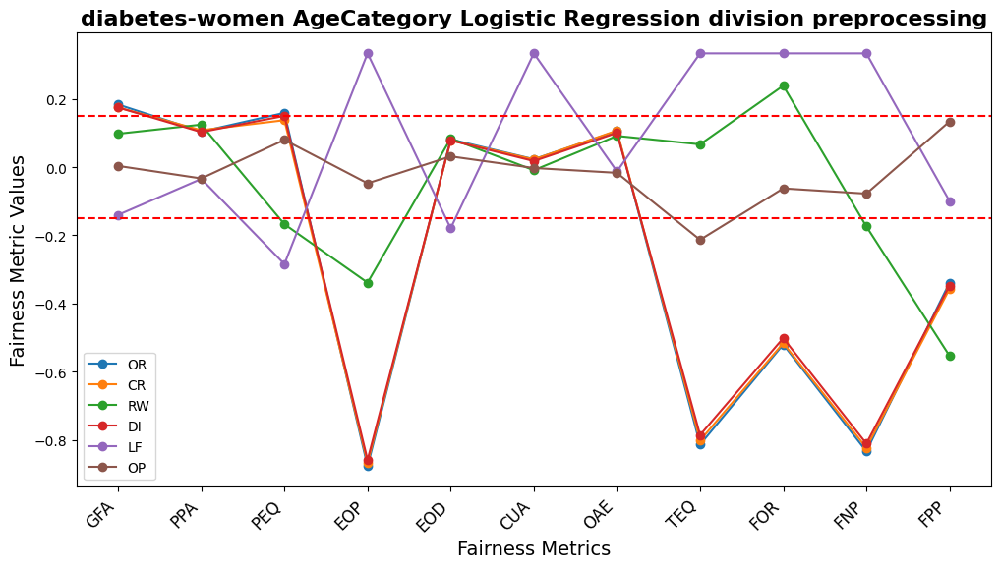

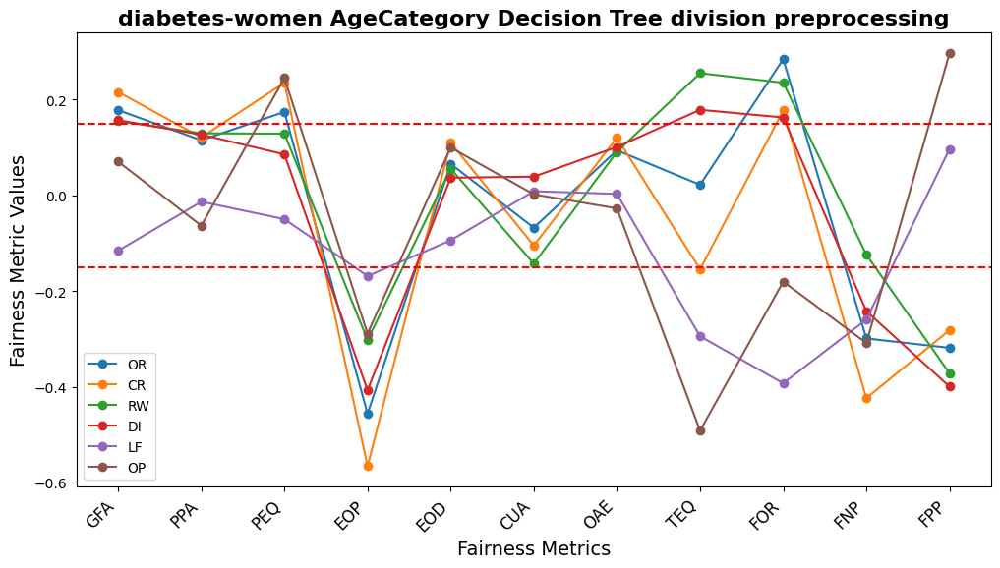

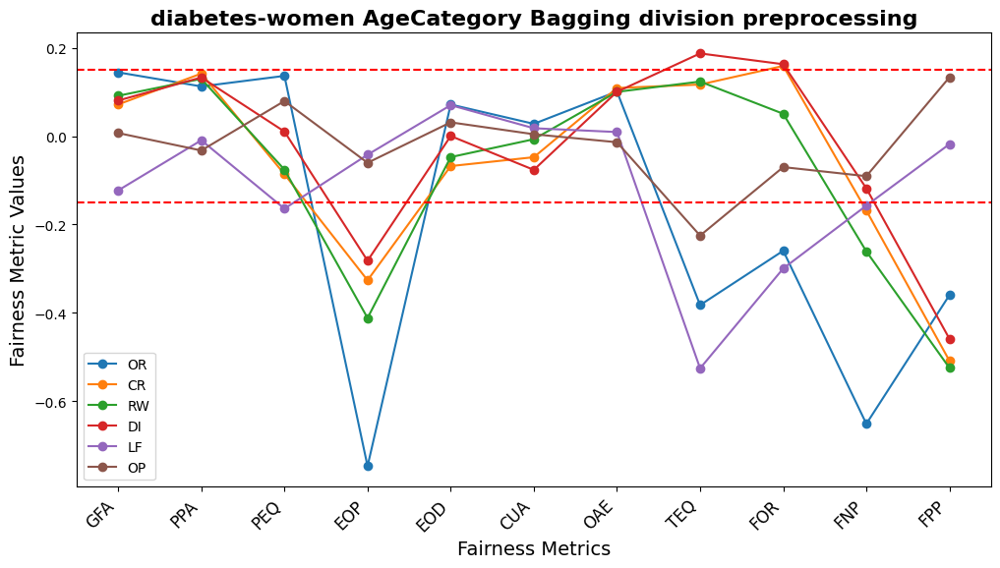

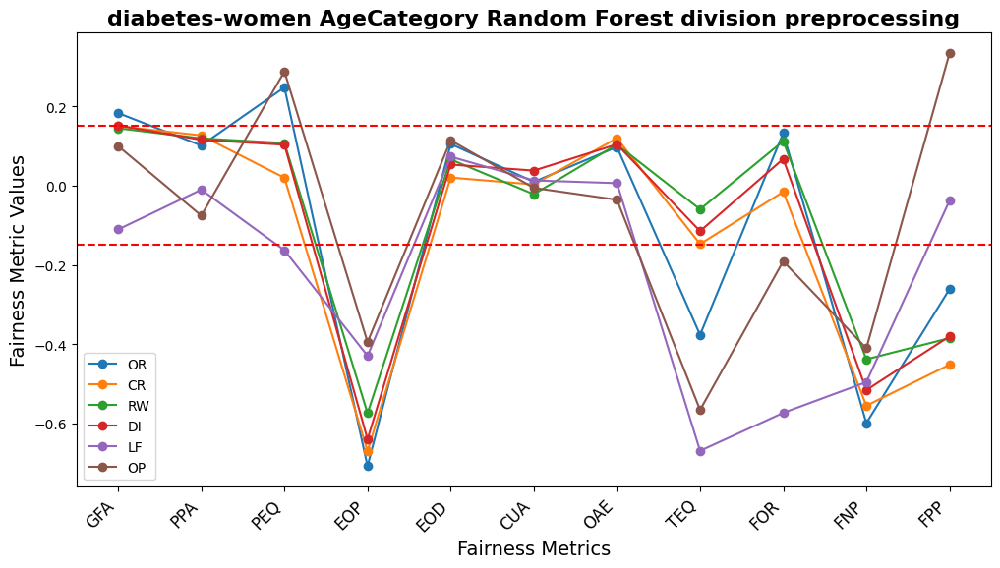

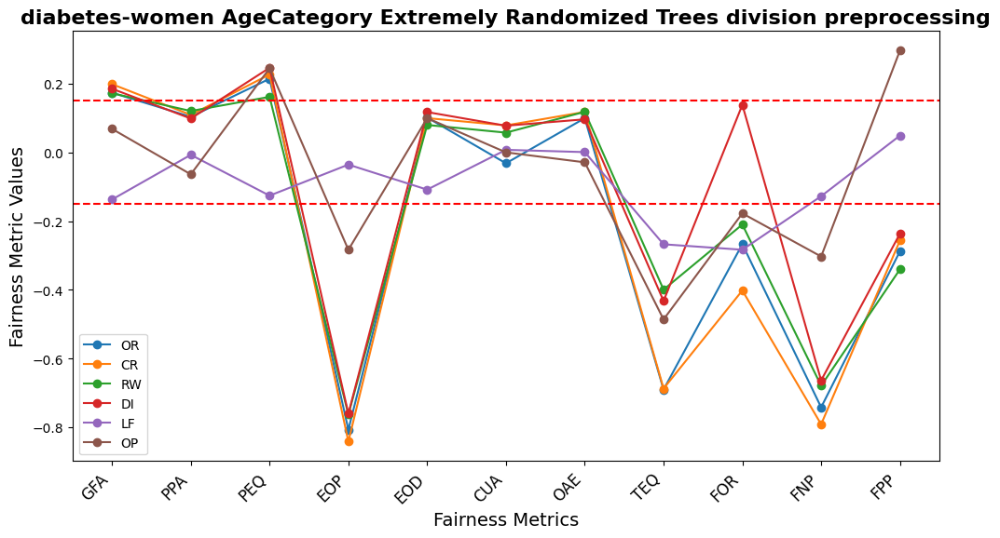

...

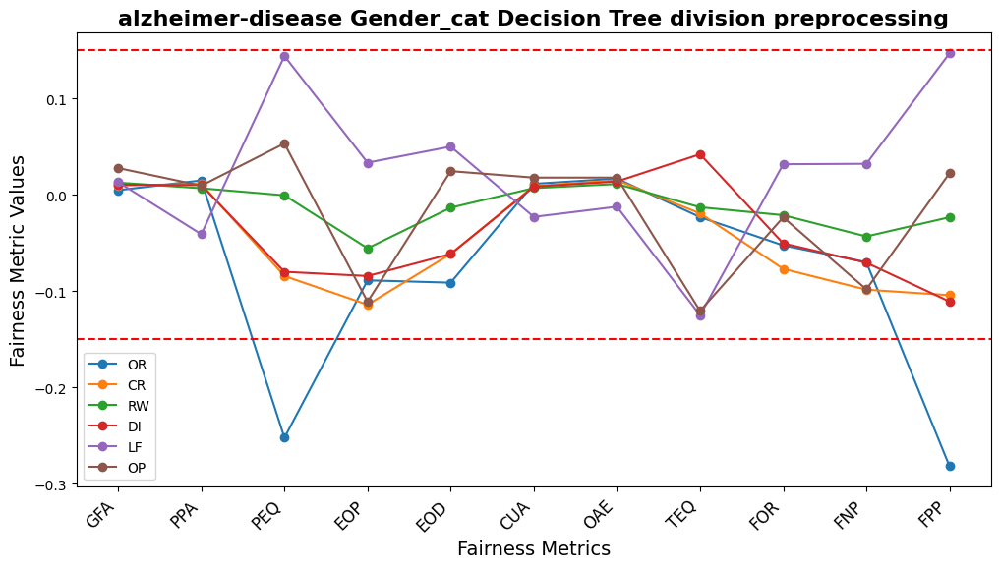

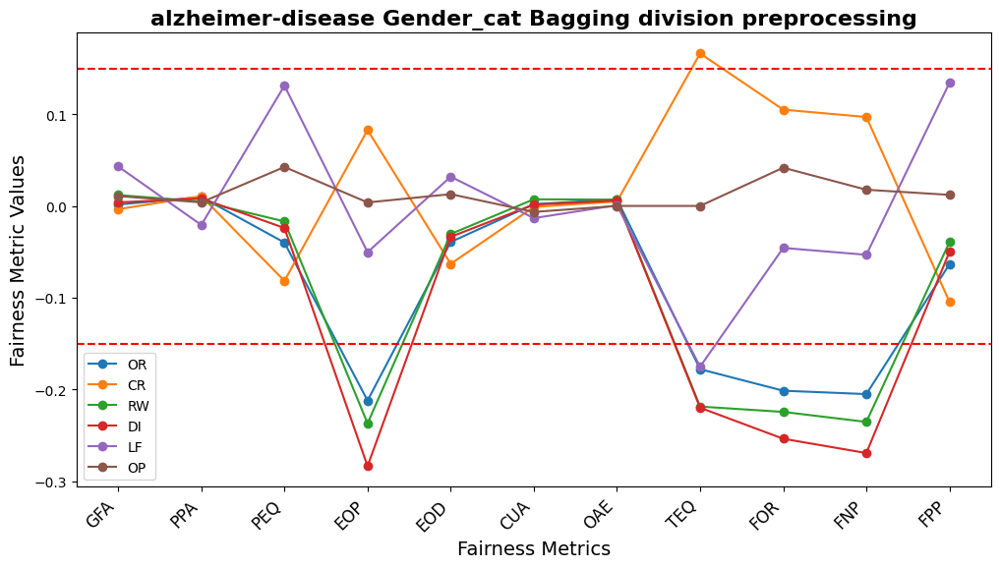

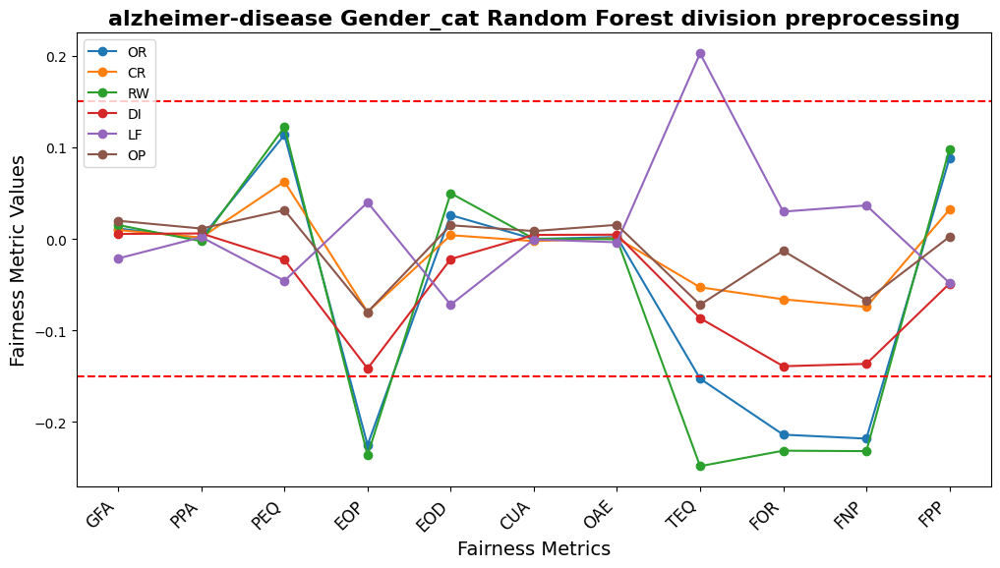

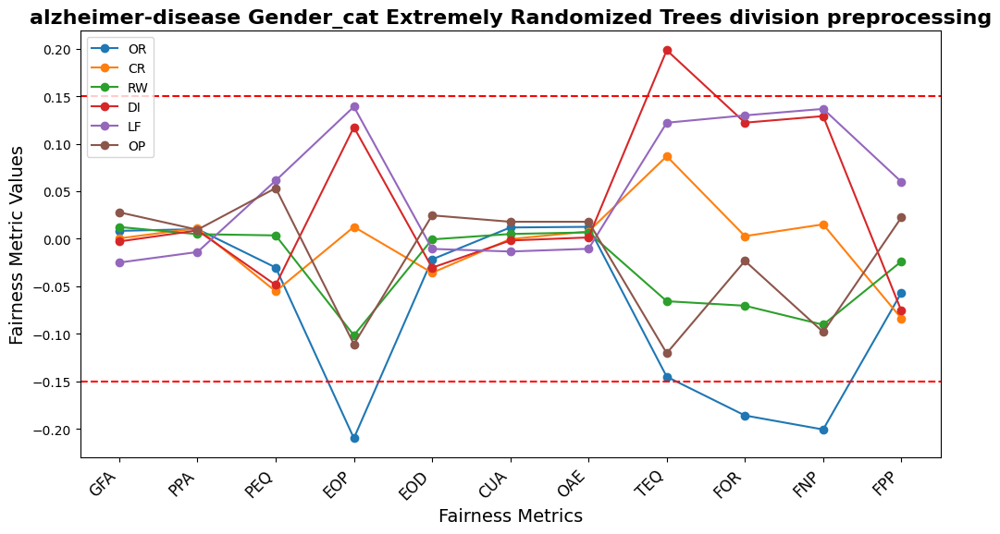

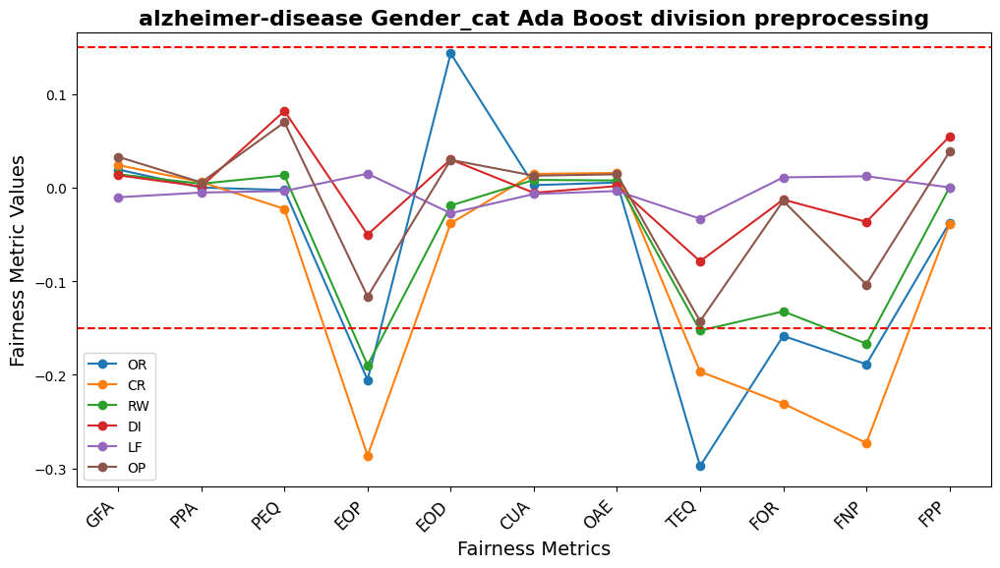

In [ ]:
for dataset_name in dataset_list:
  for sensible_attribute in datasets_config[dataset_name]['sensible_attributes']:
    for m in models:
      grouped_line_plot(preprocessing_metrics[dataset_name][sensible_attribute], preprocessing_mitigation_list, "division", m, 'preprocessing', dataset_name, sensible_attribute)

In [ ]:
def grouped_scatter_plot(metrics_dict, mitigation_list, comparison, model, mitigation_category, dataset_name, sensible_attribute):
    plt.figure(figsize=(12, 6))  # Create a figure

    # Define colors for different mitigation methods
    color_map = plt.cm.get_cmap("tab10", len(mitigation_list))  # Use a colormap for variety

    # Iterate through each mitigation and plot a scatter point for each
    for idx, mitigation in enumerate(mitigation_list):
        values = []
        for metric in metrics:
            values.append(metrics_dict[mitigation][comparison][model][metric][0])

        # Scatter plot for each mitigation method with a different color
        plt.scatter(
            list(map(map_metric, metrics)),  # x-axis labels (metrics)
            values,                          # y-axis values
            label=map_mitigation(mitigation),  # Label for the legend
            color=color_map(idx),  # Use different color for each mitigation
            s=100,  # Size of the scatter points
            edgecolor='black',  # Add black border for visibility
            marker='^'  # Marker style
        )

    # Add red threshold lines
    threshold_high = 0.15
    threshold_low = -0.15
    plt.axhline(y=threshold_high, color='red', linestyle='--')#, label='Threshold (+0.15)')
    plt.axhline(y=threshold_low, color='red', linestyle='--')#, label='Threshold (-0.15)')

    # Add labels, title, and legend
    plt.xlabel('Fairness Metrics', fontsize=14)
    plt.ylabel('Fairness Metric Values', fontsize=14)
    plt.title(f"{dataset_name} {sensible_attribute} {model} {comparison} {mitigation_category}", fontsize=16, fontweight='bold')
    plt.xticks(rotation=45, ha='right', fontsize=12)
    plt.legend(fontsize=10, loc='best')

    # Save the plot as a PDF
    model_no_spaces = model.replace(" ", "")
    configuration = f"{dataset_name}-{sensible_attribute}"
    pdf_file_name = f"{mitigation_category}-{model_no_spaces}-{comparison}.pdf"
    pdf_path = os.path.join(path_to_project, 'plots', configuration, pdf_file_name)
    #plt.savefig(pdf_path, bbox_inches="tight")

    # Show the plot
    plt.show()


<ipython-input-10-7829cf0c31f0>:5: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap("tab10", len(mitigation_list))  # Use a colormap for variety


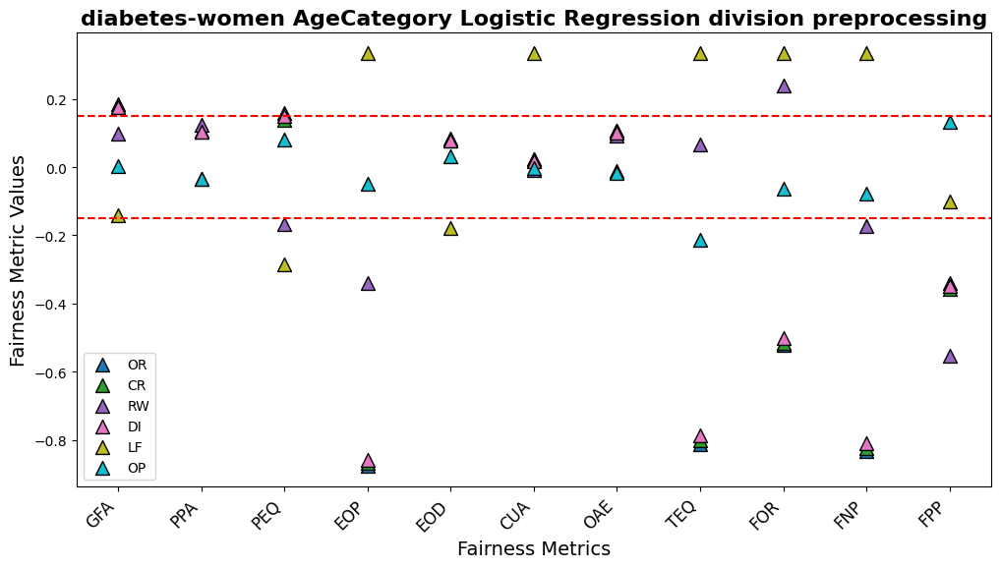

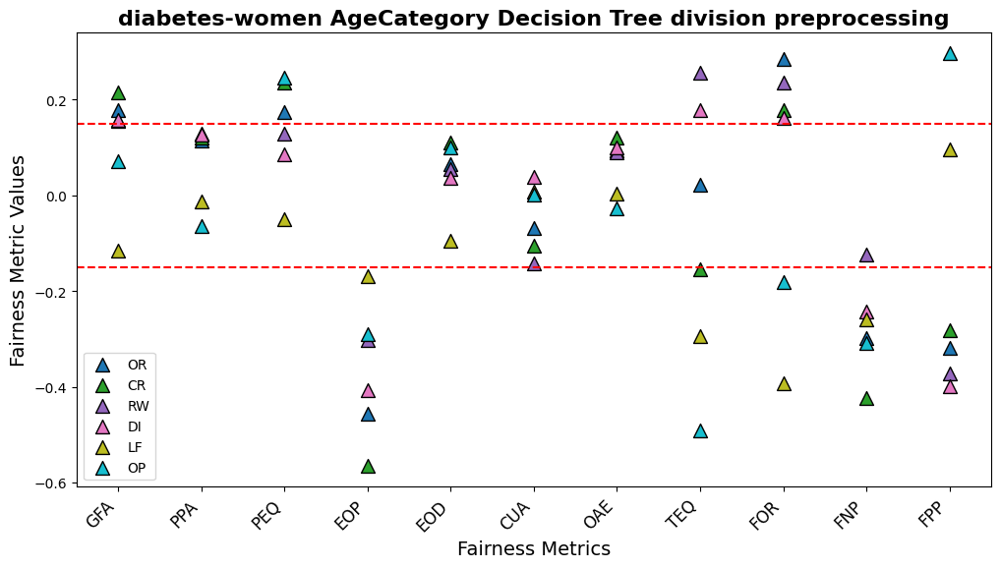

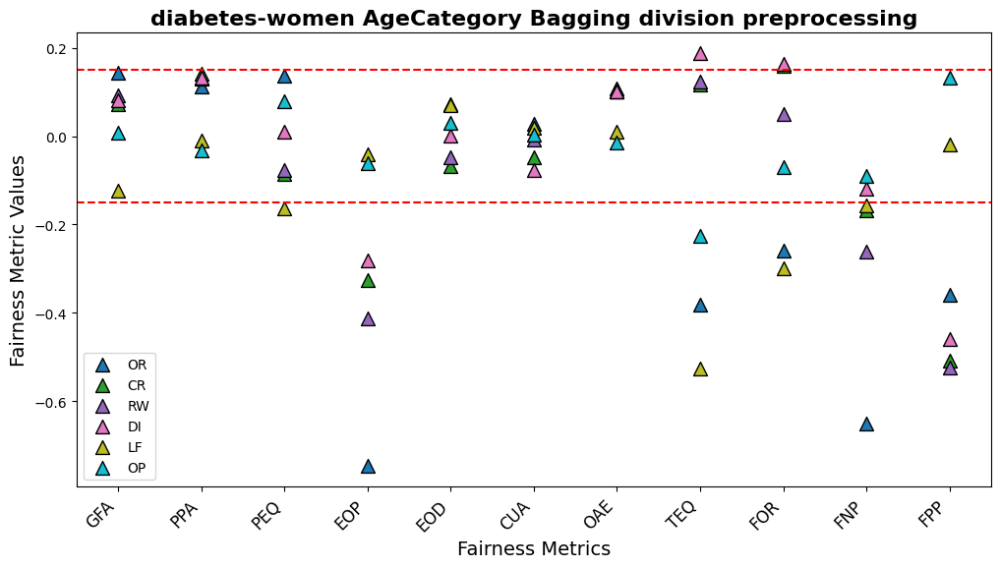

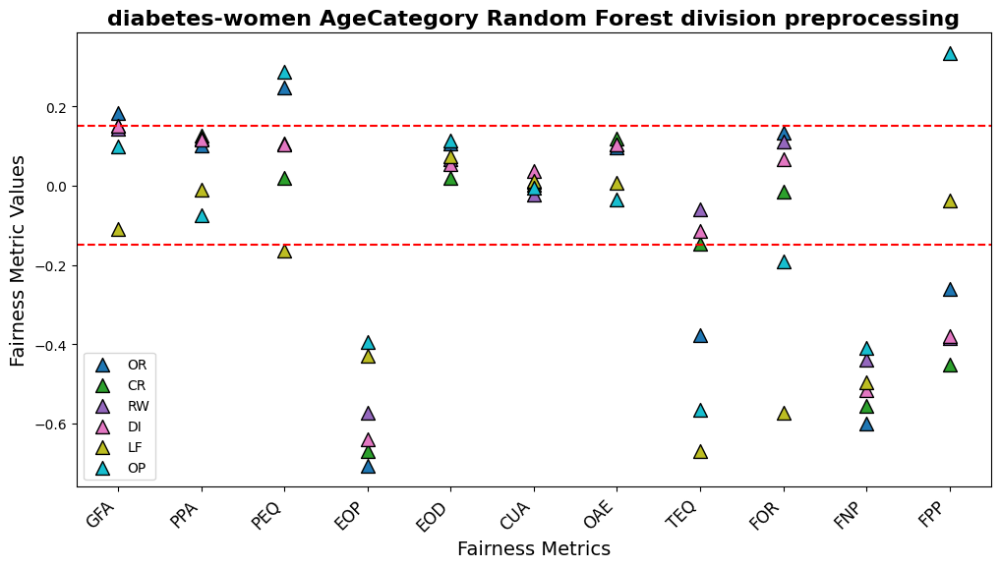

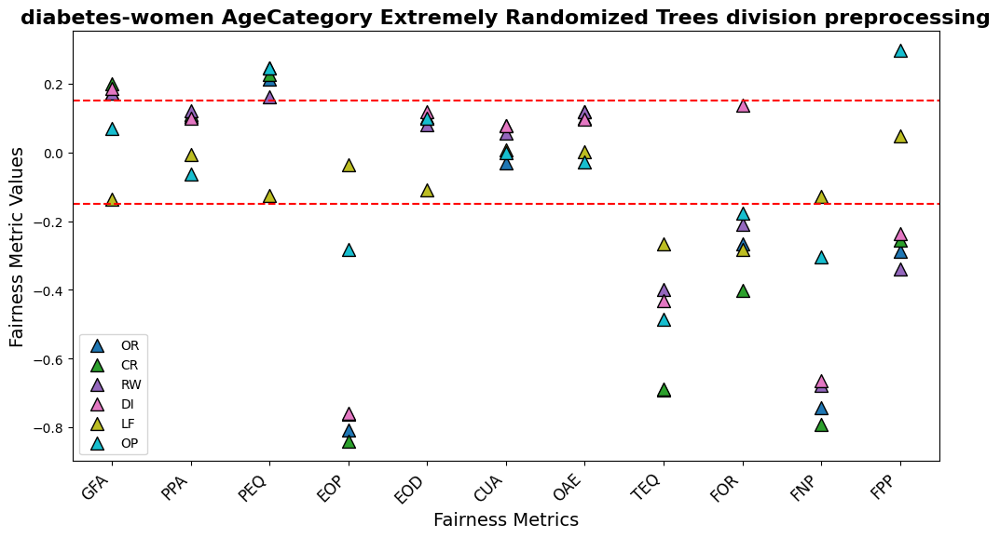

...

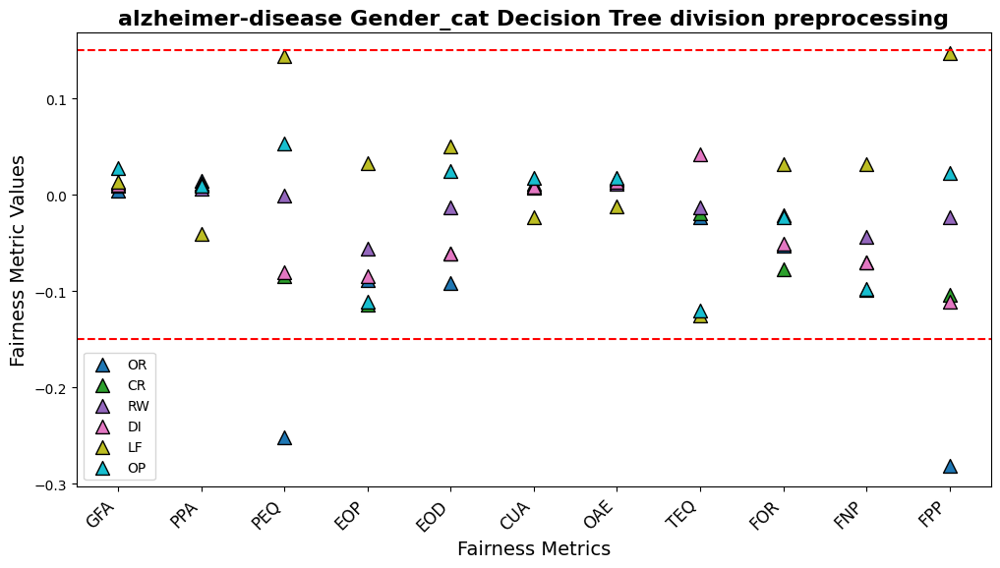

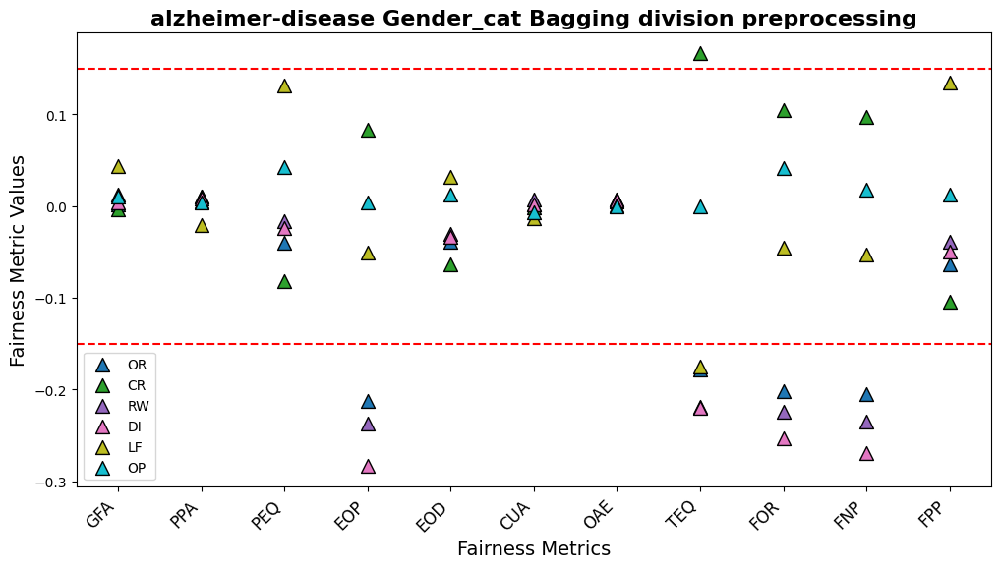

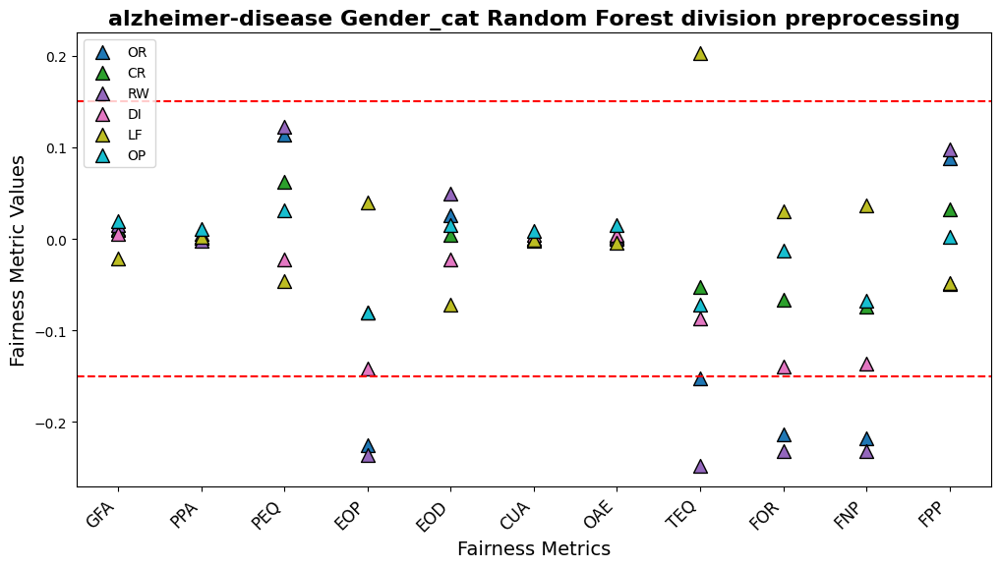

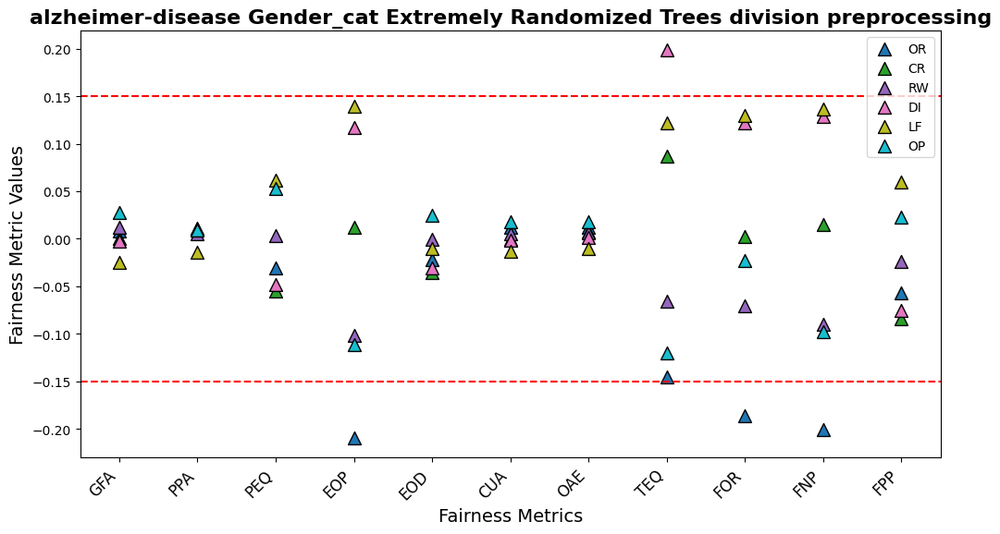

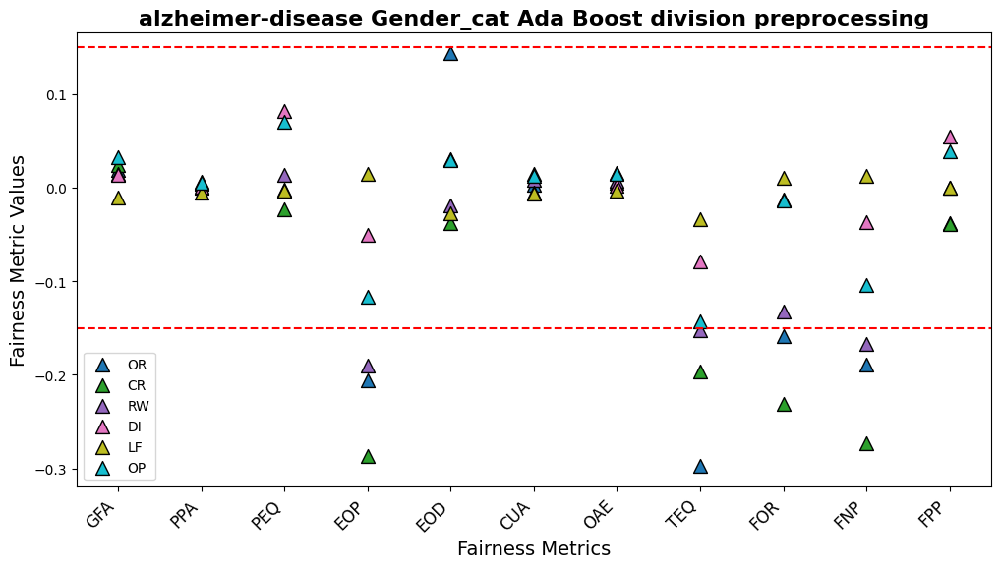

In [ ]:
for dataset_name in dataset_list:
  for sensible_attribute in datasets_config[dataset_name]['sensible_attributes']:
    for m in models:
      grouped_scatter_plot(preprocessing_metrics[dataset_name][sensible_attribute], preprocessing_mitigation_list, "division", m, 'preprocessing', dataset_name, sensible_attribute)

In [ ]:
def grouped_scatter_plot(metrics_dicts, mitigation_list, comparison, model, mitigation_category):
    plt.figure(figsize=(12, 6))  # Create a figure

    # Define a list of markers (shapes) to use for different dictionaries
    marker_shapes = ['o', 's', '^']  # Circle, Square, Triangle

    # Define colors for different mitigation methods
    color_map = plt.cm.get_cmap("tab10", len(mitigation_list))  # Use a colormap for variety

    # Iterate through each metrics_dict (the different datasets)
    for idx, (metrics_dict, label) in enumerate(metrics_dicts.items()):
        # Iterate through each mitigation method and plot a scatter point for each
        for mitigation in mitigation_list:
            values = []
            for metric in metrics:
                values.append(metrics_dict[mitigation][comparison][model][metric][0])

            # Scatter plot for each mitigation method with a different color and shape
            plt.scatter(
                list(map(map_metric, metrics)),  # x-axis labels (metrics)
                values,                          # y-axis values
                label=f"{label} - {map_mitigation(mitigation)}",  # Label for the legend
                color=color_map(idx),  # Use different color for each mitigation
                s=100,  # Size of the scatter points
                edgecolor='black',  # Add black border for visibility
                marker=marker_shapes[idx],  # Use different shape based on the dictionary
                alpha=0.7  # Add transparency for better readability when overlapping
            )

    # Add red threshold lines
    threshold_high = 0.15
    threshold_low = -0.15
    plt.axhline(y=threshold_high, color='red', linestyle='--', label='Threshold (+0.15)')
    plt.axhline(y=threshold_low, color='red', linestyle='--', label='Threshold (-0.15)')

    # Add labels, title, and legend
    plt.xlabel('Fairness Metrics', fontsize=14)
    plt.ylabel('Fairness Metric Values', fontsize=14)
    plt.title(f"{dataset_name} {sensible_attribute} {model} {comparison} {mitigation_category}", fontsize=16, fontweight='bold')
    plt.xticks(rotation=45, ha='right', fontsize=12)
    plt.legend(fontsize=10, loc='best')

    # Save the plot as a PDF
    model_no_spaces = model.replace(" ", "")
    configuration = f"{dataset_name}-{sensible_attribute}"
    pdf_file_name = f"{mitigation_category}-{model_no_spaces}-{comparison}.pdf"
    pdf_path = os.path.join(path_to_project, 'plots', configuration, pdf_file_name)
    plt.savefig(pdf_path, bbox_inches="tight")

    # Show the plot
    plt.show()


In [ ]:
# for dataset_name in dataset_list:
#   for sensible_attribute in datasets_config[dataset_name]['sensible_attributes']:
#     for m in models:
#       grouped_scatter_plot(preprocessing_metrics, preprocessing_mitigation_list, "division", m, 'preprocessing')

In [ ]:
for idx, (metrics_dict, label) in enumerate(preprocessing_metrics.items()):
  print(idx, metrics_dict, label)

0 diabetes-women {'AgeCategory': {'fl-cr': {'division': {'Logistic Regression': {'GroupFairness': [0.1749144978724659, 0.021141870209744423], 'PredictiveParity': [0.10805499685072692, 0.04021046974321338], 'PredictiveEquality': [0.13758664843411, 0.1394394319024411], 'EqualOpportunity': [-0.8670089035052537, 0.1838068236493997], 'EqualizedOdds': [0.07843091762245308, 0.04429379165429436], 'ConditionalUseAccuracyEquality': [0.022537604149660825, 0.07589027520300667], 'OverallAccuracyEquality': [0.10704024513226315, 0.038403473384928465], 'TreatmentEquality': [-0.801332405289848, 0.24727839783923167], 'FORParity': [-0.516008316008316, 0.5929121479995488], 'FN': [-0.8227485624188462, 0.23554453788115606], 'FP': [-0.3572589595347395, 0.23347993038529294]}, 'Decision Tree': {'GroupFairness': [0.21598882447607304, 0.06267430289789226], 'PredictiveParity': [0.120923951293748, 0.025926674538652484], 'PredictiveEquality': [0.23528601733304977, 0.14419821168926064], 'EqualOpportunity': [-0.56586